In [1]:
import torch, pdb
from torch.utils.data import DataLoader
from torch import nn
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import matplotlib.pyplot as plt

In [2]:
def show(tensor, ch=1, size=(28,28), num=16, index=0):
  # tensor: 128 x 784
  data=tensor.detach().cpu().view(-1,ch,*size) # 128 x 1 x 28 x 28
  grid = make_grid(data[index:num], nrow=4).permute(1,2,0)   # 1 x 28 x 28  = 28 x 28 x 1
  plt.imshow(grid)
  plt.show()

In [3]:
epochs = 500
cur_step = 0
info_step = 300
mean_gen_loss = 0
mean_disc_loss = 0

z_dim = 64
lr = 0.00001
loss_func = nn.BCEWithLogitsLoss()

bs = 128
device = 'cuda'

dataloader = DataLoader(MNIST('.', download=True, transform=transforms.ToTensor()),shuffle=True, batch_size=bs)

# number of steps = 60000 / 128 = 468.75

In [14]:
# Generator
def genBlock(inp, out):
  return nn.Sequential(
      nn.Linear(inp, out),
      nn.BatchNorm1d(out),
      nn.ReLU(inplace=True)
  )

class Generator(nn.Module):
  def __init__(self, z_dim=64, i_dim=784, h_dim=128):
    super().__init__()
    self.gen = nn.Sequential(
        genBlock(z_dim, h_dim), # 64, 128
        genBlock(h_dim, h_dim*2), # 128, 256
        genBlock(h_dim*2, h_dim*4), # 256 x 512
        genBlock(h_dim*4, h_dim*8), # 512, 1024
        nn.Linear(h_dim*8, i_dim), # 1024, 784 (28x28)
        nn.Sigmoid(),
    )

  def forward(self, noise):
       return self.gen(noise)

def gen_noise(number, z_dim):
#   return torch.randn(number, z_dim).to(device)
  return torch.randn(number, z_dim)

## Discriminator
def discBlock(inp, out):
  return nn.Sequential(
      nn.Linear(inp, out),
      nn.LeakyReLU(0.2)
  )

class Discriminator(nn.Module):
  def __init__(self, i_dim=784, h_dim=256):
    super().__init__()
    self.disc=nn.Sequential(
        discBlock(i_dim, h_dim*4), # 784, 1024
        discBlock(h_dim*4, h_dim*2), # 1024, 512
        discBlock(h_dim*2, h_dim), # 512, 256
        nn.Linear(h_dim, 1) # 256, 1
    )

  def forward(self, image):
      return self.disc(image)

In [15]:
# gen = Generator(z_dim).to(device)
gen = Generator(z_dim)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
# disc = Discriminator().to(device)
disc = Discriminator()
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

torch.Size([128, 1, 28, 28]) torch.Size([128])
tensor([9, 2, 6, 8, 9, 8, 5, 2, 7, 6])


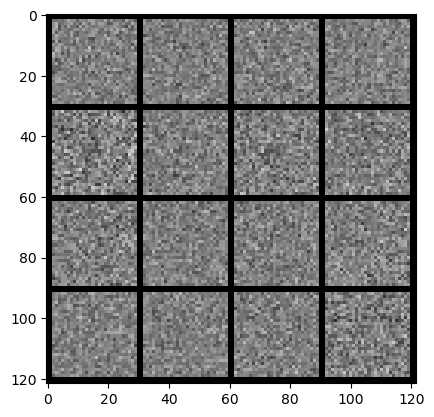

In [16]:
x,y=next(iter(dataloader))
print(x.shape, y.shape)
print(y[:10])

noise = gen_noise(bs, z_dim)
fake = gen(noise)
show(fake)

In [17]:
# generator loss
def calc_gen_loss(loss_func, gen, disc, number, z_dim):
   noise = gen_noise(number, z_dim)
   fake = gen(noise)
   pred = disc(fake)
   targets=torch.ones_like(pred)
   gen_loss=loss_func(pred,targets)

   return gen_loss


def calc_disc_loss(loss_func, gen, disc, number, real, z_dim):
   noise = gen_noise(number, z_dim)
   fake = gen(noise)
   disc_fake = disc(fake.detach())
   disc_fake_targets=torch.zeros_like(disc_fake)
   disc_fake_loss=loss_func(disc_fake, disc_fake_targets)

   disc_real = disc(real)
   disc_real_targets=torch.ones_like(disc_real)
   disc_real_loss=loss_func(disc_real, disc_real_targets)

   disc_loss=(disc_fake_loss+disc_real_loss)/2

   return disc_loss

  0%|          | 0/469 [00:00<?, ?it/s]

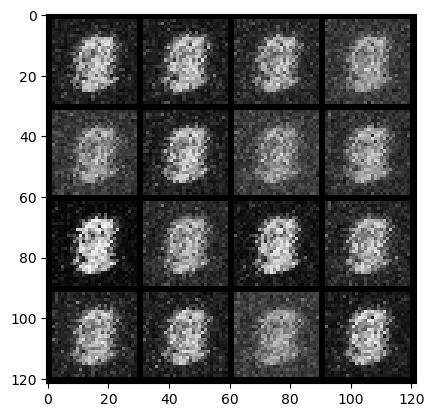

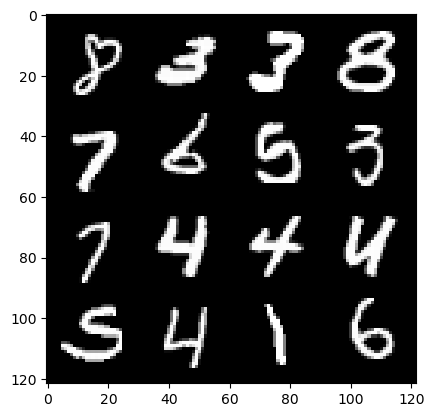

0: step 300 / Gen loss: 1.9474979364871978 / disc_loss: 0.3317621484398842


  0%|          | 0/469 [00:00<?, ?it/s]

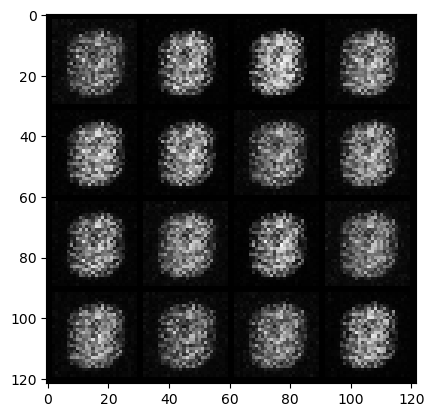

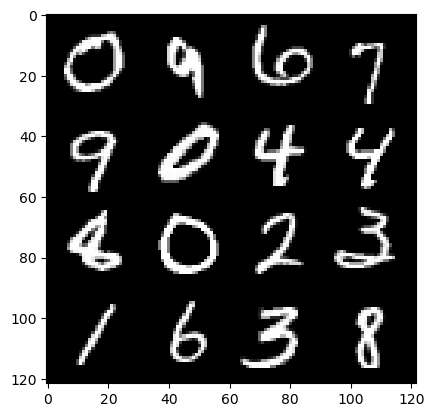

1: step 600 / Gen loss: 3.4898483006159458 / disc_loss: 0.11902944636841618


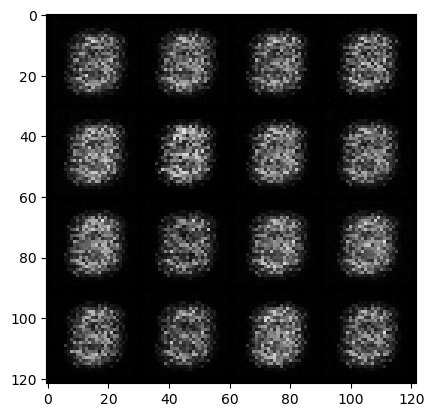

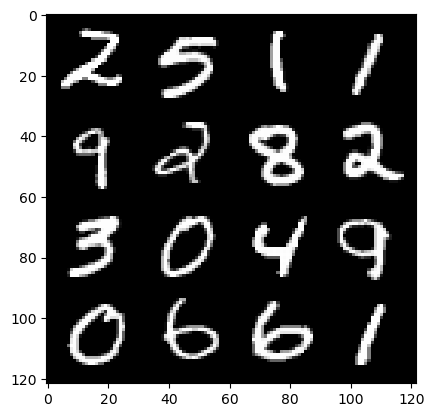

1: step 900 / Gen loss: 3.3853924258550023 / disc_loss: 0.05744338070352874


  0%|          | 0/469 [00:00<?, ?it/s]

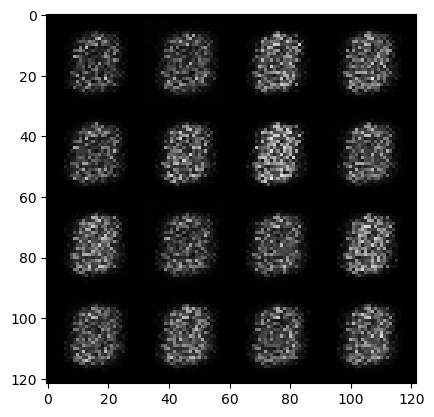

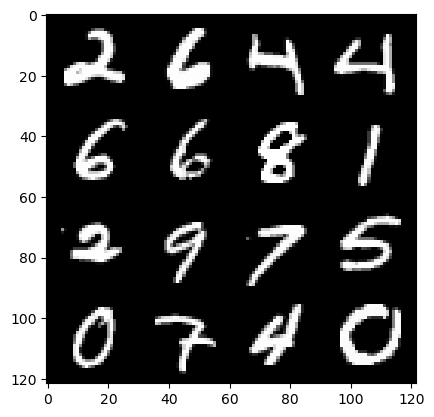

2: step 1200 / Gen loss: 3.4037635286649093 / disc_loss: 0.0416743160411716


  0%|          | 0/469 [00:00<?, ?it/s]

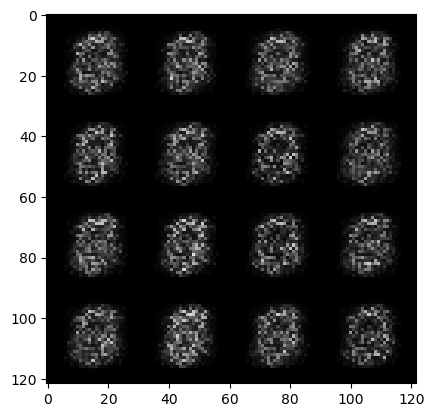

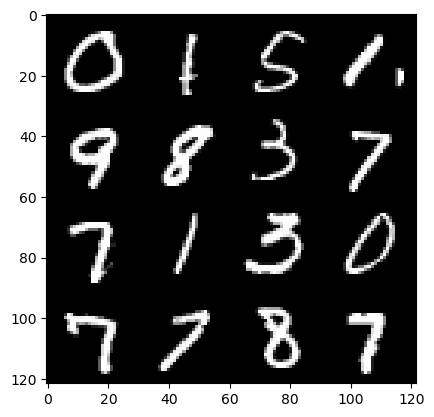

3: step 1500 / Gen loss: 3.441914160251618 / disc_loss: 0.03798812914639712


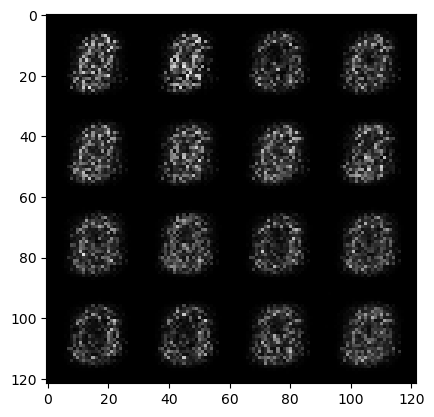

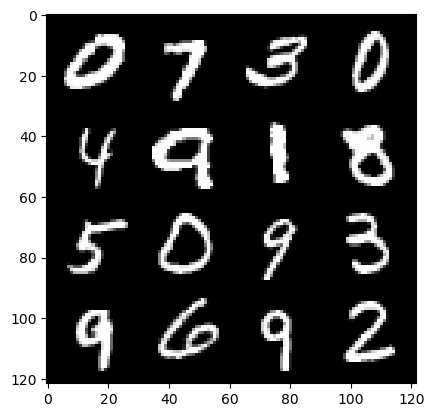

3: step 1800 / Gen loss: 3.5678819378217033 / disc_loss: 0.03728146173059942


  0%|          | 0/469 [00:00<?, ?it/s]

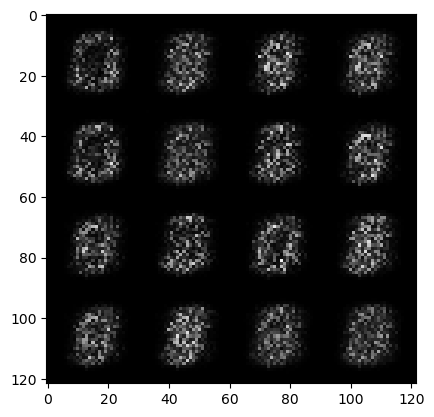

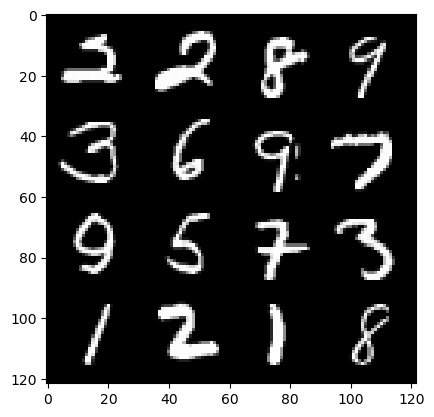

4: step 2100 / Gen loss: 3.742423938115438 / disc_loss: 0.03788286025946342


  0%|          | 0/469 [00:00<?, ?it/s]

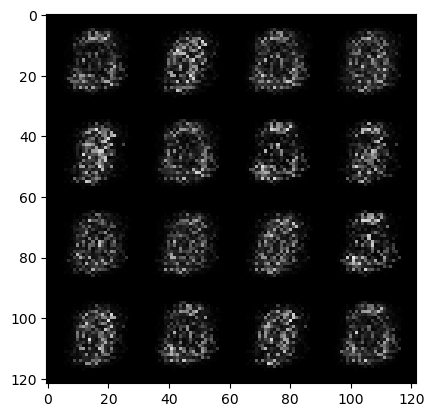

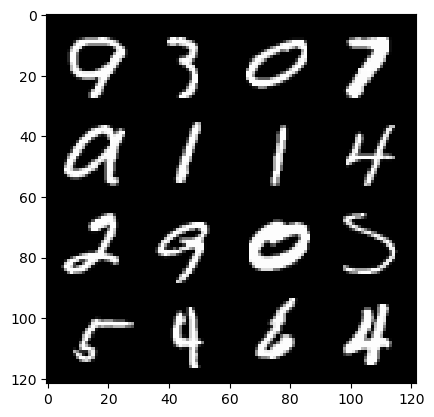

5: step 2400 / Gen loss: 4.167646191914876 / disc_loss: 0.02886329750840862


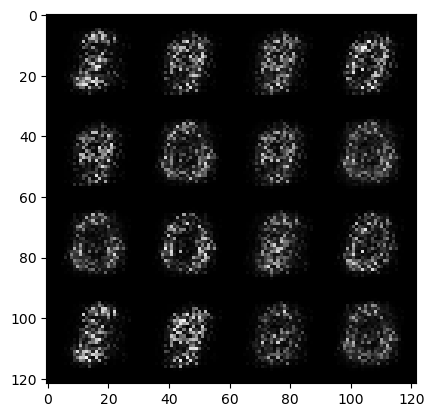

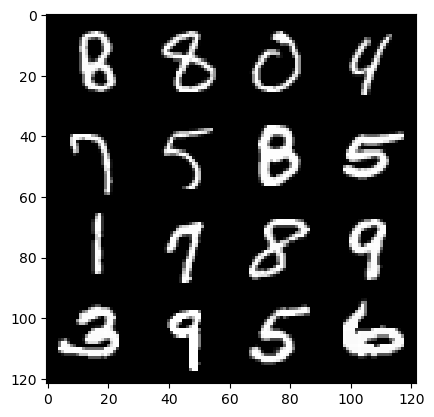

5: step 2700 / Gen loss: 4.587294309933983 / disc_loss: 0.02469580972256759


  0%|          | 0/469 [00:00<?, ?it/s]

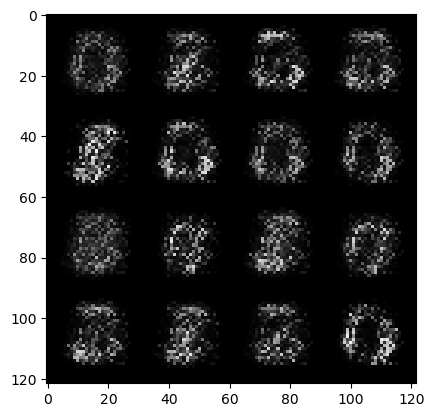

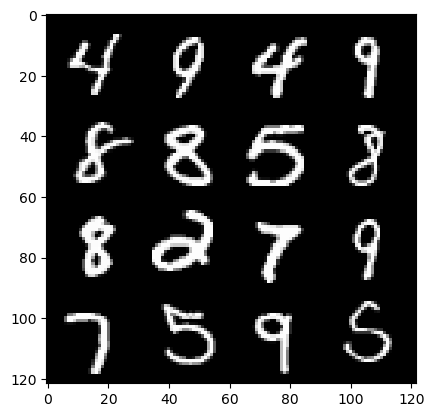

6: step 3000 / Gen loss: 5.009421461423236 / disc_loss: 0.019858642006292948


  0%|          | 0/469 [00:00<?, ?it/s]

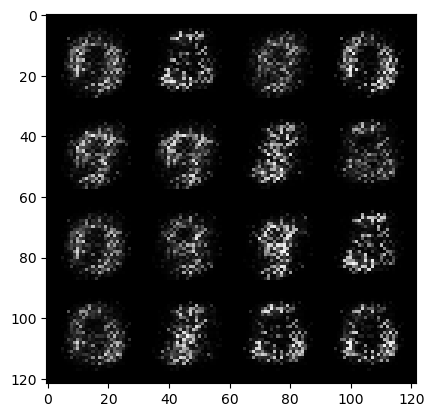

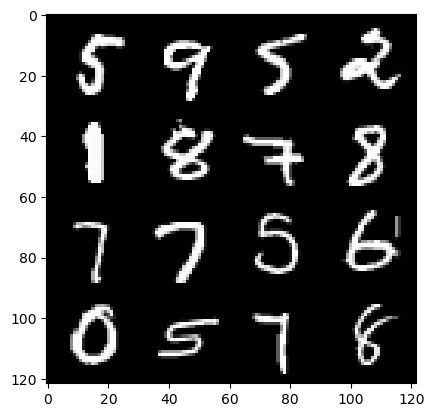

7: step 3300 / Gen loss: 5.31557299772898 / disc_loss: 0.01717752211727202


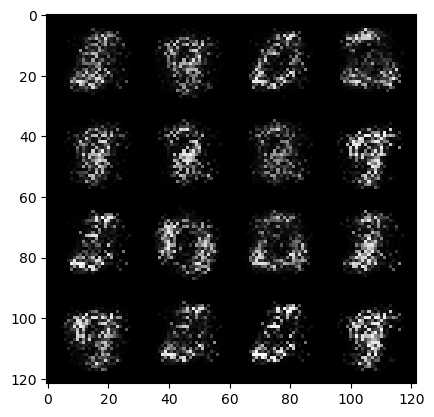

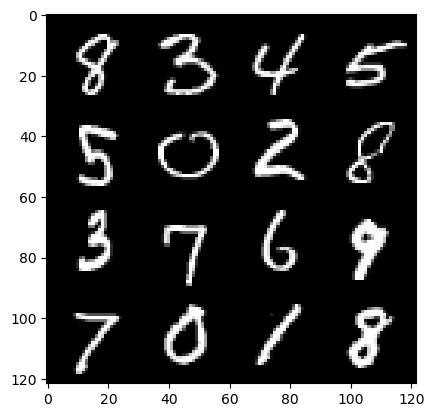

7: step 3600 / Gen loss: 5.593197687466936 / disc_loss: 0.018277128969008724


  0%|          | 0/469 [00:00<?, ?it/s]

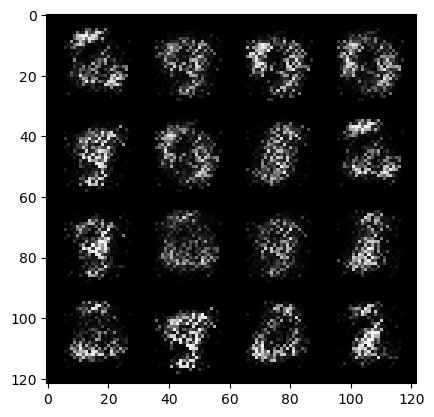

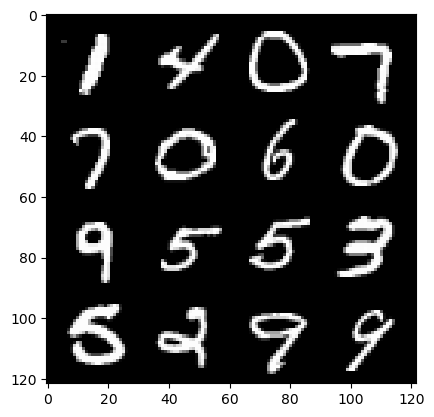

8: step 3900 / Gen loss: 5.695207497278851 / disc_loss: 0.014541467187615743


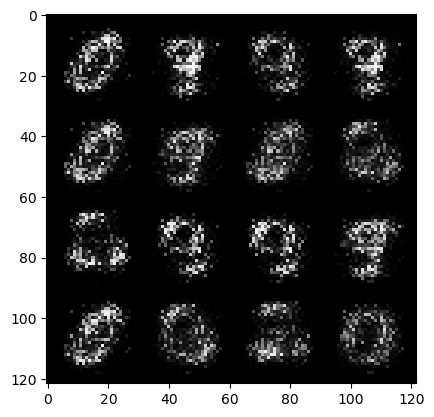

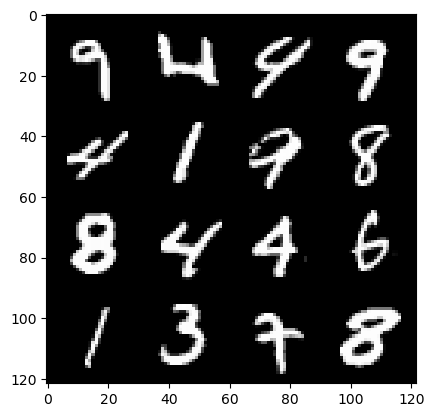

8: step 4200 / Gen loss: 5.7521151383717894 / disc_loss: 0.01639576428259412


  0%|          | 0/469 [00:00<?, ?it/s]

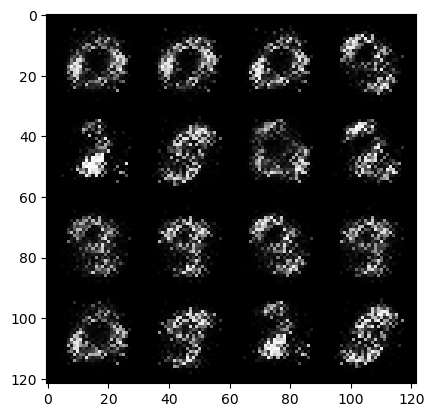

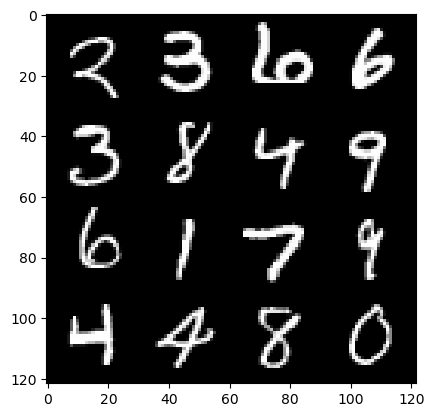

9: step 4500 / Gen loss: 6.368526000976561 / disc_loss: 0.014610898662358533


  0%|          | 0/469 [00:00<?, ?it/s]

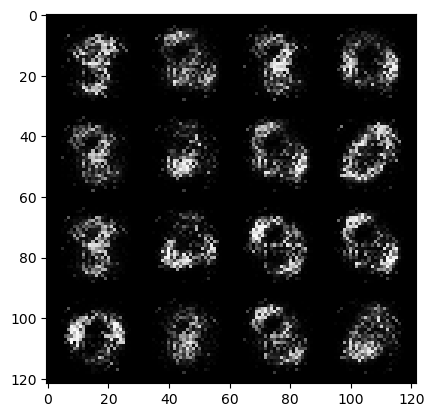

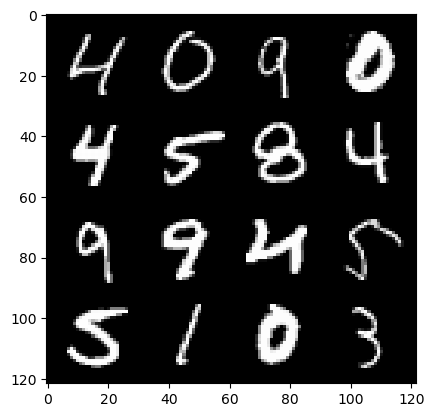

10: step 4800 / Gen loss: 6.421022642453511 / disc_loss: 0.015358839643498262


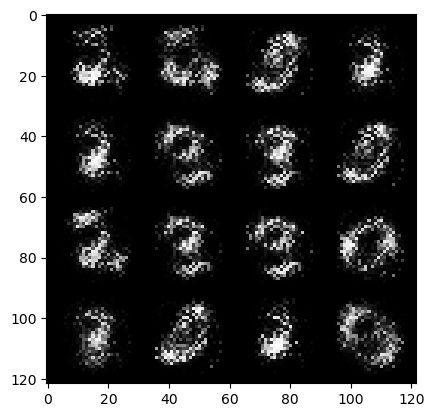

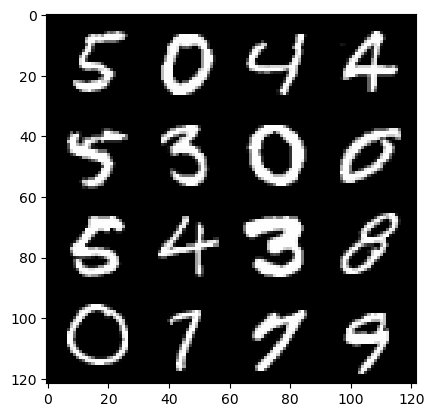

10: step 5100 / Gen loss: 6.570634500185653 / disc_loss: 0.01605871457451333


  0%|          | 0/469 [00:00<?, ?it/s]

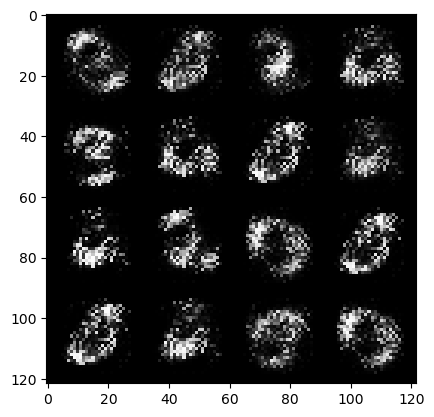

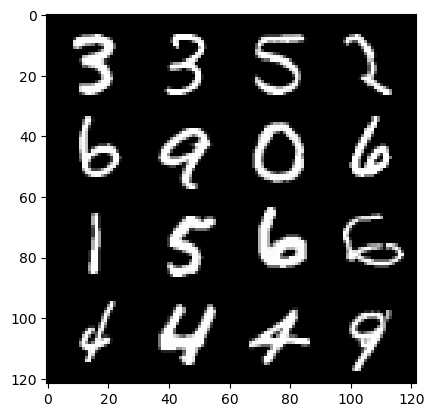

11: step 5400 / Gen loss: 6.489251763025919 / disc_loss: 0.014051030495514467


  0%|          | 0/469 [00:00<?, ?it/s]

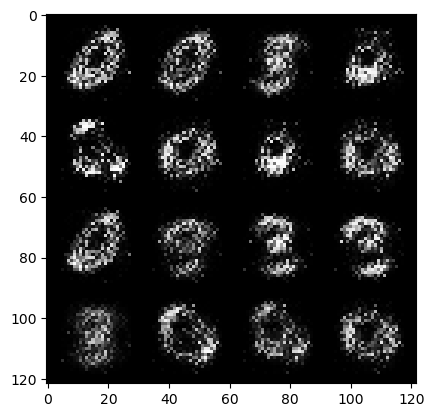

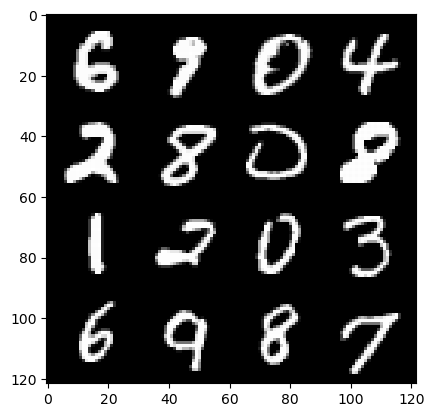

12: step 5700 / Gen loss: 6.5860906028747515 / disc_loss: 0.011399973052709064


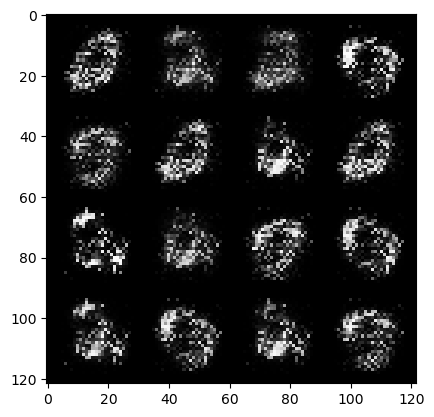

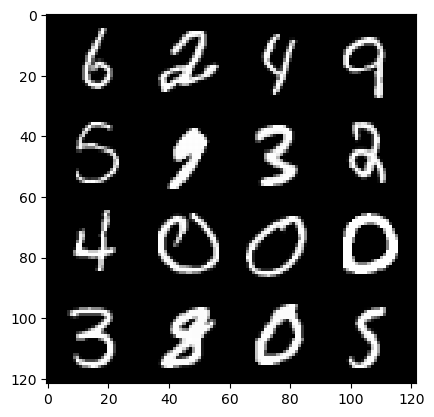

12: step 6000 / Gen loss: 7.083157666524252 / disc_loss: 0.010804409211656702


  0%|          | 0/469 [00:00<?, ?it/s]

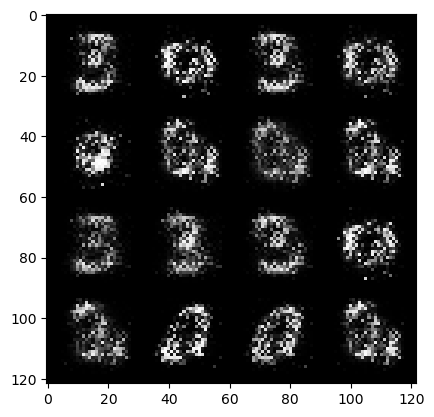

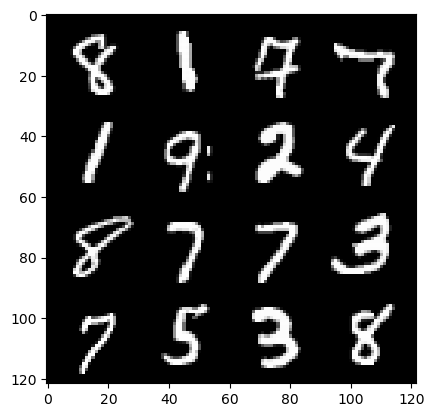

13: step 6300 / Gen loss: 7.6131685145696 / disc_loss: 0.00943428587323675


  0%|          | 0/469 [00:00<?, ?it/s]

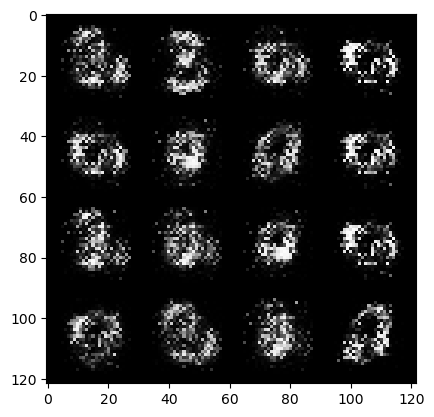

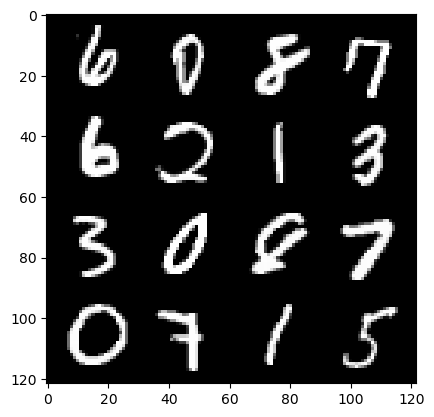

14: step 6600 / Gen loss: 7.11524903933207 / disc_loss: 0.00977808631646137


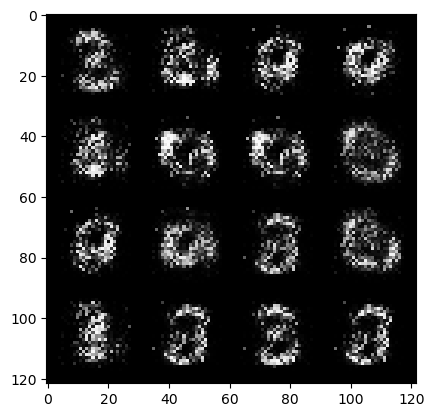

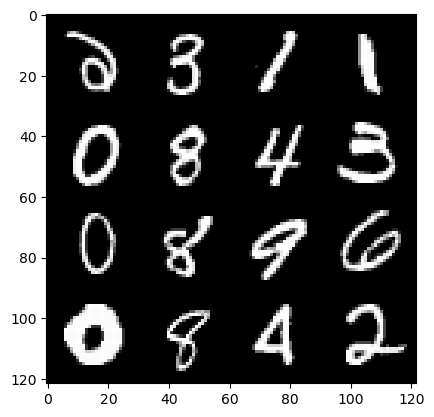

14: step 6900 / Gen loss: 6.908740960756936 / disc_loss: 0.009105605077153692


  0%|          | 0/469 [00:00<?, ?it/s]

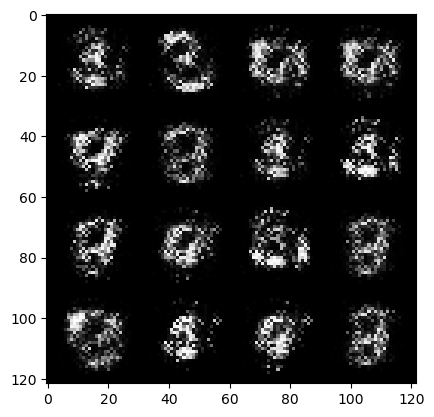

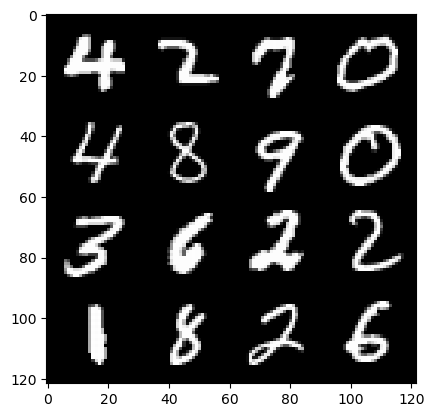

15: step 7200 / Gen loss: 6.874319526354476 / disc_loss: 0.009482016658099989


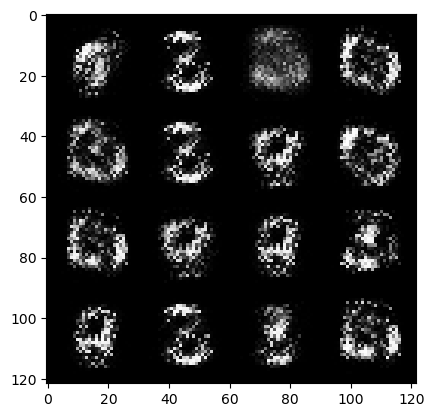

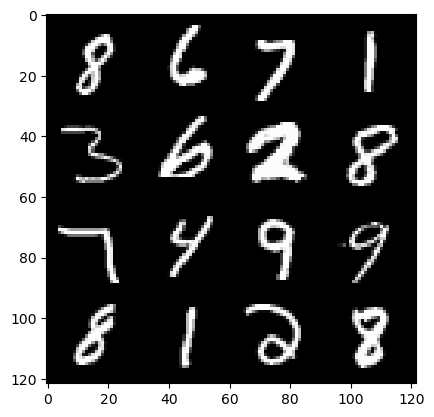

15: step 7500 / Gen loss: 7.228019105593364 / disc_loss: 0.009784702413404987


  0%|          | 0/469 [00:00<?, ?it/s]

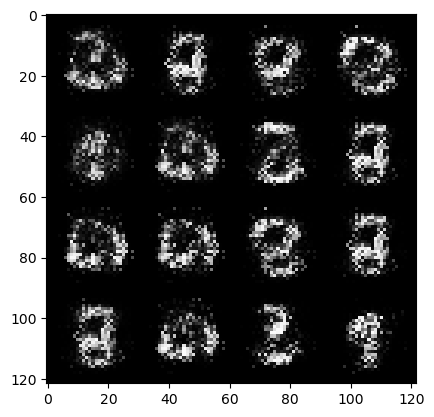

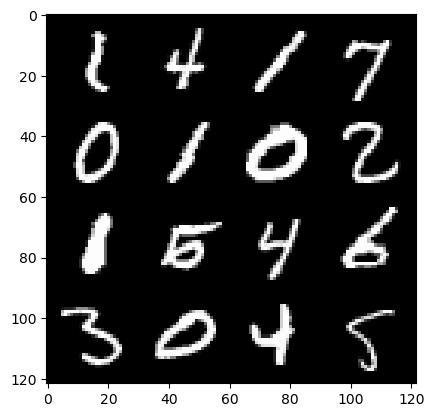

16: step 7800 / Gen loss: 7.1902522786458345 / disc_loss: 0.010931103879120205


  0%|          | 0/469 [00:00<?, ?it/s]

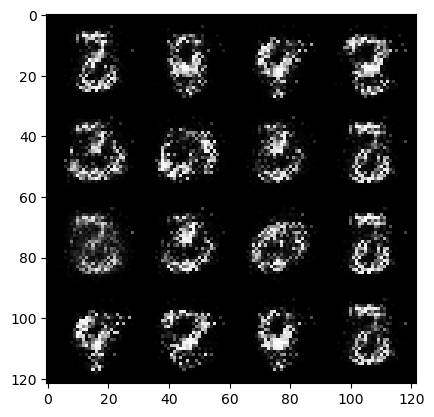

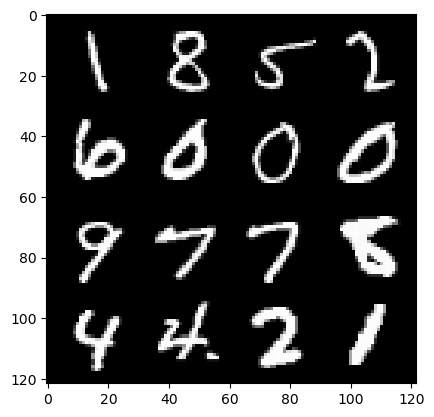

17: step 8100 / Gen loss: 7.072539122899373 / disc_loss: 0.007147616434376685


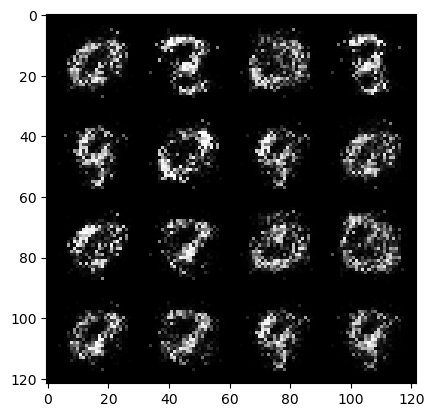

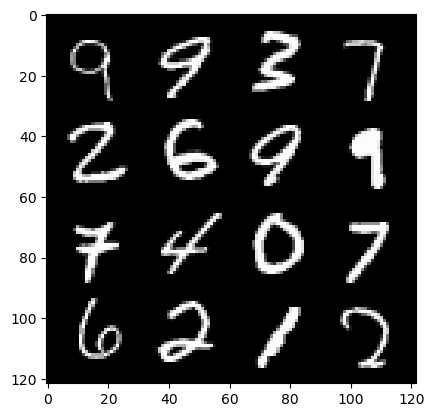

17: step 8400 / Gen loss: 7.423781291643773 / disc_loss: 0.008174096310976889


  0%|          | 0/469 [00:00<?, ?it/s]

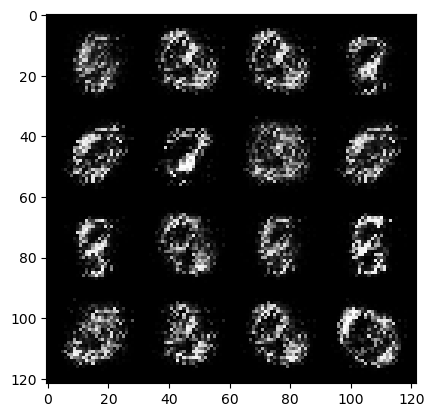

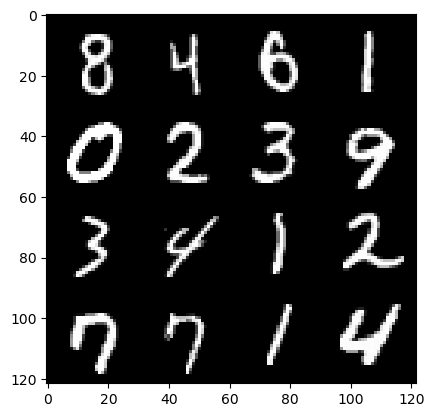

18: step 8700 / Gen loss: 7.5034673309326205 / disc_loss: 0.00860882617377986


  0%|          | 0/469 [00:00<?, ?it/s]

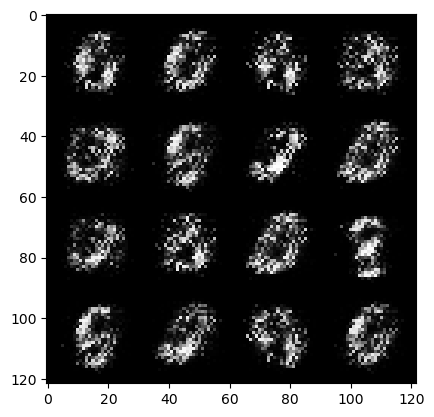

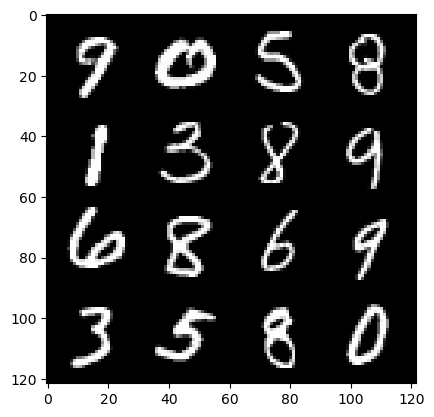

19: step 9000 / Gen loss: 7.180417407353718 / disc_loss: 0.011711522790137686


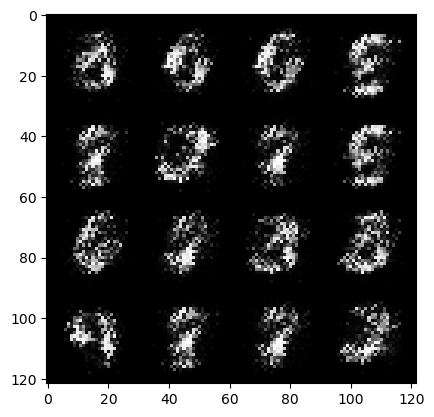

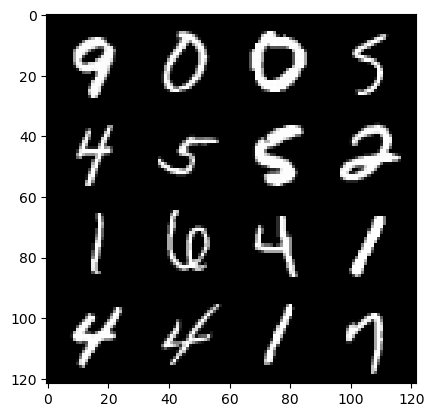

19: step 9300 / Gen loss: 6.804242261250814 / disc_loss: 0.013879631919165459


  0%|          | 0/469 [00:00<?, ?it/s]

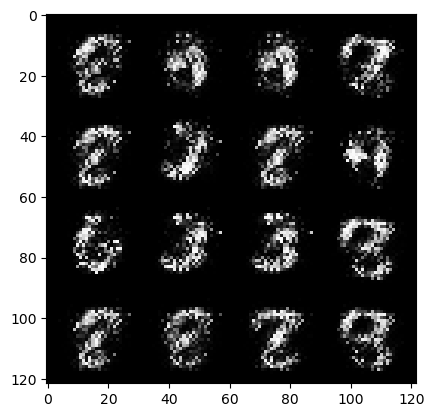

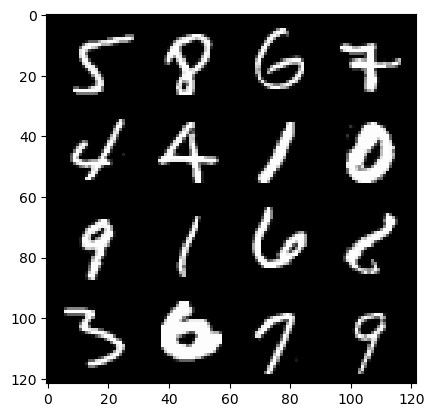

20: step 9600 / Gen loss: 6.555669299761452 / disc_loss: 0.011581945188033078


  0%|          | 0/469 [00:00<?, ?it/s]

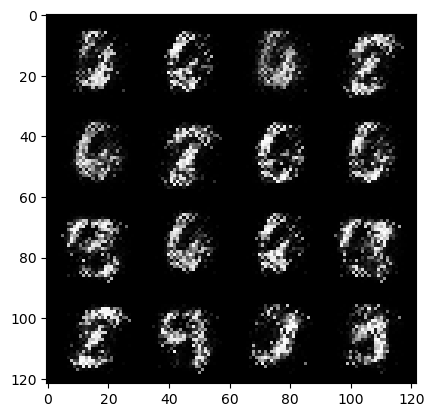

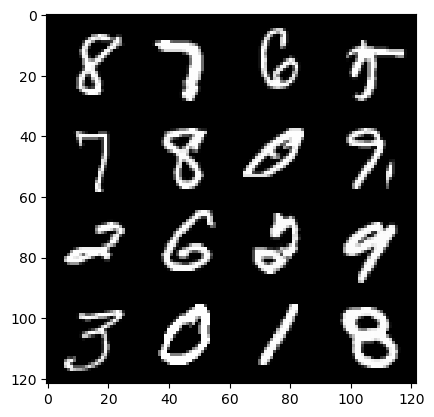

21: step 9900 / Gen loss: 7.201016043027244 / disc_loss: 0.011510715676316376


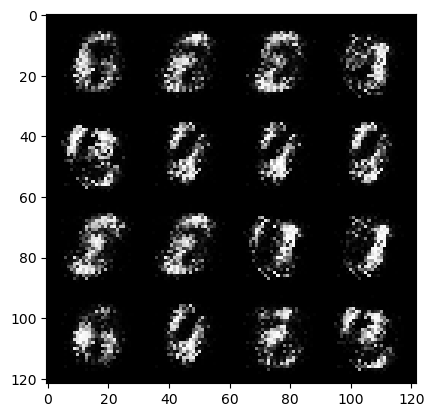

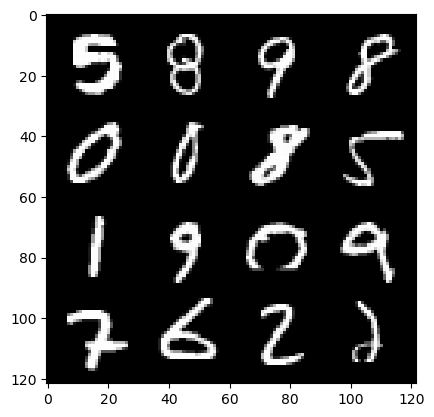

21: step 10200 / Gen loss: 7.287934190432227 / disc_loss: 0.010476161317589373


  0%|          | 0/469 [00:00<?, ?it/s]

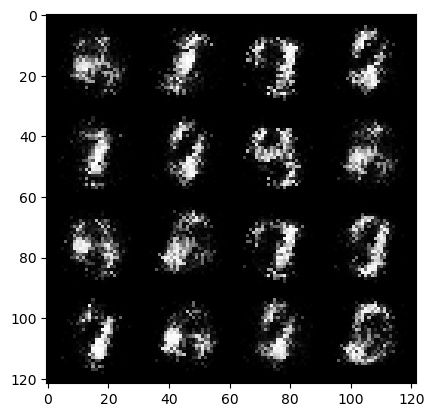

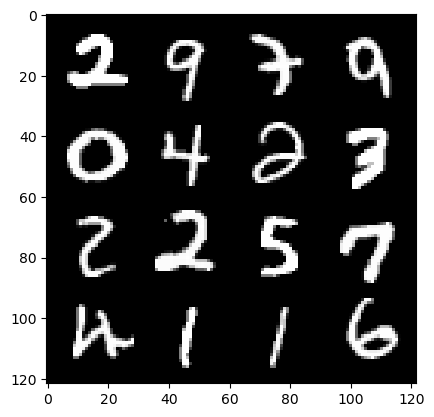

22: step 10500 / Gen loss: 7.001122112274171 / disc_loss: 0.012184156779355065


  0%|          | 0/469 [00:00<?, ?it/s]

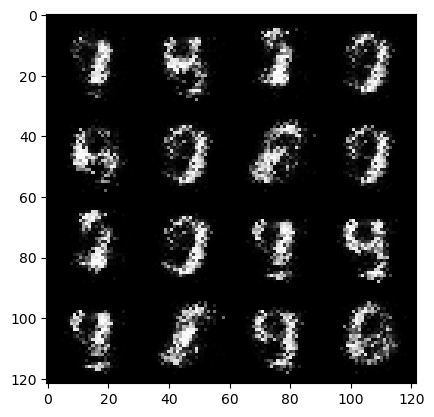

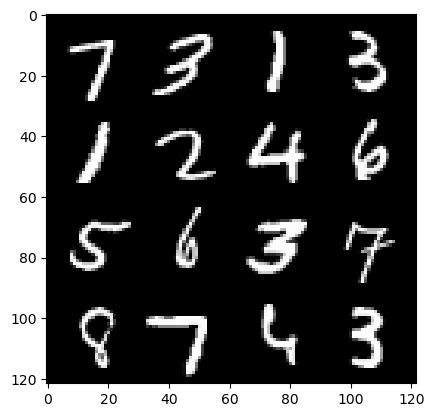

23: step 10800 / Gen loss: 6.507062838872279 / disc_loss: 0.012661084826880453


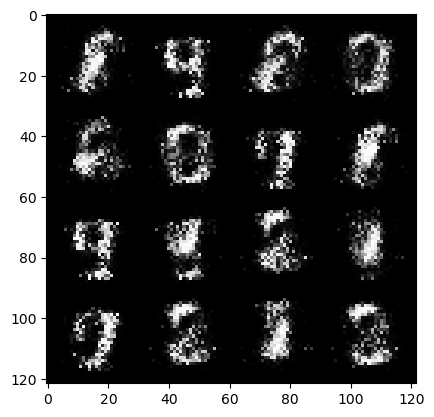

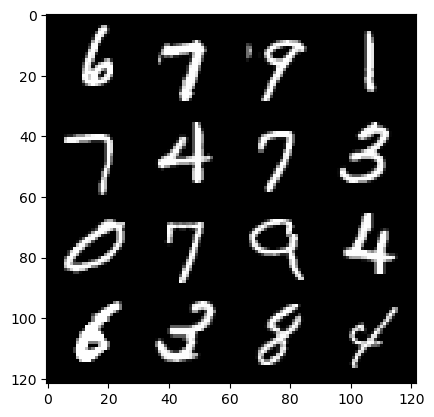

23: step 11100 / Gen loss: 6.718131612141923 / disc_loss: 0.013778359624557191


  0%|          | 0/469 [00:00<?, ?it/s]

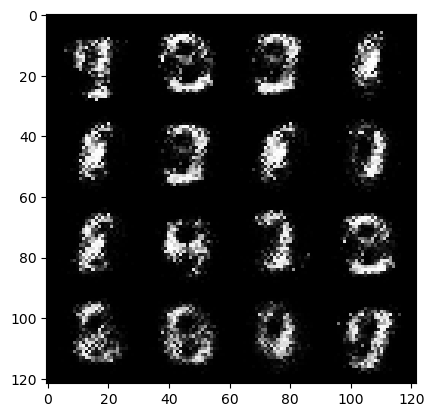

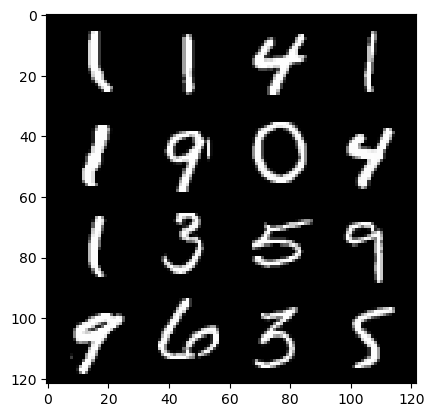

24: step 11400 / Gen loss: 7.013345551490786 / disc_loss: 0.010923700624067965


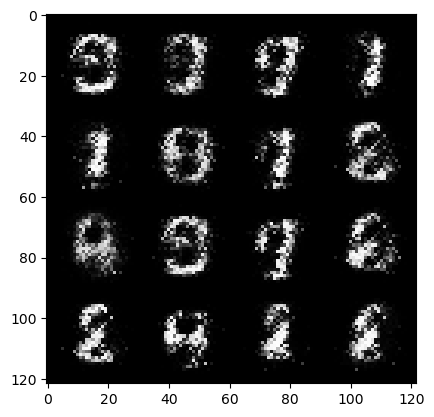

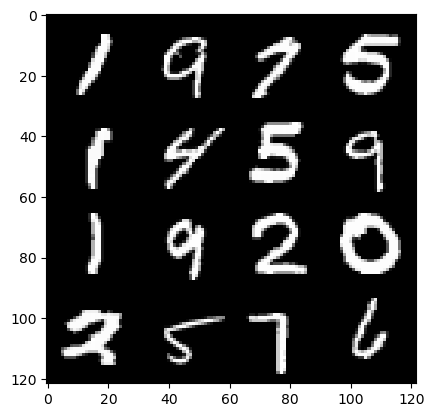

24: step 11700 / Gen loss: 6.874751599629714 / disc_loss: 0.0094747152350222


  0%|          | 0/469 [00:00<?, ?it/s]

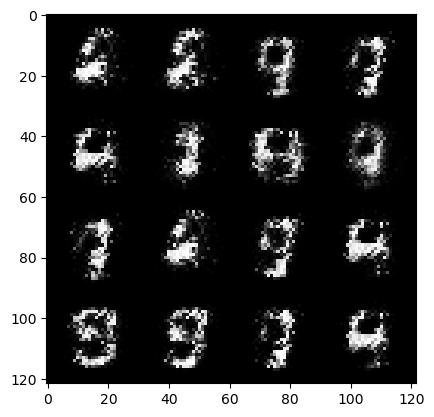

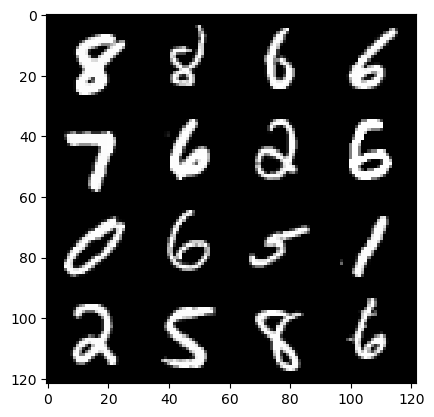

25: step 12000 / Gen loss: 6.804015185038249 / disc_loss: 0.009416570339041447


  0%|          | 0/469 [00:00<?, ?it/s]

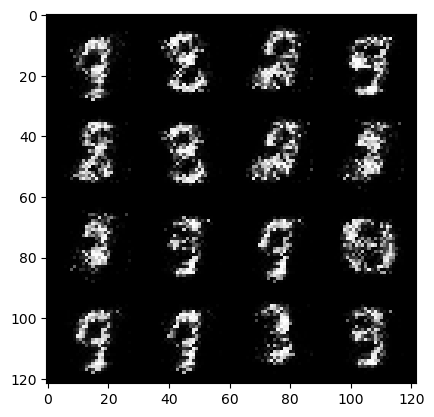

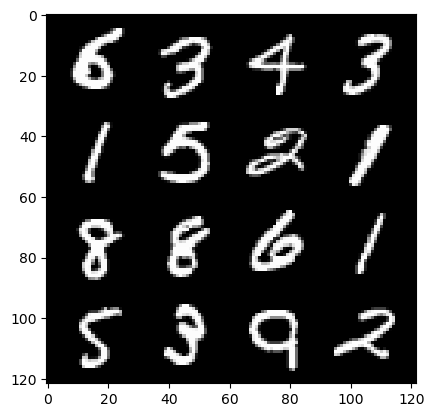

26: step 12300 / Gen loss: 6.795276654561359 / disc_loss: 0.010062393755263964


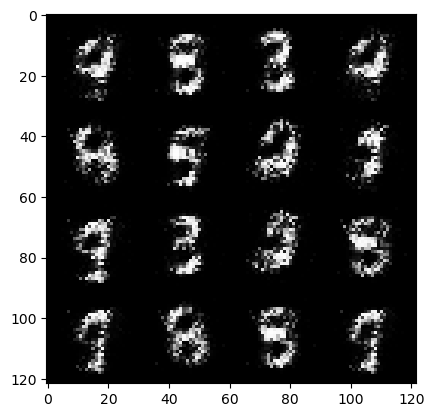

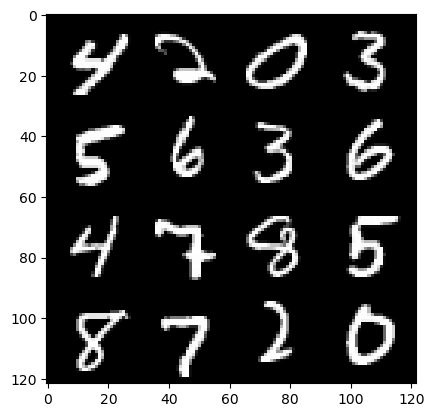

26: step 12600 / Gen loss: 6.456134279568986 / disc_loss: 0.011084375846354905


  0%|          | 0/469 [00:00<?, ?it/s]

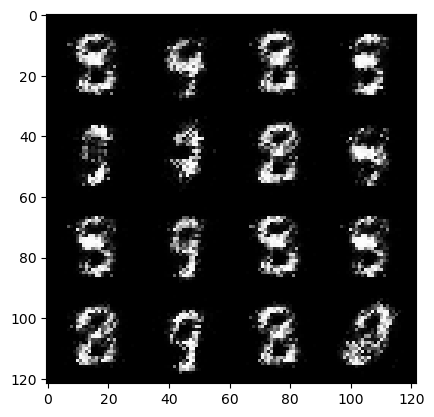

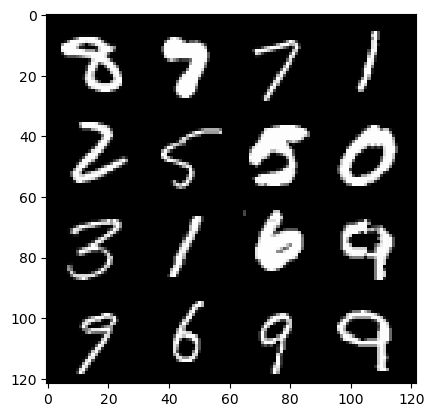

27: step 12900 / Gen loss: 6.456751384735108 / disc_loss: 0.012558010329181944


  0%|          | 0/469 [00:00<?, ?it/s]

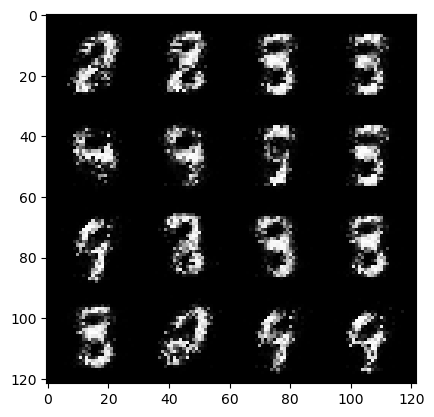

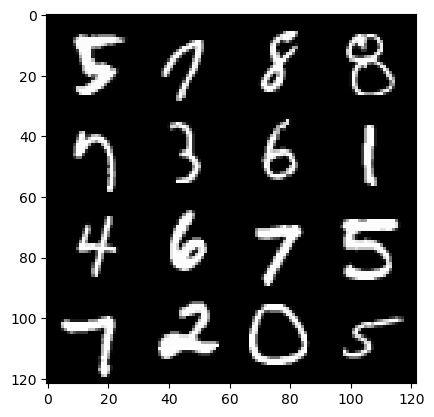

28: step 13200 / Gen loss: 6.247437891960142 / disc_loss: 0.013128365219260254


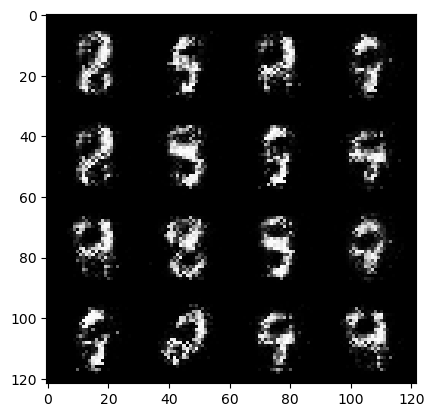

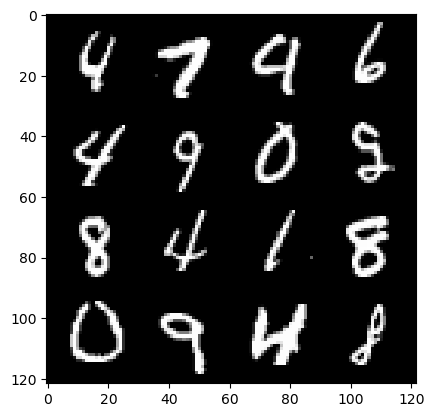

28: step 13500 / Gen loss: 6.231948431332903 / disc_loss: 0.016026638846378775


  0%|          | 0/469 [00:00<?, ?it/s]

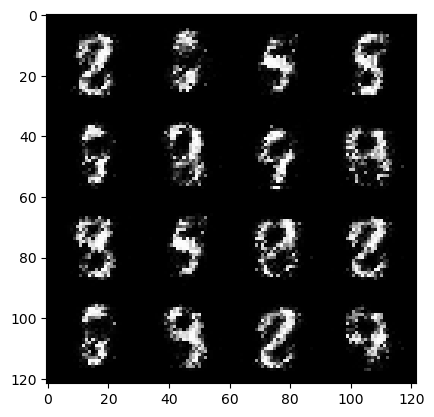

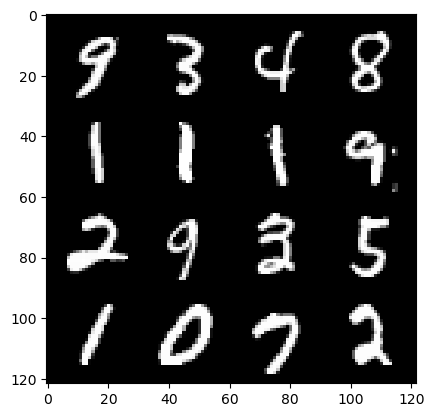

29: step 13800 / Gen loss: 6.023165046374003 / disc_loss: 0.01604099294946839


  0%|          | 0/469 [00:00<?, ?it/s]

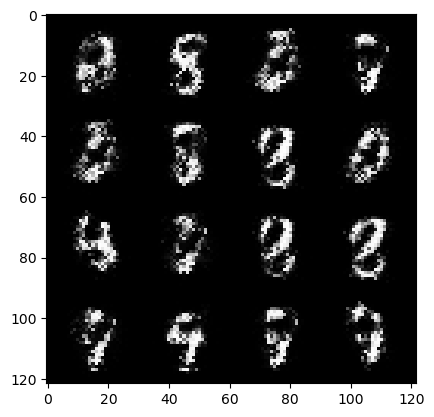

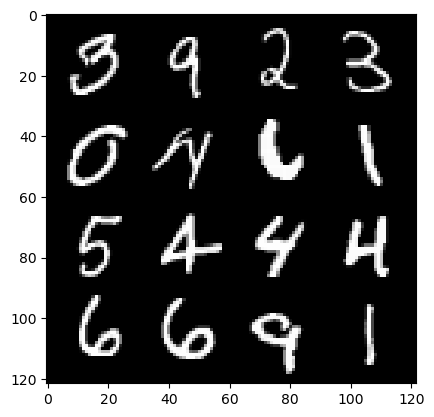

30: step 14100 / Gen loss: 6.276304423014321 / disc_loss: 0.014622124483187999


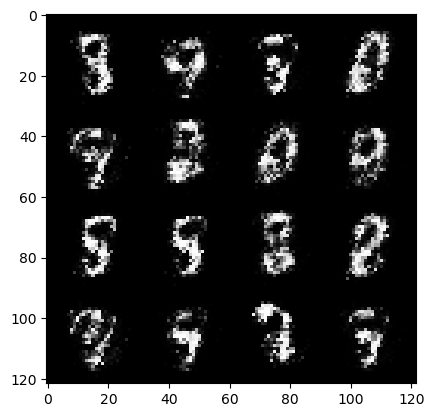

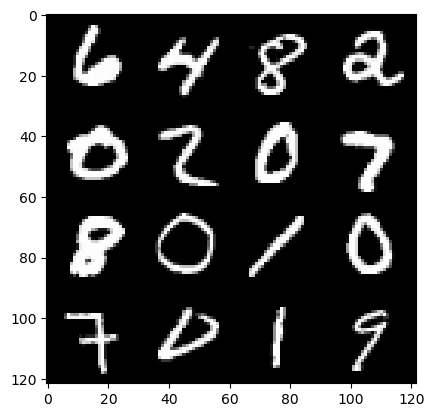

30: step 14400 / Gen loss: 6.595659675598145 / disc_loss: 0.01387383598911886


  0%|          | 0/469 [00:00<?, ?it/s]

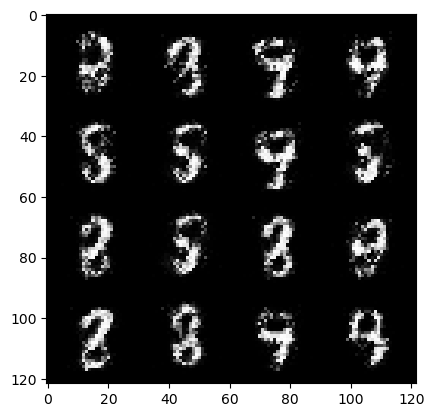

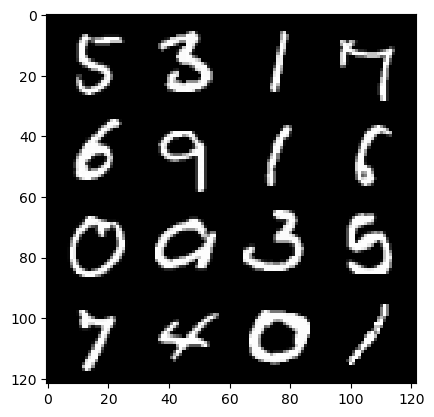

31: step 14700 / Gen loss: 6.393939388593042 / disc_loss: 0.017840322545186294


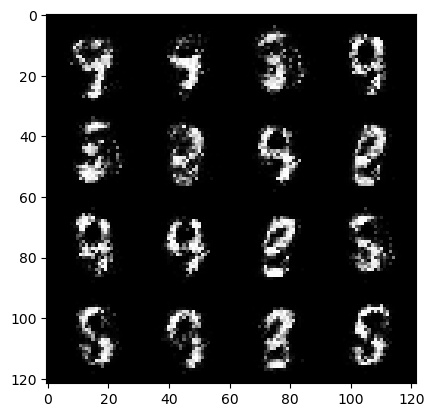

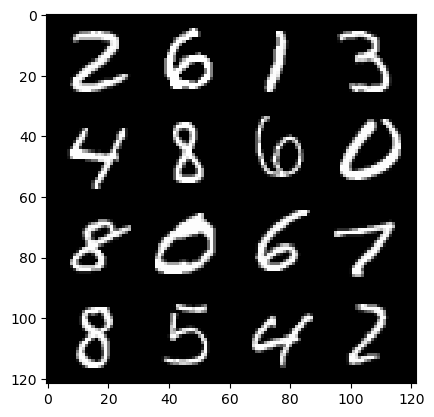

31: step 15000 / Gen loss: 6.201799200375875 / disc_loss: 0.019747306839562946


  0%|          | 0/469 [00:00<?, ?it/s]

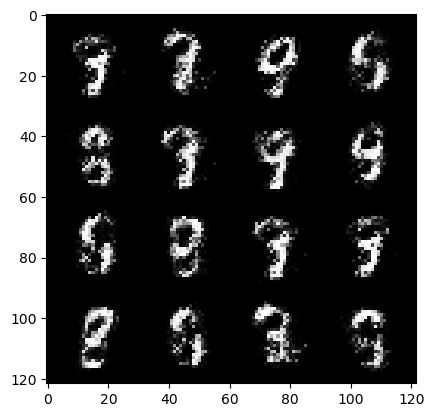

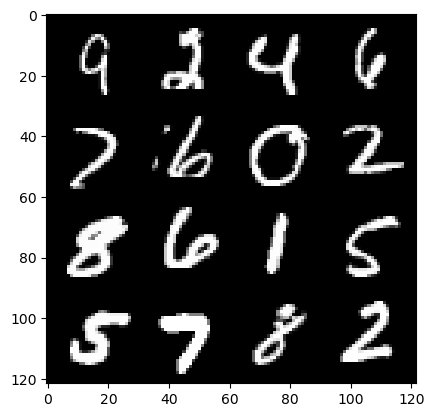

32: step 15300 / Gen loss: 6.18476493835449 / disc_loss: 0.02199964130142083


  0%|          | 0/469 [00:00<?, ?it/s]

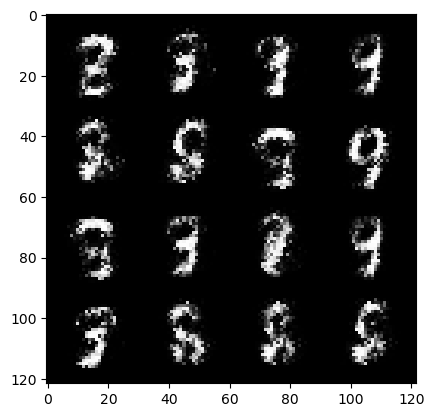

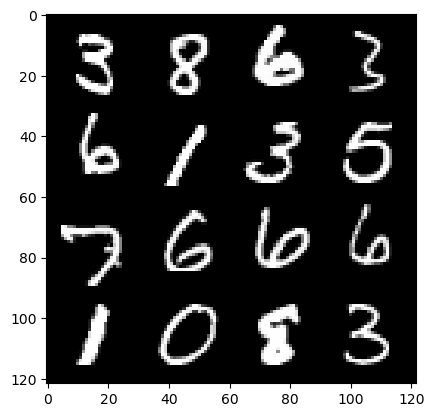

33: step 15600 / Gen loss: 6.246964958508811 / disc_loss: 0.028278544028289606


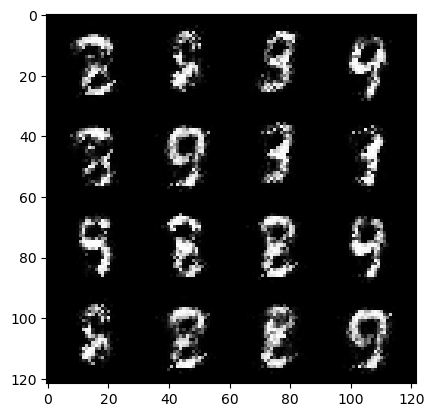

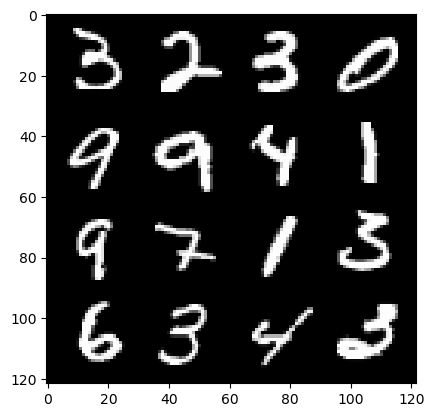

33: step 15900 / Gen loss: 5.832438538869224 / disc_loss: 0.02779628012950221


  0%|          | 0/469 [00:00<?, ?it/s]

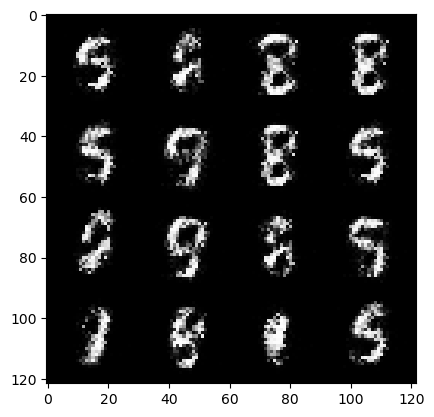

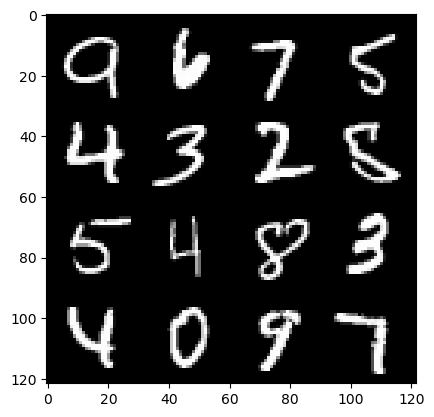

34: step 16200 / Gen loss: 5.952141569455462 / disc_loss: 0.031836678585968885


  0%|          | 0/469 [00:00<?, ?it/s]

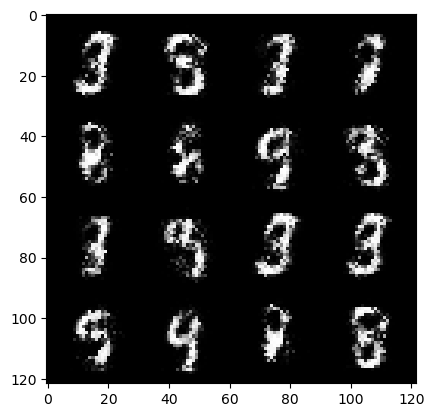

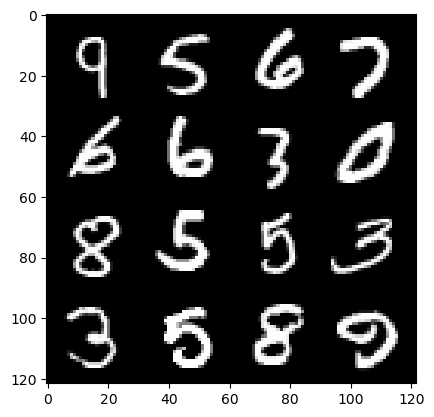

35: step 16500 / Gen loss: 5.451839236418406 / disc_loss: 0.035719379009678955


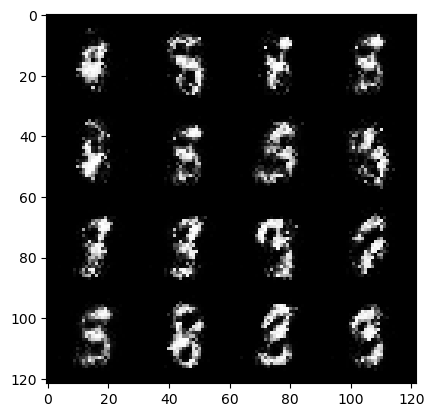

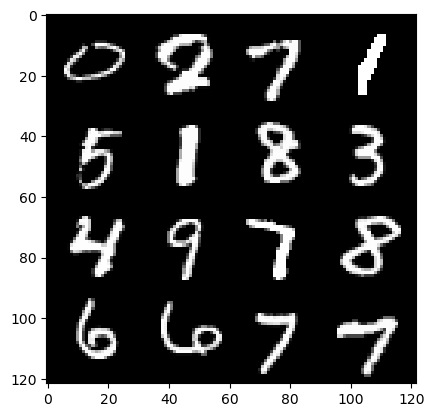

35: step 16800 / Gen loss: 5.719127497673035 / disc_loss: 0.03686661253062389


  0%|          | 0/469 [00:00<?, ?it/s]

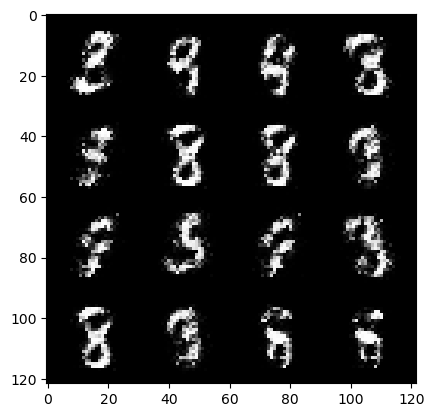

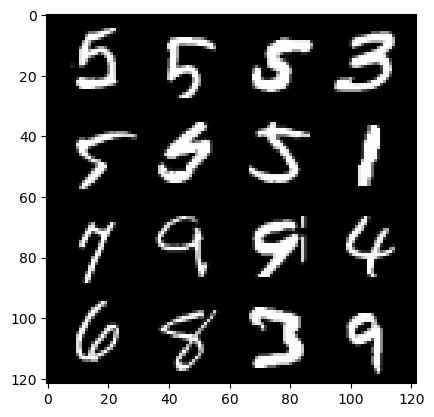

36: step 17100 / Gen loss: 5.920523916880292 / disc_loss: 0.03382369337448228


  0%|          | 0/469 [00:00<?, ?it/s]

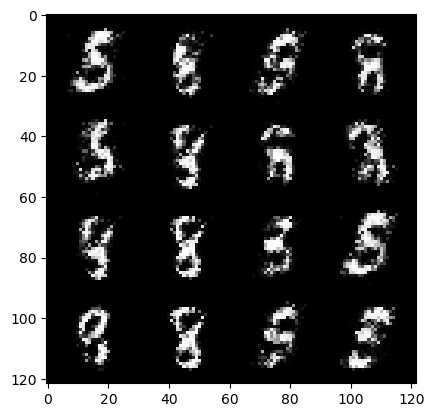

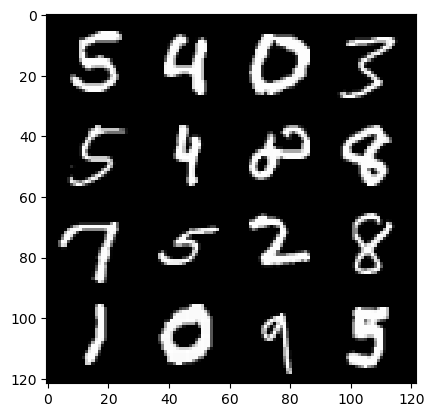

37: step 17400 / Gen loss: 5.738864386876423 / disc_loss: 0.03259299857076256


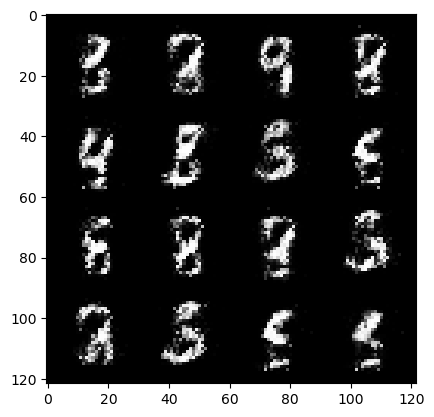

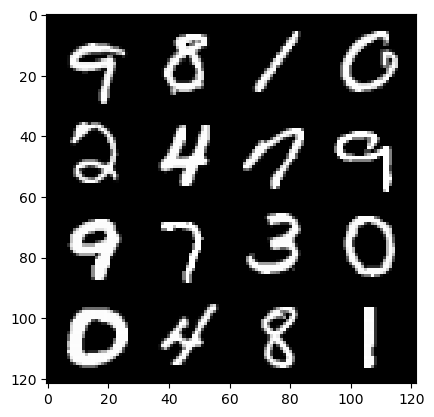

37: step 17700 / Gen loss: 5.9400842889149965 / disc_loss: 0.03084274143446238


  0%|          | 0/469 [00:00<?, ?it/s]

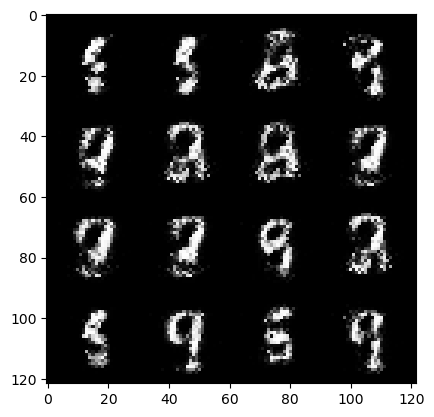

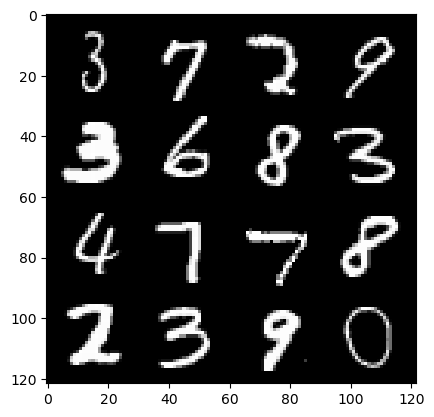

38: step 18000 / Gen loss: 5.995458436012269 / disc_loss: 0.03420213103449594


  0%|          | 0/469 [00:00<?, ?it/s]

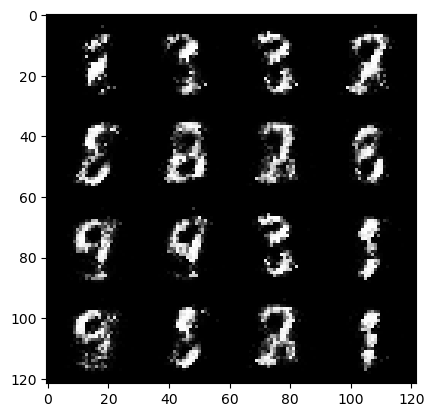

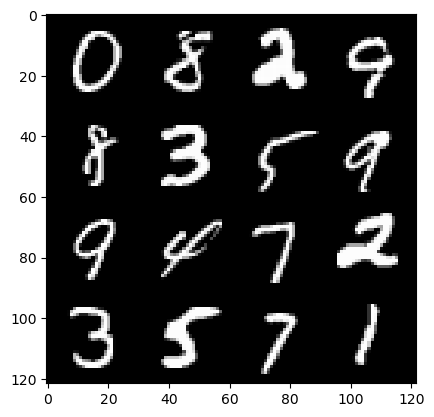

39: step 18300 / Gen loss: 5.655411151250201 / disc_loss: 0.04213586643338206


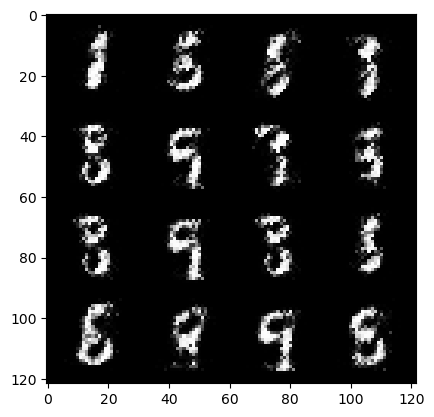

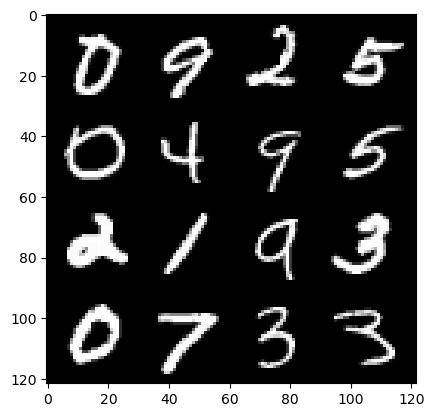

39: step 18600 / Gen loss: 5.7161606740951525 / disc_loss: 0.03657453445717692


  0%|          | 0/469 [00:00<?, ?it/s]

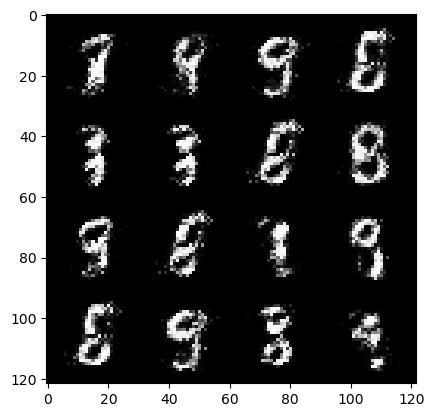

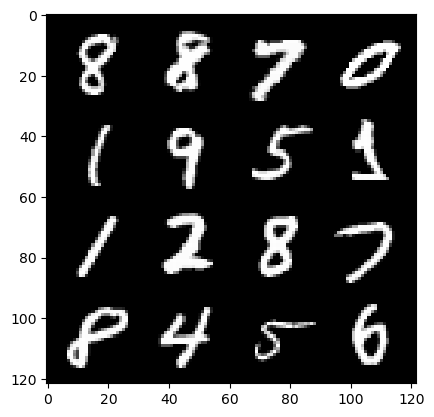

40: step 18900 / Gen loss: 5.814093354543054 / disc_loss: 0.03271145415647576


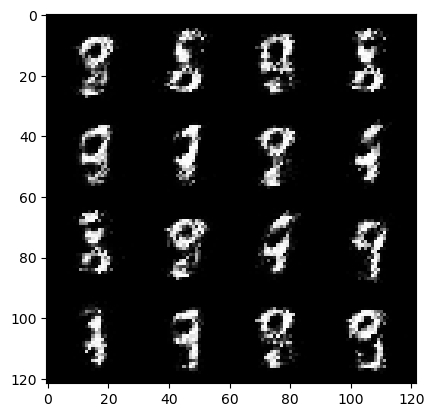

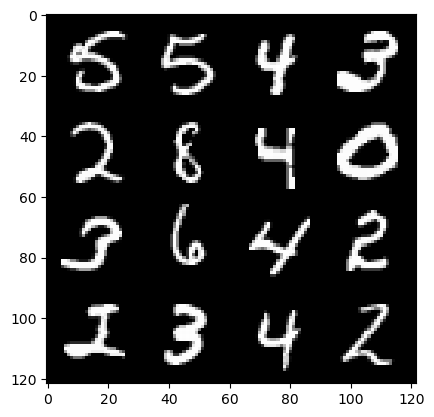

40: step 19200 / Gen loss: 5.519367671012881 / disc_loss: 0.03991802065012356


  0%|          | 0/469 [00:00<?, ?it/s]

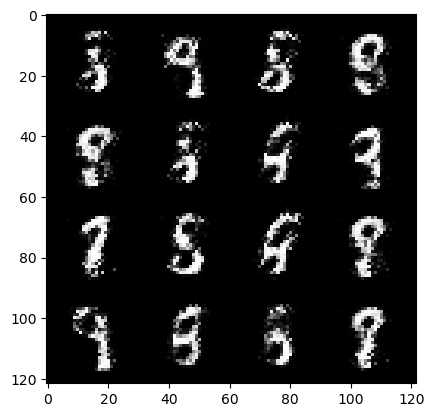

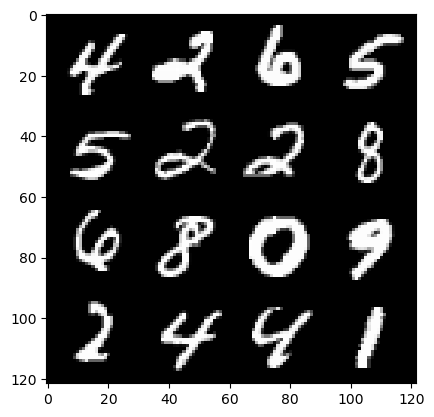

41: step 19500 / Gen loss: 5.6993274052937855 / disc_loss: 0.03794406516477468


  0%|          | 0/469 [00:00<?, ?it/s]

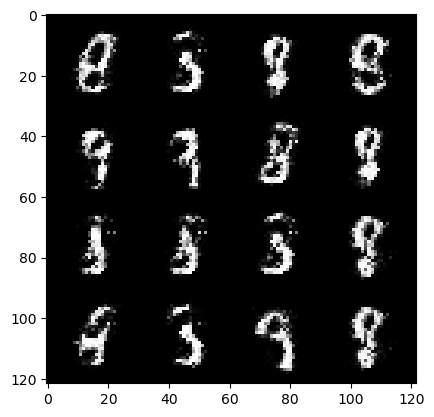

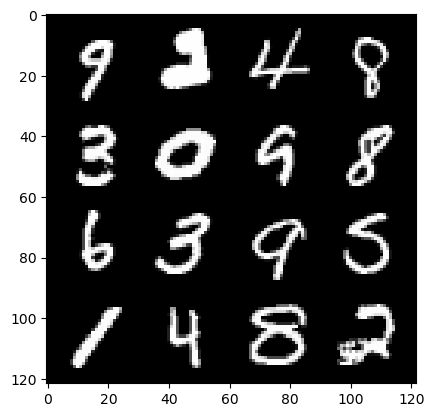

42: step 19800 / Gen loss: 5.92172669092814 / disc_loss: 0.03393861696124077


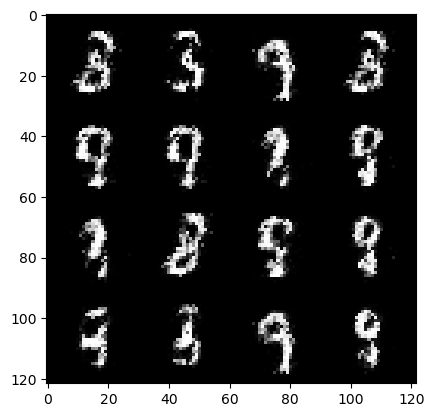

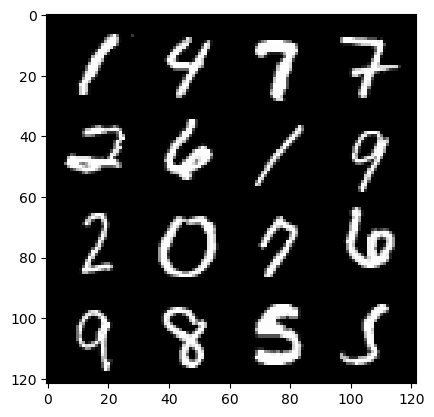

42: step 20100 / Gen loss: 5.806057319641111 / disc_loss: 0.04444073145588239


  0%|          | 0/469 [00:00<?, ?it/s]

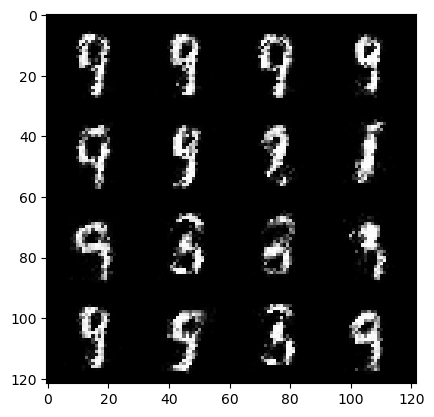

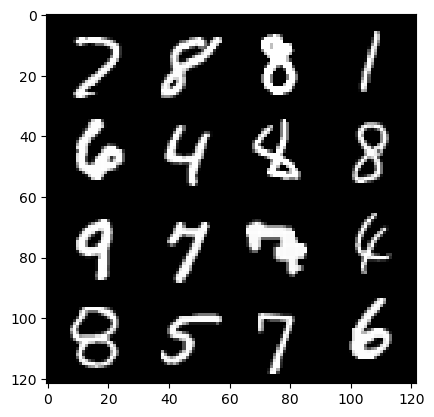

43: step 20400 / Gen loss: 5.7904805072148635 / disc_loss: 0.042239798111841045


  0%|          | 0/469 [00:00<?, ?it/s]

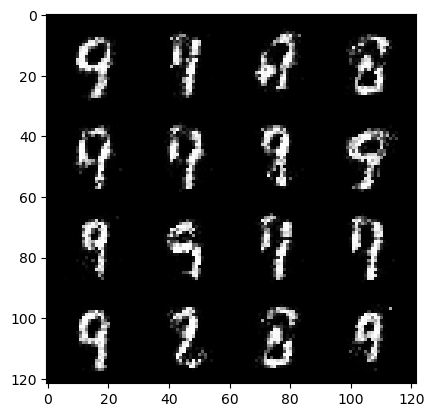

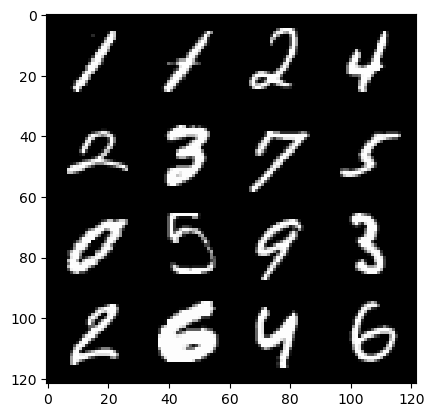

44: step 20700 / Gen loss: 5.975015713373818 / disc_loss: 0.044313583229668455


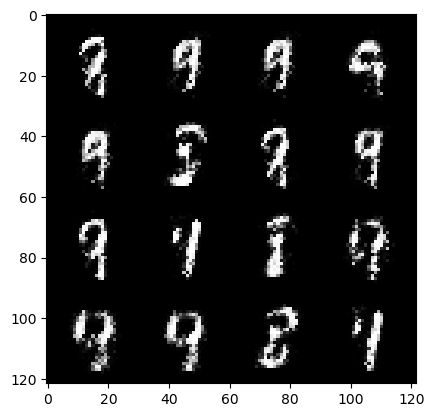

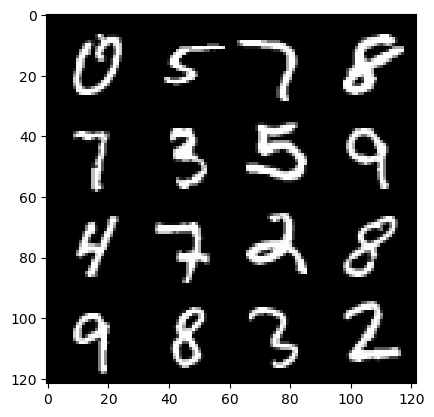

44: step 21000 / Gen loss: 5.261368398666385 / disc_loss: 0.04775819974641002


  0%|          | 0/469 [00:00<?, ?it/s]

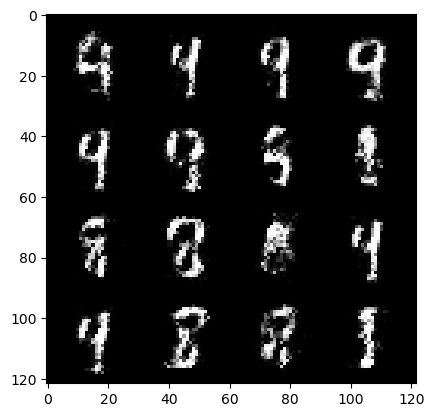

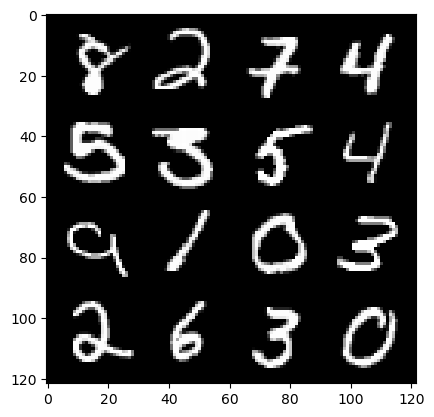

45: step 21300 / Gen loss: 5.250232235590618 / disc_loss: 0.051793076706429325


  0%|          | 0/469 [00:00<?, ?it/s]

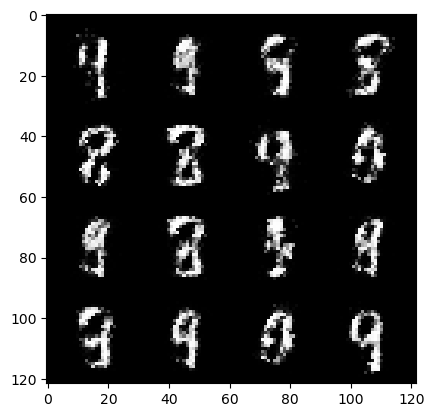

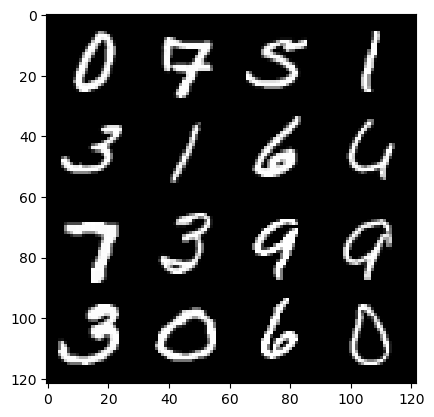

46: step 21600 / Gen loss: 5.26924904982249 / disc_loss: 0.05034703345348436


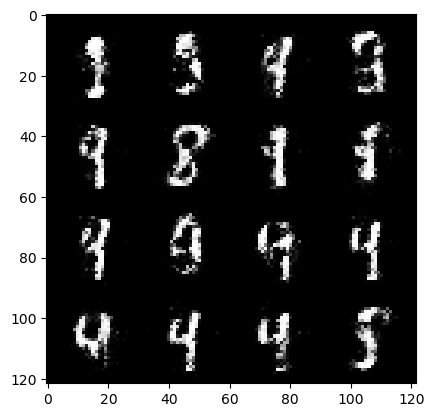

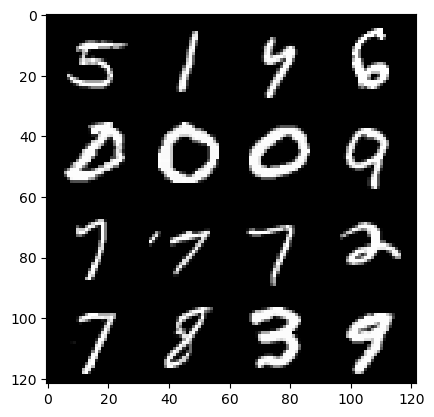

46: step 21900 / Gen loss: 5.4005665588378955 / disc_loss: 0.05634787452096739


  0%|          | 0/469 [00:00<?, ?it/s]

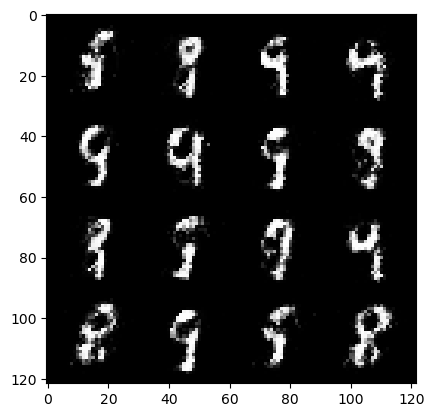

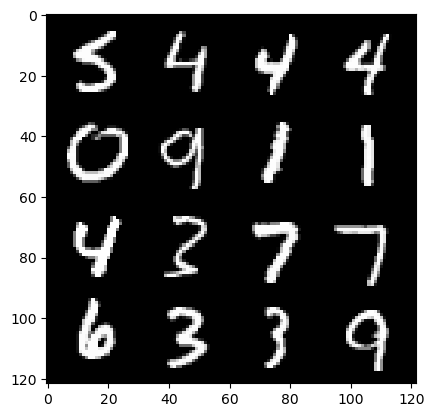

47: step 22200 / Gen loss: 5.286080632209777 / disc_loss: 0.06259189260192215


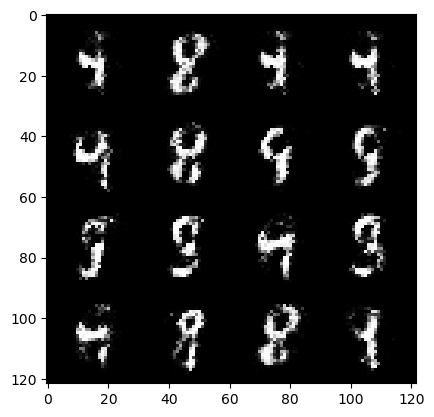

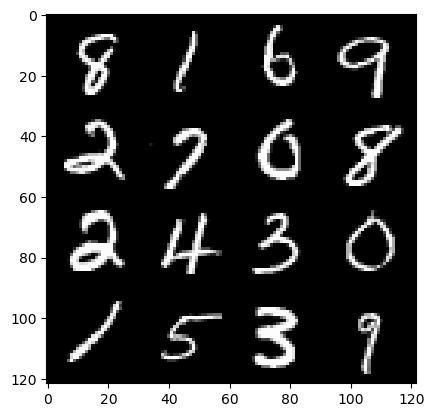

47: step 22500 / Gen loss: 5.03311711152394 / disc_loss: 0.06494685545253254


  0%|          | 0/469 [00:00<?, ?it/s]

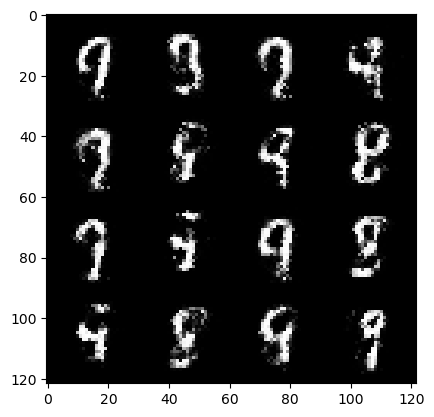

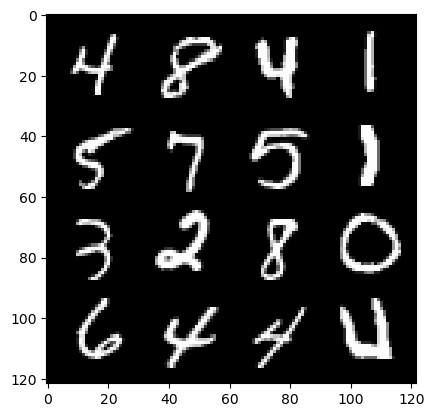

48: step 22800 / Gen loss: 5.0370217506090835 / disc_loss: 0.06470971996275086


  0%|          | 0/469 [00:00<?, ?it/s]

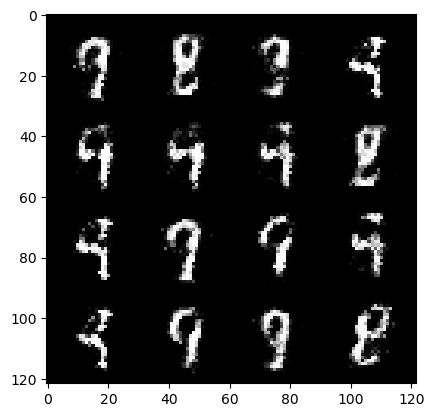

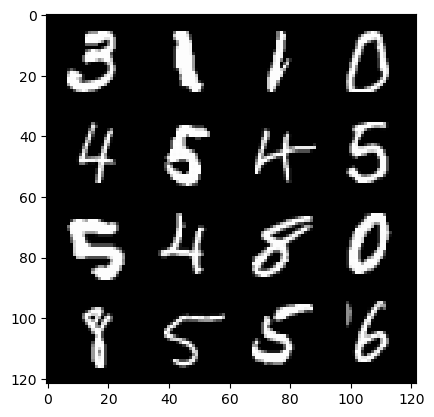

49: step 23100 / Gen loss: 5.012403519948322 / disc_loss: 0.05564777045200268


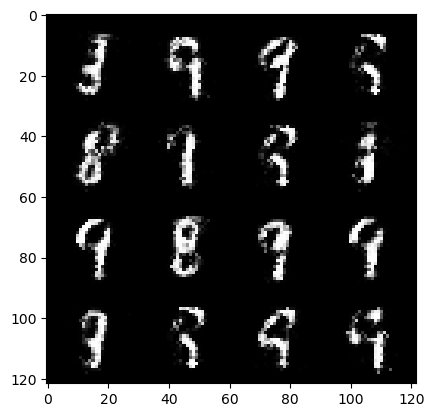

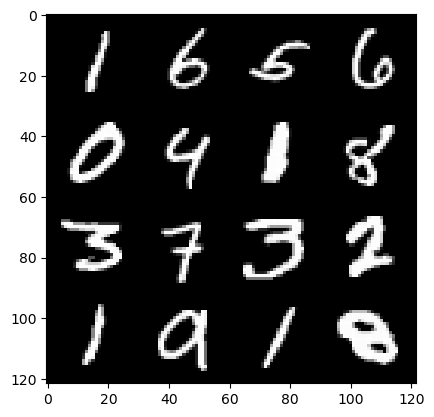

49: step 23400 / Gen loss: 4.755231523513792 / disc_loss: 0.06344148518517616


  0%|          | 0/469 [00:00<?, ?it/s]

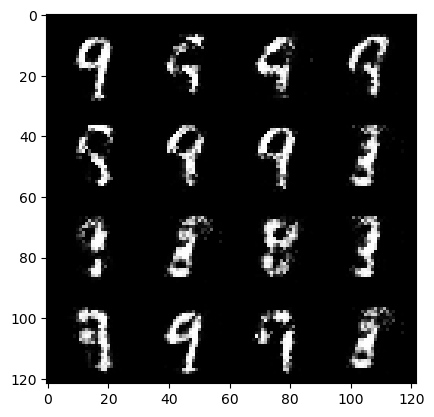

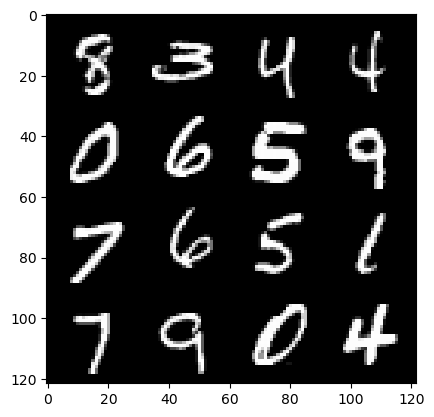

50: step 23700 / Gen loss: 4.964998660882316 / disc_loss: 0.06277193287387488


  0%|          | 0/469 [00:00<?, ?it/s]

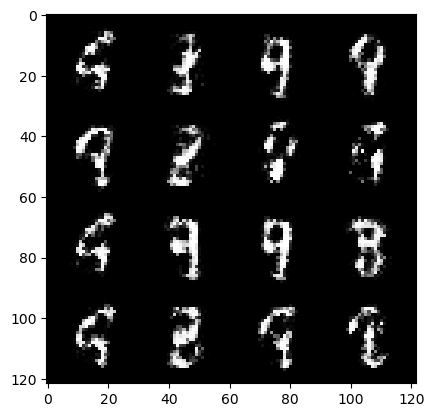

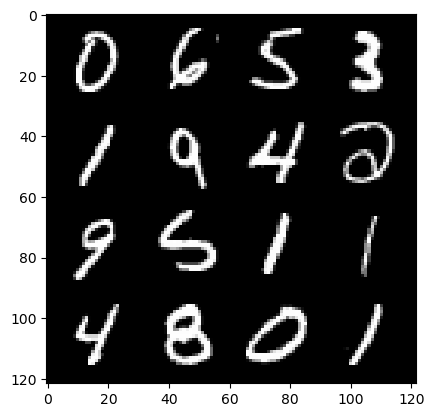

51: step 24000 / Gen loss: 4.882347319126131 / disc_loss: 0.06023964470873283


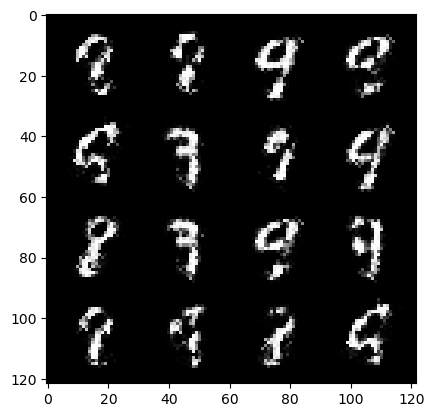

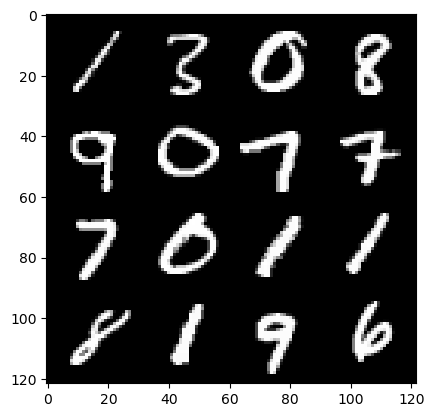

51: step 24300 / Gen loss: 4.884044638474778 / disc_loss: 0.07222431364158796


  0%|          | 0/469 [00:00<?, ?it/s]

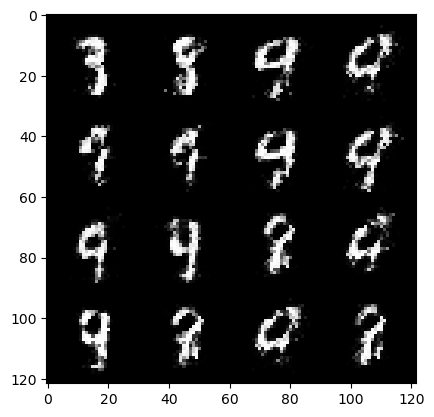

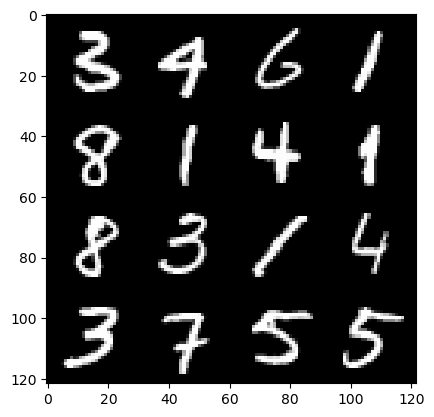

52: step 24600 / Gen loss: 4.796351689497629 / disc_loss: 0.06844284527003765


  0%|          | 0/469 [00:00<?, ?it/s]

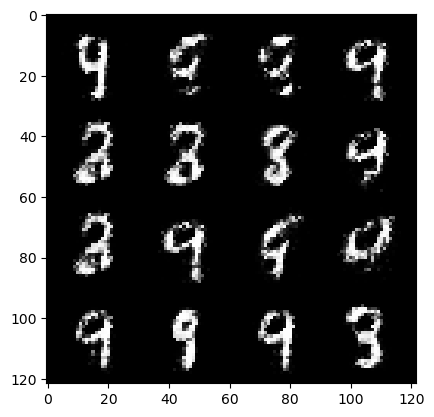

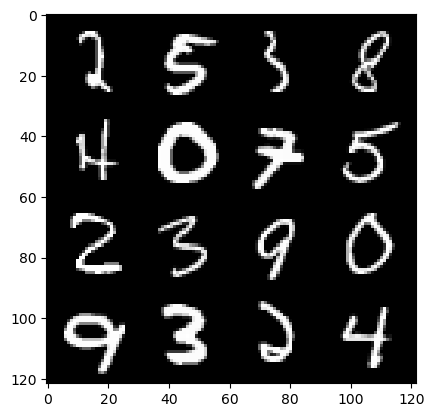

53: step 24900 / Gen loss: 4.594307874838514 / disc_loss: 0.07474170463780562


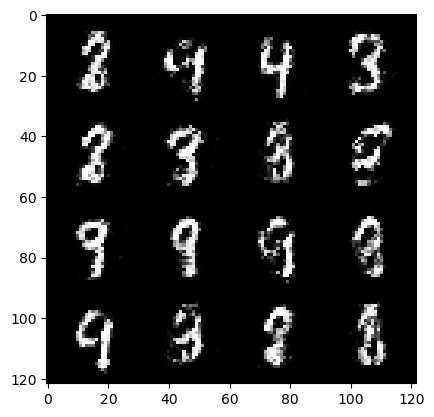

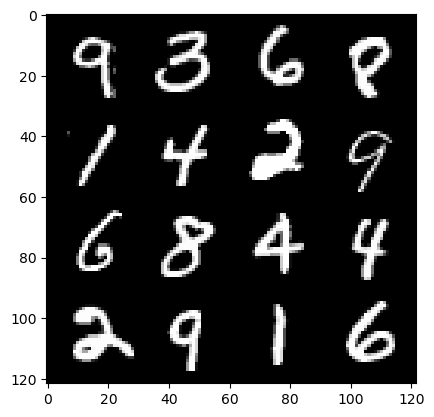

53: step 25200 / Gen loss: 4.7207320133845 / disc_loss: 0.0713809739984571


  0%|          | 0/469 [00:00<?, ?it/s]

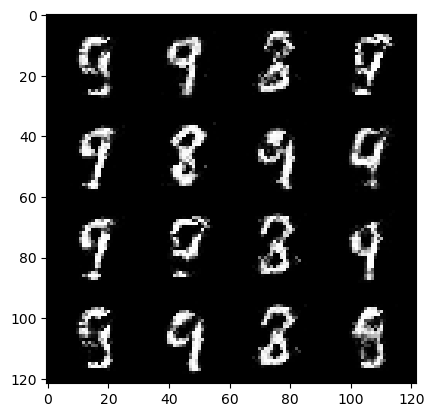

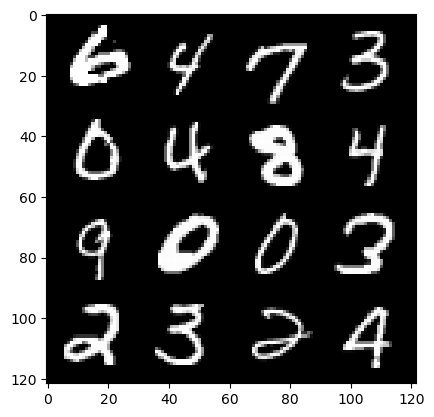

54: step 25500 / Gen loss: 4.573168695767719 / disc_loss: 0.07519791338592771


  0%|          | 0/469 [00:00<?, ?it/s]

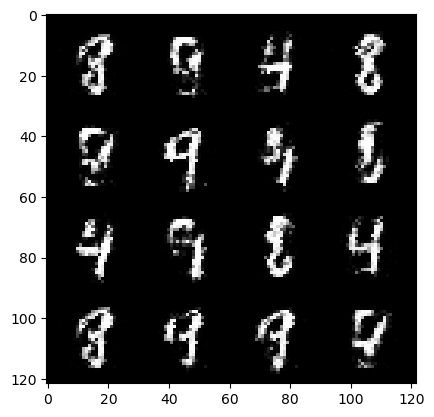

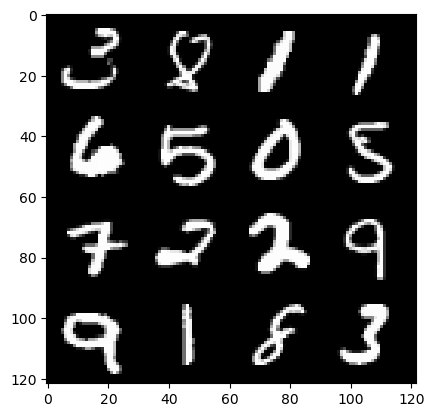

55: step 25800 / Gen loss: 4.617941108544665 / disc_loss: 0.08619890637074905


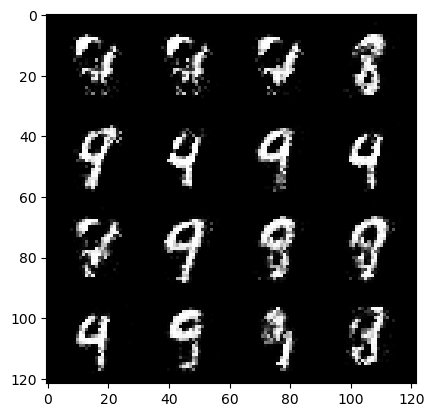

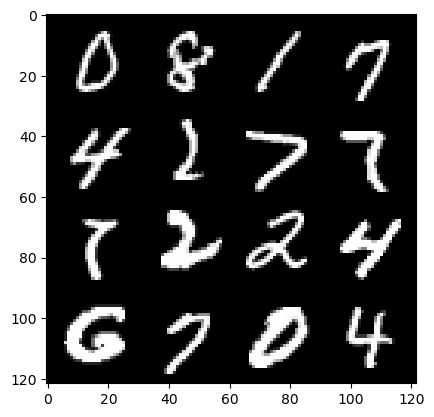

55: step 26100 / Gen loss: 4.451075313091276 / disc_loss: 0.0818158569807808


  0%|          | 0/469 [00:00<?, ?it/s]

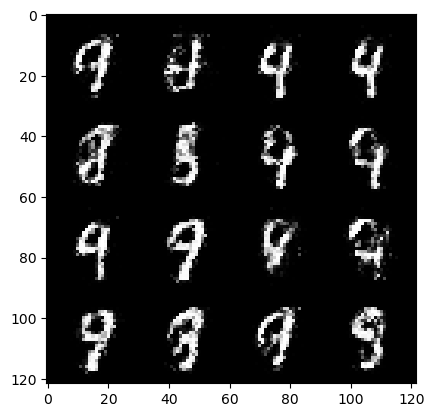

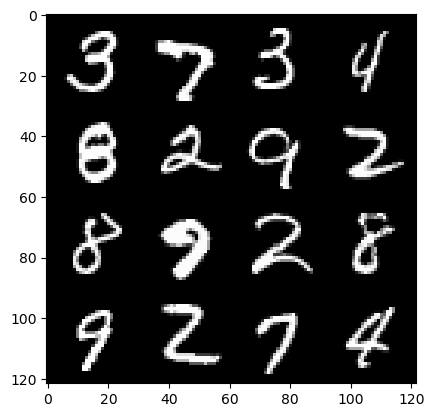

56: step 26400 / Gen loss: 4.59355313460032 / disc_loss: 0.07791269152114795


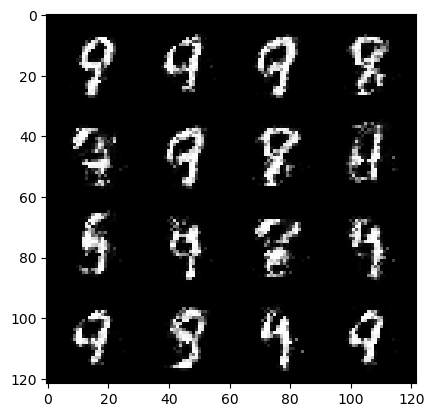

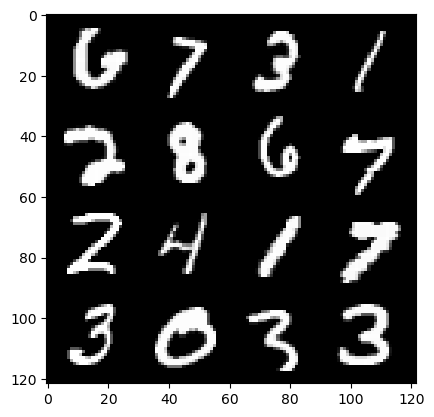

56: step 26700 / Gen loss: 4.518164347807565 / disc_loss: 0.08374237629274524


  0%|          | 0/469 [00:00<?, ?it/s]

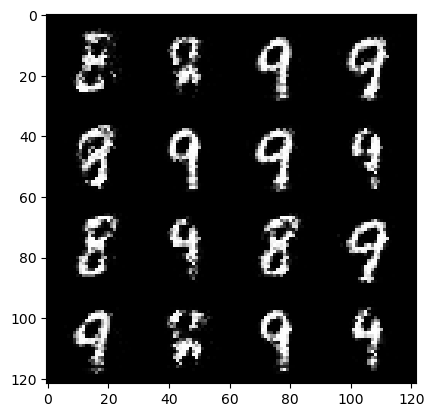

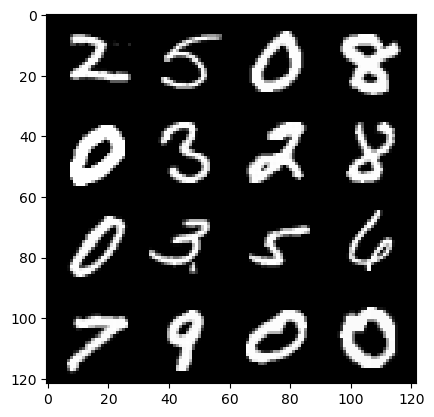

57: step 27000 / Gen loss: 4.541262849966686 / disc_loss: 0.07992385099331532


  0%|          | 0/469 [00:00<?, ?it/s]

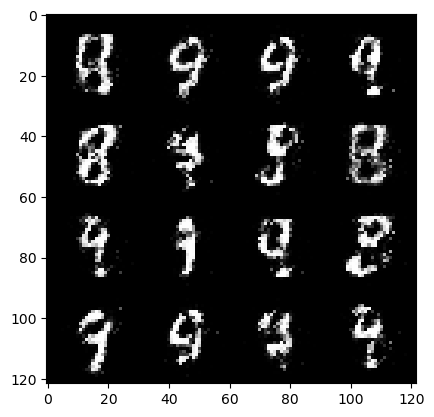

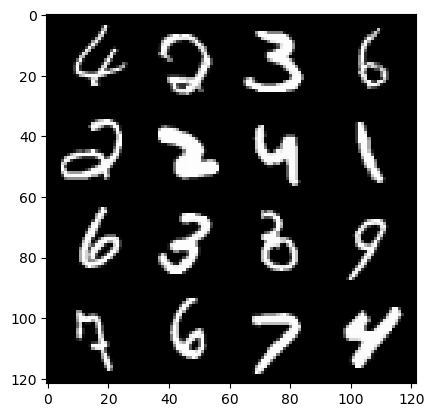

58: step 27300 / Gen loss: 4.527516396045684 / disc_loss: 0.08302314509327215


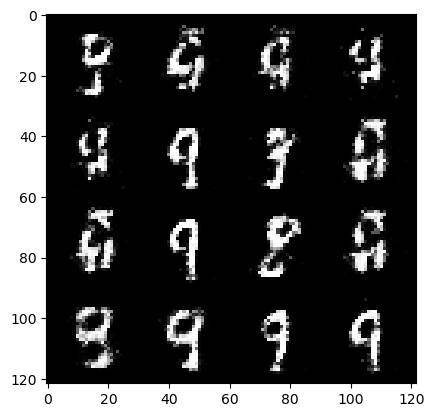

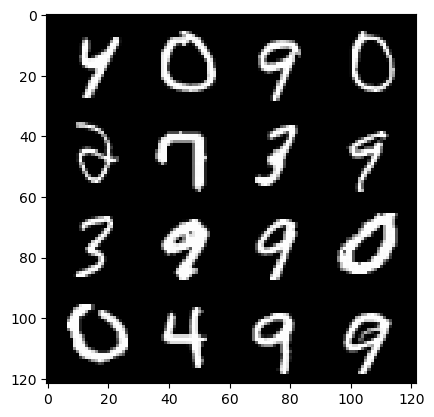

58: step 27600 / Gen loss: 4.1887713344891875 / disc_loss: 0.09792838824292024


  0%|          | 0/469 [00:00<?, ?it/s]

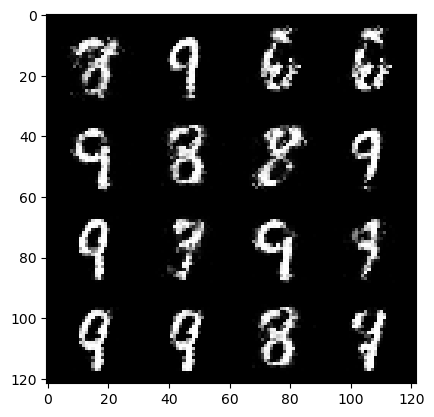

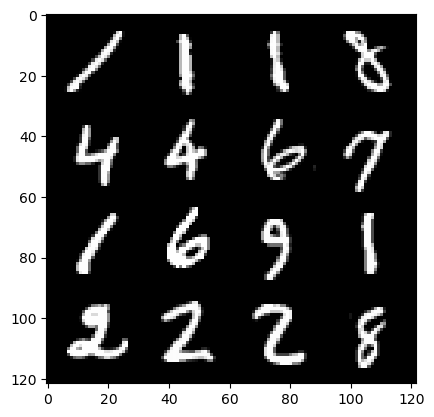

59: step 27900 / Gen loss: 4.456809348265332 / disc_loss: 0.08795237611979252


  0%|          | 0/469 [00:00<?, ?it/s]

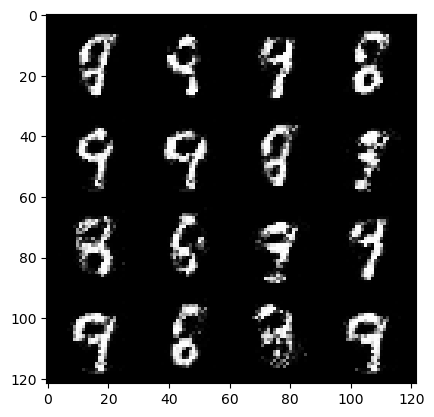

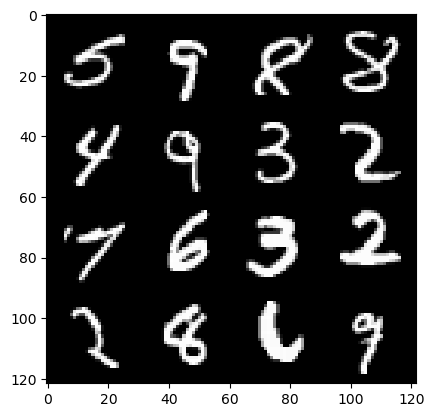

60: step 28200 / Gen loss: 4.179675331910456 / disc_loss: 0.09878885528693593


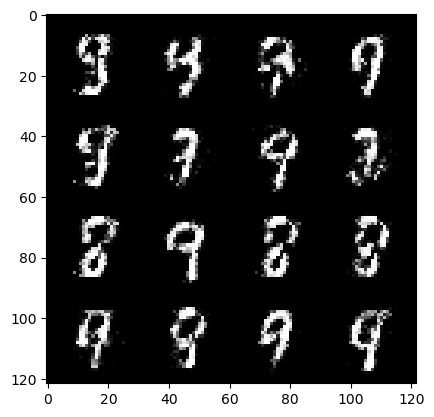

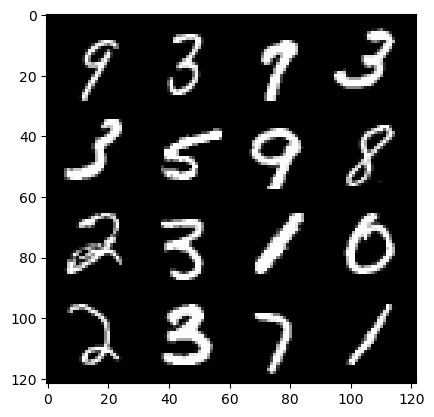

60: step 28500 / Gen loss: 4.2052389494578035 / disc_loss: 0.09054142814129593


  0%|          | 0/469 [00:00<?, ?it/s]

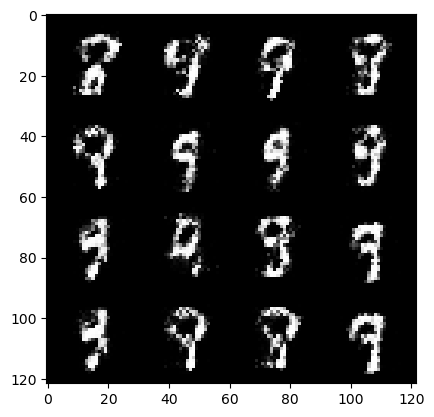

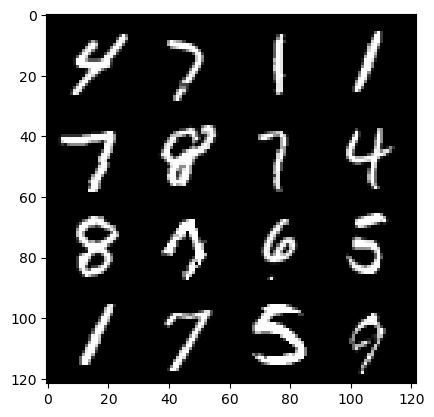

61: step 28800 / Gen loss: 4.06037142833074 / disc_loss: 0.0957573284581304


  0%|          | 0/469 [00:00<?, ?it/s]

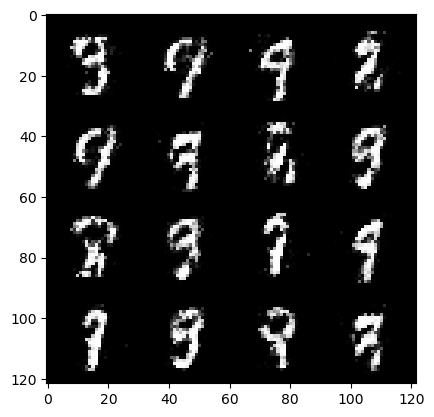

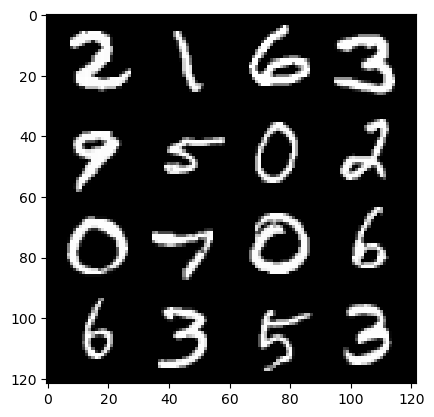

62: step 29100 / Gen loss: 4.196935083866122 / disc_loss: 0.0847662459189693


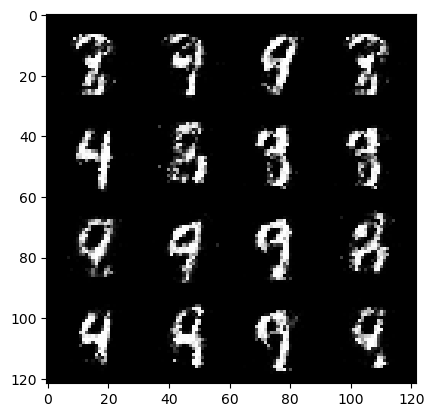

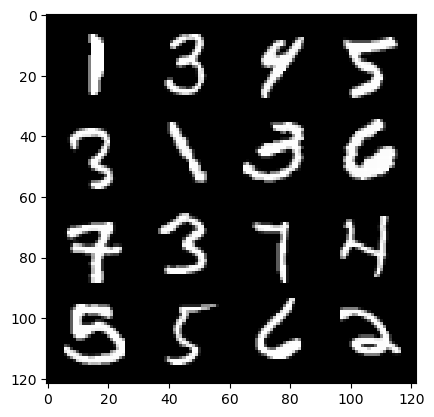

62: step 29400 / Gen loss: 4.159478803475699 / disc_loss: 0.0870319534155229


  0%|          | 0/469 [00:00<?, ?it/s]

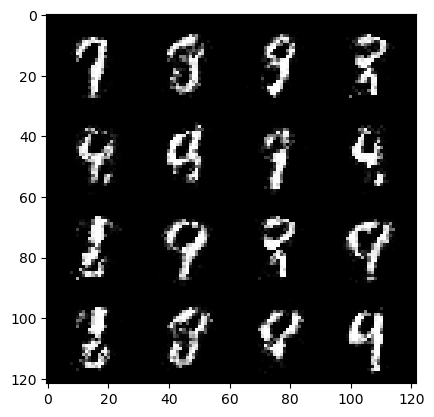

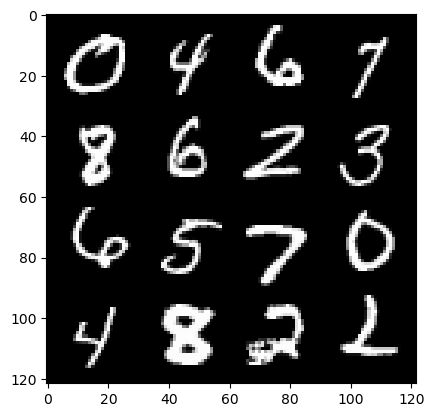

63: step 29700 / Gen loss: 4.234297001361852 / disc_loss: 0.08163292811562618


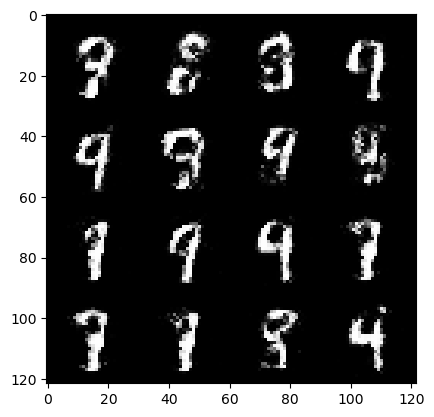

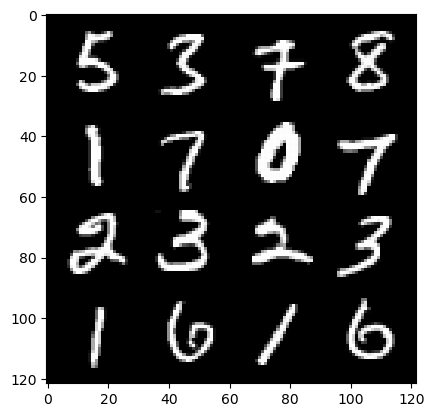

63: step 30000 / Gen loss: 4.142144102255504 / disc_loss: 0.09572675549735625


  0%|          | 0/469 [00:00<?, ?it/s]

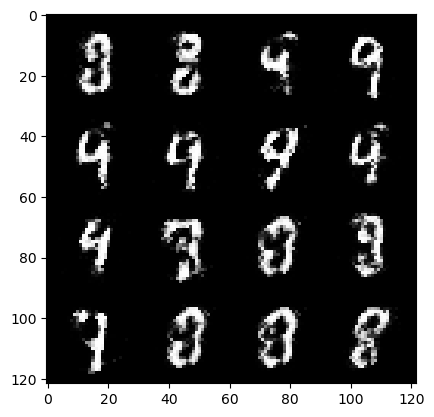

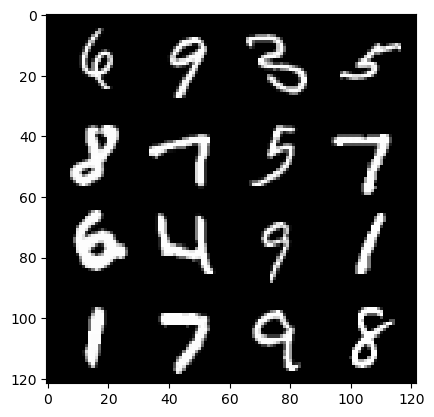

64: step 30300 / Gen loss: 4.0008262022336325 / disc_loss: 0.10055631948014099


  0%|          | 0/469 [00:00<?, ?it/s]

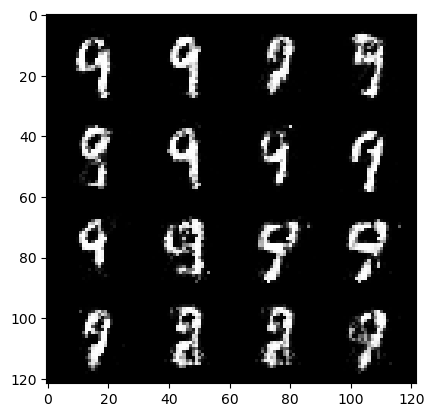

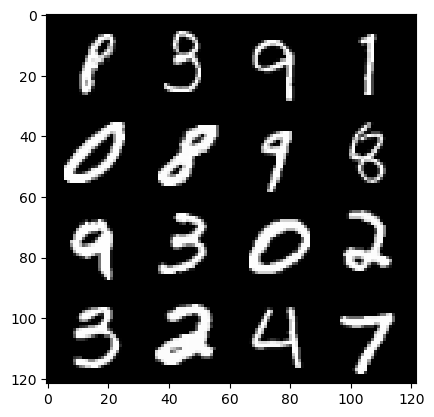

65: step 30600 / Gen loss: 4.186312870184579 / disc_loss: 0.09175993619486687


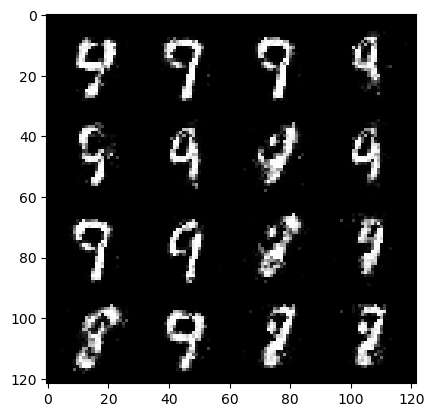

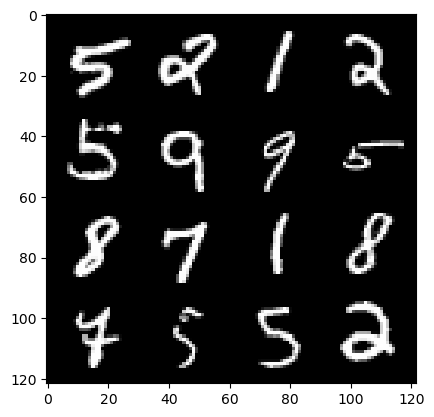

65: step 30900 / Gen loss: 4.183741537729898 / disc_loss: 0.09798528189460443


  0%|          | 0/469 [00:00<?, ?it/s]

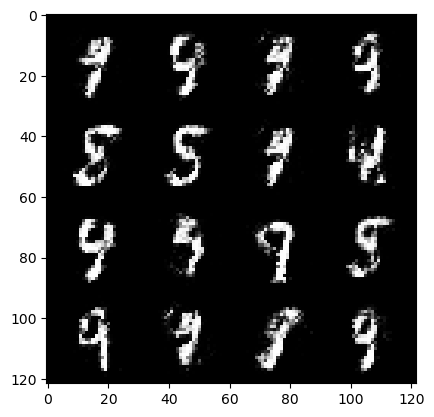

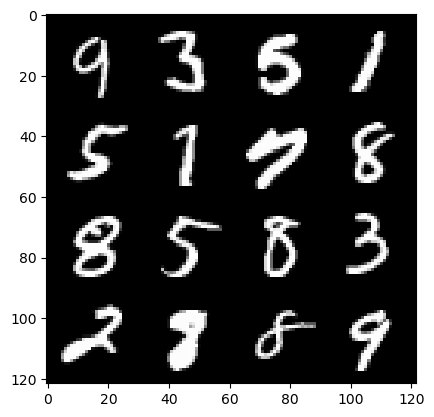

66: step 31200 / Gen loss: 3.99491992632548 / disc_loss: 0.10770325097565846


  0%|          | 0/469 [00:00<?, ?it/s]

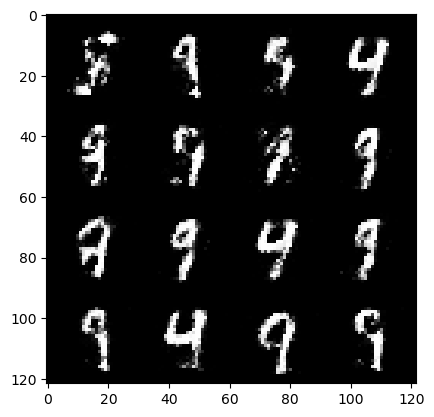

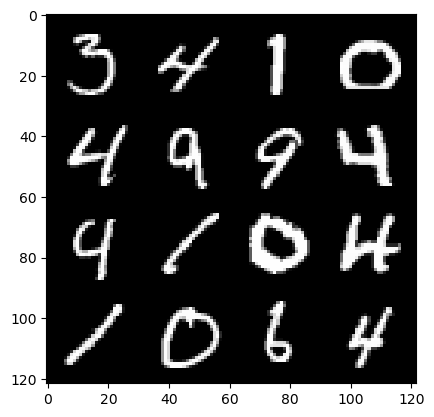

67: step 31500 / Gen loss: 4.025977261861164 / disc_loss: 0.09644490962227181


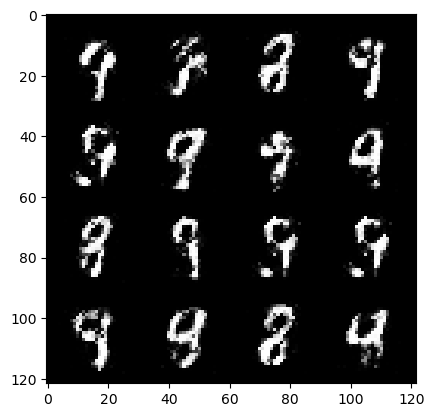

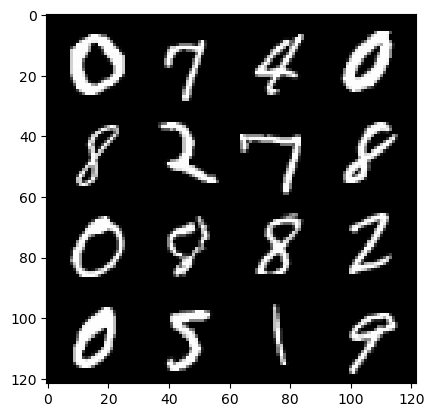

67: step 31800 / Gen loss: 4.024339792728426 / disc_loss: 0.10108847055584187


  0%|          | 0/469 [00:00<?, ?it/s]

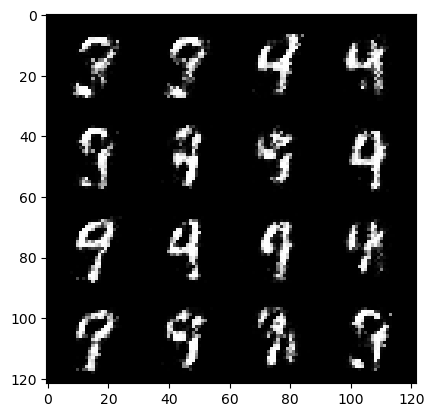

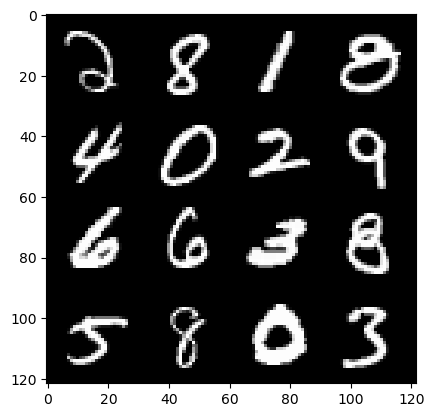

68: step 32100 / Gen loss: 3.9176631339391057 / disc_loss: 0.09923465395967167


  0%|          | 0/469 [00:00<?, ?it/s]

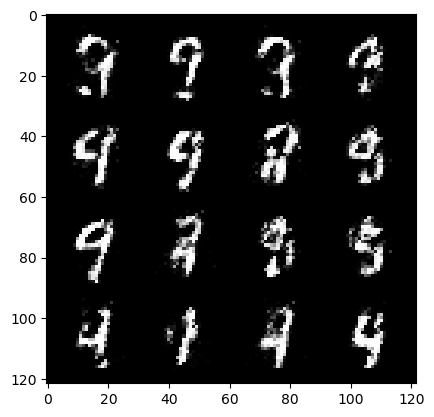

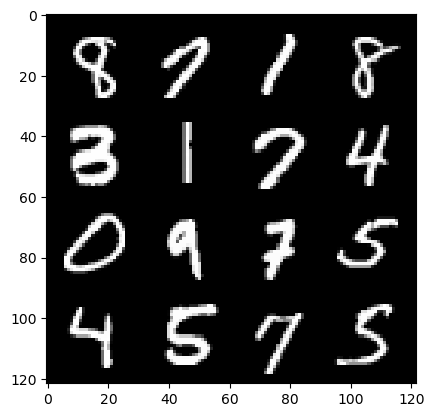

69: step 32400 / Gen loss: 4.008637296358743 / disc_loss: 0.10439033241321644


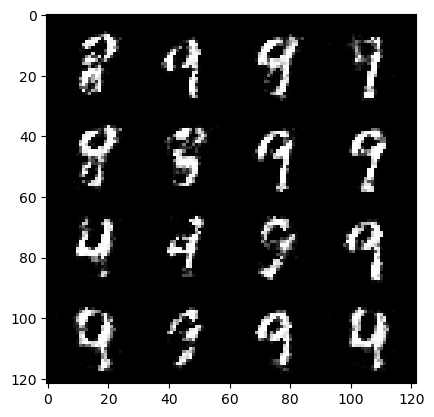

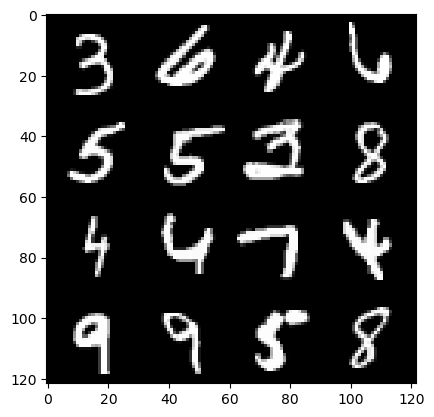

69: step 32700 / Gen loss: 3.912059209346771 / disc_loss: 0.10882465388625863


  0%|          | 0/469 [00:00<?, ?it/s]

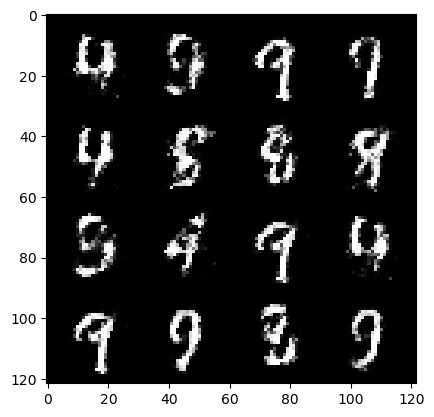

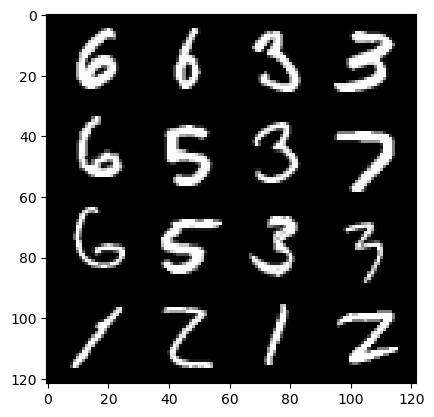

70: step 33000 / Gen loss: 3.8342626492182417 / disc_loss: 0.10862731891373796


  0%|          | 0/469 [00:00<?, ?it/s]

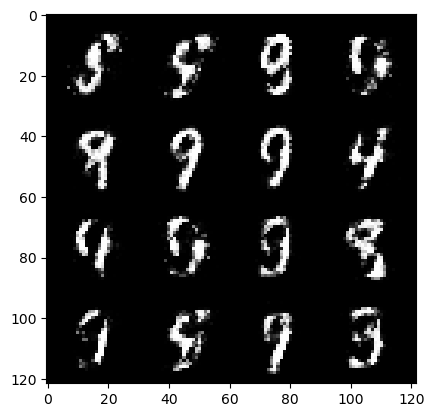

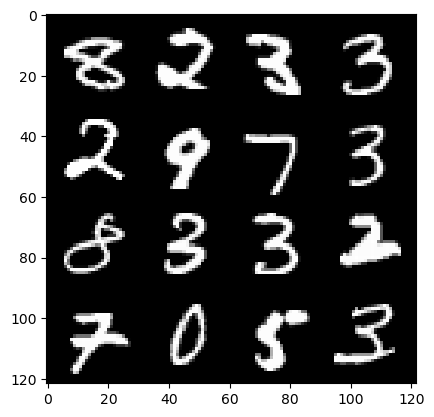

71: step 33300 / Gen loss: 3.7751868136723856 / disc_loss: 0.11795665256679053


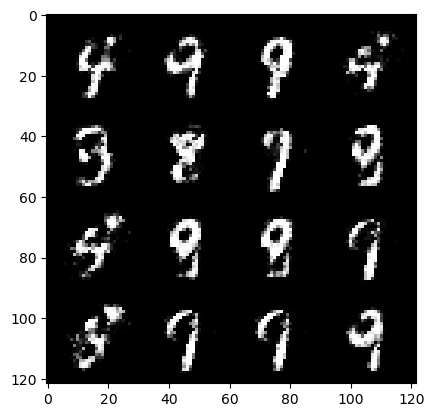

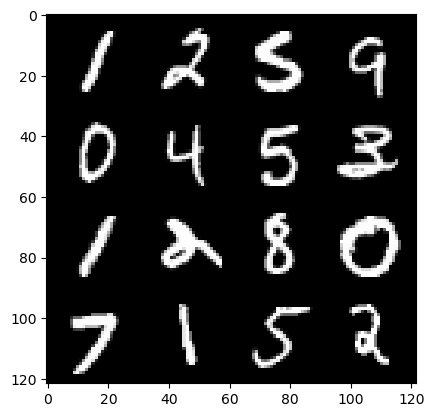

71: step 33600 / Gen loss: 3.885441297690075 / disc_loss: 0.10562090660134955


  0%|          | 0/469 [00:00<?, ?it/s]

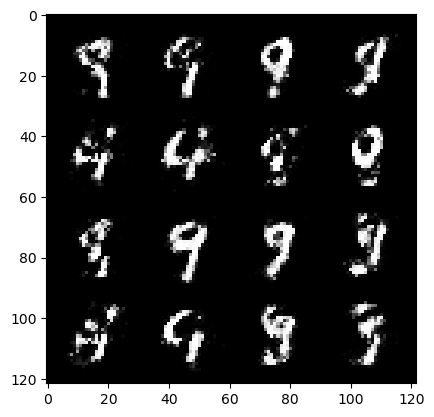

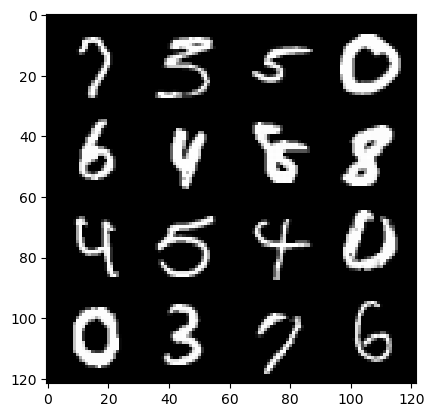

72: step 33900 / Gen loss: 3.8867727684974667 / disc_loss: 0.10389772893240057


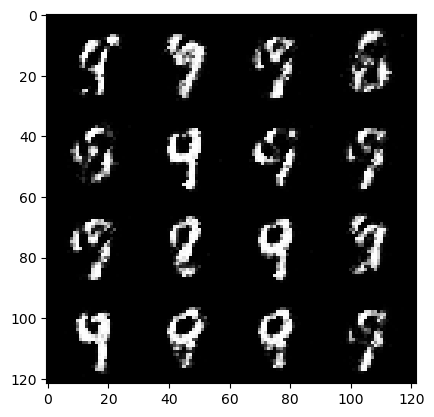

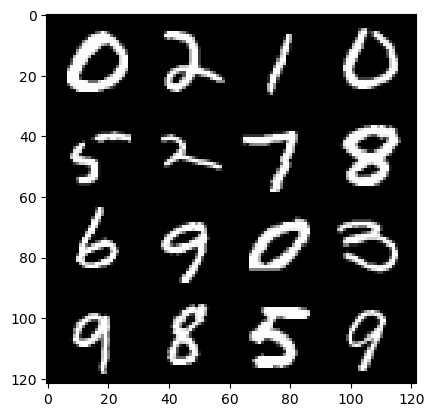

72: step 34200 / Gen loss: 3.5416184250513703 / disc_loss: 0.13294330947101107


  0%|          | 0/469 [00:00<?, ?it/s]

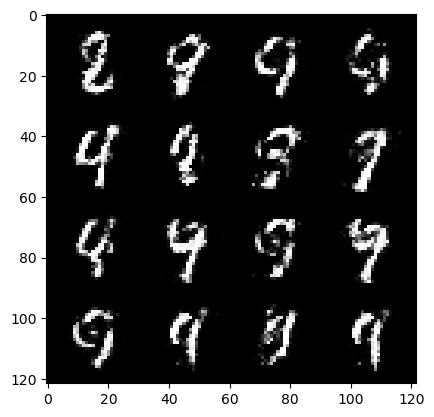

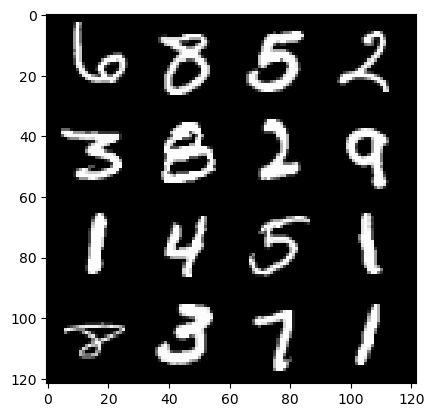

73: step 34500 / Gen loss: 3.445434926350912 / disc_loss: 0.13386784902463364


  0%|          | 0/469 [00:00<?, ?it/s]

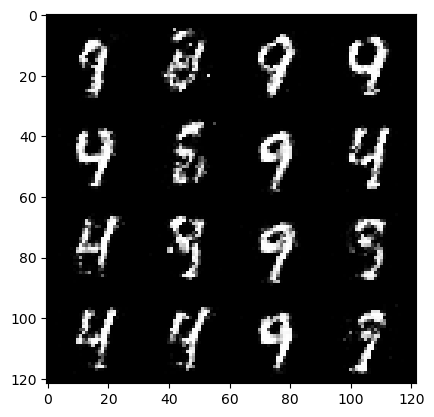

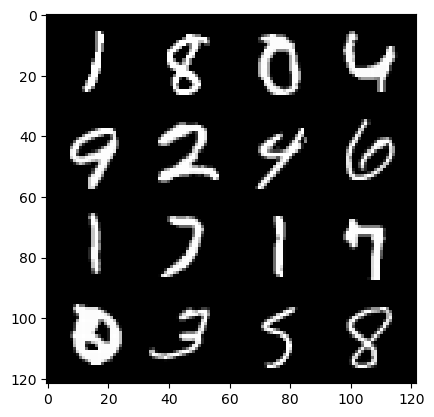

74: step 34800 / Gen loss: 3.7530345344543456 / disc_loss: 0.1080046901727717


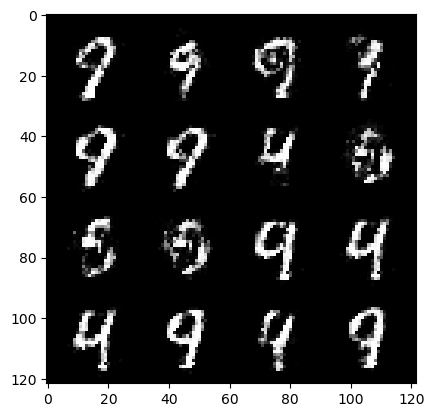

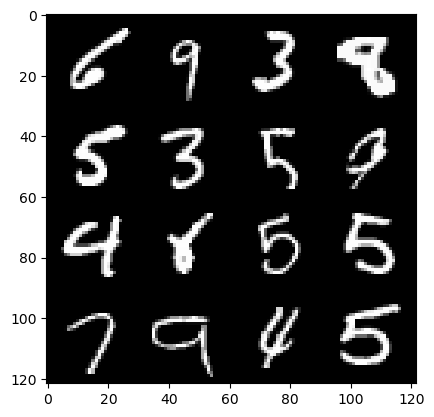

74: step 35100 / Gen loss: 3.6435605780283615 / disc_loss: 0.12520996981610857


  0%|          | 0/469 [00:00<?, ?it/s]

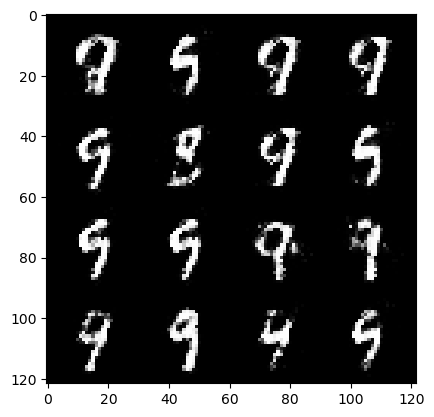

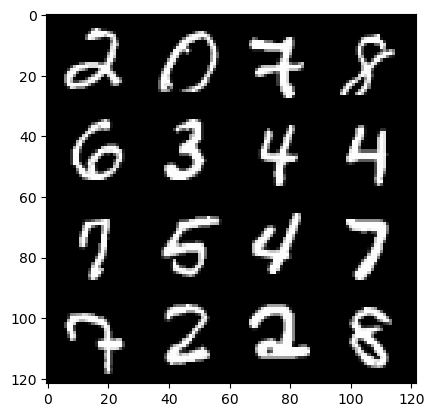

75: step 35400 / Gen loss: 3.4772178848584483 / disc_loss: 0.130253828080992


  0%|          | 0/469 [00:00<?, ?it/s]

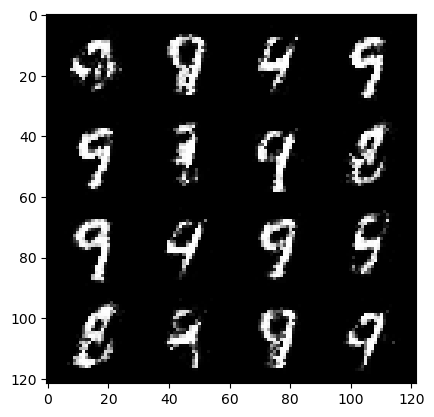

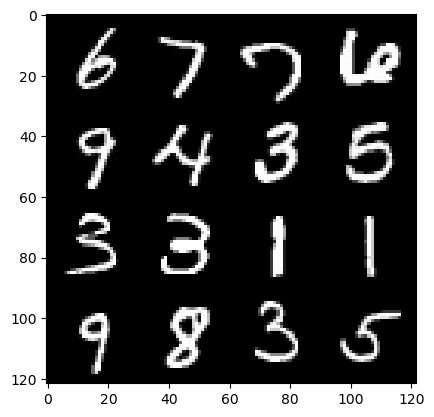

76: step 35700 / Gen loss: 3.5726331520080543 / disc_loss: 0.13354973169664536


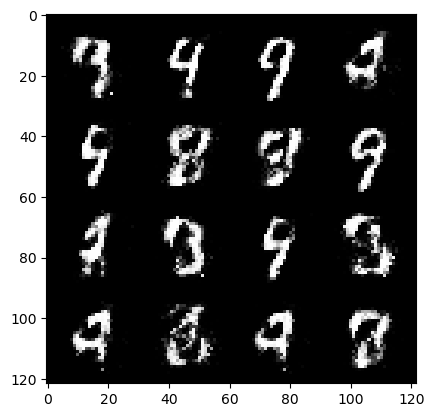

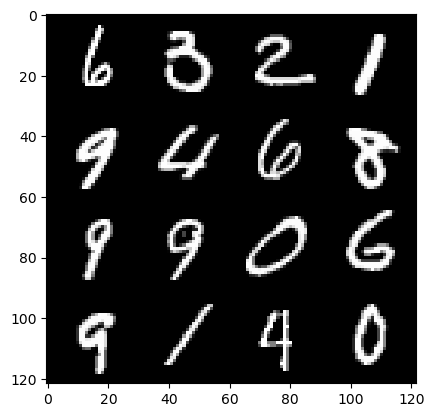

76: step 36000 / Gen loss: 3.5364042528470354 / disc_loss: 0.12941604539752005


  0%|          | 0/469 [00:00<?, ?it/s]

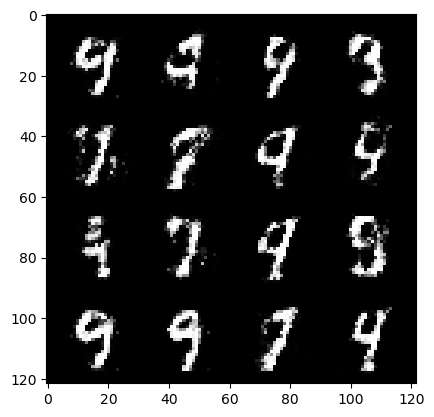

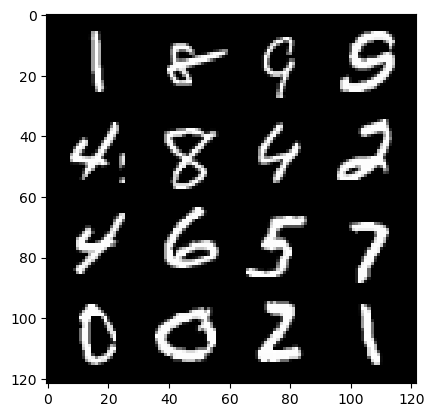

77: step 36300 / Gen loss: 3.586644033590952 / disc_loss: 0.11945305970807876


  0%|          | 0/469 [00:00<?, ?it/s]

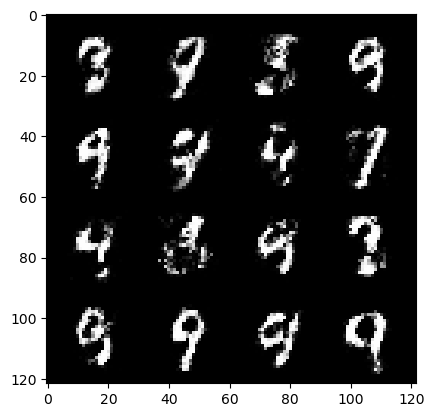

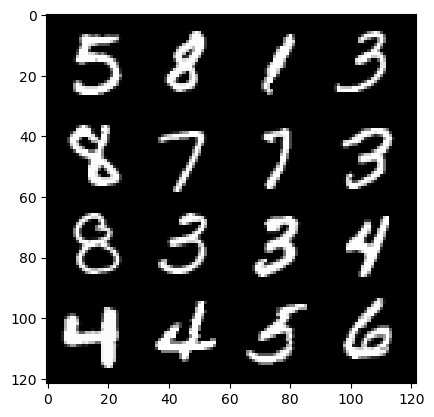

78: step 36600 / Gen loss: 3.625582204659778 / disc_loss: 0.12282402560114859


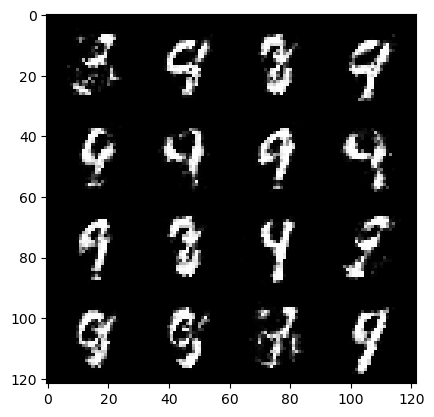

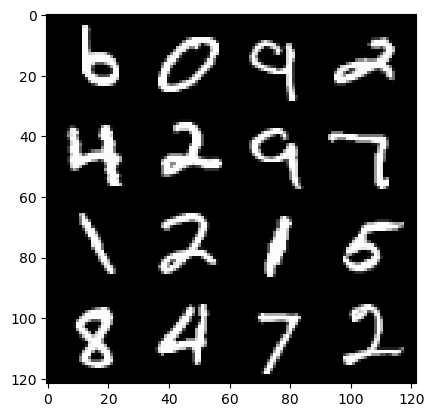

78: step 36900 / Gen loss: 3.5619311118125894 / disc_loss: 0.13188135005533697


  0%|          | 0/469 [00:00<?, ?it/s]

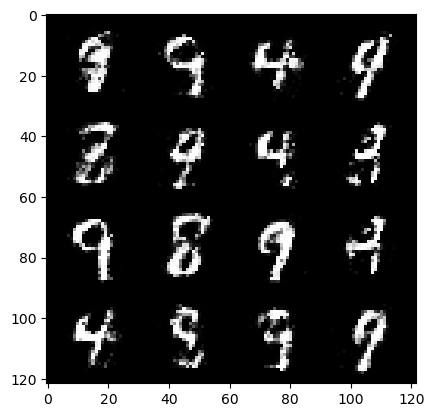

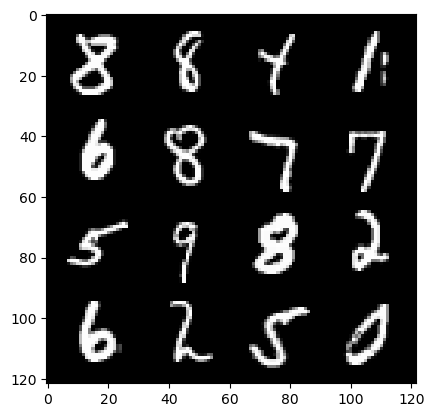

79: step 37200 / Gen loss: 3.451526336669922 / disc_loss: 0.13675355629374586


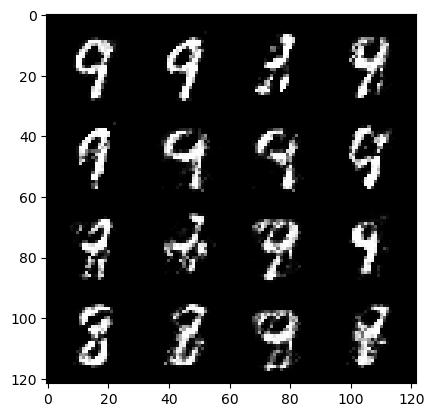

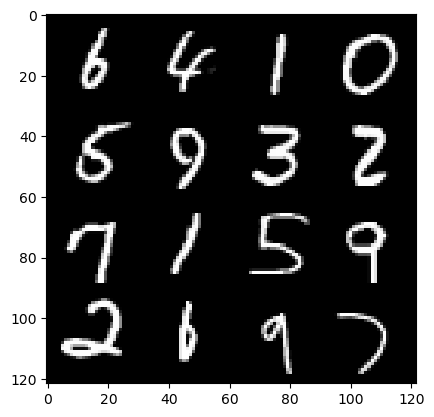

79: step 37500 / Gen loss: 3.349465183417002 / disc_loss: 0.14489027040700114


  0%|          | 0/469 [00:00<?, ?it/s]

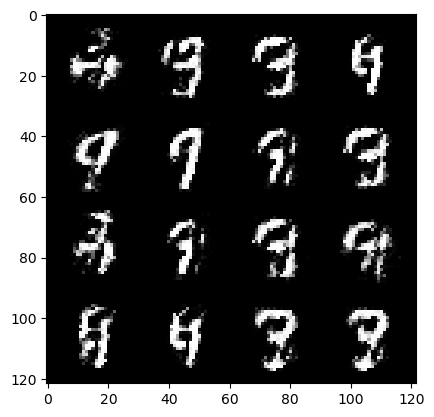

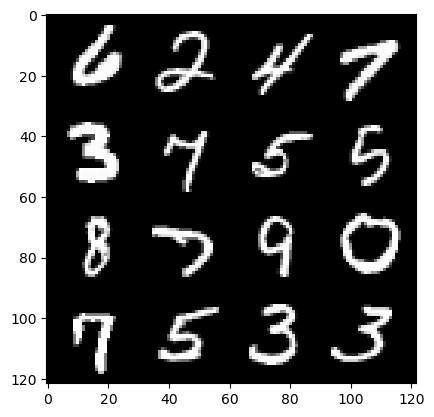

80: step 37800 / Gen loss: 3.502569596767424 / disc_loss: 0.12316020081440608


  0%|          | 0/469 [00:00<?, ?it/s]

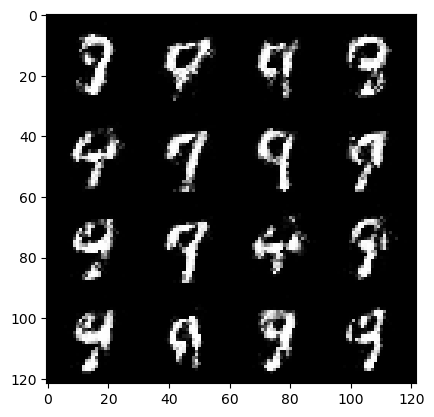

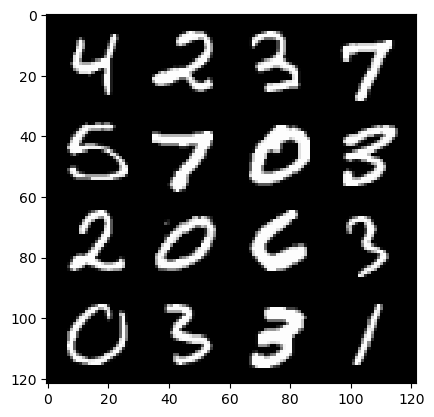

81: step 38100 / Gen loss: 3.408094058036803 / disc_loss: 0.14589463236431274


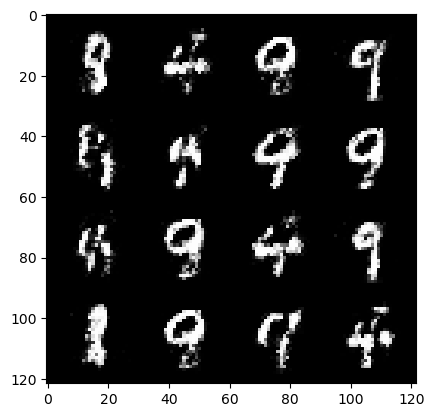

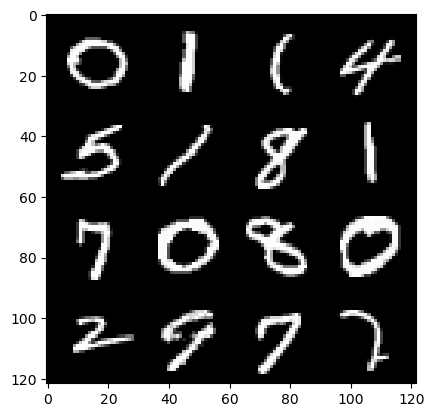

81: step 38400 / Gen loss: 3.32252598841985 / disc_loss: 0.14808081929882358


  0%|          | 0/469 [00:00<?, ?it/s]

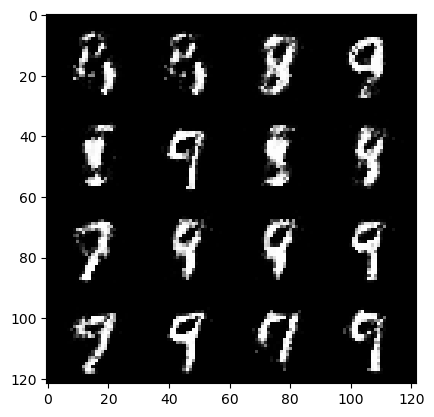

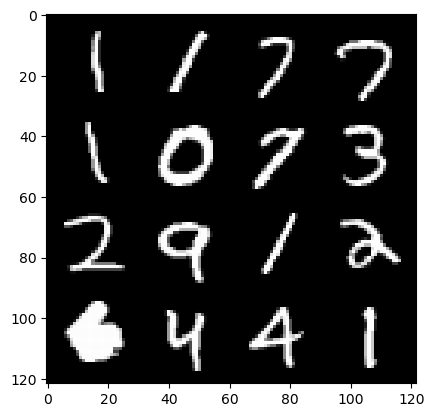

82: step 38700 / Gen loss: 3.2744006681442284 / disc_loss: 0.1506947153061629


  0%|          | 0/469 [00:00<?, ?it/s]

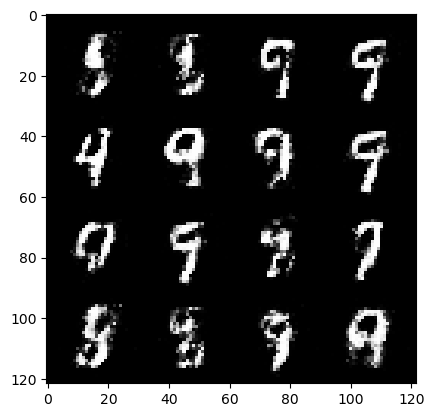

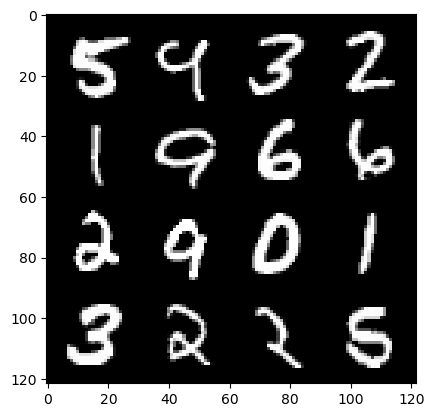

83: step 39000 / Gen loss: 3.2893312422434473 / disc_loss: 0.15188414876659712


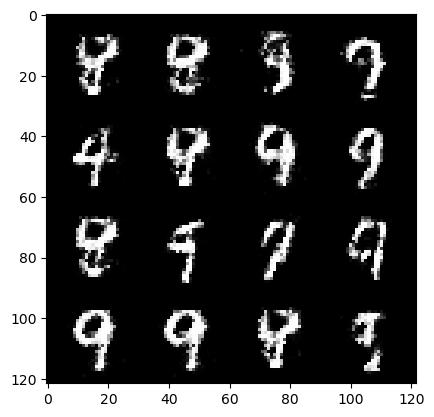

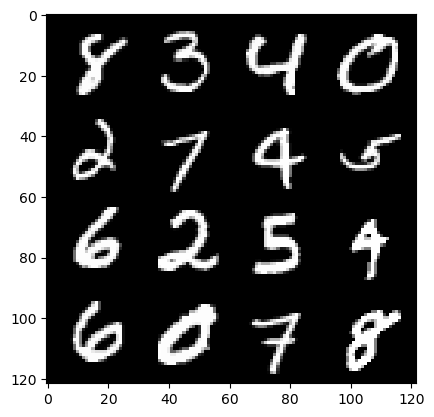

83: step 39300 / Gen loss: 3.418517408370972 / disc_loss: 0.1389518349121014


  0%|          | 0/469 [00:00<?, ?it/s]

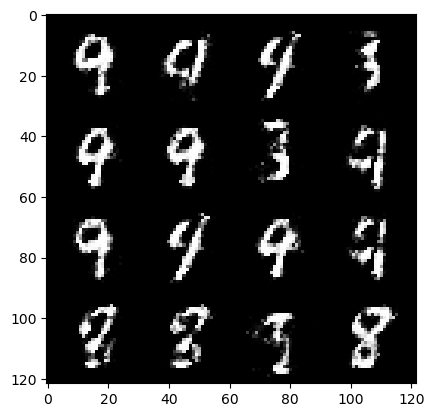

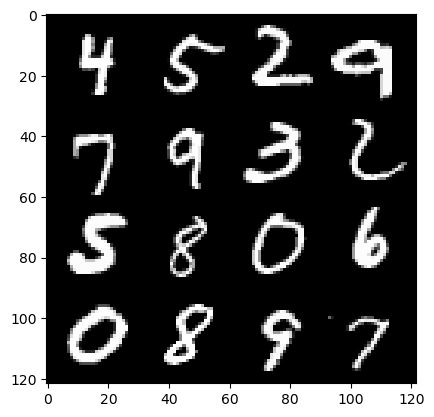

84: step 39600 / Gen loss: 3.4509597349166907 / disc_loss: 0.1369331723451615


  0%|          | 0/469 [00:00<?, ?it/s]

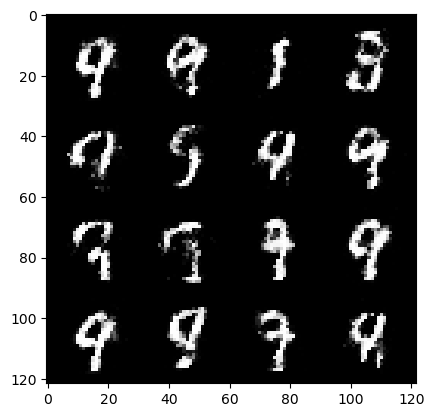

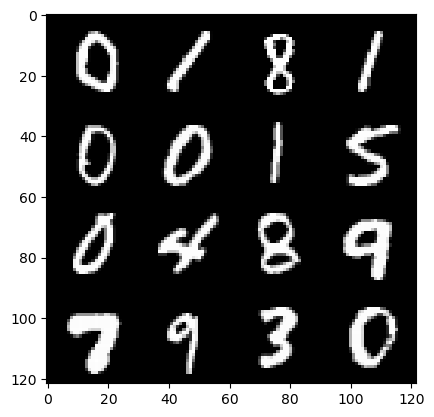

85: step 39900 / Gen loss: 3.5379153760274287 / disc_loss: 0.13105752429614456


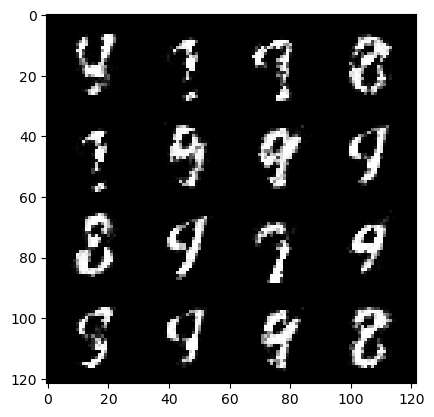

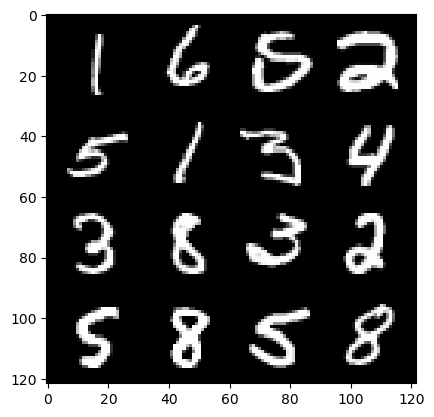

85: step 40200 / Gen loss: 3.385238912105561 / disc_loss: 0.14674382771054914


  0%|          | 0/469 [00:00<?, ?it/s]

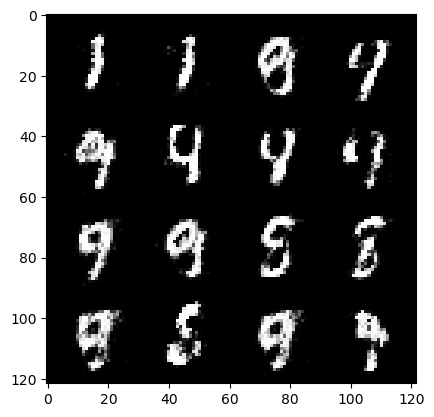

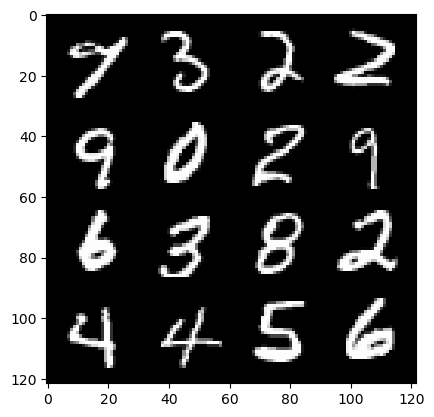

86: step 40500 / Gen loss: 3.2675357429186462 / disc_loss: 0.15510128684341898


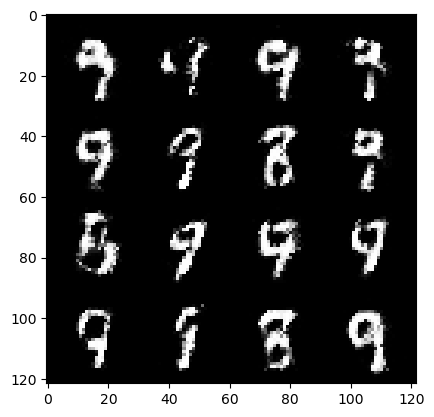

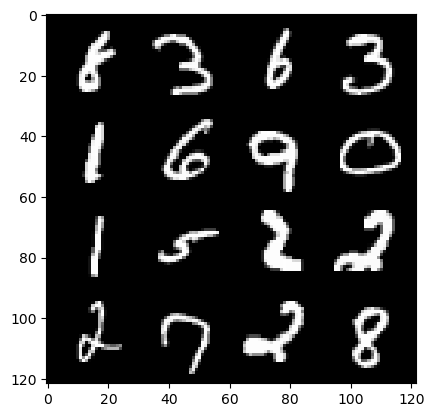

86: step 40800 / Gen loss: 3.2135900513331084 / disc_loss: 0.15704576144615806


  0%|          | 0/469 [00:00<?, ?it/s]

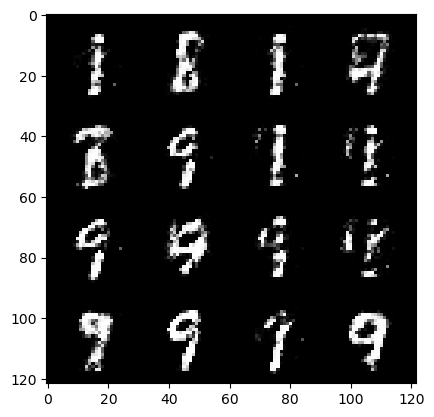

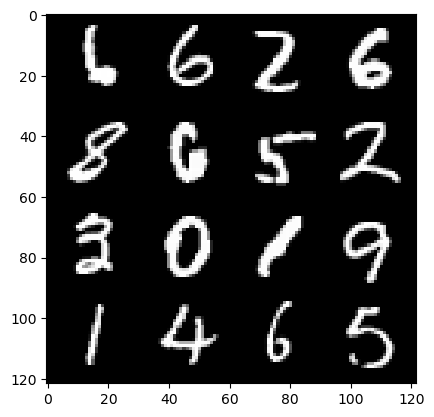

87: step 41100 / Gen loss: 3.1796662553151447 / disc_loss: 0.16546290879448247


  0%|          | 0/469 [00:00<?, ?it/s]

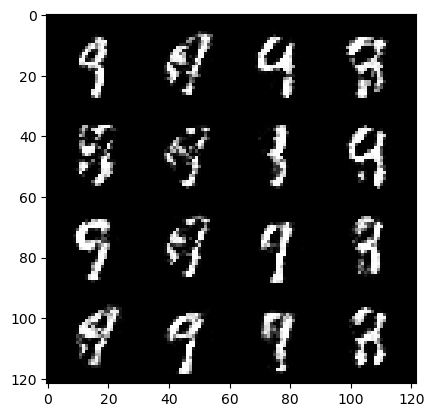

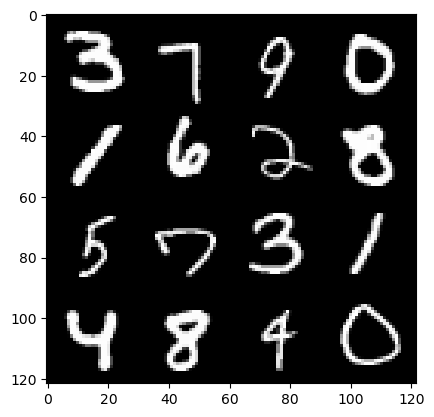

88: step 41400 / Gen loss: 3.121144753297171 / disc_loss: 0.1683441077172757


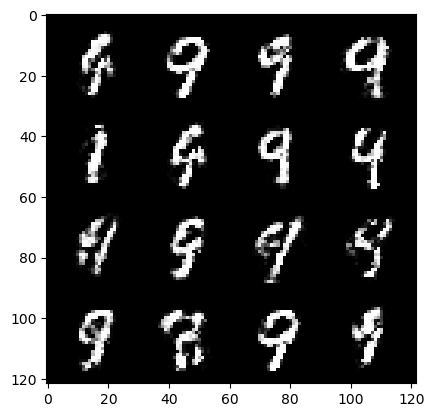

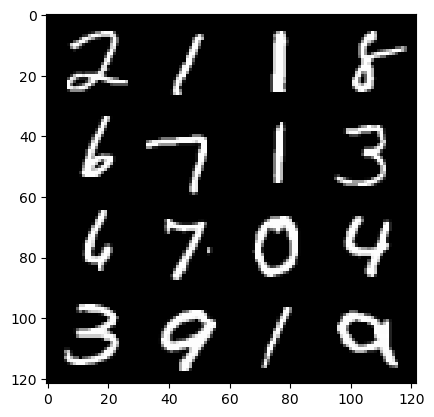

88: step 41700 / Gen loss: 3.131288150151569 / disc_loss: 0.16222820366422336


  0%|          | 0/469 [00:00<?, ?it/s]

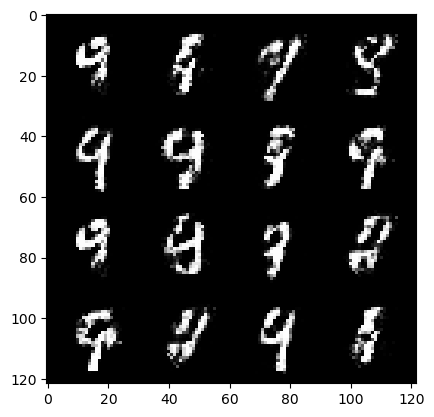

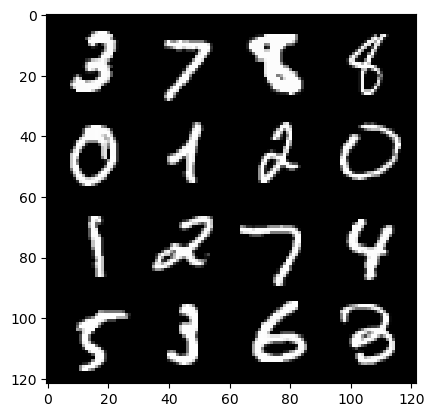

89: step 42000 / Gen loss: 3.1850411796569817 / disc_loss: 0.14624601664642498


  0%|          | 0/469 [00:00<?, ?it/s]

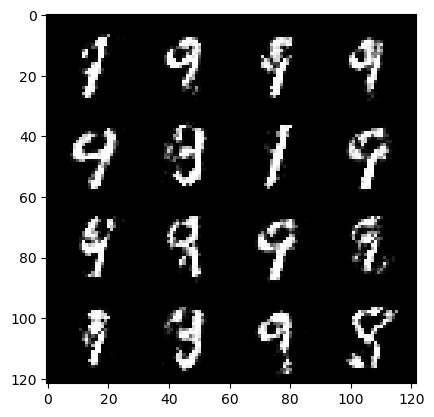

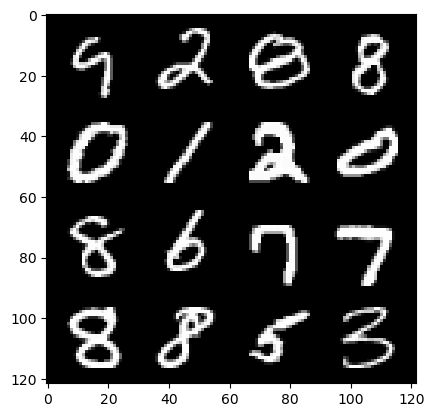

90: step 42300 / Gen loss: 3.252959435780842 / disc_loss: 0.16210566150645425


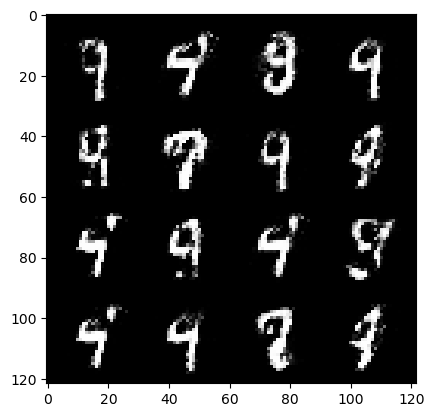

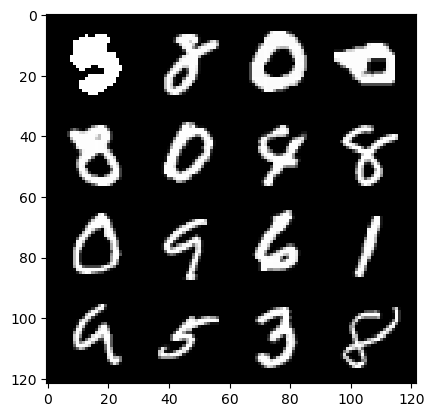

90: step 42600 / Gen loss: 3.05570895989736 / disc_loss: 0.17939079513152428


  0%|          | 0/469 [00:00<?, ?it/s]

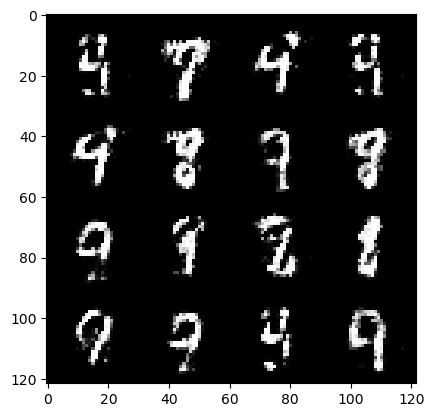

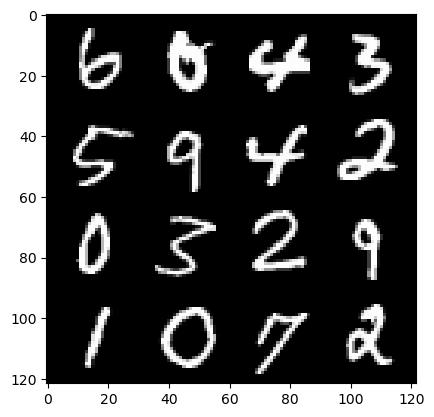

91: step 42900 / Gen loss: 3.0001056702931748 / disc_loss: 0.18093893813590206


  0%|          | 0/469 [00:00<?, ?it/s]

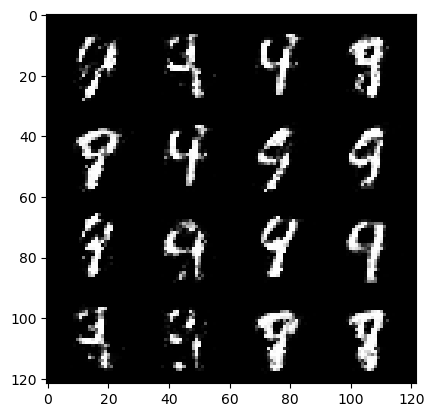

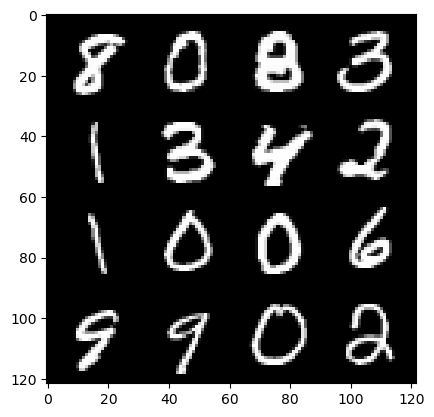

92: step 43200 / Gen loss: 3.050344816048942 / disc_loss: 0.16647675548990576


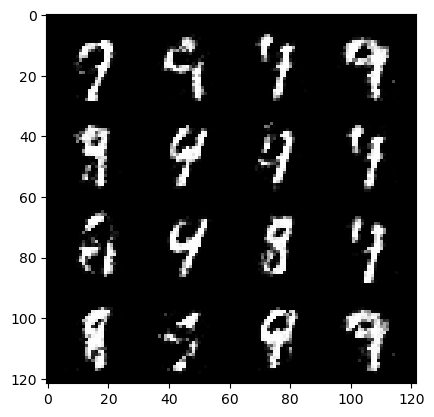

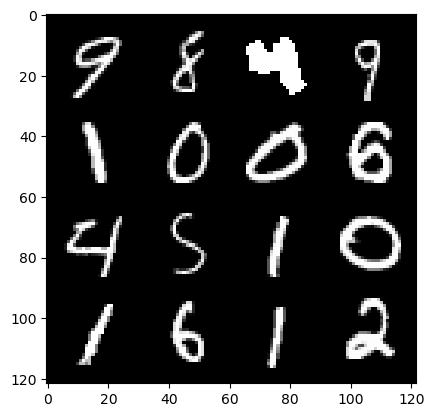

92: step 43500 / Gen loss: 3.064266778628029 / disc_loss: 0.17051180007557057


  0%|          | 0/469 [00:00<?, ?it/s]

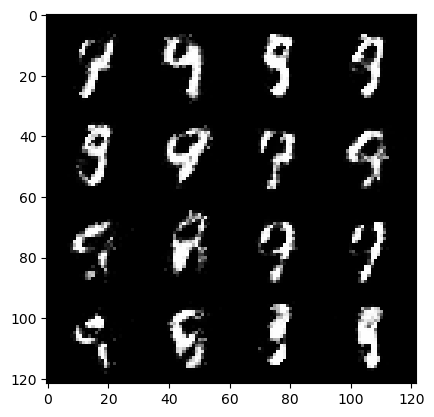

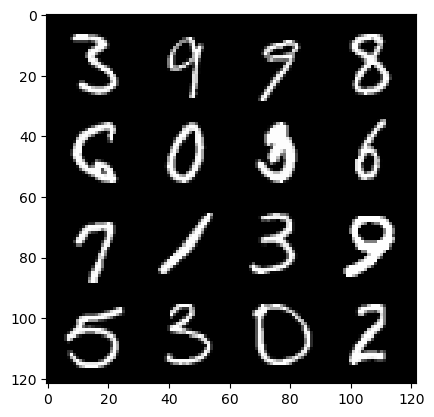

93: step 43800 / Gen loss: 3.0069412867228205 / disc_loss: 0.17616041577110694


  0%|          | 0/469 [00:00<?, ?it/s]

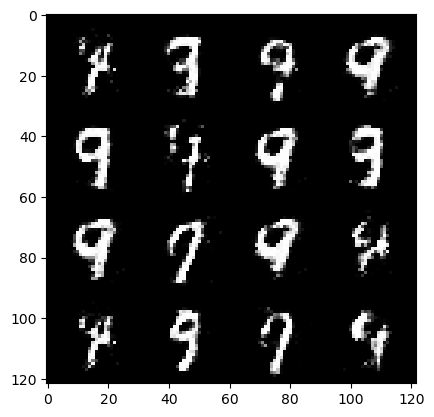

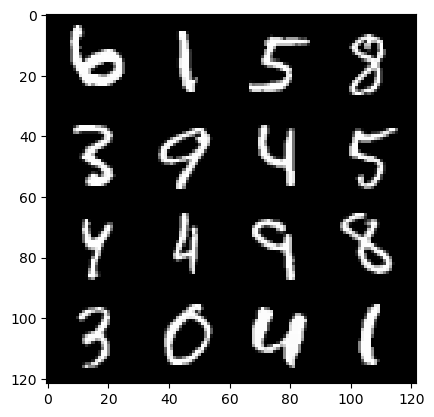

94: step 44100 / Gen loss: 3.1798773829142246 / disc_loss: 0.15071352016180767


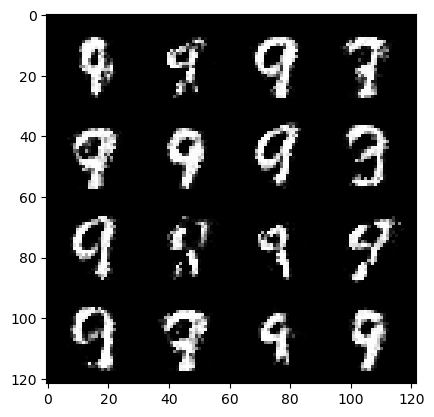

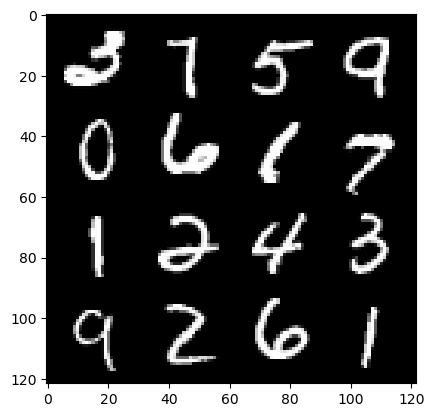

94: step 44400 / Gen loss: 3.1201633032162985 / disc_loss: 0.16528419432540728


  0%|          | 0/469 [00:00<?, ?it/s]

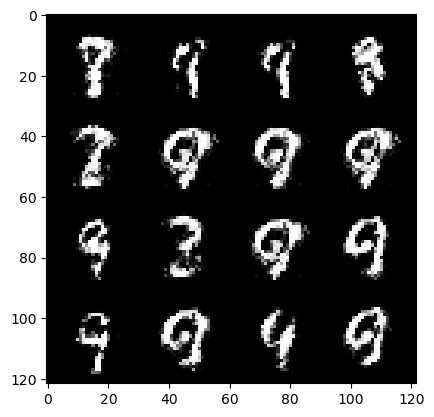

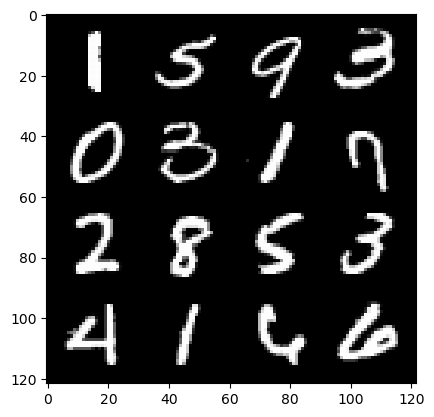

95: step 44700 / Gen loss: 3.0772477769851685 / disc_loss: 0.16201997876167298


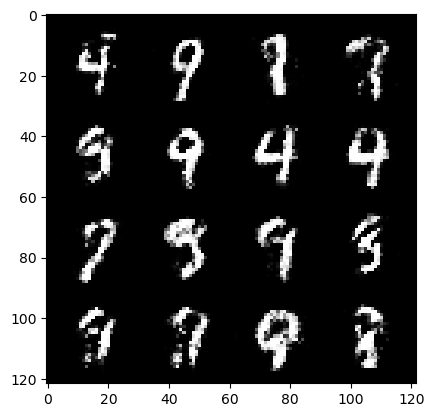

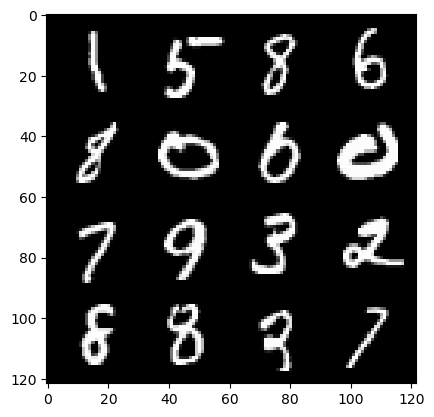

95: step 45000 / Gen loss: 3.056602059205372 / disc_loss: 0.16865096976359686


  0%|          | 0/469 [00:00<?, ?it/s]

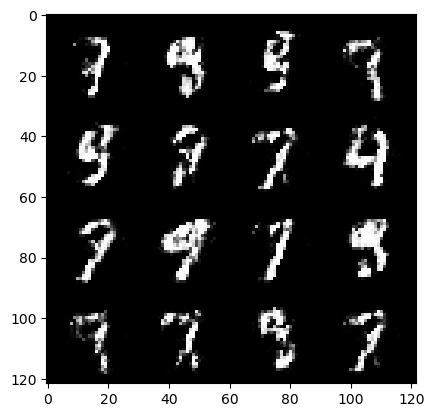

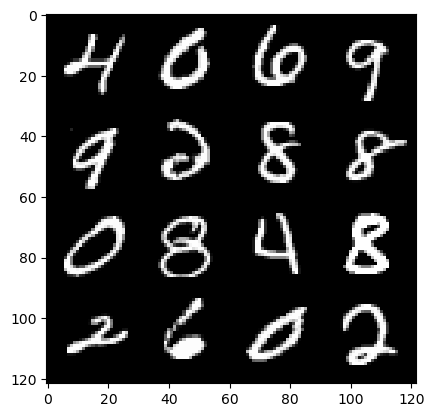

96: step 45300 / Gen loss: 2.8766109665234887 / disc_loss: 0.19239135491351275


  0%|          | 0/469 [00:00<?, ?it/s]

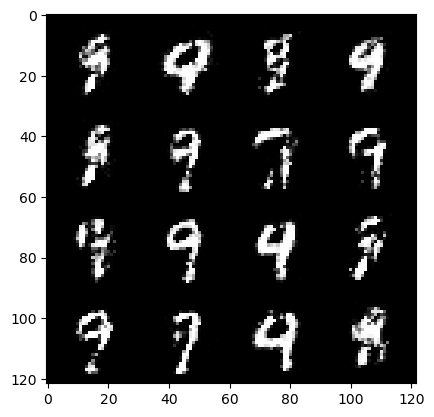

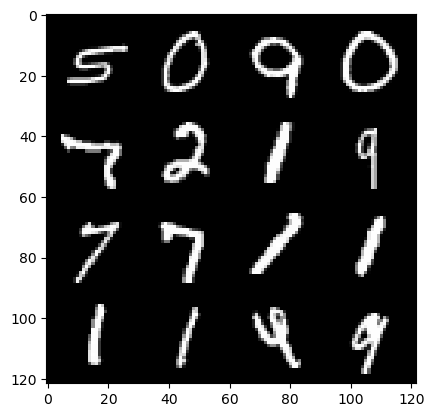

97: step 45600 / Gen loss: 2.755513565540314 / disc_loss: 0.18077545342346021


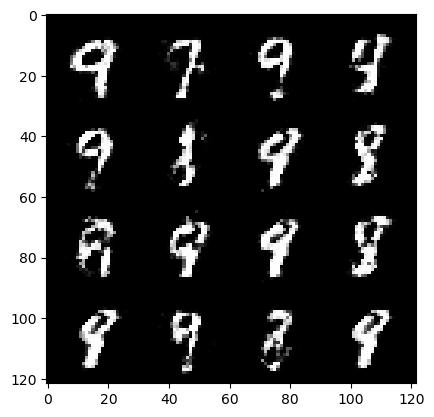

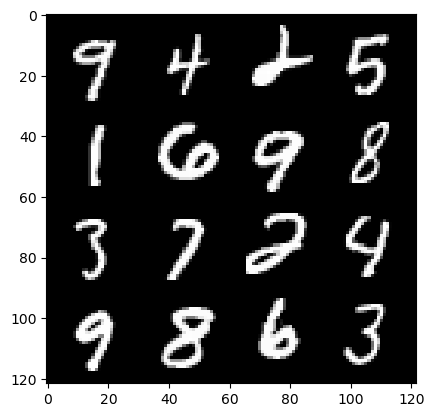

97: step 45900 / Gen loss: 3.0982514397303285 / disc_loss: 0.1484667005389928


  0%|          | 0/469 [00:00<?, ?it/s]

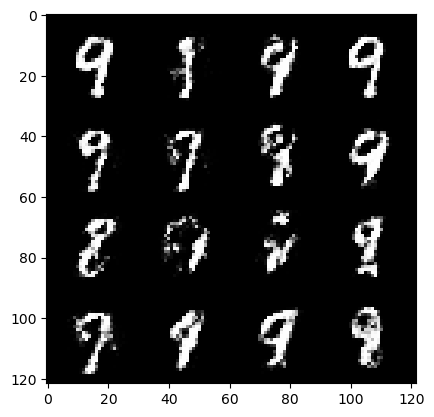

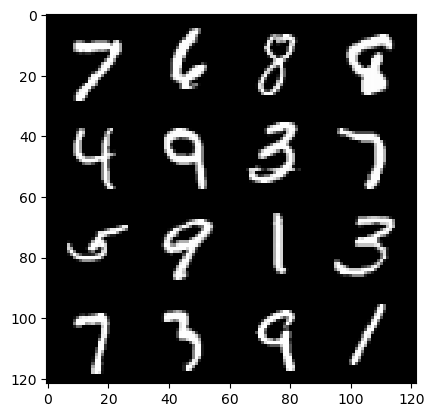

98: step 46200 / Gen loss: 3.0005609424908926 / disc_loss: 0.1649111623689533


  0%|          | 0/469 [00:00<?, ?it/s]

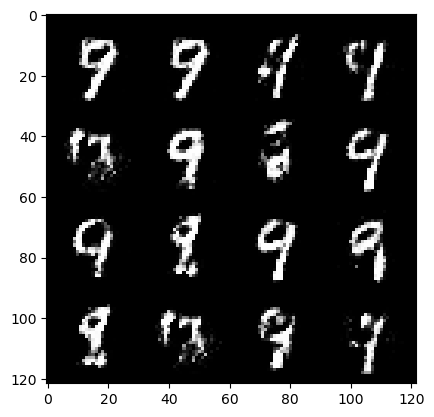

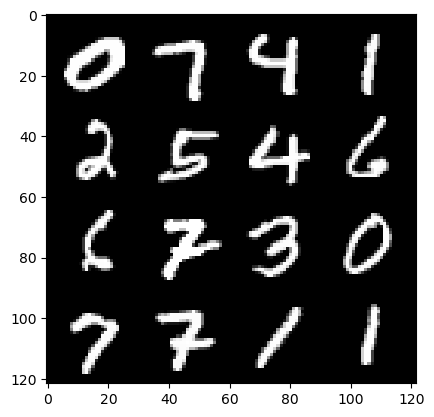

99: step 46500 / Gen loss: 2.9589190045992524 / disc_loss: 0.17951589683691663


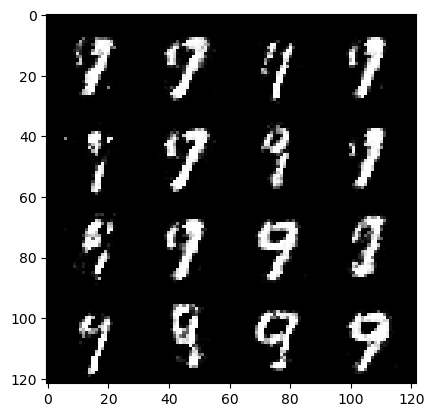

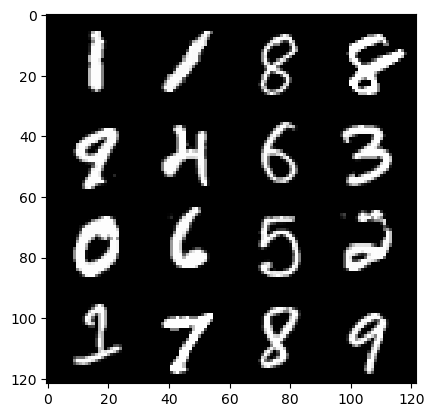

99: step 46800 / Gen loss: 2.841265207131701 / disc_loss: 0.19490166172385234


  0%|          | 0/469 [00:00<?, ?it/s]

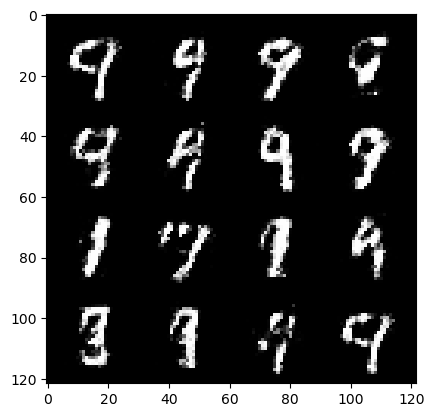

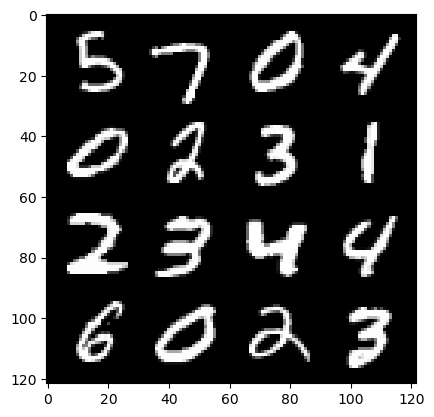

100: step 47100 / Gen loss: 2.9605966528256746 / disc_loss: 0.16499334566295146


  0%|          | 0/469 [00:00<?, ?it/s]

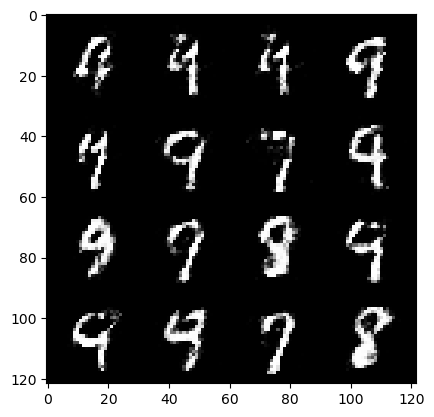

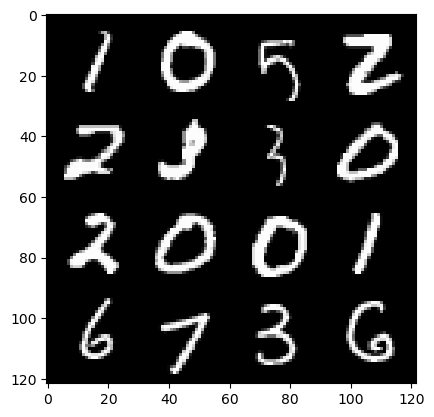

101: step 47400 / Gen loss: 2.9506613961855592 / disc_loss: 0.17082018951574948


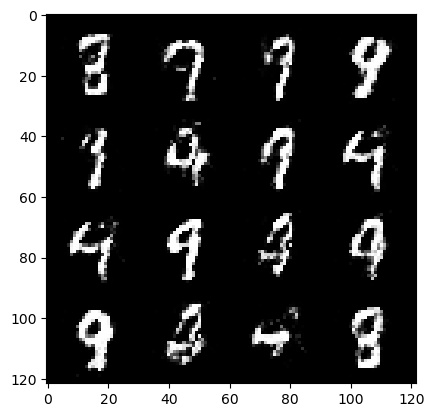

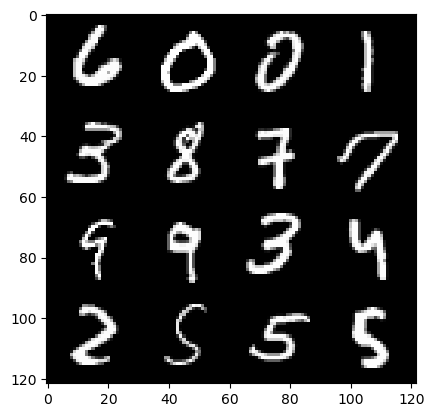

101: step 47700 / Gen loss: 2.8921694699923206 / disc_loss: 0.17865528283019852


  0%|          | 0/469 [00:00<?, ?it/s]

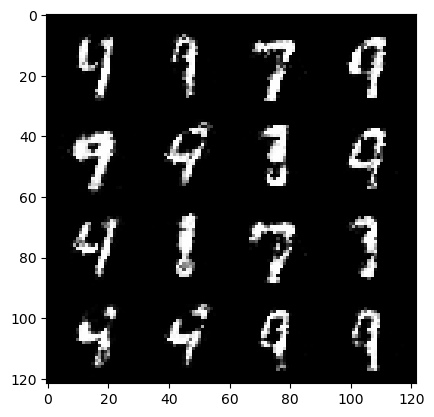

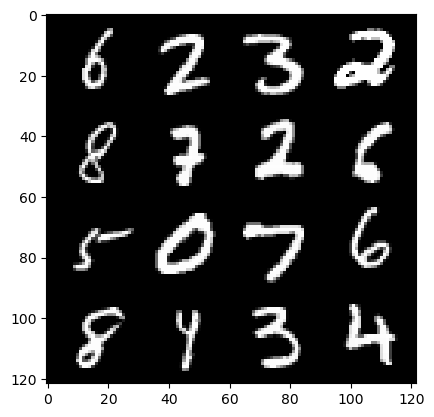

102: step 48000 / Gen loss: 2.829393486976623 / disc_loss: 0.19133578091859815


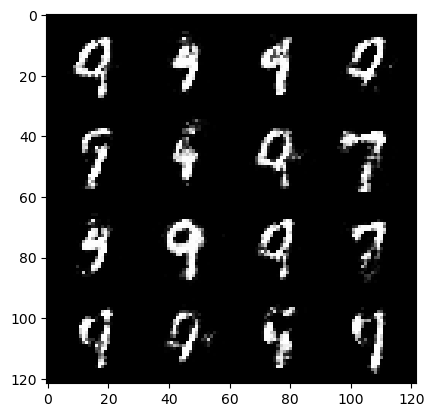

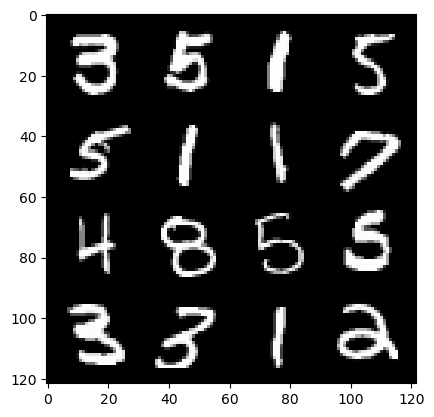

102: step 48300 / Gen loss: 2.806479184627535 / disc_loss: 0.1877724939088028


  0%|          | 0/469 [00:00<?, ?it/s]

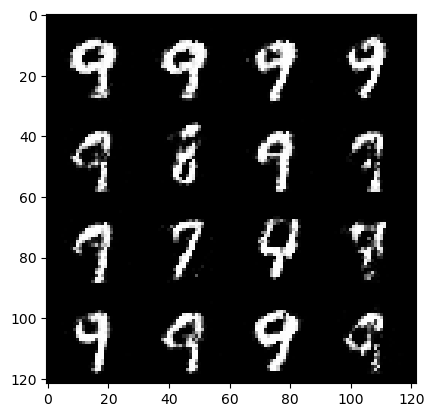

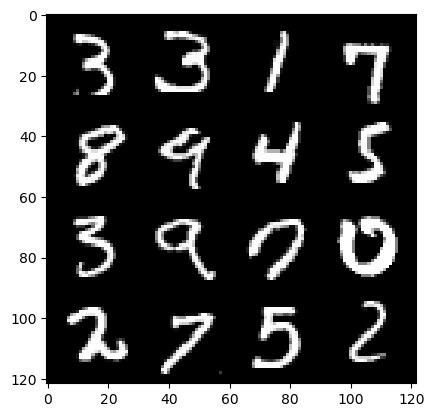

103: step 48600 / Gen loss: 2.7635397251447027 / disc_loss: 0.19436309538781646


  0%|          | 0/469 [00:00<?, ?it/s]

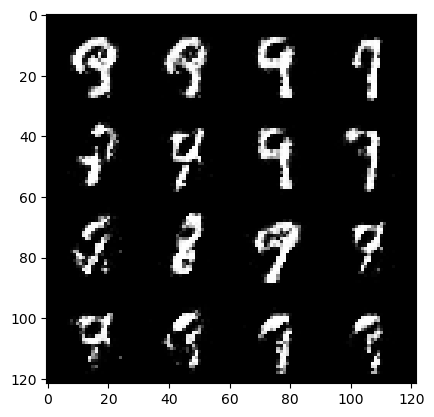

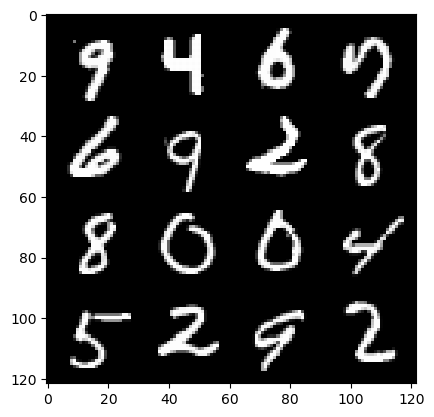

104: step 48900 / Gen loss: 2.7828919561704004 / disc_loss: 0.17877942954500503


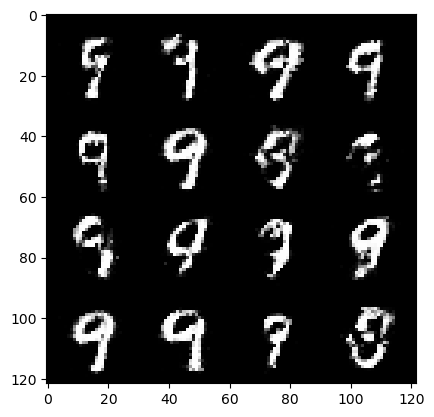

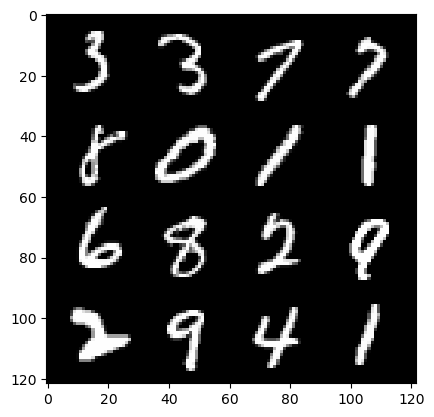

104: step 49200 / Gen loss: 2.8095266850789415 / disc_loss: 0.18689478899041814


  0%|          | 0/469 [00:00<?, ?it/s]

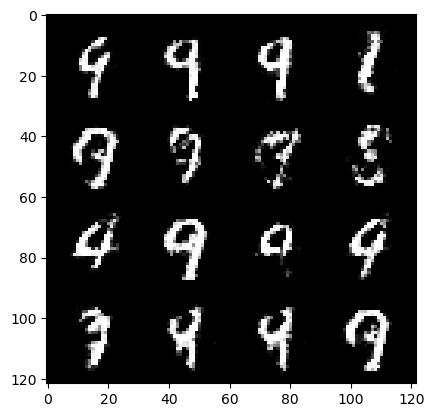

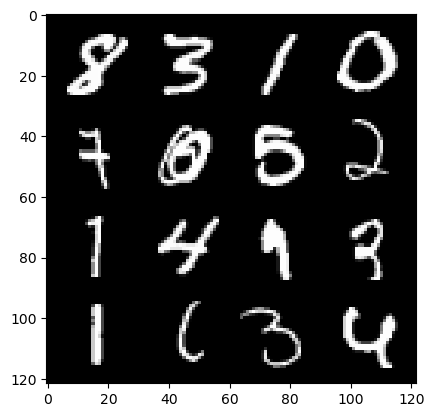

105: step 49500 / Gen loss: 2.733758007685343 / disc_loss: 0.1905144754548868


  0%|          | 0/469 [00:00<?, ?it/s]

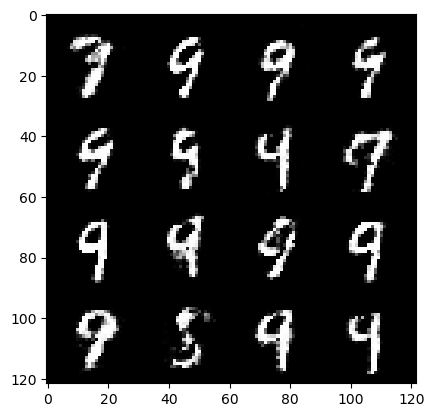

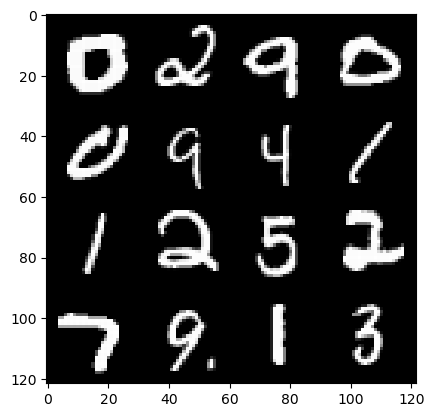

106: step 49800 / Gen loss: 2.735876839955646 / disc_loss: 0.19683044935266178


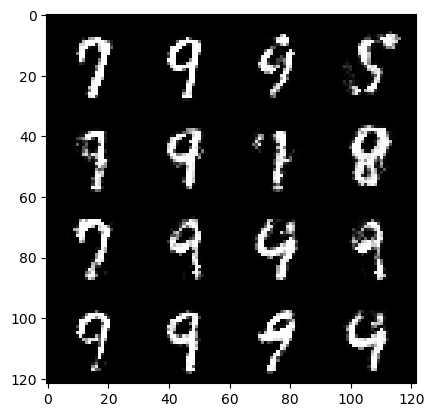

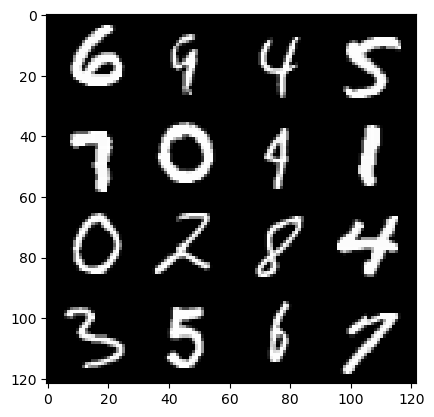

106: step 50100 / Gen loss: 2.62795498053233 / disc_loss: 0.21418264741698895


  0%|          | 0/469 [00:00<?, ?it/s]

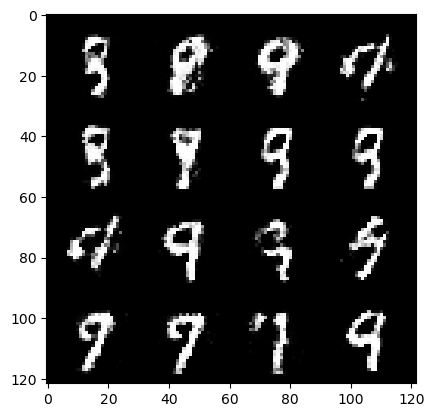

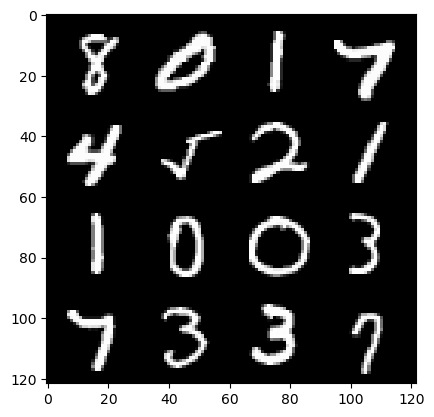

107: step 50400 / Gen loss: 2.618647585709892 / disc_loss: 0.21714268341660492


  0%|          | 0/469 [00:00<?, ?it/s]

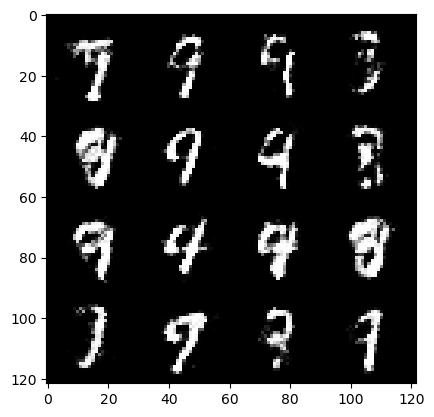

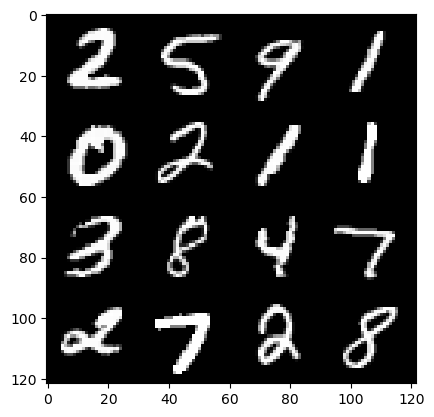

108: step 50700 / Gen loss: 2.5844953878720593 / disc_loss: 0.21385966092348105


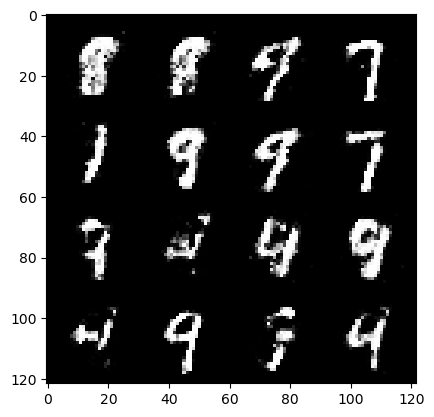

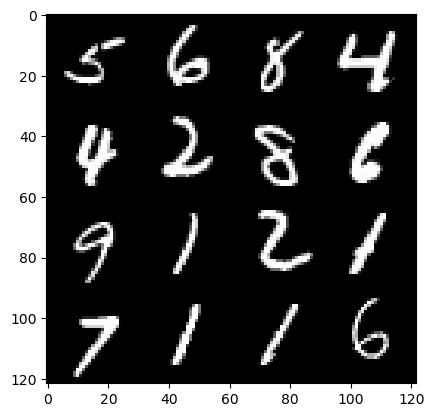

108: step 51000 / Gen loss: 2.6094915282726303 / disc_loss: 0.20058278900881607


  0%|          | 0/469 [00:00<?, ?it/s]

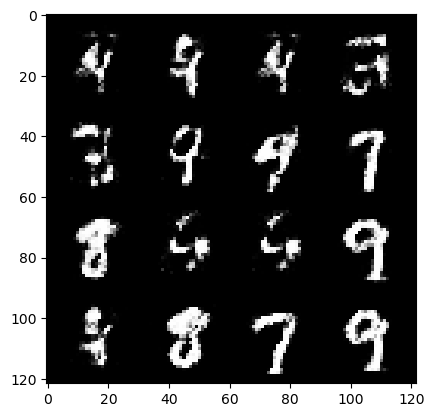

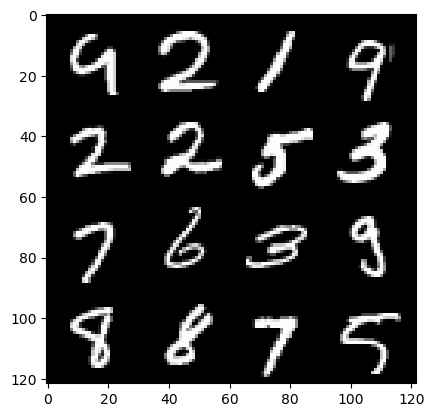

109: step 51300 / Gen loss: 2.6359551477432257 / disc_loss: 0.21012568565706416


  0%|          | 0/469 [00:00<?, ?it/s]

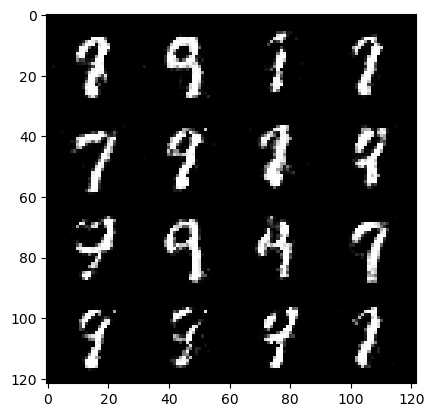

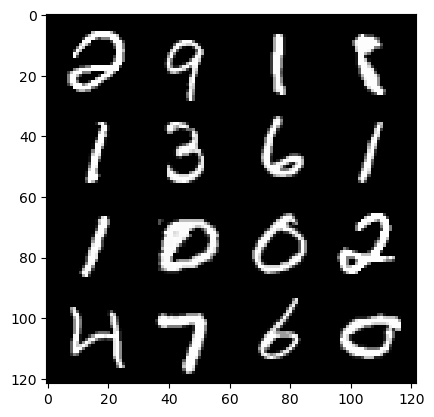

110: step 51600 / Gen loss: 2.594209808508555 / disc_loss: 0.21252385715643576


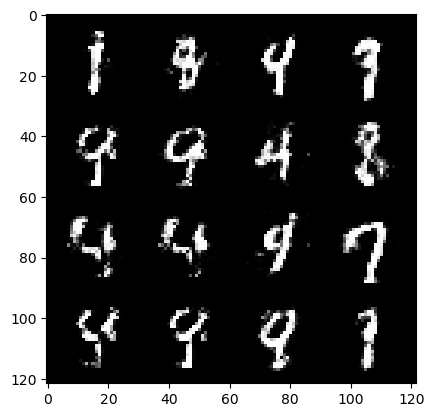

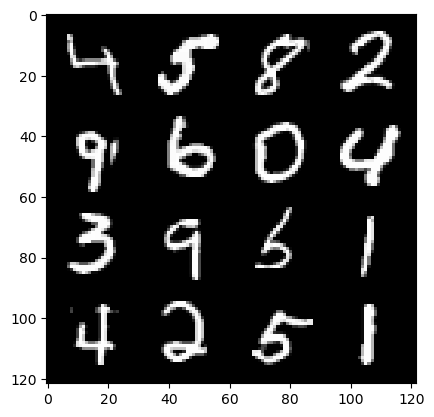

110: step 51900 / Gen loss: 2.761828300952913 / disc_loss: 0.19144085104266792


  0%|          | 0/469 [00:00<?, ?it/s]

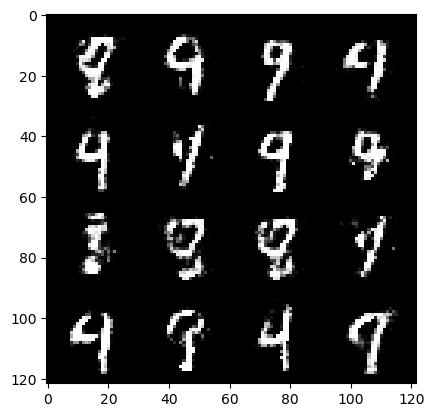

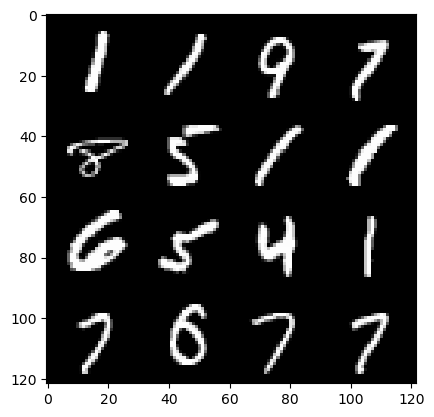

111: step 52200 / Gen loss: 2.79744196097056 / disc_loss: 0.19801732455690704


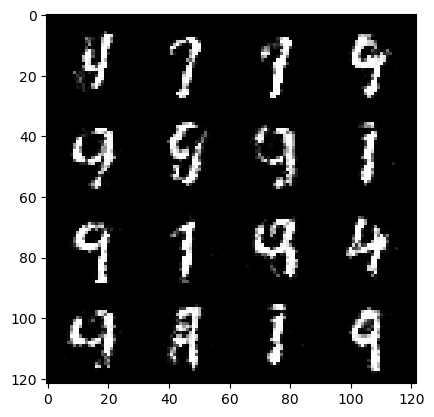

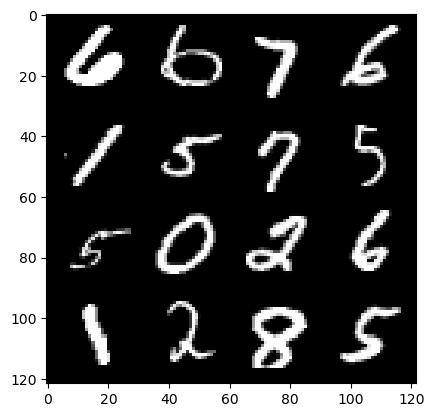

111: step 52500 / Gen loss: 2.7508720755577074 / disc_loss: 0.19271830777327217


  0%|          | 0/469 [00:00<?, ?it/s]

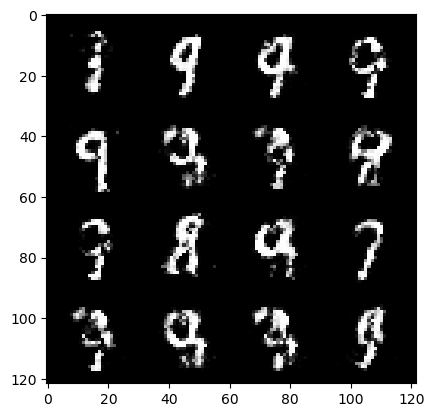

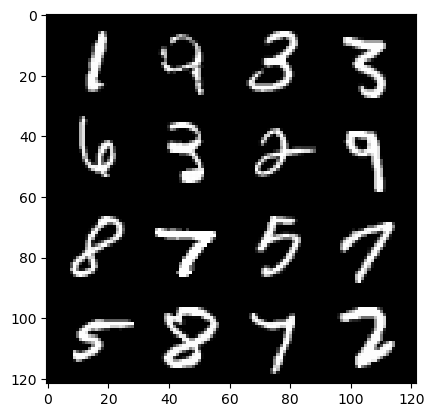

112: step 52800 / Gen loss: 2.704134743213654 / disc_loss: 0.19960508354008202


  0%|          | 0/469 [00:00<?, ?it/s]

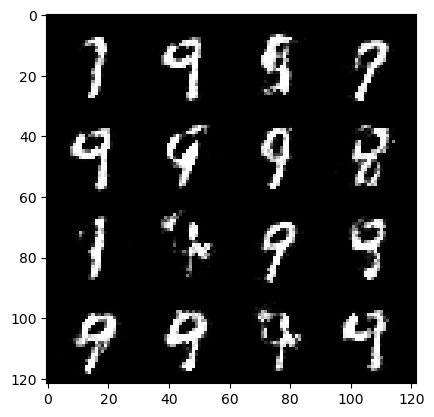

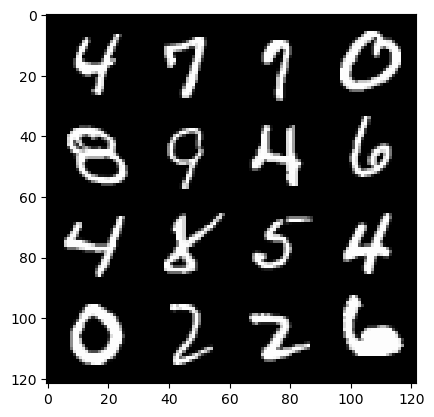

113: step 53100 / Gen loss: 2.6156900866826382 / disc_loss: 0.20773923615614553


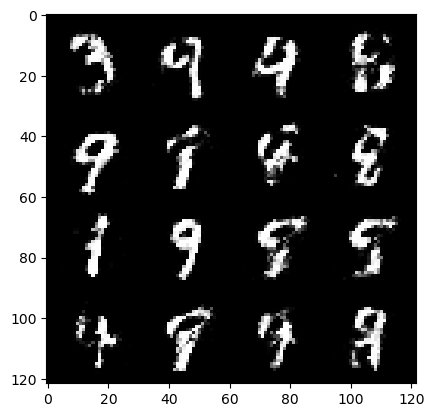

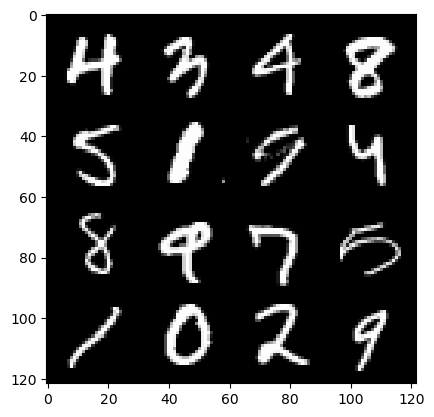

113: step 53400 / Gen loss: 2.4989018742243463 / disc_loss: 0.22774846936265633


  0%|          | 0/469 [00:00<?, ?it/s]

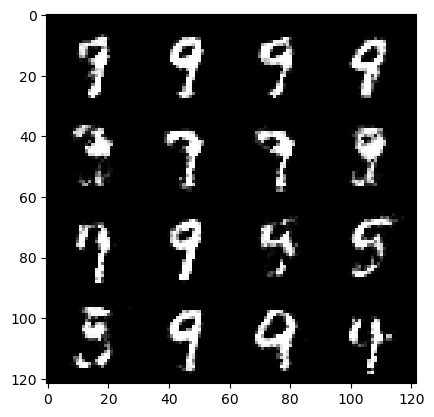

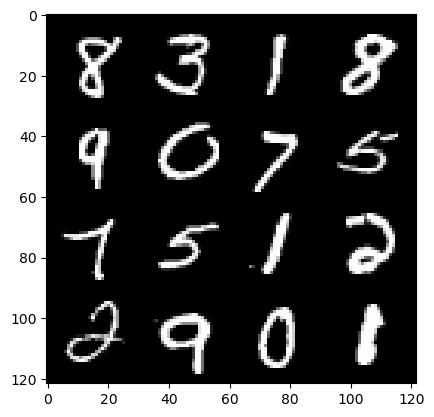

114: step 53700 / Gen loss: 2.5208801468213378 / disc_loss: 0.22667042454083755


  0%|          | 0/469 [00:00<?, ?it/s]

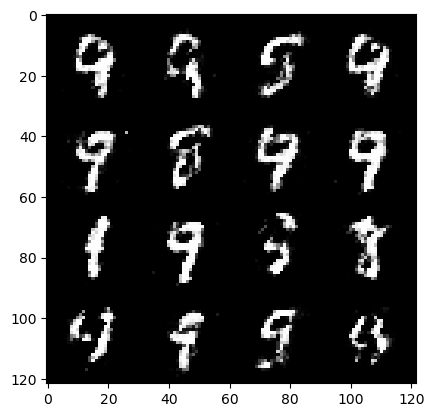

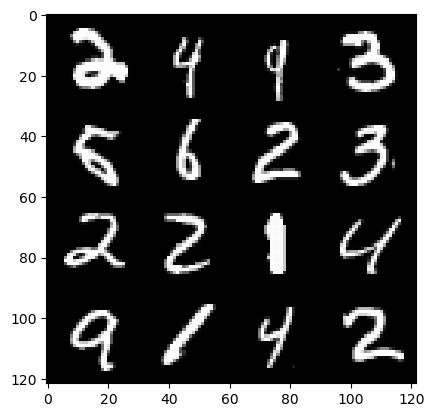

115: step 54000 / Gen loss: 2.477102044423424 / disc_loss: 0.22224591429034862


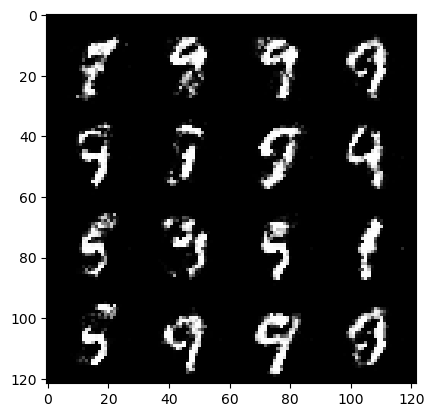

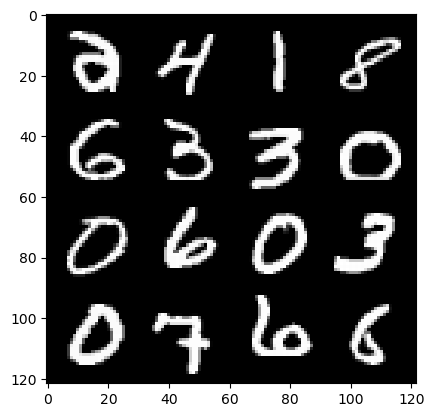

115: step 54300 / Gen loss: 2.501750705242157 / disc_loss: 0.21952812785903628


  0%|          | 0/469 [00:00<?, ?it/s]

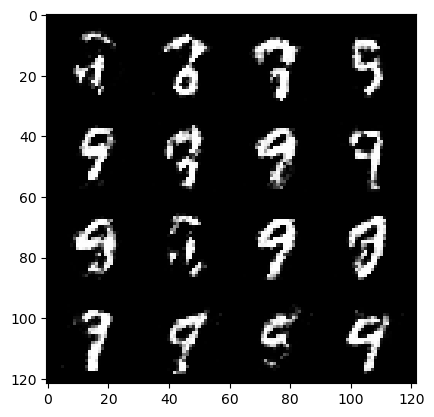

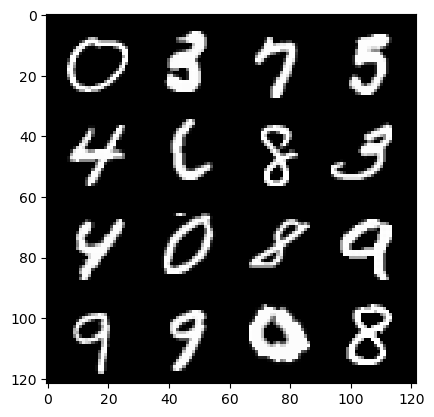

116: step 54600 / Gen loss: 2.504990127086638 / disc_loss: 0.20252928766111536


  0%|          | 0/469 [00:00<?, ?it/s]

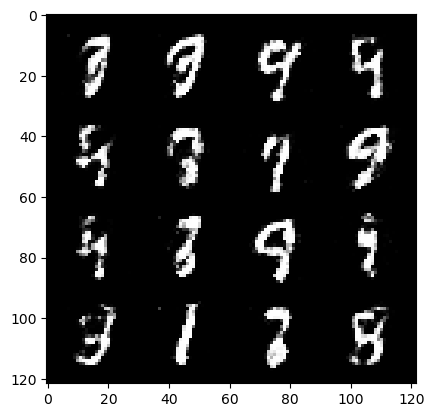

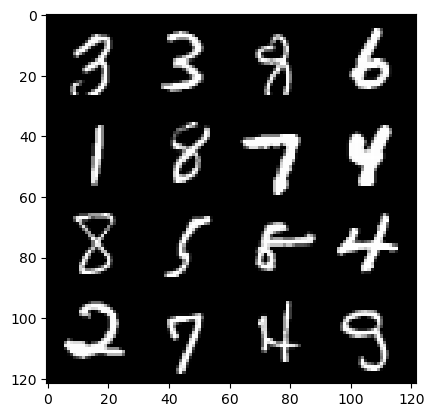

117: step 54900 / Gen loss: 2.6398783055941255 / disc_loss: 0.1948099424938361


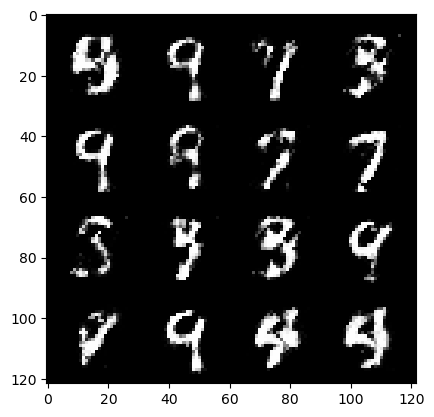

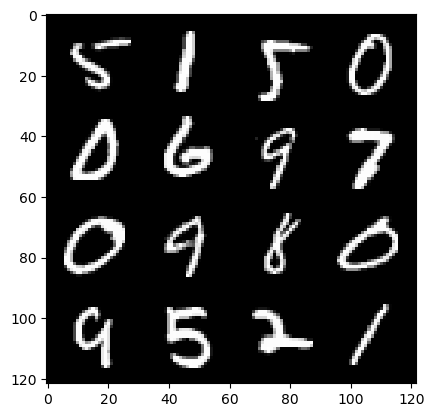

117: step 55200 / Gen loss: 2.5901157180468237 / disc_loss: 0.2141732316215832


  0%|          | 0/469 [00:00<?, ?it/s]

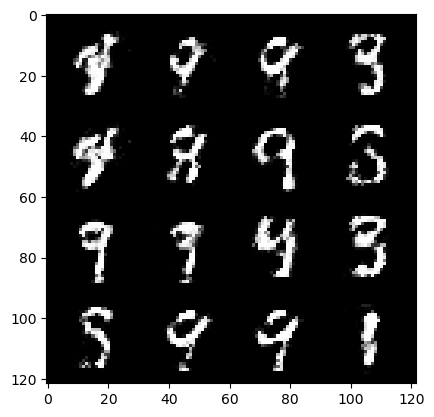

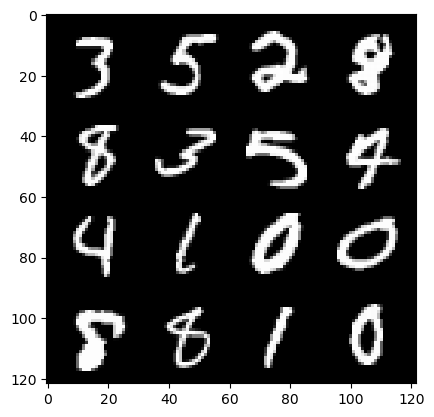

118: step 55500 / Gen loss: 2.4460873468716944 / disc_loss: 0.2295908882717291


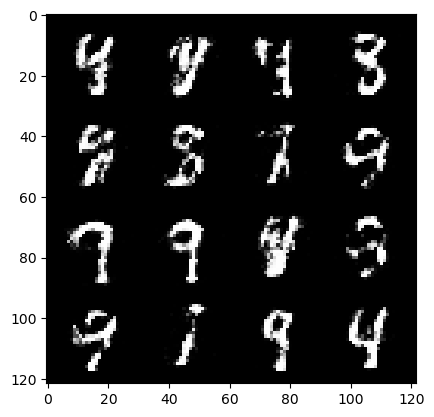

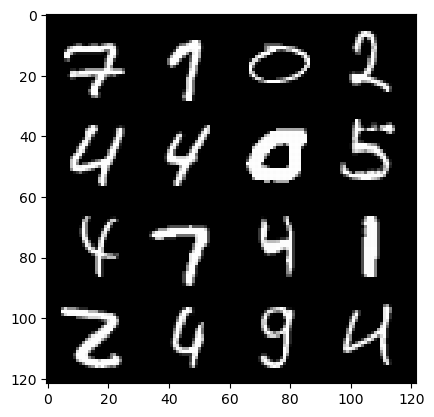

118: step 55800 / Gen loss: 2.429874020417531 / disc_loss: 0.22517038260897004


  0%|          | 0/469 [00:00<?, ?it/s]

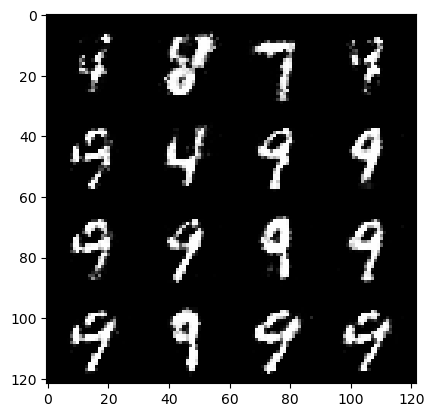

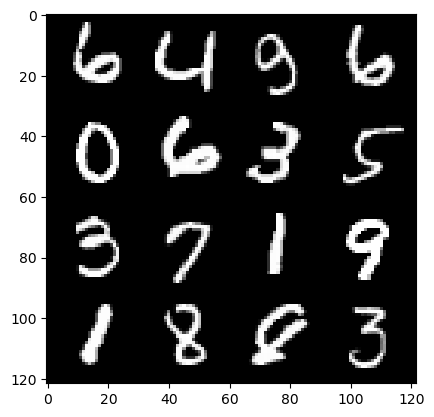

119: step 56100 / Gen loss: 2.3954221836725877 / disc_loss: 0.23900332277019817


  0%|          | 0/469 [00:00<?, ?it/s]

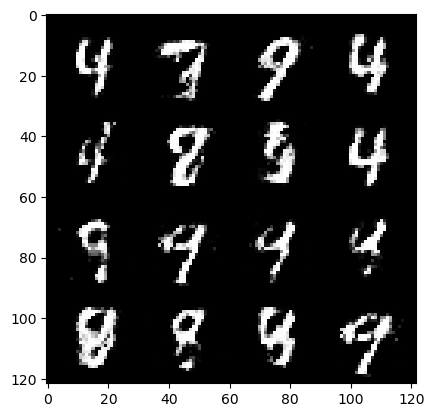

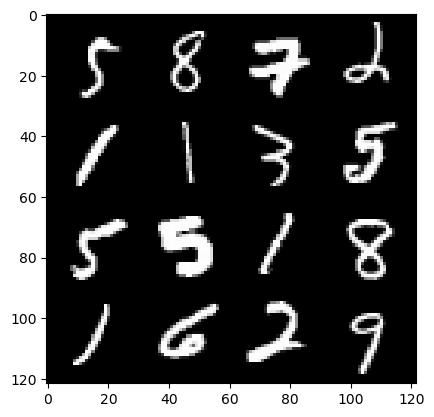

120: step 56400 / Gen loss: 2.452510437170665 / disc_loss: 0.22457085356116271


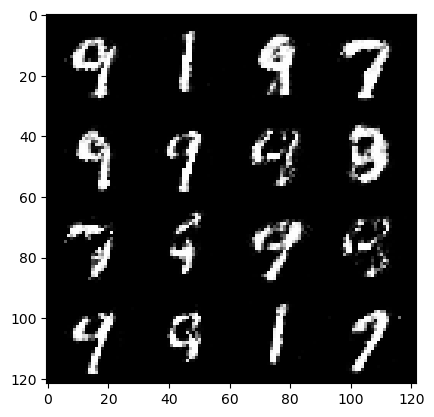

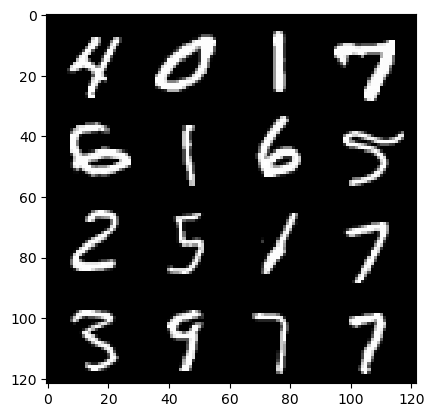

120: step 56700 / Gen loss: 2.3619015300273896 / disc_loss: 0.25058503841360397


  0%|          | 0/469 [00:00<?, ?it/s]

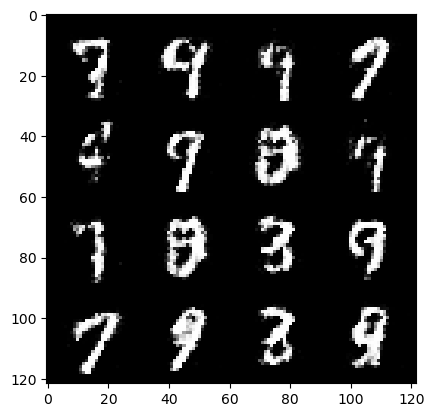

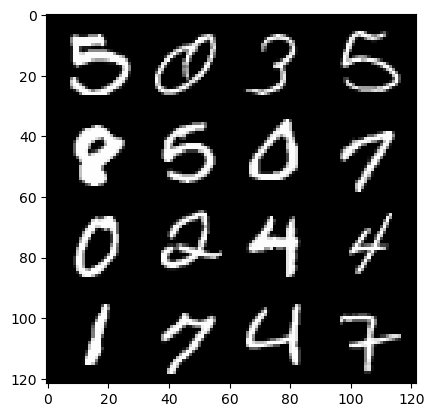

121: step 57000 / Gen loss: 2.2556330581506083 / disc_loss: 0.25557998870809856


  0%|          | 0/469 [00:00<?, ?it/s]

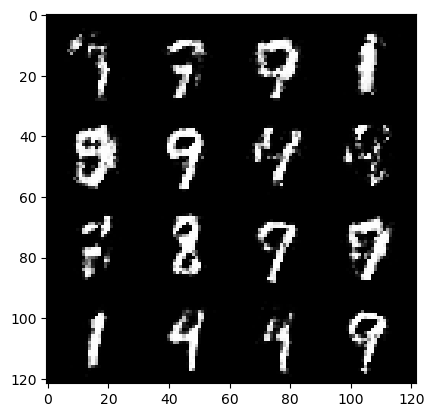

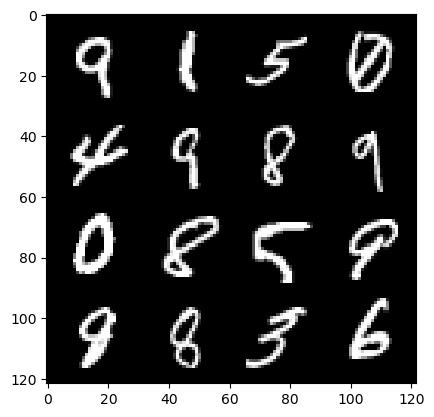

122: step 57300 / Gen loss: 2.3172117920716615 / disc_loss: 0.24571956833203645


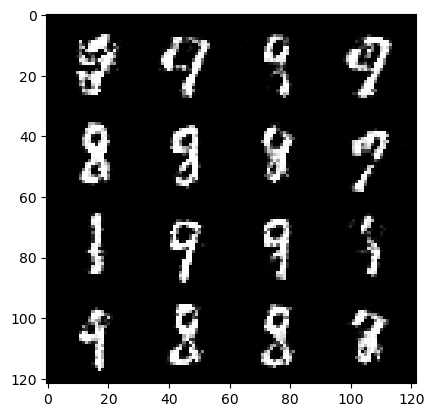

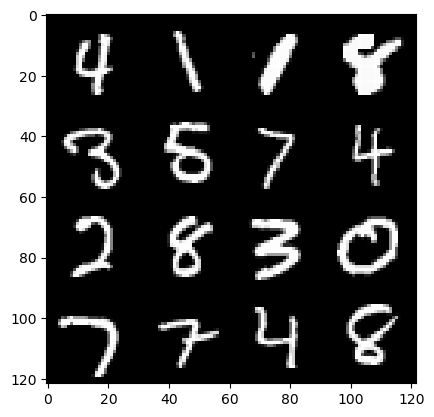

122: step 57600 / Gen loss: 2.2351639286677054 / disc_loss: 0.26027556742231056


  0%|          | 0/469 [00:00<?, ?it/s]

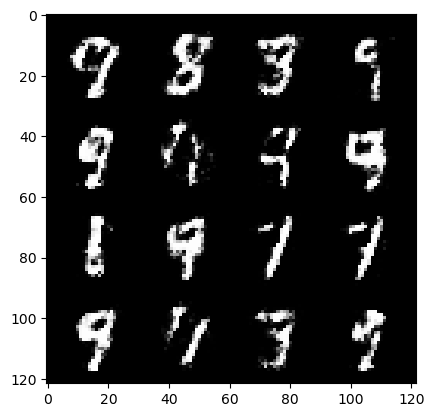

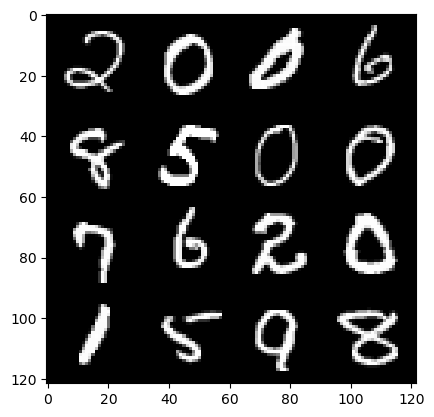

123: step 57900 / Gen loss: 2.1485821040471382 / disc_loss: 0.2713652555147807


  0%|          | 0/469 [00:00<?, ?it/s]

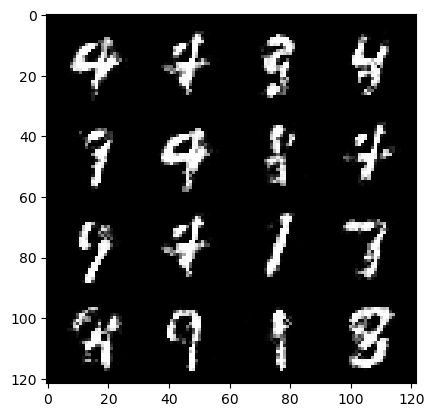

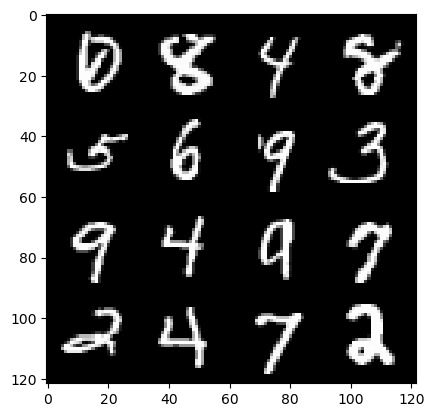

124: step 58200 / Gen loss: 2.158238183259963 / disc_loss: 0.268249620248874


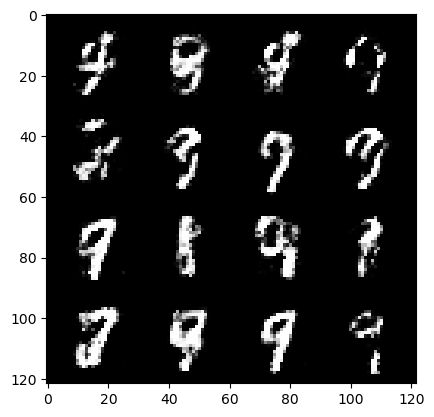

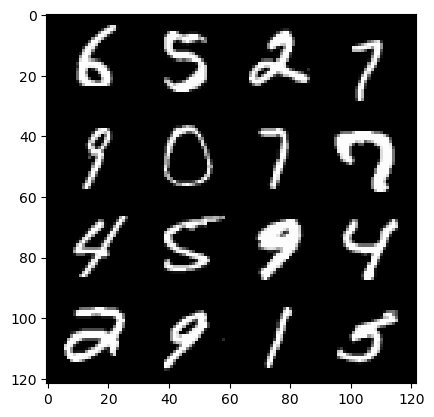

124: step 58500 / Gen loss: 2.2206694511572507 / disc_loss: 0.25108936692277595


  0%|          | 0/469 [00:00<?, ?it/s]

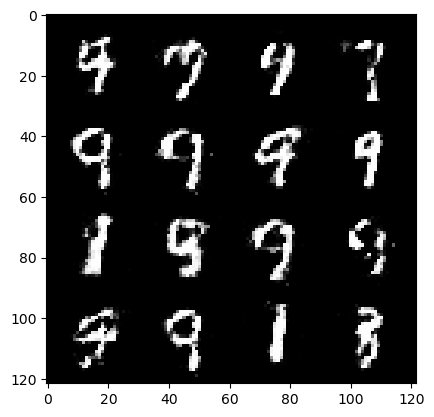

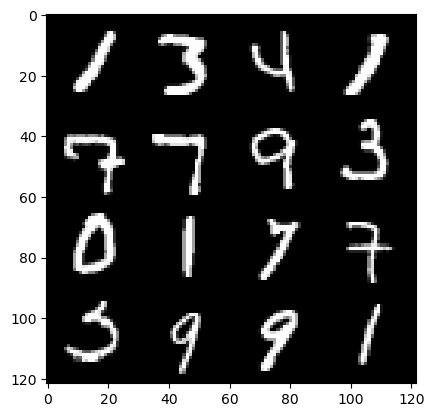

125: step 58800 / Gen loss: 2.3825113455454496 / disc_loss: 0.23048775816957162


  0%|          | 0/469 [00:00<?, ?it/s]

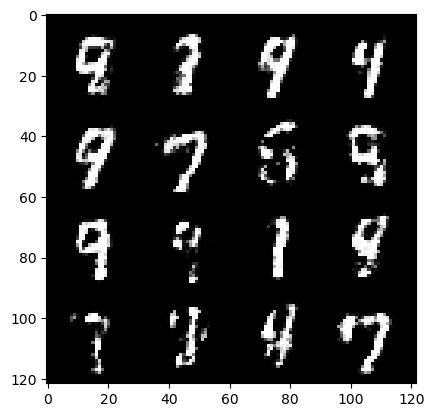

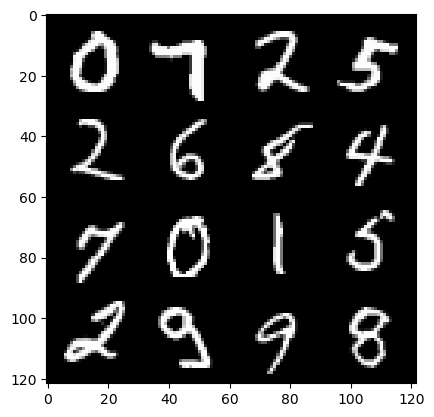

126: step 59100 / Gen loss: 2.357010031541189 / disc_loss: 0.2515264942745367


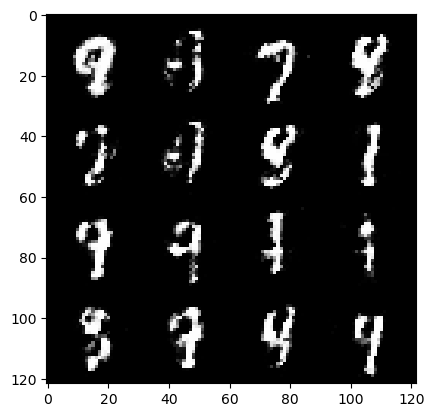

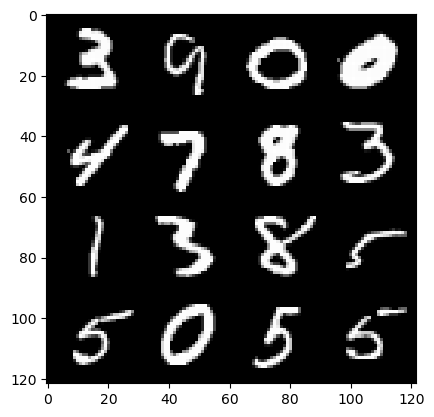

126: step 59400 / Gen loss: 2.208040789763133 / disc_loss: 0.26932536597053197


  0%|          | 0/469 [00:00<?, ?it/s]

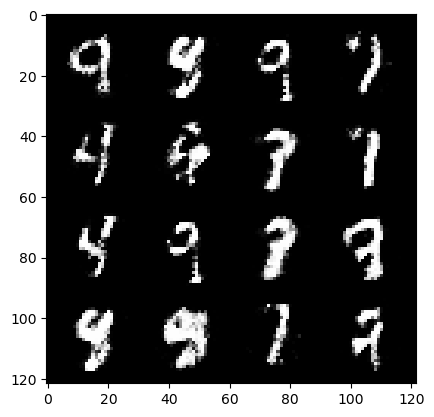

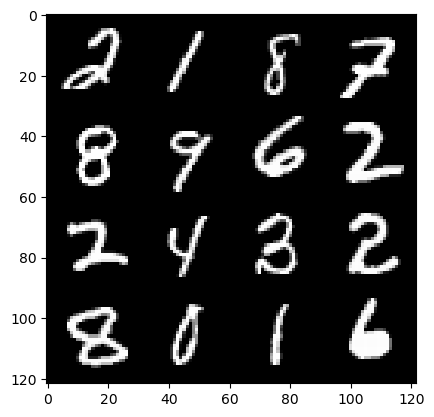

127: step 59700 / Gen loss: 2.1255483329296117 / disc_loss: 0.28054525241255757


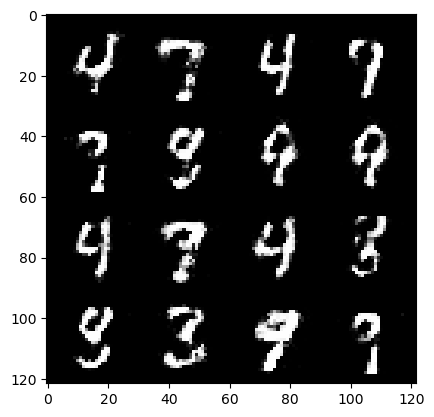

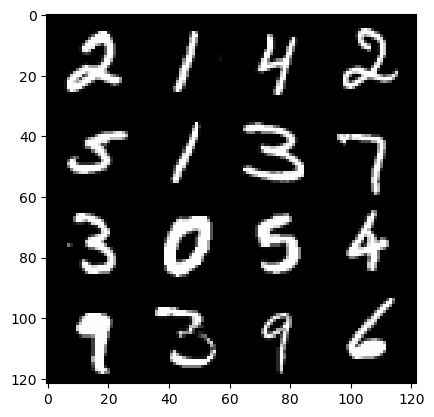

127: step 60000 / Gen loss: 2.167914202213287 / disc_loss: 0.2583622390528519


  0%|          | 0/469 [00:00<?, ?it/s]

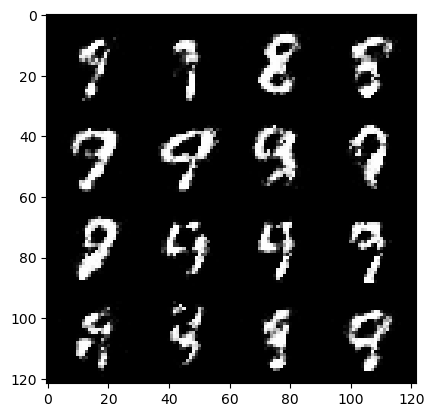

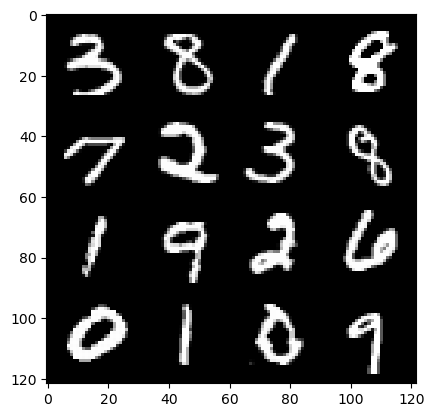

128: step 60300 / Gen loss: 2.152985838254293 / disc_loss: 0.2690033626059692


  0%|          | 0/469 [00:00<?, ?it/s]

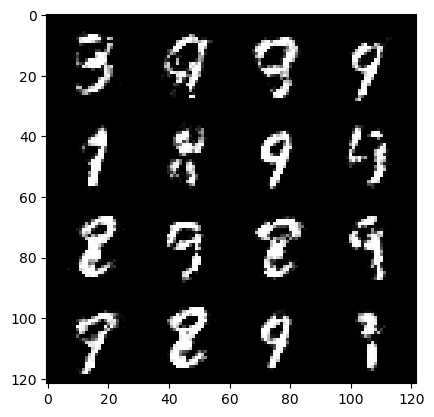

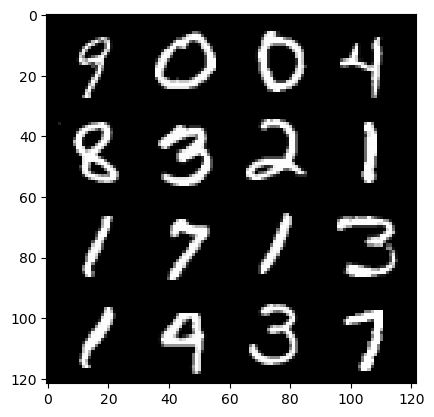

129: step 60600 / Gen loss: 2.1306635737419133 / disc_loss: 0.2716057035823664


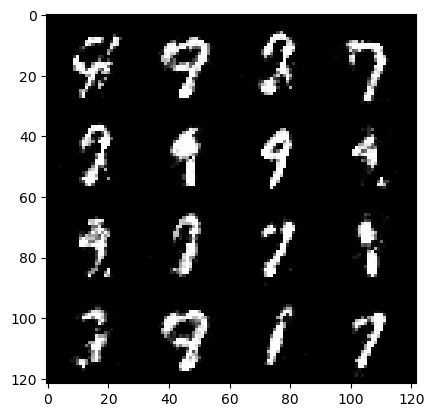

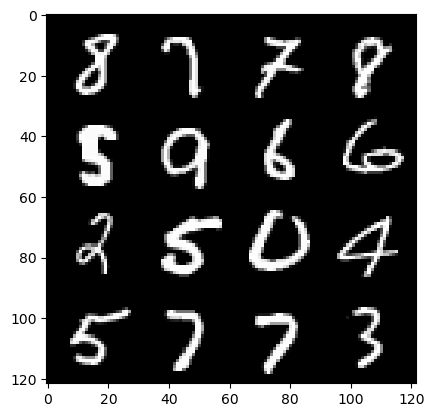

129: step 60900 / Gen loss: 2.1306395908196762 / disc_loss: 0.2760387909909086


  0%|          | 0/469 [00:00<?, ?it/s]

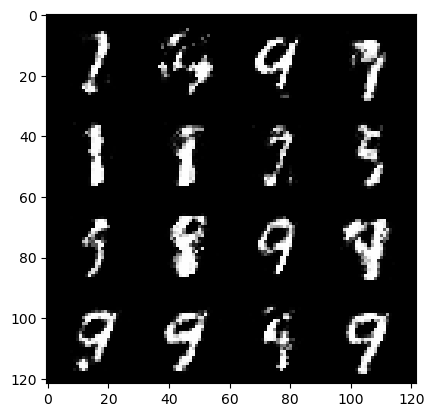

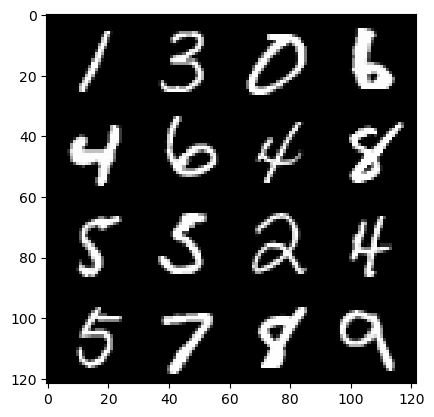

130: step 61200 / Gen loss: 2.124059565862021 / disc_loss: 0.2808713464935619


  0%|          | 0/469 [00:00<?, ?it/s]

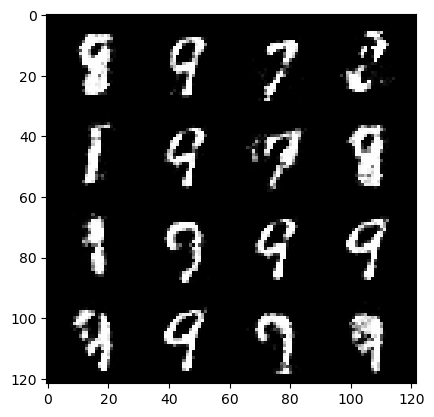

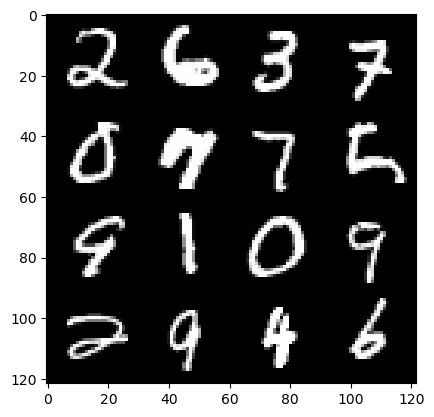

131: step 61500 / Gen loss: 2.1170692269007367 / disc_loss: 0.28047334522008893


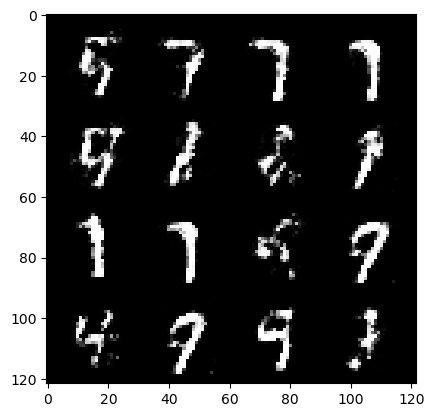

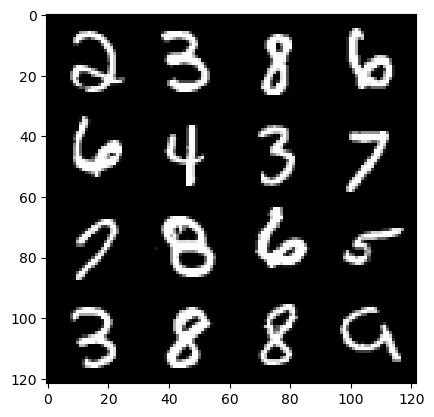

131: step 61800 / Gen loss: 2.143726618289947 / disc_loss: 0.27481289625167854


  0%|          | 0/469 [00:00<?, ?it/s]

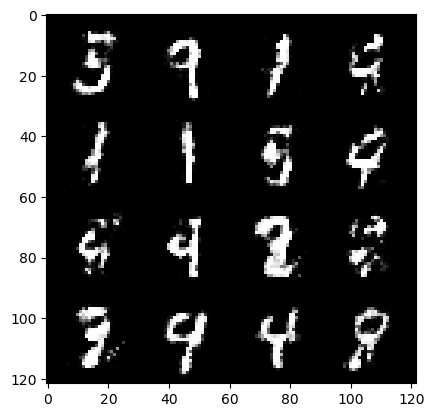

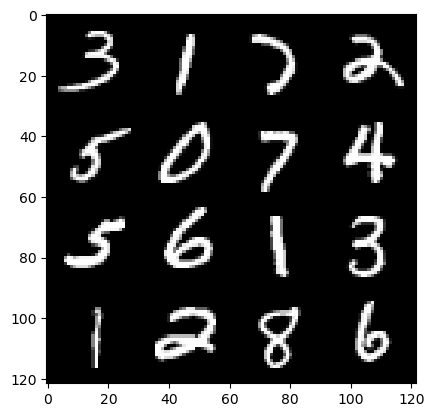

132: step 62100 / Gen loss: 2.0661214224497475 / disc_loss: 0.280066962838173


  0%|          | 0/469 [00:00<?, ?it/s]

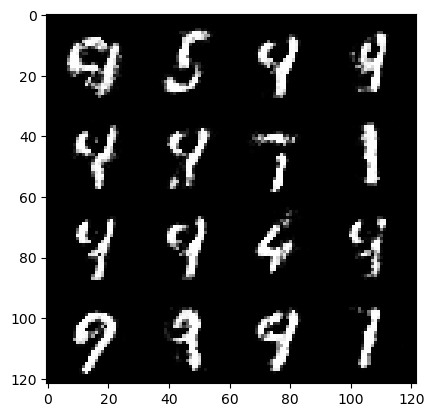

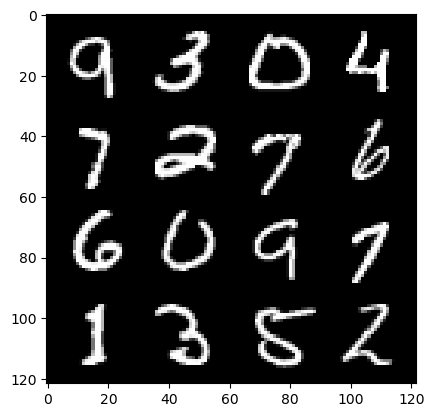

133: step 62400 / Gen loss: 2.1027855837345113 / disc_loss: 0.2899781767527262


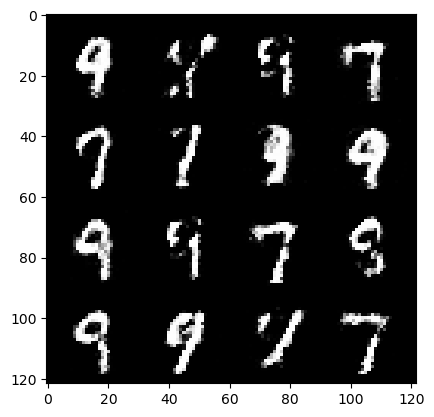

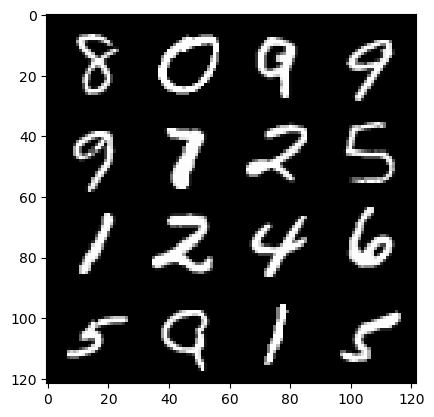

133: step 62700 / Gen loss: 1.9630436273415894 / disc_loss: 0.30585905571778615


  0%|          | 0/469 [00:00<?, ?it/s]

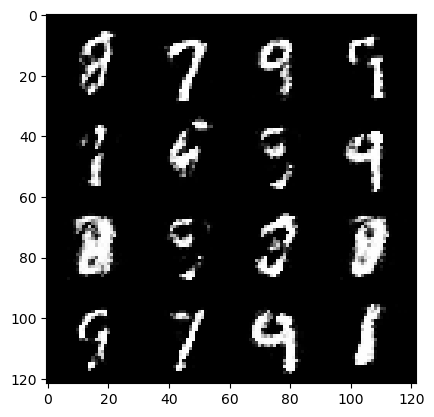

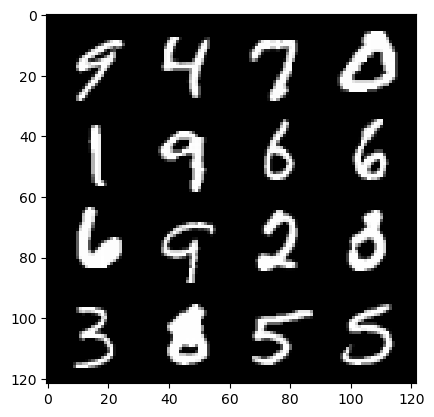

134: step 63000 / Gen loss: 1.9562731691201543 / disc_loss: 0.3126439991096655


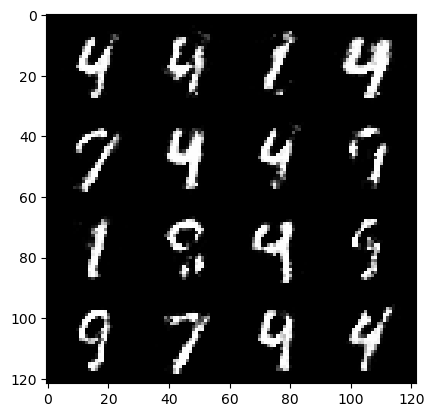

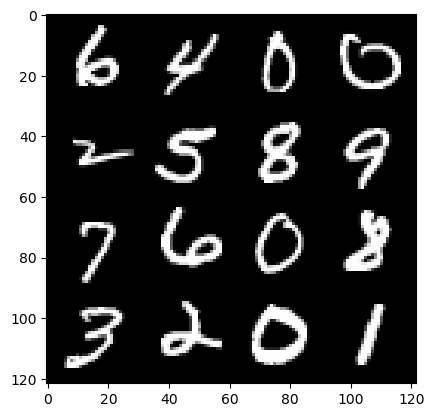

134: step 63300 / Gen loss: 1.966101545095443 / disc_loss: 0.28617887859543145


  0%|          | 0/469 [00:00<?, ?it/s]

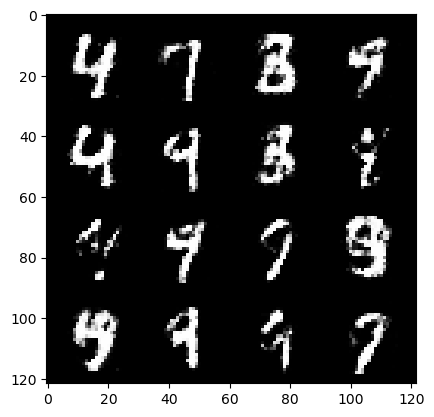

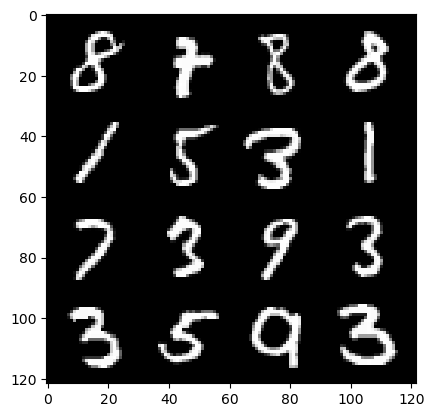

135: step 63600 / Gen loss: 1.9573775605360675 / disc_loss: 0.29294378812114424


  0%|          | 0/469 [00:00<?, ?it/s]

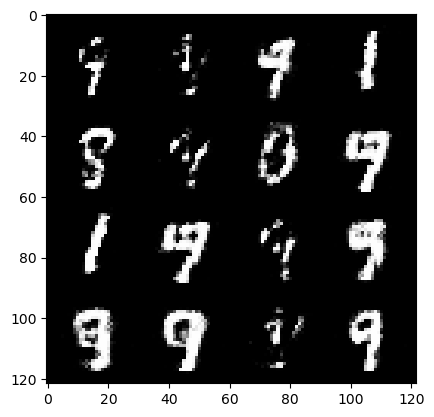

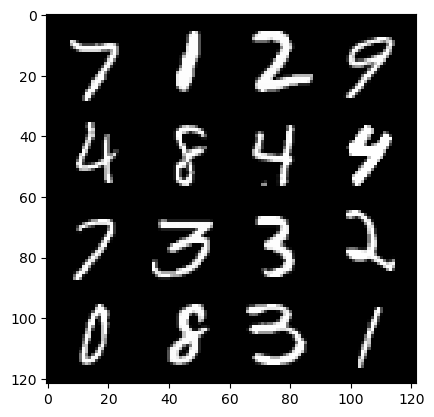

136: step 63900 / Gen loss: 2.0162735156218208 / disc_loss: 0.2850328177710376


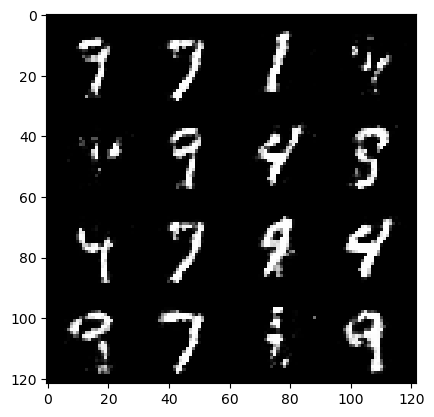

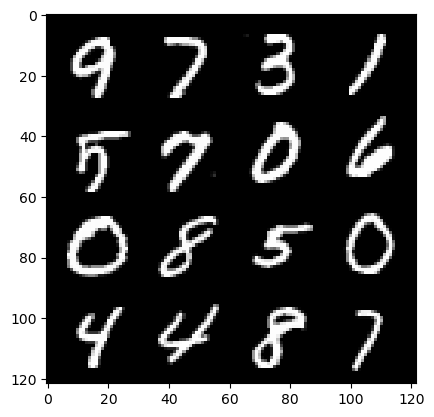

136: step 64200 / Gen loss: 2.021530299981434 / disc_loss: 0.2769979463517667


  0%|          | 0/469 [00:00<?, ?it/s]

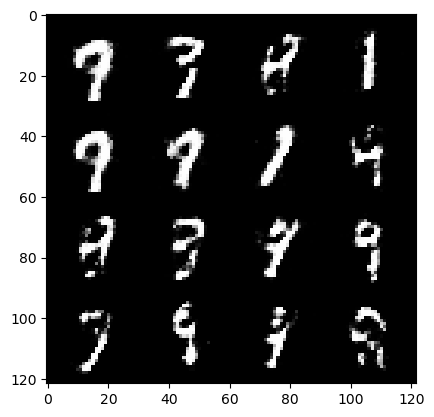

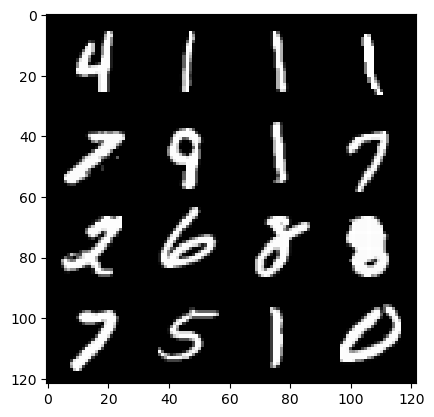

137: step 64500 / Gen loss: 2.02744758327802 / disc_loss: 0.2847329600155354


  0%|          | 0/469 [00:00<?, ?it/s]

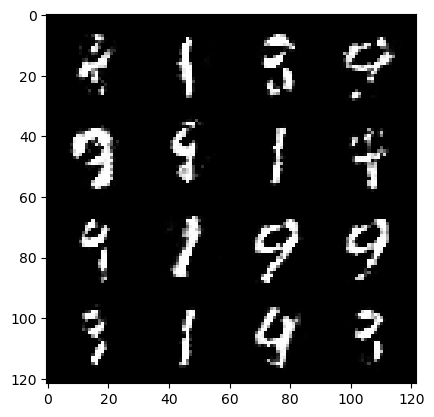

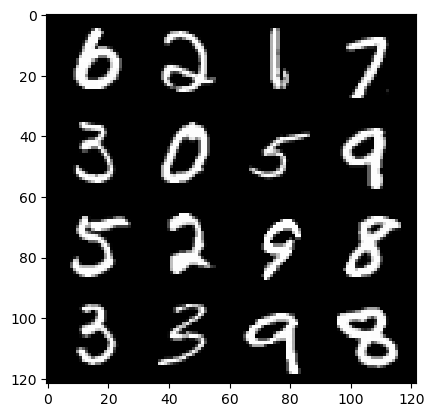

138: step 64800 / Gen loss: 2.1352270547548926 / disc_loss: 0.26295546621084204


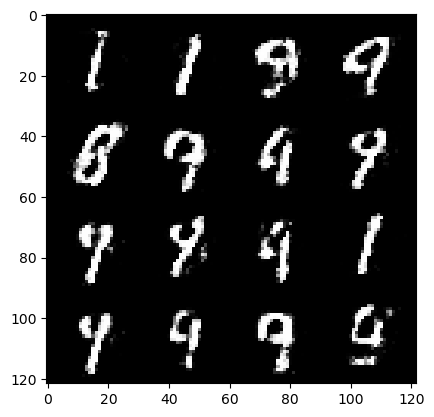

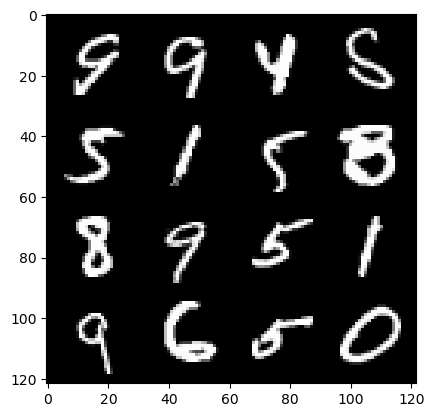

138: step 65100 / Gen loss: 2.0433026822408022 / disc_loss: 0.29945064092675844


  0%|          | 0/469 [00:00<?, ?it/s]

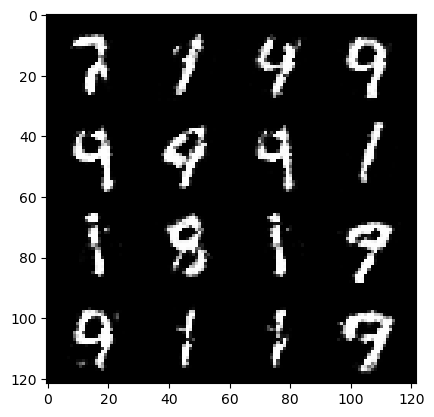

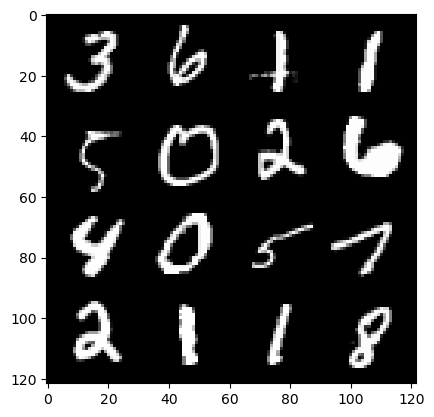

139: step 65400 / Gen loss: 1.956876593033473 / disc_loss: 0.31814191197355574


  0%|          | 0/469 [00:00<?, ?it/s]

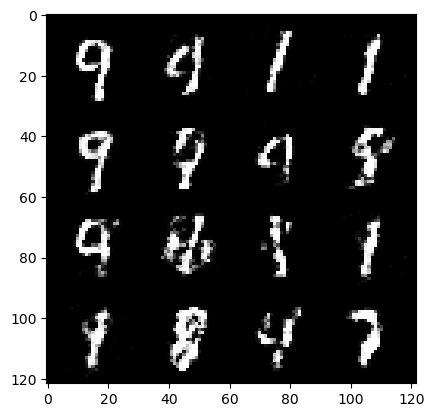

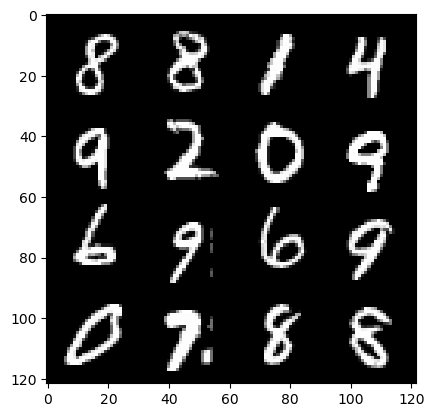

140: step 65700 / Gen loss: 1.8999277373154966 / disc_loss: 0.32921677842736236


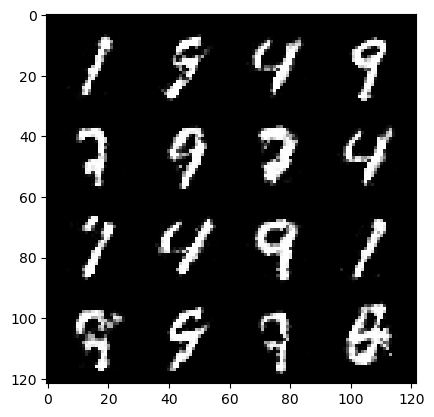

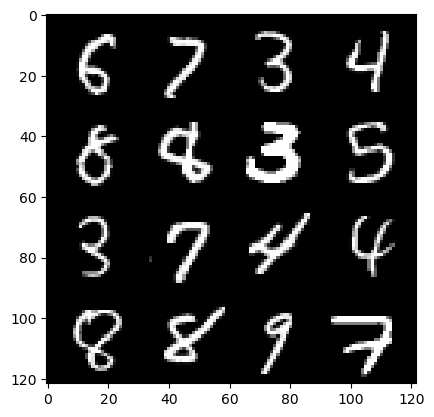

140: step 66000 / Gen loss: 1.8930549089113868 / disc_loss: 0.32440672660867376


  0%|          | 0/469 [00:00<?, ?it/s]

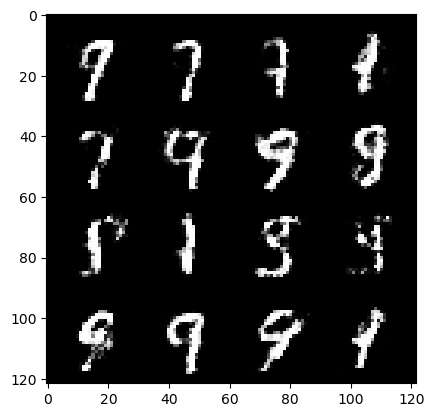

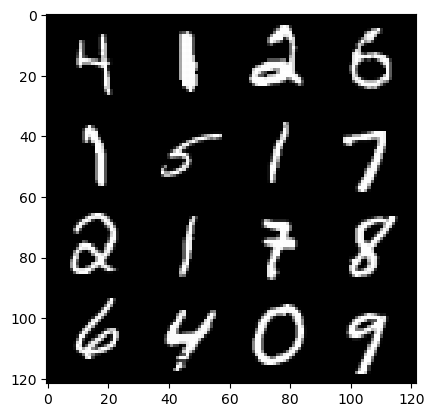

141: step 66300 / Gen loss: 1.8382965966065723 / disc_loss: 0.32537549138069144


  0%|          | 0/469 [00:00<?, ?it/s]

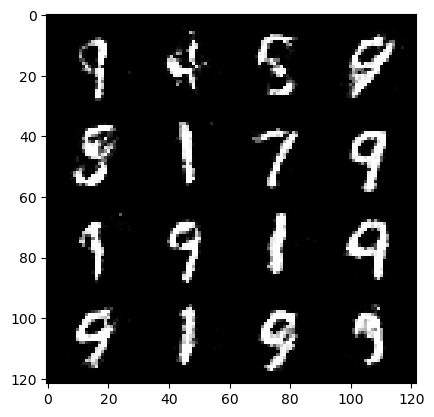

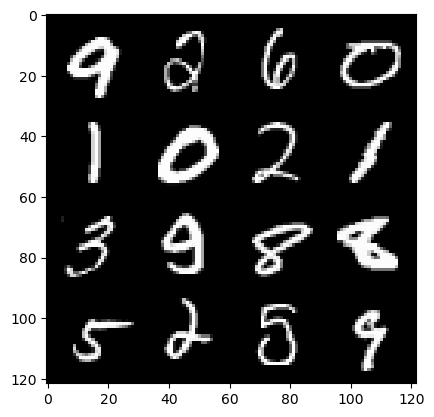

142: step 66600 / Gen loss: 1.8419390753904976 / disc_loss: 0.3203498764832814


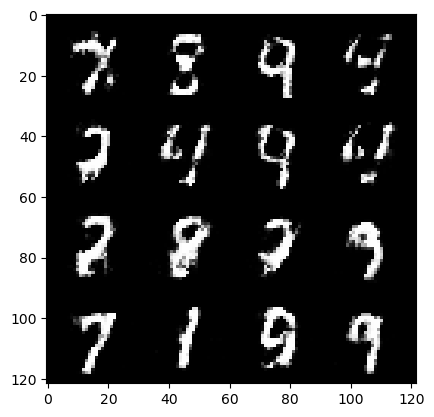

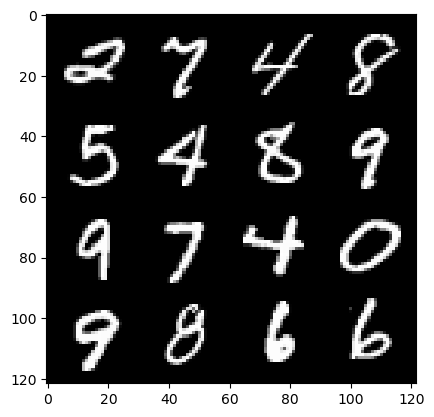

142: step 66900 / Gen loss: 1.89318962574005 / disc_loss: 0.3207612840334573


  0%|          | 0/469 [00:00<?, ?it/s]

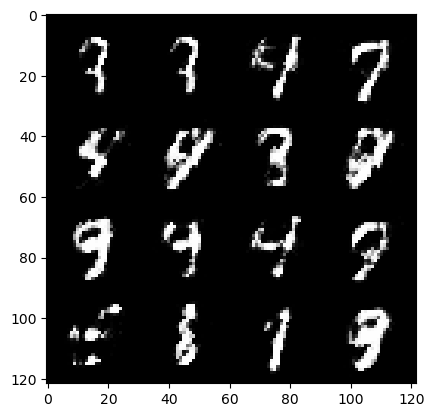

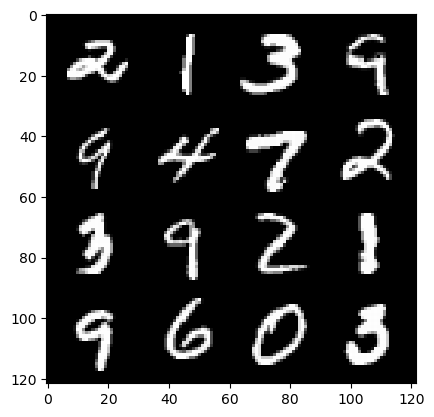

143: step 67200 / Gen loss: 1.794971348047255 / disc_loss: 0.34320392921566956


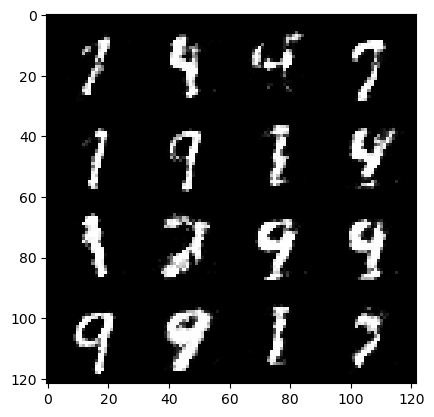

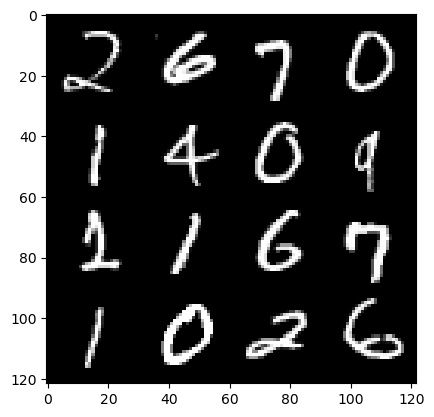

143: step 67500 / Gen loss: 1.7842786582311 / disc_loss: 0.3421986014644304


  0%|          | 0/469 [00:00<?, ?it/s]

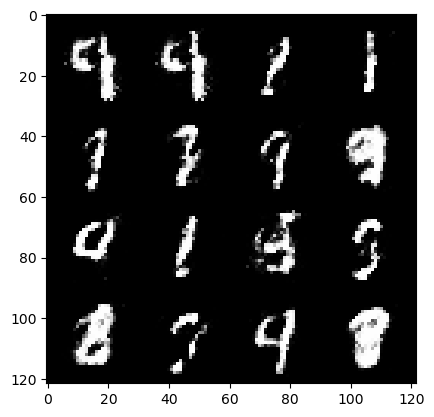

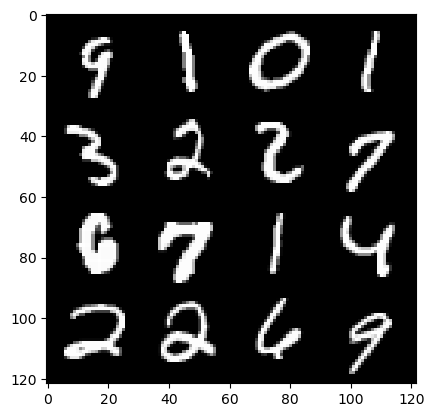

144: step 67800 / Gen loss: 1.7810003920396165 / disc_loss: 0.33958960687120765


  0%|          | 0/469 [00:00<?, ?it/s]

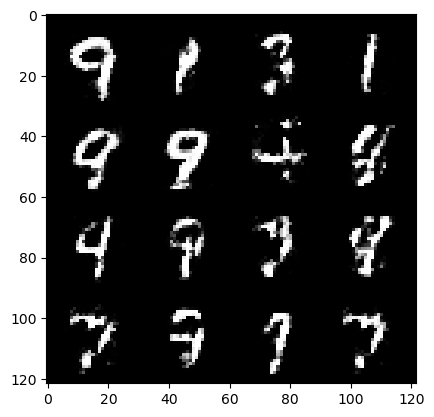

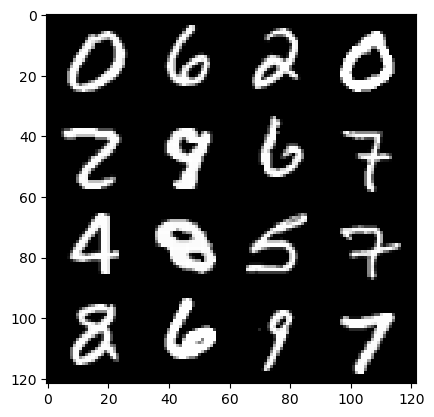

145: step 68100 / Gen loss: 1.8260041495164243 / disc_loss: 0.3191087902585666


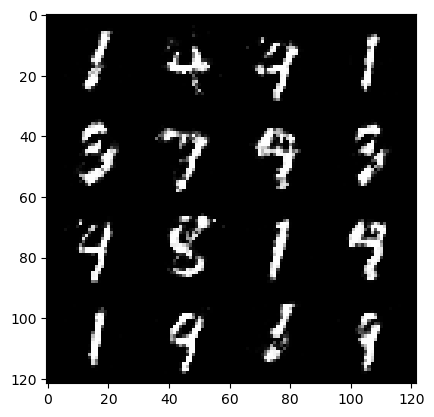

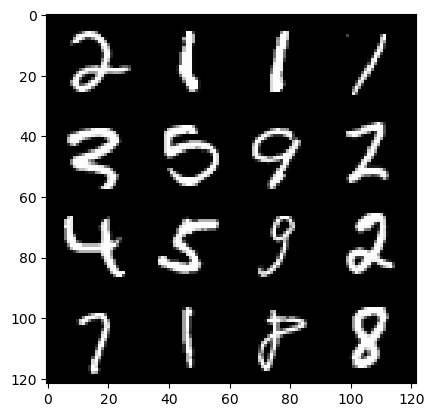

145: step 68400 / Gen loss: 1.8315467878182712 / disc_loss: 0.32818098713954297


  0%|          | 0/469 [00:00<?, ?it/s]

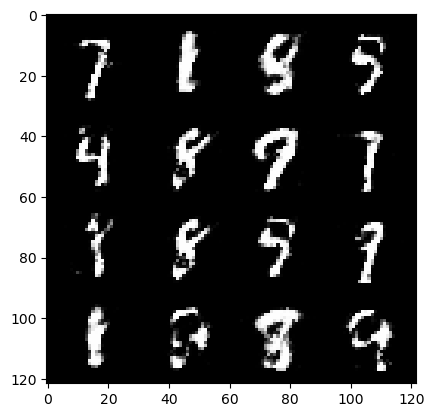

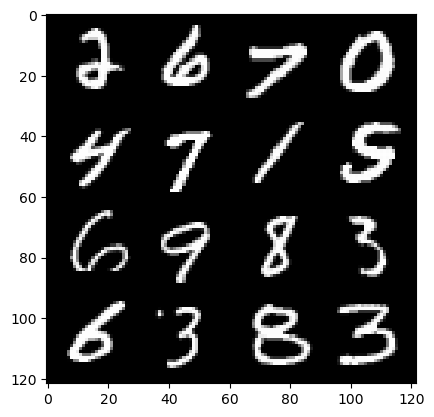

146: step 68700 / Gen loss: 1.920479084253311 / disc_loss: 0.3058272338906925


  0%|          | 0/469 [00:00<?, ?it/s]

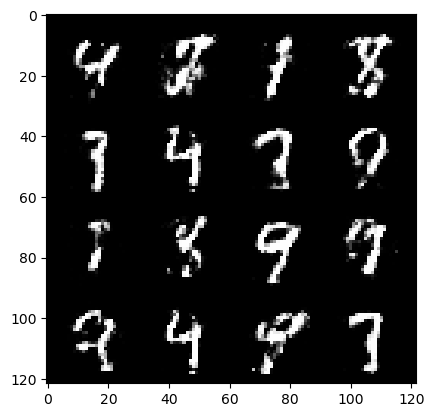

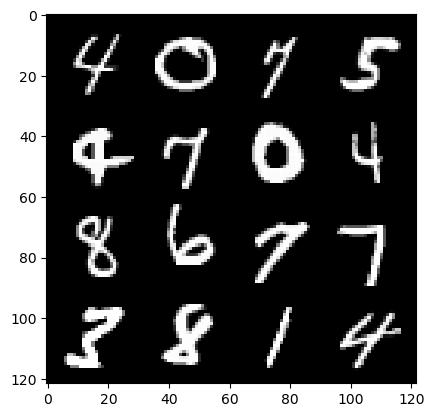

147: step 69000 / Gen loss: 1.7907201723257713 / disc_loss: 0.32734869251648585


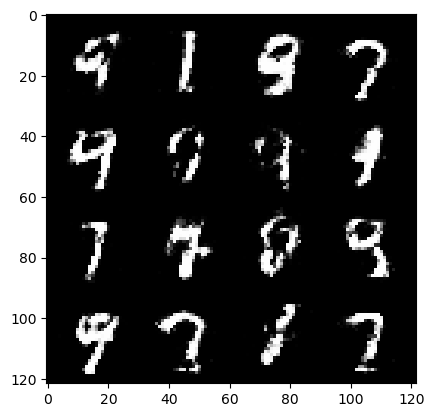

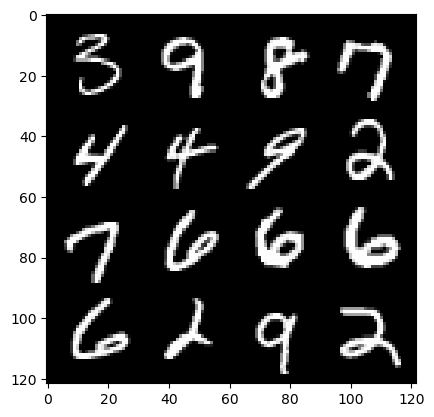

147: step 69300 / Gen loss: 1.7816507267951962 / disc_loss: 0.3403299863636494


  0%|          | 0/469 [00:00<?, ?it/s]

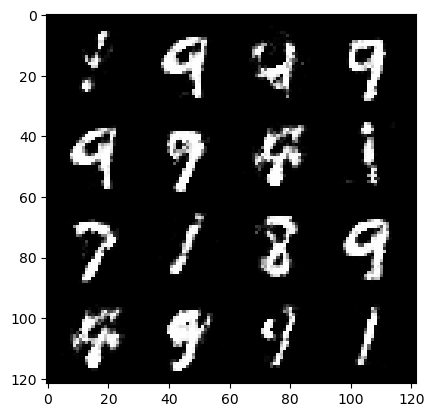

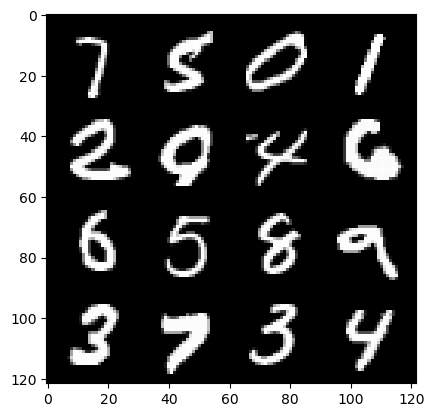

148: step 69600 / Gen loss: 1.7929072133700057 / disc_loss: 0.3372637507319448


  0%|          | 0/469 [00:00<?, ?it/s]

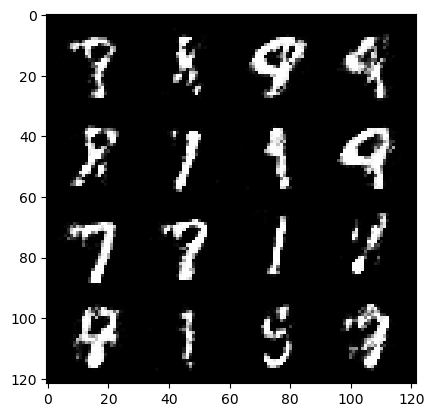

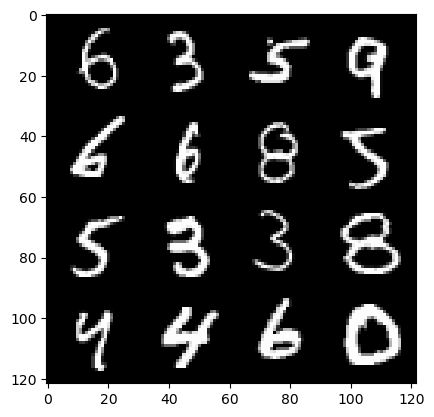

149: step 69900 / Gen loss: 1.7349938579400384 / disc_loss: 0.35331336766481425


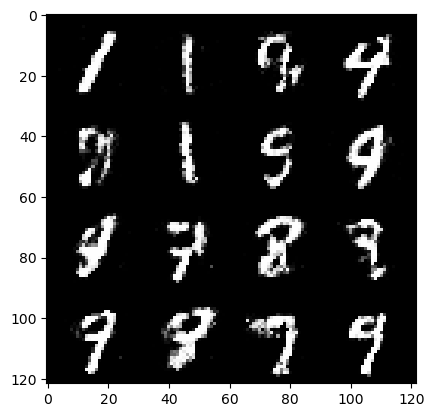

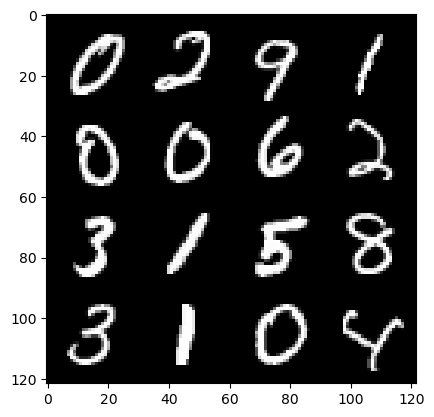

149: step 70200 / Gen loss: 1.736695685386658 / disc_loss: 0.35010933677355455


  0%|          | 0/469 [00:00<?, ?it/s]

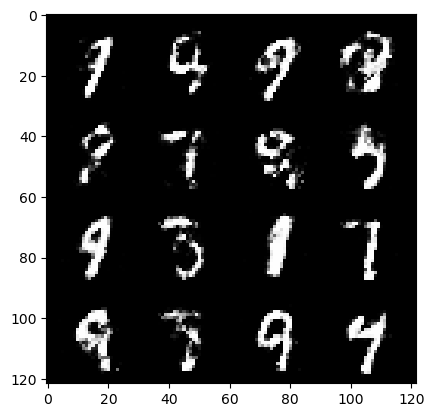

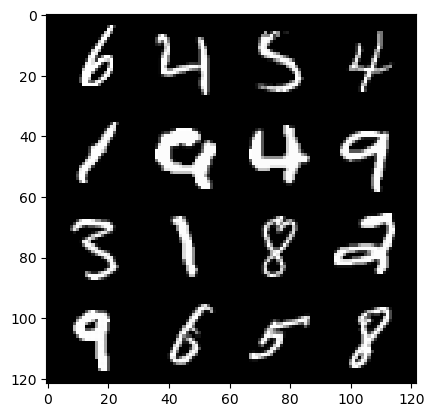

150: step 70500 / Gen loss: 1.7628758609294888 / disc_loss: 0.34130003492037453


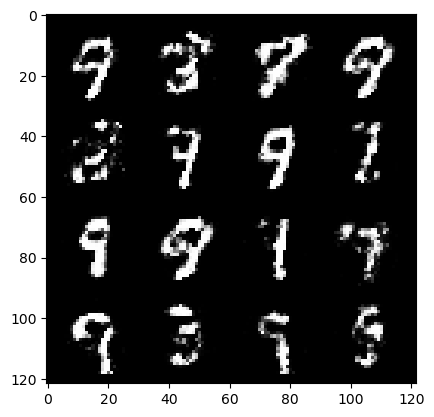

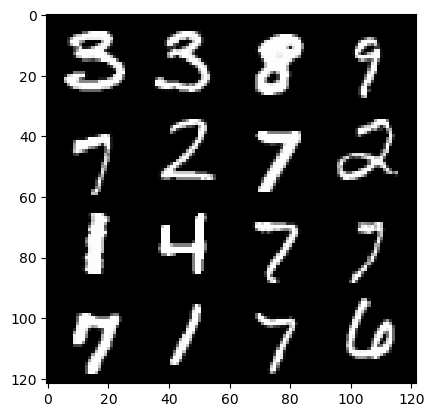

150: step 70800 / Gen loss: 1.7159703727563216 / disc_loss: 0.34687127172946947


  0%|          | 0/469 [00:00<?, ?it/s]

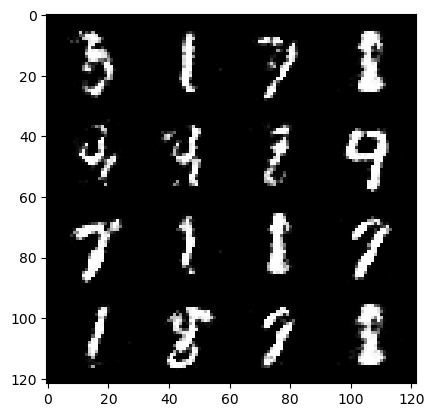

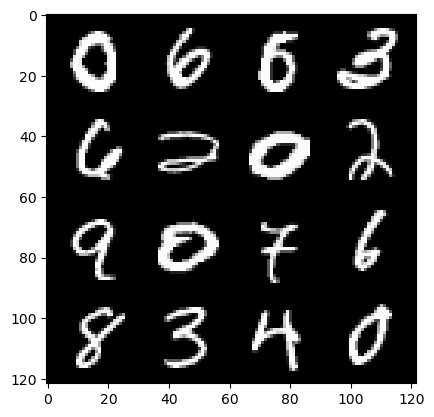

151: step 71100 / Gen loss: 1.7585481647650405 / disc_loss: 0.3410691480835275


  0%|          | 0/469 [00:00<?, ?it/s]

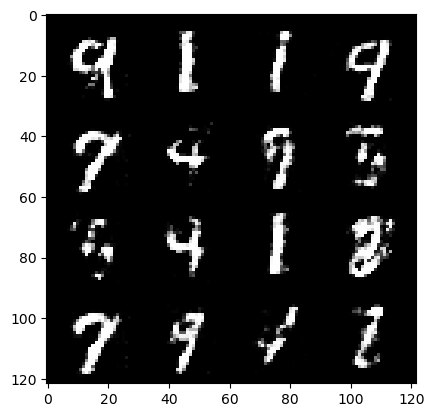

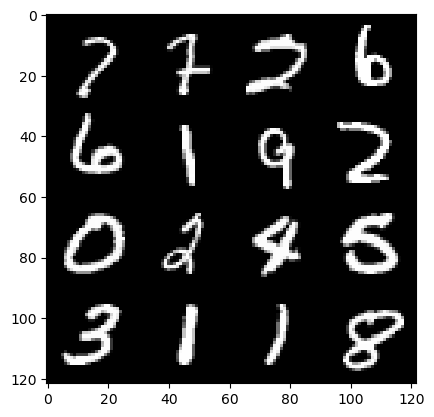

152: step 71400 / Gen loss: 1.7651014856497458 / disc_loss: 0.33568433249990137


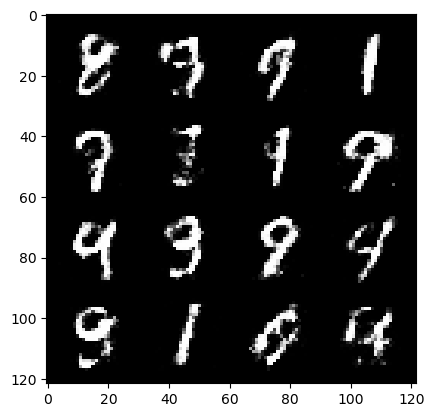

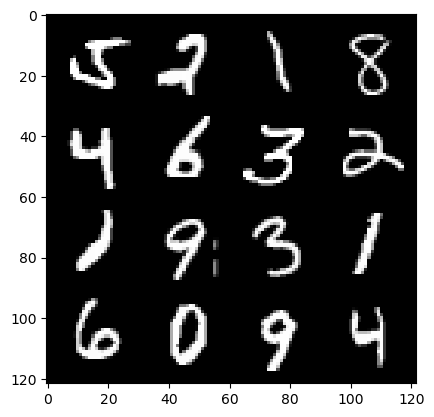

152: step 71700 / Gen loss: 1.686435454289117 / disc_loss: 0.36094601303338997


  0%|          | 0/469 [00:00<?, ?it/s]

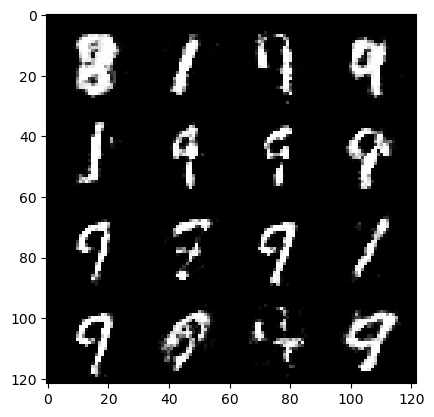

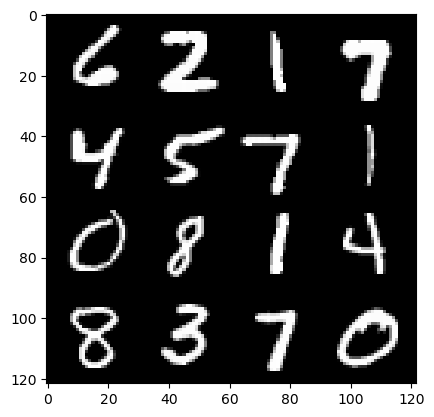

153: step 72000 / Gen loss: 1.651720471779506 / disc_loss: 0.3757823058962824


  0%|          | 0/469 [00:00<?, ?it/s]

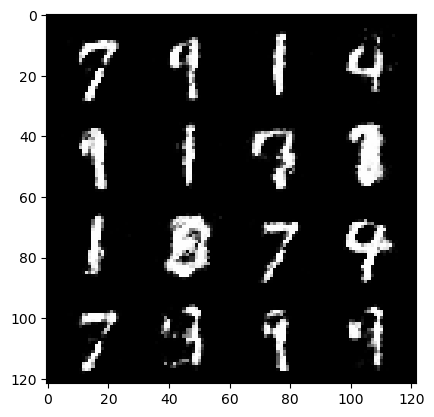

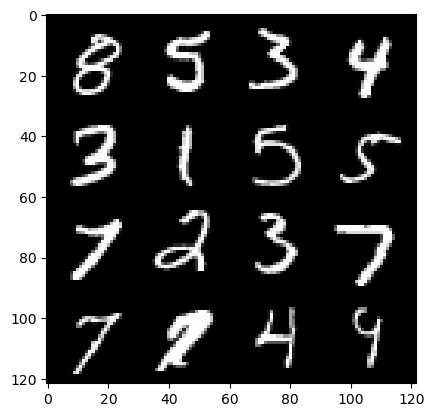

154: step 72300 / Gen loss: 1.6128669206301371 / disc_loss: 0.3737455344200133


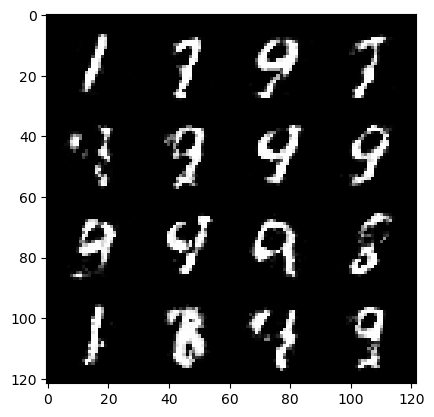

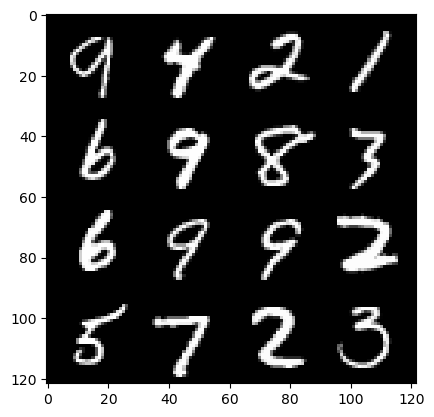

154: step 72600 / Gen loss: 1.663394231398901 / disc_loss: 0.3577735586961111


  0%|          | 0/469 [00:00<?, ?it/s]

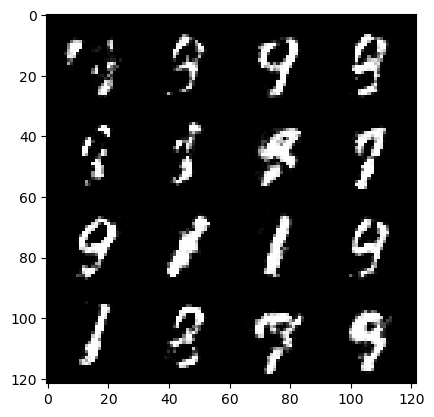

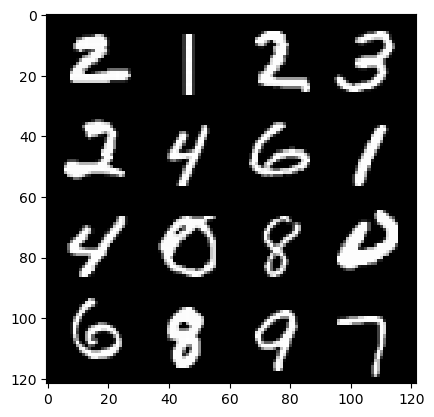

155: step 72900 / Gen loss: 1.6381786322593677 / disc_loss: 0.3689763069152834


  0%|          | 0/469 [00:00<?, ?it/s]

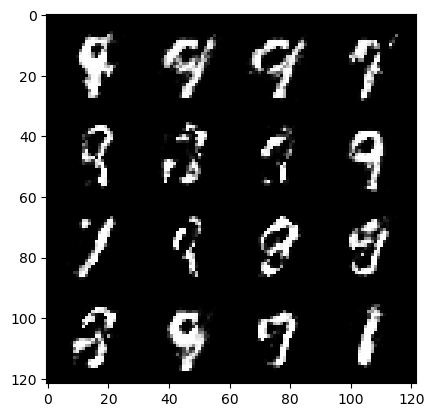

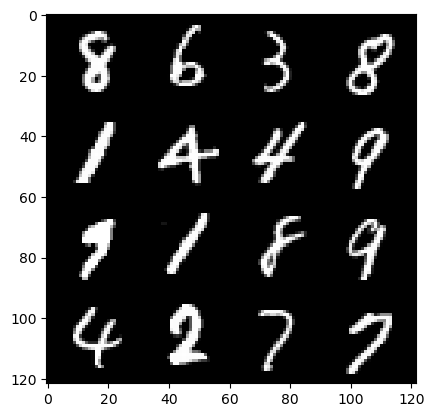

156: step 73200 / Gen loss: 1.6516769584019981 / disc_loss: 0.3555489413936933


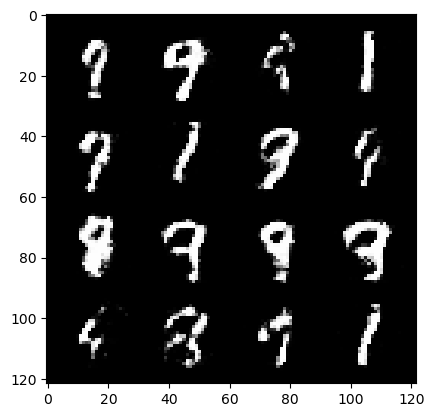

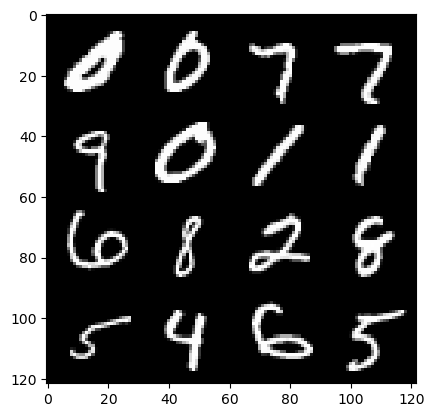

156: step 73500 / Gen loss: 1.7058262717723855 / disc_loss: 0.3440062765280407


  0%|          | 0/469 [00:00<?, ?it/s]

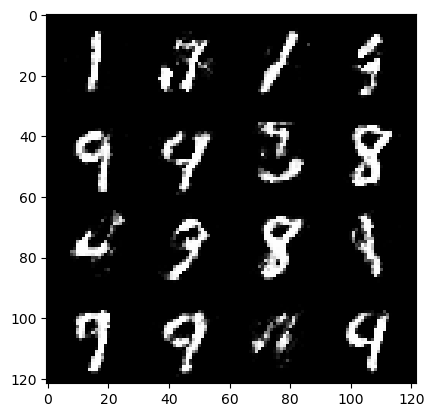

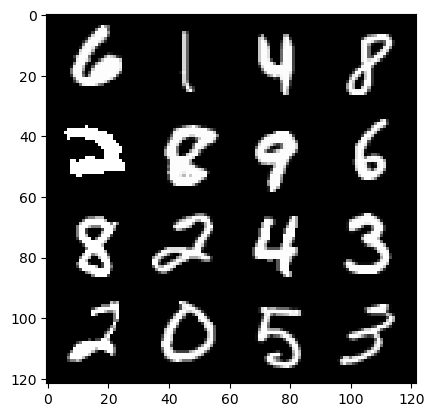

157: step 73800 / Gen loss: 1.6580562094847362 / disc_loss: 0.3682895239194234


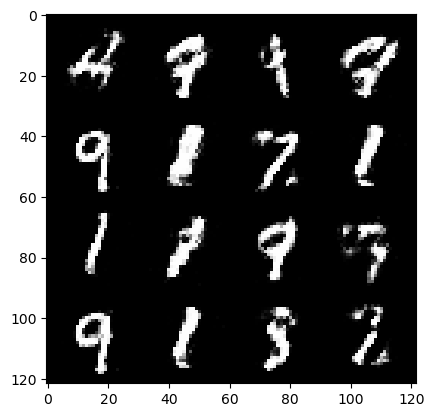

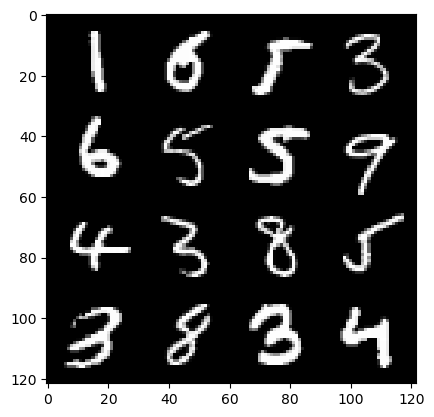

157: step 74100 / Gen loss: 1.6266420308748877 / disc_loss: 0.3845817406972248


  0%|          | 0/469 [00:00<?, ?it/s]

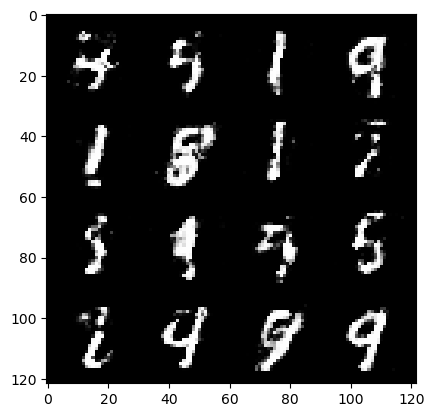

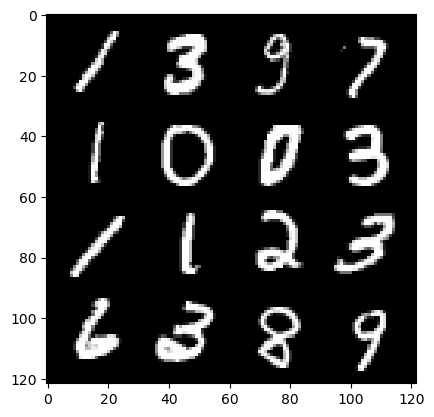

158: step 74400 / Gen loss: 1.6027399595578513 / disc_loss: 0.37362795521815606


  0%|          | 0/469 [00:00<?, ?it/s]

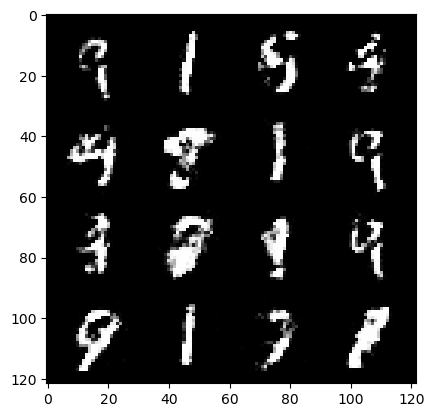

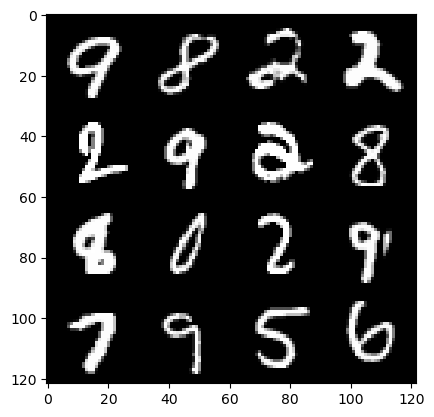

159: step 74700 / Gen loss: 1.6576167984803523 / disc_loss: 0.36273660371700917


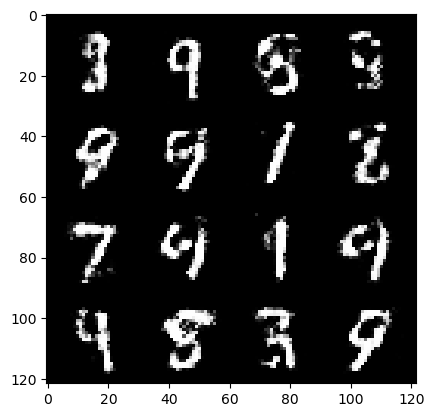

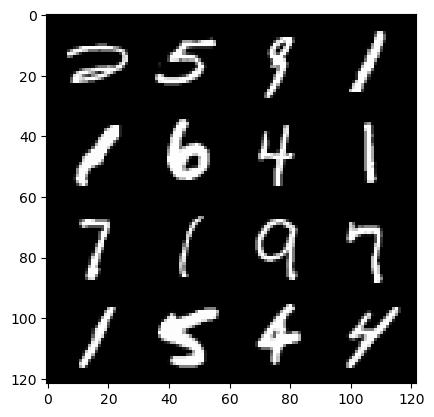

159: step 75000 / Gen loss: 1.6603360911210392 / disc_loss: 0.3671576000253359


  0%|          | 0/469 [00:00<?, ?it/s]

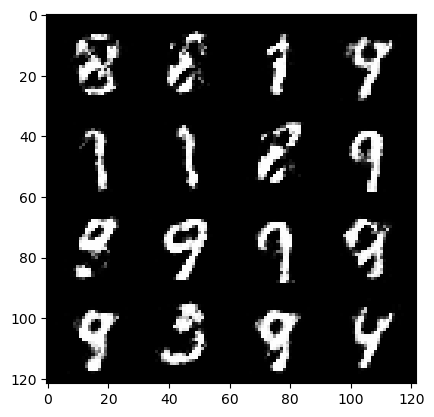

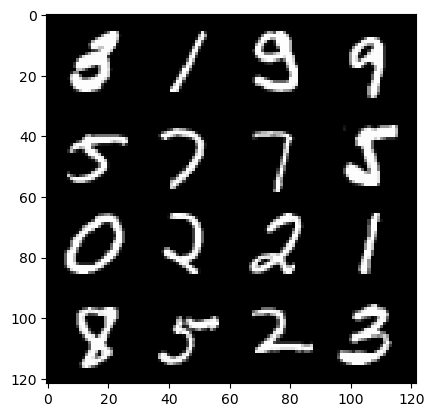

160: step 75300 / Gen loss: 1.592804043690363 / disc_loss: 0.38689554383357366


  0%|          | 0/469 [00:00<?, ?it/s]

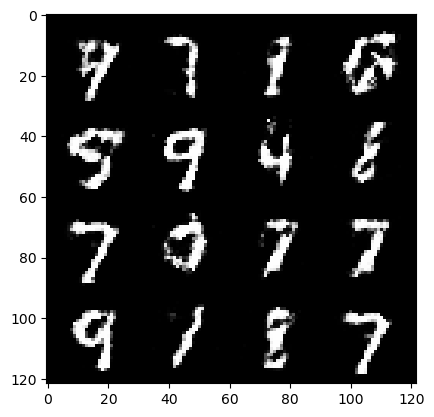

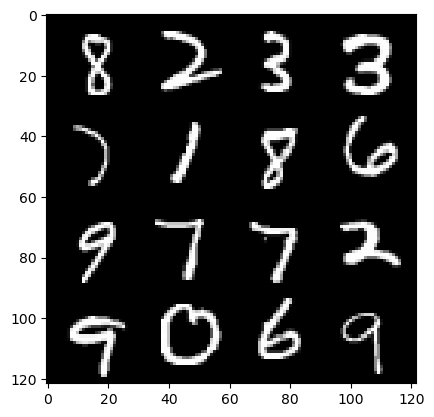

161: step 75600 / Gen loss: 1.5918734033902484 / disc_loss: 0.39021842658519745


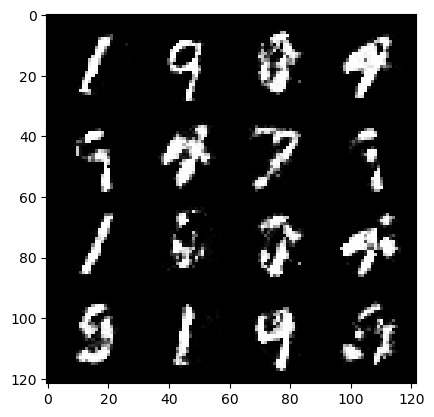

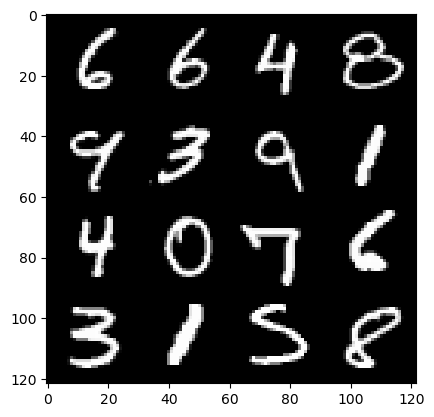

161: step 75900 / Gen loss: 1.5844556057453143 / disc_loss: 0.39031759768724456


  0%|          | 0/469 [00:00<?, ?it/s]

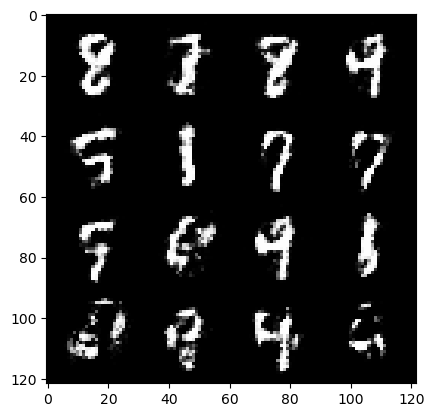

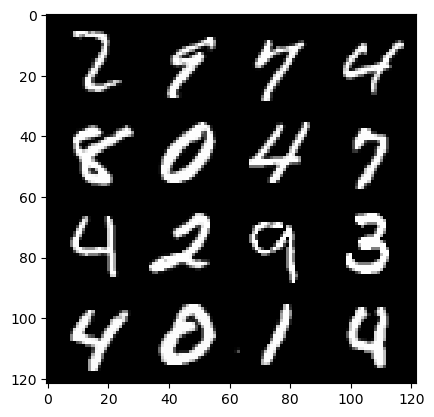

162: step 76200 / Gen loss: 1.5110609769821168 / disc_loss: 0.39976283888022085


  0%|          | 0/469 [00:00<?, ?it/s]

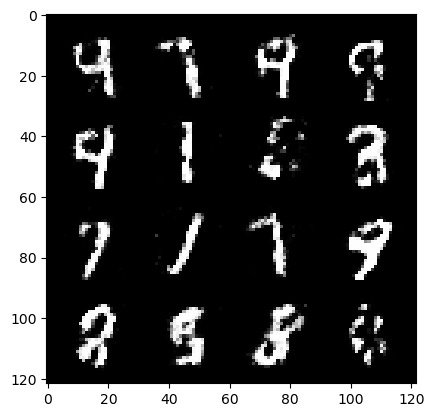

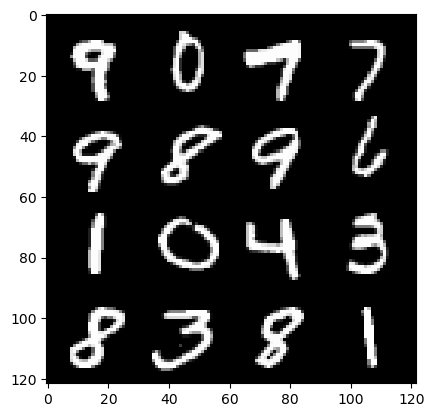

163: step 76500 / Gen loss: 1.5486657186349233 / disc_loss: 0.39405481179555274


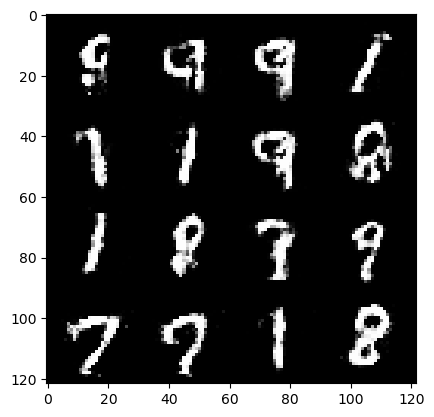

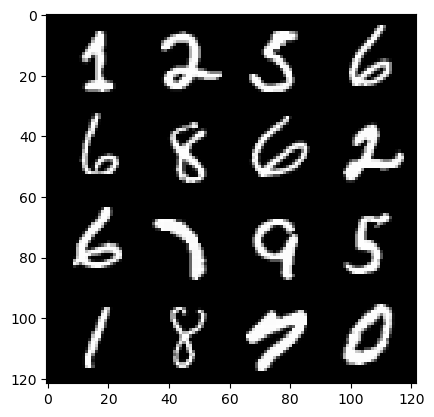

163: step 76800 / Gen loss: 1.5360075549284622 / disc_loss: 0.3932783688108125


  0%|          | 0/469 [00:00<?, ?it/s]

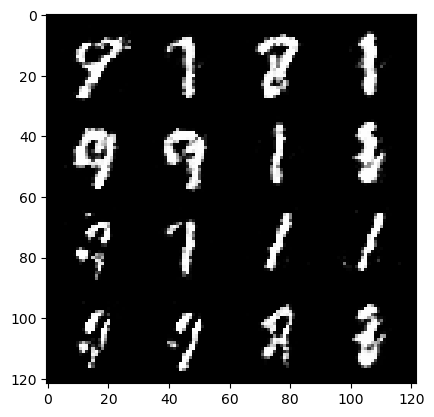

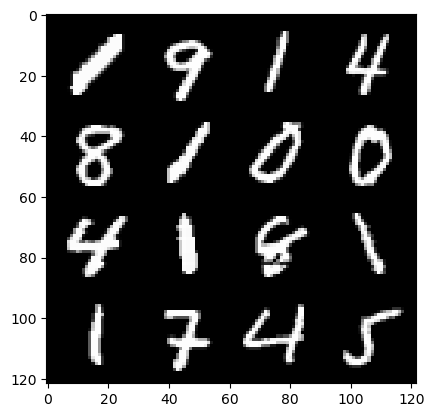

164: step 77100 / Gen loss: 1.5190424764156345 / disc_loss: 0.38366615553696976


  0%|          | 0/469 [00:00<?, ?it/s]

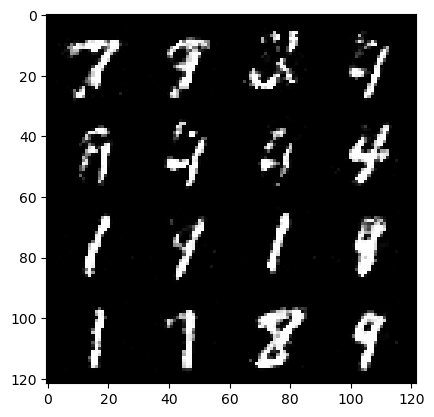

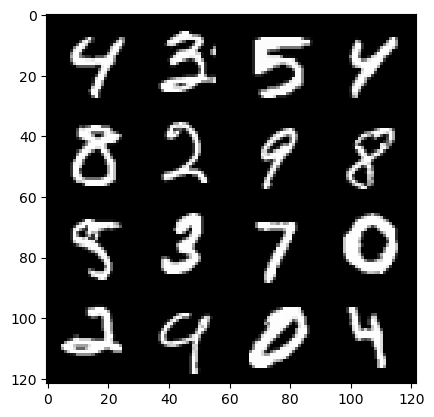

165: step 77400 / Gen loss: 1.672761549154918 / disc_loss: 0.35214401662349687


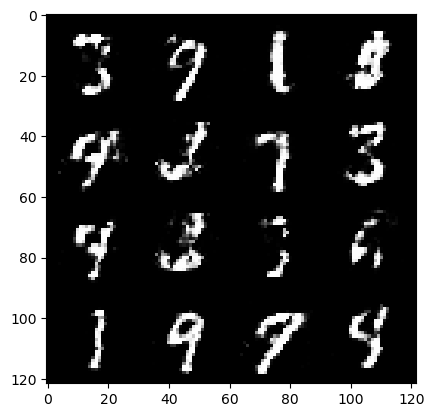

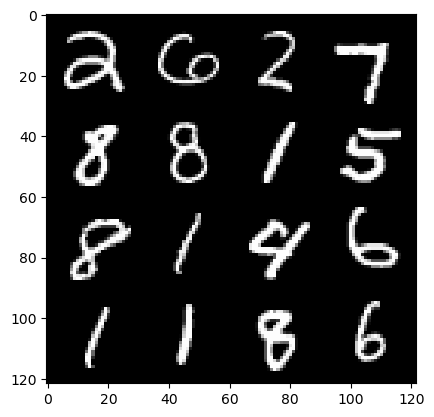

165: step 77700 / Gen loss: 1.636004813512166 / disc_loss: 0.3624431174000104


  0%|          | 0/469 [00:00<?, ?it/s]

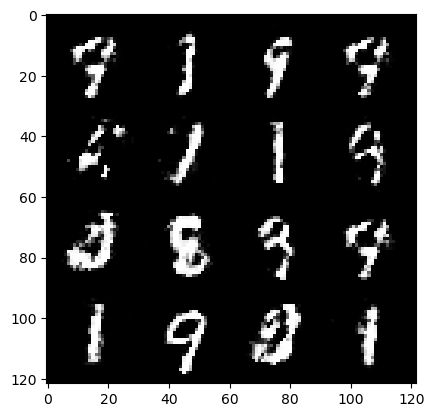

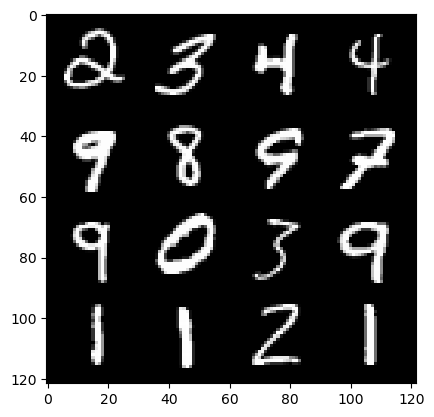

166: step 78000 / Gen loss: 1.5313590808709474 / disc_loss: 0.3879456701874731


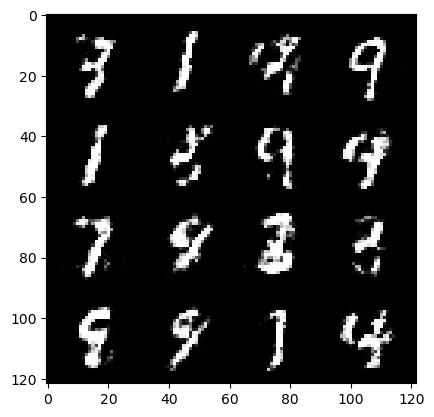

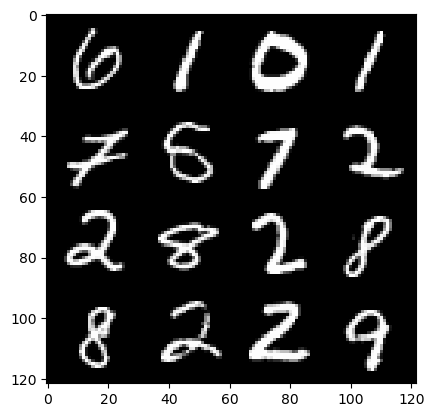

166: step 78300 / Gen loss: 1.531986088355382 / disc_loss: 0.38602344721555687


  0%|          | 0/469 [00:00<?, ?it/s]

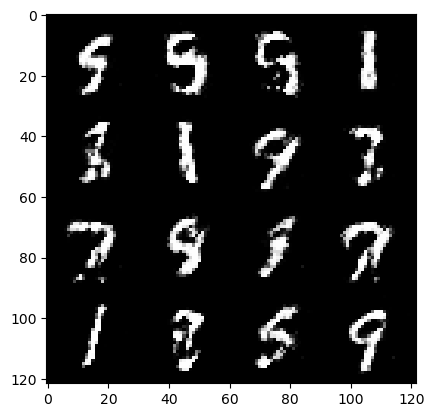

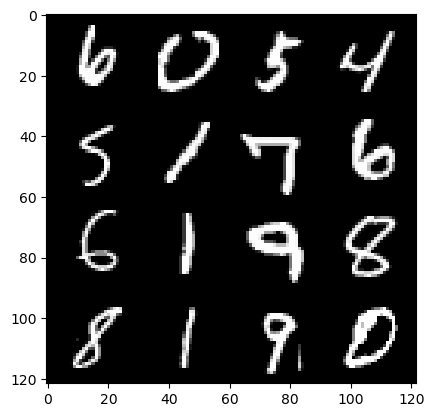

167: step 78600 / Gen loss: 1.5709600309530891 / disc_loss: 0.3765623922149339


  0%|          | 0/469 [00:00<?, ?it/s]

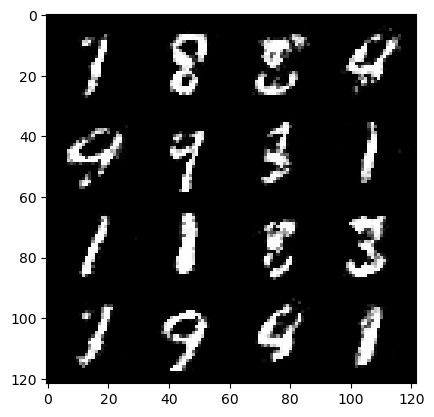

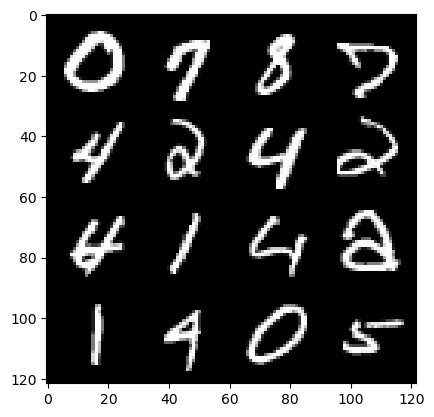

168: step 78900 / Gen loss: 1.4319485008716573 / disc_loss: 0.4190764810641607


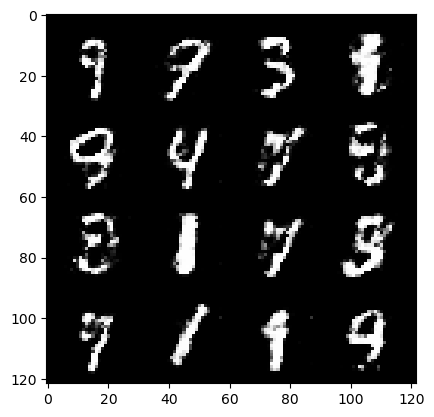

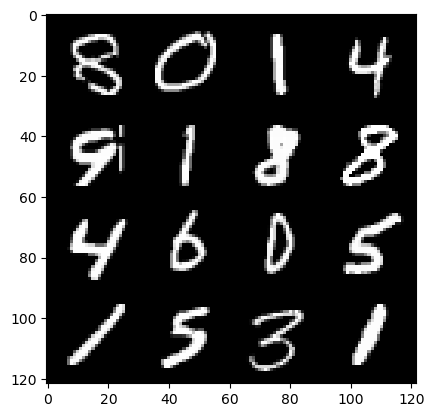

168: step 79200 / Gen loss: 1.5146583946545924 / disc_loss: 0.3903642129898073


  0%|          | 0/469 [00:00<?, ?it/s]

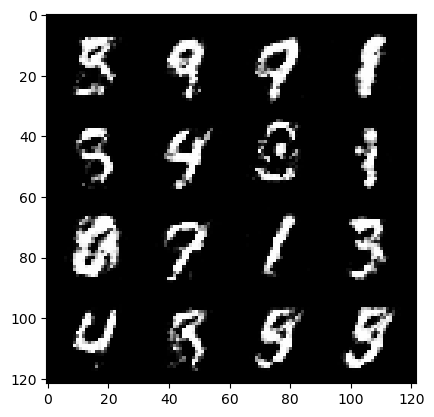

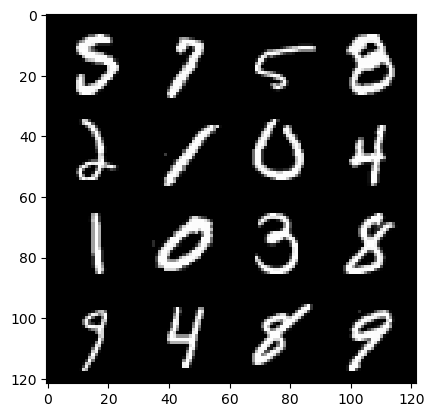

169: step 79500 / Gen loss: 1.4882610424359644 / disc_loss: 0.39655630081892024


  0%|          | 0/469 [00:00<?, ?it/s]

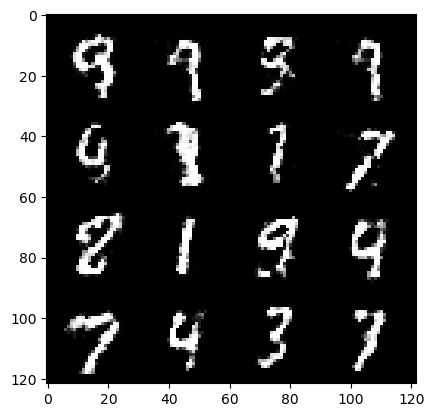

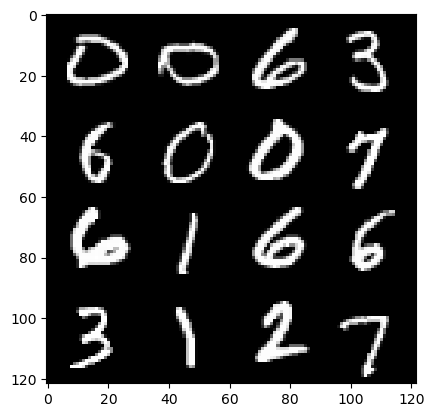

170: step 79800 / Gen loss: 1.4866452666123715 / disc_loss: 0.39146619965632745


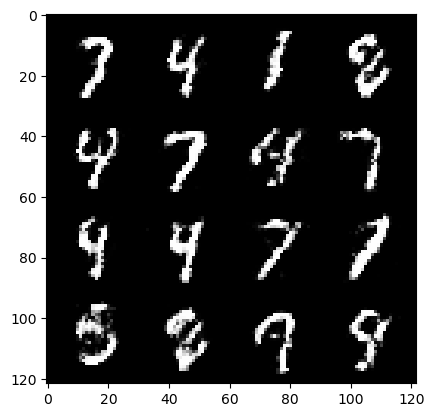

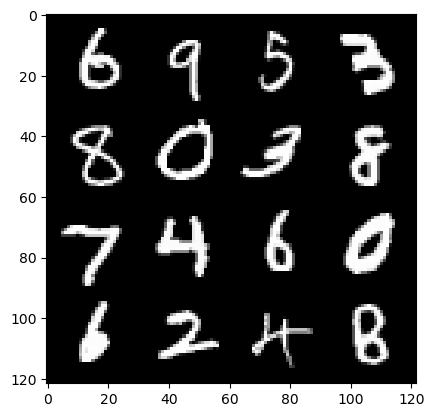

170: step 80100 / Gen loss: 1.5694195834795641 / disc_loss: 0.3783585399389269


  0%|          | 0/469 [00:00<?, ?it/s]

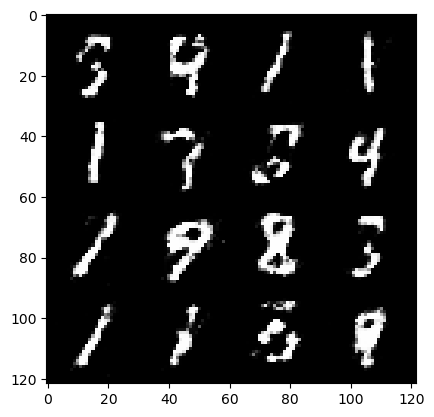

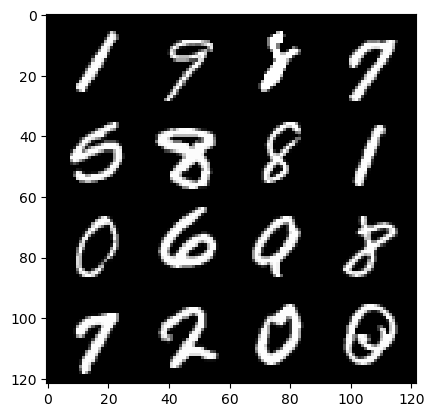

171: step 80400 / Gen loss: 1.5289112246036534 / disc_loss: 0.3880417571465174


  0%|          | 0/469 [00:00<?, ?it/s]

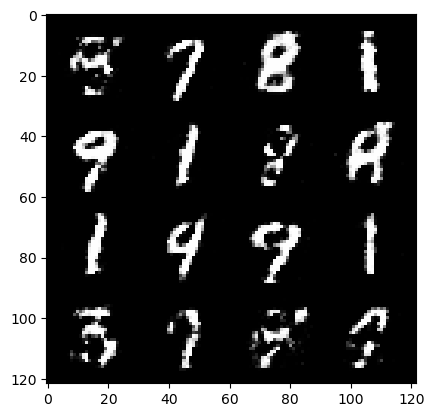

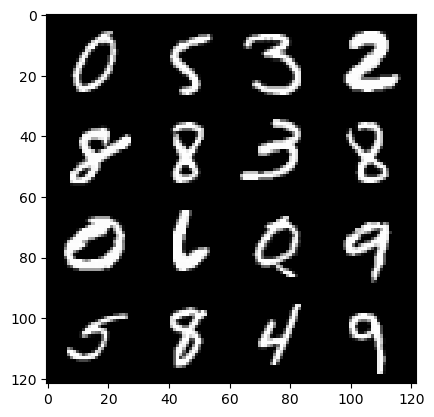

172: step 80700 / Gen loss: 1.5826408116022763 / disc_loss: 0.3764037205775577


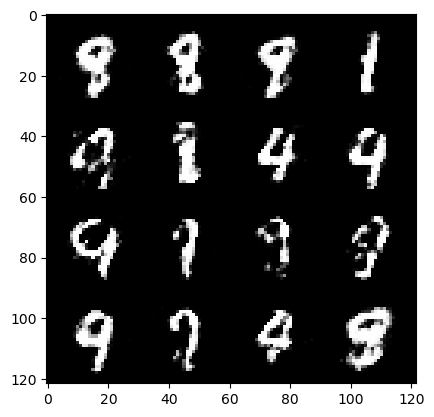

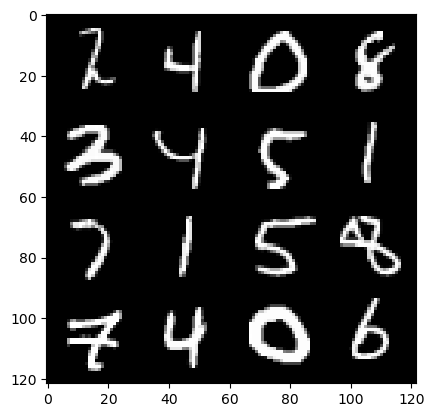

172: step 81000 / Gen loss: 1.5309191290537507 / disc_loss: 0.3892492060859996


  0%|          | 0/469 [00:00<?, ?it/s]

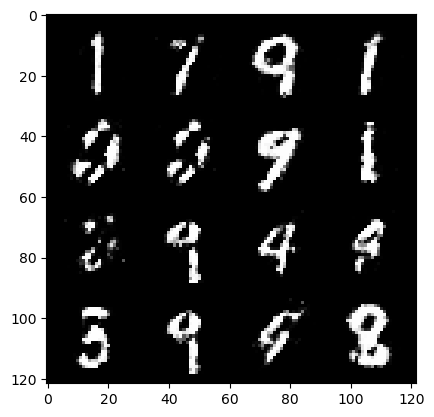

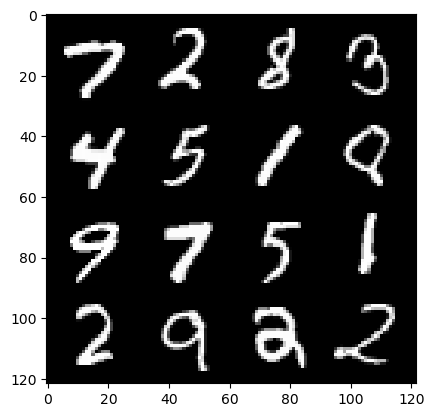

173: step 81300 / Gen loss: 1.5584632591406498 / disc_loss: 0.3725227102637293


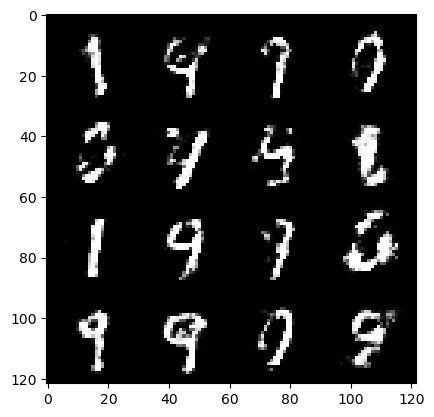

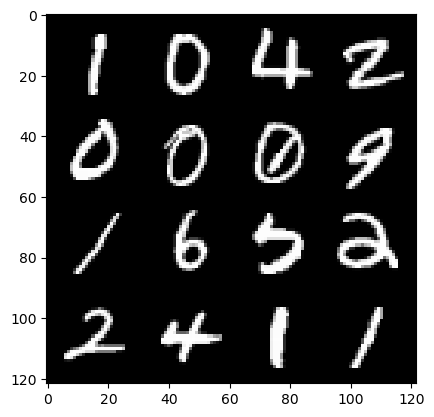

173: step 81600 / Gen loss: 1.5195186567306518 / disc_loss: 0.3884630685051284


  0%|          | 0/469 [00:00<?, ?it/s]

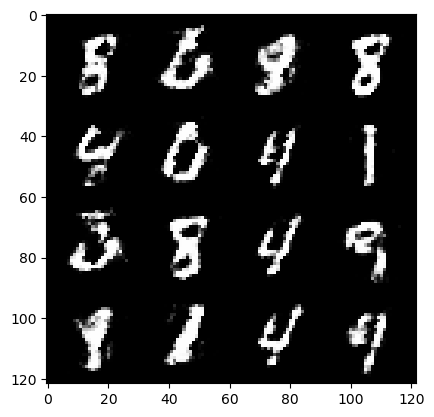

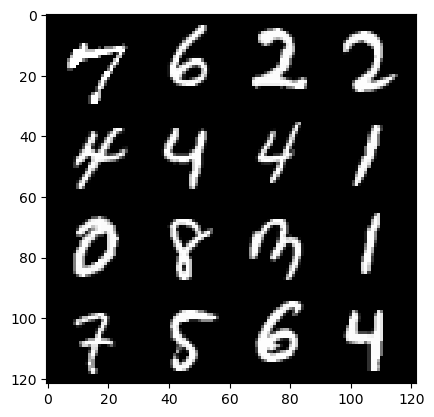

174: step 81900 / Gen loss: 1.5141629803180694 / disc_loss: 0.3912884382406868


  0%|          | 0/469 [00:00<?, ?it/s]

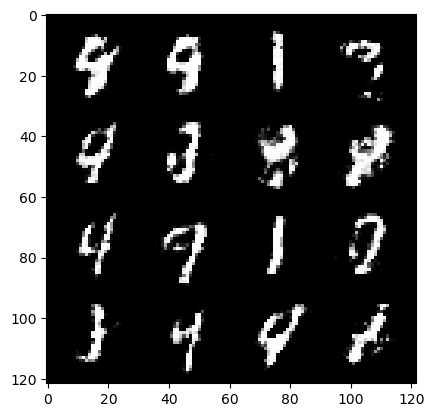

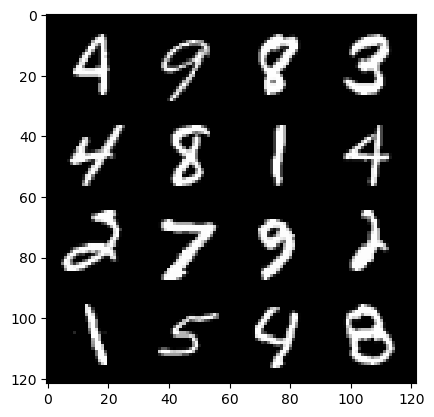

175: step 82200 / Gen loss: 1.4820655179023752 / disc_loss: 0.3984413767854374


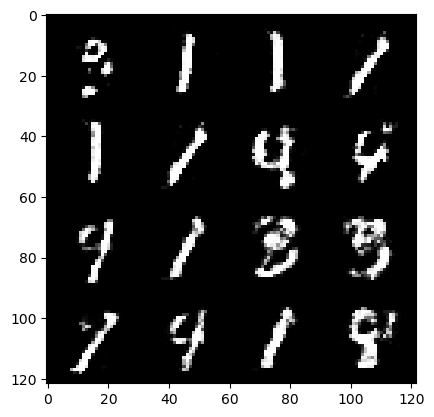

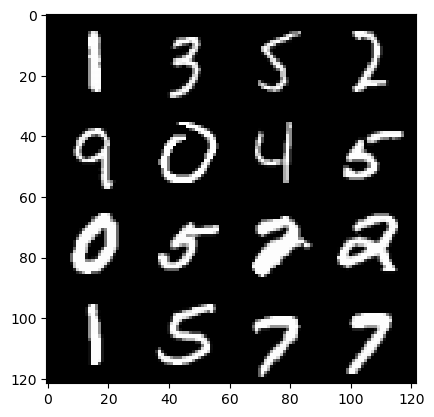

175: step 82500 / Gen loss: 1.480181705951691 / disc_loss: 0.40079648355642983


  0%|          | 0/469 [00:00<?, ?it/s]

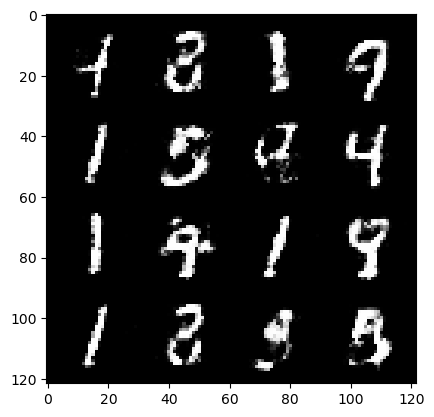

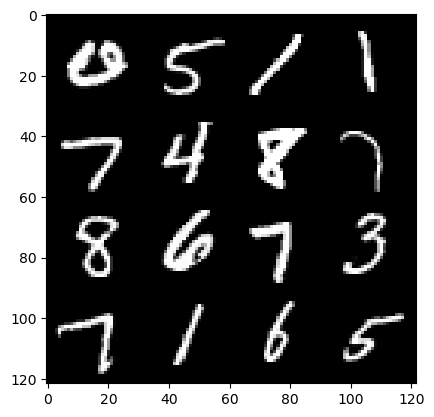

176: step 82800 / Gen loss: 1.4253226888179786 / disc_loss: 0.41252272496620834


  0%|          | 0/469 [00:00<?, ?it/s]

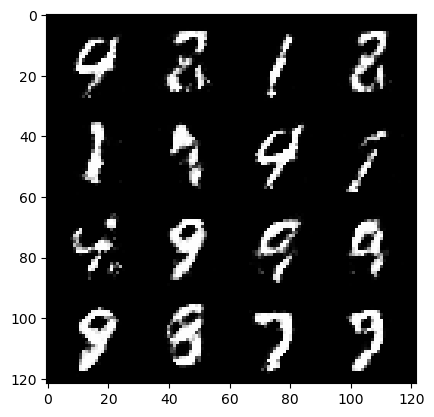

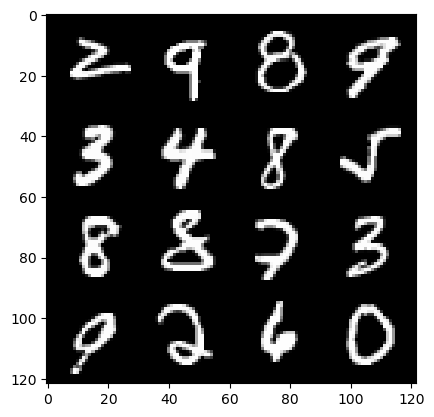

177: step 83100 / Gen loss: 1.4695154929161074 / disc_loss: 0.398073625365893


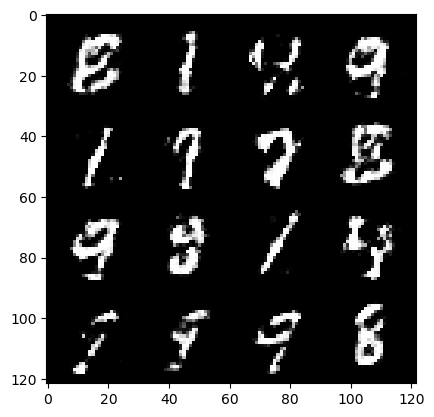

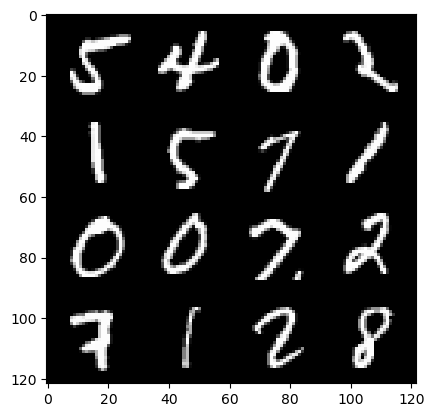

177: step 83400 / Gen loss: 1.4739761650562293 / disc_loss: 0.39859288692474387


  0%|          | 0/469 [00:00<?, ?it/s]

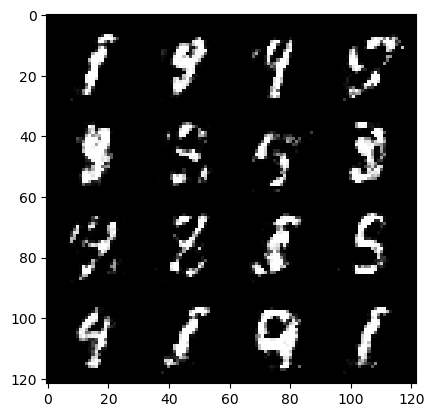

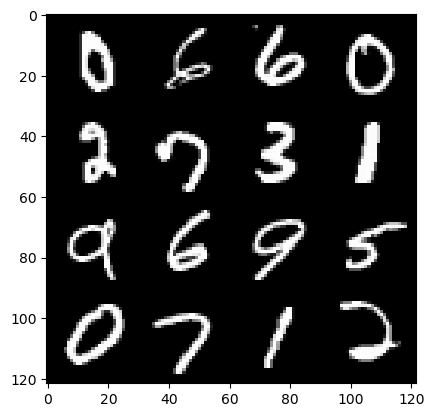

178: step 83700 / Gen loss: 1.4844241162141163 / disc_loss: 0.3943414247035982


  0%|          | 0/469 [00:00<?, ?it/s]

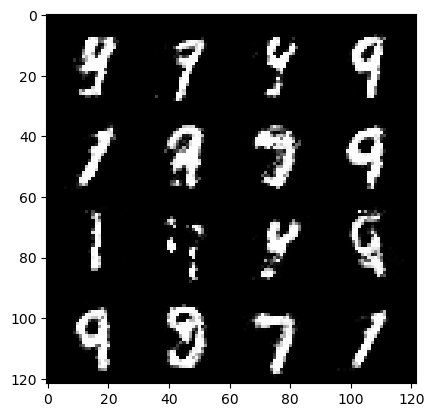

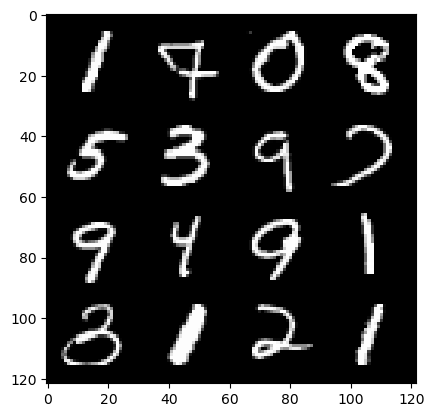

179: step 84000 / Gen loss: 1.5057583717505134 / disc_loss: 0.38618983397881157


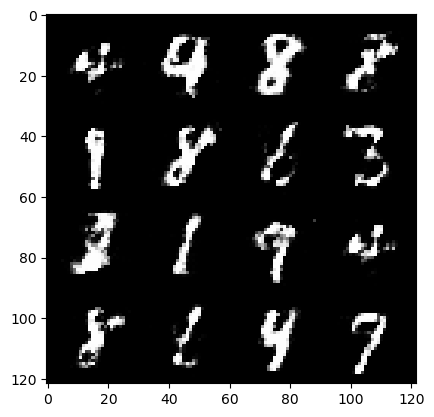

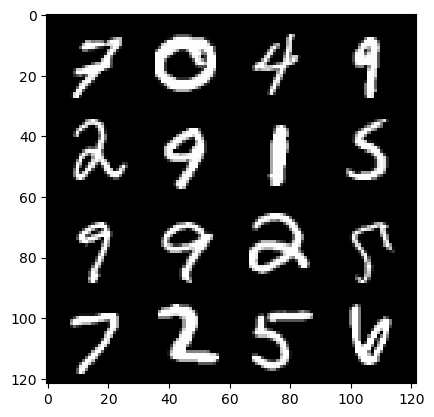

179: step 84300 / Gen loss: 1.4770565303166712 / disc_loss: 0.3954039975007376


  0%|          | 0/469 [00:00<?, ?it/s]

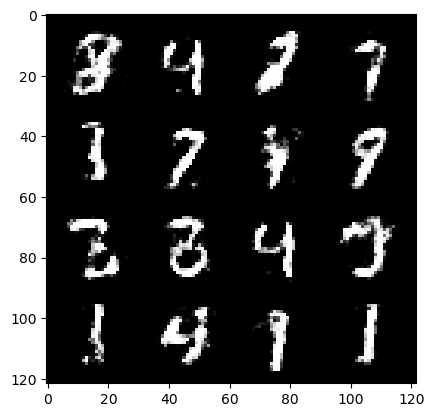

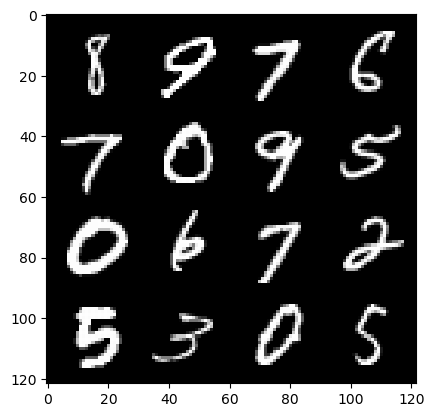

180: step 84600 / Gen loss: 1.512246572573981 / disc_loss: 0.38889946490526217


  0%|          | 0/469 [00:00<?, ?it/s]

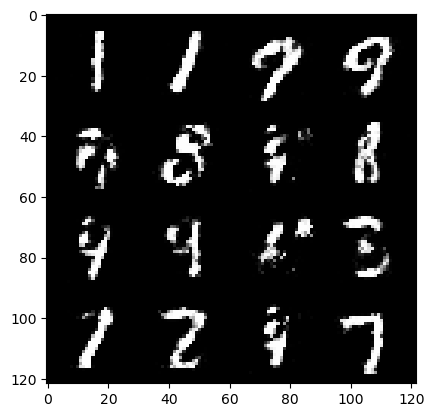

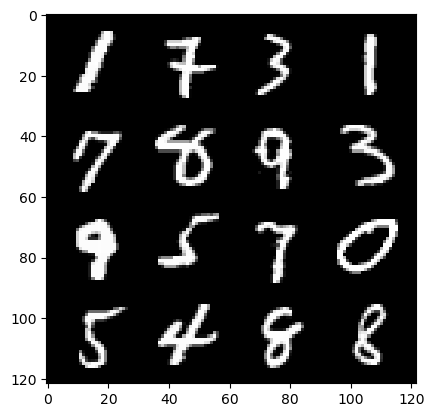

181: step 84900 / Gen loss: 1.5500967991352095 / disc_loss: 0.39131846527258557


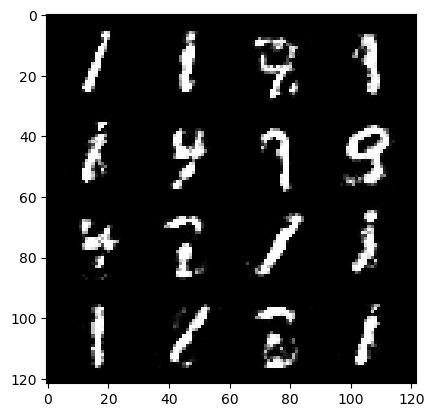

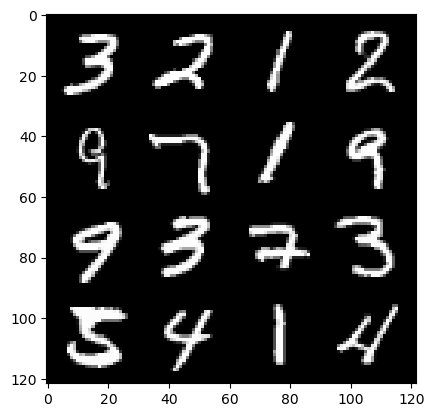

181: step 85200 / Gen loss: 1.4685378571351375 / disc_loss: 0.40783382882674535


  0%|          | 0/469 [00:00<?, ?it/s]

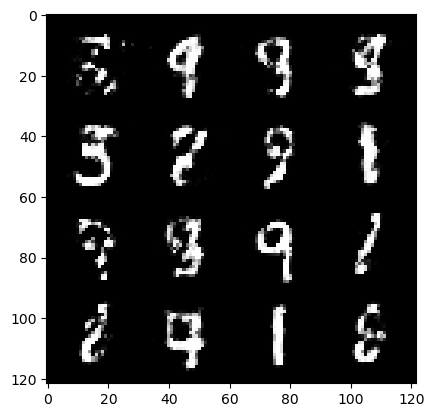

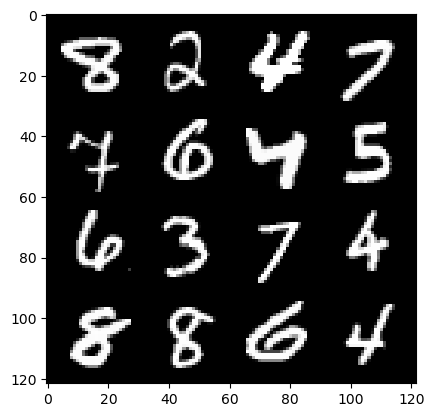

182: step 85500 / Gen loss: 1.4585542229811352 / disc_loss: 0.4133833071589469


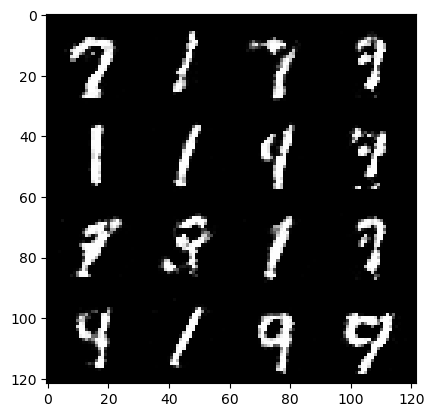

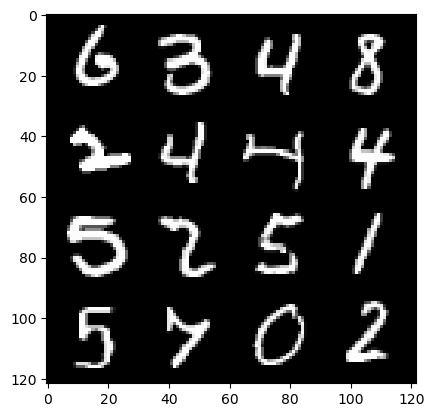

182: step 85800 / Gen loss: 1.4750129675865171 / disc_loss: 0.401980080008507


  0%|          | 0/469 [00:00<?, ?it/s]

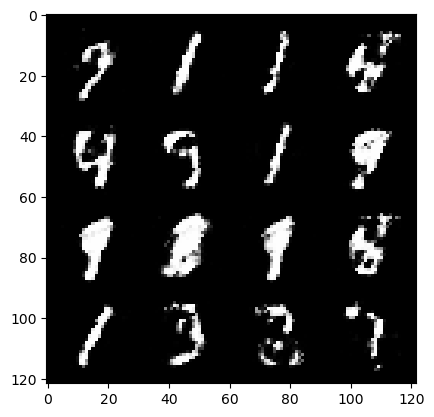

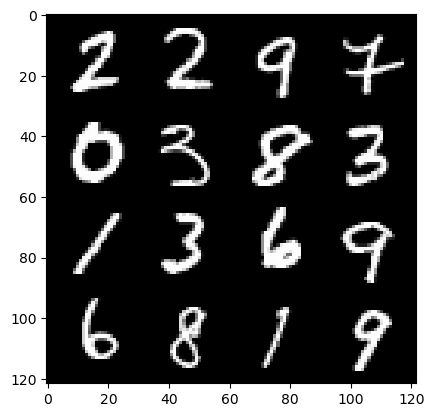

183: step 86100 / Gen loss: 1.4758960203329714 / disc_loss: 0.401876920163631


  0%|          | 0/469 [00:00<?, ?it/s]

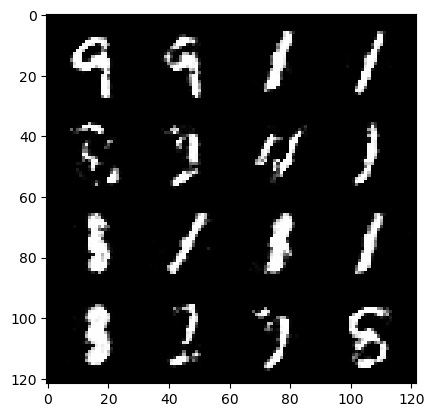

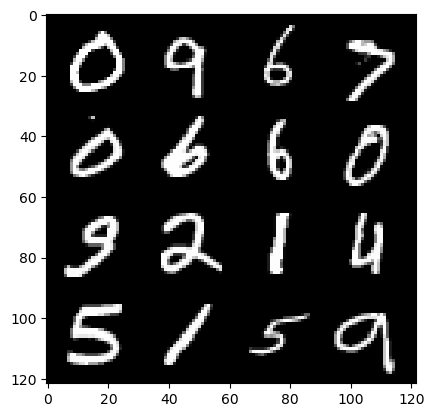

184: step 86400 / Gen loss: 1.3900462845961243 / disc_loss: 0.41634440153837227


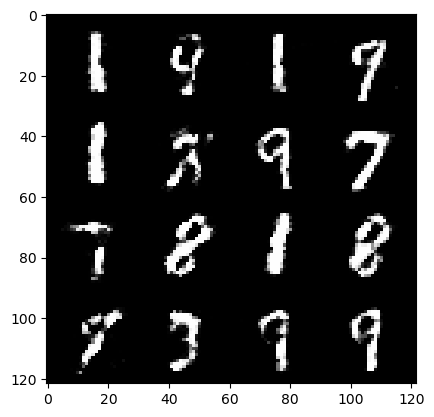

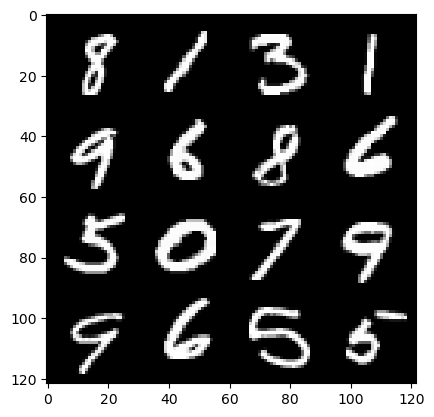

184: step 86700 / Gen loss: 1.4049482389291117 / disc_loss: 0.4117925431331003


  0%|          | 0/469 [00:00<?, ?it/s]

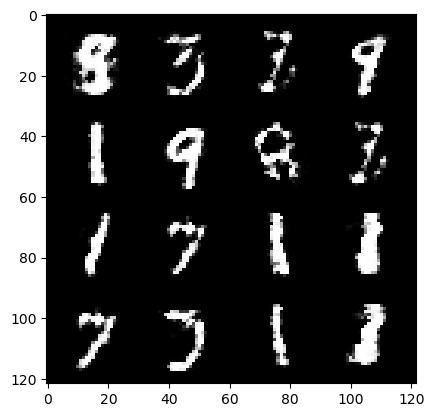

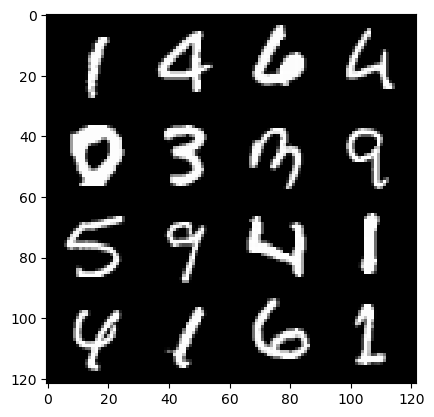

185: step 87000 / Gen loss: 1.4252042035261794 / disc_loss: 0.4146909393866856


  0%|          | 0/469 [00:00<?, ?it/s]

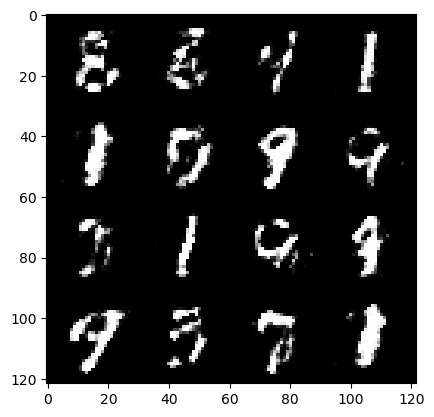

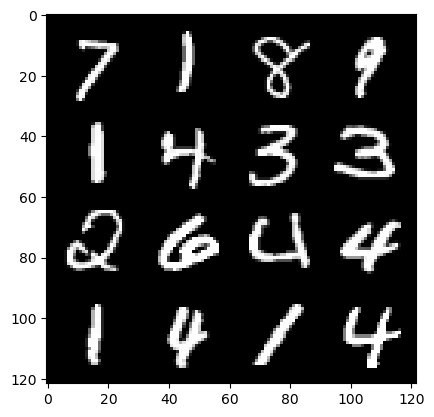

186: step 87300 / Gen loss: 1.4608878354231518 / disc_loss: 0.40221497426430386


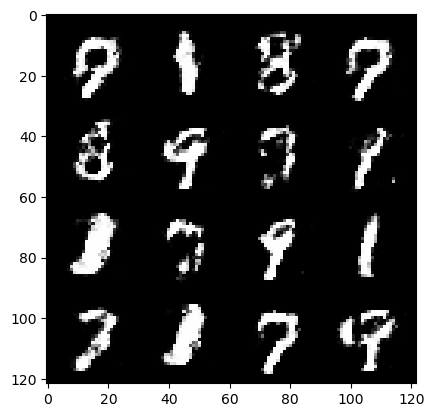

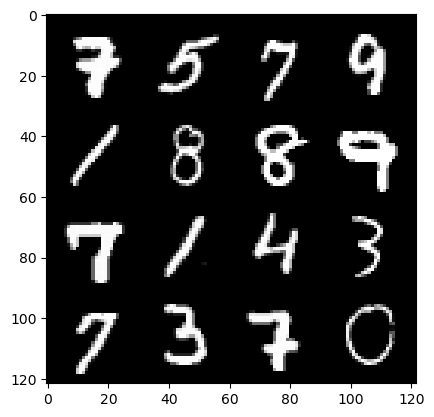

186: step 87600 / Gen loss: 1.4004063117504117 / disc_loss: 0.41497815052668274


  0%|          | 0/469 [00:00<?, ?it/s]

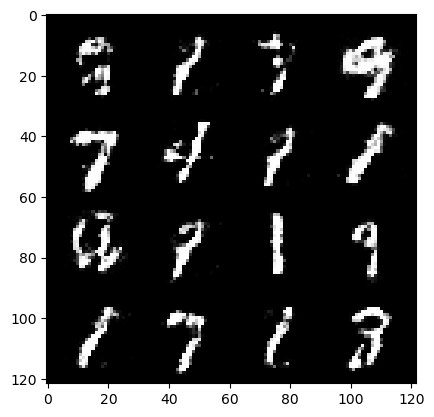

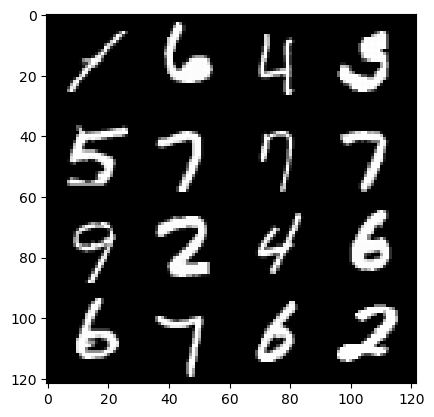

187: step 87900 / Gen loss: 1.4931192457675926 / disc_loss: 0.3926753875613212


  0%|          | 0/469 [00:00<?, ?it/s]

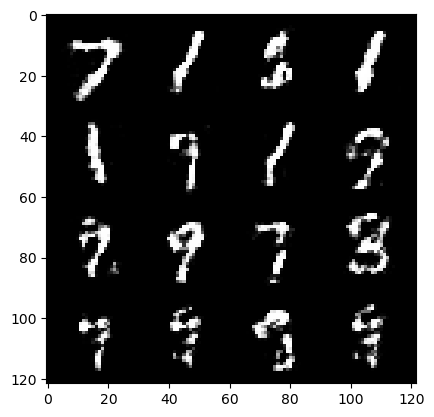

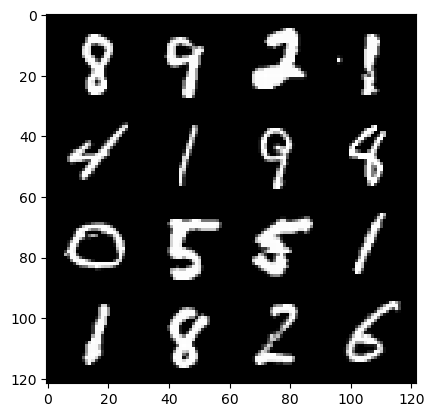

188: step 88200 / Gen loss: 1.4715502218405407 / disc_loss: 0.3967497357726099


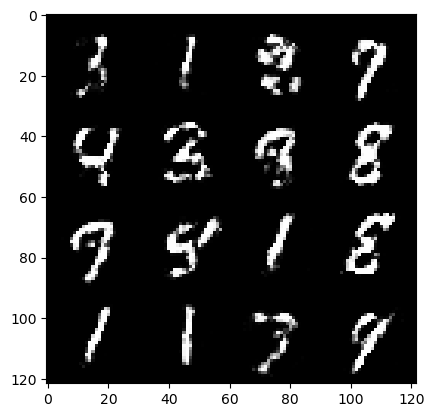

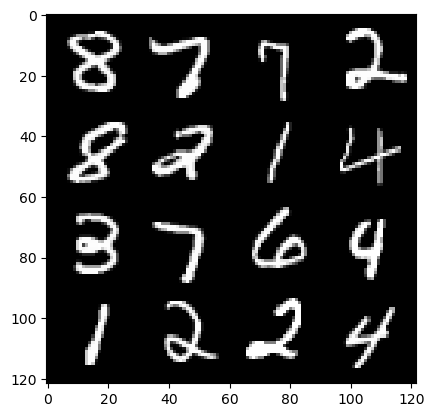

188: step 88500 / Gen loss: 1.4461358205477406 / disc_loss: 0.40274026344219815


  0%|          | 0/469 [00:00<?, ?it/s]

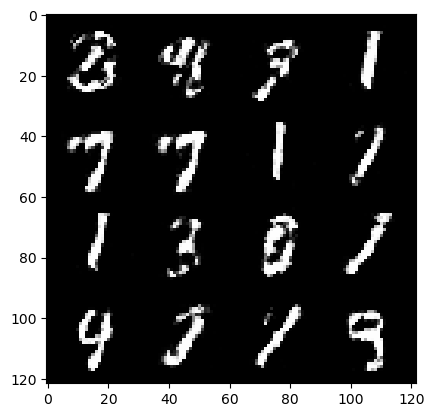

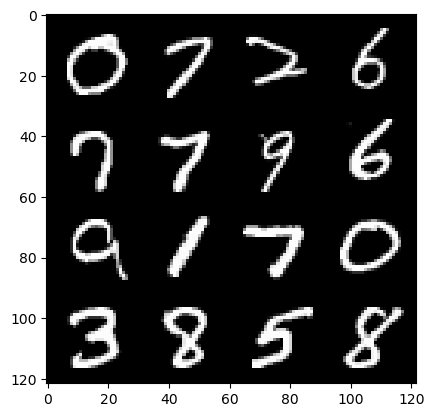

189: step 88800 / Gen loss: 1.4283231584231058 / disc_loss: 0.4110329026977223


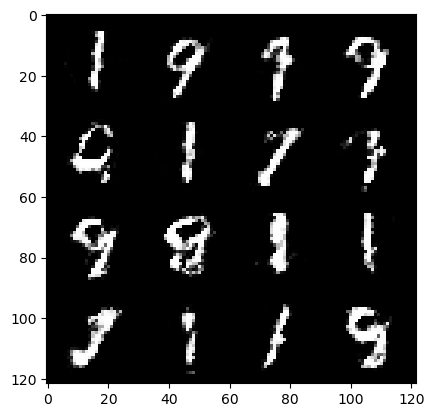

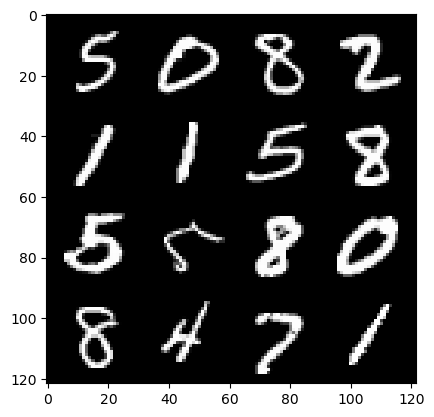

189: step 89100 / Gen loss: 1.4270855029424023 / disc_loss: 0.4154219803214072


  0%|          | 0/469 [00:00<?, ?it/s]

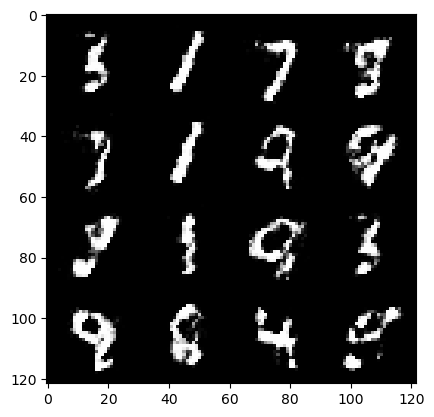

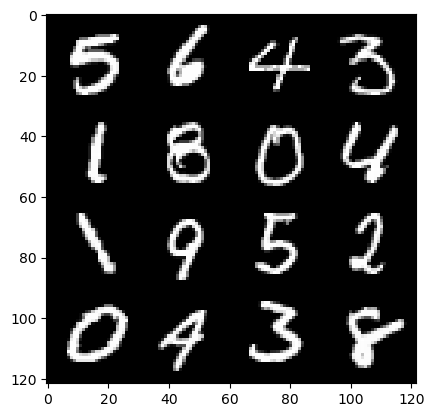

190: step 89400 / Gen loss: 1.4804384986559553 / disc_loss: 0.39903462777535104


  0%|          | 0/469 [00:00<?, ?it/s]

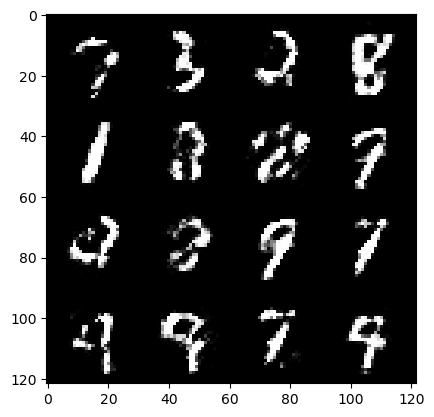

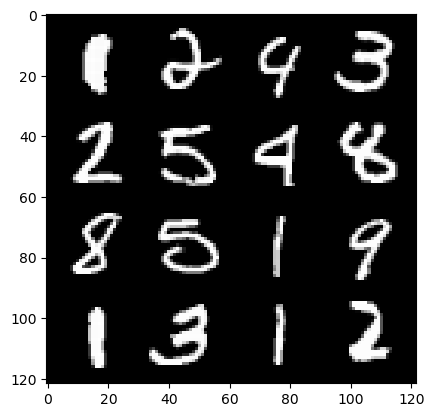

191: step 89700 / Gen loss: 1.4461773347854614 / disc_loss: 0.40667882919311493


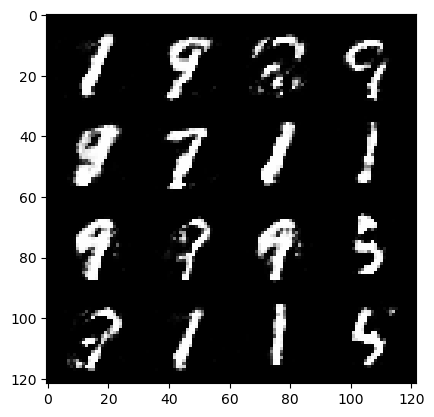

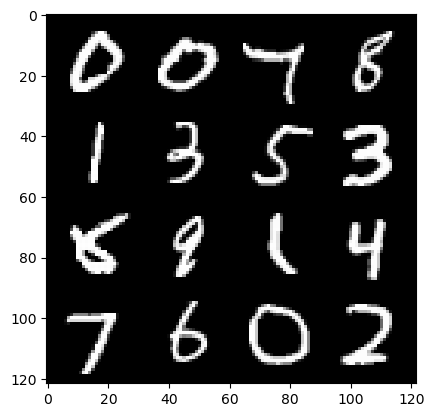

191: step 90000 / Gen loss: 1.4409391701221455 / disc_loss: 0.4074429284532868


  0%|          | 0/469 [00:00<?, ?it/s]

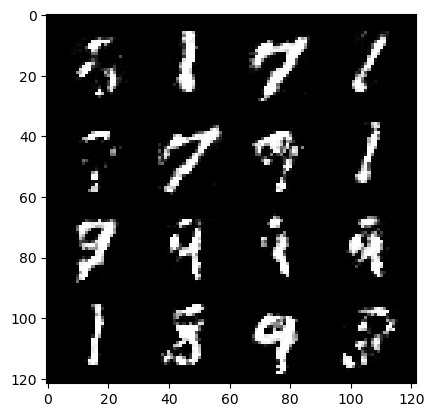

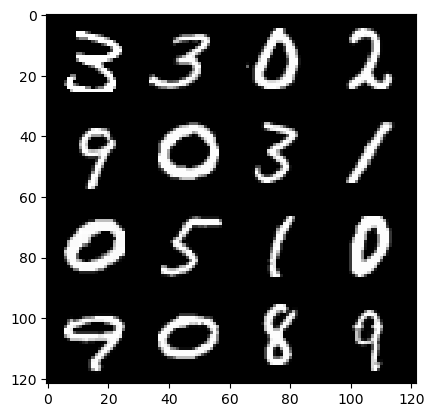

192: step 90300 / Gen loss: 1.4660876814524333 / disc_loss: 0.40003105610609024


  0%|          | 0/469 [00:00<?, ?it/s]

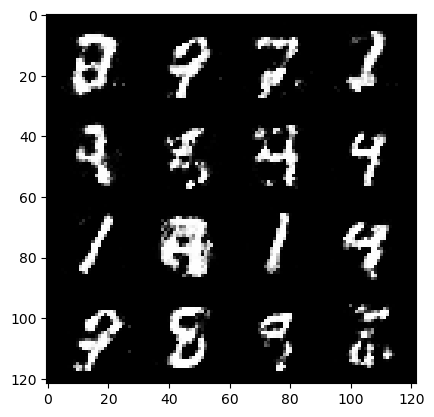

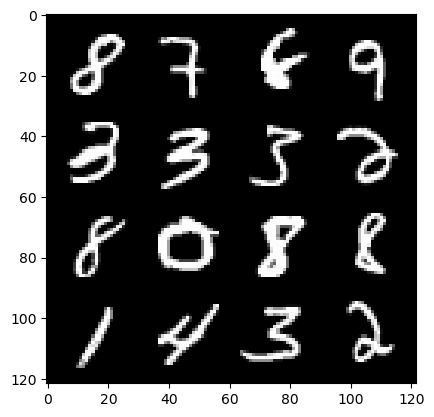

193: step 90600 / Gen loss: 1.407515859206517 / disc_loss: 0.4038489096363386


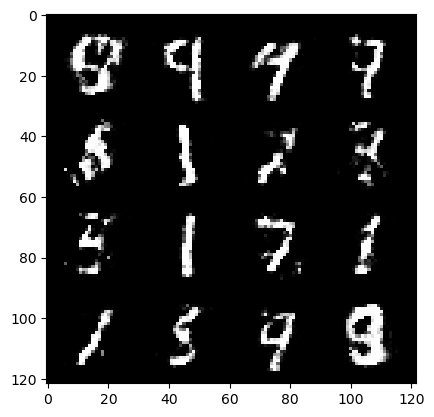

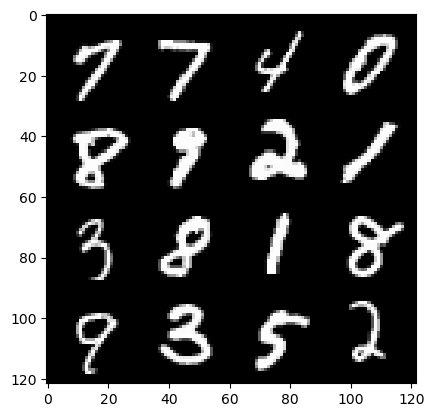

193: step 90900 / Gen loss: 1.380229943990708 / disc_loss: 0.4189988110462826


  0%|          | 0/469 [00:00<?, ?it/s]

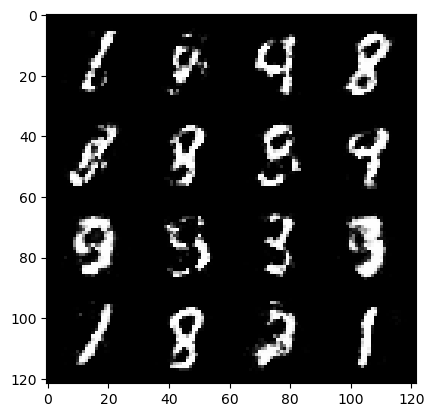

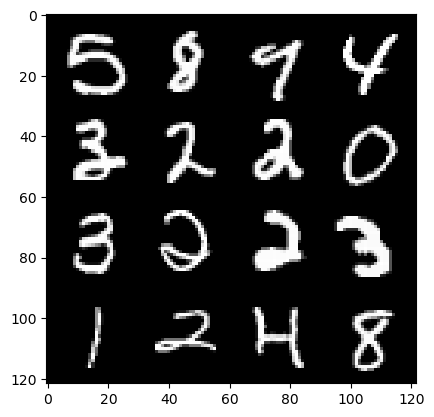

194: step 91200 / Gen loss: 1.5017212017377228 / disc_loss: 0.3884613057971002


  0%|          | 0/469 [00:00<?, ?it/s]

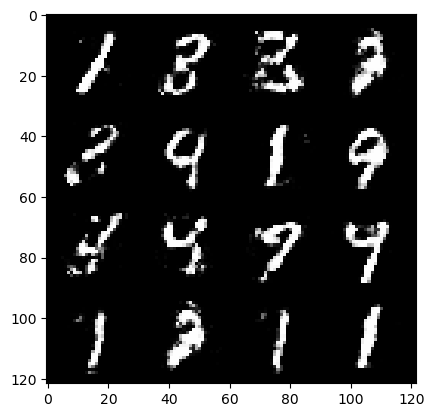

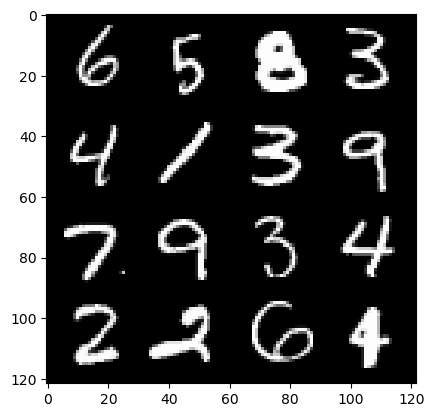

195: step 91500 / Gen loss: 1.4001543696721397 / disc_loss: 0.4233296223481496


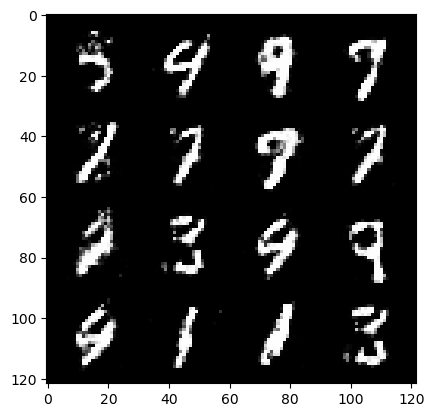

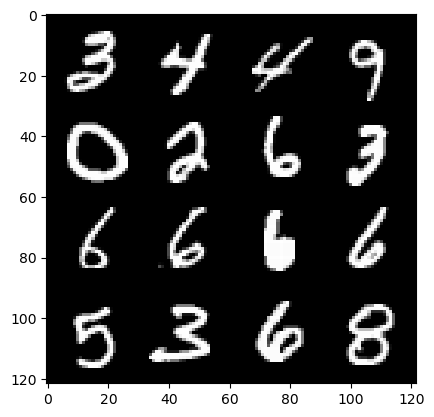

195: step 91800 / Gen loss: 1.4755586600303656 / disc_loss: 0.39461062024037036


  0%|          | 0/469 [00:00<?, ?it/s]

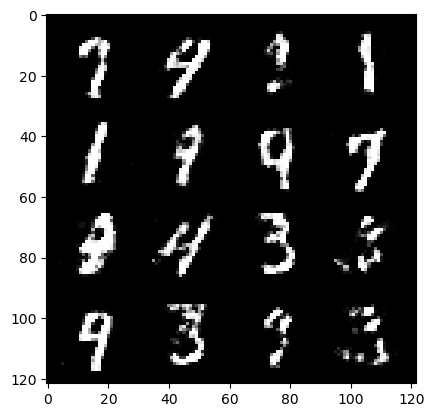

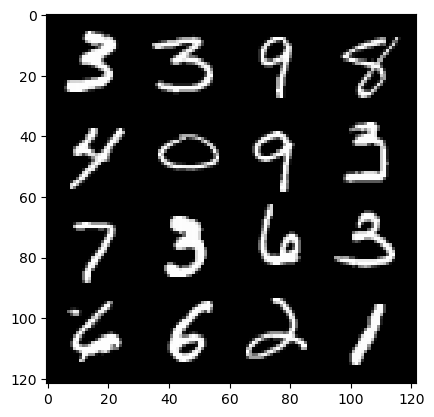

196: step 92100 / Gen loss: 1.4879805839061735 / disc_loss: 0.39226299117008834


  0%|          | 0/469 [00:00<?, ?it/s]

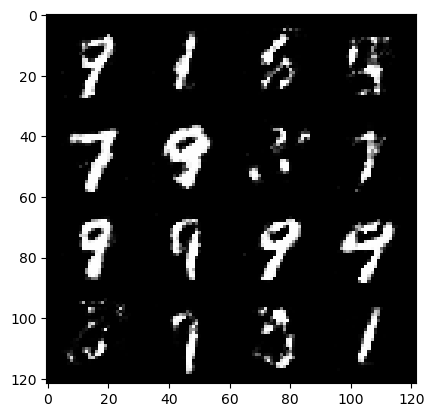

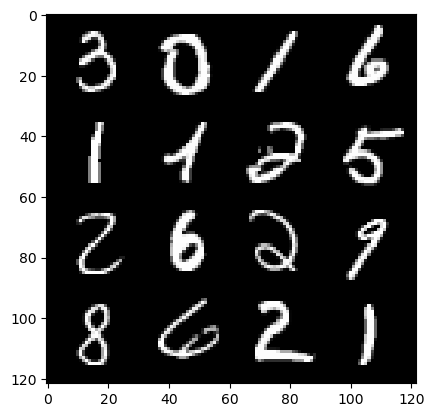

197: step 92400 / Gen loss: 1.3938408366839092 / disc_loss: 0.4231837058067321


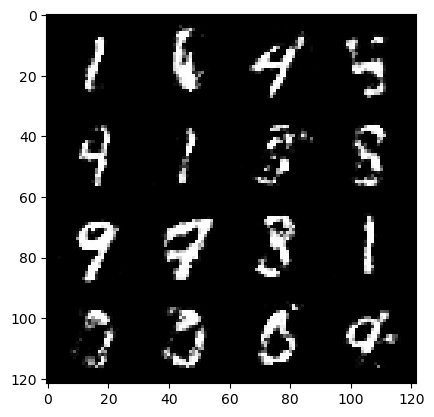

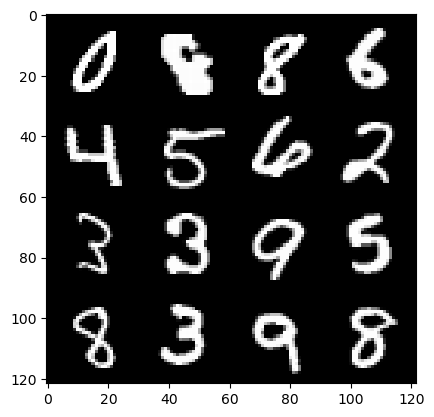

197: step 92700 / Gen loss: 1.3439904689788824 / disc_loss: 0.42521155466636046


  0%|          | 0/469 [00:00<?, ?it/s]

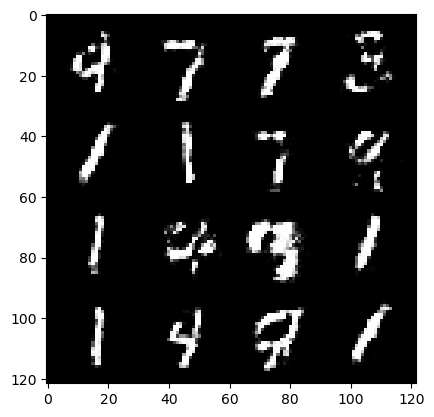

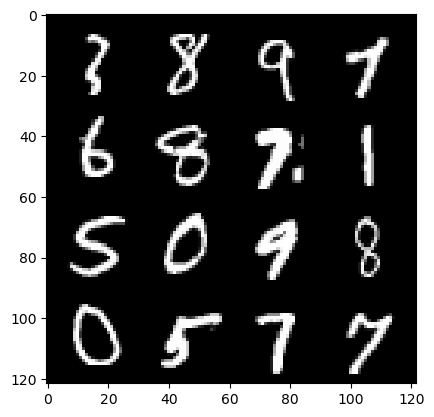

198: step 93000 / Gen loss: 1.3461707802613587 / disc_loss: 0.43640635699033725


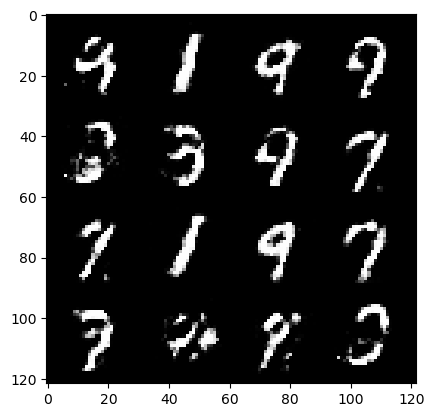

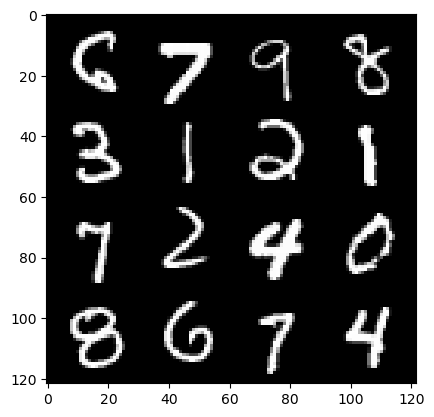

198: step 93300 / Gen loss: 1.3006228295962012 / disc_loss: 0.449089279373487


  0%|          | 0/469 [00:00<?, ?it/s]

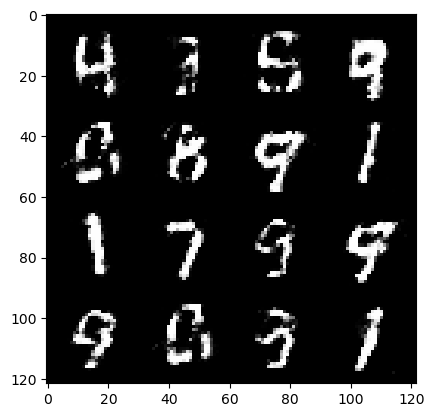

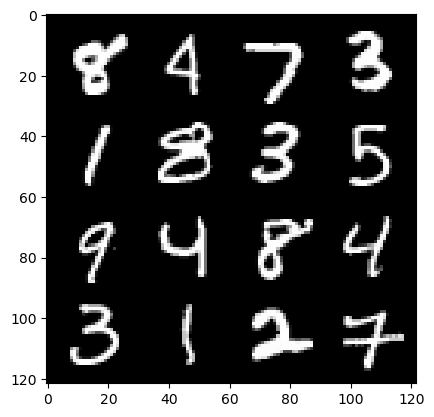

199: step 93600 / Gen loss: 1.3582780992984773 / disc_loss: 0.4374545046687126


  0%|          | 0/469 [00:00<?, ?it/s]

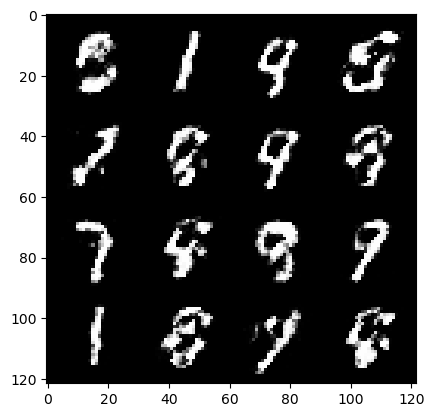

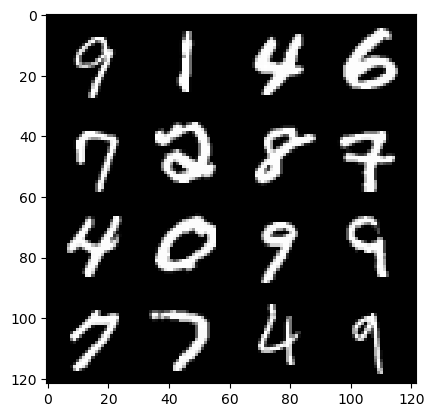

200: step 93900 / Gen loss: 1.386715168952942 / disc_loss: 0.43058608919382146


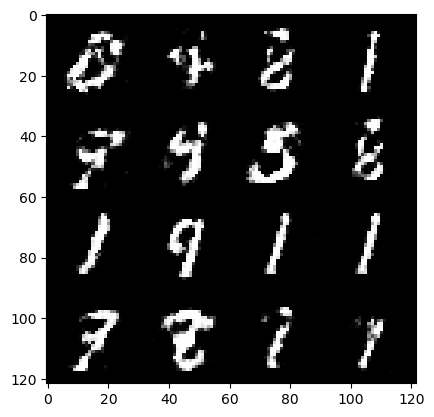

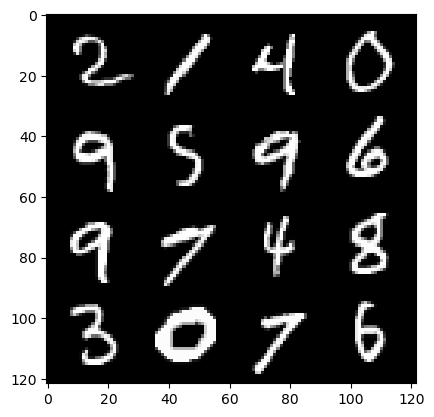

200: step 94200 / Gen loss: 1.2932628512382496 / disc_loss: 0.44456638435522744


  0%|          | 0/469 [00:00<?, ?it/s]

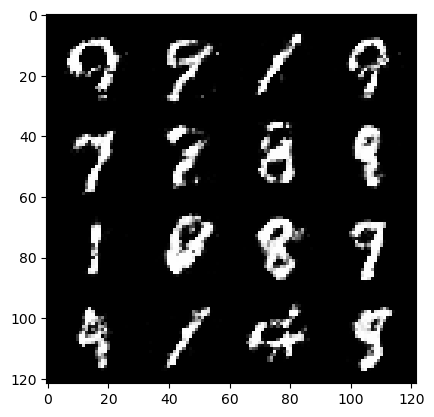

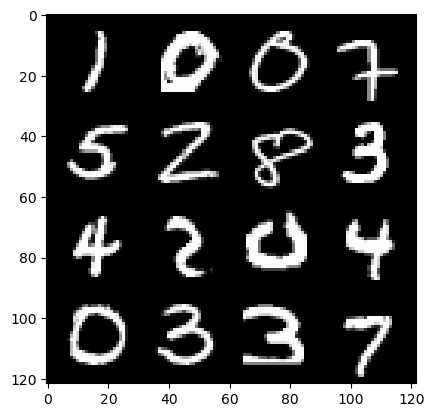

201: step 94500 / Gen loss: 1.3854282212257394 / disc_loss: 0.42480202386776594


  0%|          | 0/469 [00:00<?, ?it/s]

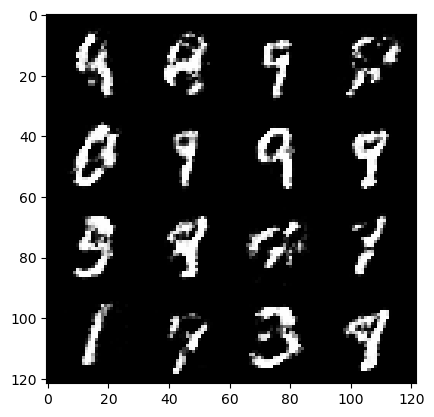

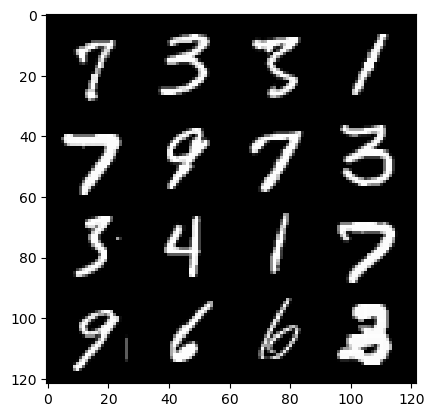

202: step 94800 / Gen loss: 1.3767260881265002 / disc_loss: 0.4229771015048024


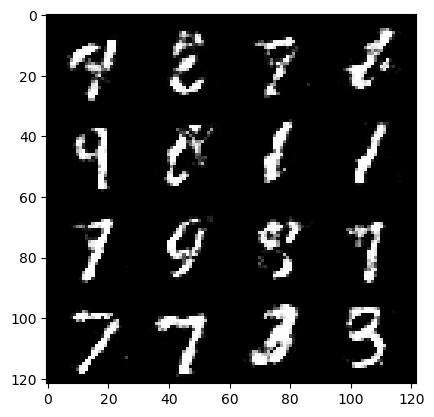

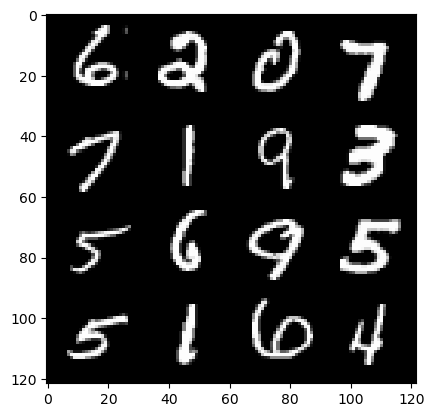

202: step 95100 / Gen loss: 1.3025112243493393 / disc_loss: 0.44796776960293494


  0%|          | 0/469 [00:00<?, ?it/s]

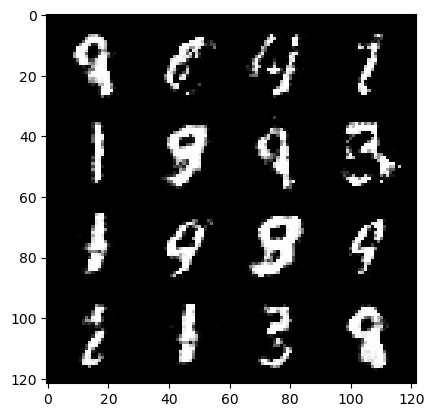

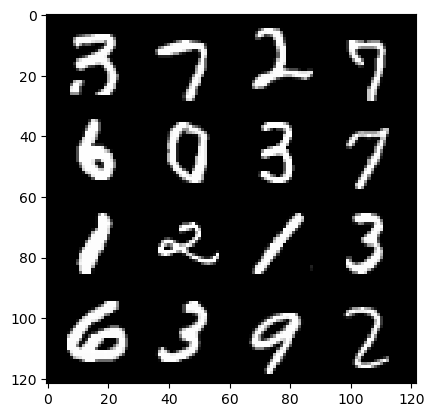

203: step 95400 / Gen loss: 1.276879748900731 / disc_loss: 0.4582420438528061


  0%|          | 0/469 [00:00<?, ?it/s]

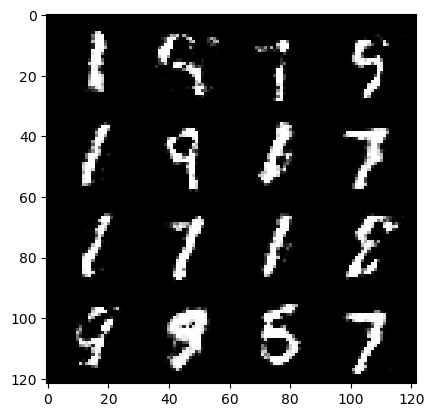

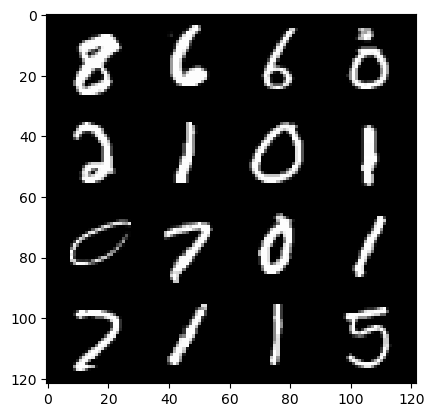

204: step 95700 / Gen loss: 1.3528488719463347 / disc_loss: 0.4306681188941002


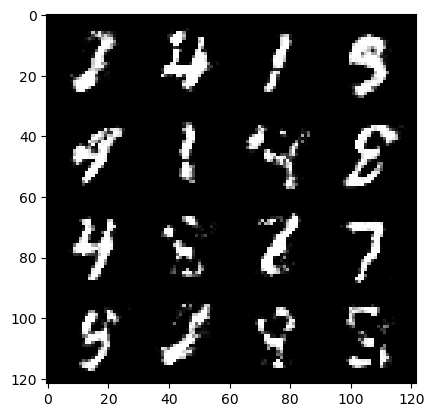

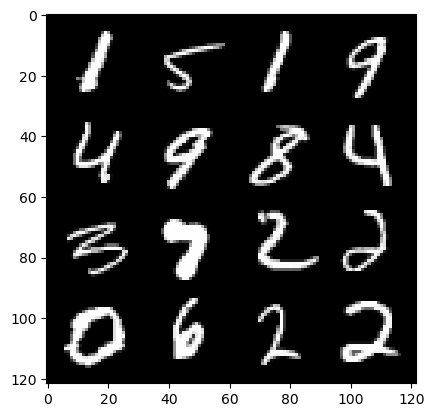

204: step 96000 / Gen loss: 1.334722938934962 / disc_loss: 0.4369966028134028


  0%|          | 0/469 [00:00<?, ?it/s]

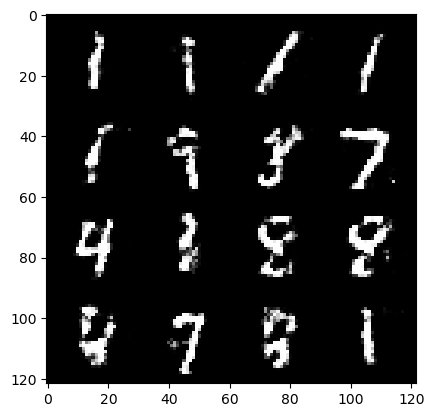

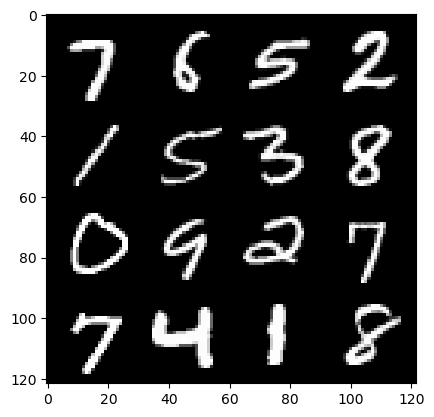

205: step 96300 / Gen loss: 1.3220620306332909 / disc_loss: 0.4318938437104226


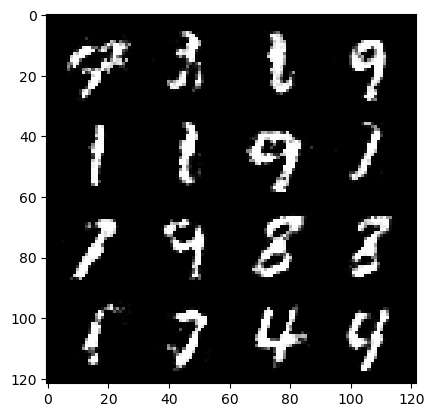

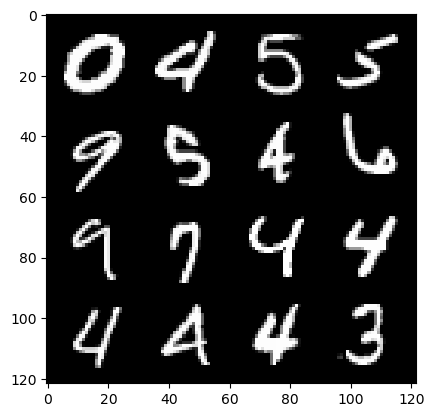

205: step 96600 / Gen loss: 1.4079039128621418 / disc_loss: 0.4105851311484972


  0%|          | 0/469 [00:00<?, ?it/s]

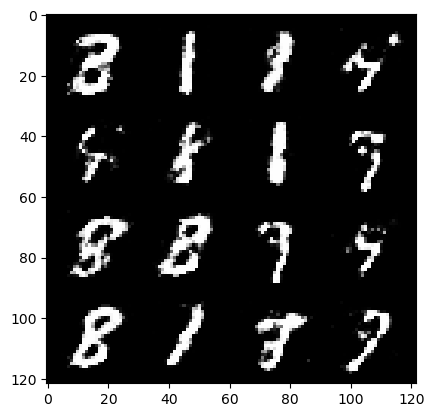

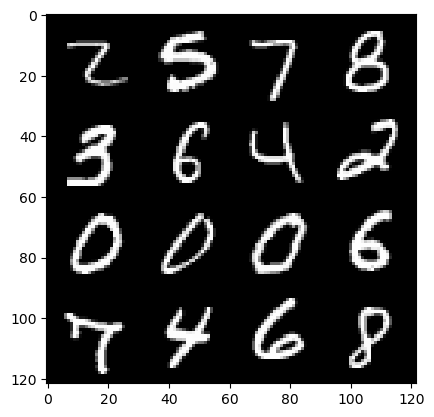

206: step 96900 / Gen loss: 1.4675868841012312 / disc_loss: 0.4073937510450681


  0%|          | 0/469 [00:00<?, ?it/s]

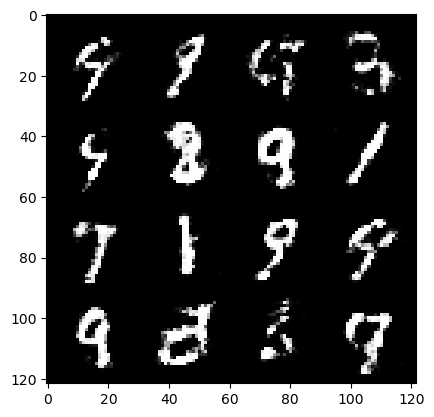

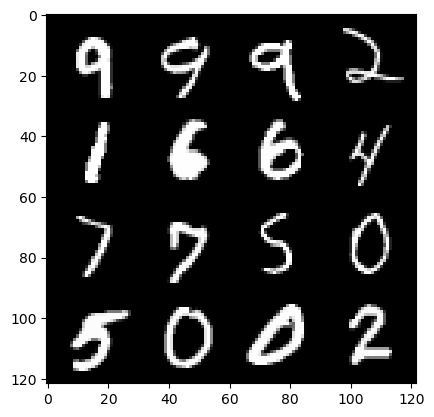

207: step 97200 / Gen loss: 1.32224451382955 / disc_loss: 0.45031250605980566


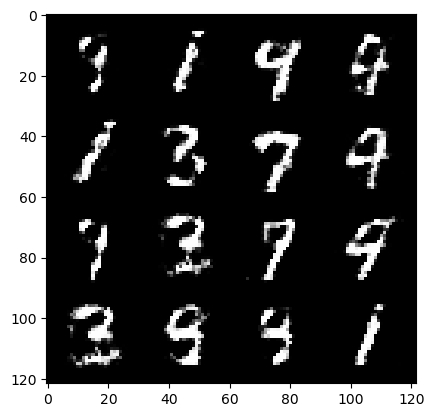

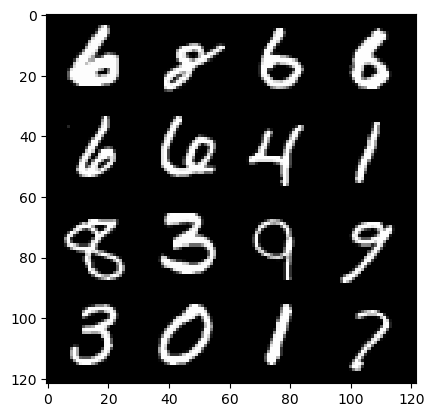

207: step 97500 / Gen loss: 1.3209753469626102 / disc_loss: 0.43523223380247744


  0%|          | 0/469 [00:00<?, ?it/s]

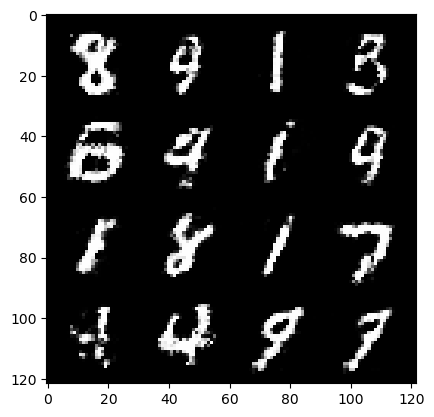

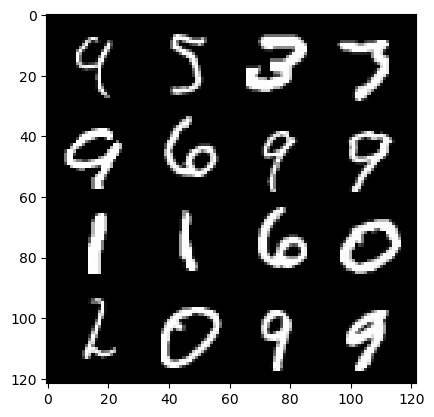

208: step 97800 / Gen loss: 1.321709848642349 / disc_loss: 0.43683082630236936


  0%|          | 0/469 [00:00<?, ?it/s]

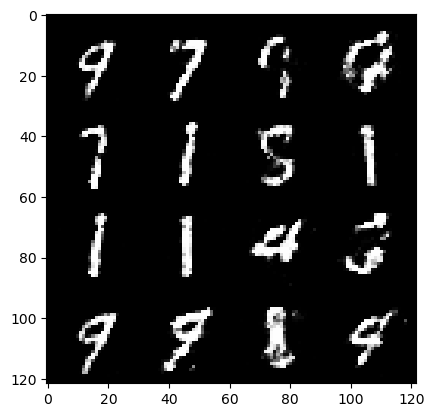

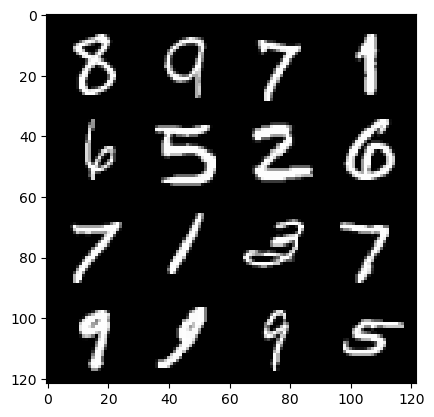

209: step 98100 / Gen loss: 1.3022949222723648 / disc_loss: 0.44397129038969696


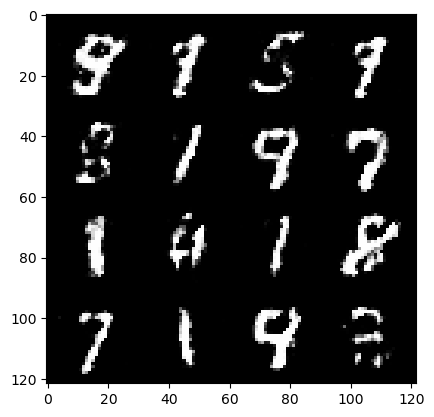

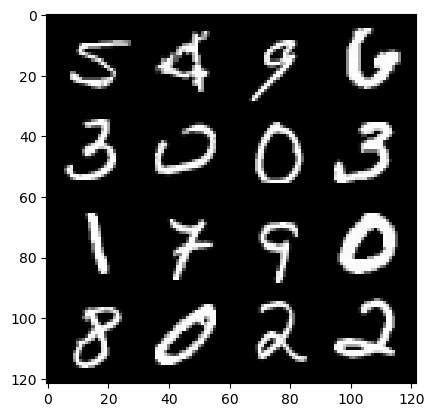

209: step 98400 / Gen loss: 1.2989310272534695 / disc_loss: 0.43563895434141153


  0%|          | 0/469 [00:00<?, ?it/s]

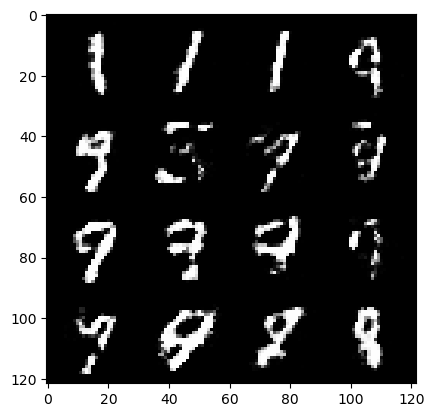

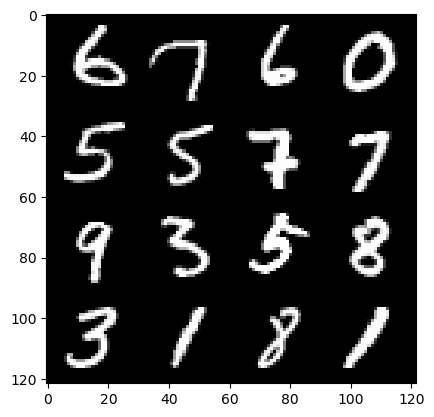

210: step 98700 / Gen loss: 1.340703427791595 / disc_loss: 0.4196024892727534


  0%|          | 0/469 [00:00<?, ?it/s]

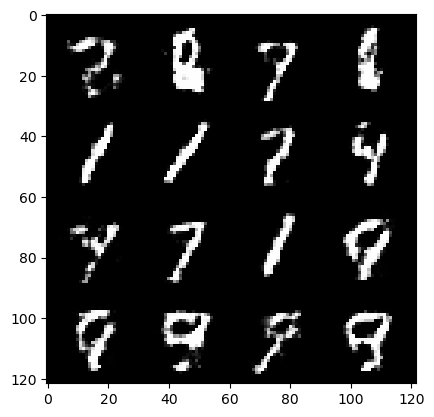

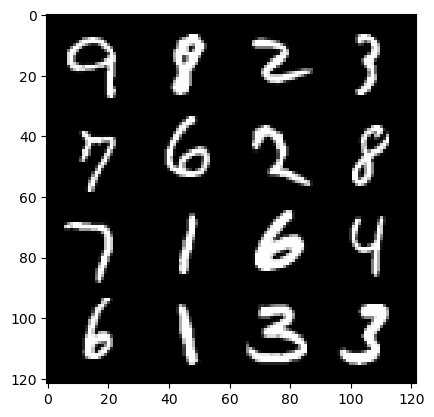

211: step 99000 / Gen loss: 1.3212802338600158 / disc_loss: 0.4298853686451914


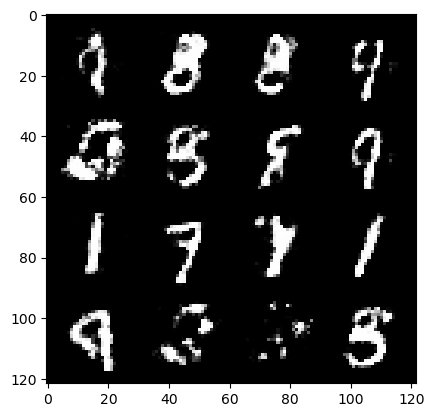

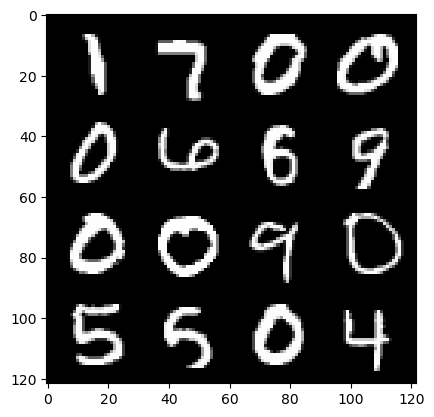

211: step 99300 / Gen loss: 1.2500959503650668 / disc_loss: 0.4562257103125257


  0%|          | 0/469 [00:00<?, ?it/s]

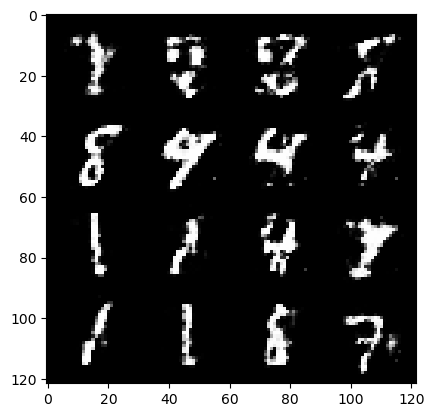

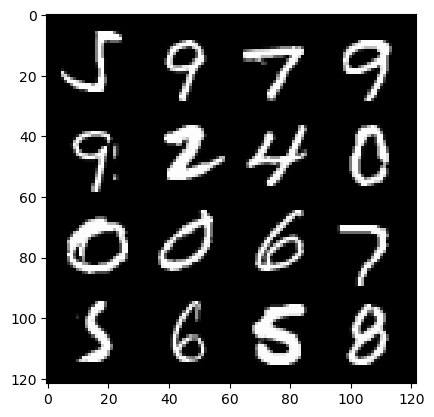

212: step 99600 / Gen loss: 1.2678714791933692 / disc_loss: 0.4459743623932205


  0%|          | 0/469 [00:00<?, ?it/s]

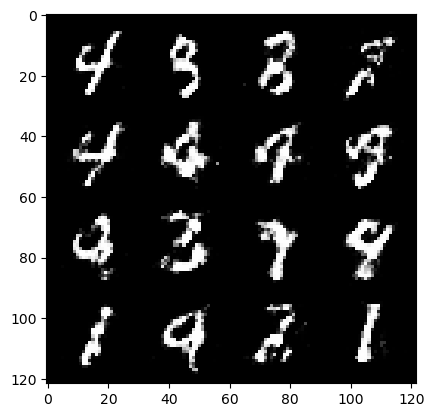

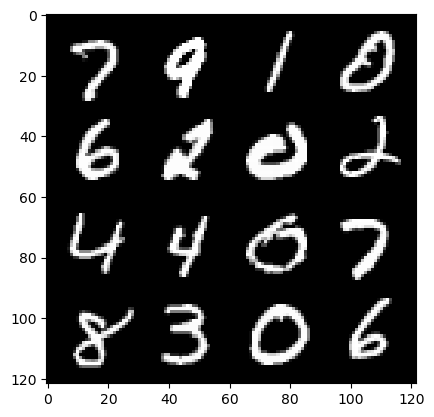

213: step 99900 / Gen loss: 1.326634238958359 / disc_loss: 0.43521450469891215


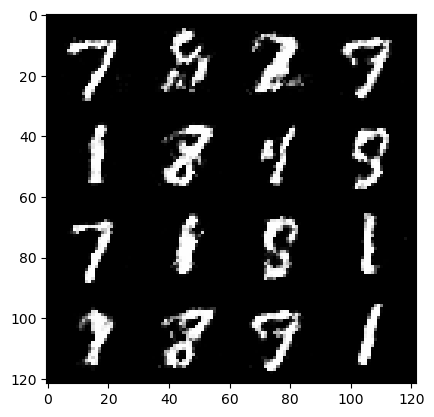

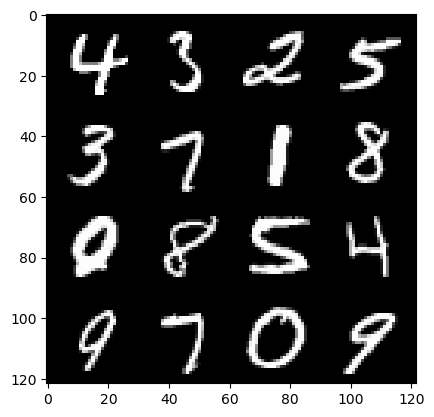

213: step 100200 / Gen loss: 1.3072887349128728 / disc_loss: 0.4594482543071112


  0%|          | 0/469 [00:00<?, ?it/s]

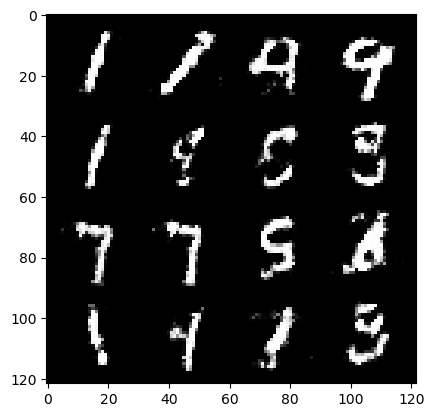

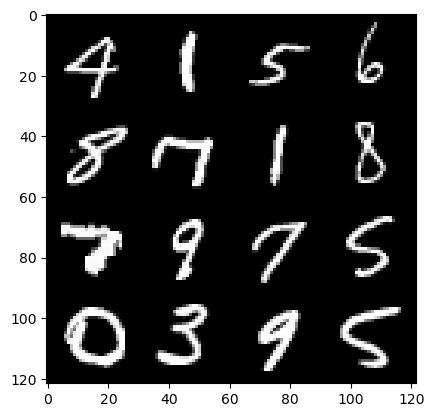

214: step 100500 / Gen loss: 1.2336579970518737 / disc_loss: 0.4707230420907334


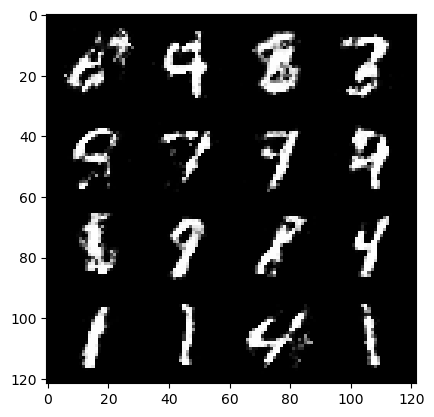

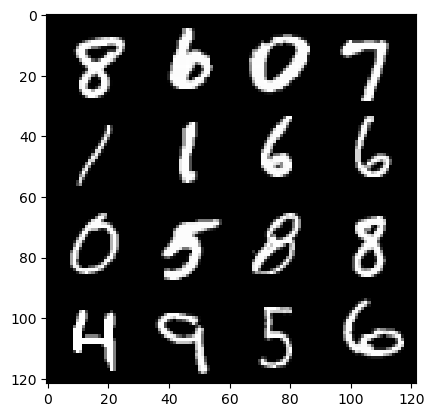

214: step 100800 / Gen loss: 1.2904849755763996 / disc_loss: 0.45009813825289435


  0%|          | 0/469 [00:00<?, ?it/s]

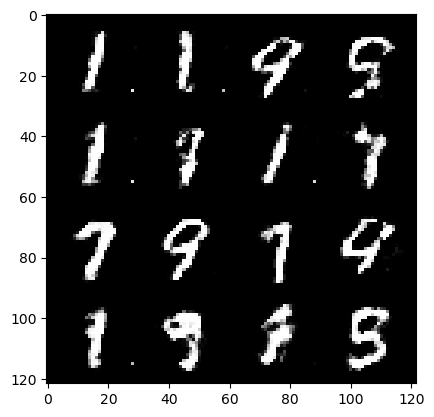

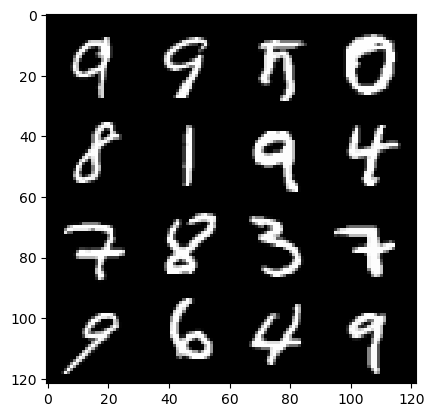

215: step 101100 / Gen loss: 1.337471766074499 / disc_loss: 0.4460279624660809


  0%|          | 0/469 [00:00<?, ?it/s]

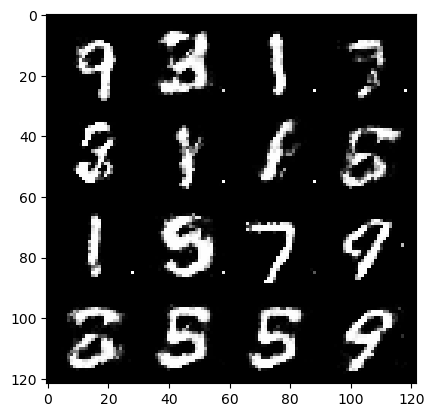

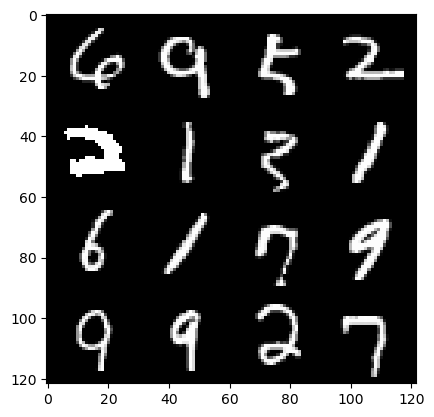

216: step 101400 / Gen loss: 0.9218667004505795 / disc_loss: 0.6620910515387856


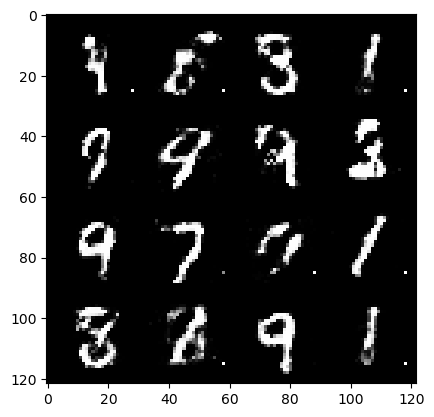

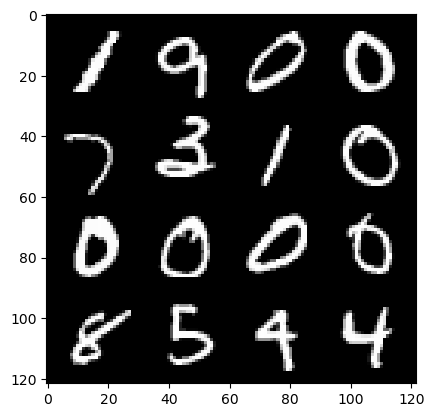

216: step 101700 / Gen loss: 0.8345220770438507 / disc_loss: 0.6132025380929309


  0%|          | 0/469 [00:00<?, ?it/s]

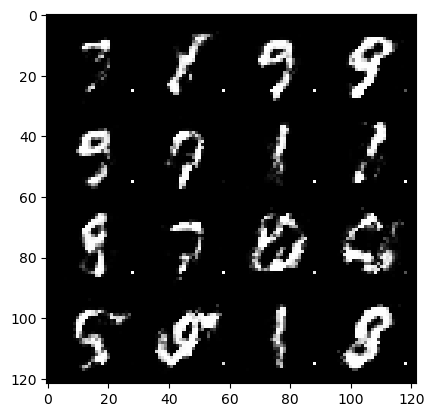

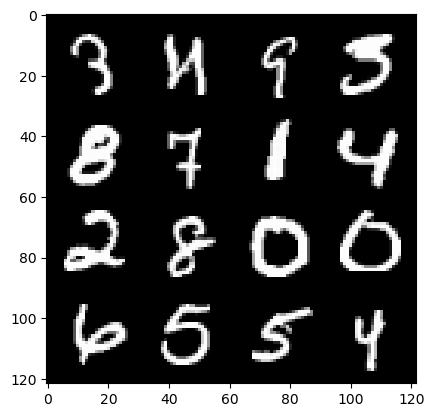

217: step 102000 / Gen loss: 0.9168674184878669 / disc_loss: 0.5346821446220078


  0%|          | 0/469 [00:00<?, ?it/s]

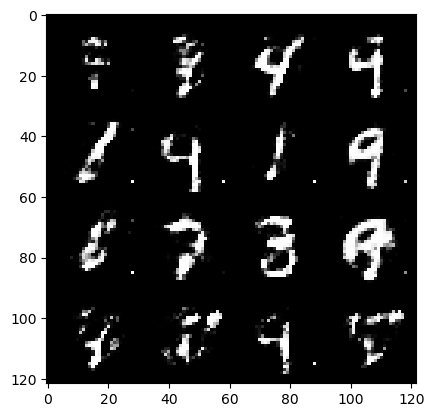

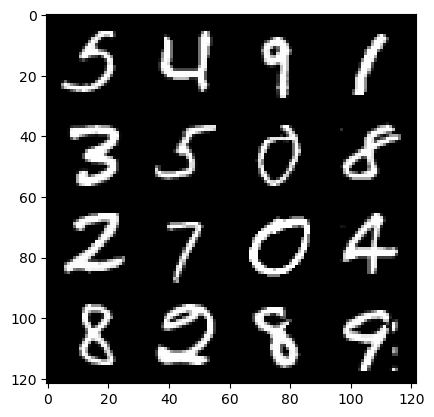

218: step 102300 / Gen loss: 1.0632053641478216 / disc_loss: 0.4751033748189606


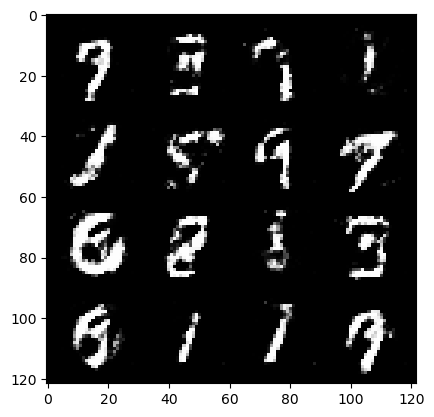

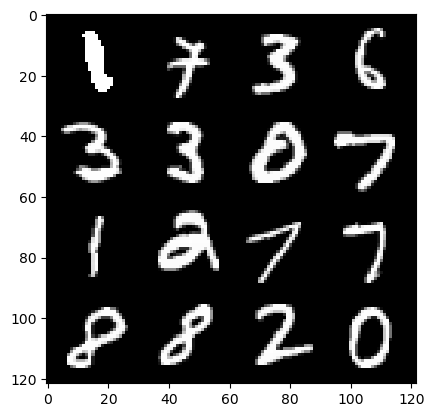

218: step 102600 / Gen loss: 1.2165637711683899 / disc_loss: 0.4608592637379961


  0%|          | 0/469 [00:00<?, ?it/s]

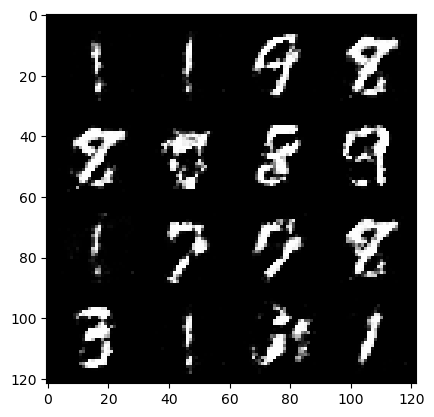

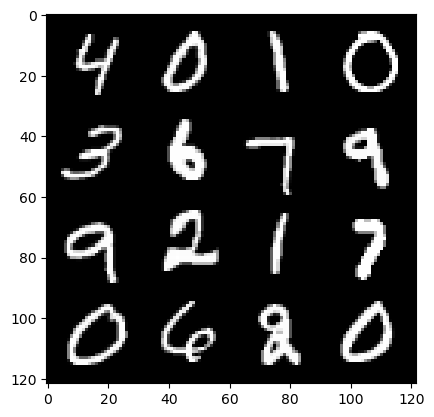

219: step 102900 / Gen loss: 1.3074957728385934 / disc_loss: 0.4283438868323962


  0%|          | 0/469 [00:00<?, ?it/s]

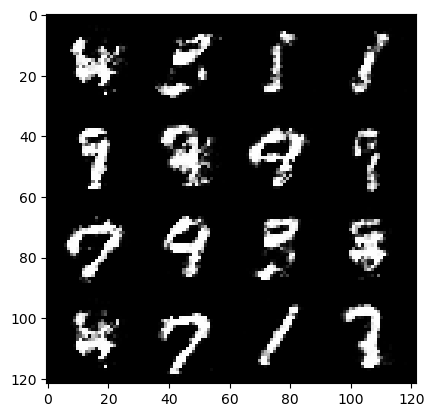

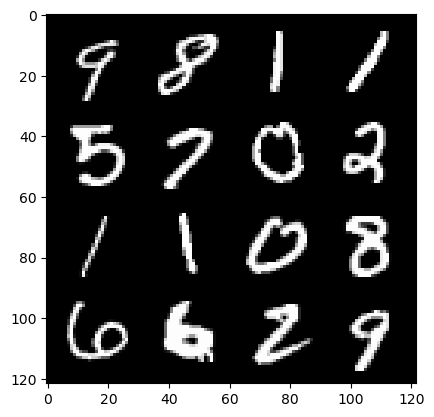

220: step 103200 / Gen loss: 1.3922801836331684 / disc_loss: 0.4287398664156595


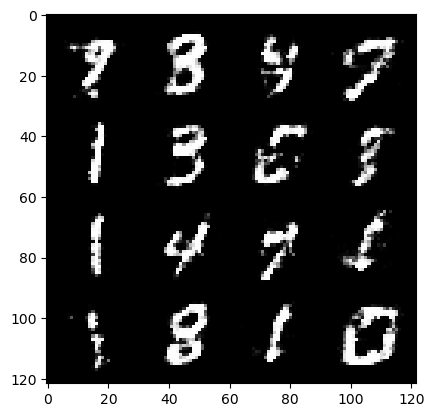

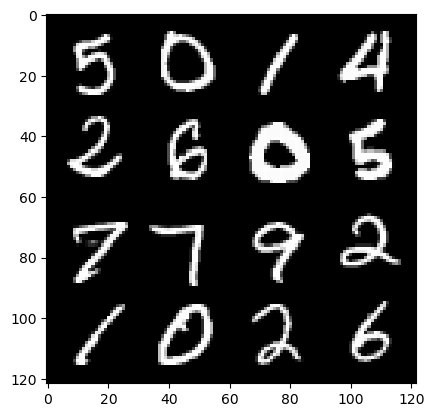

220: step 103500 / Gen loss: 1.4169821918010699 / disc_loss: 0.42098528752724335


  0%|          | 0/469 [00:00<?, ?it/s]

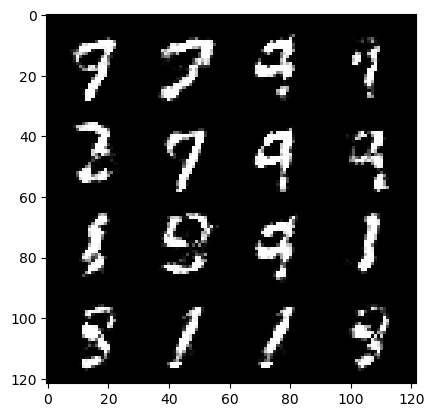

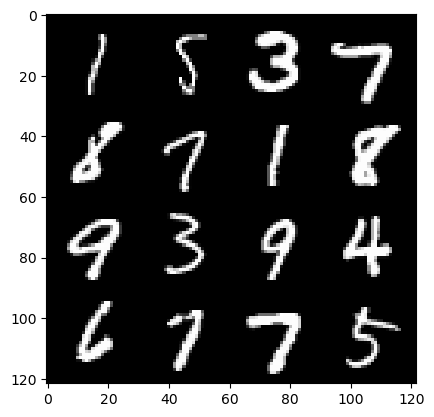

221: step 103800 / Gen loss: 1.3638908386230482 / disc_loss: 0.4378942770759265


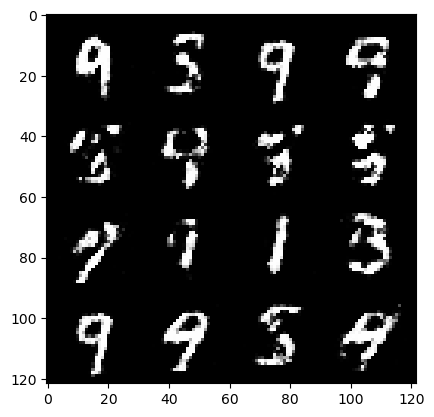

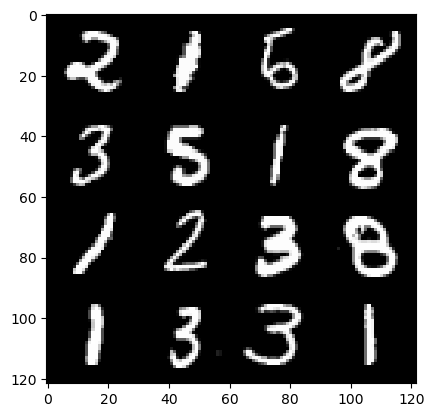

221: step 104100 / Gen loss: 1.4310120042165124 / disc_loss: 0.4201634193460148


  0%|          | 0/469 [00:00<?, ?it/s]

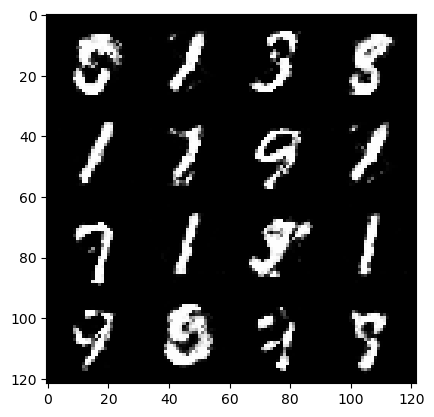

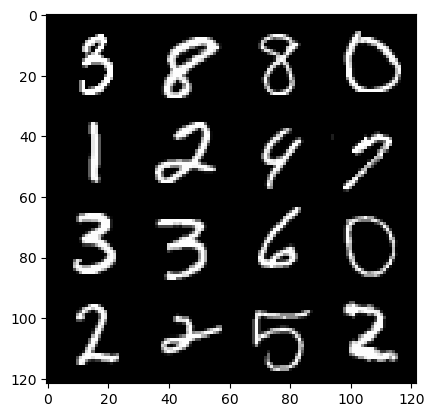

222: step 104400 / Gen loss: 1.4429928207397467 / disc_loss: 0.4198914939165116


  0%|          | 0/469 [00:00<?, ?it/s]

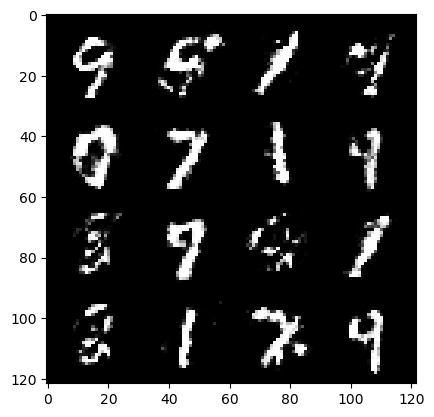

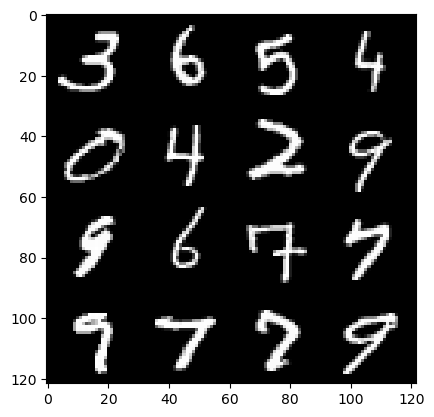

223: step 104700 / Gen loss: 1.363458530902862 / disc_loss: 0.4255859727660815


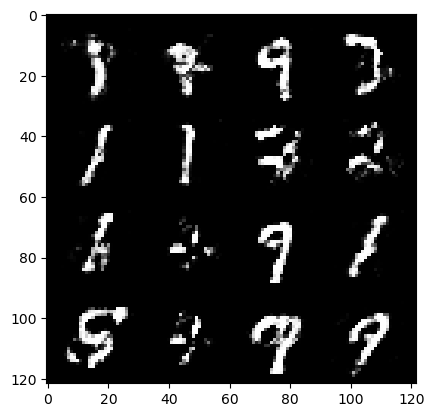

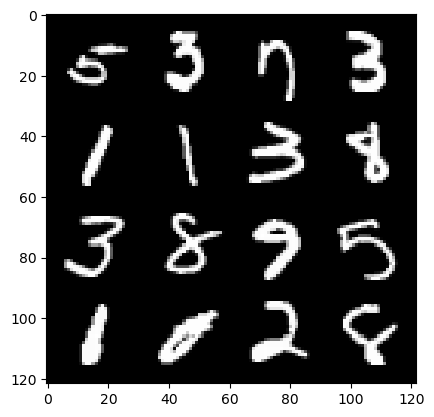

223: step 105000 / Gen loss: 1.3780842975775403 / disc_loss: 0.42999940603971487


  0%|          | 0/469 [00:00<?, ?it/s]

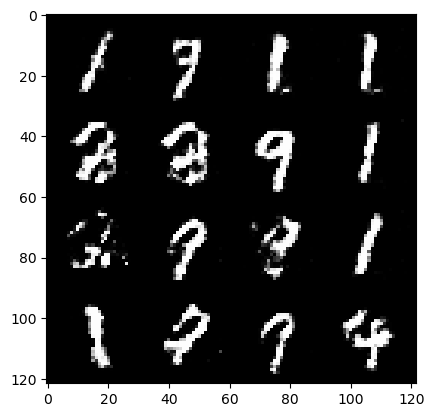

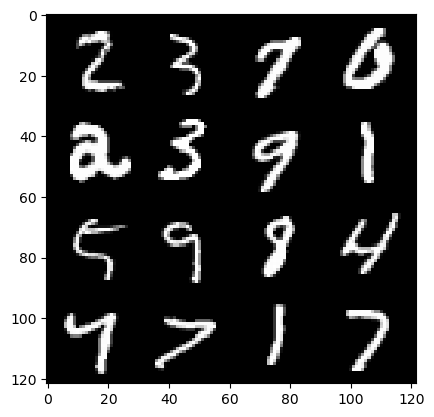

224: step 105300 / Gen loss: 1.3953486982981367 / disc_loss: 0.41974877635637947


  0%|          | 0/469 [00:00<?, ?it/s]

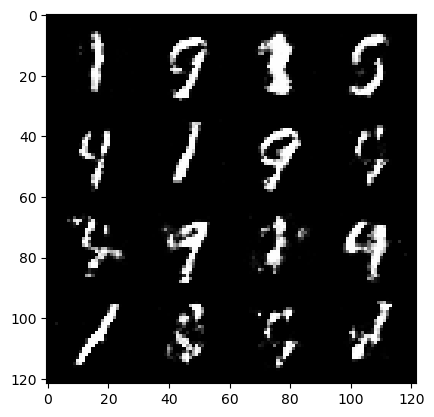

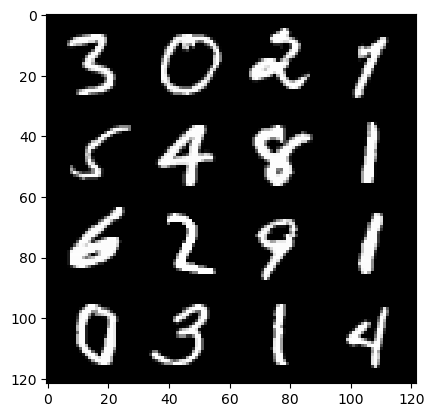

225: step 105600 / Gen loss: 1.4279609465599066 / disc_loss: 0.4071725279092788


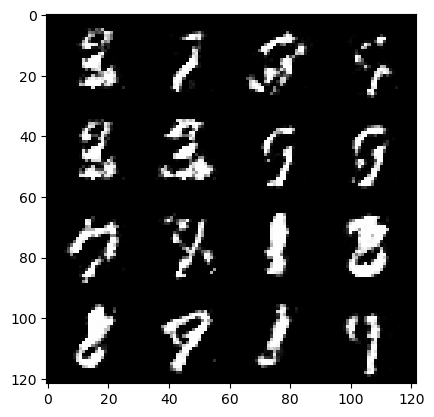

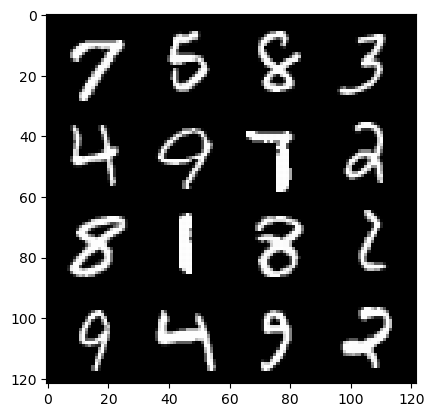

225: step 105900 / Gen loss: 1.3417391649882016 / disc_loss: 0.4391206994652745


  0%|          | 0/469 [00:00<?, ?it/s]

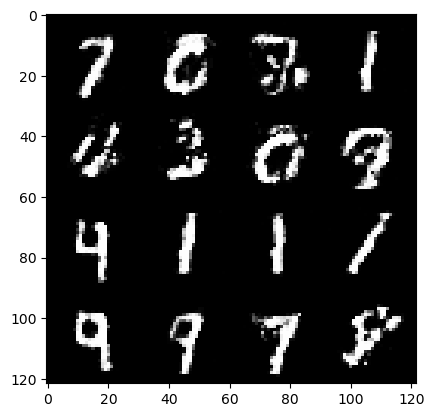

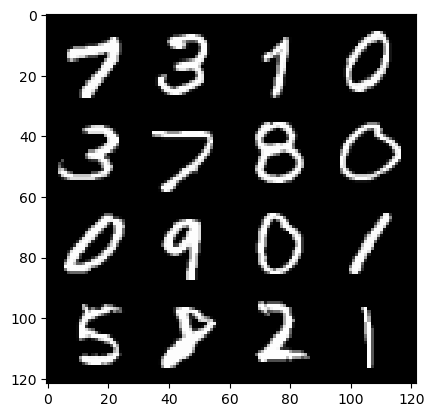

226: step 106200 / Gen loss: 1.3386442414919528 / disc_loss: 0.4393133450547855


  0%|          | 0/469 [00:00<?, ?it/s]

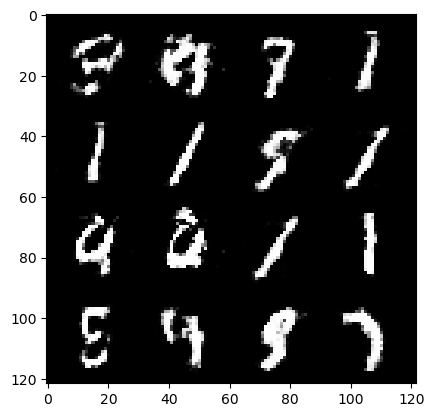

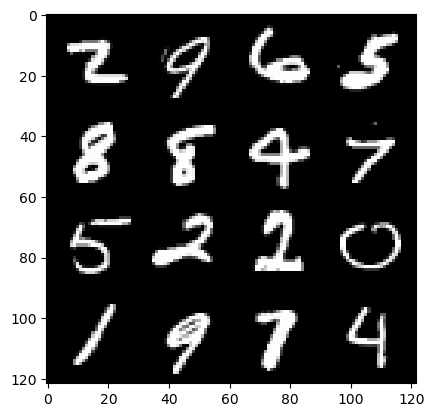

227: step 106500 / Gen loss: 1.2864139080047599 / disc_loss: 0.4636706807216007


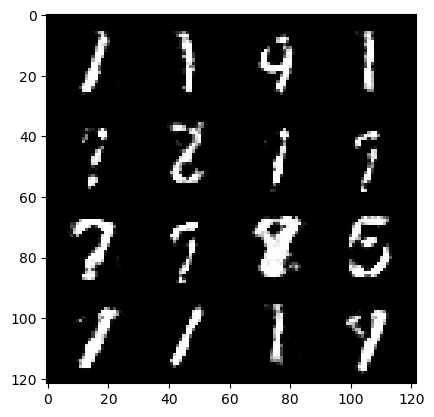

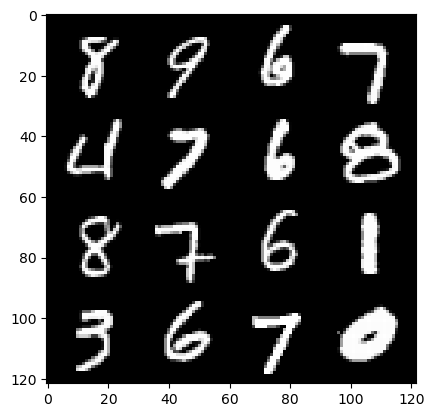

227: step 106800 / Gen loss: 1.3200920248031622 / disc_loss: 0.43733175635337806


  0%|          | 0/469 [00:00<?, ?it/s]

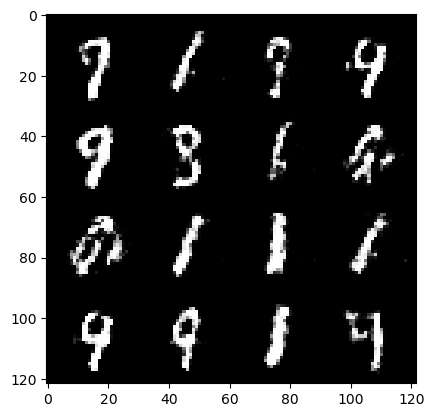

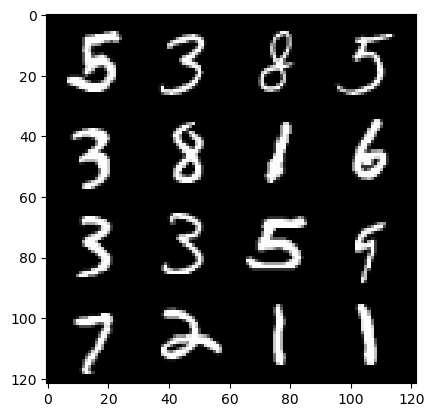

228: step 107100 / Gen loss: 1.3238239947954806 / disc_loss: 0.43615256786346446


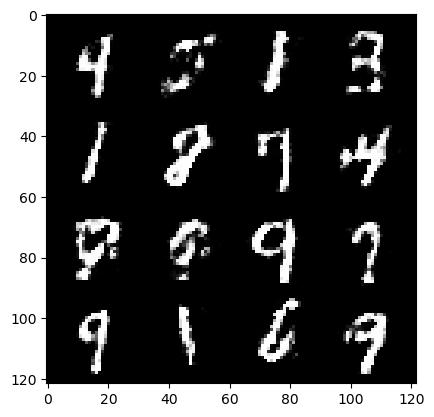

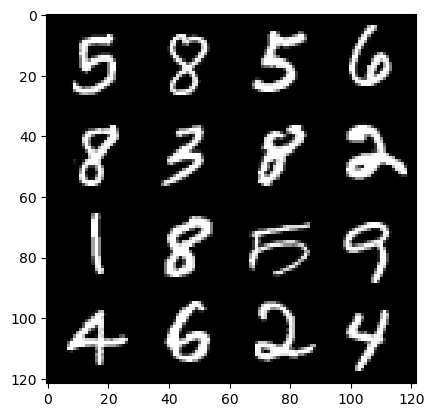

228: step 107400 / Gen loss: 1.1969836533069615 / disc_loss: 0.4786079025268554


  0%|          | 0/469 [00:00<?, ?it/s]

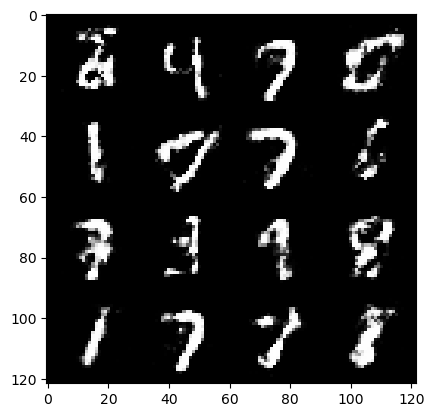

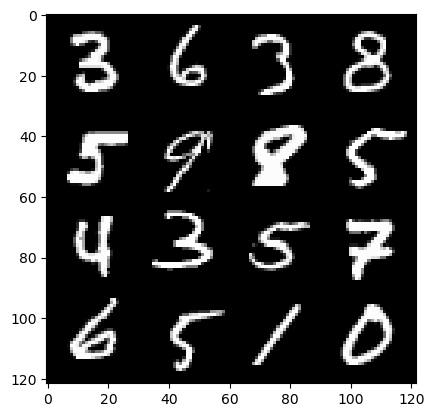

229: step 107700 / Gen loss: 1.2151262903213509 / disc_loss: 0.45719408412774404


  0%|          | 0/469 [00:00<?, ?it/s]

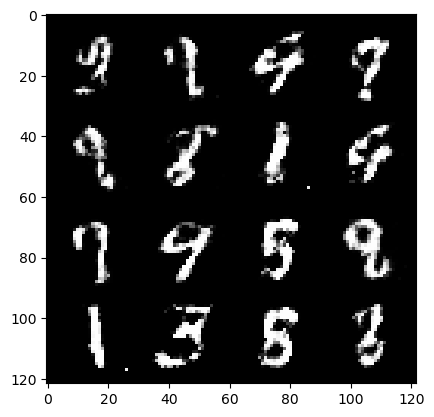

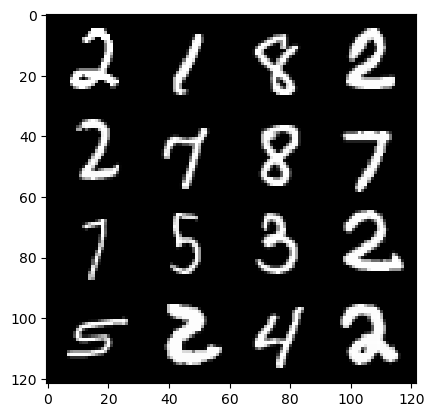

230: step 108000 / Gen loss: 1.2296594182650245 / disc_loss: 0.4747397653261819


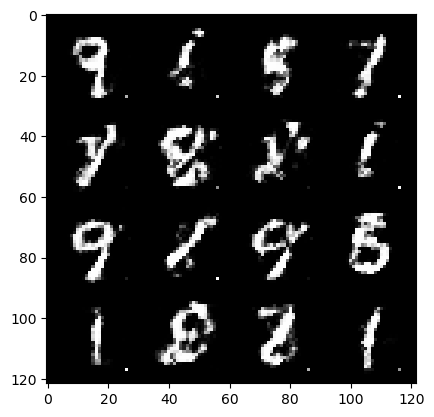

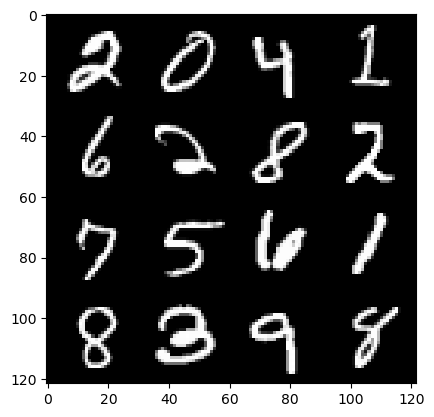

230: step 108300 / Gen loss: 1.094466766119003 / disc_loss: 0.49803714176019026


  0%|          | 0/469 [00:00<?, ?it/s]

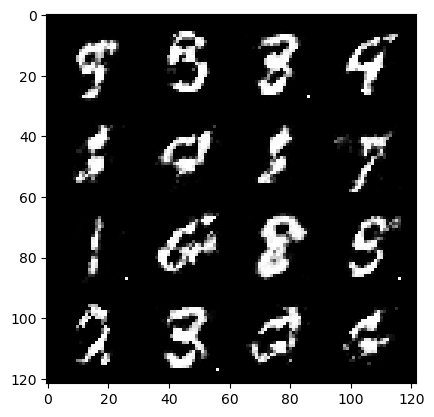

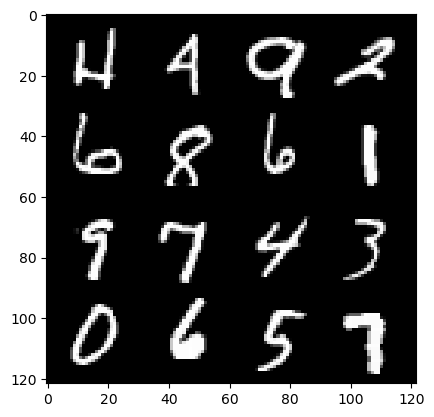

231: step 108600 / Gen loss: 1.1551666975021369 / disc_loss: 0.4706810424725215


  0%|          | 0/469 [00:00<?, ?it/s]

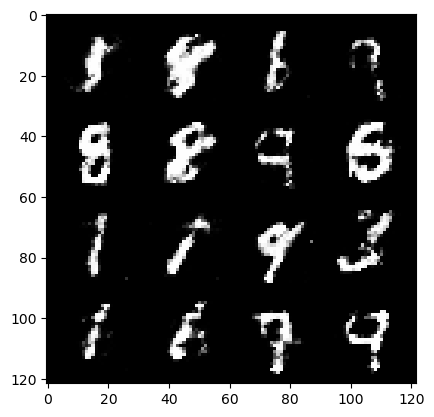

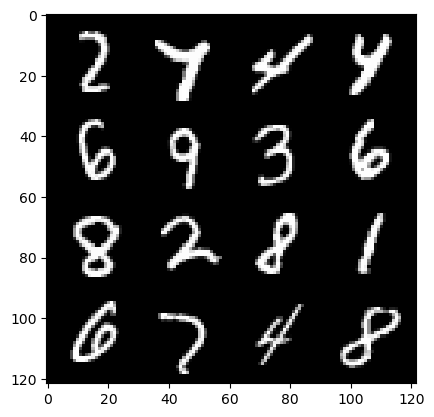

232: step 108900 / Gen loss: 1.2517861318588261 / disc_loss: 0.4400120429197944


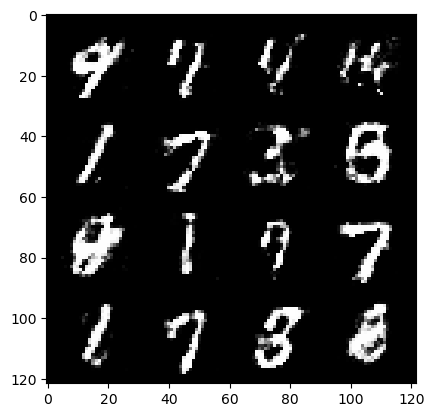

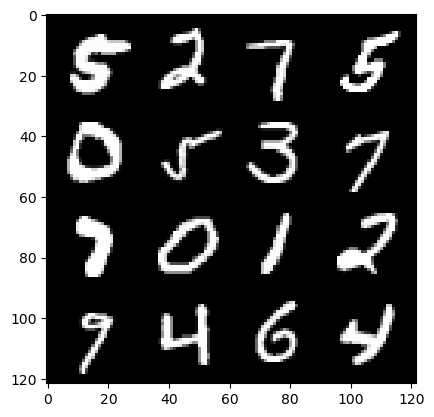

232: step 109200 / Gen loss: 1.2929667723178868 / disc_loss: 0.4392359929283462


  0%|          | 0/469 [00:00<?, ?it/s]

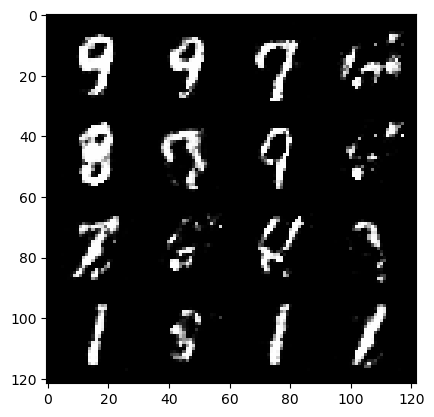

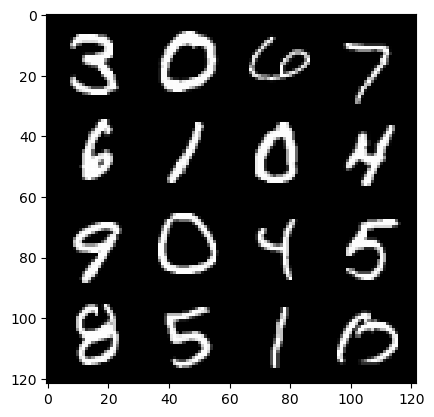

233: step 109500 / Gen loss: 1.2614812739690138 / disc_loss: 0.4435809192061427


  0%|          | 0/469 [00:00<?, ?it/s]

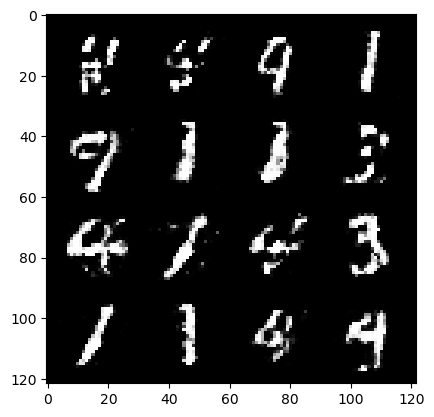

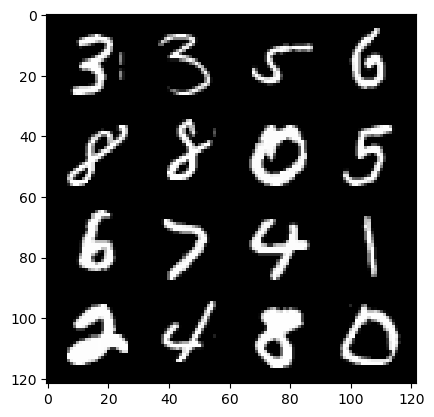

234: step 109800 / Gen loss: 1.3918150254090633 / disc_loss: 0.4077891260385518


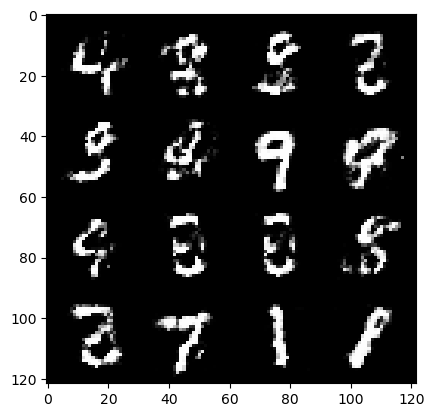

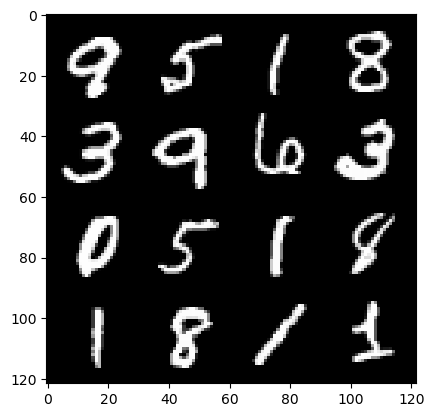

234: step 110100 / Gen loss: 1.3926298765341438 / disc_loss: 0.43333717544873573


  0%|          | 0/469 [00:00<?, ?it/s]

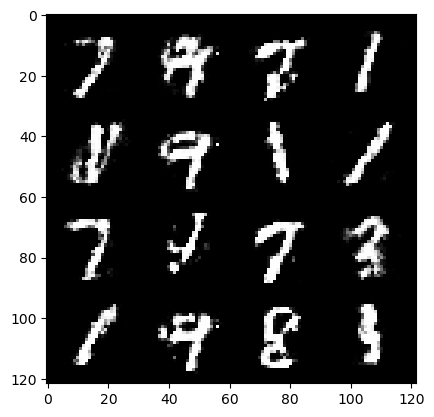

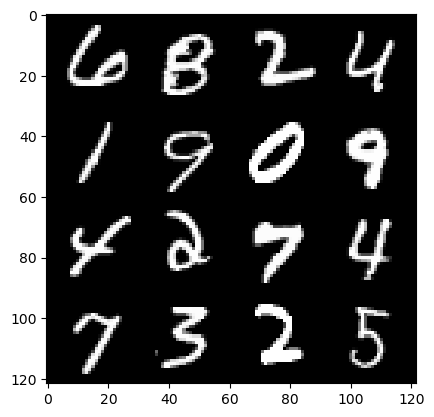

235: step 110400 / Gen loss: 1.3177537890275322 / disc_loss: 0.45179120173056925


  0%|          | 0/469 [00:00<?, ?it/s]

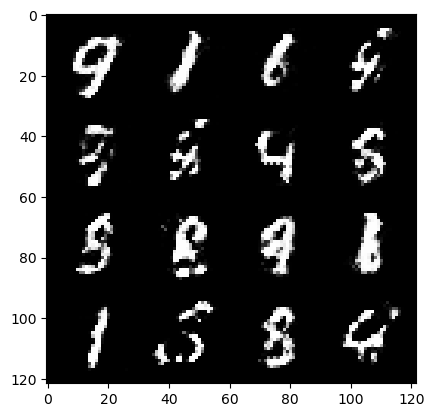

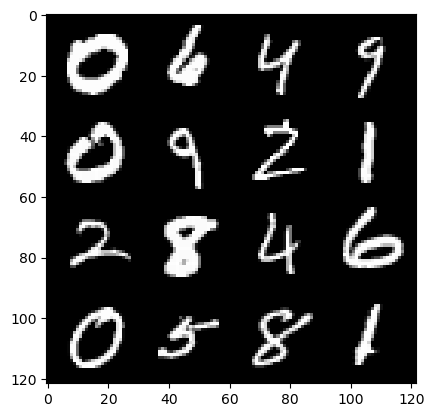

236: step 110700 / Gen loss: 1.4003159705797832 / disc_loss: 0.43393948088089646


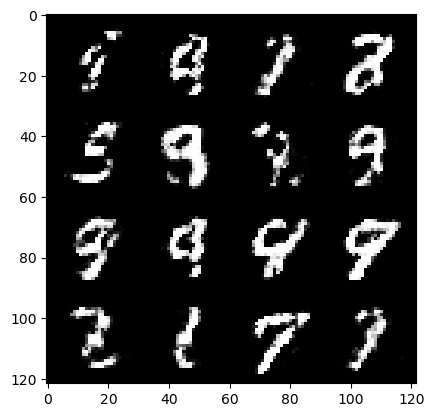

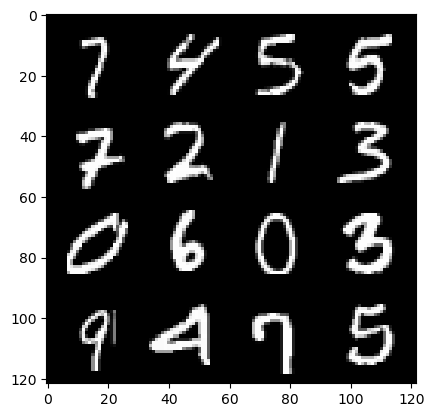

236: step 111000 / Gen loss: 1.3106373751163483 / disc_loss: 0.4494307956099507


  0%|          | 0/469 [00:00<?, ?it/s]

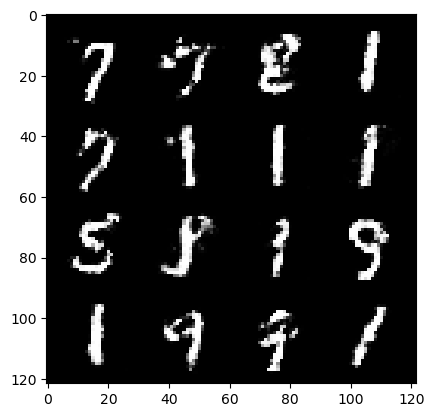

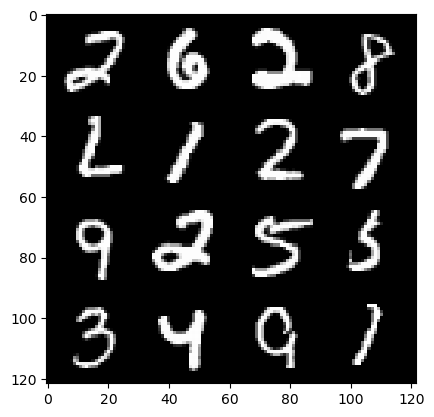

237: step 111300 / Gen loss: 1.3623378002643587 / disc_loss: 0.4261102685332298


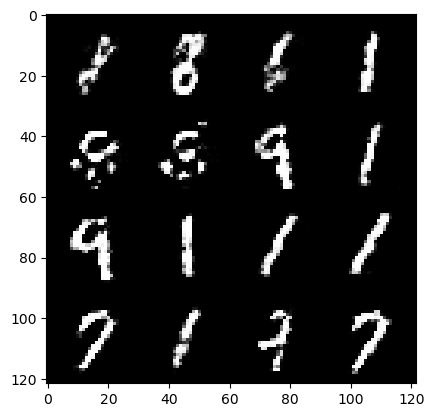

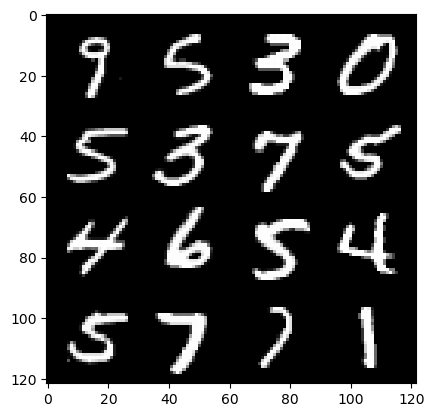

237: step 111600 / Gen loss: 1.3963203120231618 / disc_loss: 0.42589089661836627


  0%|          | 0/469 [00:00<?, ?it/s]

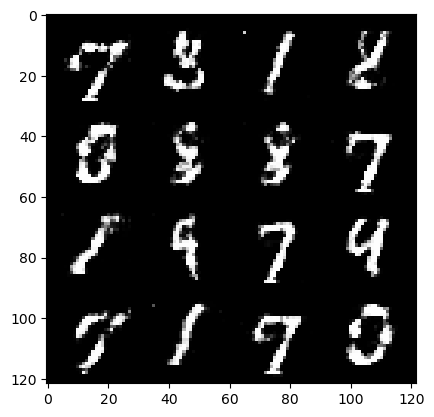

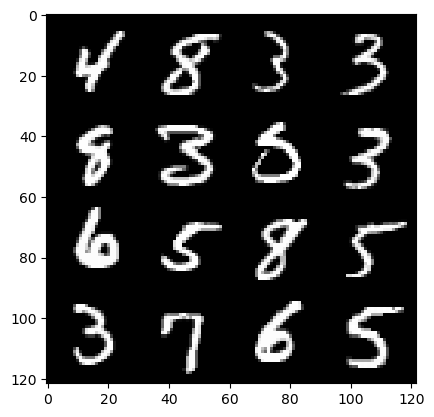

238: step 111900 / Gen loss: 1.3372633337974544 / disc_loss: 0.43285742580890635


  0%|          | 0/469 [00:00<?, ?it/s]

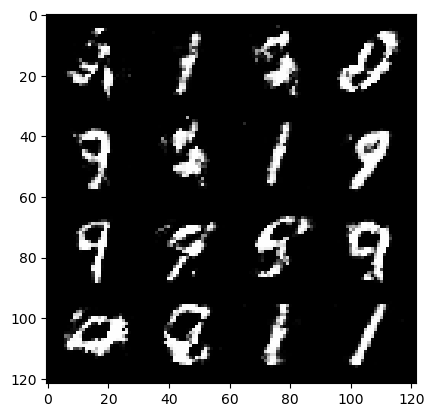

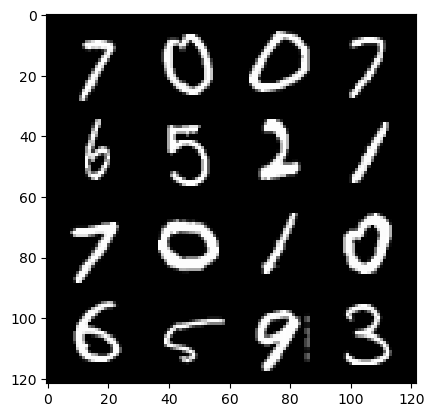

239: step 112200 / Gen loss: 1.2751075776418057 / disc_loss: 0.45507179329792663


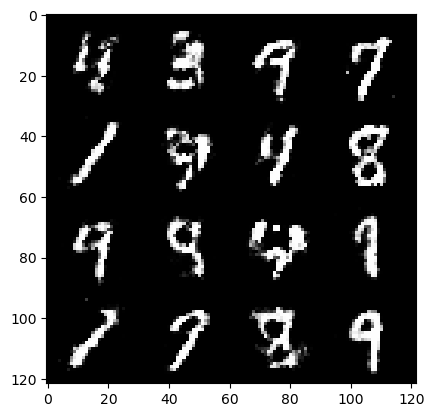

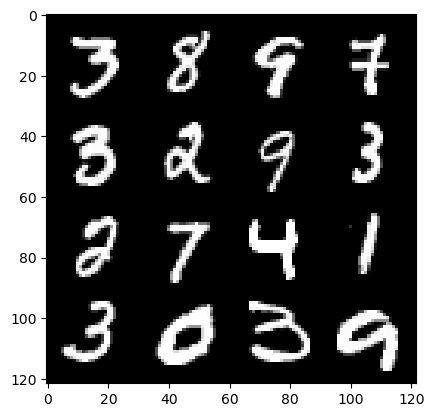

239: step 112500 / Gen loss: 1.307716587781906 / disc_loss: 0.4441836518049243


  0%|          | 0/469 [00:00<?, ?it/s]

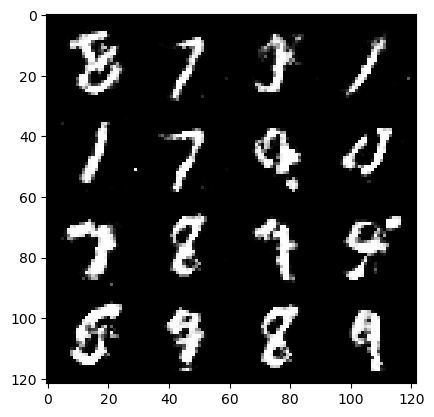

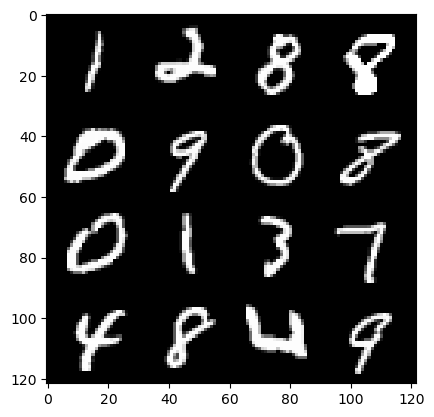

240: step 112800 / Gen loss: 1.2763422306378691 / disc_loss: 0.45668518781661976


  0%|          | 0/469 [00:00<?, ?it/s]

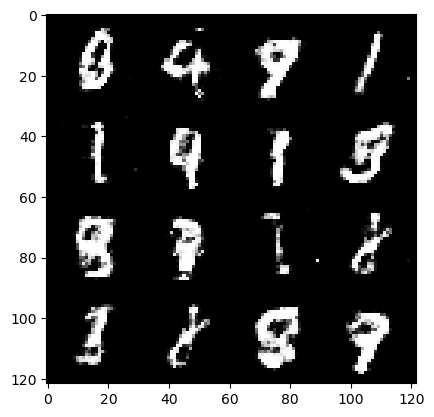

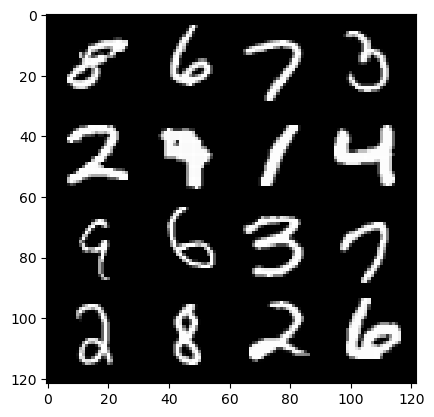

241: step 113100 / Gen loss: 1.111809103886286 / disc_loss: 0.5027739868561425


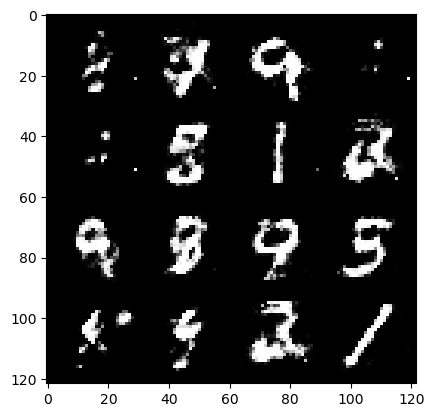

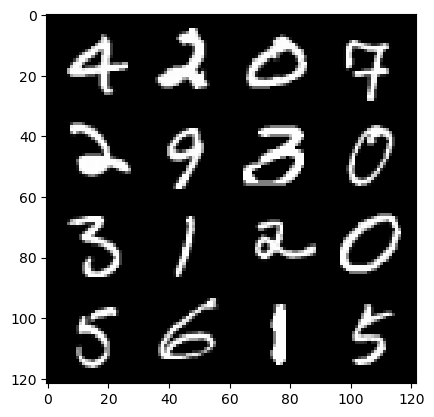

241: step 113400 / Gen loss: 1.1382299800713849 / disc_loss: 0.496932900647322


  0%|          | 0/469 [00:00<?, ?it/s]

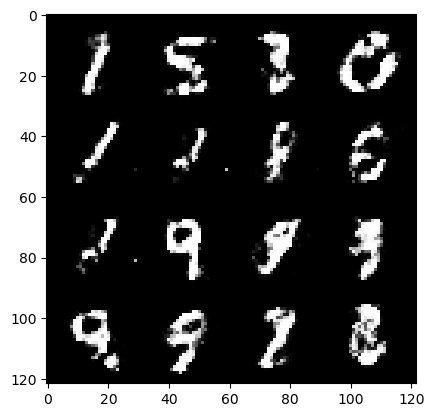

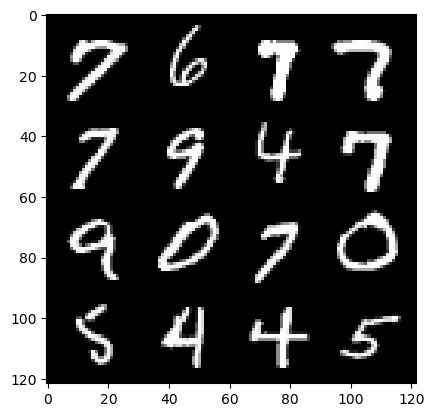

242: step 113700 / Gen loss: 1.1704784252246234 / disc_loss: 0.47804193615913365


  0%|          | 0/469 [00:00<?, ?it/s]

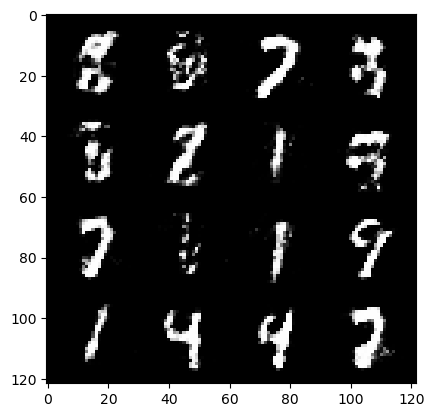

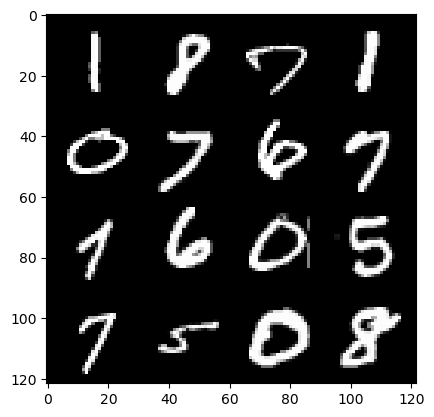

243: step 114000 / Gen loss: 1.212690638303757 / disc_loss: 0.46832051992416385


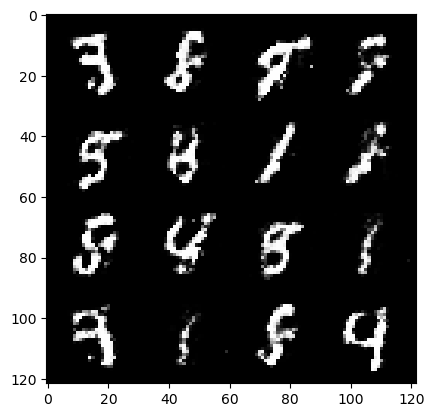

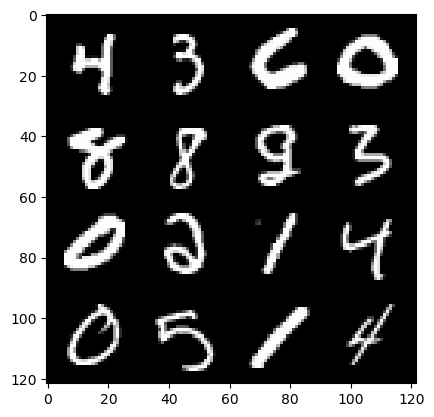

243: step 114300 / Gen loss: 1.3059950776894889 / disc_loss: 0.44214656303326294


  0%|          | 0/469 [00:00<?, ?it/s]

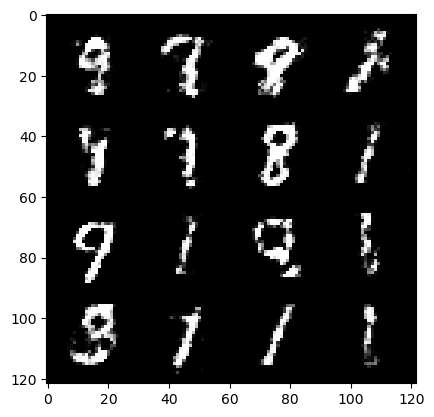

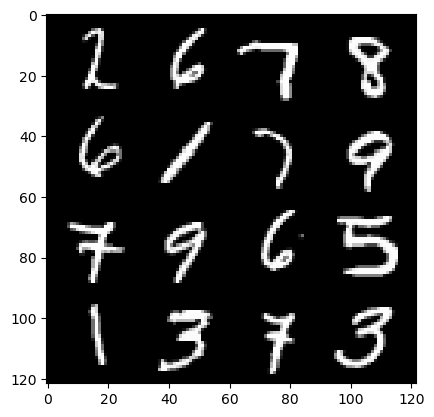

244: step 114600 / Gen loss: 1.3906584866841638 / disc_loss: 0.4294314475854239


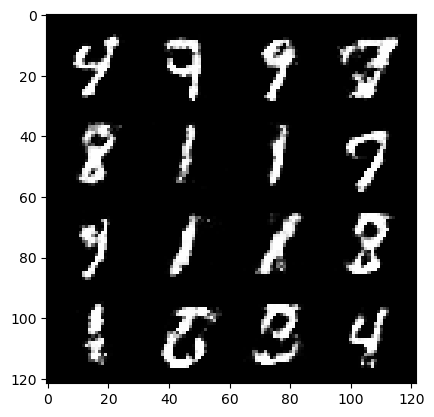

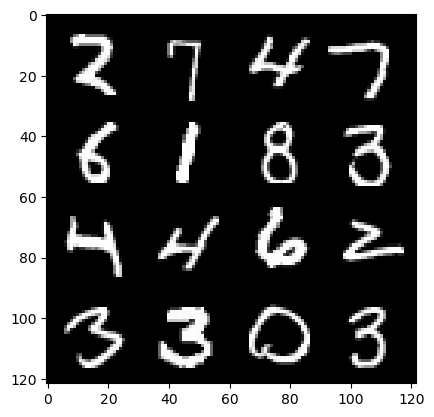

244: step 114900 / Gen loss: 1.3558024895191205 / disc_loss: 0.4400462763508156


  0%|          | 0/469 [00:00<?, ?it/s]

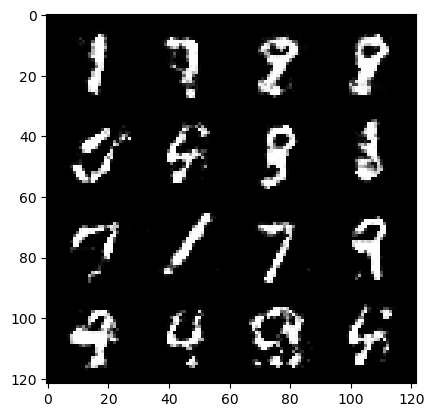

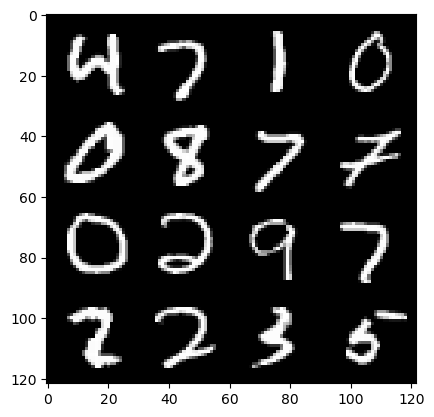

245: step 115200 / Gen loss: 1.3482225632667548 / disc_loss: 0.44322407583395657


  0%|          | 0/469 [00:00<?, ?it/s]

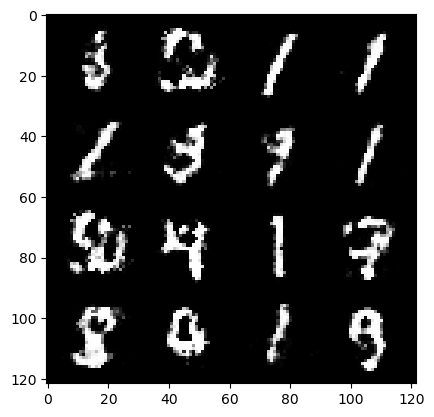

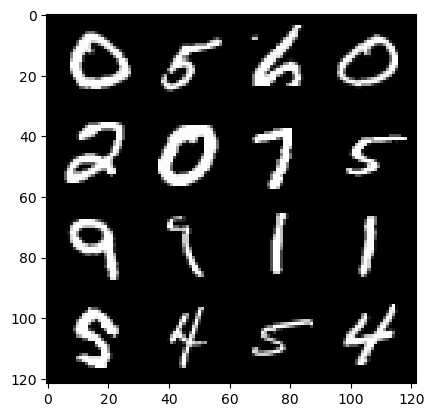

246: step 115500 / Gen loss: 1.3196150954564403 / disc_loss: 0.4361511455972989


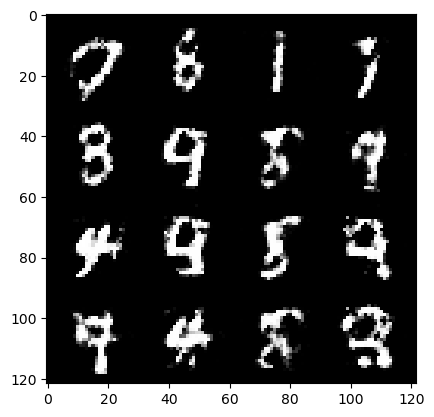

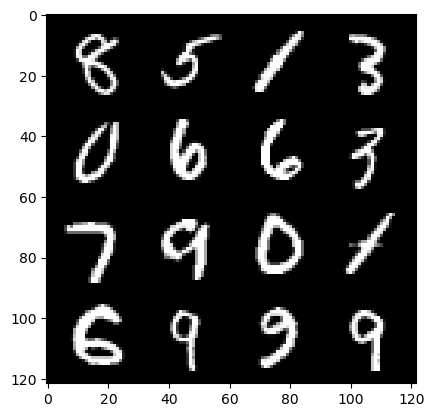

246: step 115800 / Gen loss: 1.3576988681157436 / disc_loss: 0.4282473963499069


  0%|          | 0/469 [00:00<?, ?it/s]

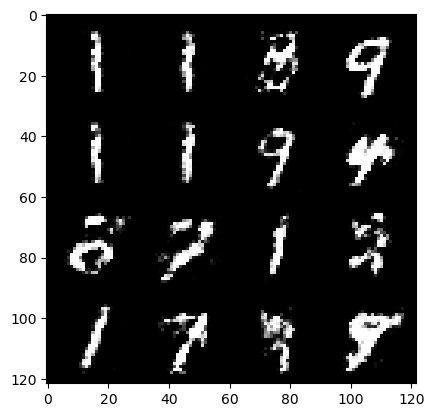

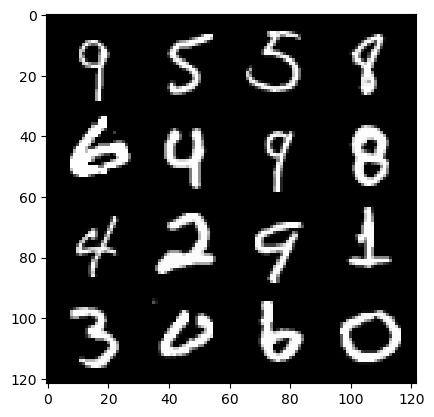

247: step 116100 / Gen loss: 1.3129552257061006 / disc_loss: 0.4408883994817732


  0%|          | 0/469 [00:00<?, ?it/s]

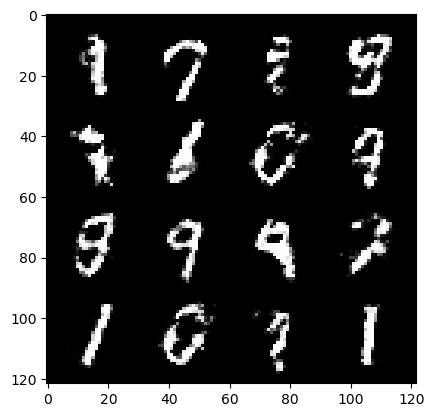

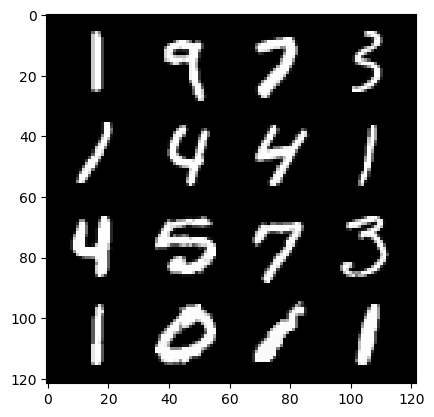

248: step 116400 / Gen loss: 1.403056208292644 / disc_loss: 0.41400888572136546


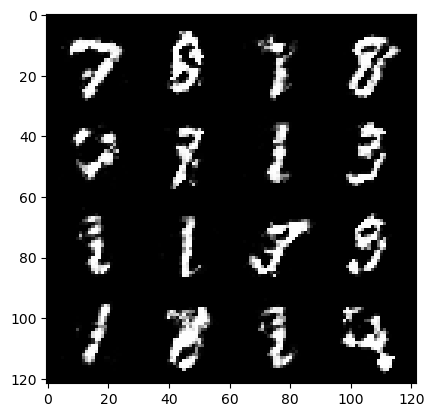

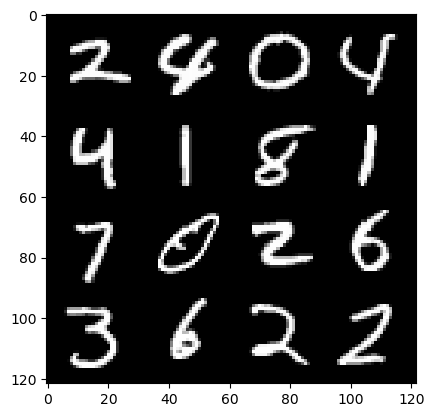

248: step 116700 / Gen loss: 1.4259503785769136 / disc_loss: 0.4077494044105209


  0%|          | 0/469 [00:00<?, ?it/s]

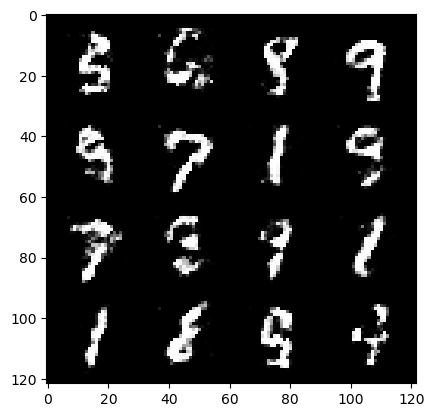

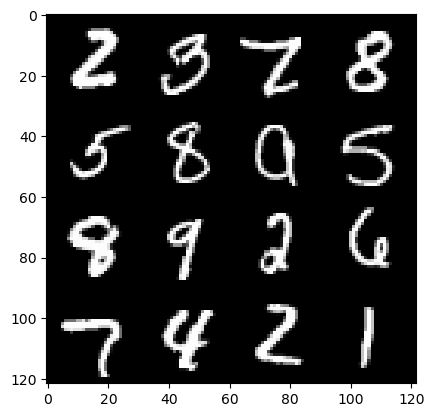

249: step 117000 / Gen loss: 1.4540804576873785 / disc_loss: 0.40395619511604314


  0%|          | 0/469 [00:00<?, ?it/s]

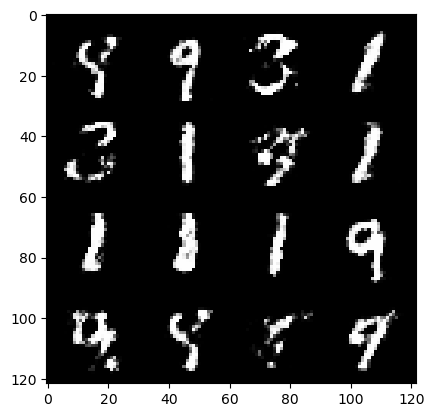

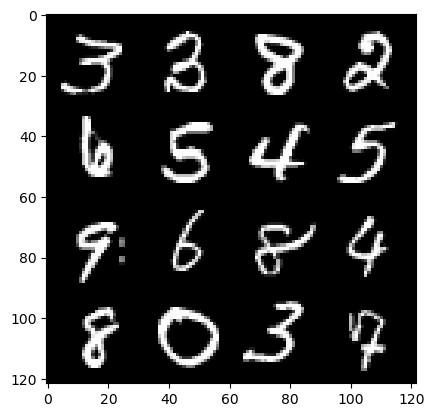

250: step 117300 / Gen loss: 1.444893195231757 / disc_loss: 0.4176231179634733


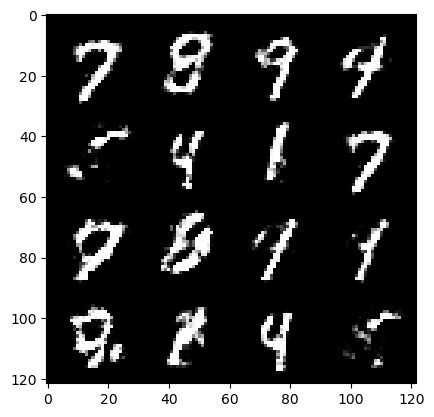

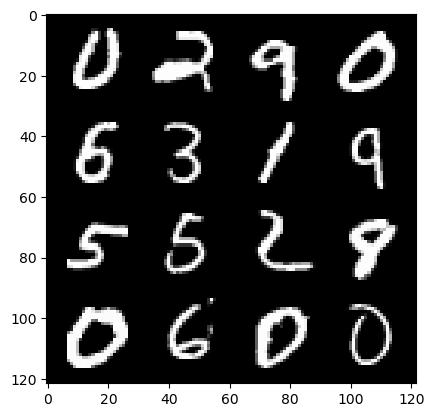

250: step 117600 / Gen loss: 1.3399789639314006 / disc_loss: 0.4485492758949598


  0%|          | 0/469 [00:00<?, ?it/s]

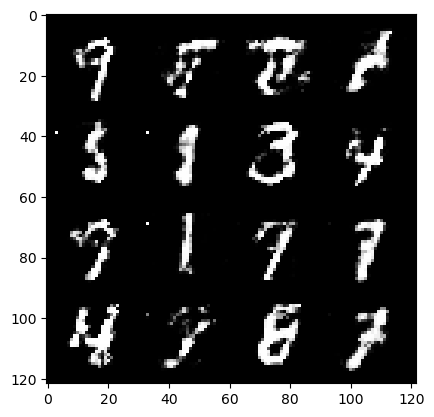

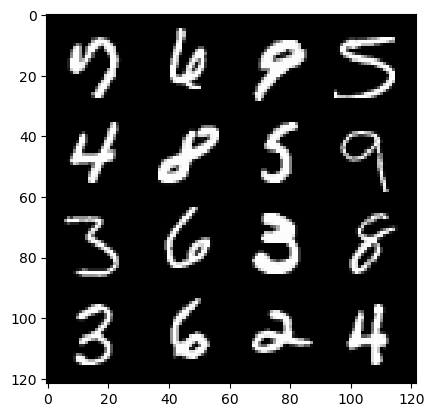

251: step 117900 / Gen loss: 1.2709839860598258 / disc_loss: 0.454330676098665


  0%|          | 0/469 [00:00<?, ?it/s]

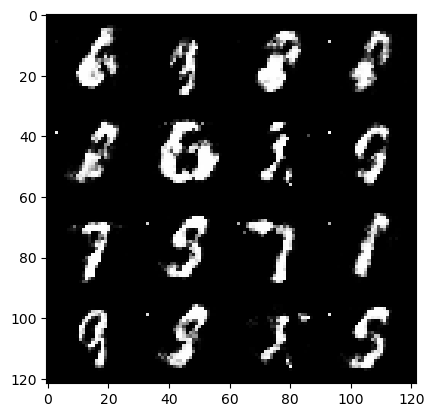

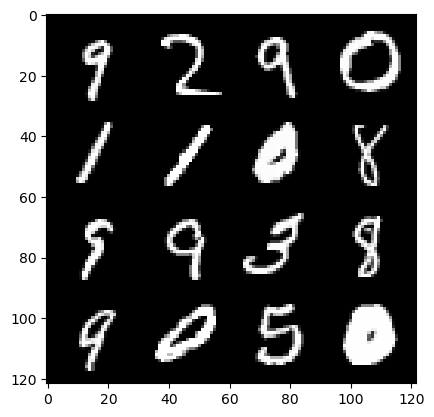

252: step 118200 / Gen loss: 1.1007668016354237 / disc_loss: 0.48105278770128934


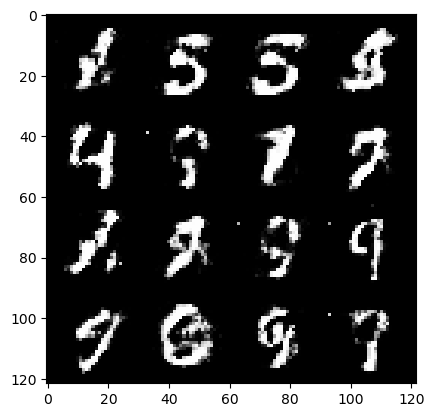

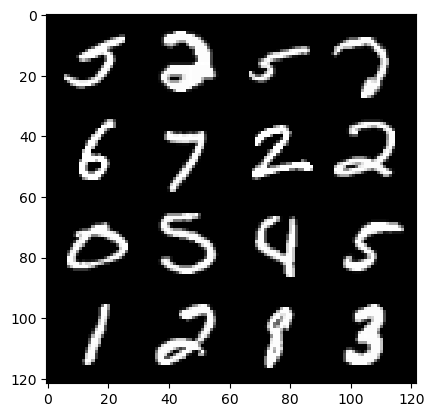

252: step 118500 / Gen loss: 1.087474487622579 / disc_loss: 0.4940482216080034


  0%|          | 0/469 [00:00<?, ?it/s]

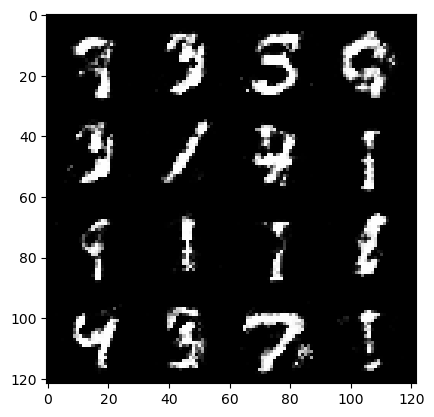

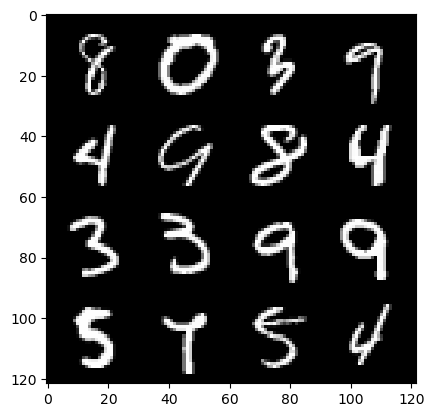

253: step 118800 / Gen loss: 1.1911735248565665 / disc_loss: 0.46094746520121865


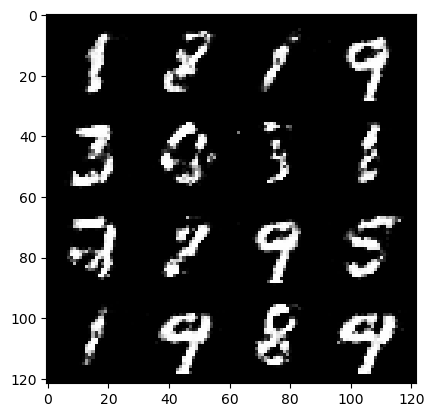

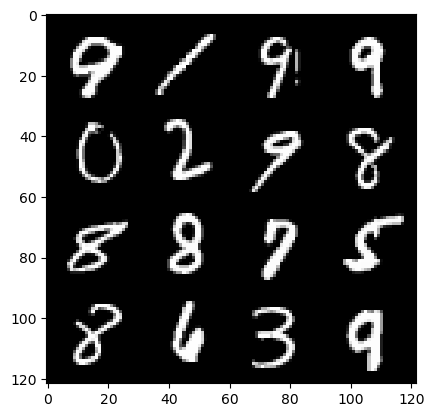

253: step 119100 / Gen loss: 1.2022615857919066 / disc_loss: 0.45626131882270177


  0%|          | 0/469 [00:00<?, ?it/s]

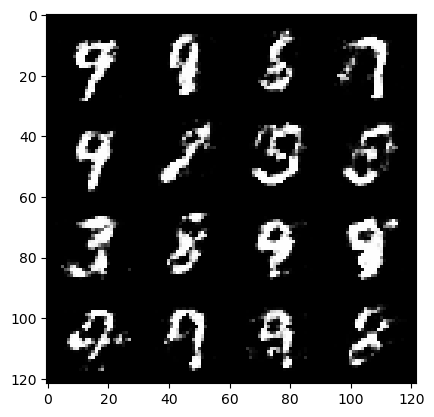

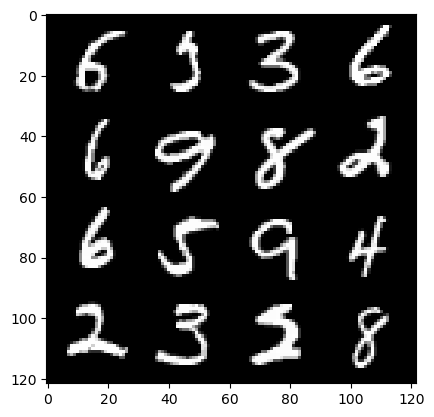

254: step 119400 / Gen loss: 1.3120317582289382 / disc_loss: 0.43724973539511347


  0%|          | 0/469 [00:00<?, ?it/s]

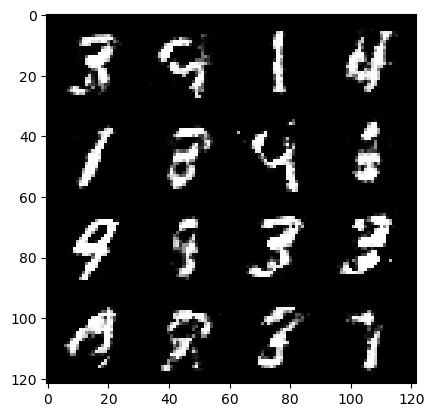

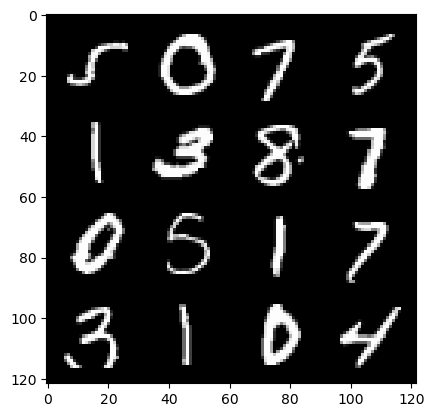

255: step 119700 / Gen loss: 1.3792395798365273 / disc_loss: 0.44830818345149354


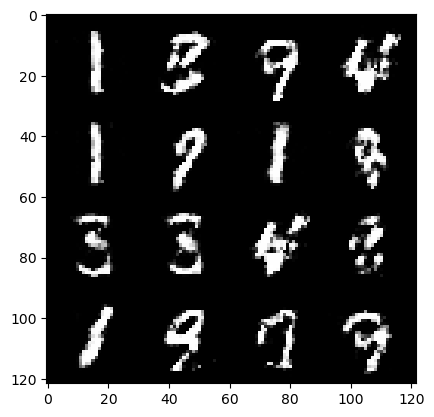

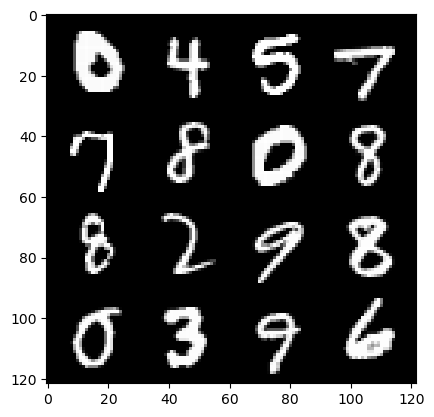

255: step 120000 / Gen loss: 1.4258672416210174 / disc_loss: 0.42137528151273734


  0%|          | 0/469 [00:00<?, ?it/s]

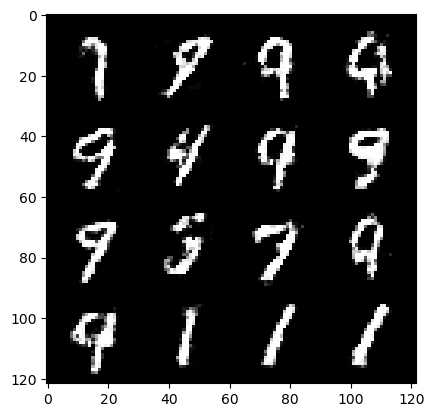

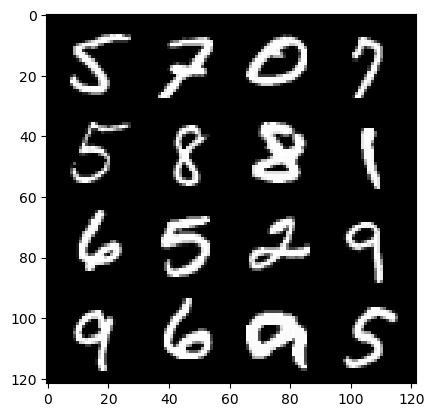

256: step 120300 / Gen loss: 1.4787477564811708 / disc_loss: 0.41582703659931836


  0%|          | 0/469 [00:00<?, ?it/s]

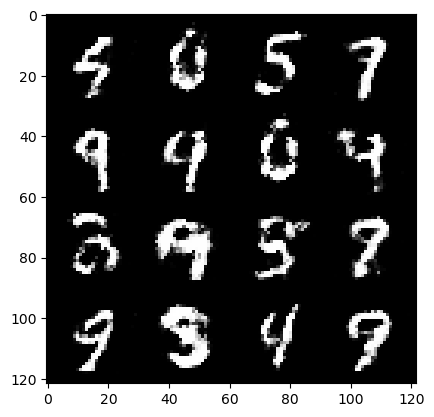

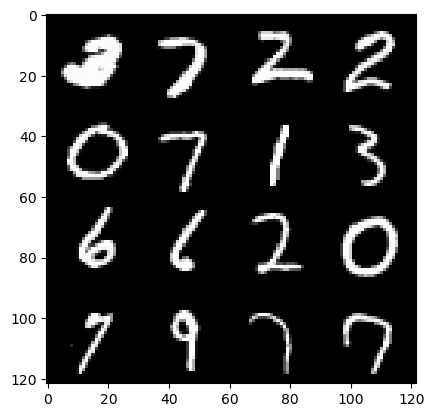

257: step 120600 / Gen loss: 1.4634777903556826 / disc_loss: 0.4068669614195824


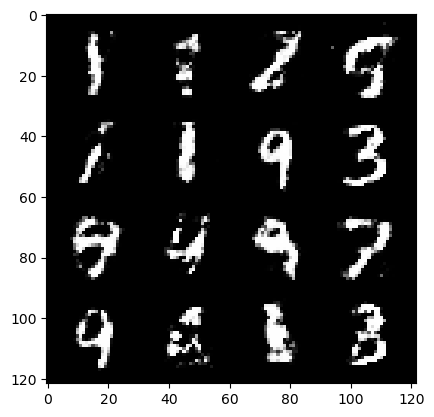

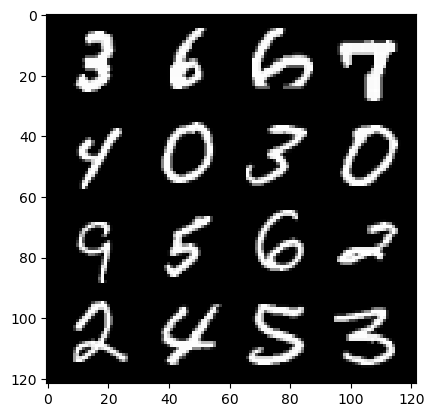

257: step 120900 / Gen loss: 1.4032861518859858 / disc_loss: 0.4349383451541265


  0%|          | 0/469 [00:00<?, ?it/s]

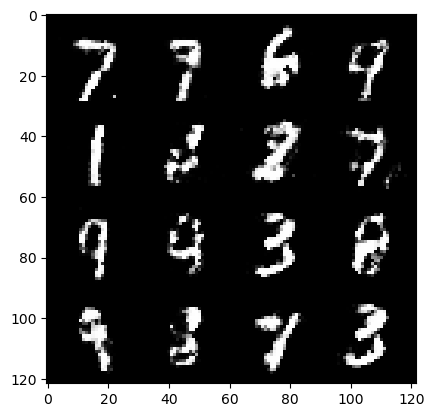

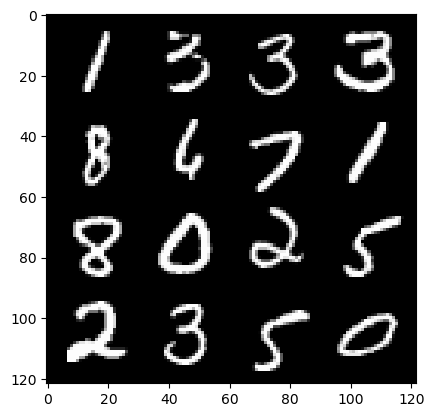

258: step 121200 / Gen loss: 1.3816361769040435 / disc_loss: 0.4271360545357068


  0%|          | 0/469 [00:00<?, ?it/s]

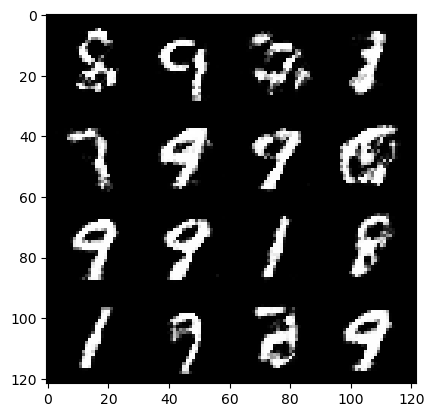

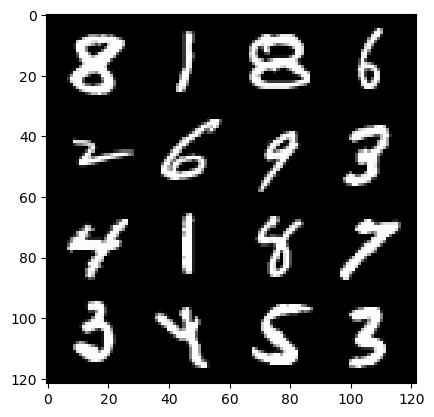

259: step 121500 / Gen loss: 1.3793647503852848 / disc_loss: 0.4264985073606173


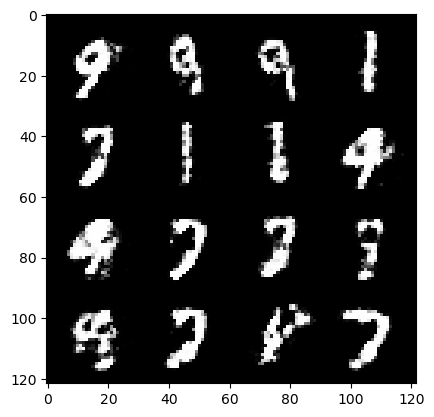

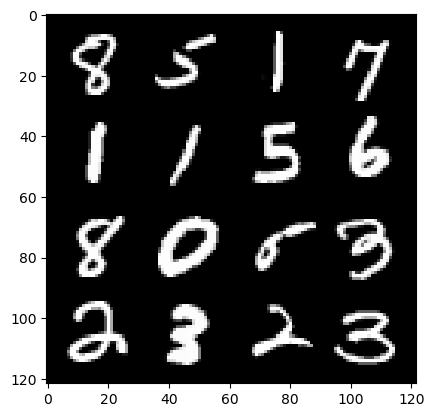

259: step 121800 / Gen loss: 1.4136929198106136 / disc_loss: 0.41347807327906283


  0%|          | 0/469 [00:00<?, ?it/s]

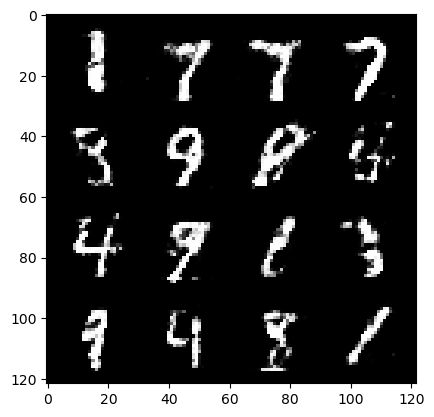

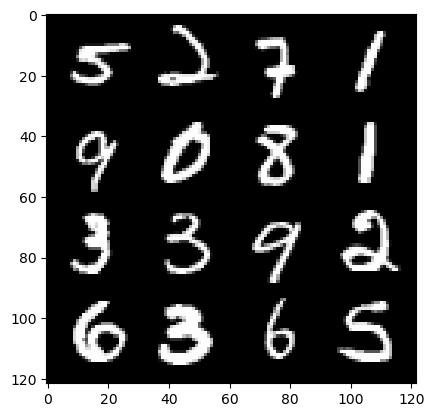

260: step 122100 / Gen loss: 1.3794817574818923 / disc_loss: 0.4314459688464798


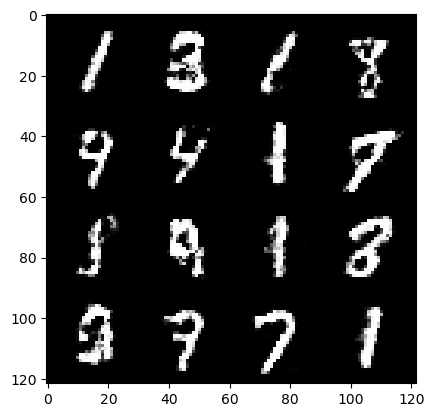

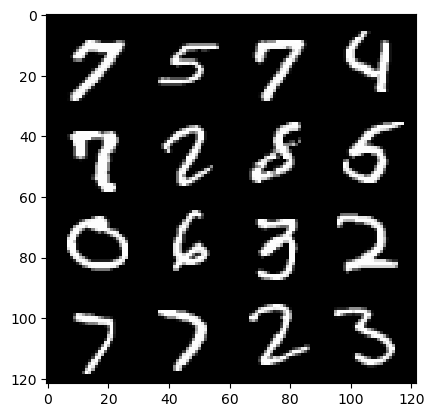

260: step 122400 / Gen loss: 1.3399586534500119 / disc_loss: 0.44032247761885335


  0%|          | 0/469 [00:00<?, ?it/s]

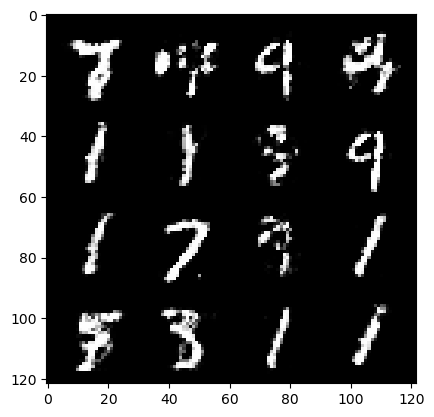

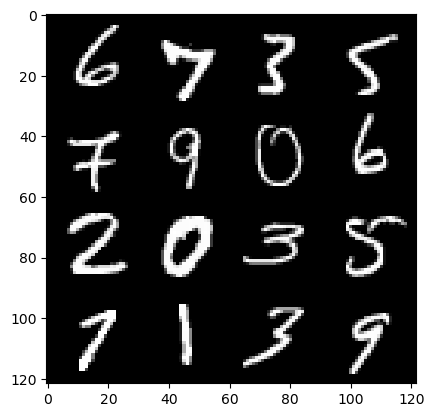

261: step 122700 / Gen loss: 1.3928994822502139 / disc_loss: 0.4364447445670761


  0%|          | 0/469 [00:00<?, ?it/s]

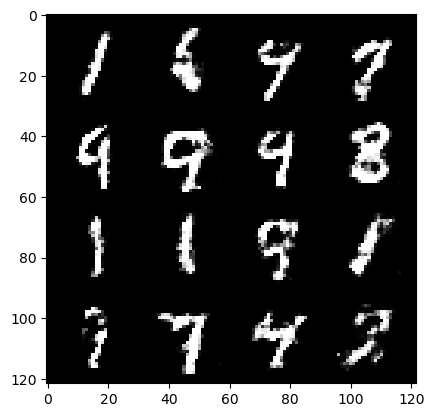

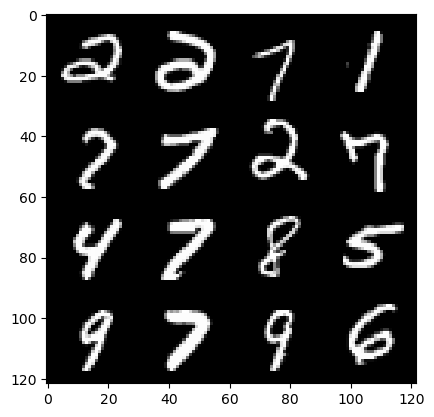

262: step 123000 / Gen loss: 1.3780413866043086 / disc_loss: 0.4336497016747794


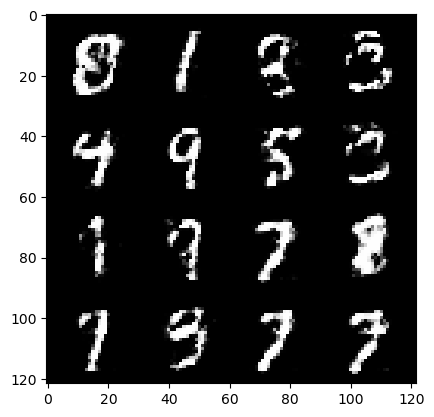

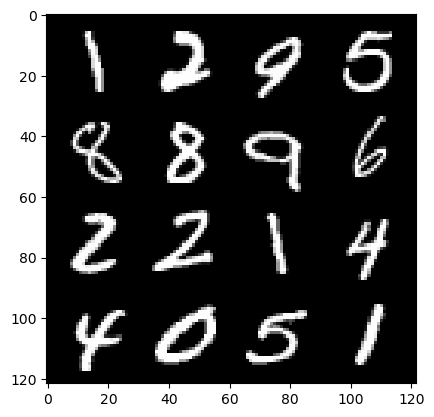

262: step 123300 / Gen loss: 1.3545065534114848 / disc_loss: 0.4370311933755875


  0%|          | 0/469 [00:00<?, ?it/s]

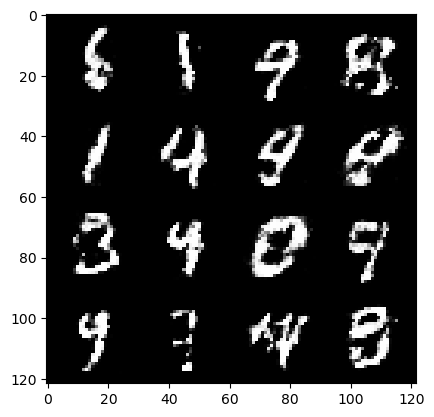

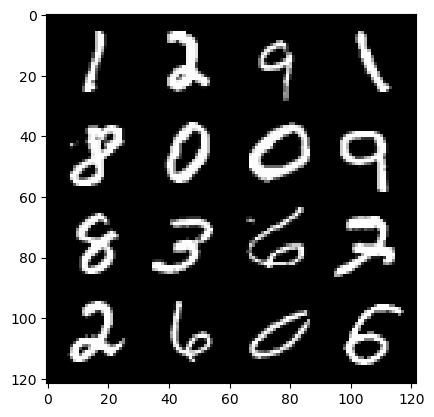

263: step 123600 / Gen loss: 1.3688318328062685 / disc_loss: 0.4352303925156592


  0%|          | 0/469 [00:00<?, ?it/s]

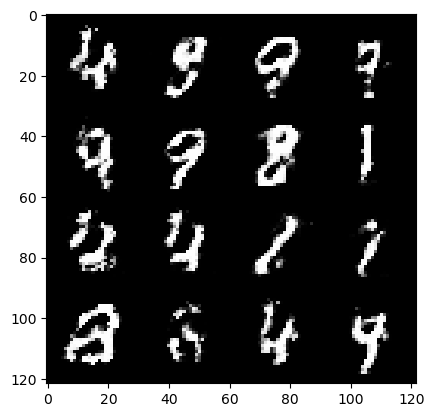

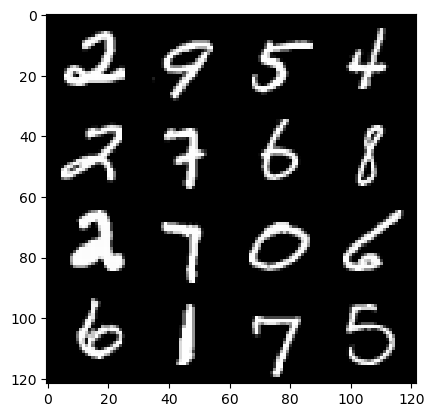

264: step 123900 / Gen loss: 1.3319785145918521 / disc_loss: 0.44867875943581276


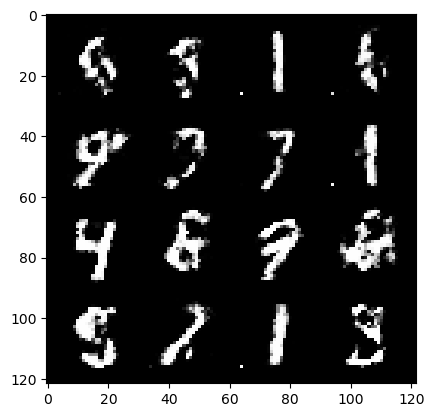

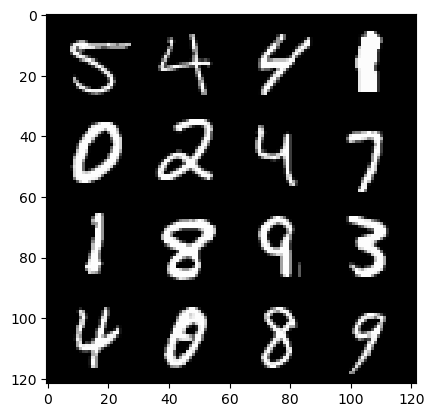

264: step 124200 / Gen loss: 1.3134447189172107 / disc_loss: 0.4450488766034444


  0%|          | 0/469 [00:00<?, ?it/s]

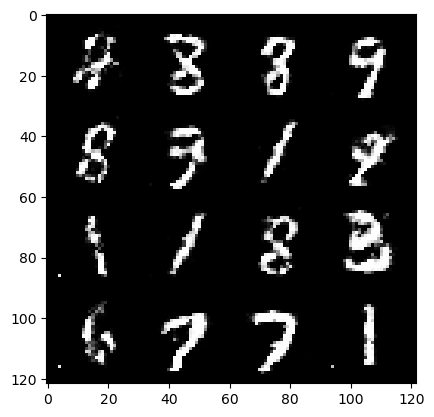

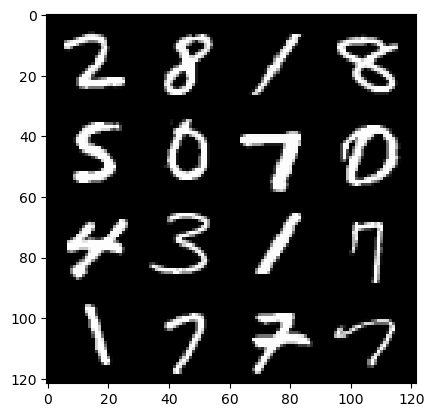

265: step 124500 / Gen loss: 1.3428493928909309 / disc_loss: 0.419041938285033


  0%|          | 0/469 [00:00<?, ?it/s]

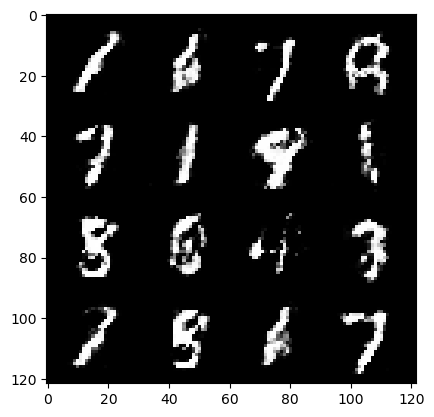

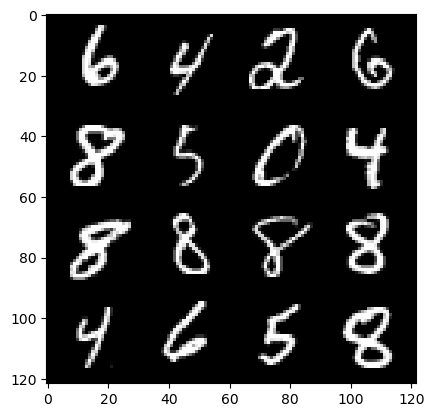

266: step 124800 / Gen loss: 1.2966475180784869 / disc_loss: 0.4409941154718403


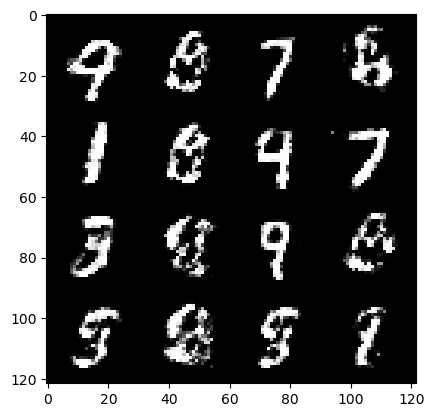

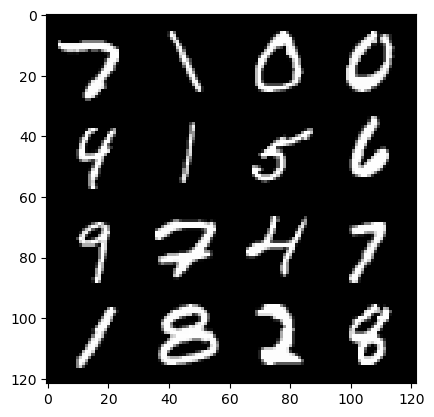

266: step 125100 / Gen loss: 1.3732978423436486 / disc_loss: 0.42685821880896907


  0%|          | 0/469 [00:00<?, ?it/s]

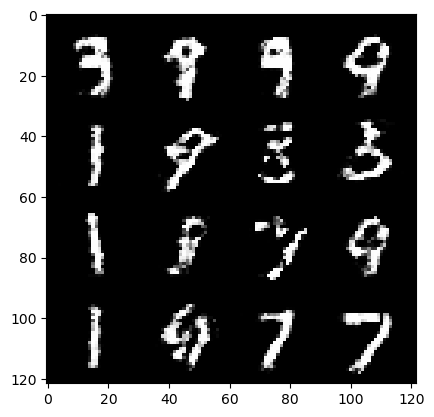

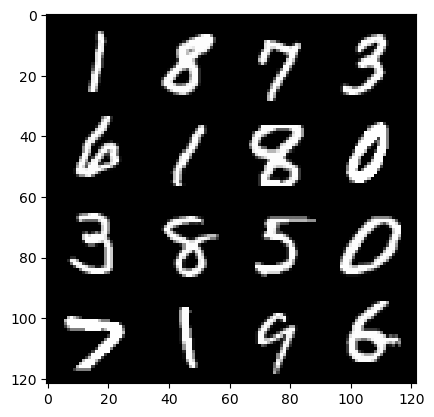

267: step 125400 / Gen loss: 1.3788578951358785 / disc_loss: 0.43305735607941986


  0%|          | 0/469 [00:00<?, ?it/s]

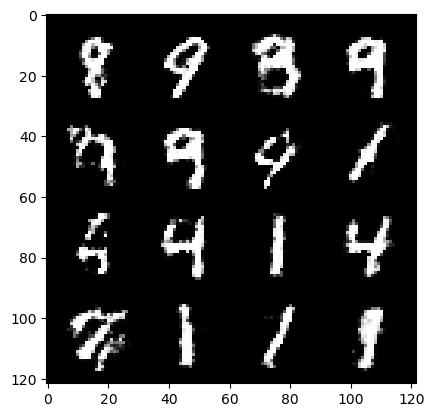

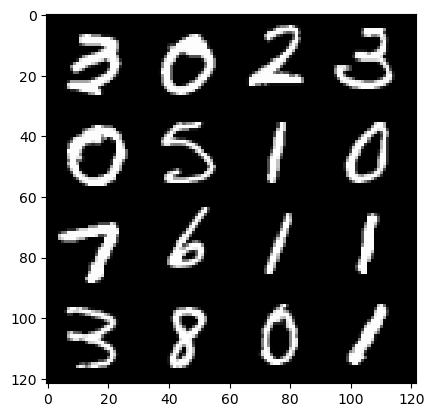

268: step 125700 / Gen loss: 1.43664081732432 / disc_loss: 0.4145855370163916


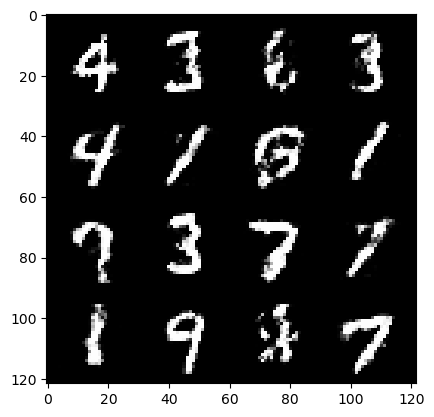

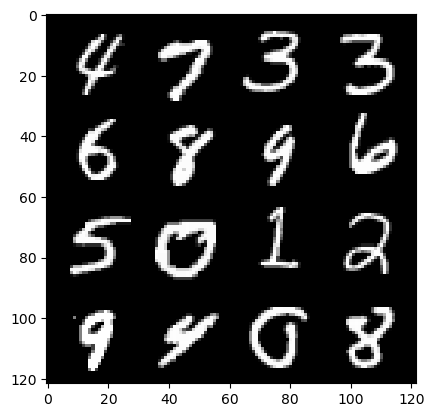

268: step 126000 / Gen loss: 1.4331969157854716 / disc_loss: 0.4203467446565626


  0%|          | 0/469 [00:00<?, ?it/s]

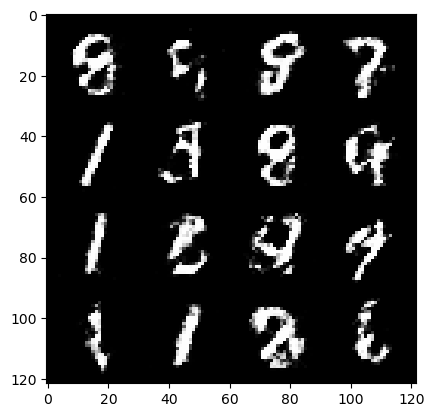

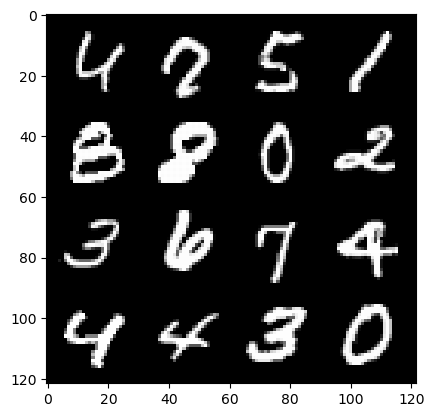

269: step 126300 / Gen loss: 1.3456826253732042 / disc_loss: 0.4336130659778913


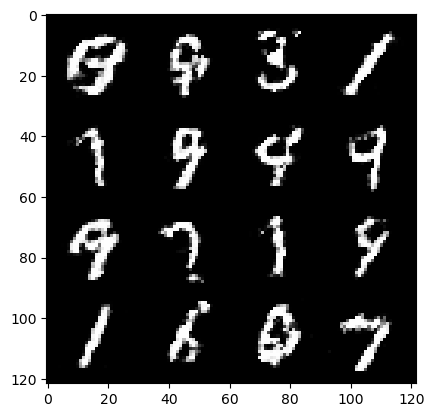

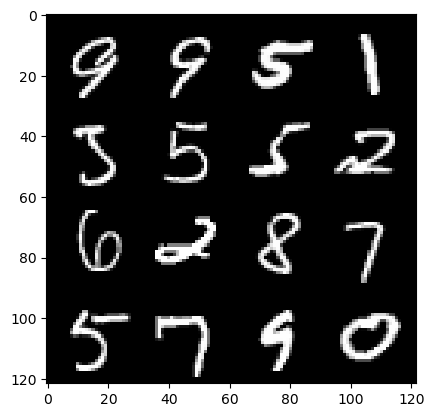

269: step 126600 / Gen loss: 1.3599629684289296 / disc_loss: 0.4318421516815822


  0%|          | 0/469 [00:00<?, ?it/s]

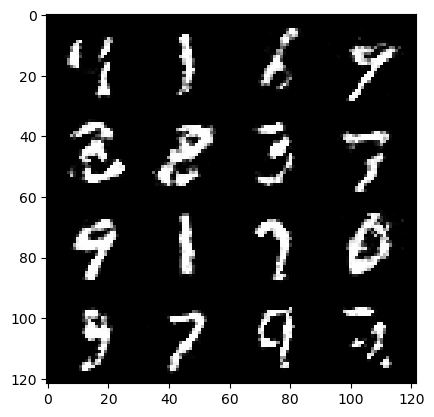

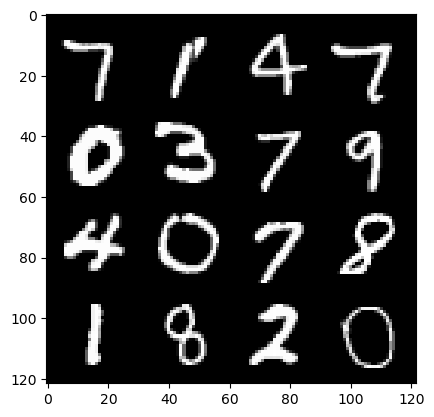

270: step 126900 / Gen loss: 1.3774152326583866 / disc_loss: 0.433172398606936


  0%|          | 0/469 [00:00<?, ?it/s]

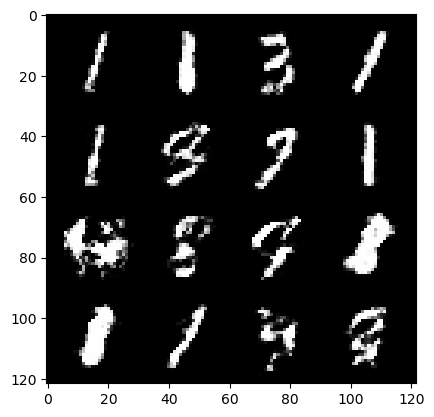

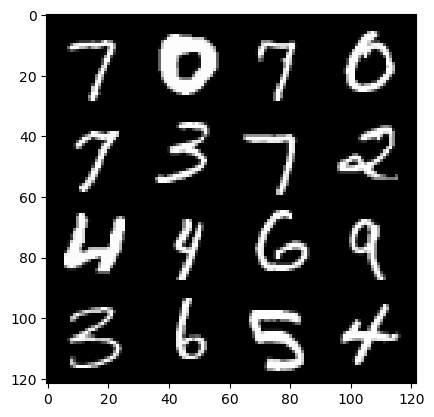

271: step 127200 / Gen loss: 1.428381377855936 / disc_loss: 0.4185540684064232


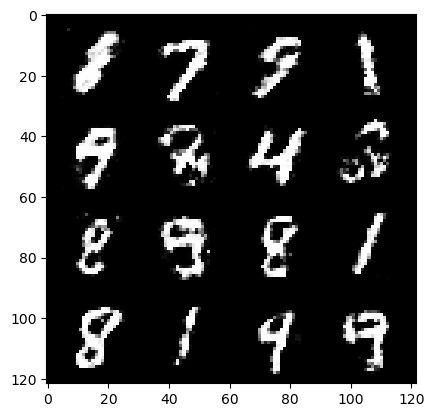

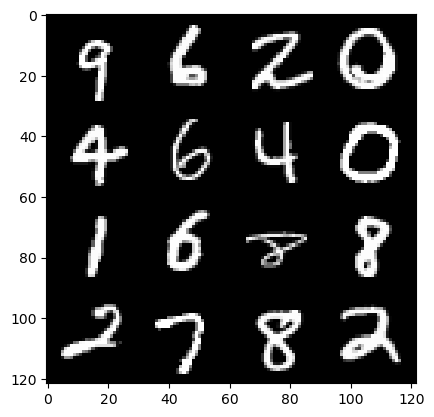

271: step 127500 / Gen loss: 1.4529910242557524 / disc_loss: 0.4152761053045592


  0%|          | 0/469 [00:00<?, ?it/s]

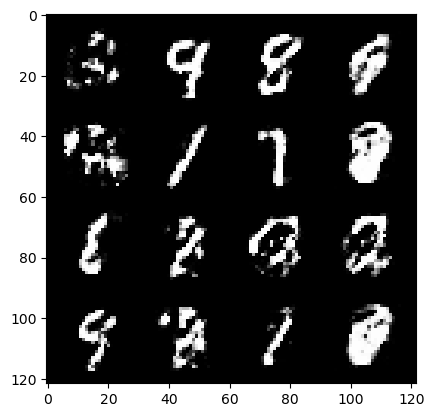

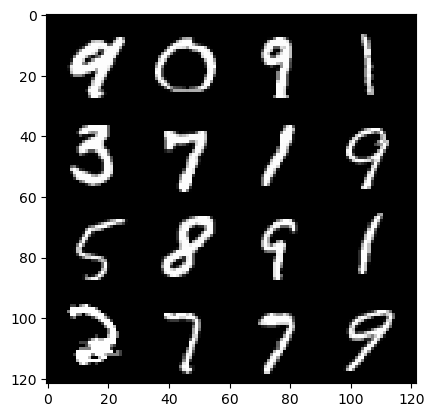

272: step 127800 / Gen loss: 1.382086282968522 / disc_loss: 0.4305571098128954


  0%|          | 0/469 [00:00<?, ?it/s]

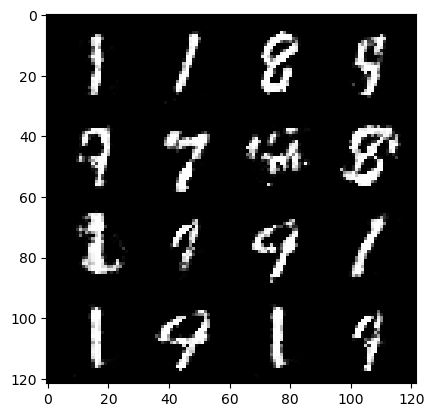

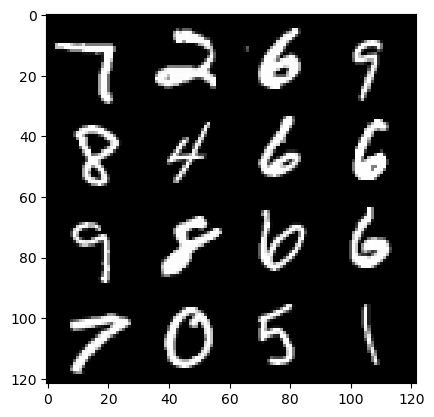

273: step 128100 / Gen loss: 1.399499751329423 / disc_loss: 0.4146049543221793


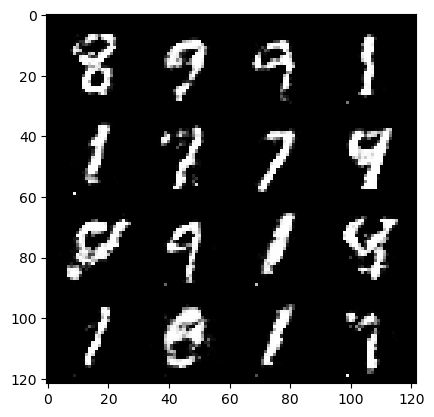

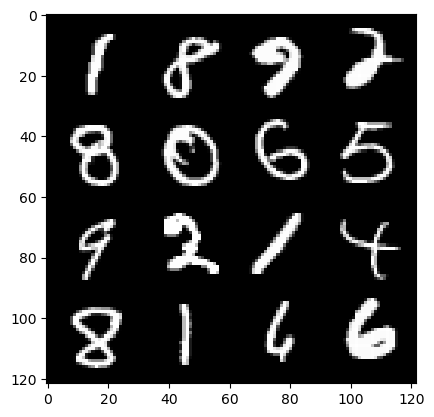

273: step 128400 / Gen loss: 1.3032457212607074 / disc_loss: 0.44674396574497266


  0%|          | 0/469 [00:00<?, ?it/s]

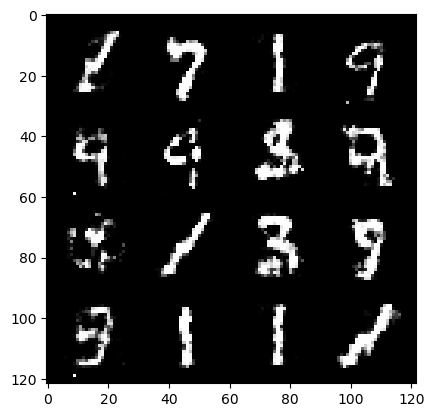

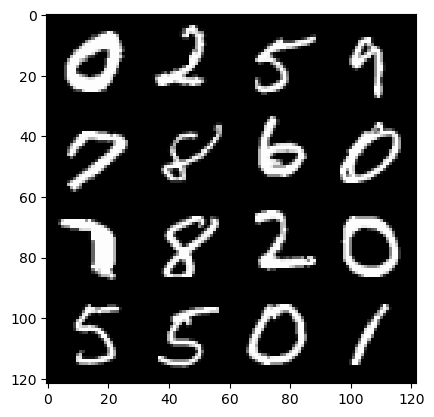

274: step 128700 / Gen loss: 1.1812887322902685 / disc_loss: 0.4790923056006432


  0%|          | 0/469 [00:00<?, ?it/s]

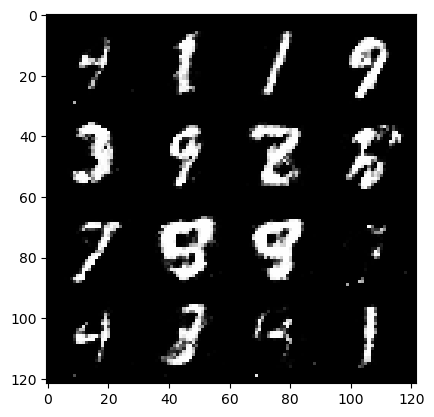

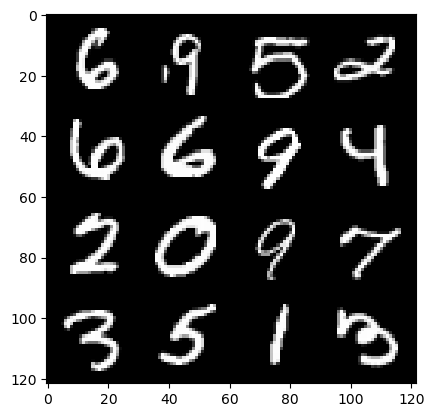

275: step 129000 / Gen loss: 1.0937343833843867 / disc_loss: 0.5037709867954252


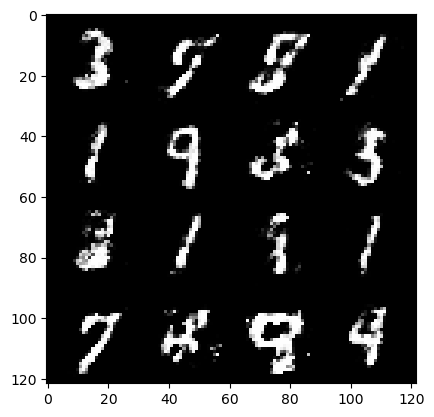

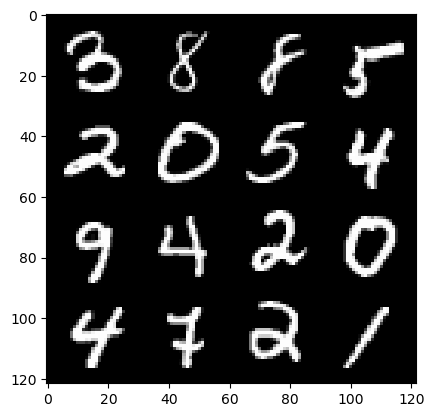

275: step 129300 / Gen loss: 1.1794987605015441 / disc_loss: 0.47146804124116887


  0%|          | 0/469 [00:00<?, ?it/s]

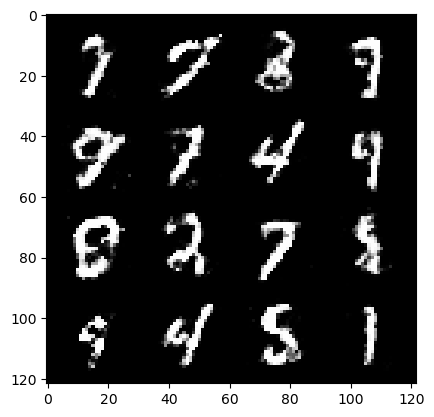

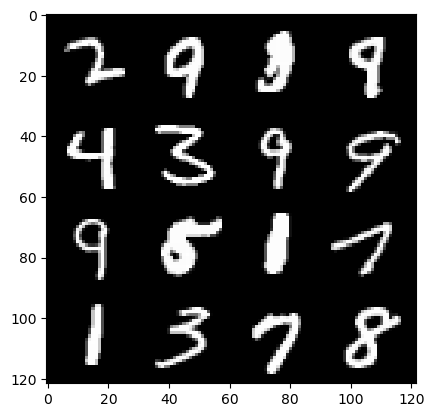

276: step 129600 / Gen loss: 1.2191245989004766 / disc_loss: 0.4604042763511338


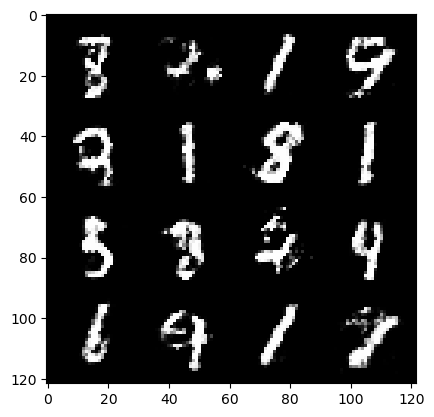

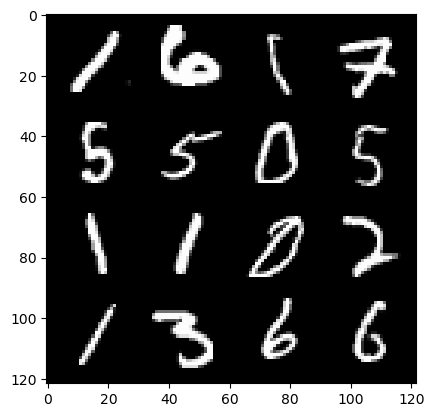

276: step 129900 / Gen loss: 1.2489024229844408 / disc_loss: 0.4684541355570159


  0%|          | 0/469 [00:00<?, ?it/s]

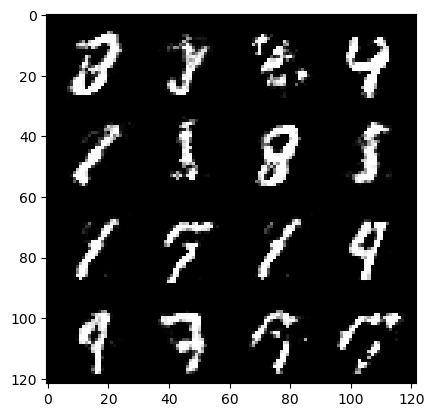

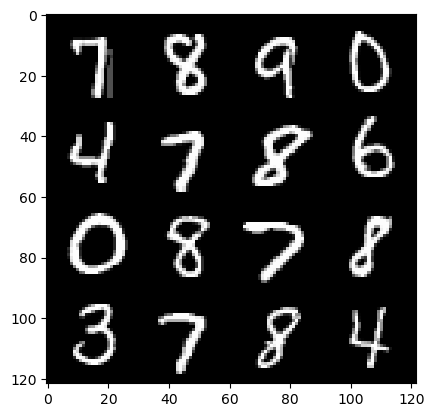

277: step 130200 / Gen loss: 1.351264681021373 / disc_loss: 0.4407688531279561


  0%|          | 0/469 [00:00<?, ?it/s]

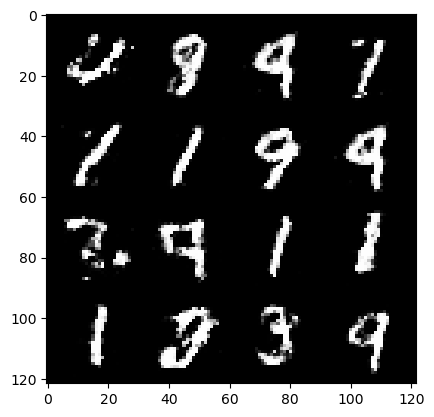

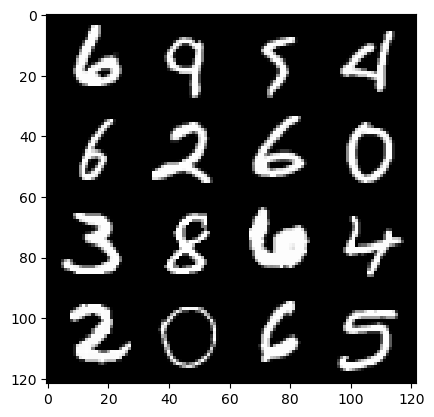

278: step 130500 / Gen loss: 1.3673477764924358 / disc_loss: 0.44298698196808545


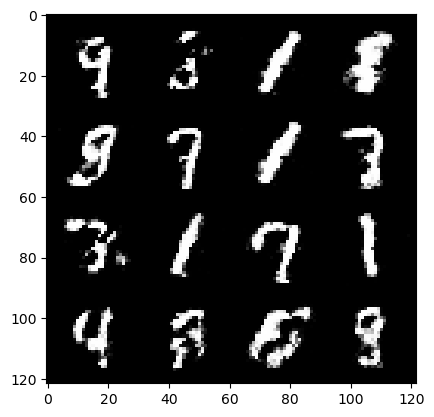

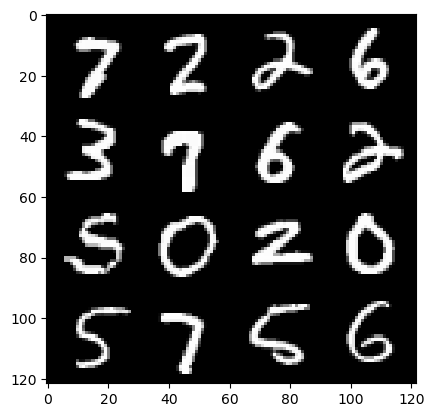

278: step 130800 / Gen loss: 1.4152153507868457 / disc_loss: 0.44209931045770634


  0%|          | 0/469 [00:00<?, ?it/s]

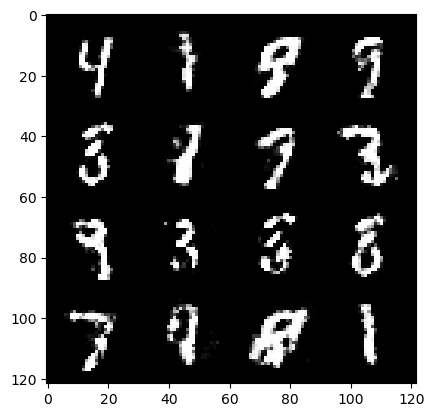

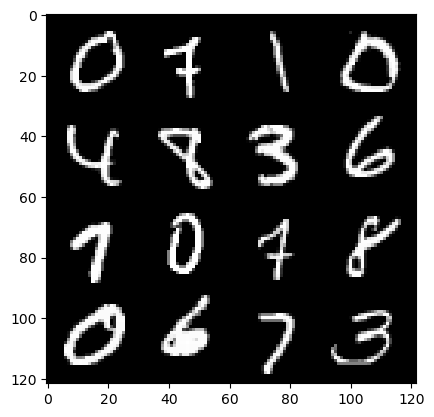

279: step 131100 / Gen loss: 1.4279009544849401 / disc_loss: 0.43083830555280045


  0%|          | 0/469 [00:00<?, ?it/s]

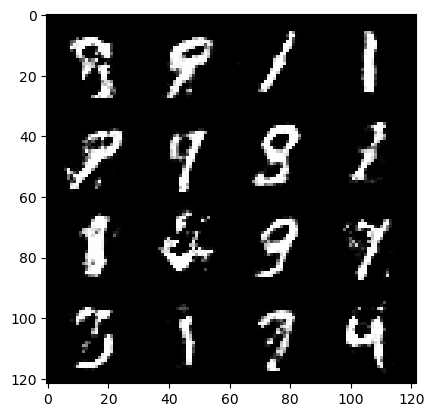

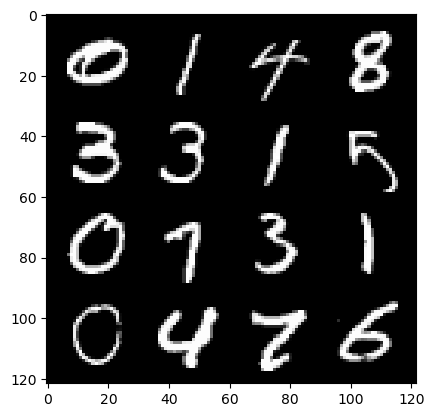

280: step 131400 / Gen loss: 1.441277465025584 / disc_loss: 0.42540887544552475


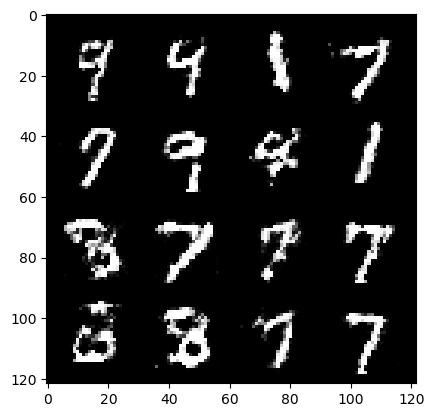

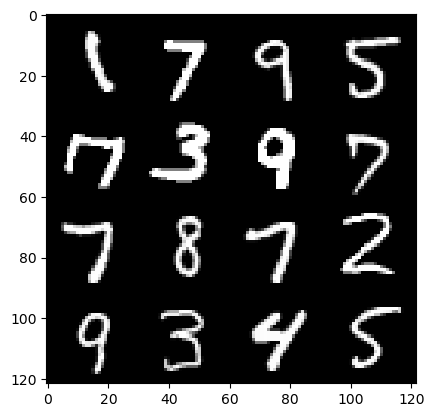

280: step 131700 / Gen loss: 1.4079218892256422 / disc_loss: 0.4373918586969377


  0%|          | 0/469 [00:00<?, ?it/s]

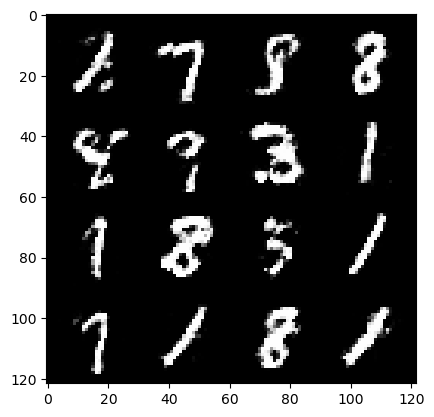

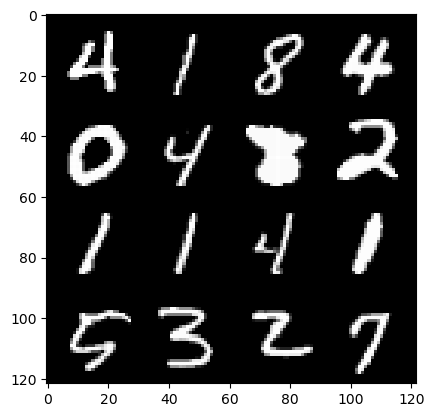

281: step 132000 / Gen loss: 1.386087549527486 / disc_loss: 0.42669069478909194


  0%|          | 0/469 [00:00<?, ?it/s]

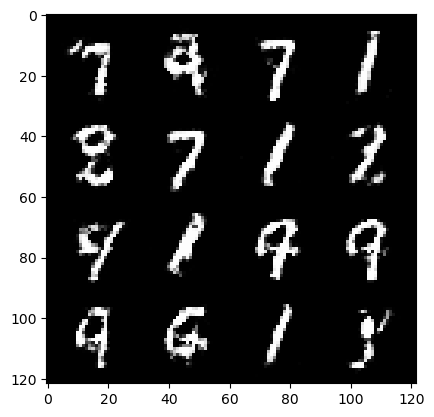

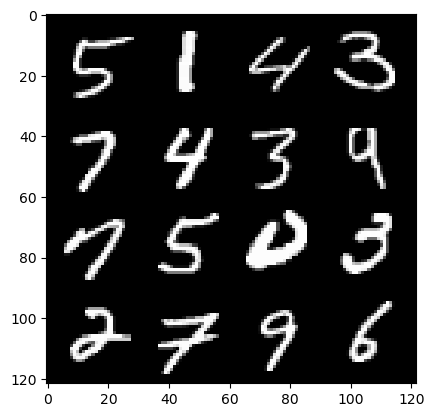

282: step 132300 / Gen loss: 1.4021867088476823 / disc_loss: 0.4289324758450189


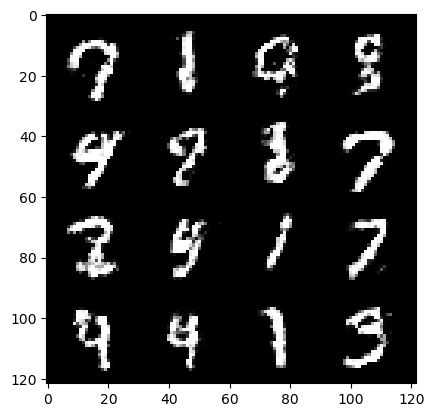

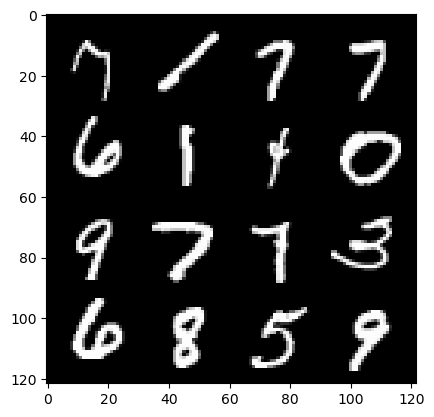

282: step 132600 / Gen loss: 1.4587920300165804 / disc_loss: 0.4221868495146433


  0%|          | 0/469 [00:00<?, ?it/s]

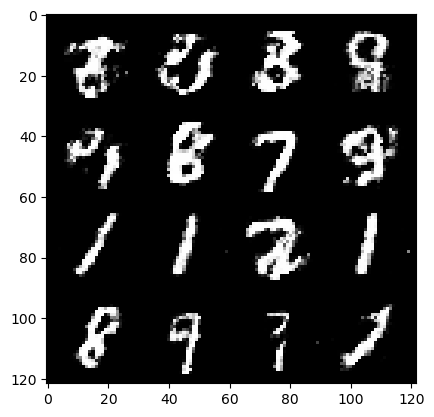

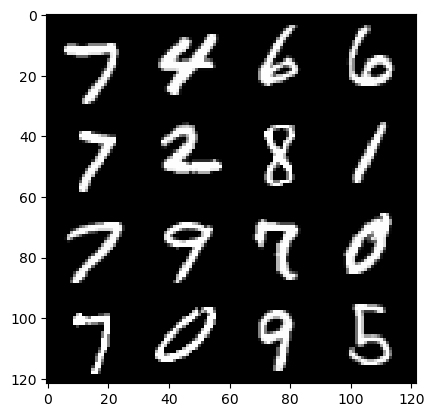

283: step 132900 / Gen loss: 1.3283744204044345 / disc_loss: 0.45133765240510304


  0%|          | 0/469 [00:00<?, ?it/s]

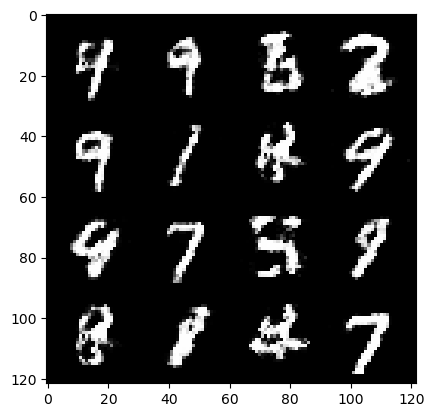

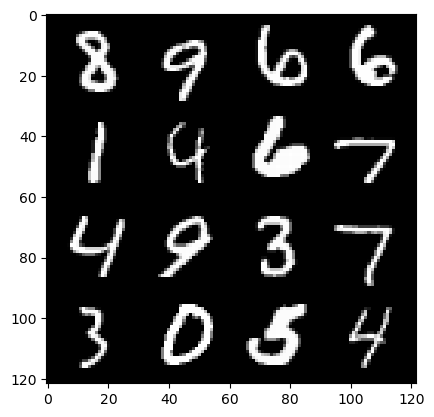

284: step 133200 / Gen loss: 1.1630431967973702 / disc_loss: 0.499294058481852


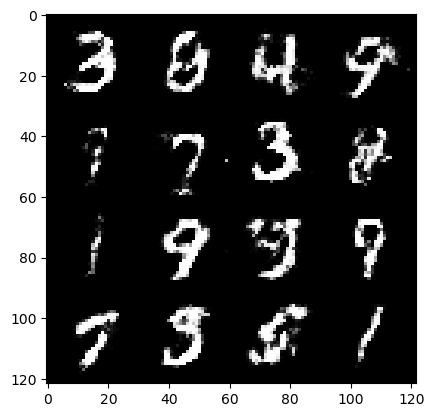

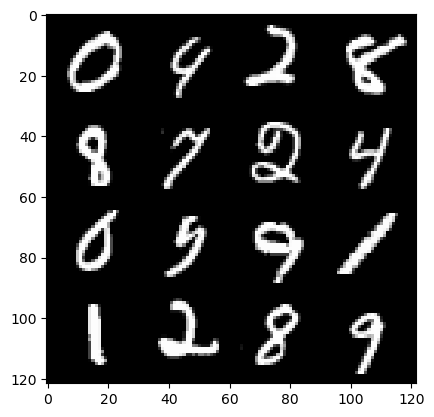

284: step 133500 / Gen loss: 1.1627977124849966 / disc_loss: 0.4786267418662709


  0%|          | 0/469 [00:00<?, ?it/s]

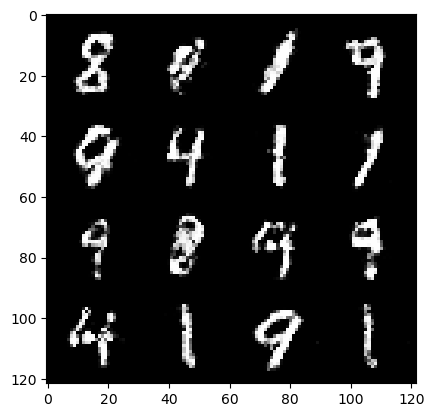

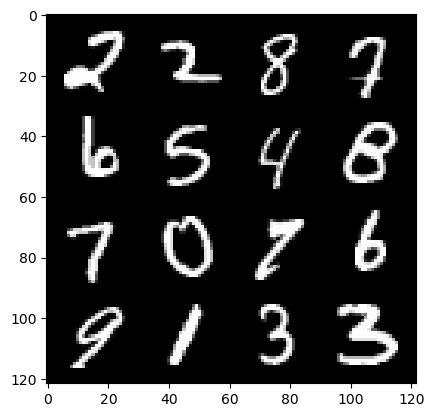

285: step 133800 / Gen loss: 1.1892081546783453 / disc_loss: 0.4740211278200148


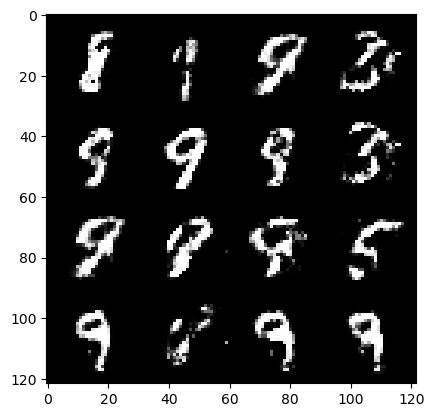

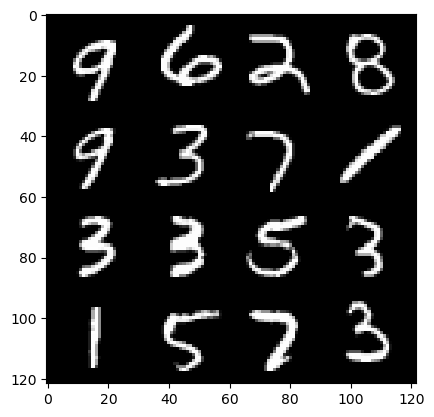

285: step 134100 / Gen loss: 1.2295028249422713 / disc_loss: 0.4584417923291527


  0%|          | 0/469 [00:00<?, ?it/s]

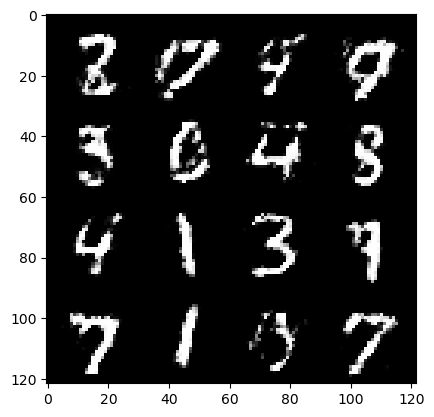

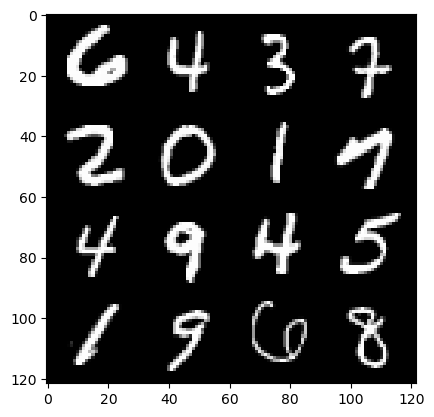

286: step 134400 / Gen loss: 1.3408827225367221 / disc_loss: 0.43555354128281265


  0%|          | 0/469 [00:00<?, ?it/s]

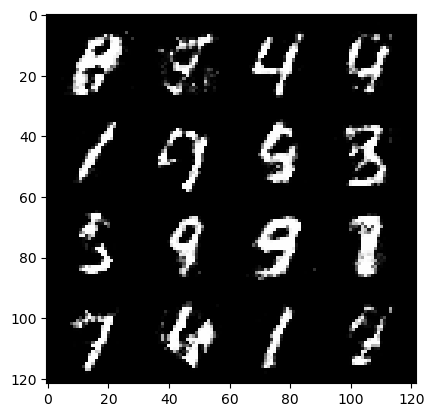

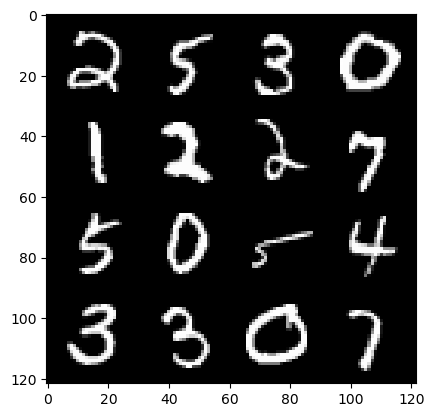

287: step 134700 / Gen loss: 1.3610680882136026 / disc_loss: 0.44961026479800564


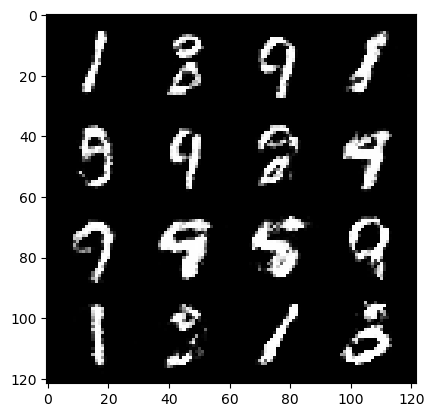

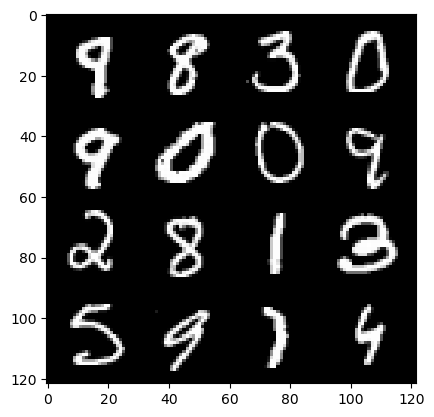

287: step 135000 / Gen loss: 1.4313918801148726 / disc_loss: 0.4327687468131383


  0%|          | 0/469 [00:00<?, ?it/s]

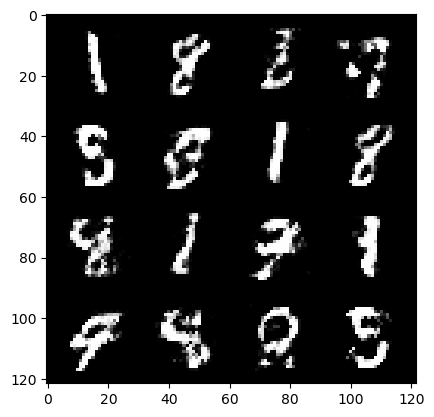

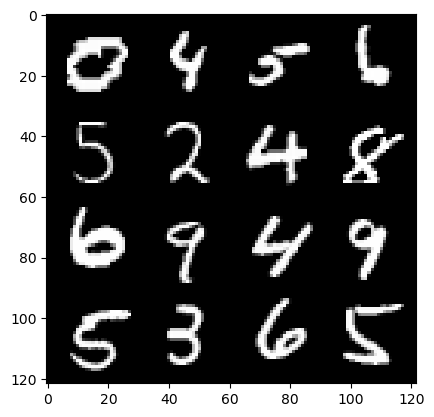

288: step 135300 / Gen loss: 1.4719662527243302 / disc_loss: 0.42830544769763906


  0%|          | 0/469 [00:00<?, ?it/s]

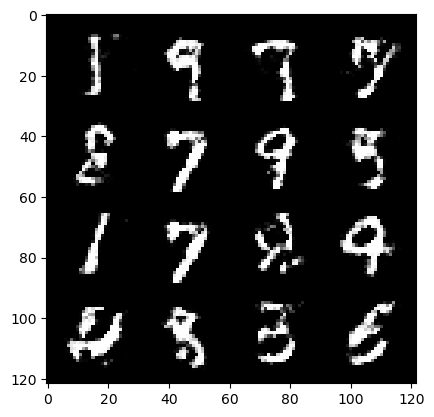

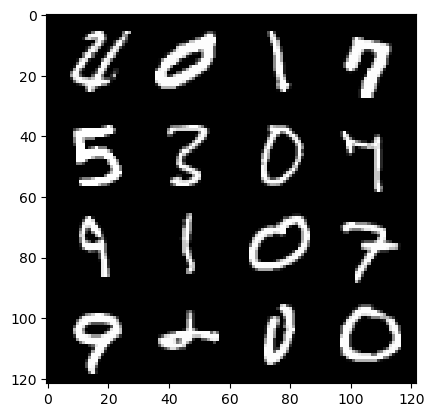

289: step 135600 / Gen loss: 1.460322852134706 / disc_loss: 0.42539792378743485


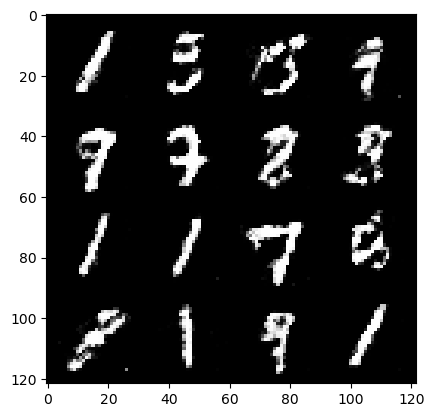

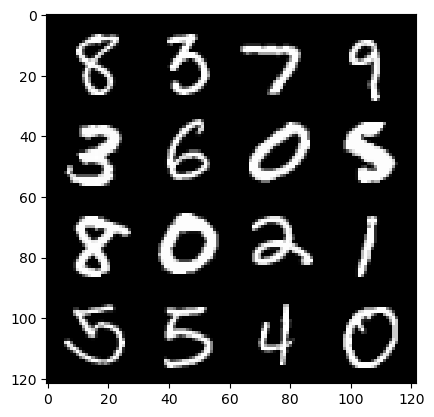

289: step 135900 / Gen loss: 1.5229237294197084 / disc_loss: 0.4147754472494124


  0%|          | 0/469 [00:00<?, ?it/s]

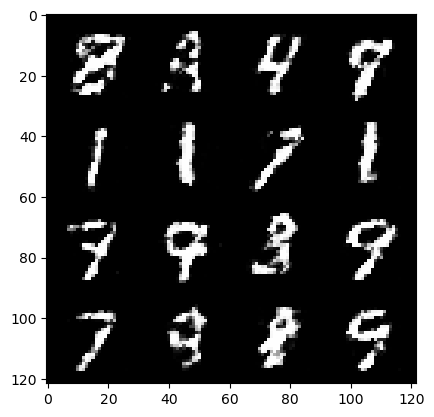

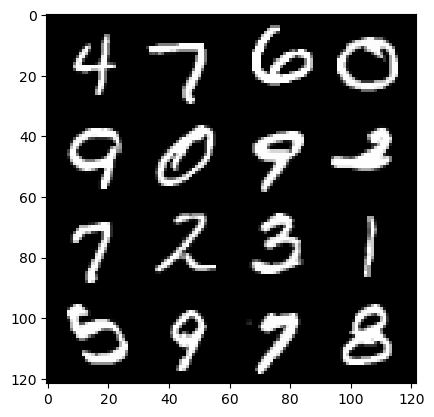

290: step 136200 / Gen loss: 1.4612514897187552 / disc_loss: 0.4156963110963503


  0%|          | 0/469 [00:00<?, ?it/s]

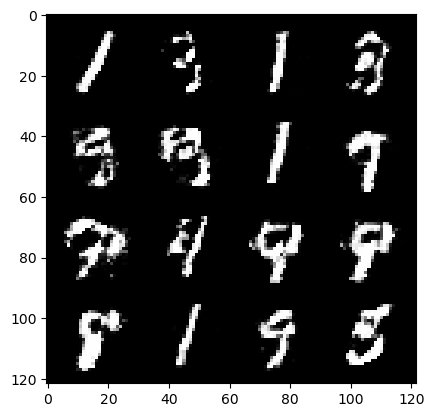

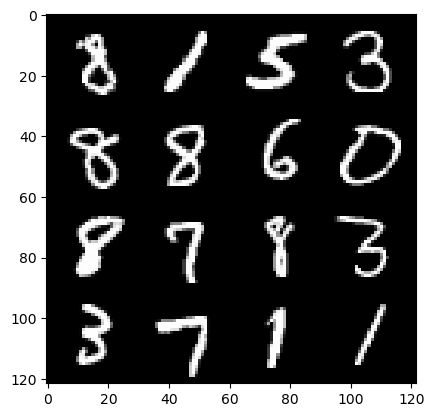

291: step 136500 / Gen loss: 1.4499540030956268 / disc_loss: 0.4207712335387868


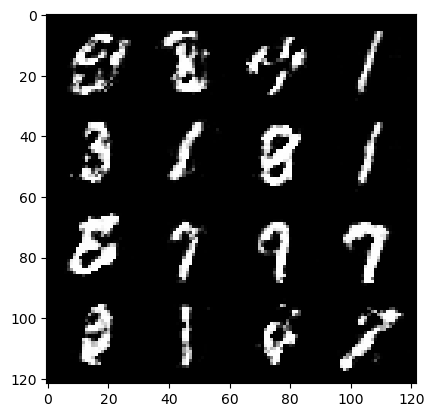

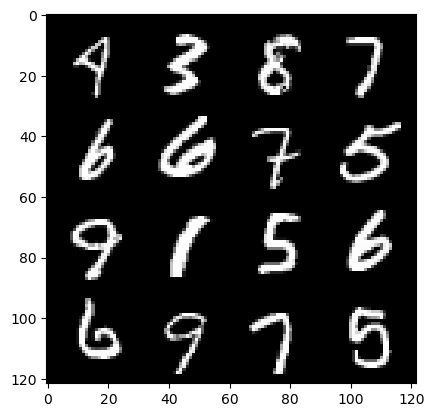

291: step 136800 / Gen loss: 1.3738681375980377 / disc_loss: 0.4409706118702891


  0%|          | 0/469 [00:00<?, ?it/s]

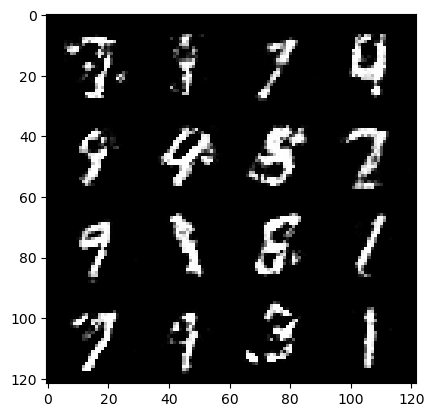

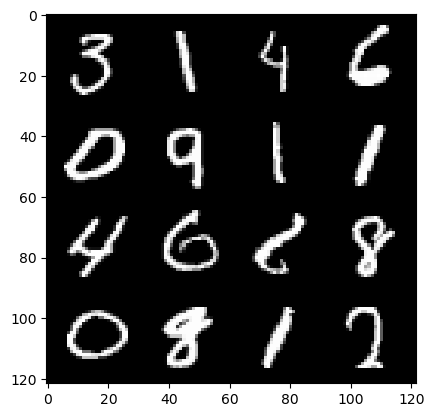

292: step 137100 / Gen loss: 1.3527080766359971 / disc_loss: 0.44172353804111497


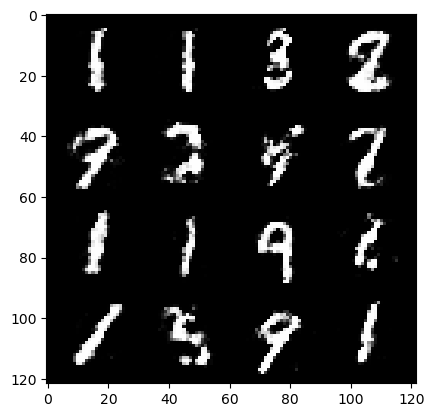

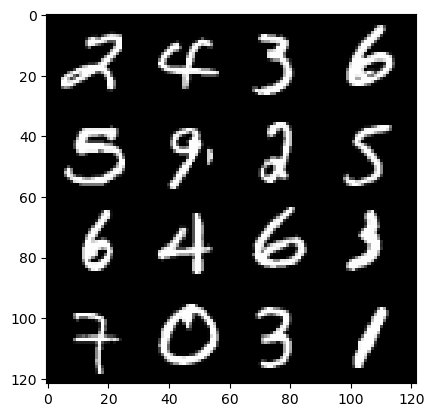

292: step 137400 / Gen loss: 1.37541805466016 / disc_loss: 0.43325725932916


  0%|          | 0/469 [00:00<?, ?it/s]

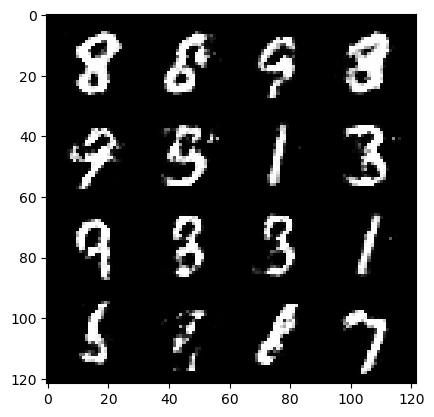

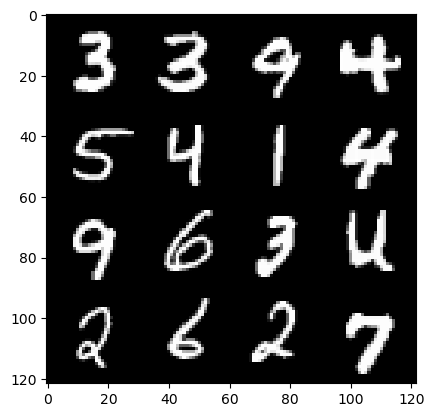

293: step 137700 / Gen loss: 1.3743358155091605 / disc_loss: 0.43545983652273806


  0%|          | 0/469 [00:00<?, ?it/s]

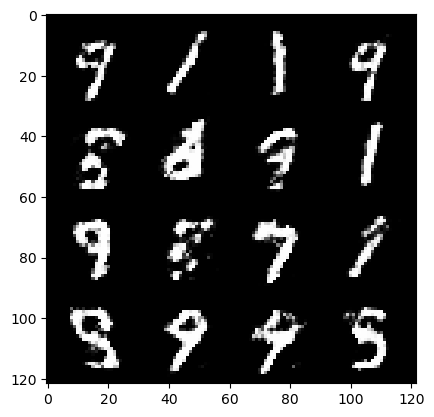

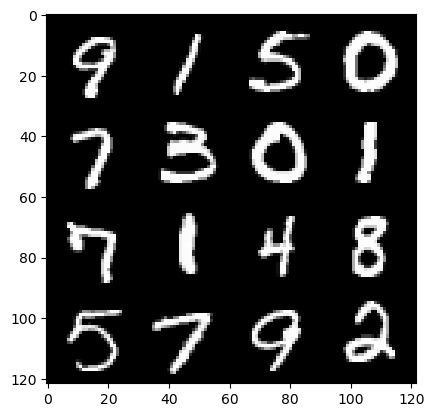

294: step 138000 / Gen loss: 1.3962144370873786 / disc_loss: 0.4319705190261205


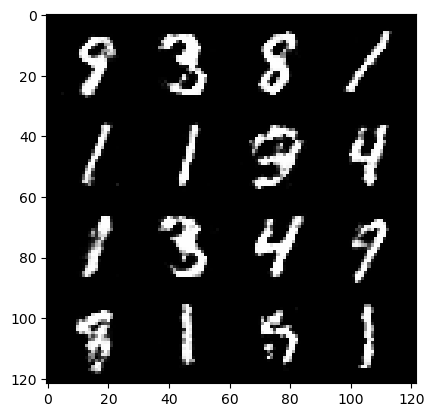

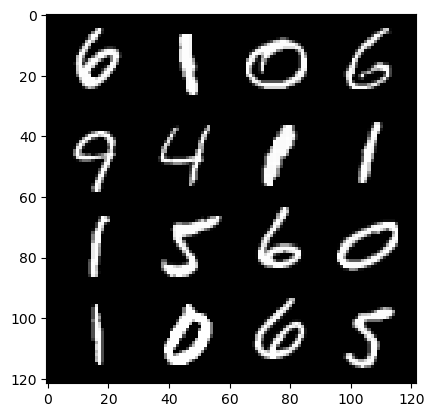

294: step 138300 / Gen loss: 1.3921354321638728 / disc_loss: 0.43304451773564023


  0%|          | 0/469 [00:00<?, ?it/s]

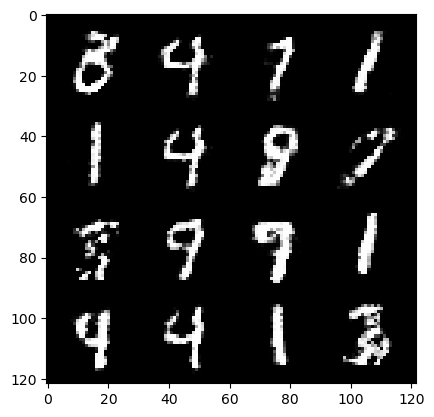

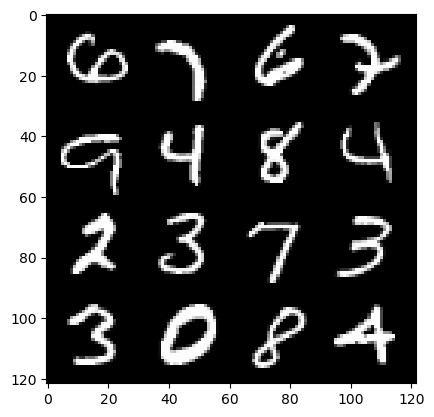

295: step 138600 / Gen loss: 1.39536202788353 / disc_loss: 0.4313740789890291


  0%|          | 0/469 [00:00<?, ?it/s]

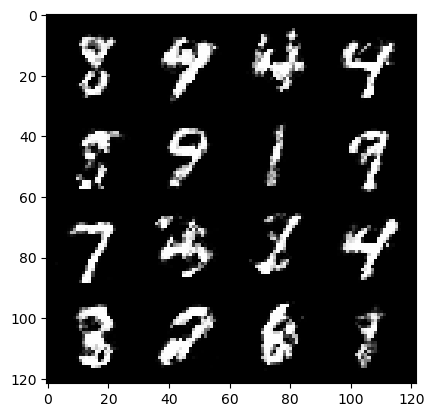

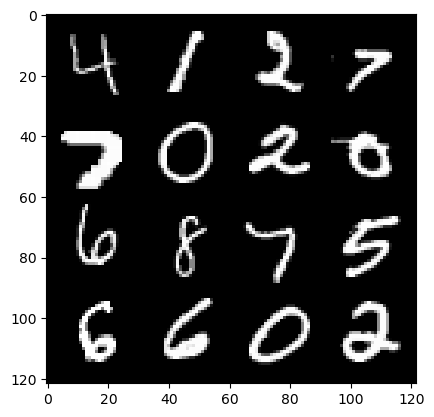

296: step 138900 / Gen loss: 1.4136809849739076 / disc_loss: 0.4286632961034773


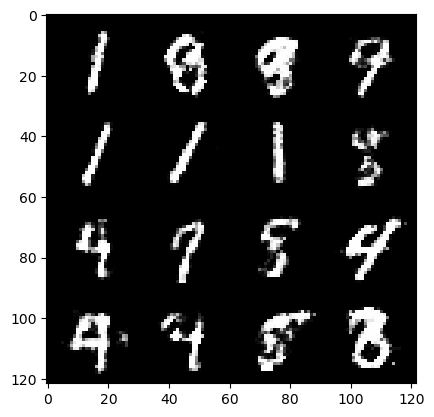

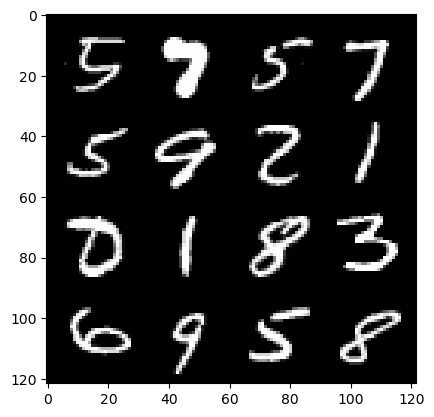

296: step 139200 / Gen loss: 1.3645147438844045 / disc_loss: 0.43299344380696625


  0%|          | 0/469 [00:00<?, ?it/s]

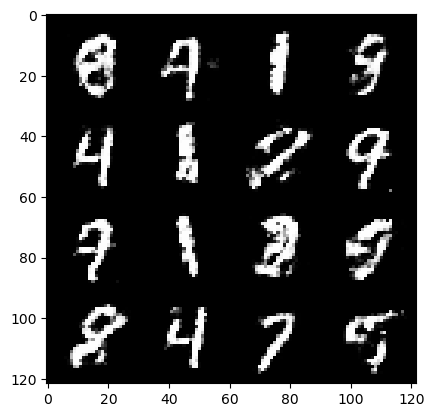

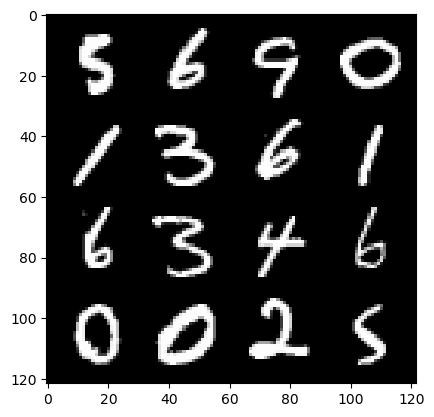

297: step 139500 / Gen loss: 1.358982810974122 / disc_loss: 0.43256808121999124


  0%|          | 0/469 [00:00<?, ?it/s]

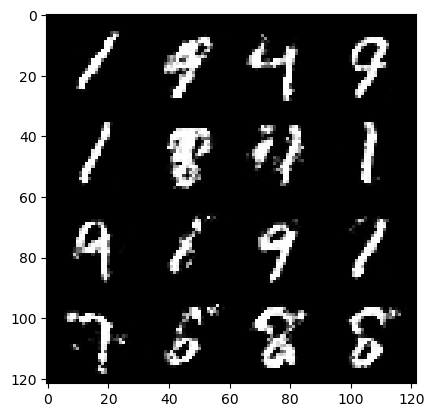

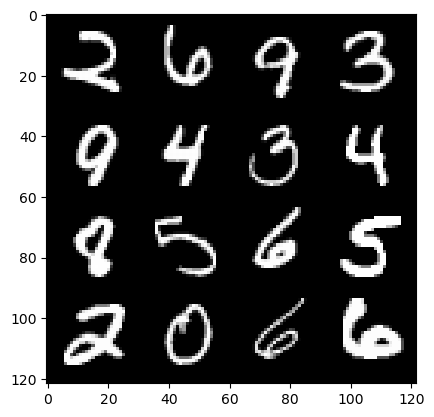

298: step 139800 / Gen loss: 1.3899763969580339 / disc_loss: 0.4319477160771691


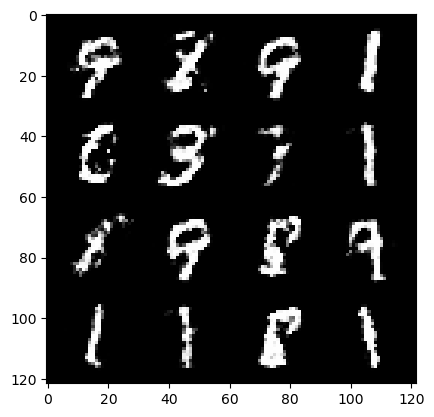

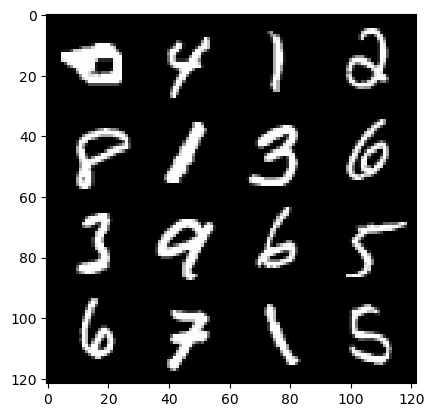

298: step 140100 / Gen loss: 1.4314017113049833 / disc_loss: 0.4227675115068753


  0%|          | 0/469 [00:00<?, ?it/s]

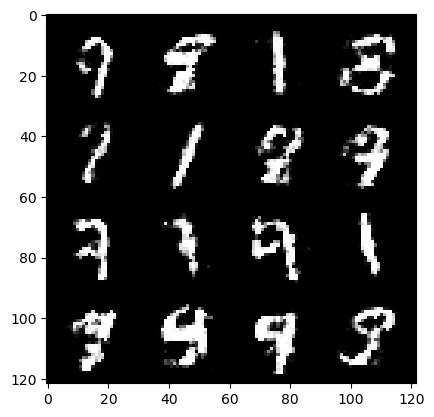

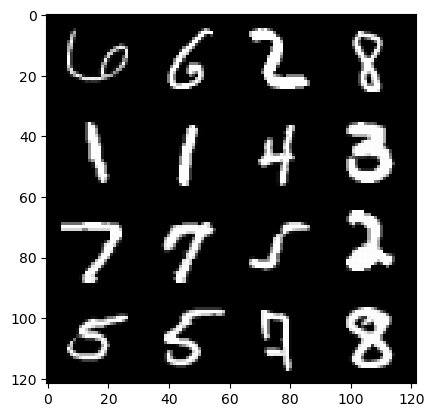

299: step 140400 / Gen loss: 1.4410017406940456 / disc_loss: 0.41541018237670274


  0%|          | 0/469 [00:00<?, ?it/s]

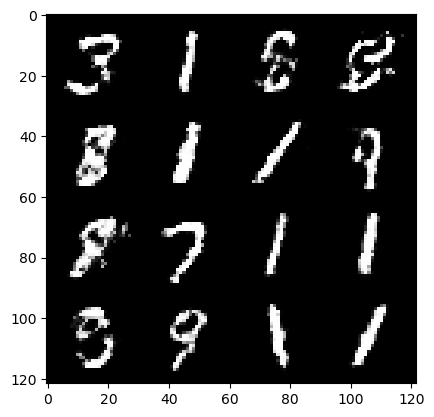

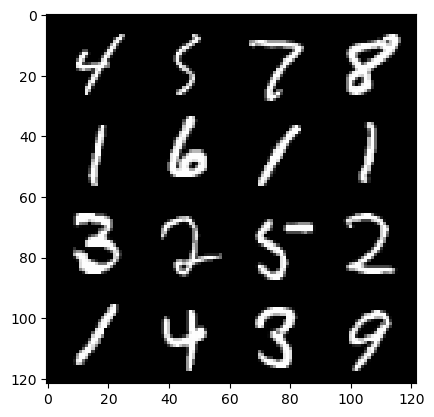

300: step 140700 / Gen loss: 1.4436642126242318 / disc_loss: 0.41887417137622845


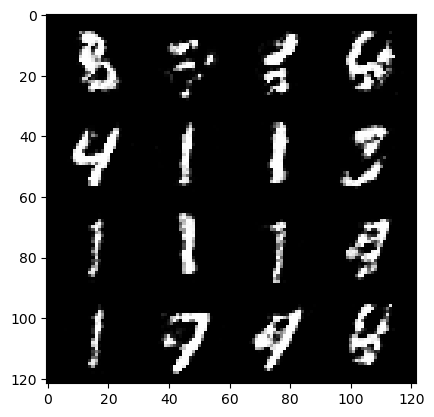

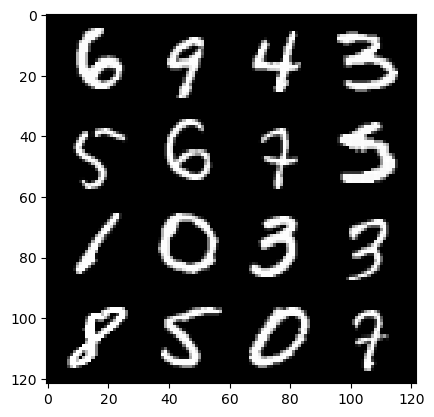

300: step 141000 / Gen loss: 1.4111181183656054 / disc_loss: 0.4307542757193244


  0%|          | 0/469 [00:00<?, ?it/s]

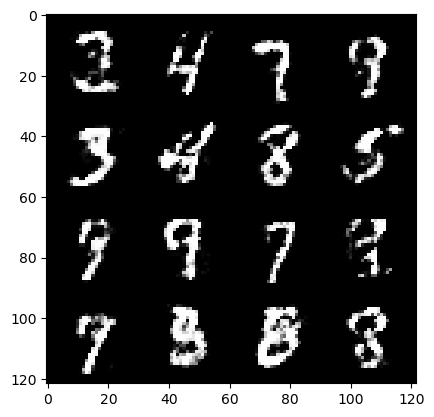

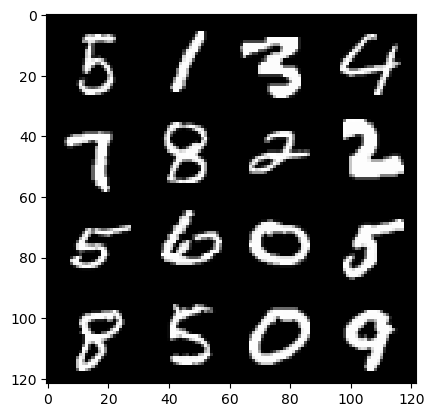

301: step 141300 / Gen loss: 1.429089438517888 / disc_loss: 0.41572604238986993


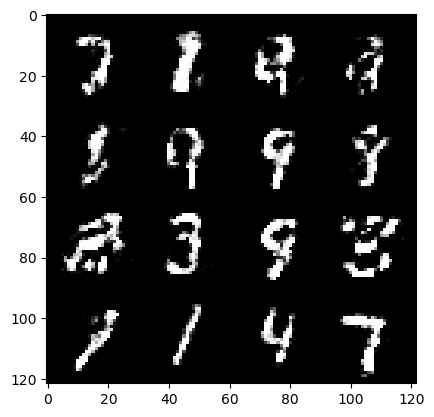

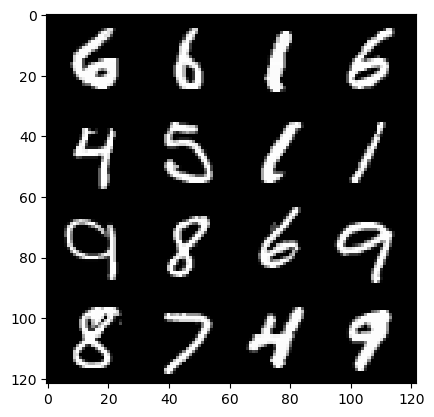

301: step 141600 / Gen loss: 1.4671624581019076 / disc_loss: 0.4118494158983229


  0%|          | 0/469 [00:00<?, ?it/s]

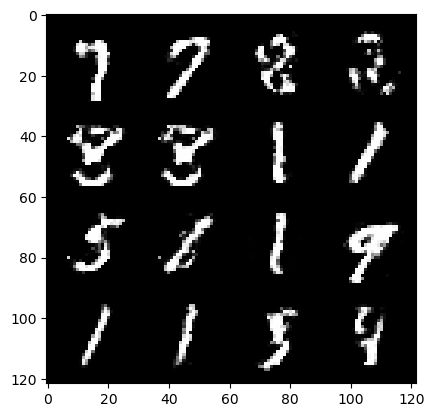

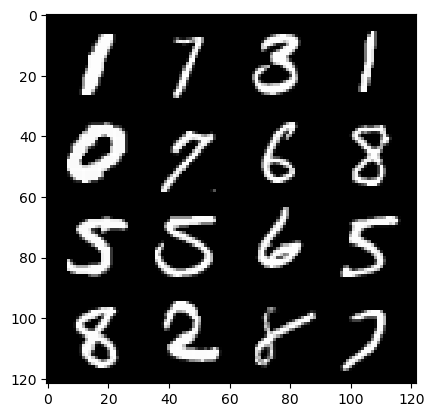

302: step 141900 / Gen loss: 1.43756386200587 / disc_loss: 0.40924390206734346


  0%|          | 0/469 [00:00<?, ?it/s]

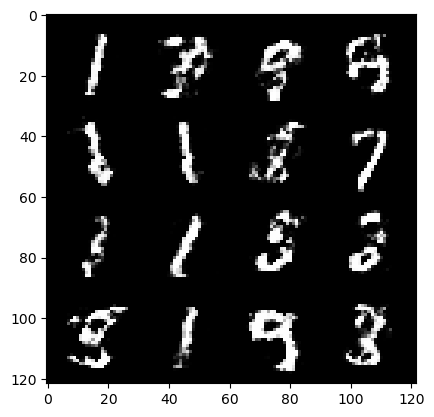

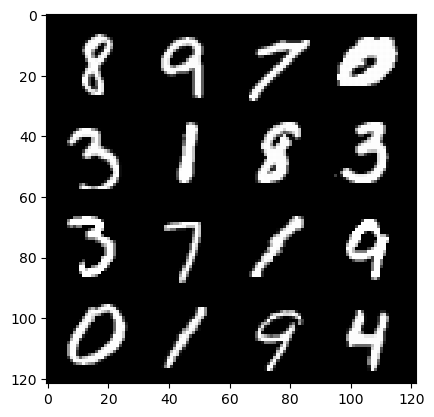

303: step 142200 / Gen loss: 1.4393313078085586 / disc_loss: 0.4075857345263162


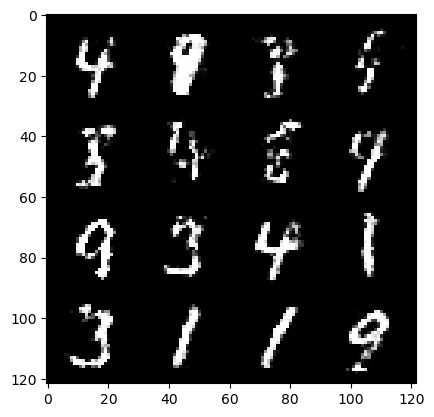

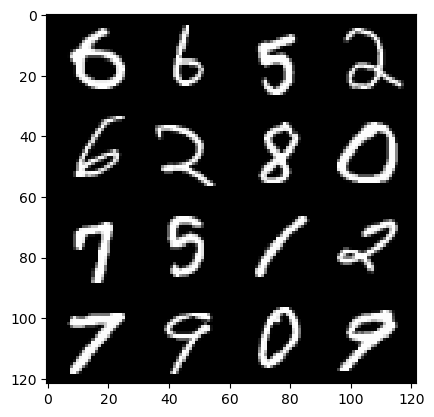

303: step 142500 / Gen loss: 1.4902290685971575 / disc_loss: 0.39671888301769925


  0%|          | 0/469 [00:00<?, ?it/s]

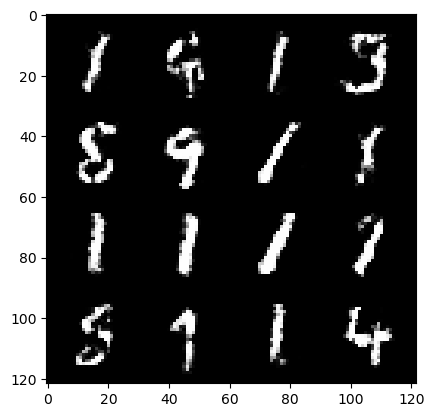

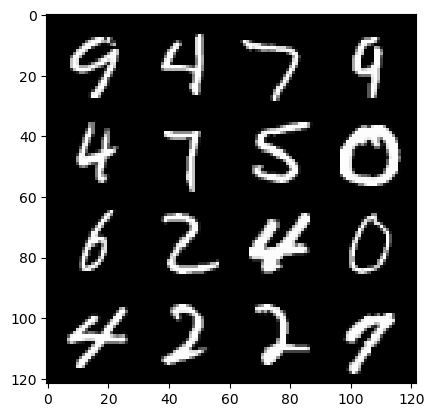

304: step 142800 / Gen loss: 1.454599384864171 / disc_loss: 0.4089307156205177


  0%|          | 0/469 [00:00<?, ?it/s]

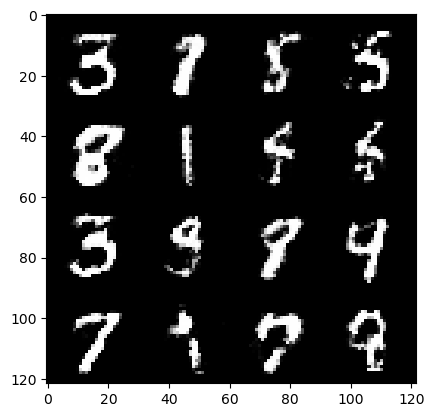

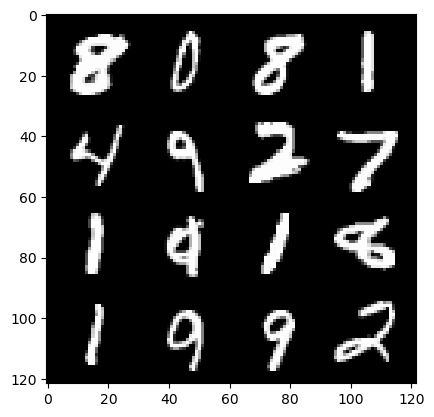

305: step 143100 / Gen loss: 1.457257250150045 / disc_loss: 0.40396964718898104


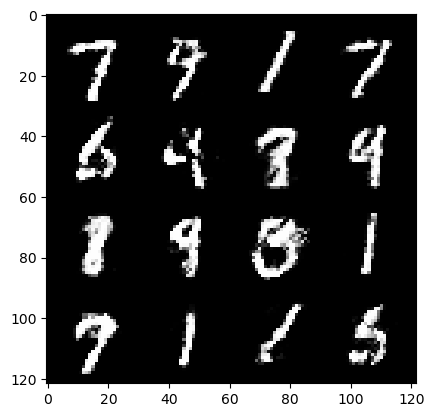

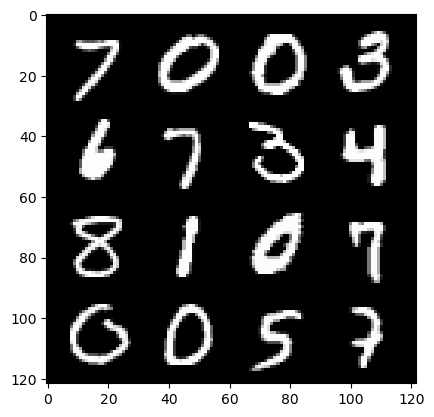

305: step 143400 / Gen loss: 1.4491969803969063 / disc_loss: 0.4113326973716418


  0%|          | 0/469 [00:00<?, ?it/s]

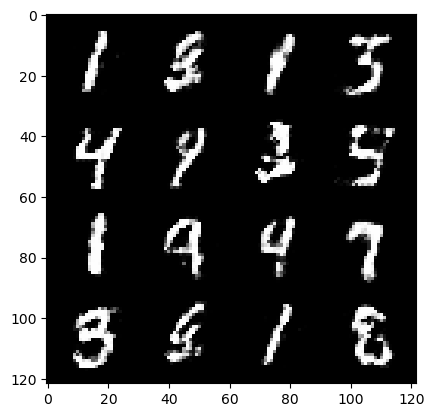

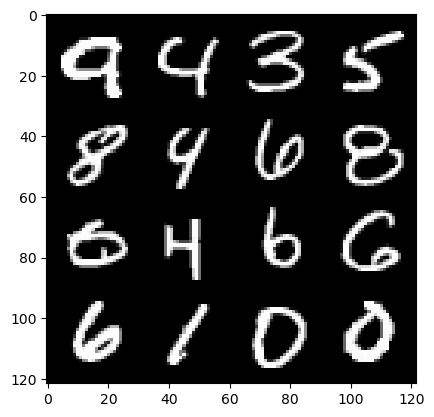

306: step 143700 / Gen loss: 1.4658156303564709 / disc_loss: 0.42318990329901396


  0%|          | 0/469 [00:00<?, ?it/s]

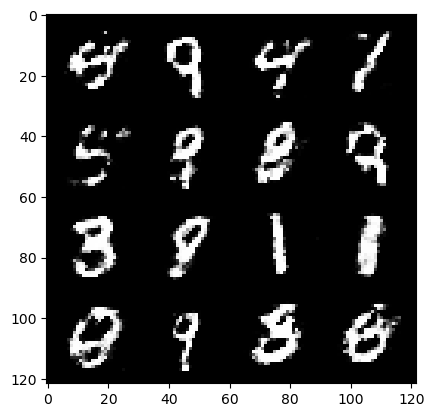

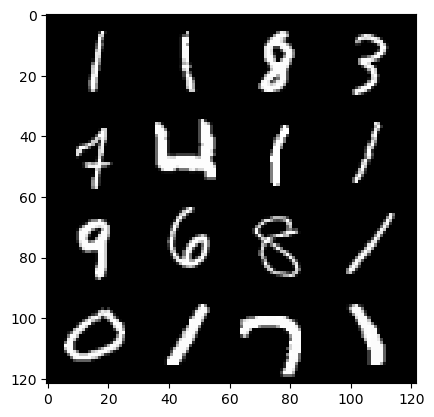

307: step 144000 / Gen loss: 1.4416244637966165 / disc_loss: 0.4236092687646547


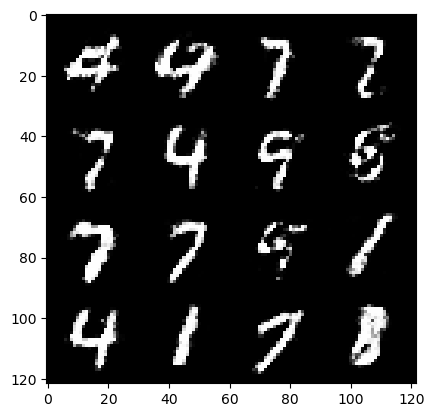

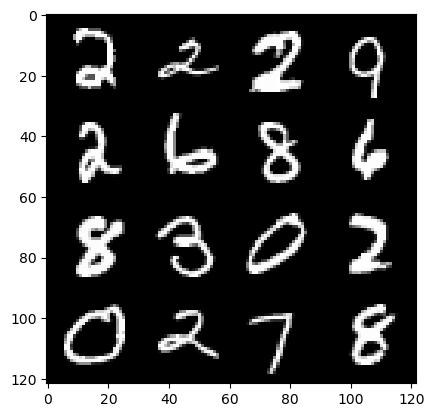

307: step 144300 / Gen loss: 1.4503612093130736 / disc_loss: 0.41478221267461785


  0%|          | 0/469 [00:00<?, ?it/s]

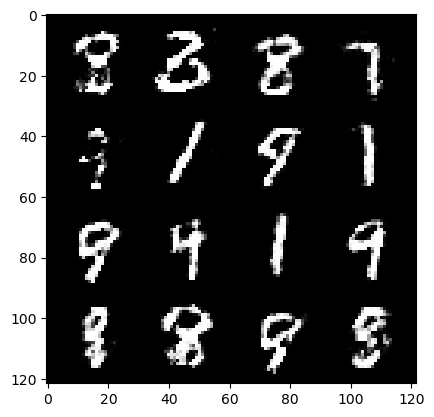

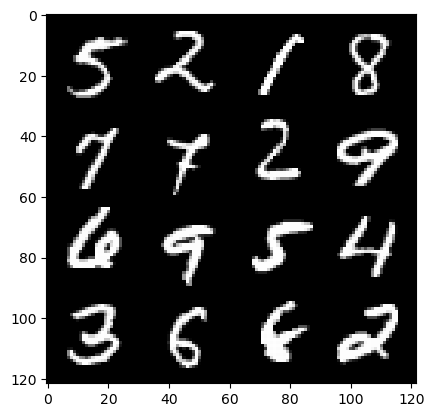

308: step 144600 / Gen loss: 1.4405826548735294 / disc_loss: 0.4103371422489482


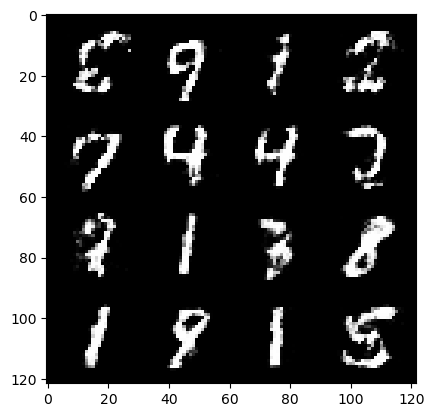

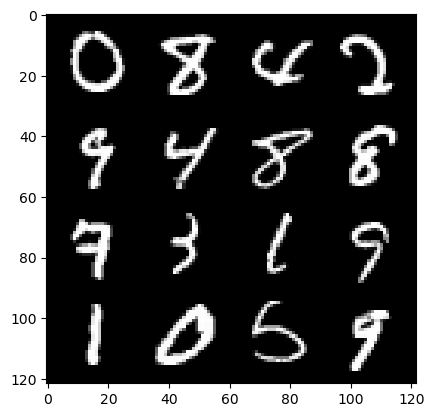

308: step 144900 / Gen loss: 1.3913609604040775 / disc_loss: 0.42374923437833767


  0%|          | 0/469 [00:00<?, ?it/s]

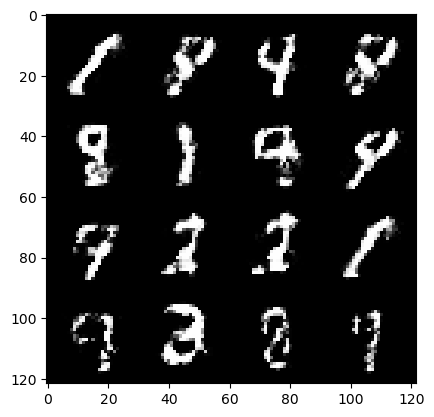

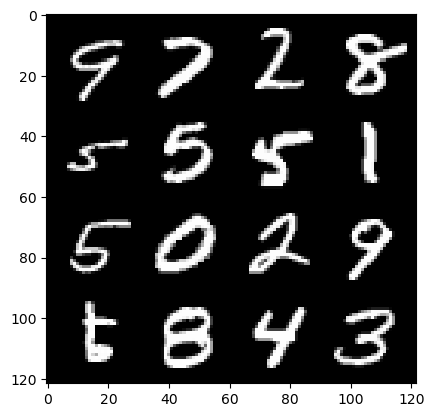

309: step 145200 / Gen loss: 1.3897259263197577 / disc_loss: 0.4223234954476358


  0%|          | 0/469 [00:00<?, ?it/s]

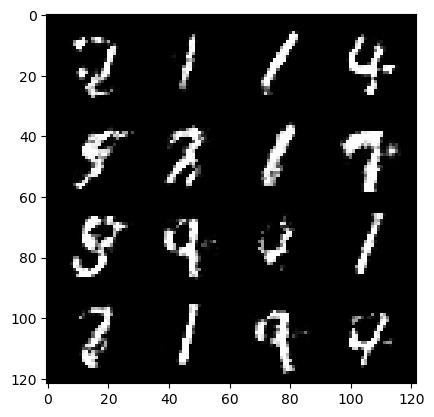

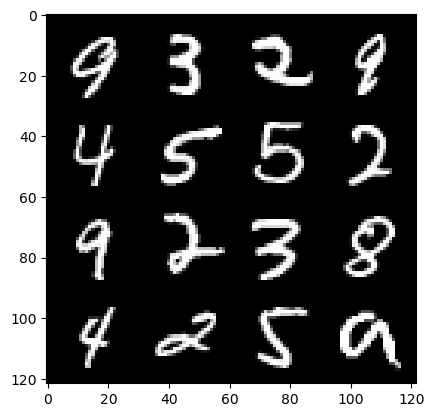

310: step 145500 / Gen loss: 1.4182844221591941 / disc_loss: 0.41548384716113396


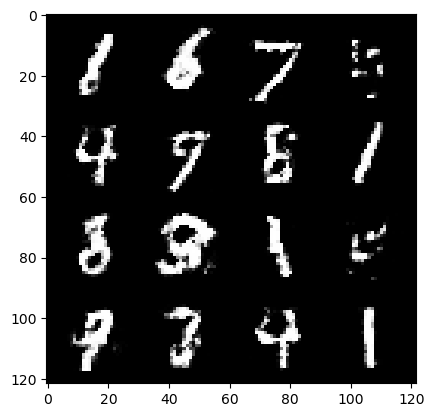

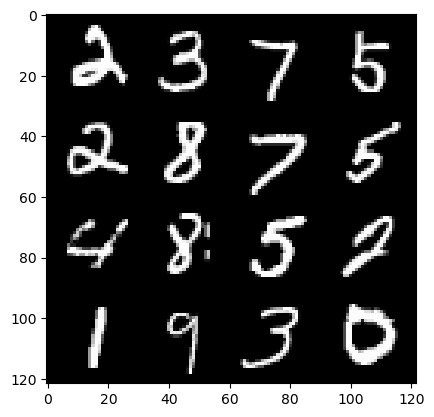

310: step 145800 / Gen loss: 1.4986584885915124 / disc_loss: 0.41417274713516233


  0%|          | 0/469 [00:00<?, ?it/s]

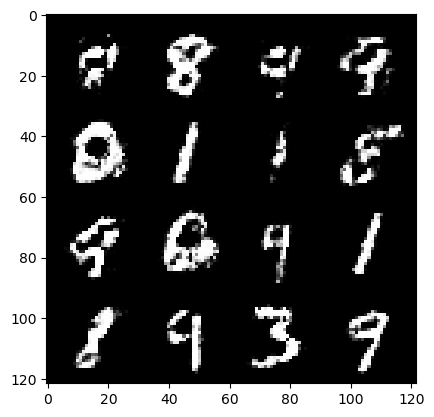

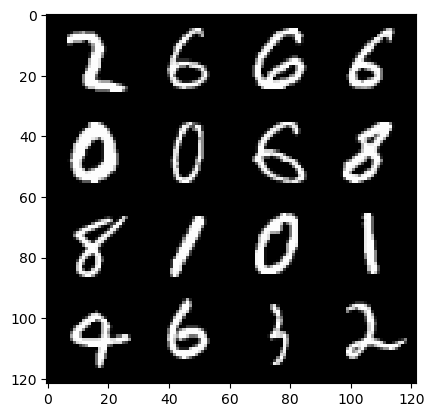

311: step 146100 / Gen loss: 1.451449253161748 / disc_loss: 0.4230863920847577


  0%|          | 0/469 [00:00<?, ?it/s]

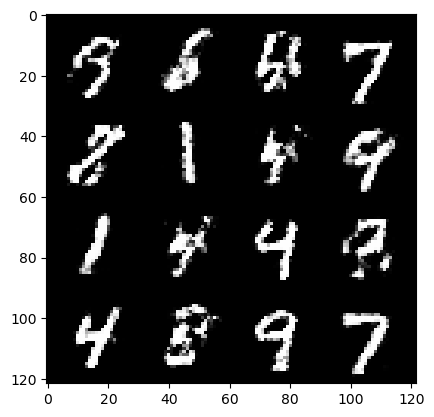

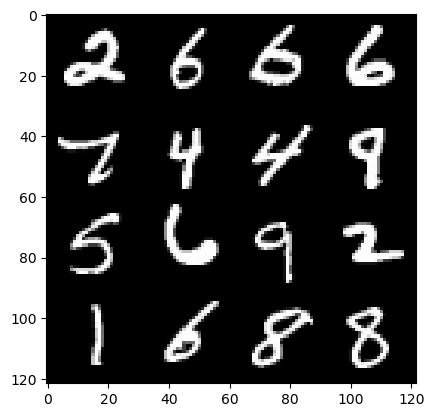

312: step 146400 / Gen loss: 1.426966750621795 / disc_loss: 0.42053241024414706


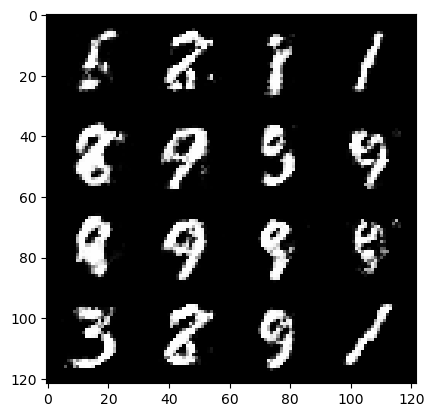

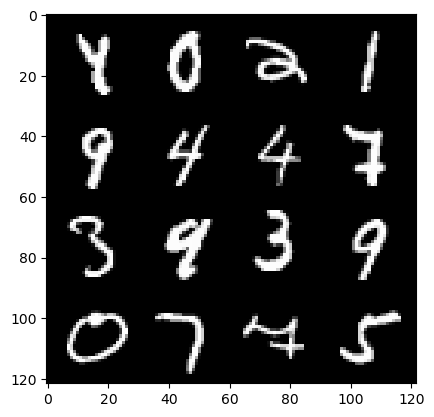

312: step 146700 / Gen loss: 1.492703823645909 / disc_loss: 0.4066591685016949


  0%|          | 0/469 [00:00<?, ?it/s]

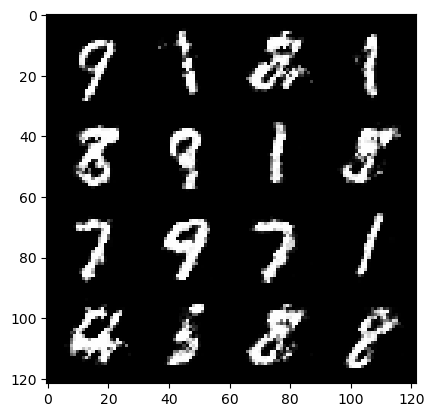

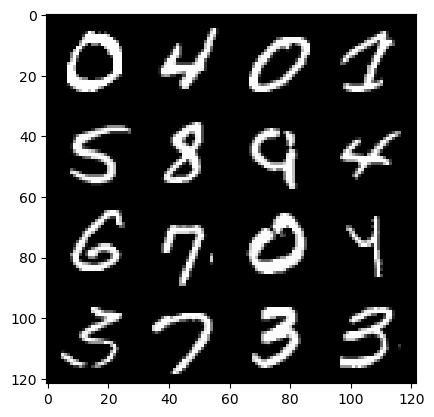

313: step 147000 / Gen loss: 1.5137874424457554 / disc_loss: 0.3852089089155196


  0%|          | 0/469 [00:00<?, ?it/s]

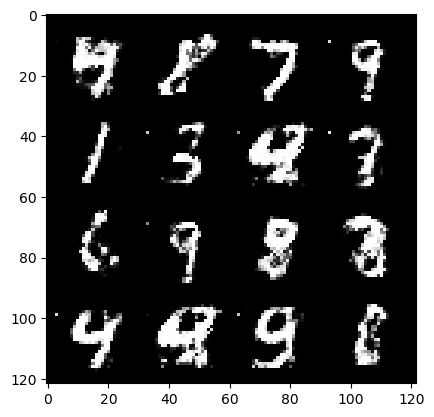

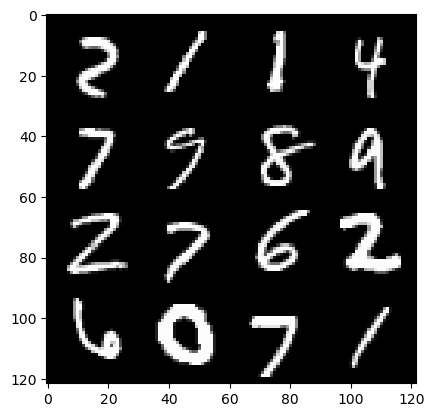

314: step 147300 / Gen loss: 1.4743255194028229 / disc_loss: 0.4040607388814292


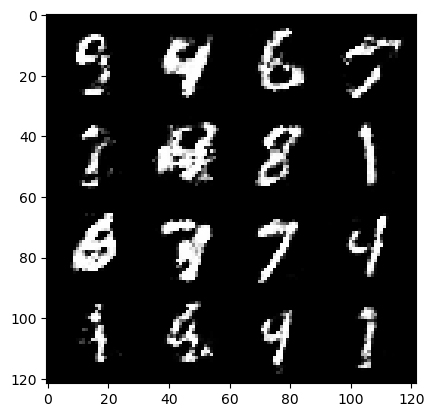

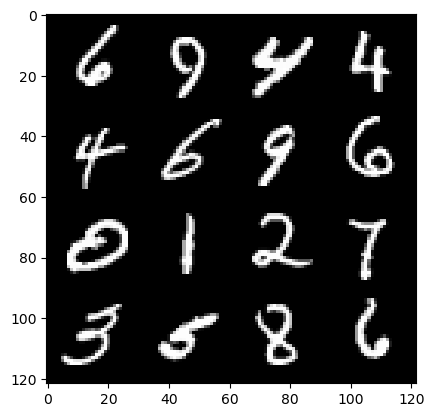

314: step 147600 / Gen loss: 1.4102898526191712 / disc_loss: 0.4075397901733714


  0%|          | 0/469 [00:00<?, ?it/s]

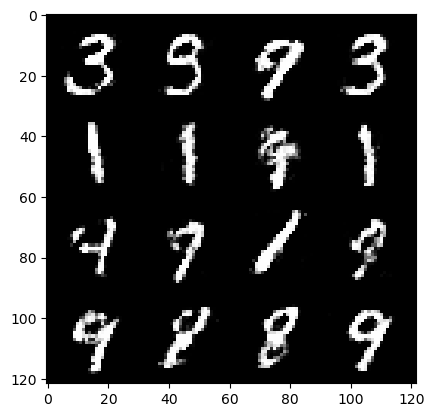

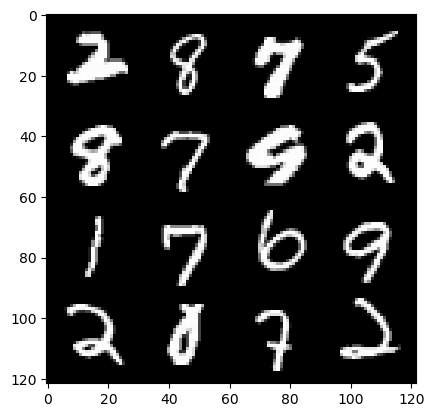

315: step 147900 / Gen loss: 1.4176202563444775 / disc_loss: 0.4209293067455294


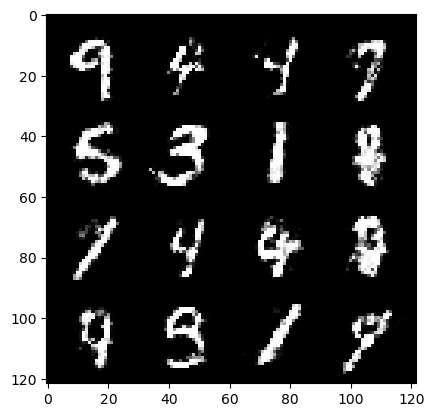

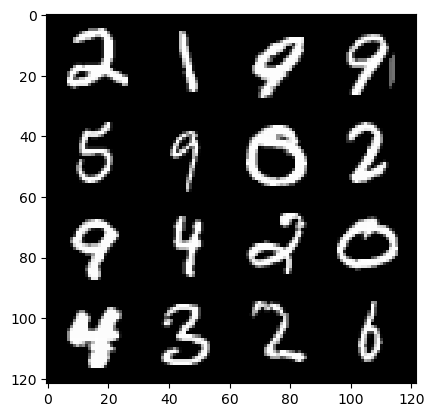

315: step 148200 / Gen loss: 1.5094750618934625 / disc_loss: 0.39730468193689966


  0%|          | 0/469 [00:00<?, ?it/s]

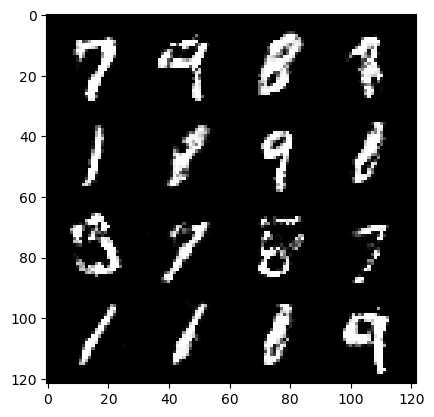

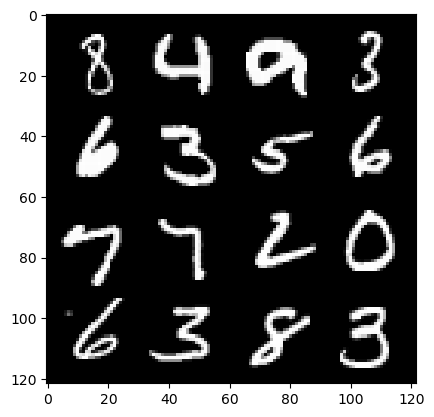

316: step 148500 / Gen loss: 1.5455053691069283 / disc_loss: 0.38354710668325437


  0%|          | 0/469 [00:00<?, ?it/s]

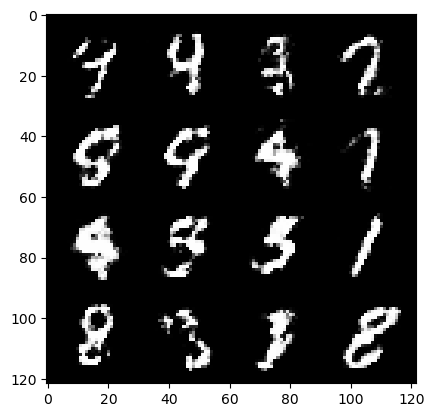

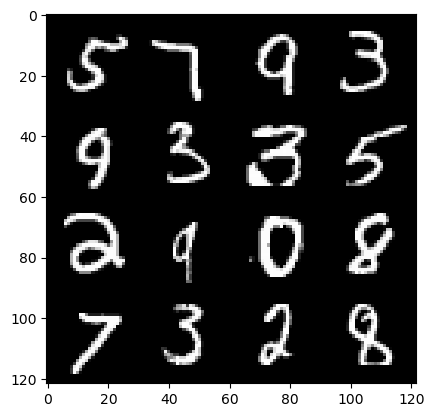

317: step 148800 / Gen loss: 1.5919984591007237 / disc_loss: 0.37638598273197804


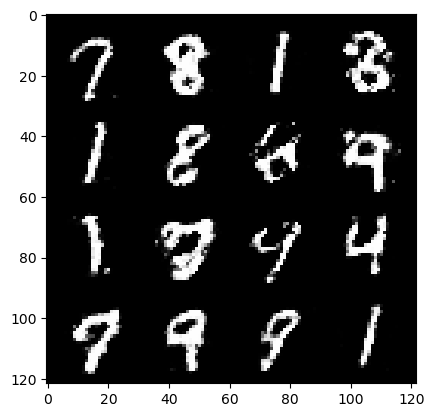

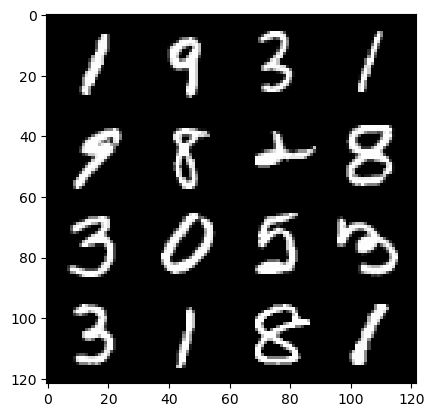

317: step 149100 / Gen loss: 1.511109670797983 / disc_loss: 0.3937369412183763


  0%|          | 0/469 [00:00<?, ?it/s]

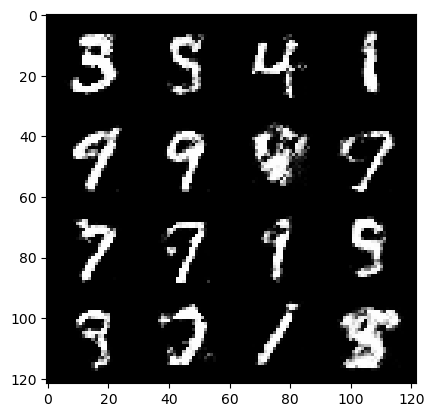

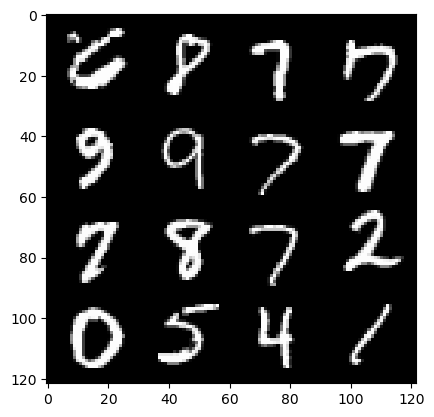

318: step 149400 / Gen loss: 1.542393486897151 / disc_loss: 0.3936830401420592


  0%|          | 0/469 [00:00<?, ?it/s]

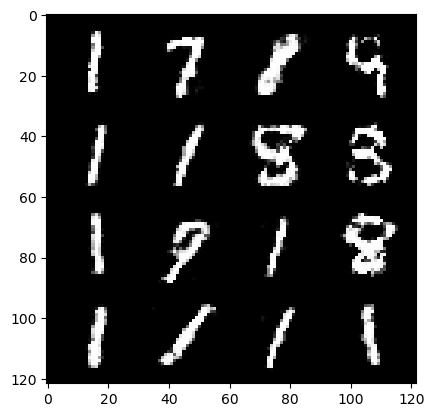

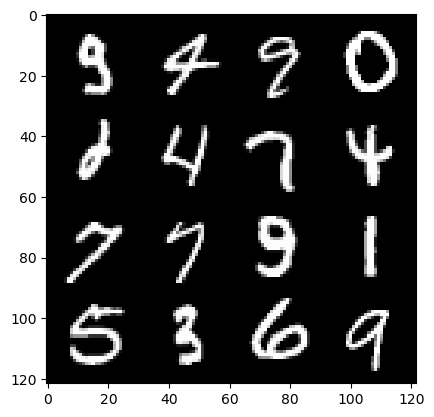

319: step 149700 / Gen loss: 1.4557783913612359 / disc_loss: 0.4054773552219072


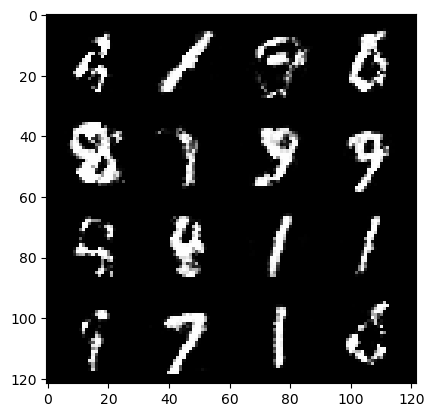

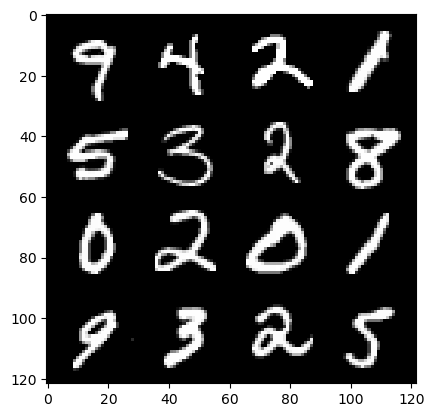

319: step 150000 / Gen loss: 1.4647553467750551 / disc_loss: 0.4119428290923435


  0%|          | 0/469 [00:00<?, ?it/s]

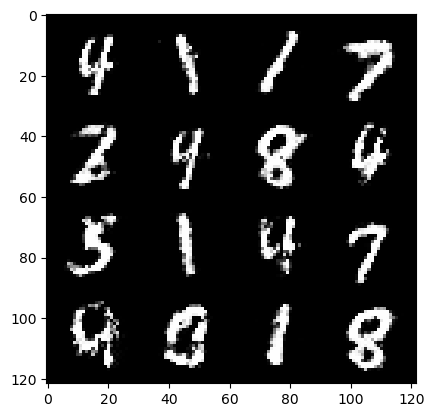

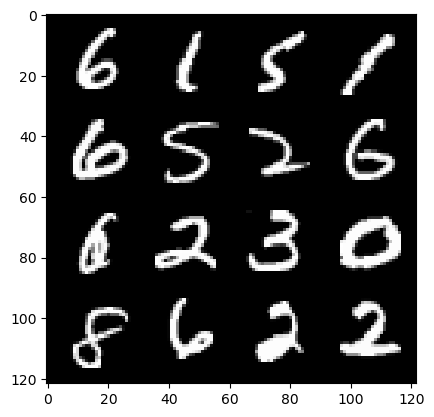

320: step 150300 / Gen loss: 1.5212123994032554 / disc_loss: 0.40168060590823507


  0%|          | 0/469 [00:00<?, ?it/s]

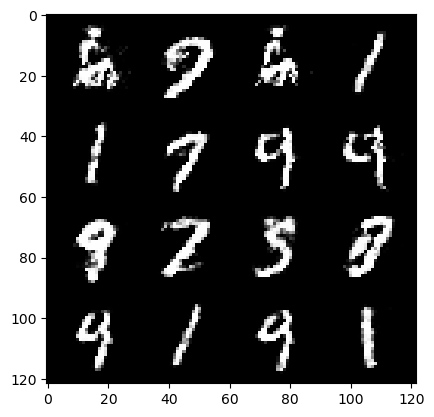

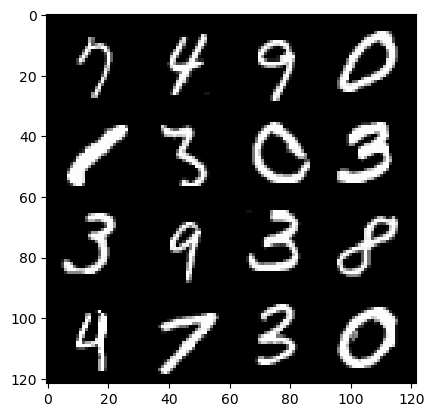

321: step 150600 / Gen loss: 1.4889793884754183 / disc_loss: 0.41128607193628963


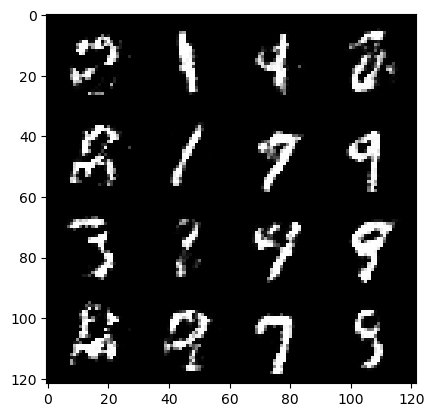

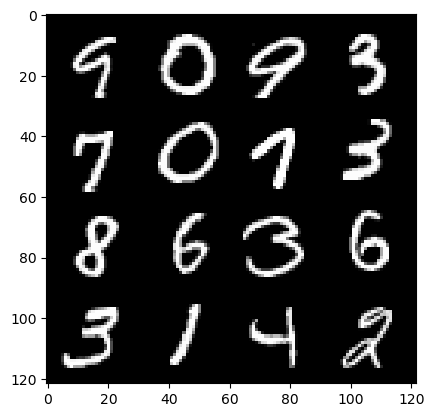

321: step 150900 / Gen loss: 1.503379347721736 / disc_loss: 0.409188865820567


  0%|          | 0/469 [00:00<?, ?it/s]

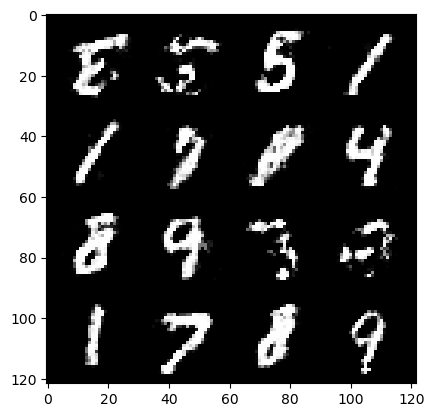

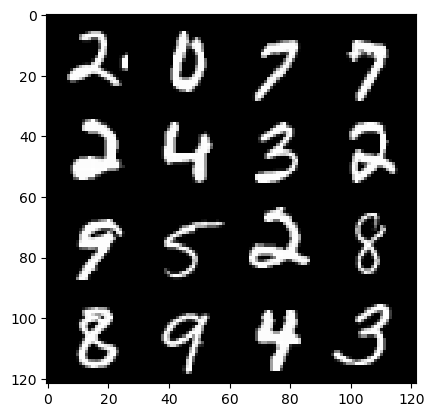

322: step 151200 / Gen loss: 1.4080162755648284 / disc_loss: 0.42152581820885326


  0%|          | 0/469 [00:00<?, ?it/s]

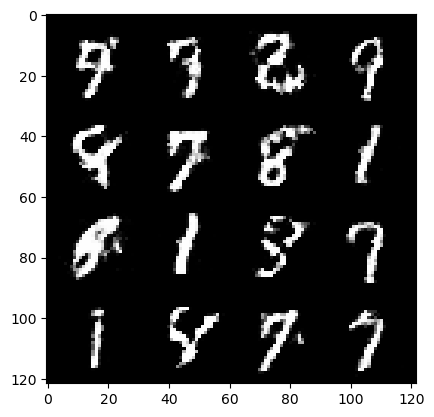

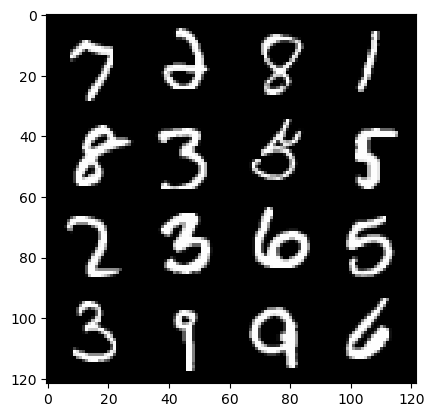

323: step 151500 / Gen loss: 1.4786730726559956 / disc_loss: 0.4029993180433909


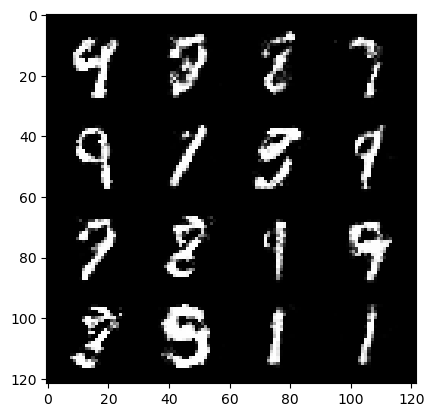

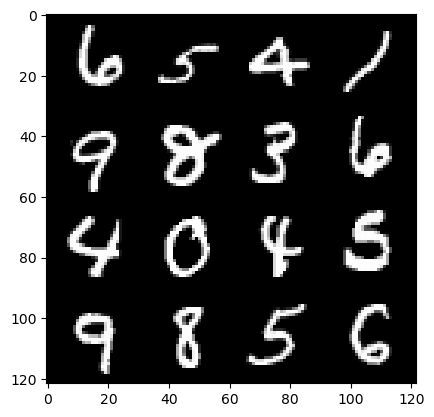

323: step 151800 / Gen loss: 1.486537967920303 / disc_loss: 0.39989006876945504


  0%|          | 0/469 [00:00<?, ?it/s]

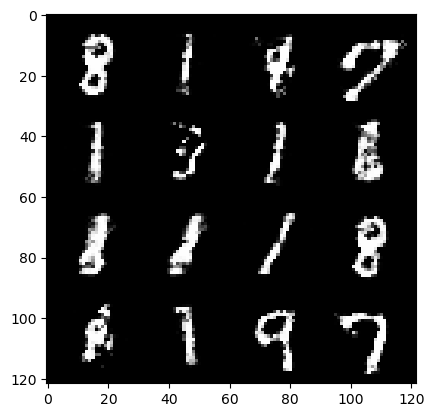

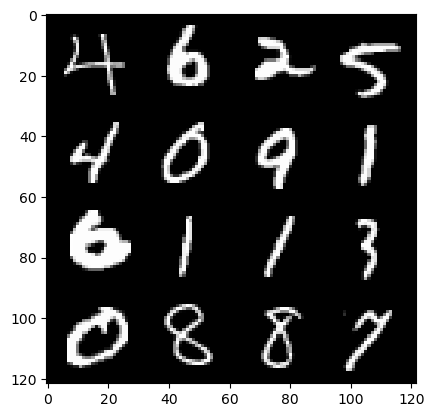

324: step 152100 / Gen loss: 1.464810336033504 / disc_loss: 0.42357728163401276


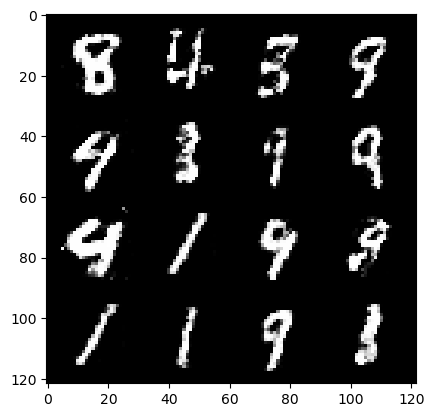

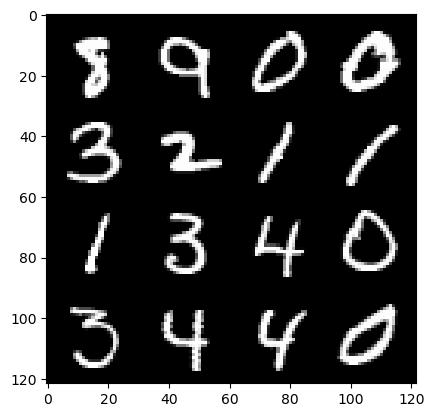

324: step 152400 / Gen loss: 1.4736242806911466 / disc_loss: 0.4153233010570208


  0%|          | 0/469 [00:00<?, ?it/s]

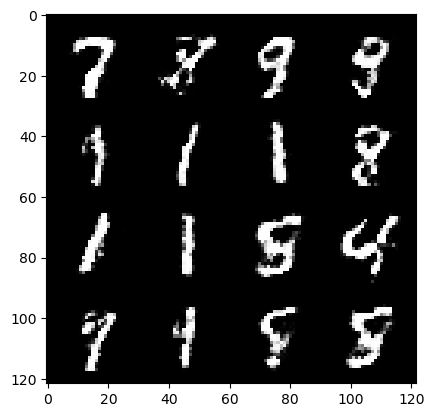

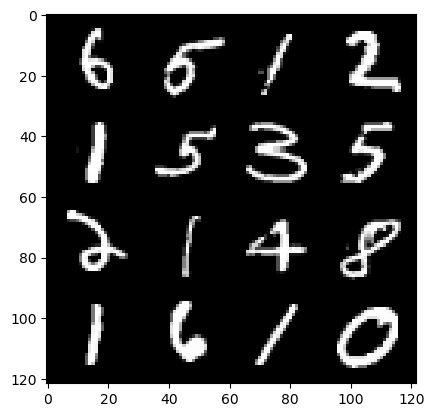

325: step 152700 / Gen loss: 1.488621299266816 / disc_loss: 0.40092783282200517


  0%|          | 0/469 [00:00<?, ?it/s]

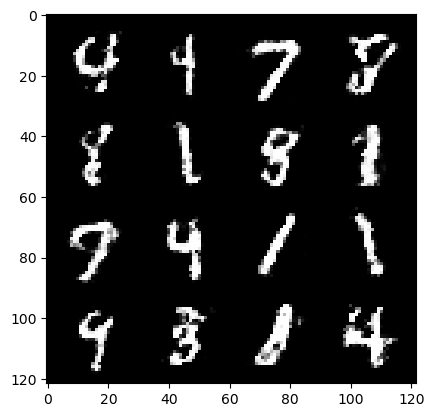

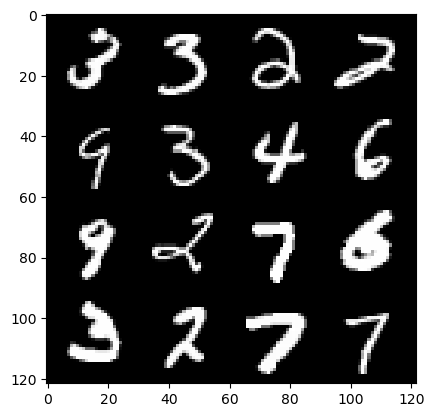

326: step 153000 / Gen loss: 1.4800791672865539 / disc_loss: 0.4092458858092627


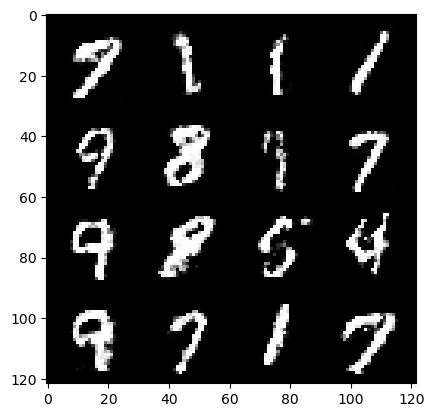

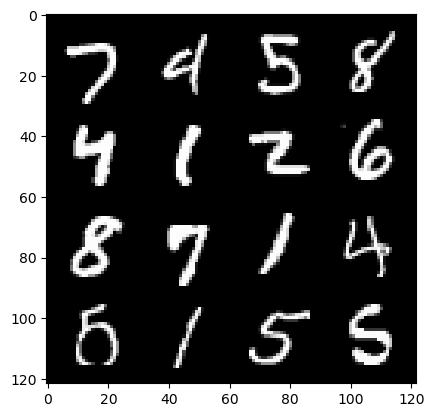

326: step 153300 / Gen loss: 1.4677337253093716 / disc_loss: 0.41320855696996067


  0%|          | 0/469 [00:00<?, ?it/s]

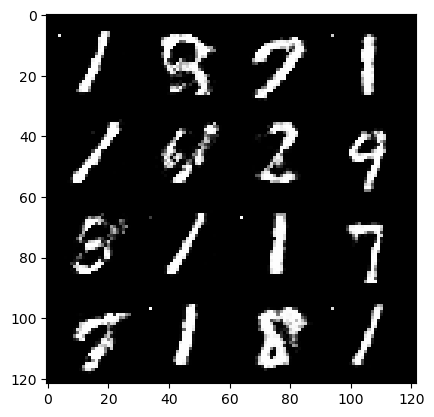

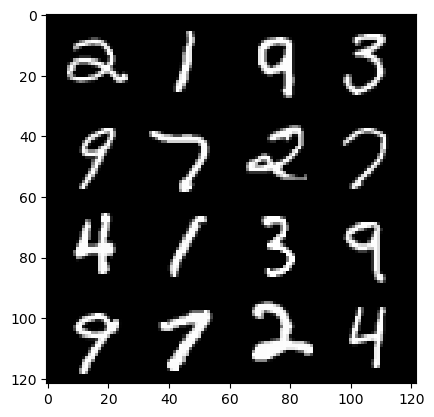

327: step 153600 / Gen loss: 1.3858300820986433 / disc_loss: 0.4407795081535977


  0%|          | 0/469 [00:00<?, ?it/s]

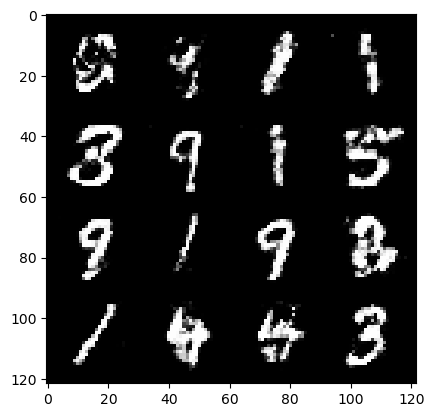

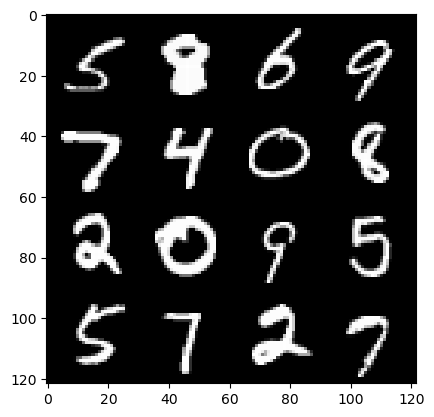

328: step 153900 / Gen loss: 1.2923575242360439 / disc_loss: 0.4577753778298698


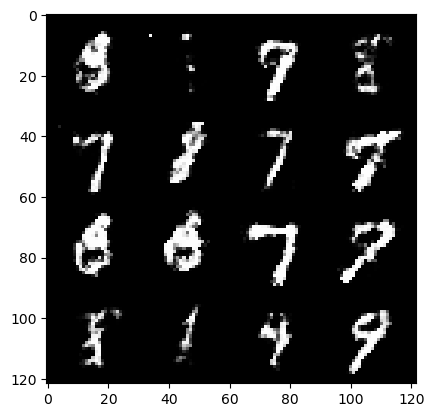

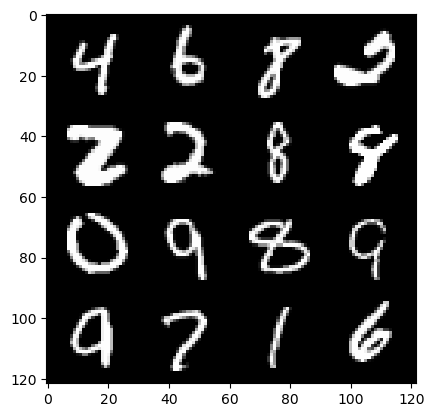

328: step 154200 / Gen loss: 1.1876566652456912 / disc_loss: 0.4787677064538001


  0%|          | 0/469 [00:00<?, ?it/s]

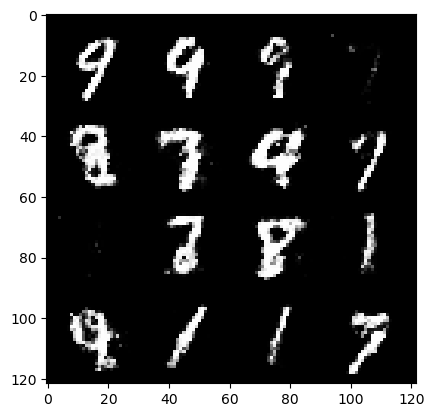

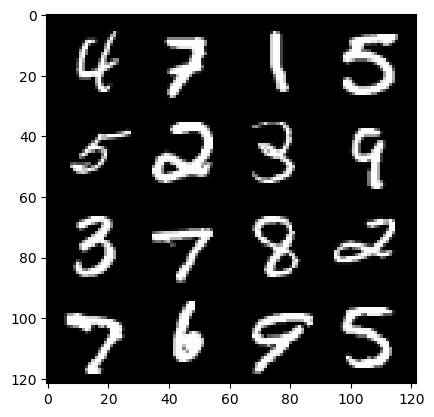

329: step 154500 / Gen loss: 1.2100991016626363 / disc_loss: 0.4565566924214364


  0%|          | 0/469 [00:00<?, ?it/s]

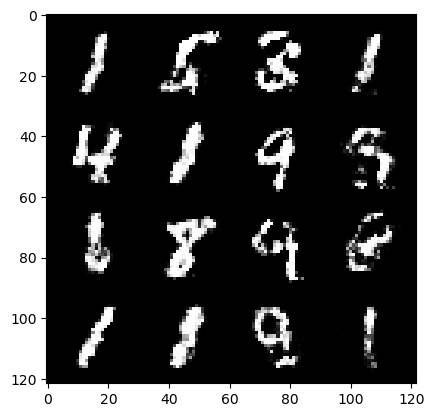

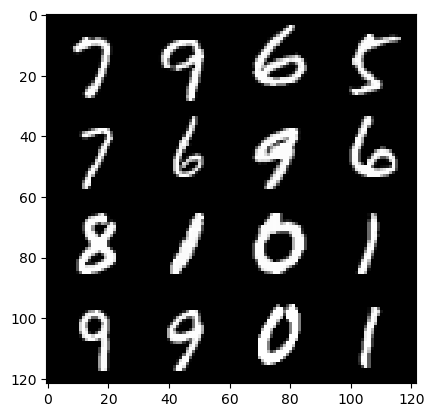

330: step 154800 / Gen loss: 1.3061074515183766 / disc_loss: 0.4349336468180023


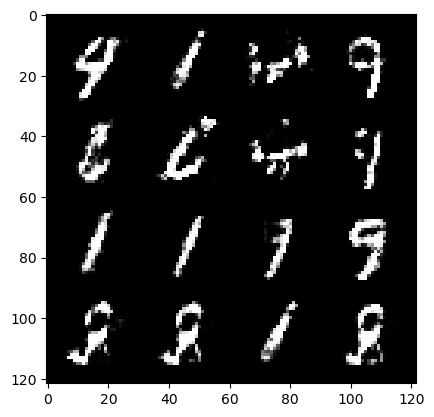

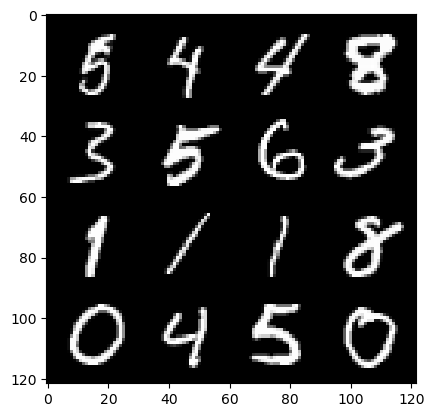

330: step 155100 / Gen loss: 1.3920860580603285 / disc_loss: 0.4225375743707022


  0%|          | 0/469 [00:00<?, ?it/s]

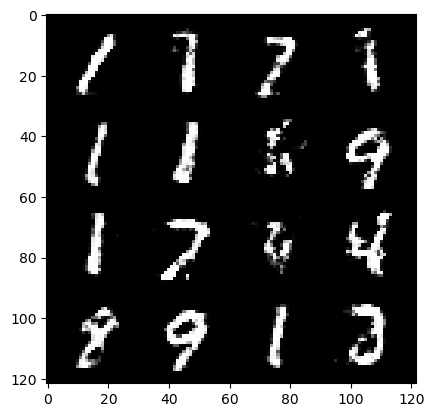

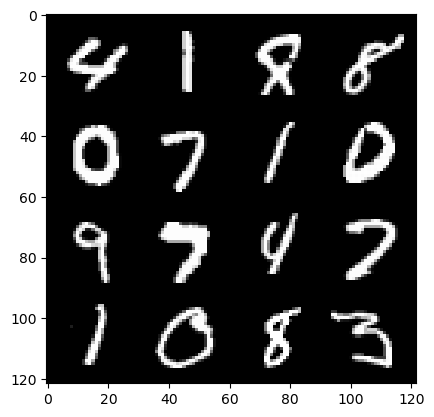

331: step 155400 / Gen loss: 1.3962423793474823 / disc_loss: 0.43540767391522706


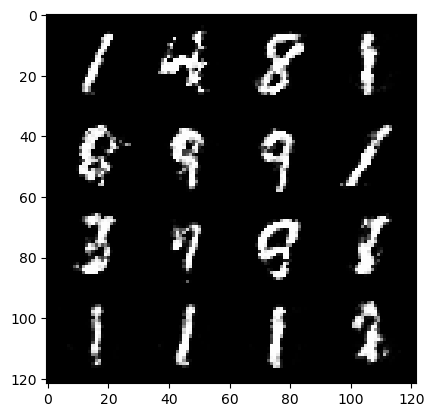

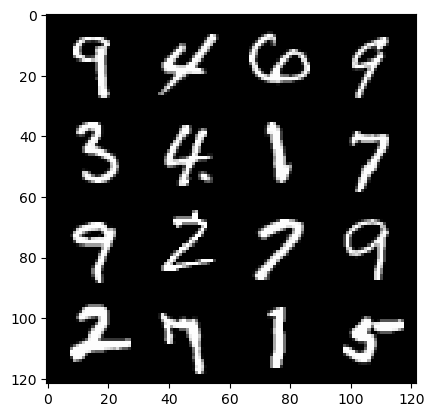

331: step 155700 / Gen loss: 1.3742557311058035 / disc_loss: 0.44349613428115875


  0%|          | 0/469 [00:00<?, ?it/s]

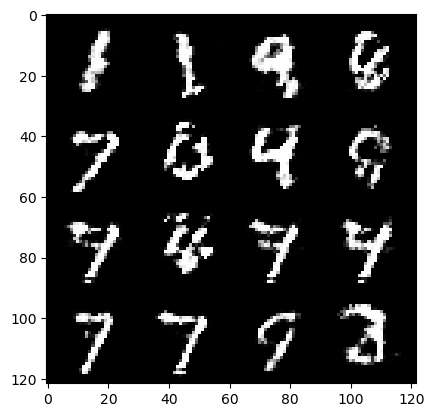

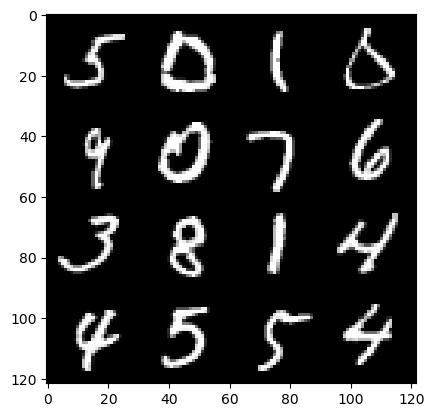

332: step 156000 / Gen loss: 1.4754159192244198 / disc_loss: 0.4148721076051394


  0%|          | 0/469 [00:00<?, ?it/s]

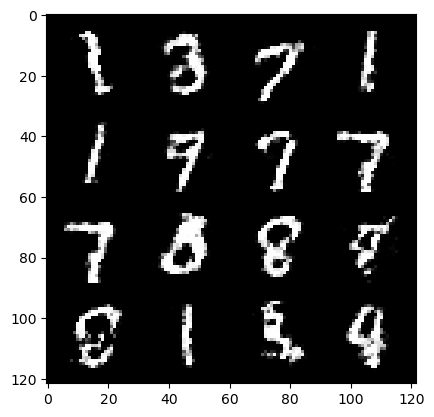

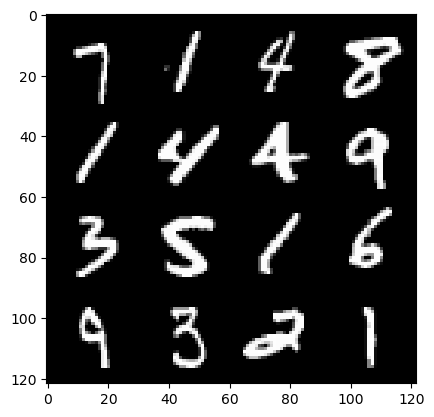

333: step 156300 / Gen loss: 1.4431769990921024 / disc_loss: 0.42012700706720346


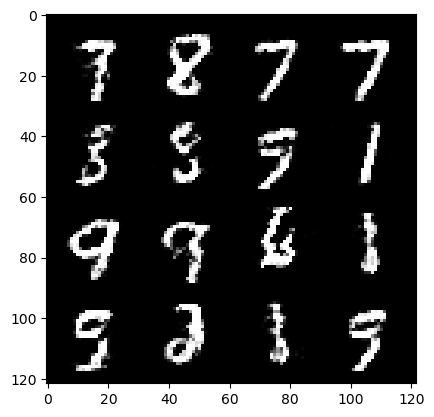

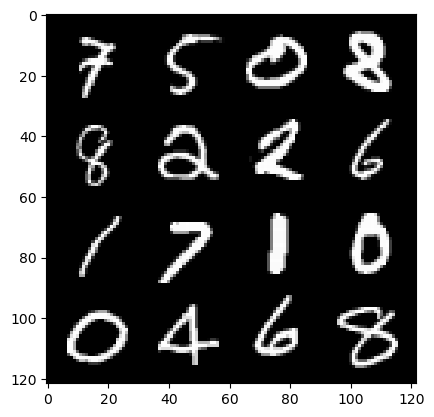

333: step 156600 / Gen loss: 1.425312612056731 / disc_loss: 0.43777300715446477


  0%|          | 0/469 [00:00<?, ?it/s]

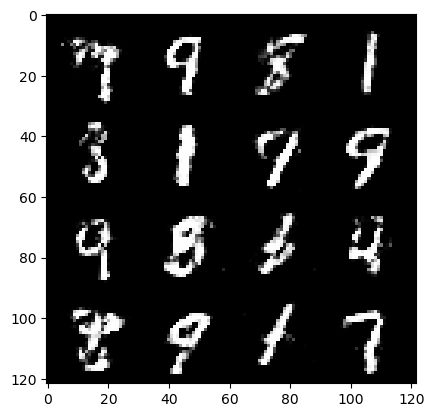

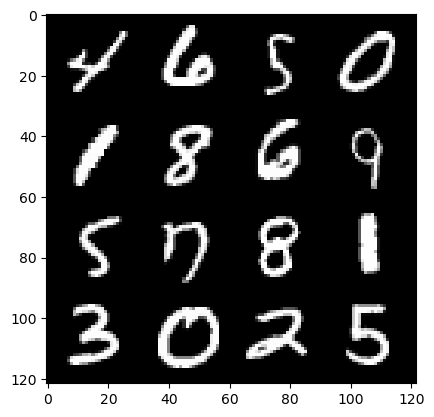

334: step 156900 / Gen loss: 1.4061611076196021 / disc_loss: 0.4240906712412832


  0%|          | 0/469 [00:00<?, ?it/s]

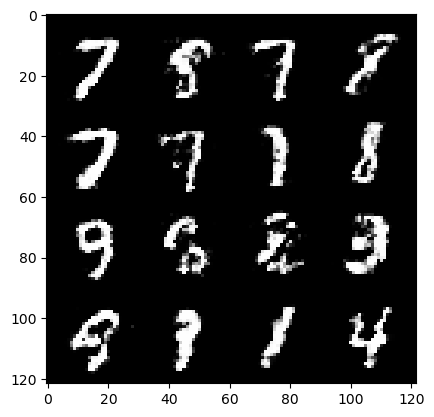

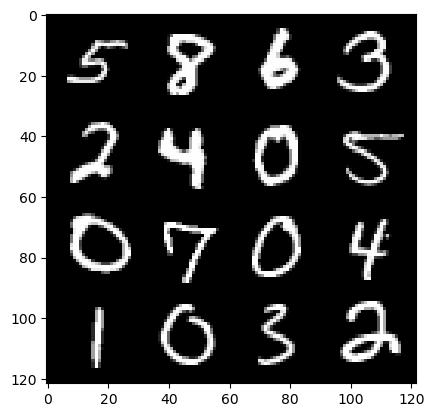

335: step 157200 / Gen loss: 1.4828966796398158 / disc_loss: 0.4087545995910964


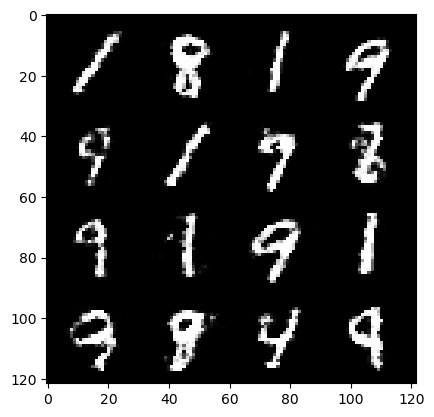

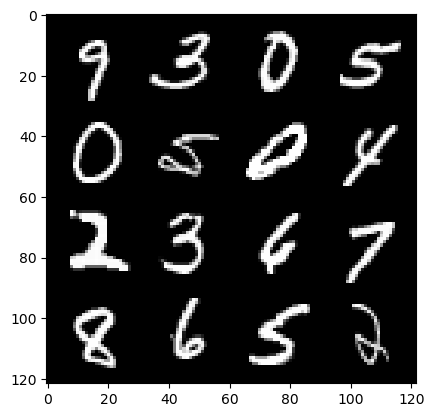

335: step 157500 / Gen loss: 1.467611948251724 / disc_loss: 0.41268680622180304


  0%|          | 0/469 [00:00<?, ?it/s]

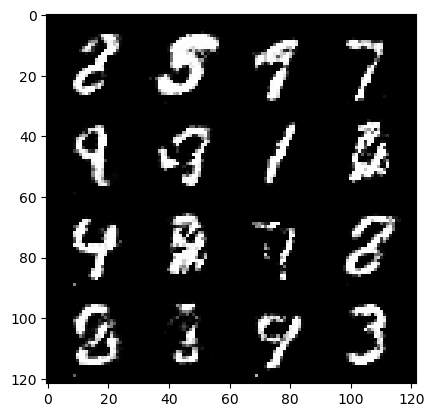

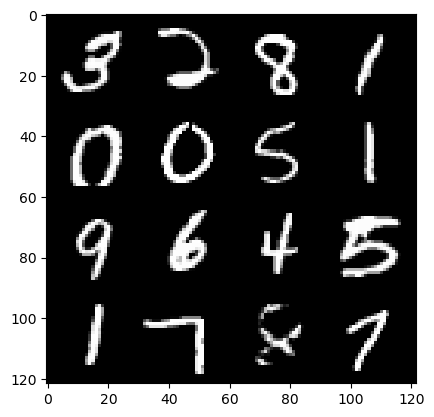

336: step 157800 / Gen loss: 1.3722026522954305 / disc_loss: 0.4250892940163611


  0%|          | 0/469 [00:00<?, ?it/s]

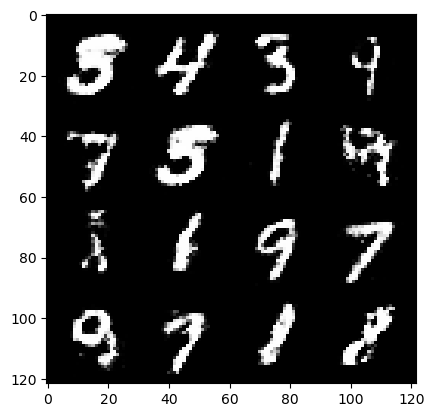

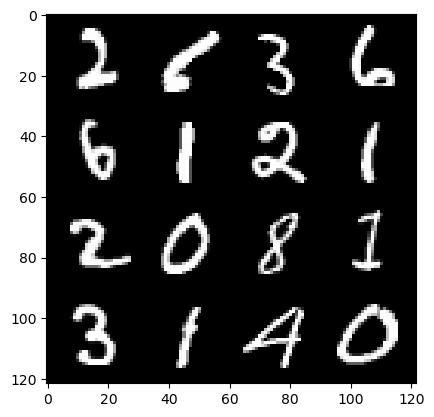

337: step 158100 / Gen loss: 1.3971230057875312 / disc_loss: 0.41853576799233766


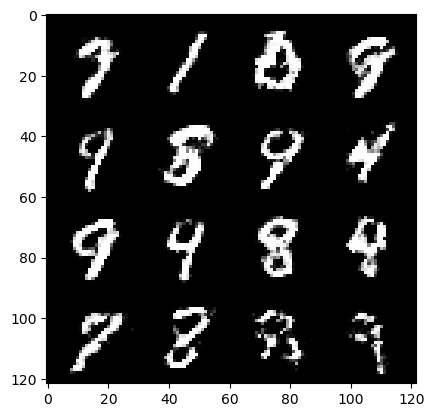

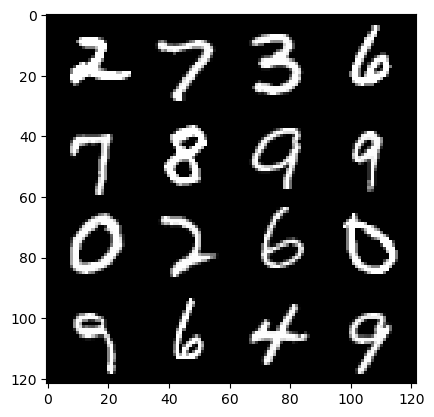

337: step 158400 / Gen loss: 1.4100552793343861 / disc_loss: 0.4285143130024271


  0%|          | 0/469 [00:00<?, ?it/s]

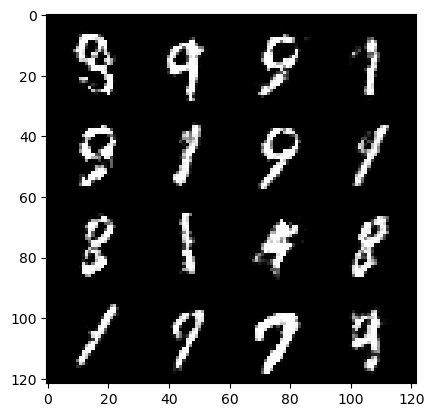

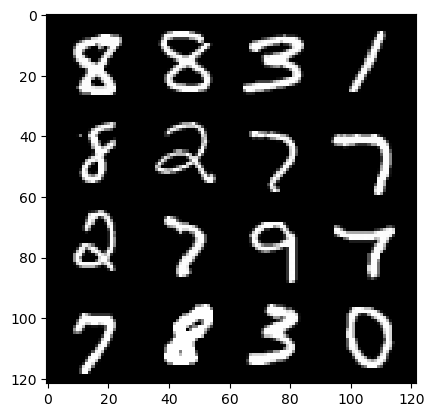

338: step 158700 / Gen loss: 1.4495081408818564 / disc_loss: 0.4091903529564542


  0%|          | 0/469 [00:00<?, ?it/s]

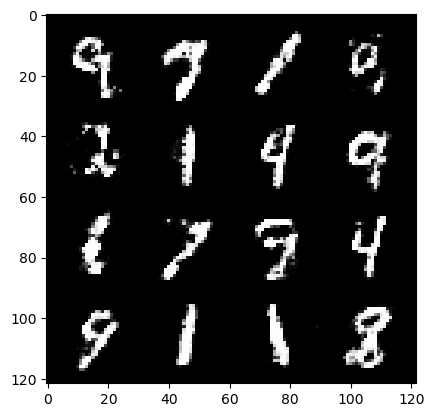

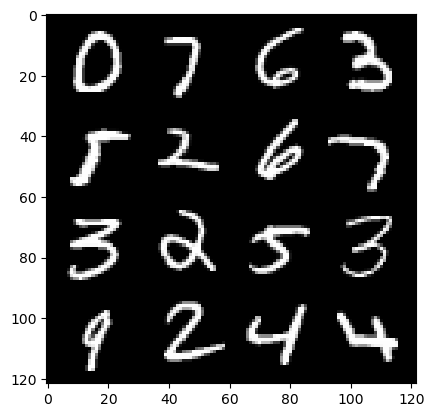

339: step 159000 / Gen loss: 1.503435467084247 / disc_loss: 0.39645036796728744


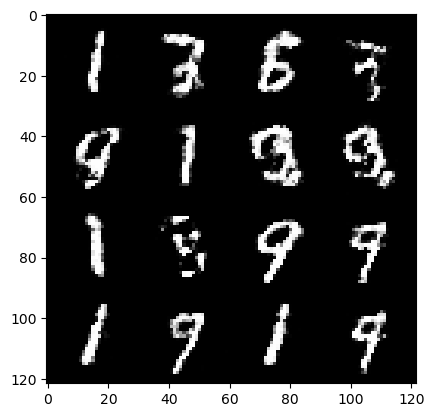

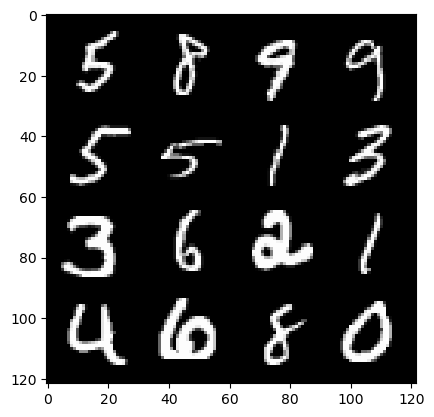

339: step 159300 / Gen loss: 1.46816467444102 / disc_loss: 0.4144560871521634


  0%|          | 0/469 [00:00<?, ?it/s]

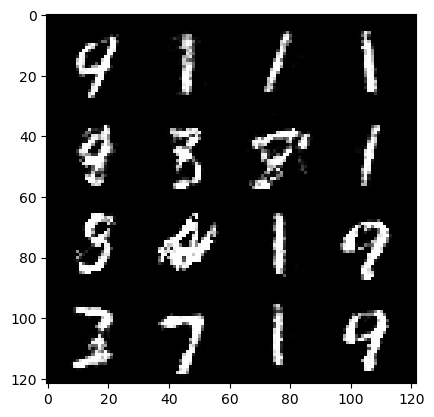

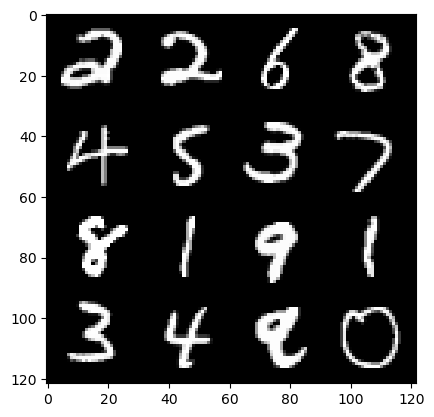

340: step 159600 / Gen loss: 1.4470748166243235 / disc_loss: 0.4150887494285901


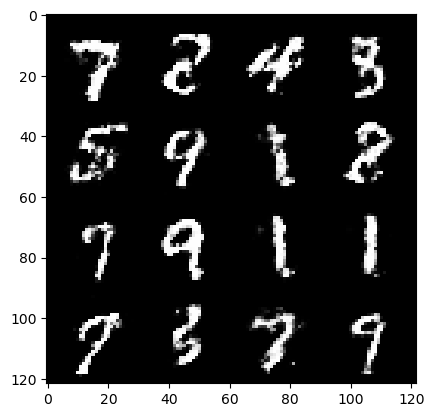

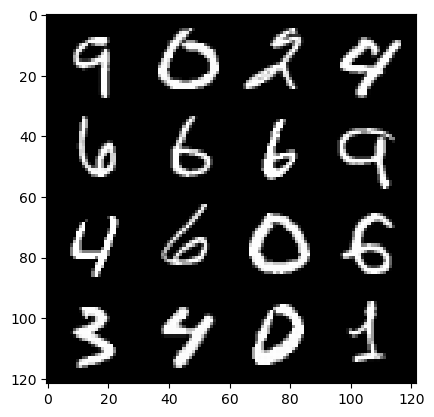

340: step 159900 / Gen loss: 1.4706382469336192 / disc_loss: 0.4101606806119284


  0%|          | 0/469 [00:00<?, ?it/s]

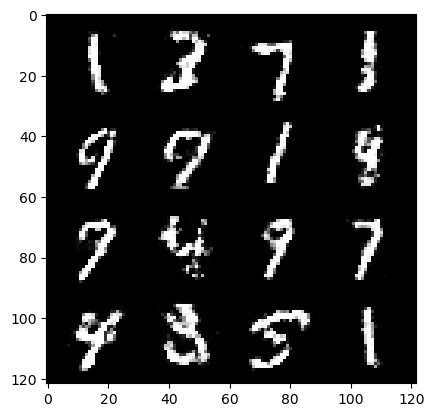

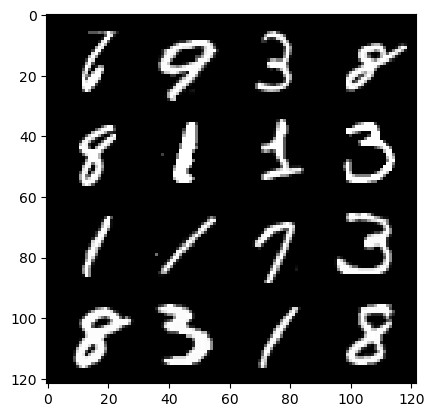

341: step 160200 / Gen loss: 1.4601847807566326 / disc_loss: 0.4153920554121336


  0%|          | 0/469 [00:00<?, ?it/s]

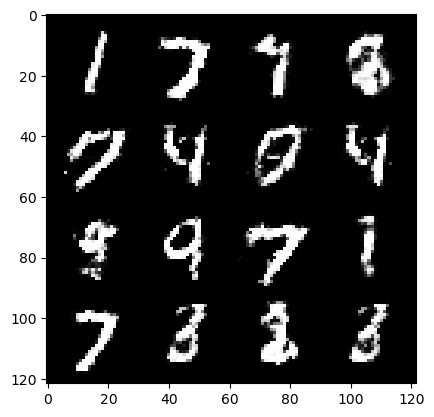

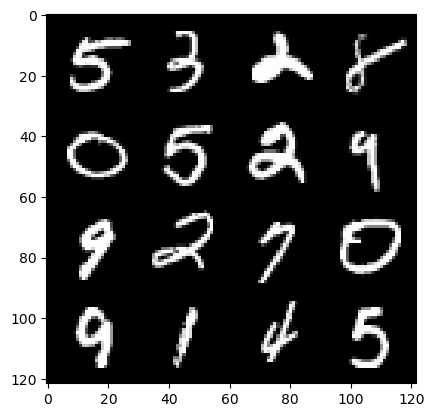

342: step 160500 / Gen loss: 1.4780707867940268 / disc_loss: 0.4139798635244368


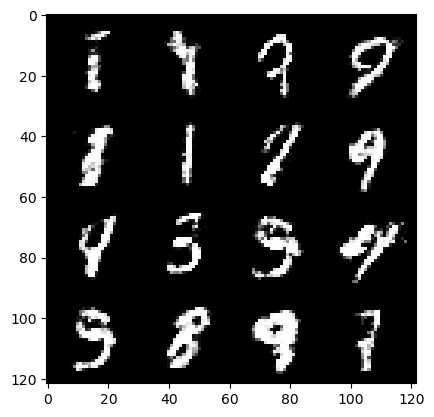

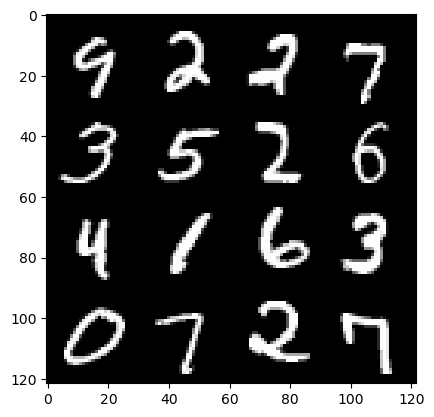

342: step 160800 / Gen loss: 1.5172768410046895 / disc_loss: 0.39605074197053897


  0%|          | 0/469 [00:00<?, ?it/s]

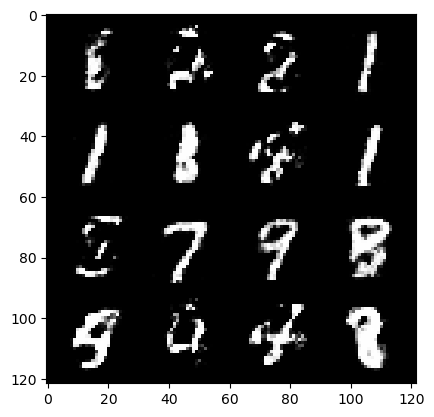

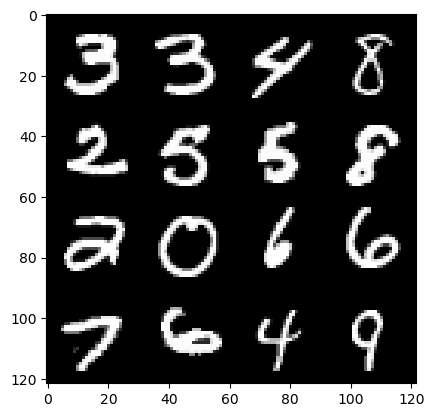

343: step 161100 / Gen loss: 1.4781225947539014 / disc_loss: 0.41315342565377544


  0%|          | 0/469 [00:00<?, ?it/s]

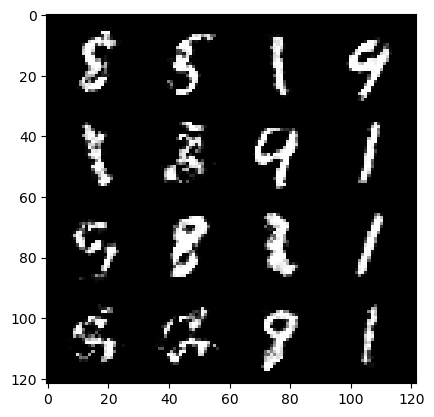

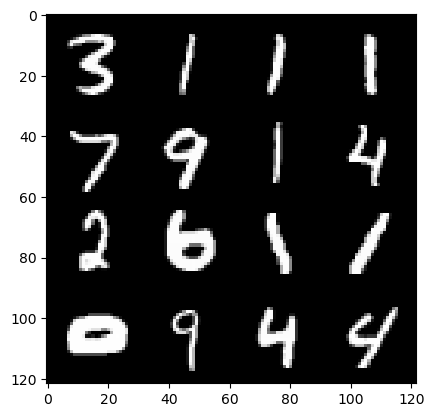

344: step 161400 / Gen loss: 1.4700916139284768 / disc_loss: 0.4109420153498651


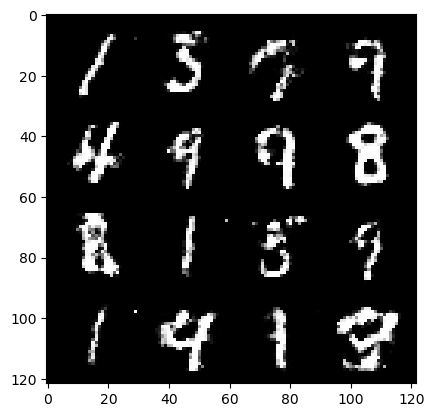

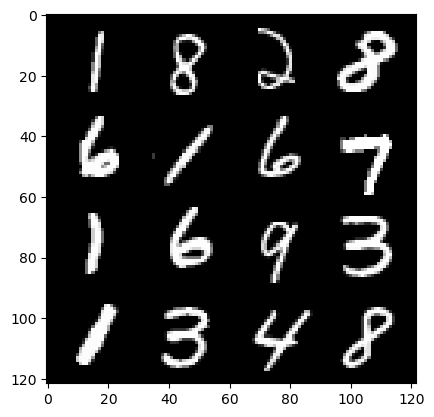

344: step 161700 / Gen loss: 1.3804836901028952 / disc_loss: 0.4435377320647237


  0%|          | 0/469 [00:00<?, ?it/s]

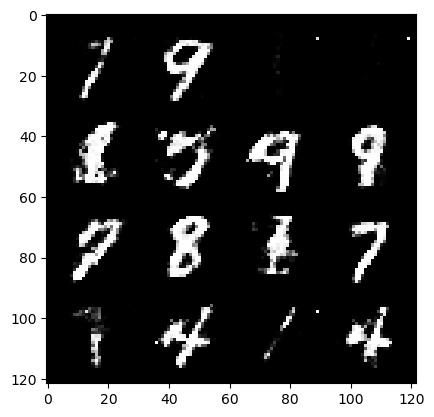

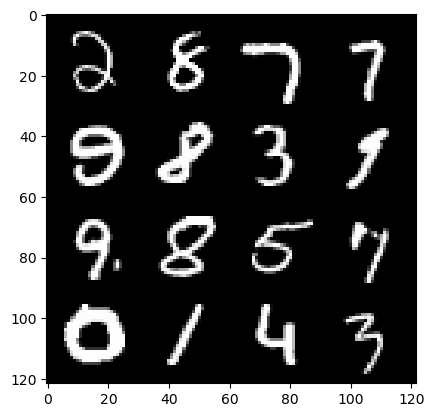

345: step 162000 / Gen loss: 1.22431446870168 / disc_loss: 0.5233453604578971


  0%|          | 0/469 [00:00<?, ?it/s]

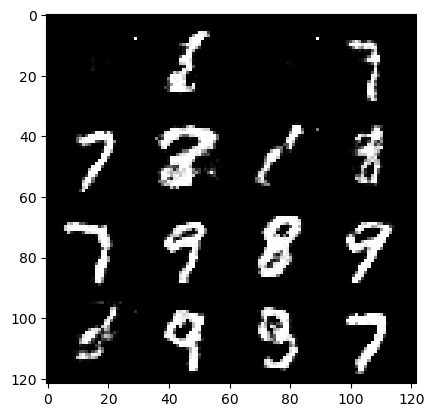

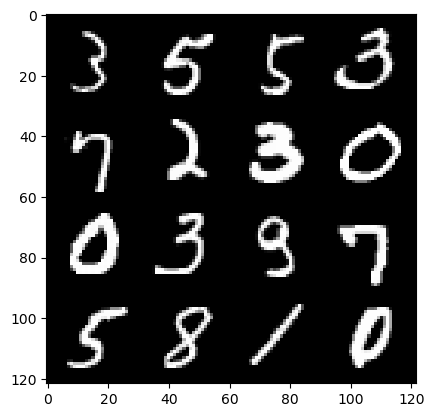

346: step 162300 / Gen loss: 1.2945022225379945 / disc_loss: 0.4351107746362688


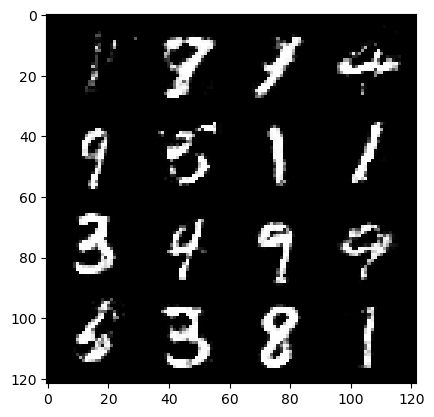

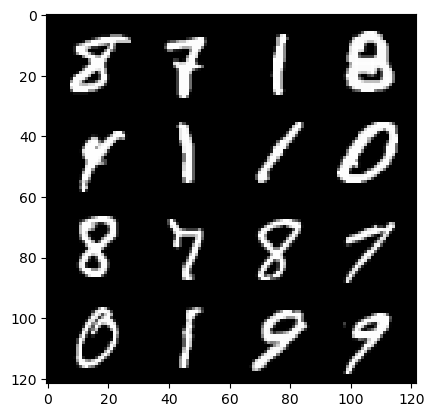

346: step 162600 / Gen loss: 1.3569929730892176 / disc_loss: 0.4226455168922746


  0%|          | 0/469 [00:00<?, ?it/s]

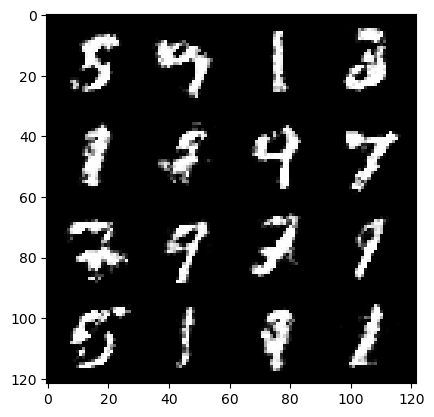

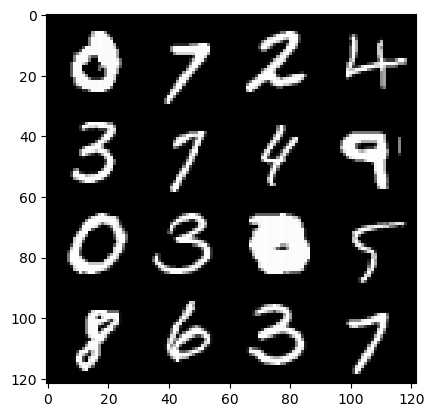

347: step 162900 / Gen loss: 1.383758289416631 / disc_loss: 0.43476551055908225


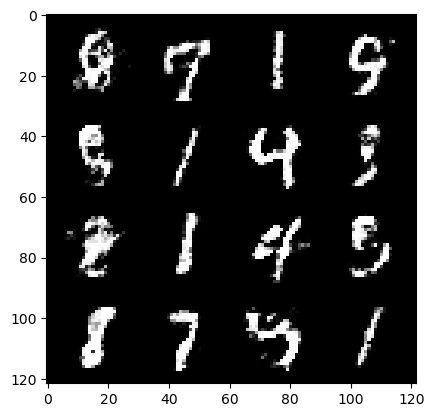

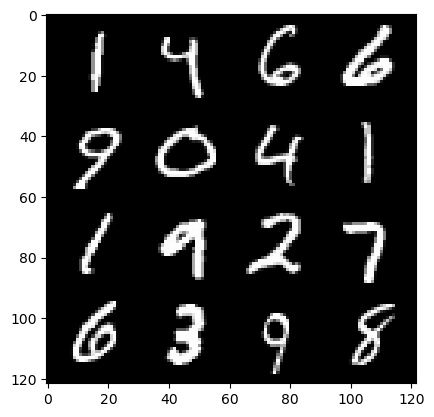

347: step 163200 / Gen loss: 1.4265367289384203 / disc_loss: 0.42838349173466345


  0%|          | 0/469 [00:00<?, ?it/s]

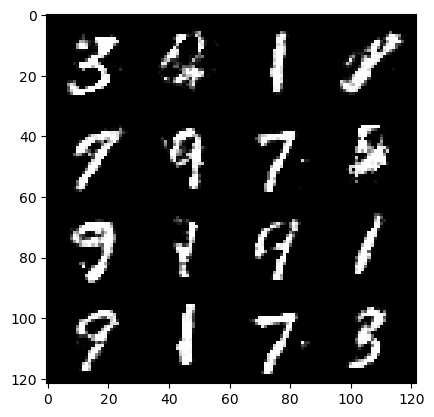

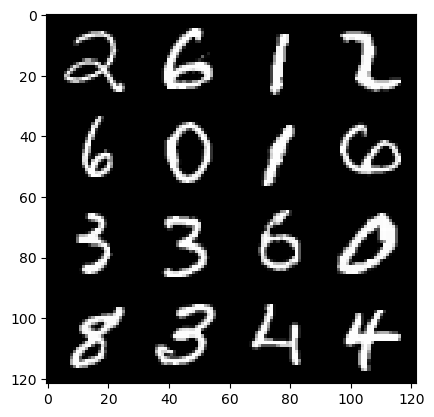

348: step 163500 / Gen loss: 1.458273608287175 / disc_loss: 0.4186405560374261


  0%|          | 0/469 [00:00<?, ?it/s]

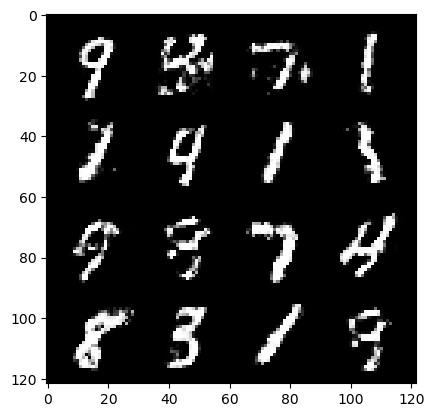

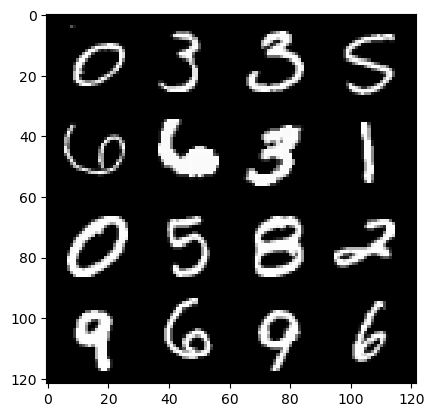

349: step 163800 / Gen loss: 1.4861721642812091 / disc_loss: 0.4203162588675817


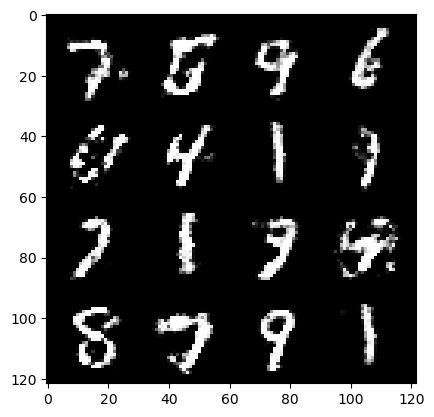

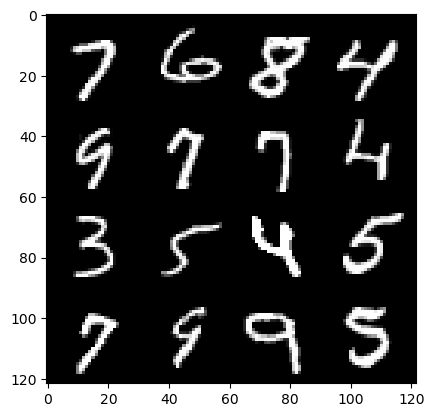

349: step 164100 / Gen loss: 1.4679824781417854 / disc_loss: 0.4222060342629752


  0%|          | 0/469 [00:00<?, ?it/s]

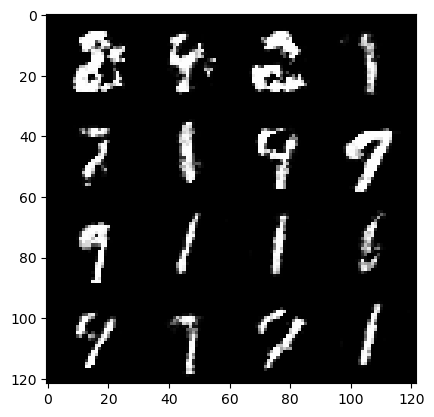

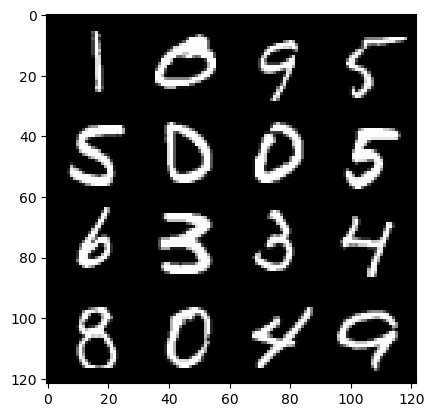

350: step 164400 / Gen loss: 1.4242508033911399 / disc_loss: 0.4359934153159462


  0%|          | 0/469 [00:00<?, ?it/s]

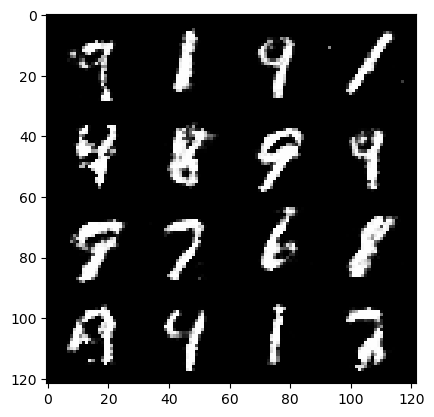

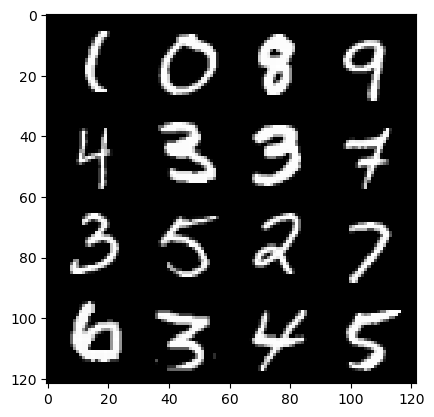

351: step 164700 / Gen loss: 1.4848782217502594 / disc_loss: 0.4175414972503981


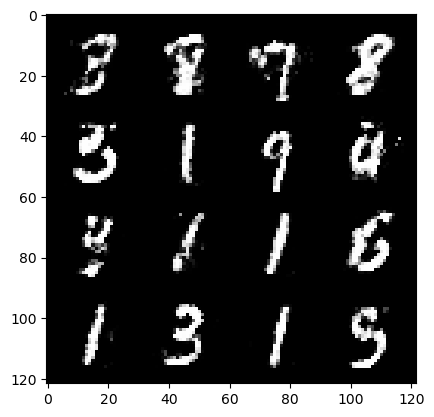

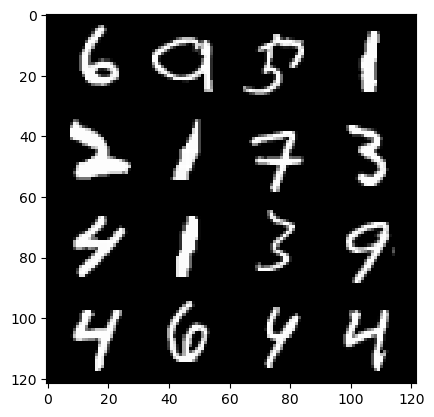

351: step 165000 / Gen loss: 1.4966140512625397 / disc_loss: 0.4111723464727401


  0%|          | 0/469 [00:00<?, ?it/s]

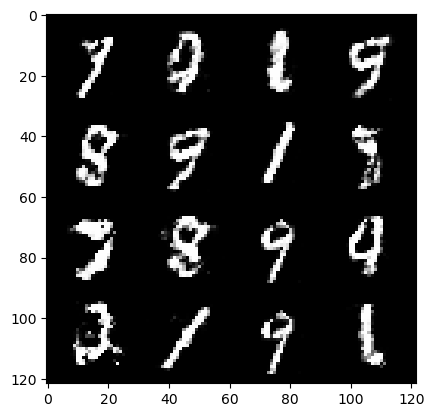

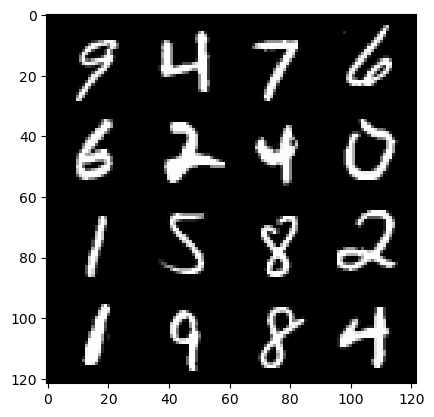

352: step 165300 / Gen loss: 1.4851110931237534 / disc_loss: 0.41295721838871624


  0%|          | 0/469 [00:00<?, ?it/s]

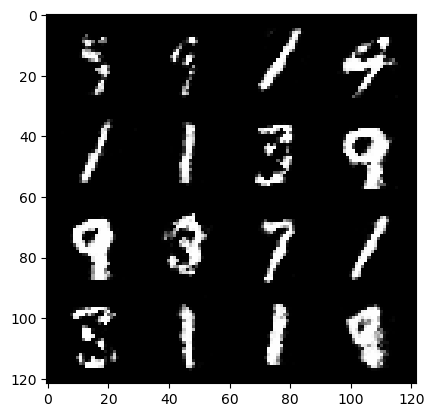

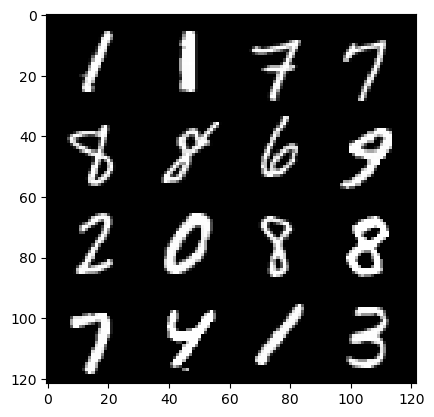

353: step 165600 / Gen loss: 1.4803948187828078 / disc_loss: 0.4143081537882486


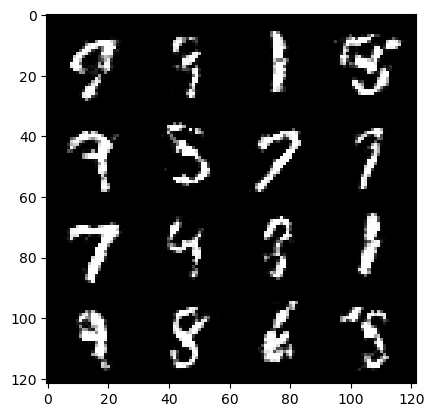

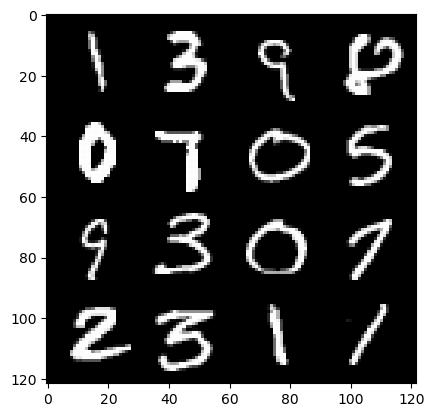

353: step 165900 / Gen loss: 1.4912720962365456 / disc_loss: 0.42413717985153204


  0%|          | 0/469 [00:00<?, ?it/s]

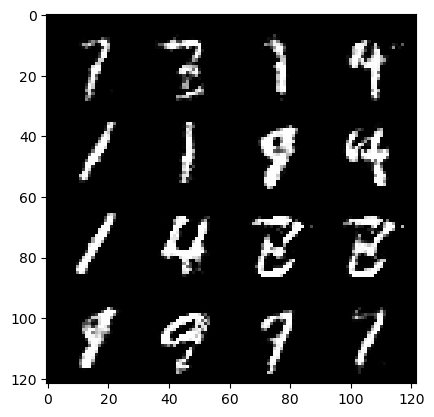

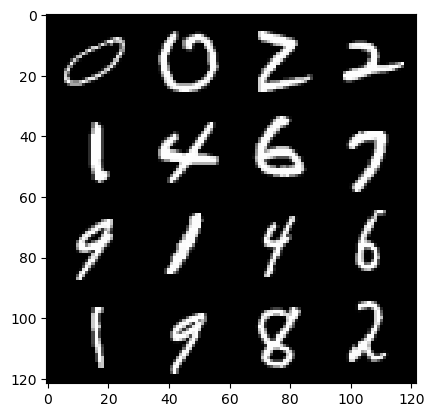

354: step 166200 / Gen loss: 1.3974657754103337 / disc_loss: 0.4391305550932887


  0%|          | 0/469 [00:00<?, ?it/s]

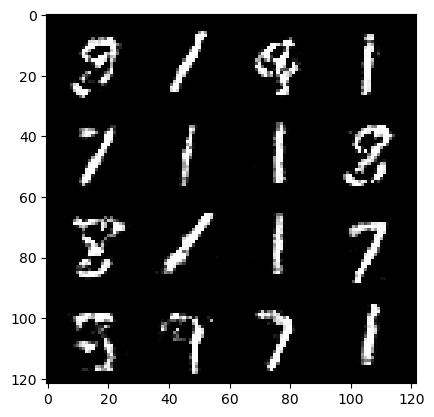

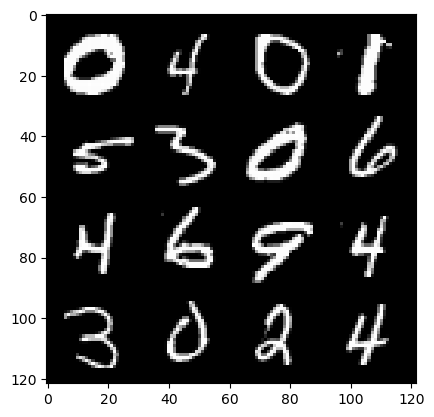

355: step 166500 / Gen loss: 1.4355559734503427 / disc_loss: 0.42017875174681335


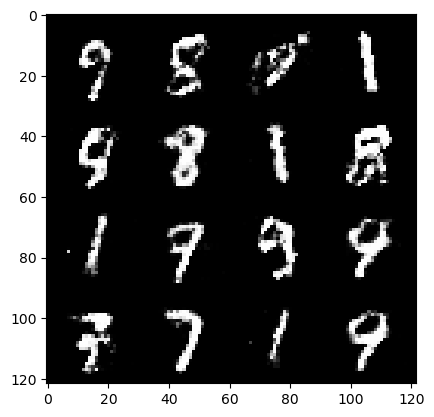

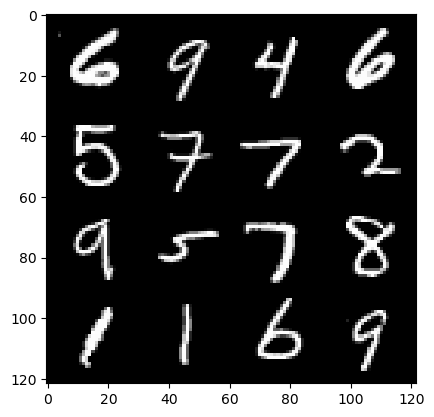

355: step 166800 / Gen loss: 1.4663357067108156 / disc_loss: 0.4157091683149337


  0%|          | 0/469 [00:00<?, ?it/s]

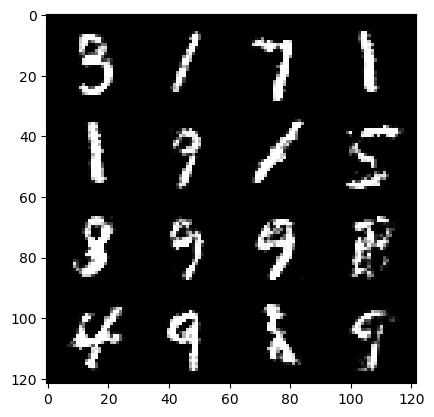

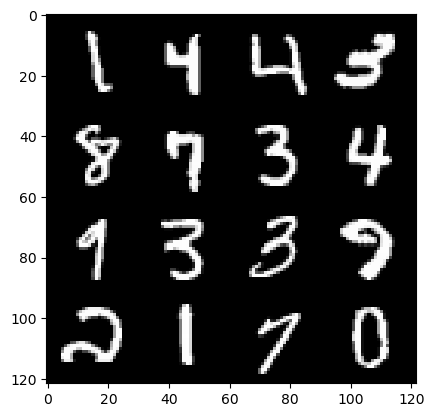

356: step 167100 / Gen loss: 1.4648326365152995 / disc_loss: 0.4153480958938598


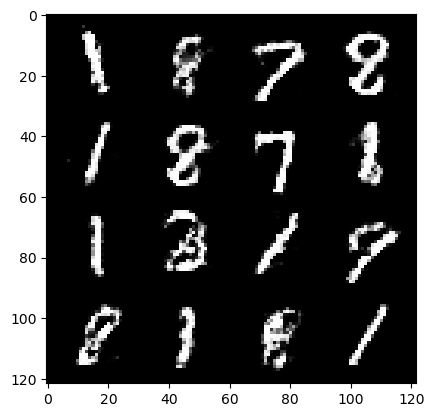

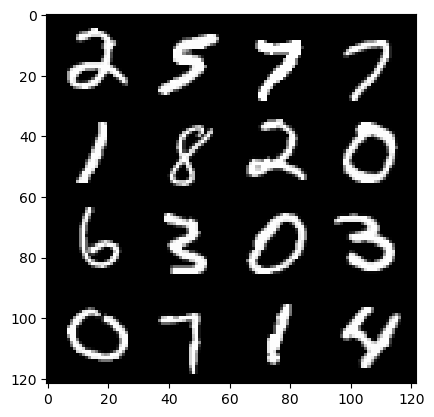

356: step 167400 / Gen loss: 1.4449689046541854 / disc_loss: 0.43052843352158837


  0%|          | 0/469 [00:00<?, ?it/s]

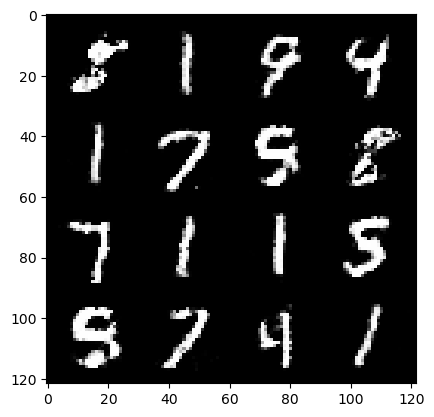

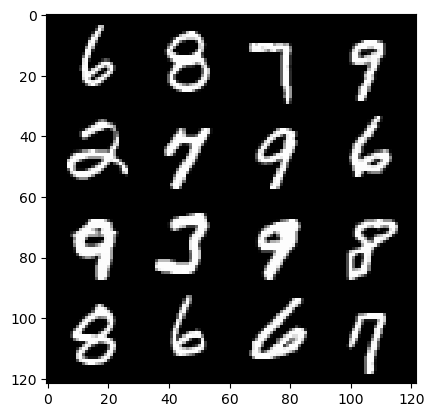

357: step 167700 / Gen loss: 1.4912654284636178 / disc_loss: 0.4063686798016229


  0%|          | 0/469 [00:00<?, ?it/s]

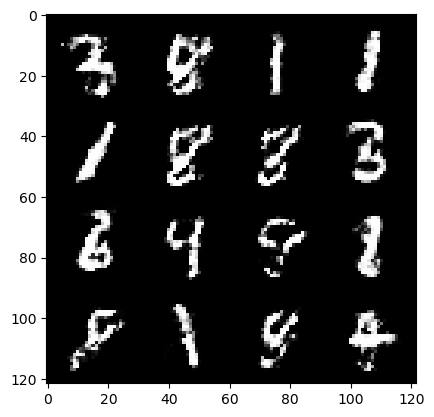

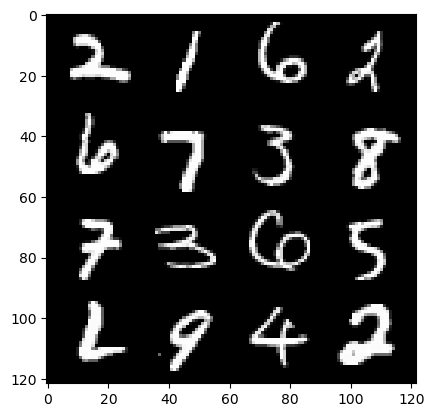

358: step 168000 / Gen loss: 1.4886766922473906 / disc_loss: 0.42386989206075637


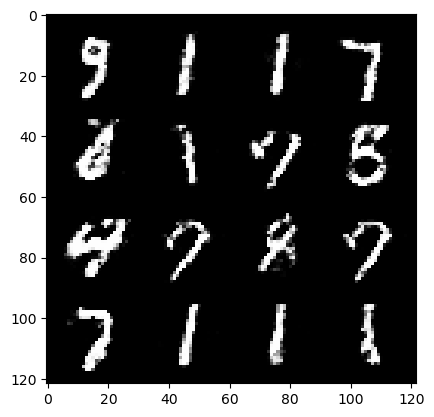

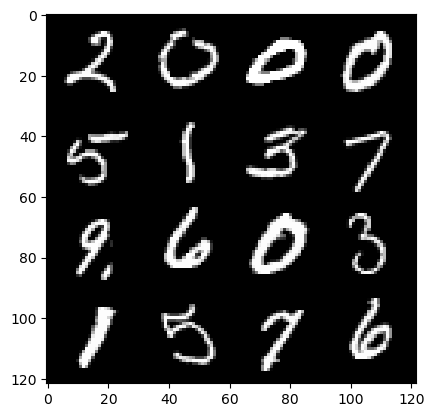

358: step 168300 / Gen loss: 1.4505379780133556 / disc_loss: 0.4325426814953488


  0%|          | 0/469 [00:00<?, ?it/s]

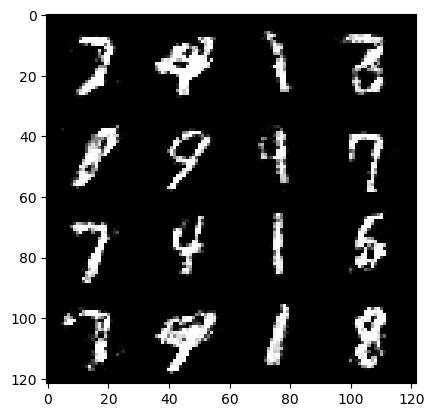

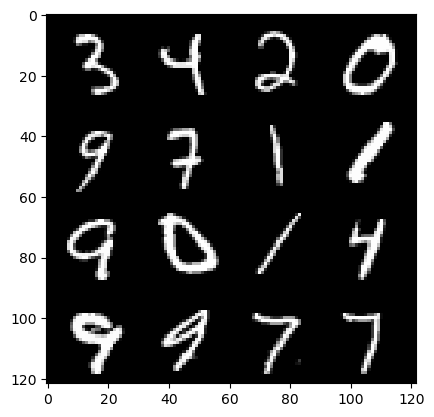

359: step 168600 / Gen loss: 1.4732209138075505 / disc_loss: 0.4154796363910037


  0%|          | 0/469 [00:00<?, ?it/s]

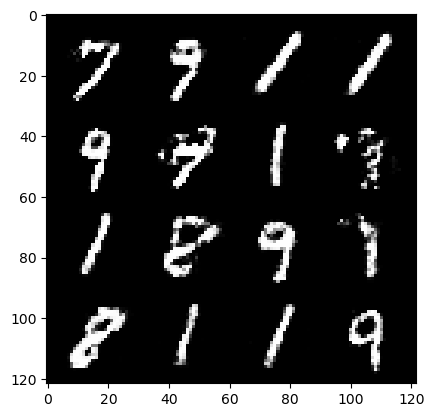

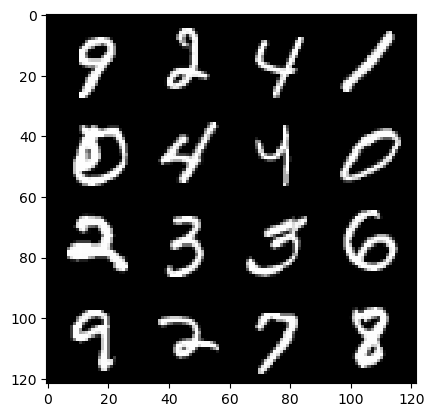

360: step 168900 / Gen loss: 1.4509267036120113 / disc_loss: 0.4149954533576965


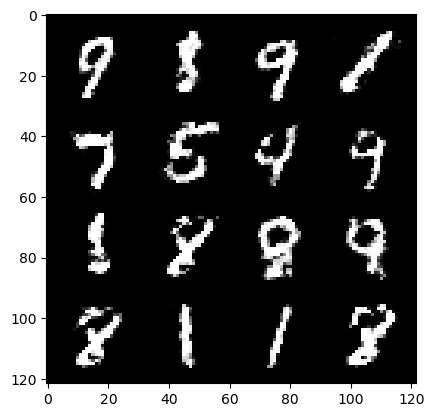

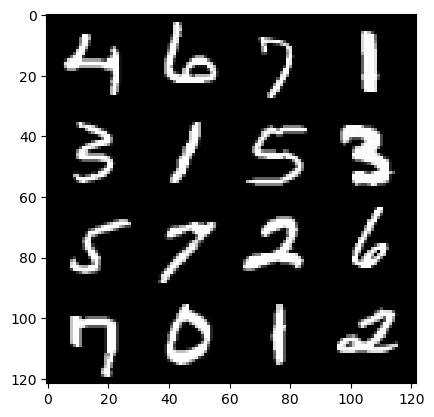

360: step 169200 / Gen loss: 1.4530290722846986 / disc_loss: 0.4161261311173436


  0%|          | 0/469 [00:00<?, ?it/s]

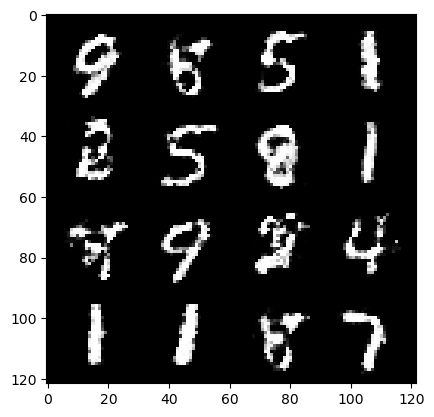

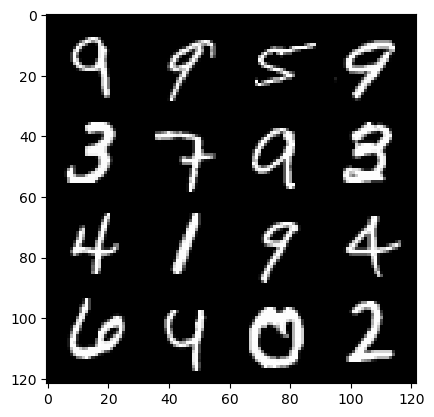

361: step 169500 / Gen loss: 1.4680975000063585 / disc_loss: 0.4129643279314041


  0%|          | 0/469 [00:00<?, ?it/s]

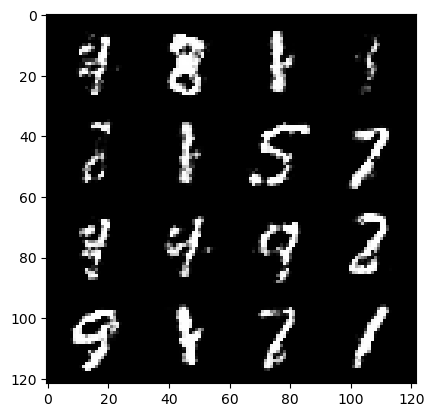

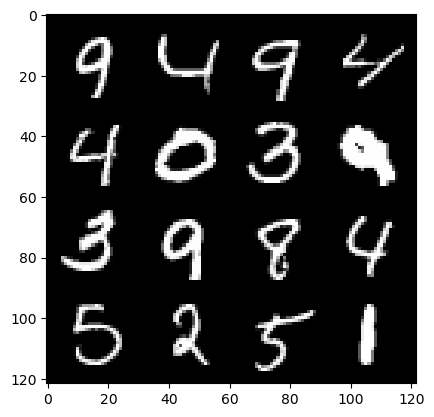

362: step 169800 / Gen loss: 1.436232937574386 / disc_loss: 0.42168869266907355


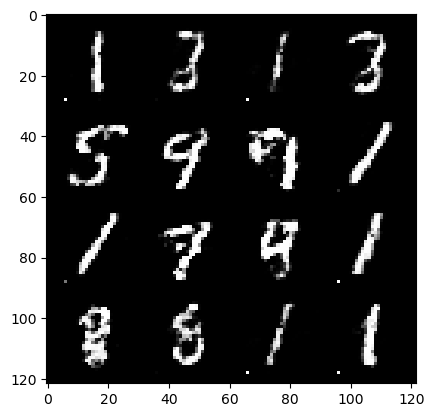

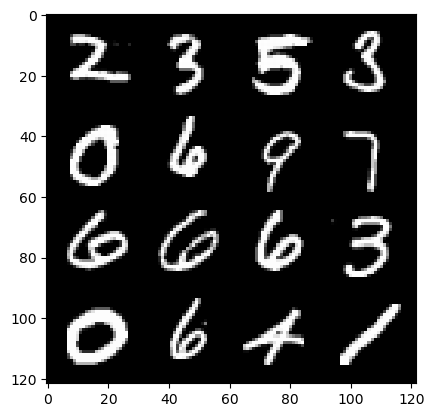

362: step 170100 / Gen loss: 1.370165845155716 / disc_loss: 0.47181414683659867


  0%|          | 0/469 [00:00<?, ?it/s]

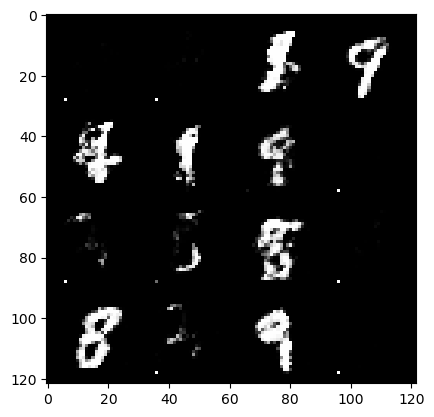

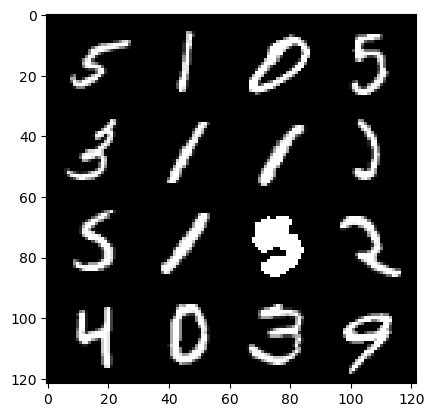

363: step 170400 / Gen loss: 0.9831092697381972 / disc_loss: 0.8353113587697342


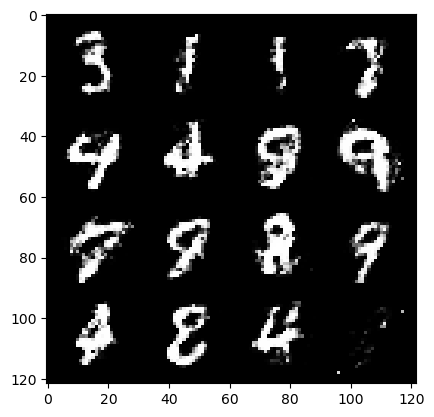

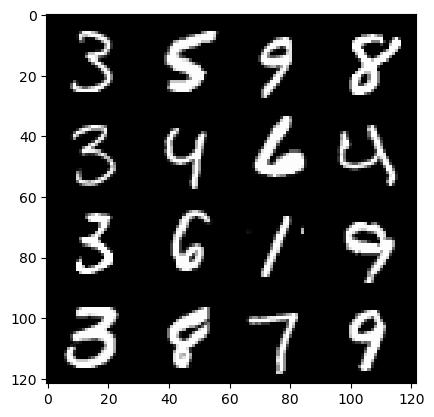

363: step 170700 / Gen loss: 1.1742219865322117 / disc_loss: 0.4729289892315867


  0%|          | 0/469 [00:00<?, ?it/s]

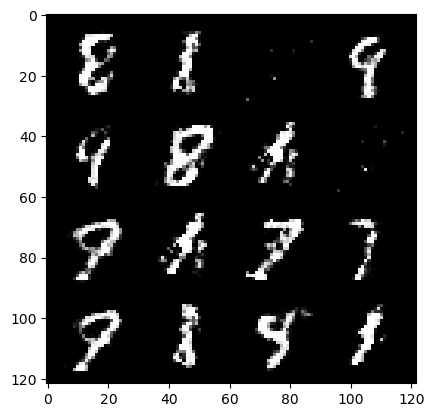

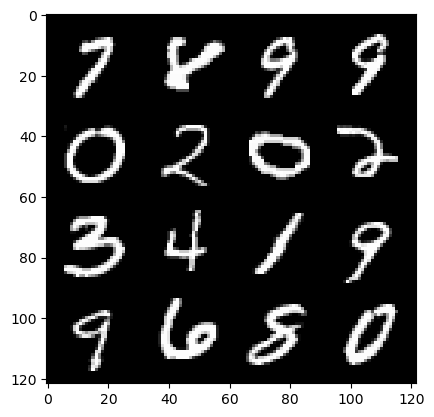

364: step 171000 / Gen loss: 1.2609547793865206 / disc_loss: 0.4380801099538807


  0%|          | 0/469 [00:00<?, ?it/s]

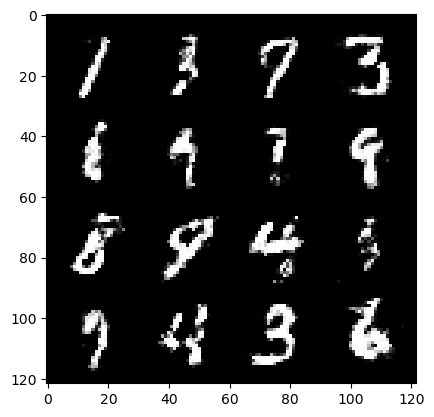

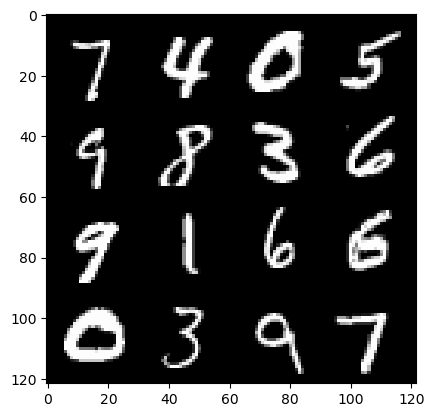

365: step 171300 / Gen loss: 1.2349068077405303 / disc_loss: 0.4320336064696313


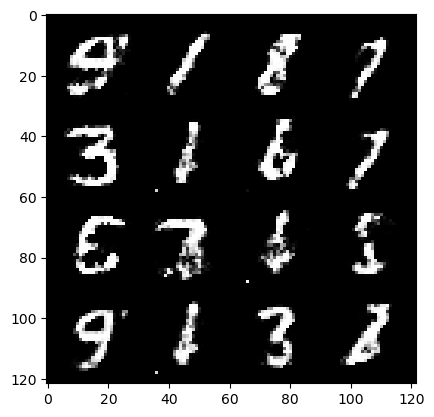

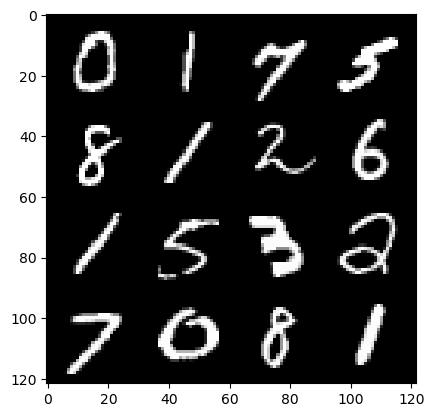

365: step 171600 / Gen loss: 1.26707540710767 / disc_loss: 0.4508585597078


  0%|          | 0/469 [00:00<?, ?it/s]

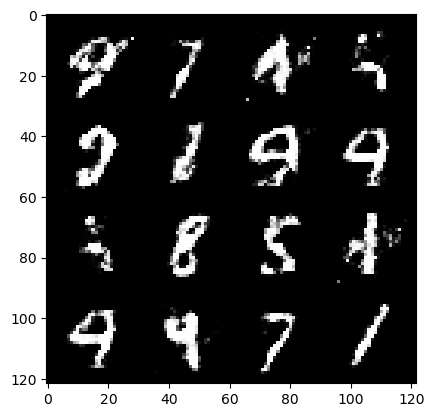

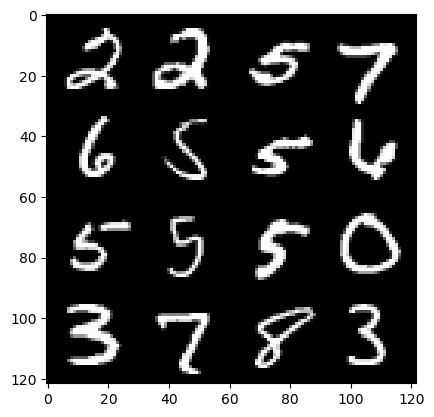

366: step 171900 / Gen loss: 1.2875286479791013 / disc_loss: 0.44354730874299986


  0%|          | 0/469 [00:00<?, ?it/s]

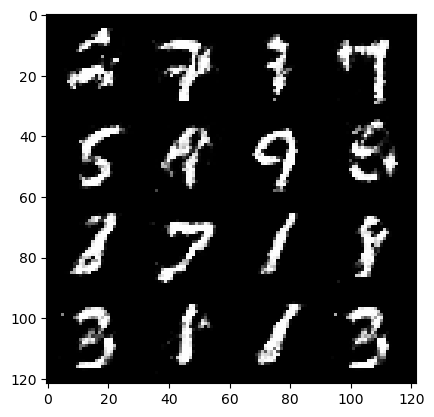

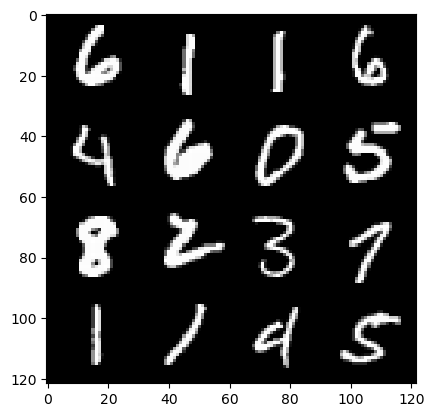

367: step 172200 / Gen loss: 1.2820746107896164 / disc_loss: 0.4476618053515752


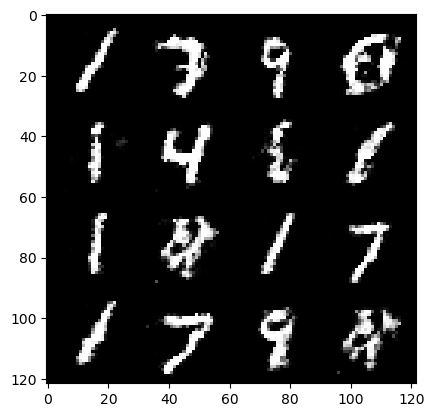

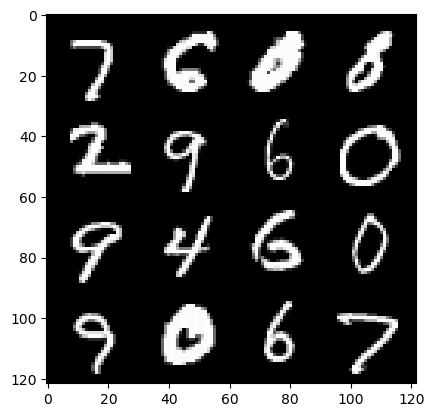

367: step 172500 / Gen loss: 1.2763643292586018 / disc_loss: 0.4613258657852809


  0%|          | 0/469 [00:00<?, ?it/s]

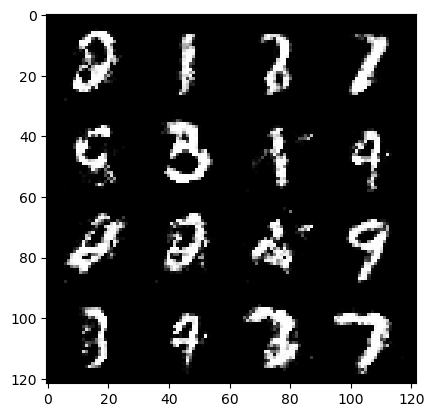

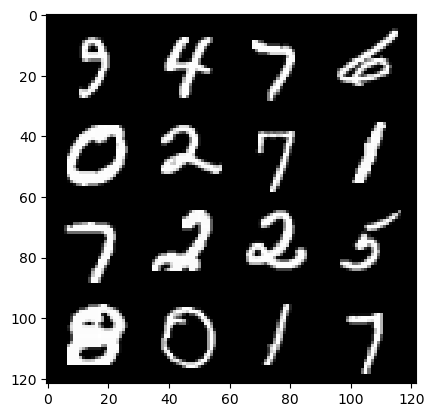

368: step 172800 / Gen loss: 1.2519609502951297 / disc_loss: 0.4690013911326728


  0%|          | 0/469 [00:00<?, ?it/s]

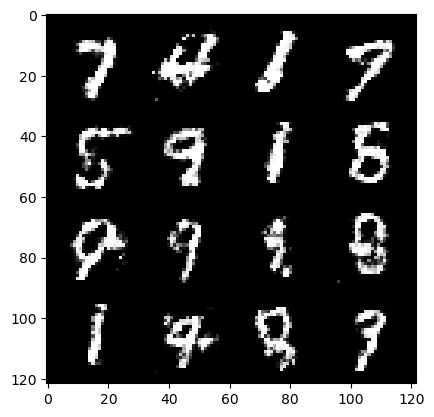

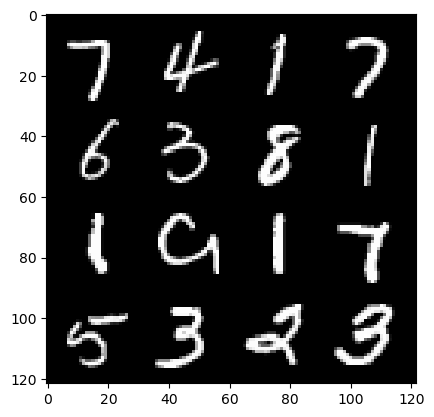

369: step 173100 / Gen loss: 1.2858115502198533 / disc_loss: 0.44900641947984715


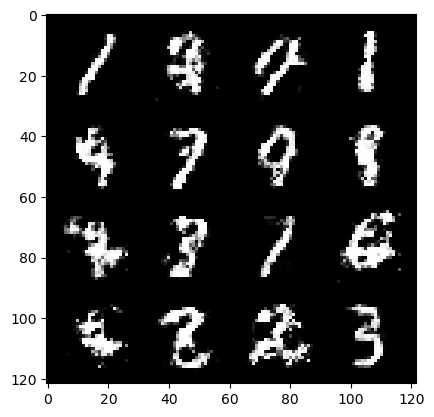

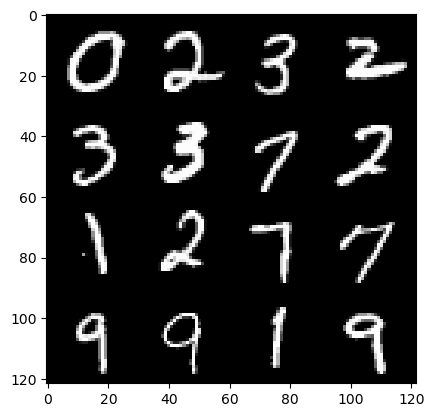

369: step 173400 / Gen loss: 1.2845768996079758 / disc_loss: 0.4510227535168326


  0%|          | 0/469 [00:00<?, ?it/s]

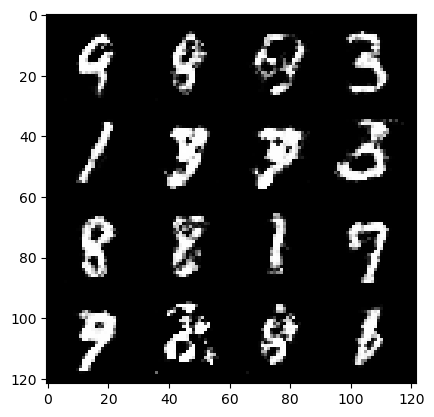

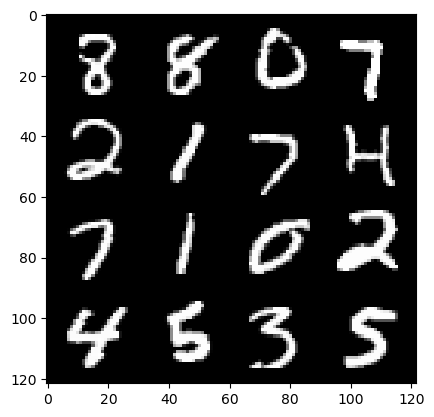

370: step 173700 / Gen loss: 1.3447095358371741 / disc_loss: 0.4322769301136334


  0%|          | 0/469 [00:00<?, ?it/s]

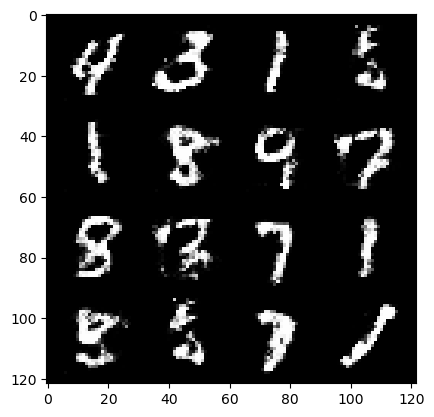

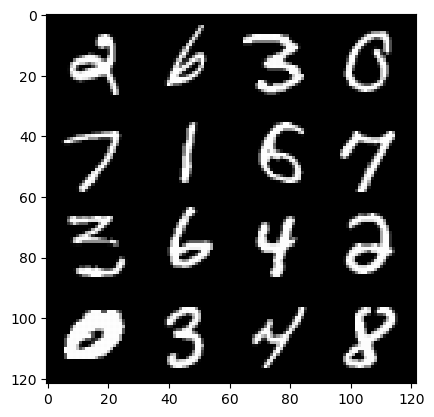

371: step 174000 / Gen loss: 1.3151955842971803 / disc_loss: 0.45011692792177166


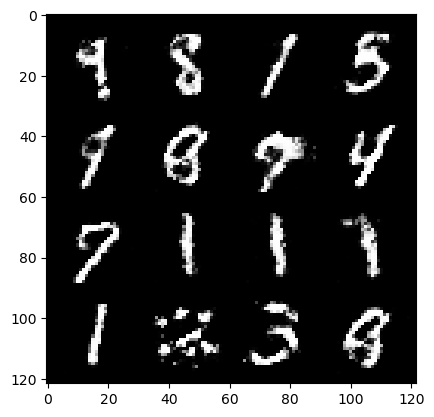

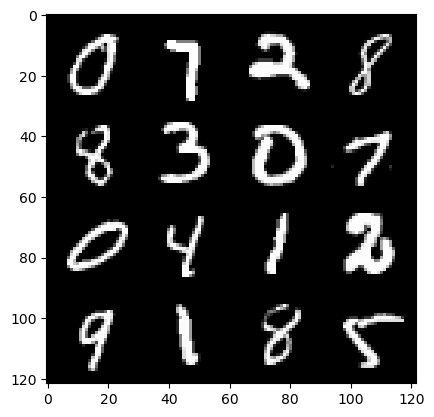

371: step 174300 / Gen loss: 1.3427430681387589 / disc_loss: 0.4490897488594054


  0%|          | 0/469 [00:00<?, ?it/s]

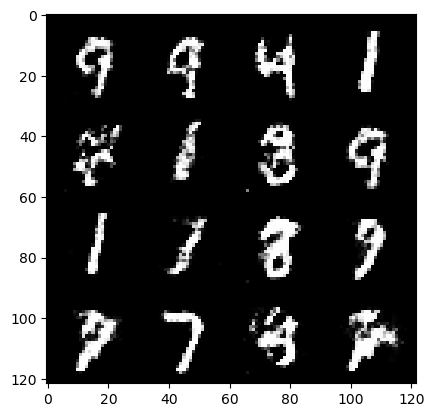

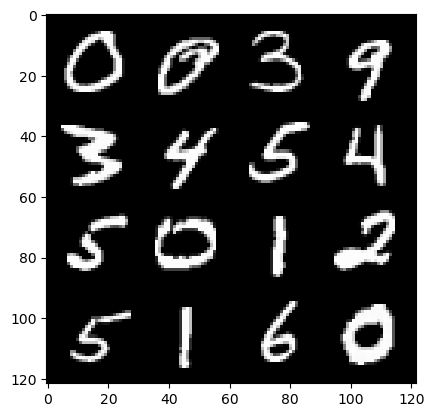

372: step 174600 / Gen loss: 1.362101860443751 / disc_loss: 0.43723402063051836


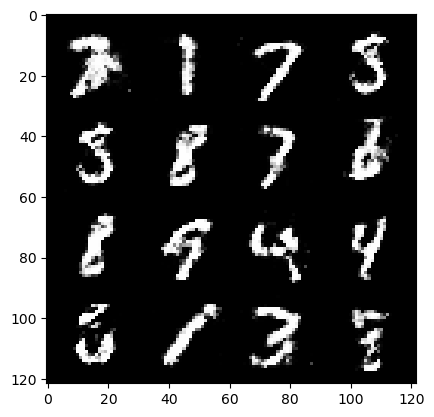

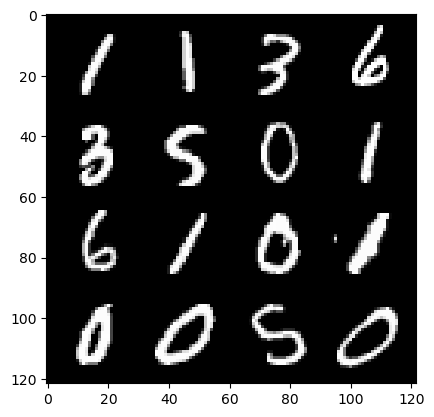

372: step 174900 / Gen loss: 1.4128356722990676 / disc_loss: 0.4260543299714727


  0%|          | 0/469 [00:00<?, ?it/s]

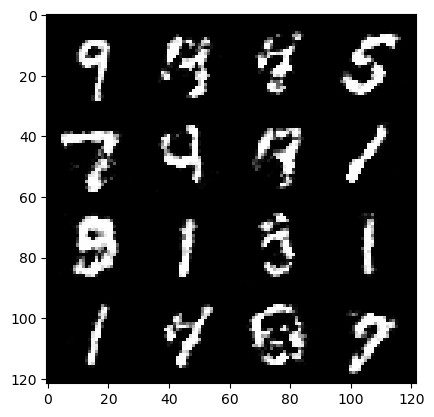

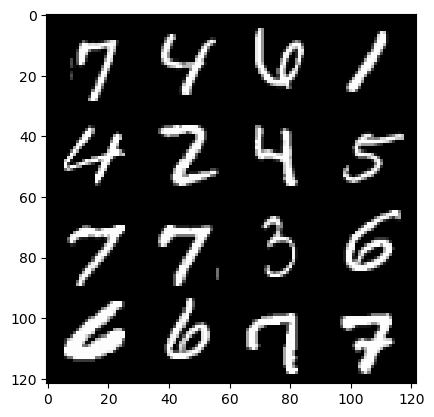

373: step 175200 / Gen loss: 1.3571443263689673 / disc_loss: 0.4513730607430139


  0%|          | 0/469 [00:00<?, ?it/s]

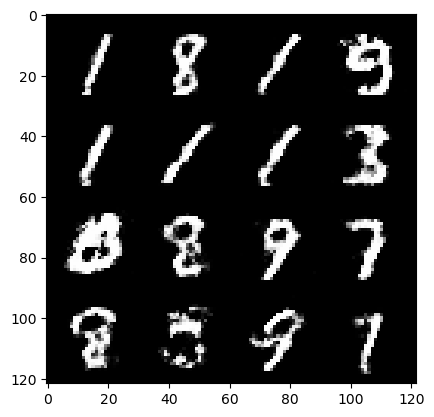

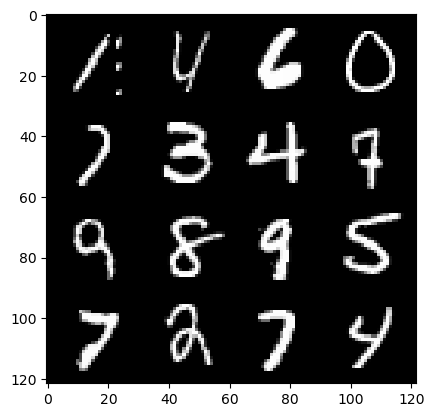

374: step 175500 / Gen loss: 1.368054624795914 / disc_loss: 0.4410204478104907


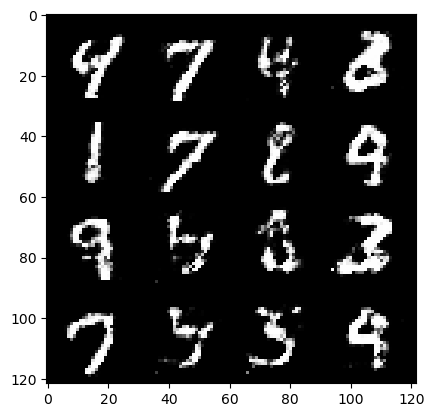

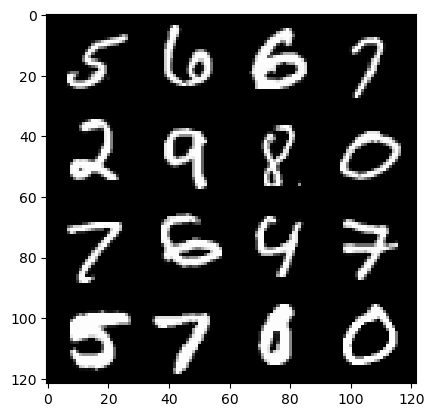

374: step 175800 / Gen loss: 1.335598444541297 / disc_loss: 0.45127676089604674


  0%|          | 0/469 [00:00<?, ?it/s]

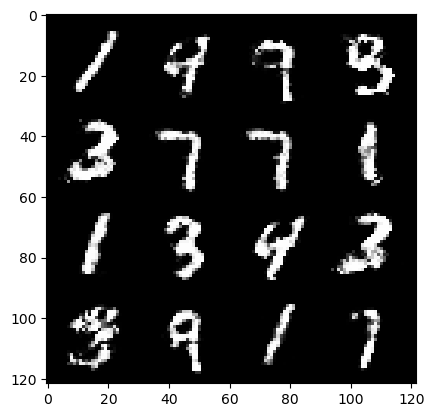

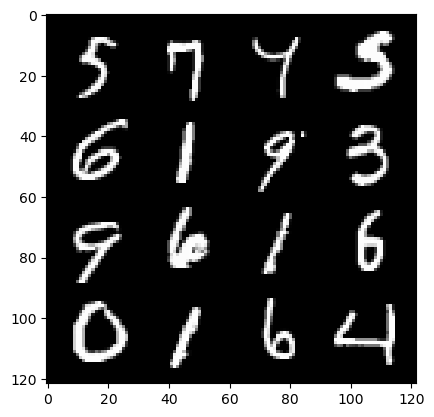

375: step 176100 / Gen loss: 1.3679815045992536 / disc_loss: 0.43657824546098717


  0%|          | 0/469 [00:00<?, ?it/s]

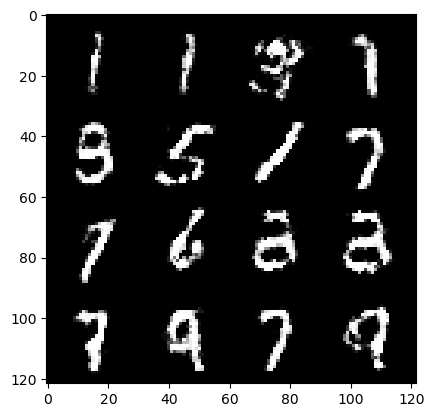

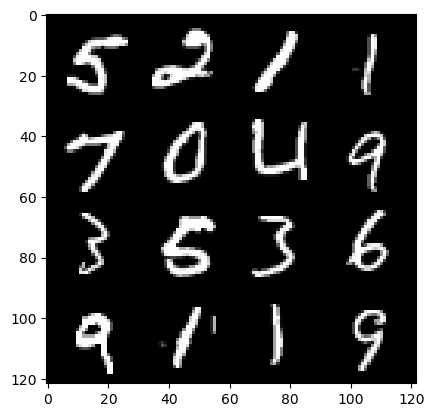

376: step 176400 / Gen loss: 1.3670233849684403 / disc_loss: 0.45126085569461155


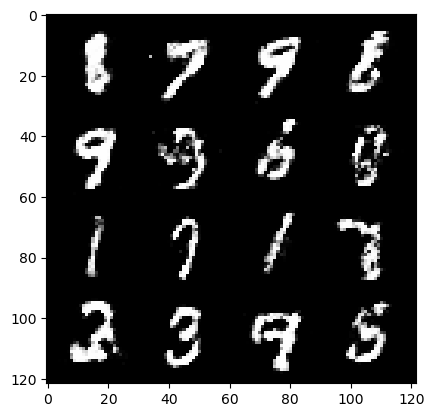

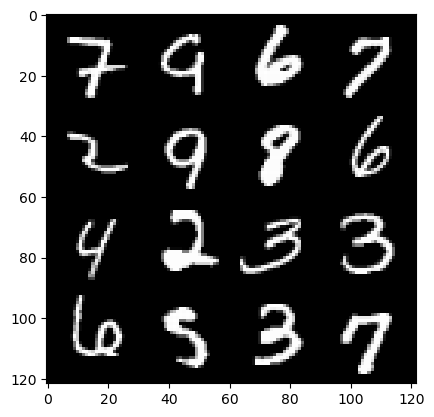

376: step 176700 / Gen loss: 1.3224349923928576 / disc_loss: 0.4621258304516474


  0%|          | 0/469 [00:00<?, ?it/s]

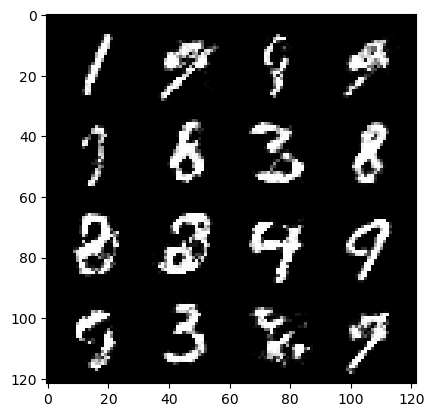

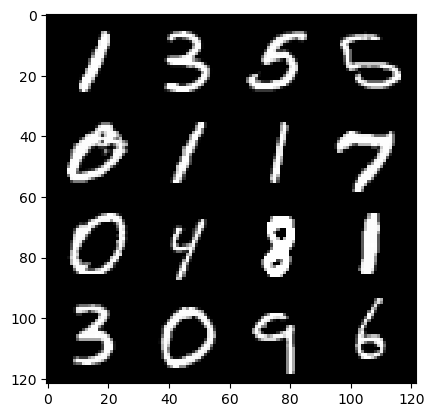

377: step 177000 / Gen loss: 1.3321238001187647 / disc_loss: 0.46594347546497983


  0%|          | 0/469 [00:00<?, ?it/s]

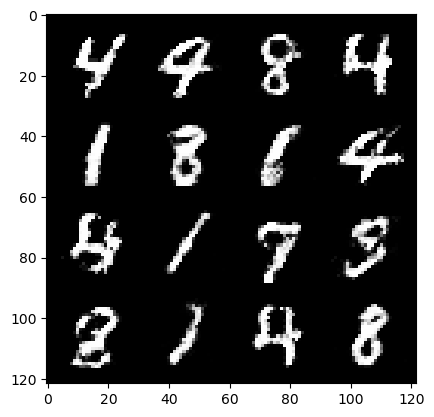

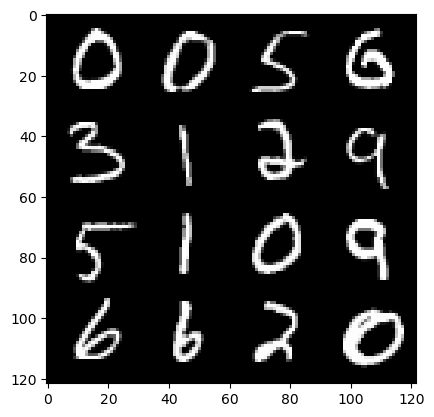

378: step 177300 / Gen loss: 1.3526098875204724 / disc_loss: 0.44510240366061476


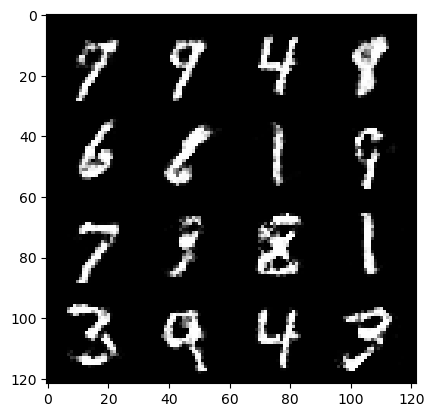

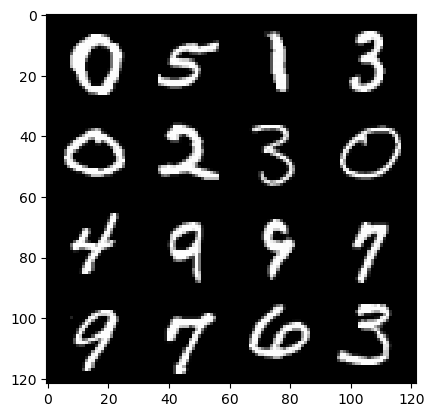

378: step 177600 / Gen loss: 1.3811814117431636 / disc_loss: 0.4369678956270219


  0%|          | 0/469 [00:00<?, ?it/s]

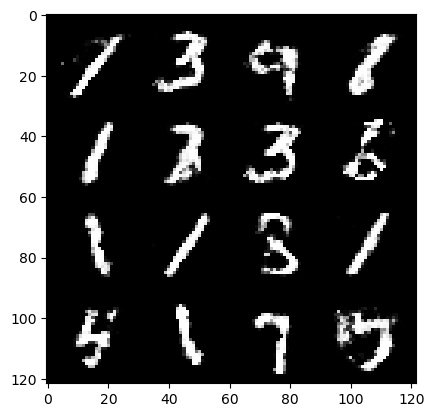

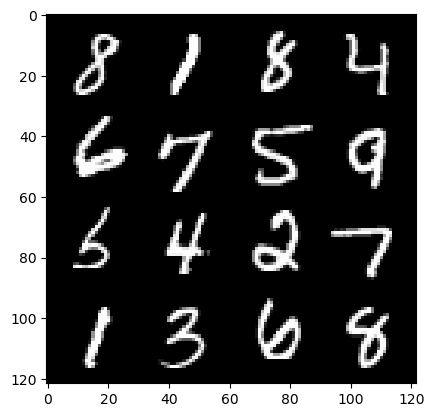

379: step 177900 / Gen loss: 1.3566935650507608 / disc_loss: 0.4469895632068317


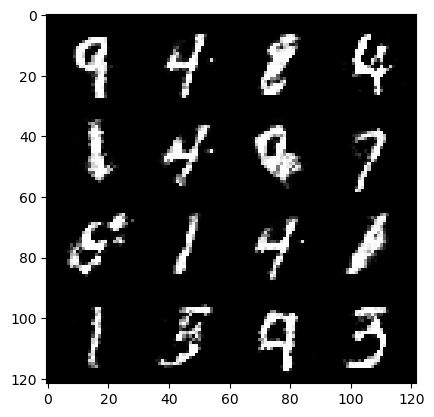

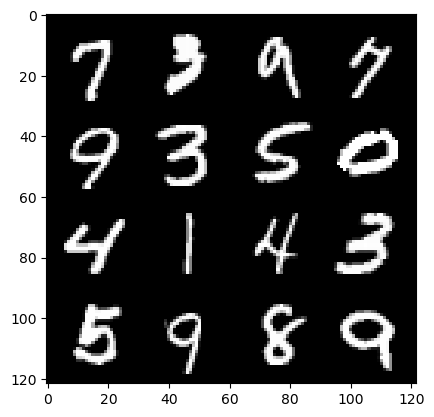

379: step 178200 / Gen loss: 1.3204644775390633 / disc_loss: 0.4675262405474982


  0%|          | 0/469 [00:00<?, ?it/s]

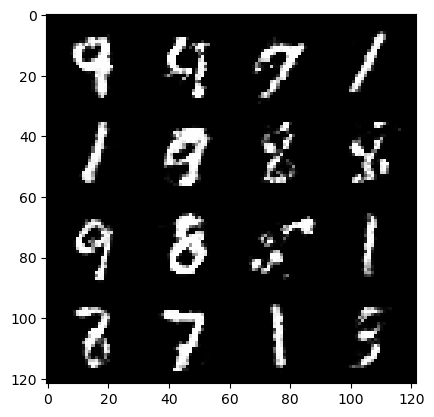

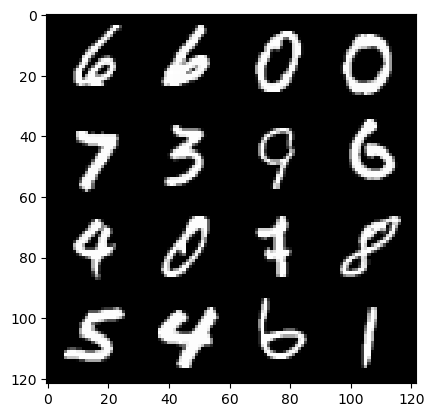

380: step 178500 / Gen loss: 1.3394950131575272 / disc_loss: 0.44196219225724537


  0%|          | 0/469 [00:00<?, ?it/s]

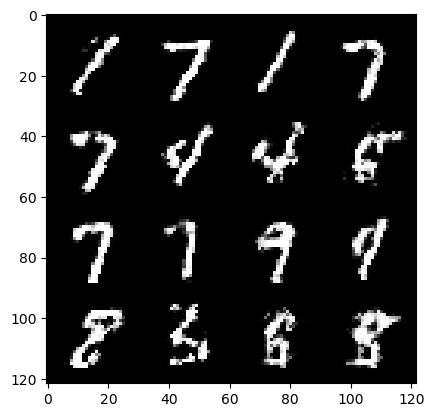

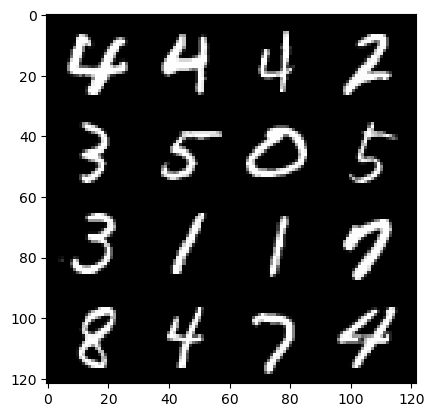

381: step 178800 / Gen loss: 1.3379954477151252 / disc_loss: 0.45240509152412384


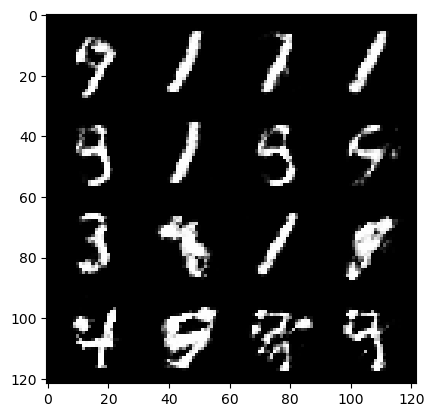

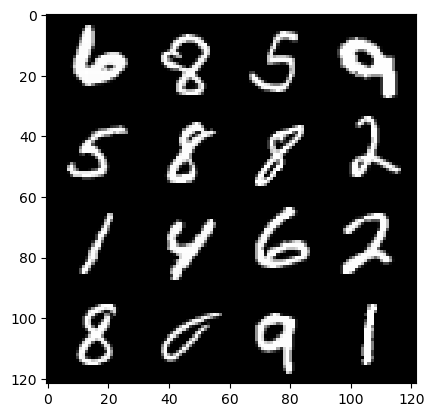

381: step 179100 / Gen loss: 1.3824879165490473 / disc_loss: 0.4452399213115374


  0%|          | 0/469 [00:00<?, ?it/s]

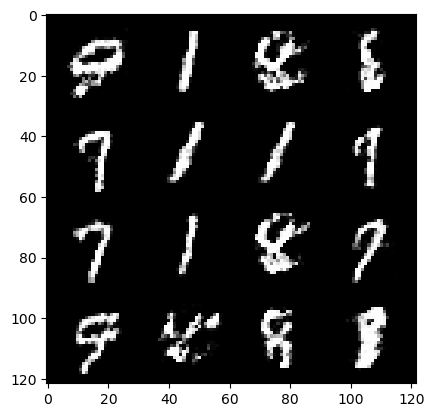

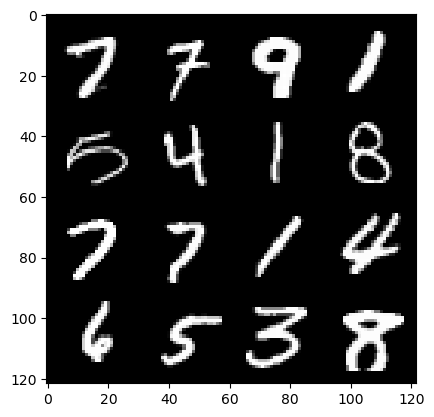

382: step 179400 / Gen loss: 1.3900110423564913 / disc_loss: 0.44535109430551517


  0%|          | 0/469 [00:00<?, ?it/s]

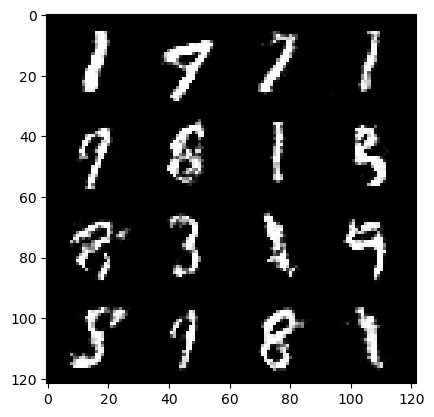

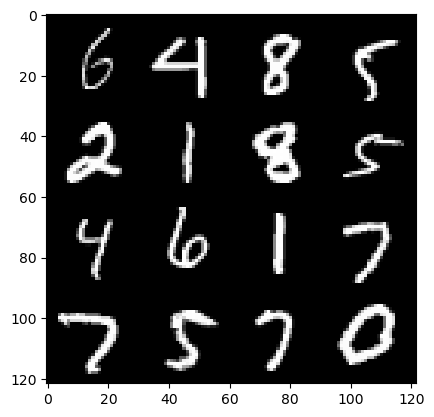

383: step 179700 / Gen loss: 1.3967525398731233 / disc_loss: 0.44337077031532945


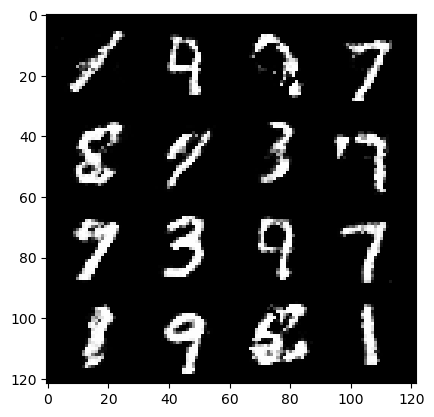

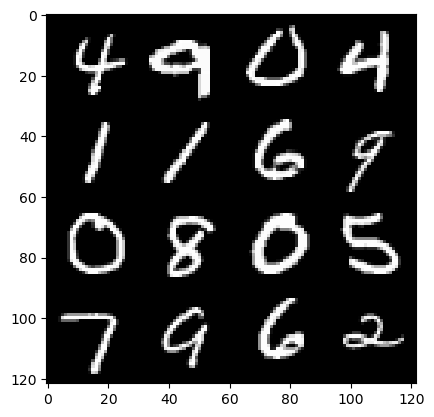

383: step 180000 / Gen loss: 1.352344954808553 / disc_loss: 0.45484731684128477


  0%|          | 0/469 [00:00<?, ?it/s]

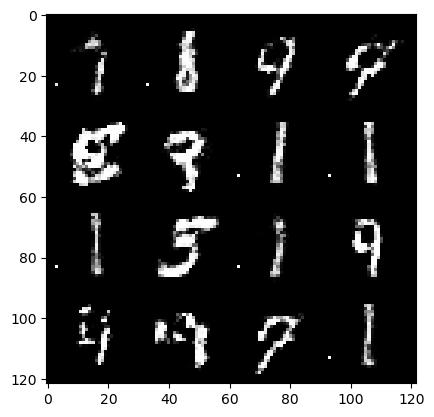

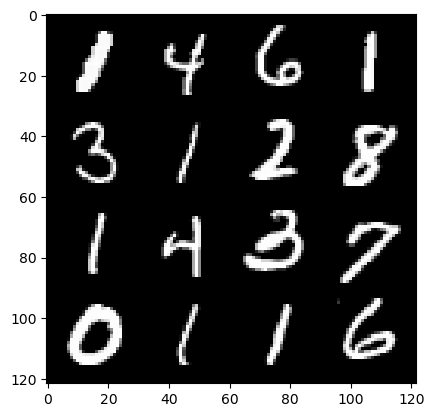

384: step 180300 / Gen loss: 1.3252790439128874 / disc_loss: 0.47752858320872


  0%|          | 0/469 [00:00<?, ?it/s]

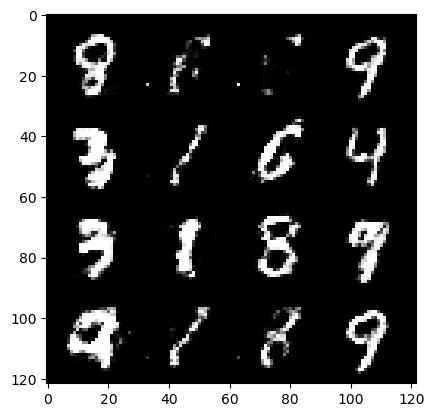

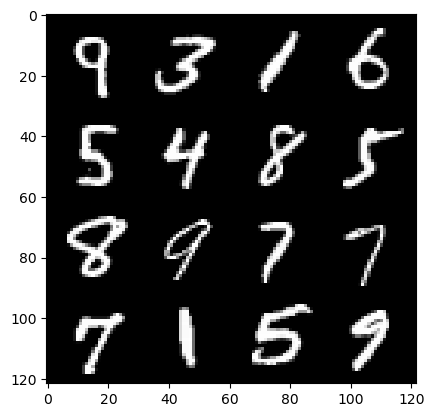

385: step 180600 / Gen loss: 1.409450650215149 / disc_loss: 0.40760072807471004


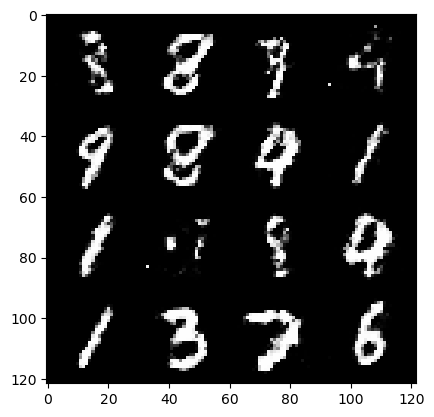

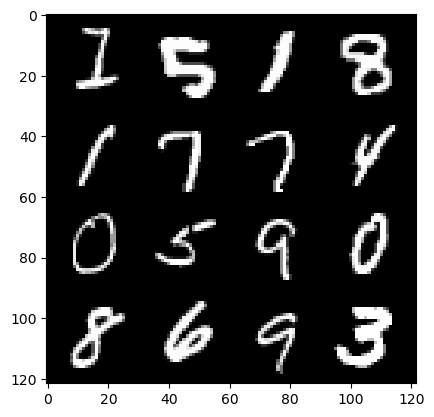

385: step 180900 / Gen loss: 1.419284845193227 / disc_loss: 0.3901715211073558


  0%|          | 0/469 [00:00<?, ?it/s]

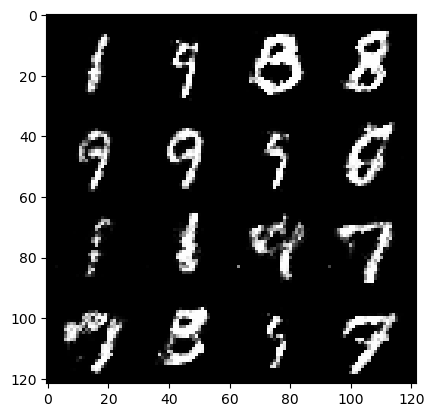

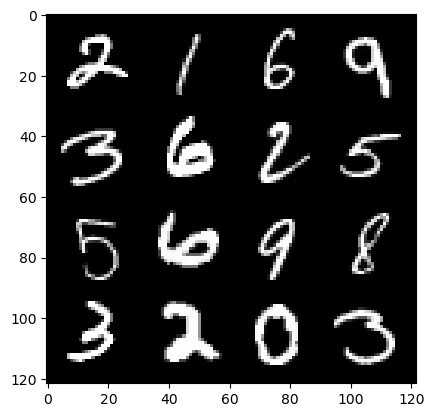

386: step 181200 / Gen loss: 1.4249637806415552 / disc_loss: 0.40940010309219377


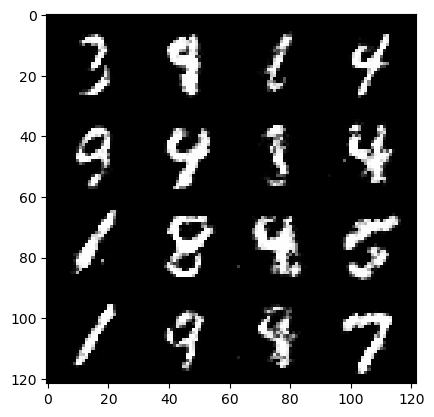

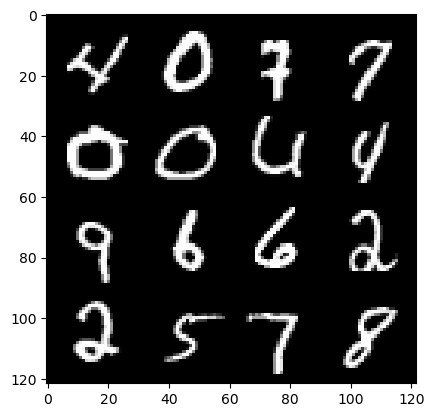

386: step 181500 / Gen loss: 1.402632440328597 / disc_loss: 0.41999271035194385


  0%|          | 0/469 [00:00<?, ?it/s]

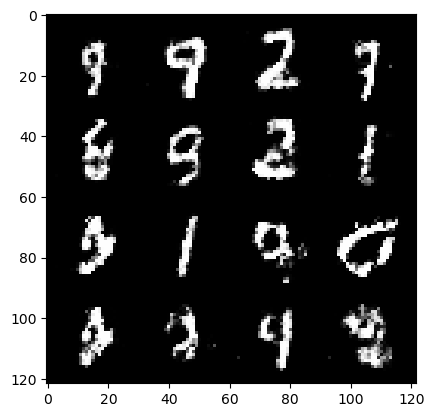

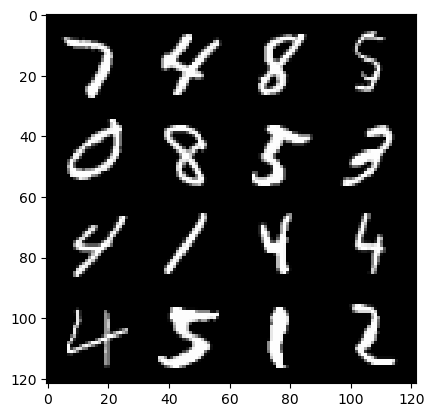

387: step 181800 / Gen loss: 1.3912988996505737 / disc_loss: 0.4244796937704084


  0%|          | 0/469 [00:00<?, ?it/s]

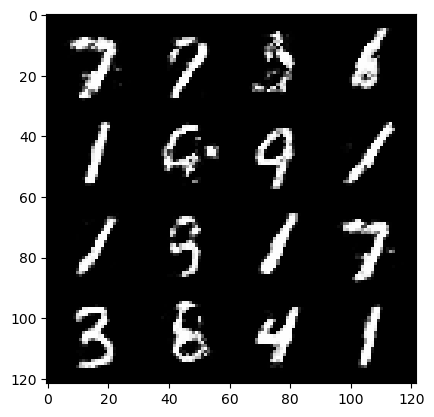

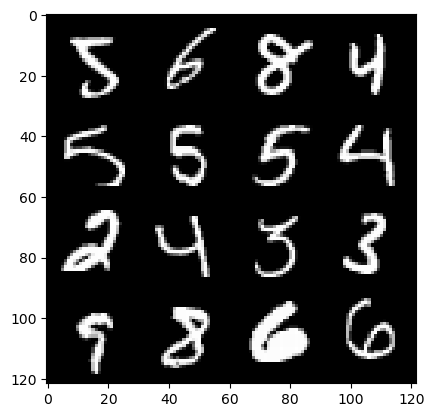

388: step 182100 / Gen loss: 1.3961819986502324 / disc_loss: 0.4366631042957307


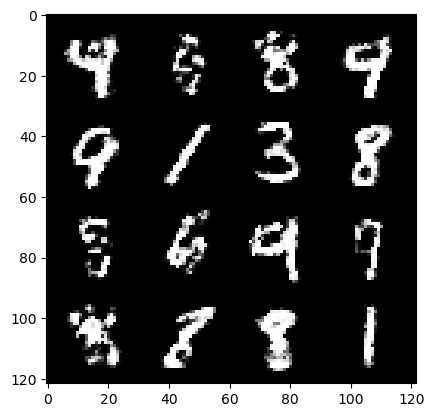

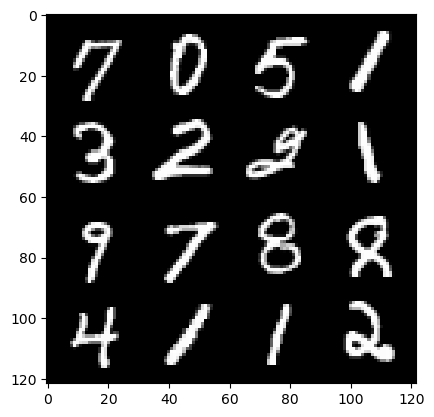

388: step 182400 / Gen loss: 1.3663433941205343 / disc_loss: 0.45023580292860693


  0%|          | 0/469 [00:00<?, ?it/s]

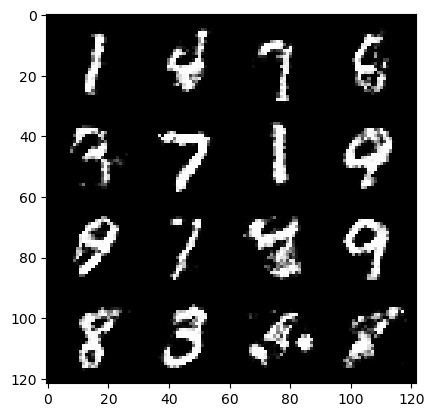

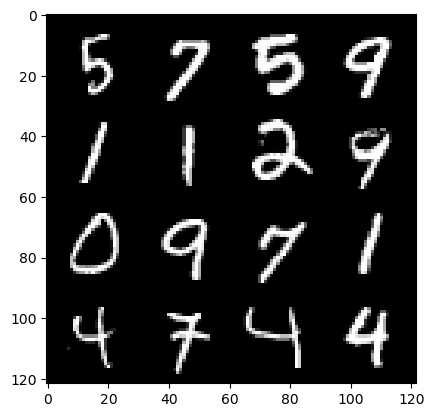

389: step 182700 / Gen loss: 1.3761360565821323 / disc_loss: 0.4517557725310324


  0%|          | 0/469 [00:00<?, ?it/s]

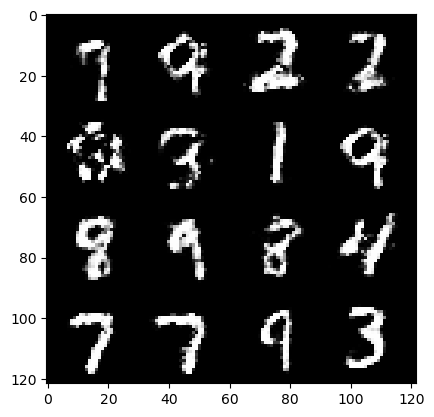

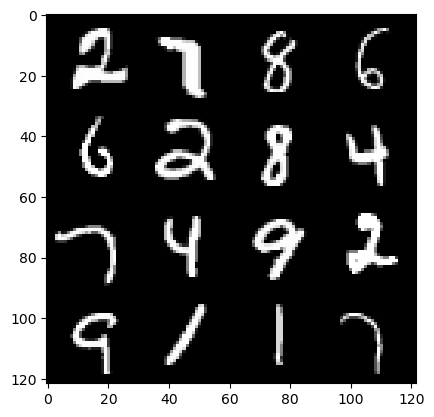

390: step 183000 / Gen loss: 1.4074365973472591 / disc_loss: 0.4324742085735005


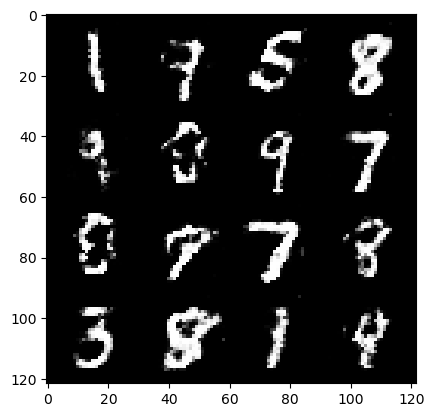

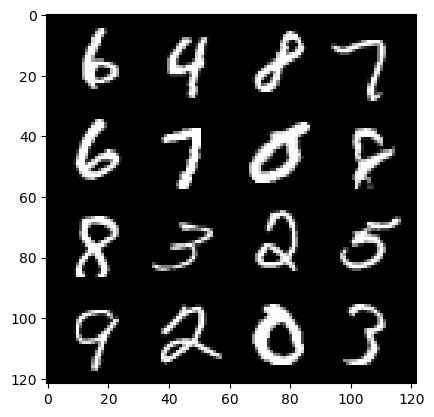

390: step 183300 / Gen loss: 1.4240229662259414 / disc_loss: 0.4353073326746621


  0%|          | 0/469 [00:00<?, ?it/s]

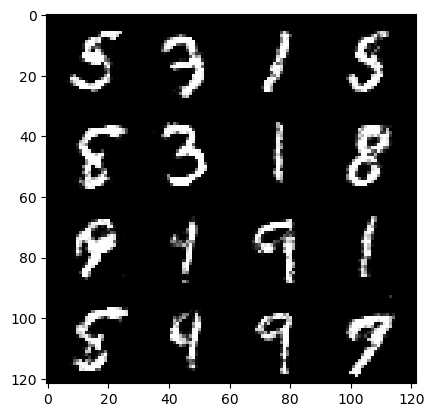

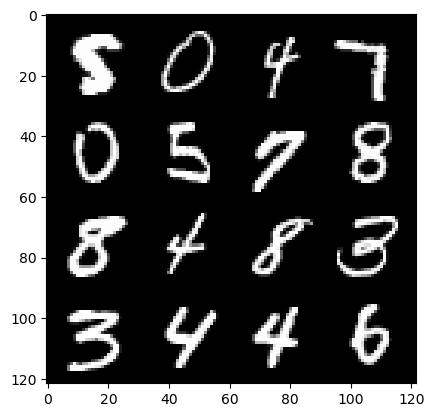

391: step 183600 / Gen loss: 1.3747449433803551 / disc_loss: 0.43548281262318317


  0%|          | 0/469 [00:00<?, ?it/s]

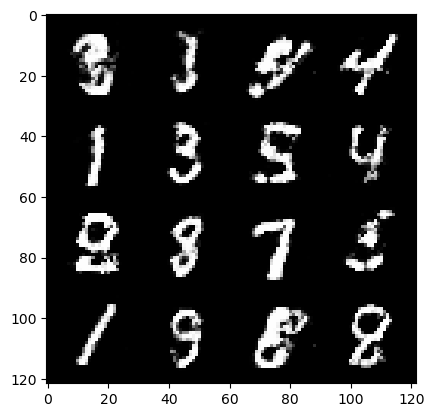

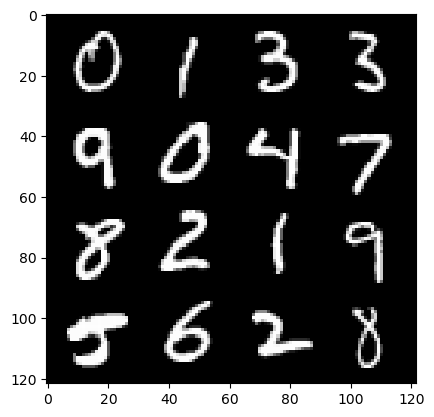

392: step 183900 / Gen loss: 1.4045529524485274 / disc_loss: 0.4321411279837287


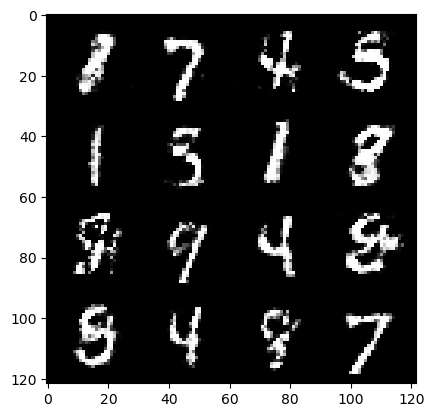

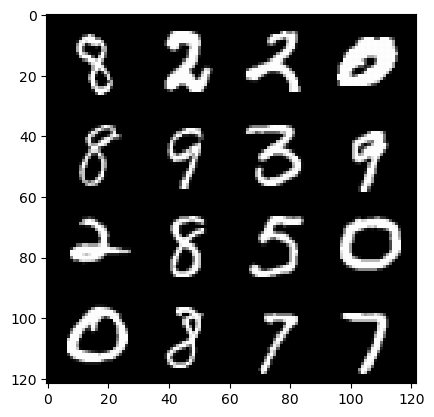

392: step 184200 / Gen loss: 1.4127927223841343 / disc_loss: 0.44109776943922047


  0%|          | 0/469 [00:00<?, ?it/s]

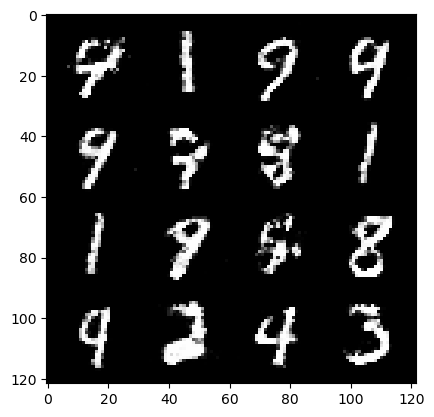

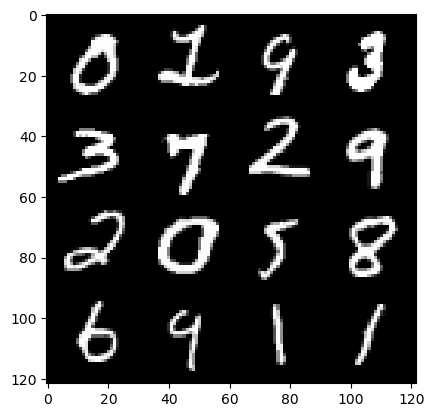

393: step 184500 / Gen loss: 1.4565275657176975 / disc_loss: 0.42068497598171223


  0%|          | 0/469 [00:00<?, ?it/s]

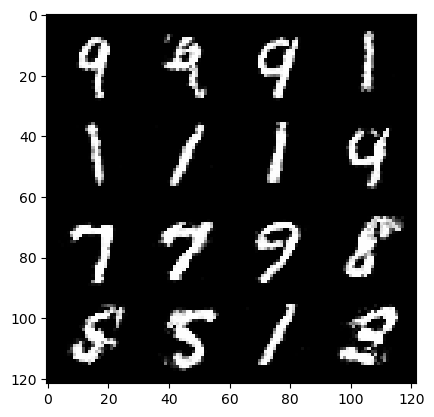

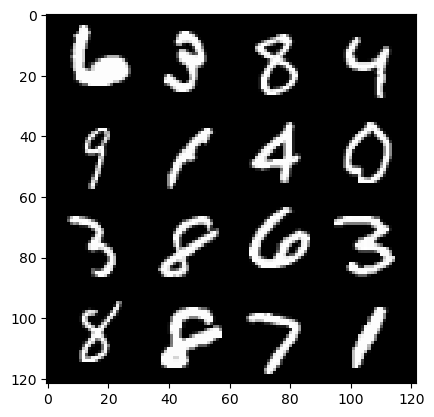

394: step 184800 / Gen loss: 1.4561070311069495 / disc_loss: 0.4230979375044506


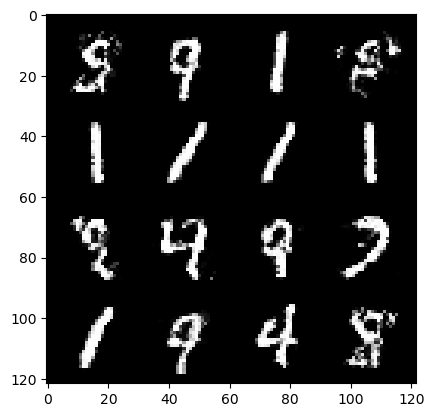

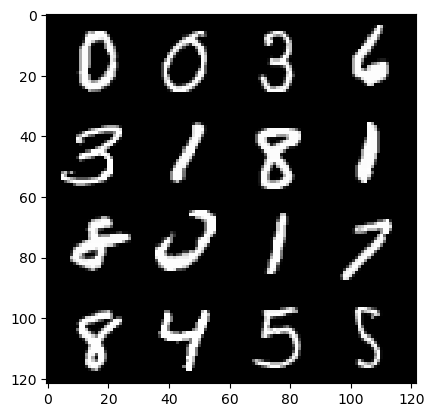

394: step 185100 / Gen loss: 1.4536988484859454 / disc_loss: 0.42890002429485297


  0%|          | 0/469 [00:00<?, ?it/s]

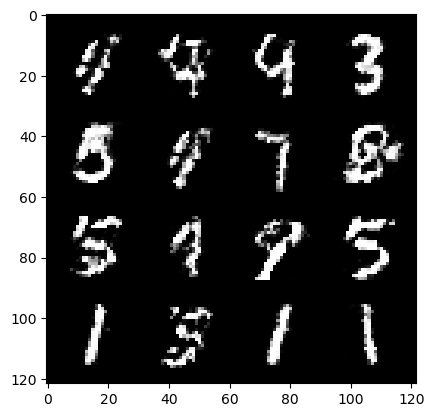

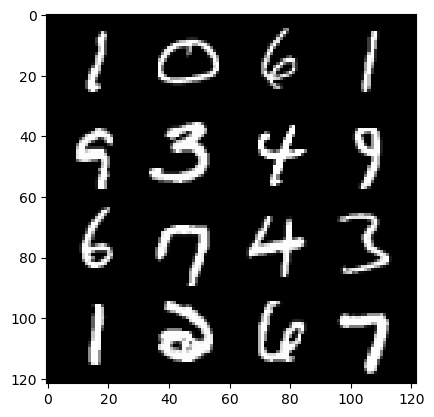

395: step 185400 / Gen loss: 1.422507132291795 / disc_loss: 0.4326848923166595


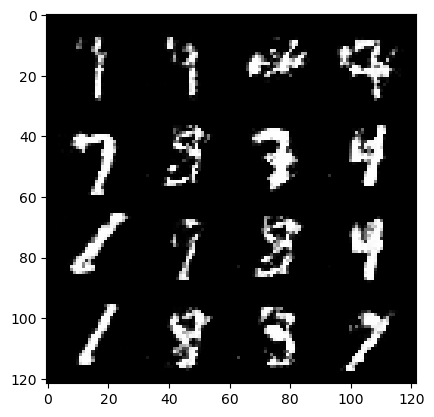

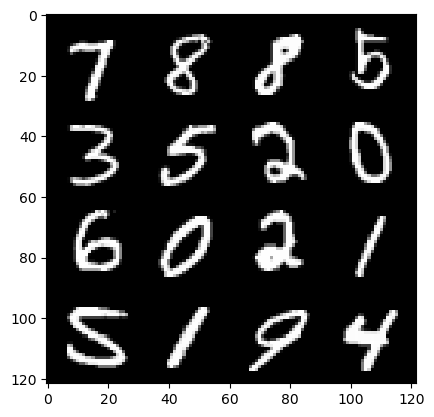

395: step 185700 / Gen loss: 1.4347346313794456 / disc_loss: 0.42475473483403486


  0%|          | 0/469 [00:00<?, ?it/s]

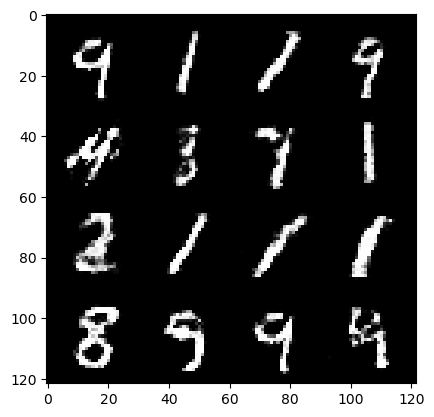

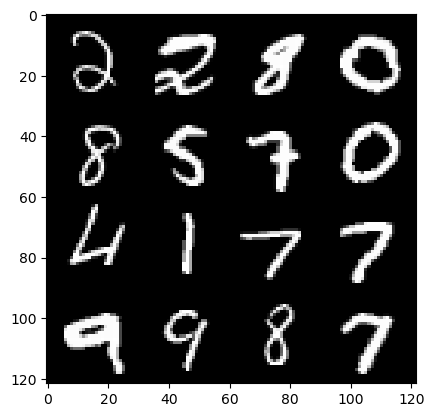

396: step 186000 / Gen loss: 1.4633874686559034 / disc_loss: 0.4123876497149468


  0%|          | 0/469 [00:00<?, ?it/s]

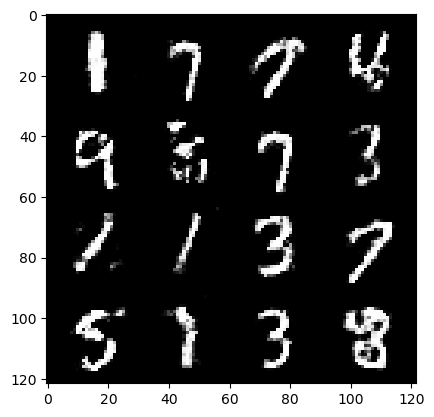

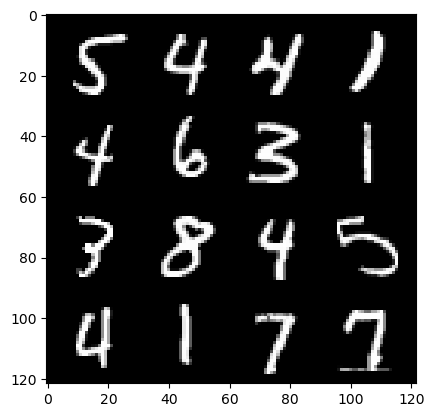

397: step 186300 / Gen loss: 1.4329895337422682 / disc_loss: 0.44078054428100555


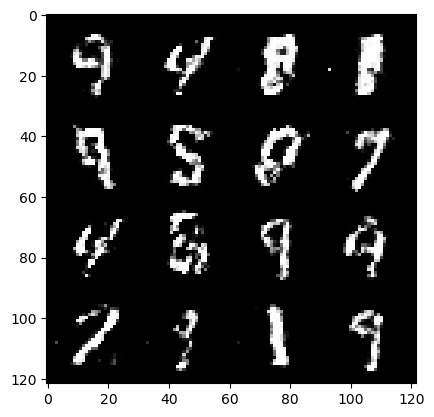

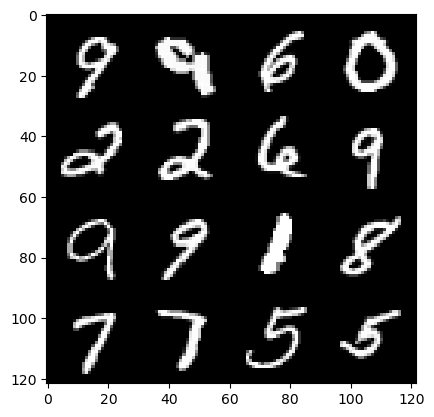

397: step 186600 / Gen loss: 1.423683246771495 / disc_loss: 0.4584483765562376


  0%|          | 0/469 [00:00<?, ?it/s]

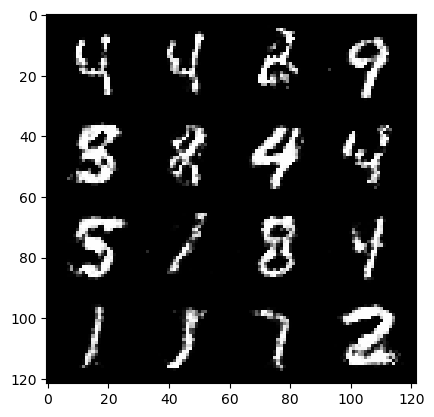

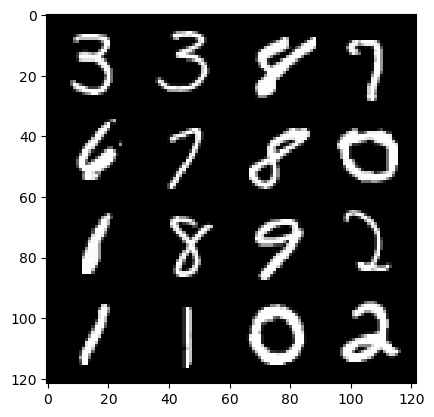

398: step 186900 / Gen loss: 1.3852076323827098 / disc_loss: 0.4262547997633616


  0%|          | 0/469 [00:00<?, ?it/s]

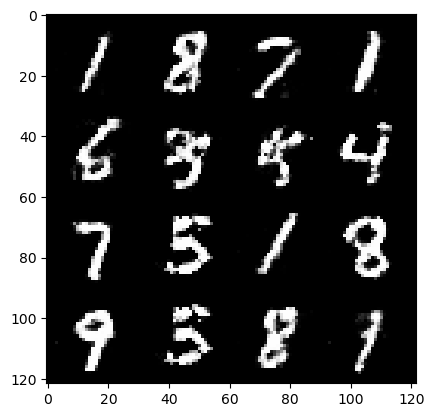

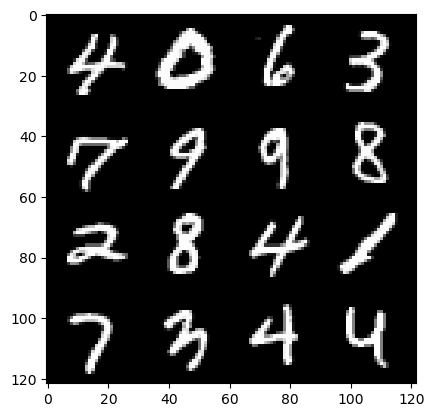

399: step 187200 / Gen loss: 1.311000145673752 / disc_loss: 0.4450149389108024


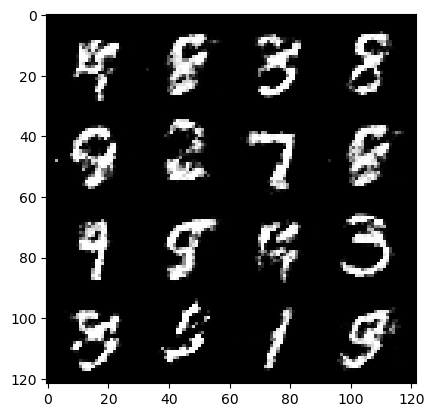

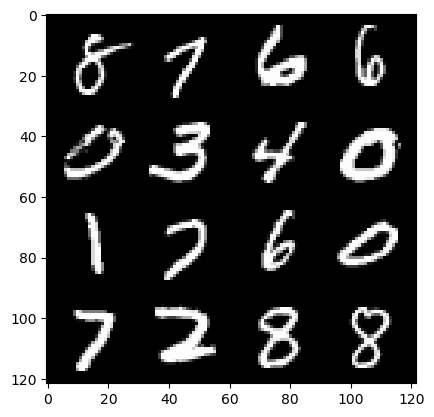

399: step 187500 / Gen loss: 1.3828485314051318 / disc_loss: 0.43504239330689093


  0%|          | 0/469 [00:00<?, ?it/s]

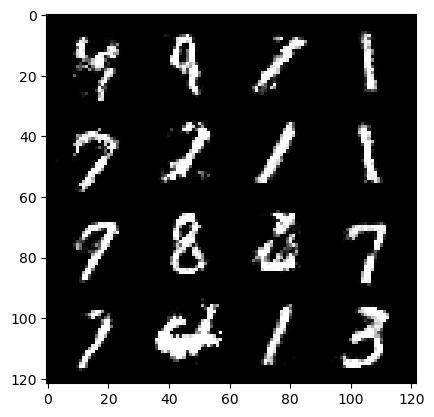

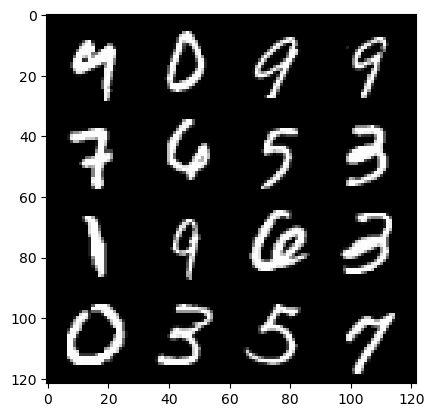

400: step 187800 / Gen loss: 1.4205538777510327 / disc_loss: 0.4303179994225502


  0%|          | 0/469 [00:00<?, ?it/s]

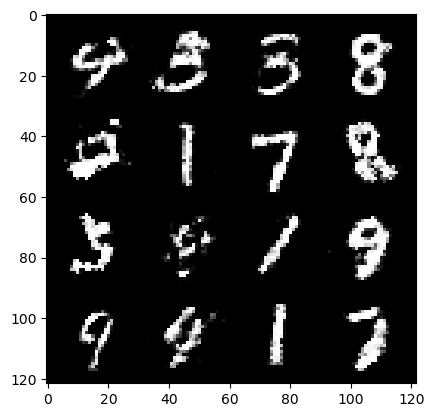

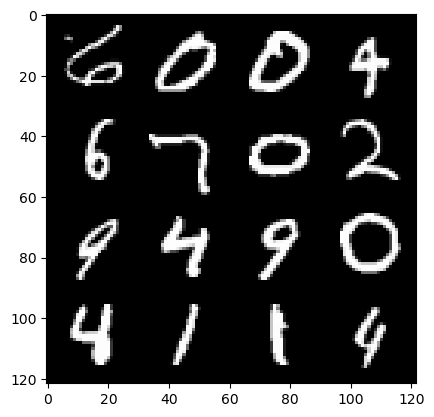

401: step 188100 / Gen loss: 1.4198392728964497 / disc_loss: 0.4383413463830945


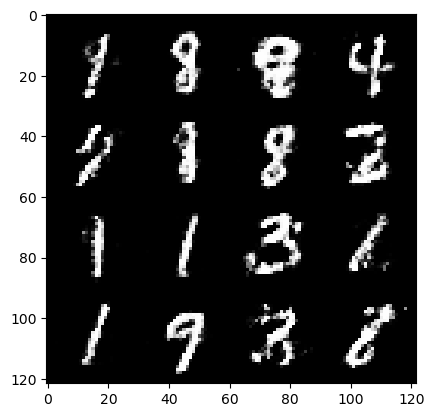

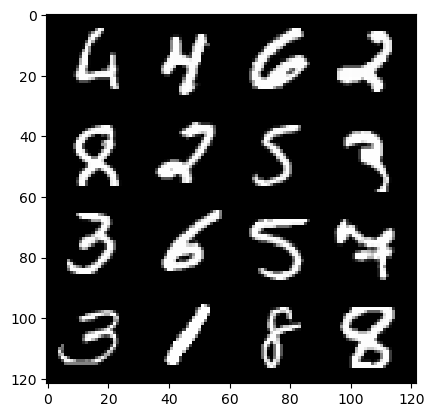

401: step 188400 / Gen loss: 1.4109581005573286 / disc_loss: 0.4388237596551579


  0%|          | 0/469 [00:00<?, ?it/s]

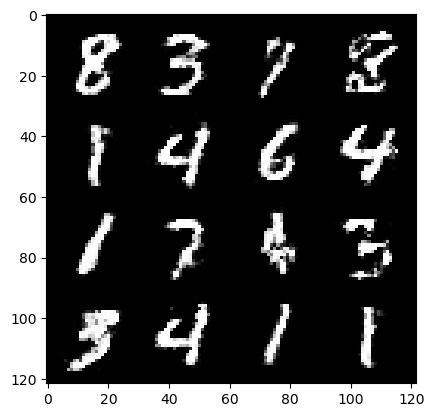

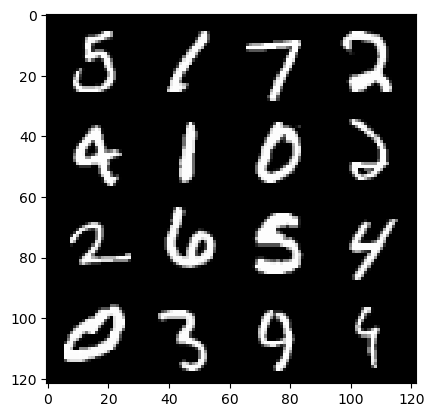

402: step 188700 / Gen loss: 1.4372877458731355 / disc_loss: 0.42738870650529853


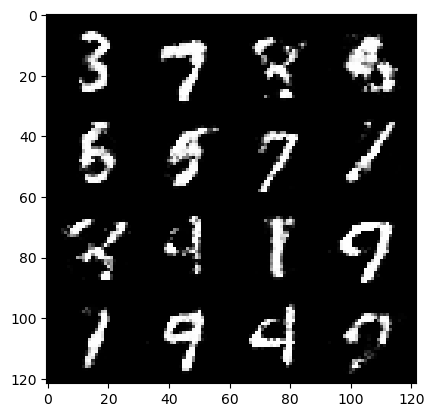

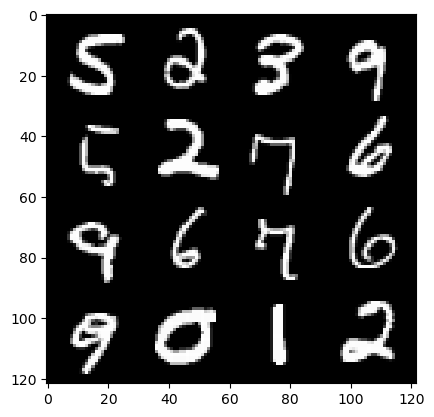

402: step 189000 / Gen loss: 1.4191993014017739 / disc_loss: 0.432704111635685


  0%|          | 0/469 [00:00<?, ?it/s]

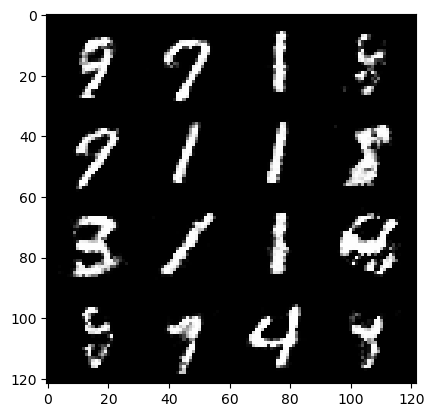

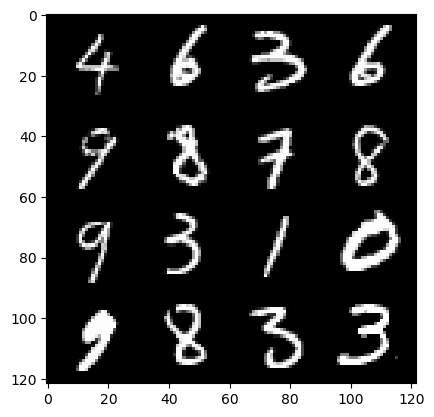

403: step 189300 / Gen loss: 1.4206391958395632 / disc_loss: 0.41898921589056626


  0%|          | 0/469 [00:00<?, ?it/s]

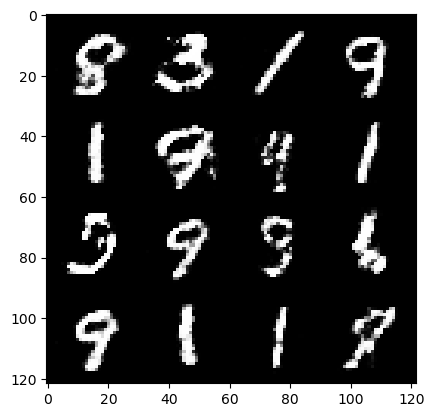

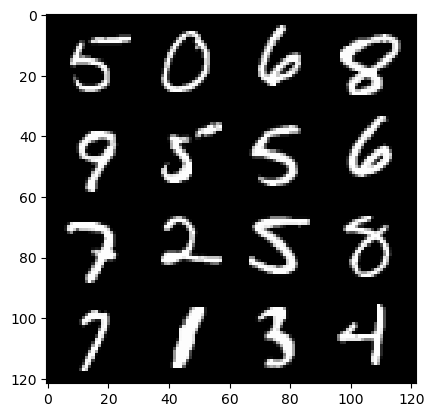

404: step 189600 / Gen loss: 1.437539451519648 / disc_loss: 0.423701279362043


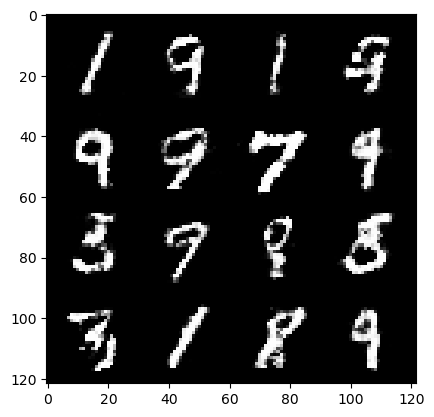

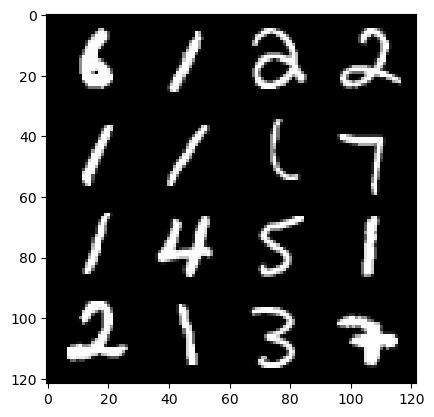

404: step 189900 / Gen loss: 1.3881876921653749 / disc_loss: 0.443971804479758


  0%|          | 0/469 [00:00<?, ?it/s]

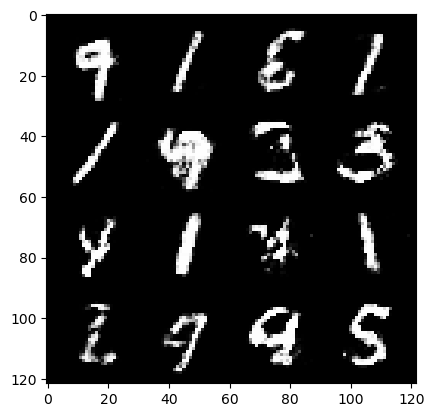

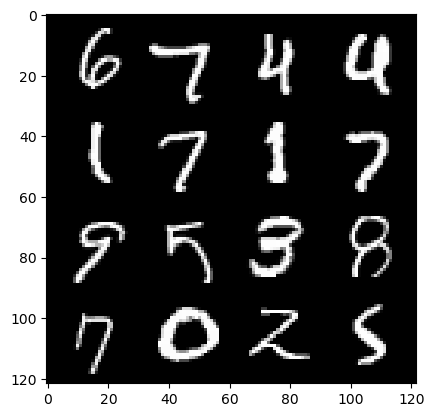

405: step 190200 / Gen loss: 1.4065620652834574 / disc_loss: 0.43480660746494904


  0%|          | 0/469 [00:00<?, ?it/s]

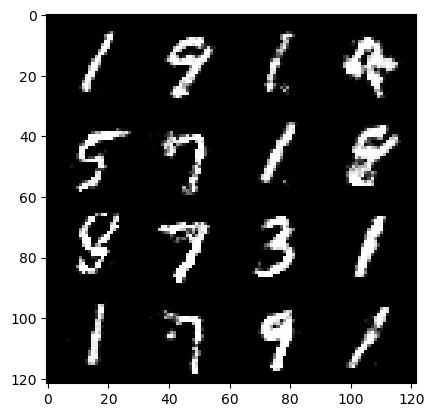

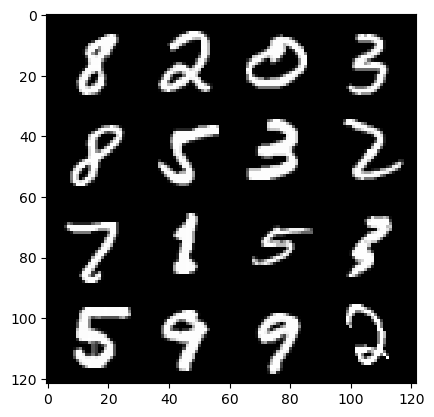

406: step 190500 / Gen loss: 1.4104988912741345 / disc_loss: 0.44240697364012377


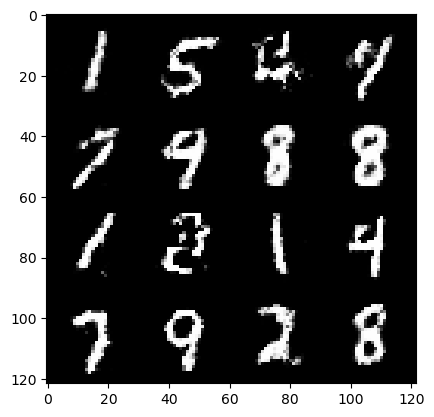

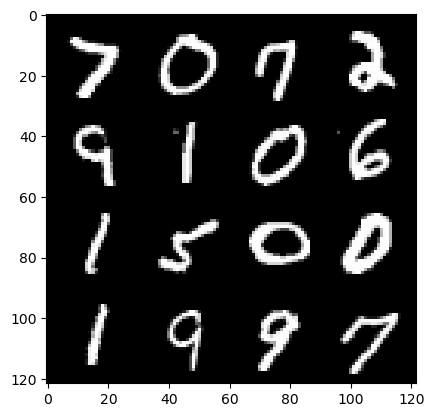

406: step 190800 / Gen loss: 1.4253003549575811 / disc_loss: 0.43592285901308053


  0%|          | 0/469 [00:00<?, ?it/s]

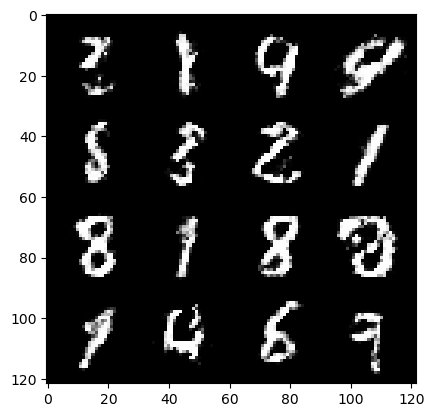

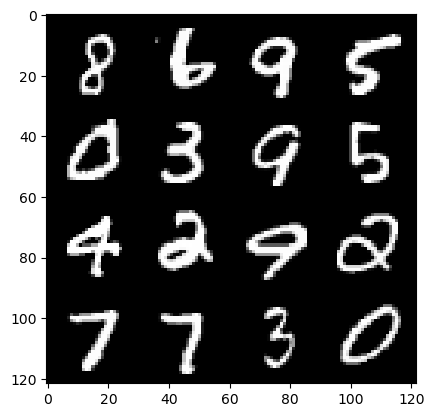

407: step 191100 / Gen loss: 1.4012132481733959 / disc_loss: 0.4445287622014682


  0%|          | 0/469 [00:00<?, ?it/s]

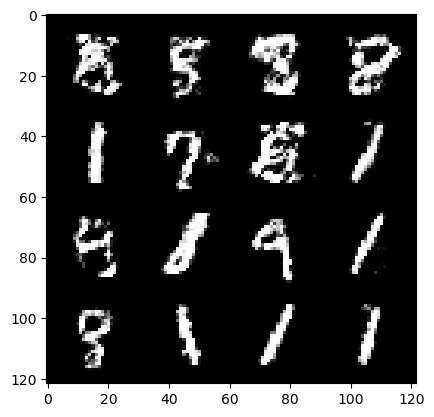

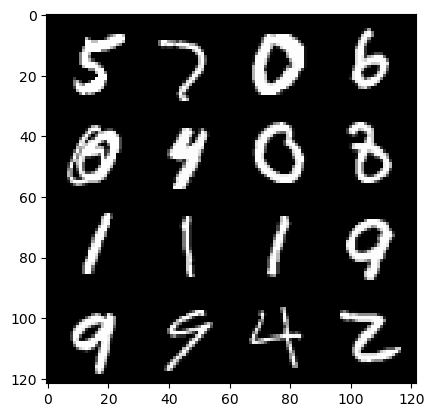

408: step 191400 / Gen loss: 1.4580516401926673 / disc_loss: 0.4183243626356124


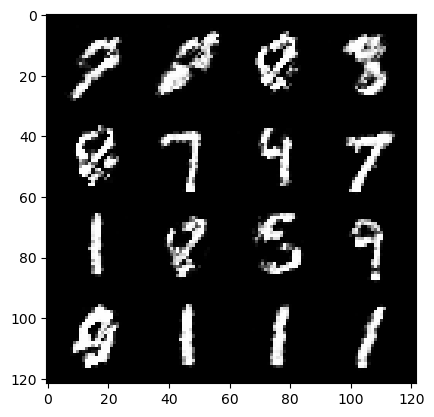

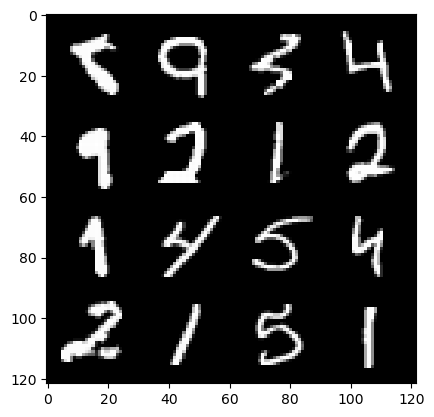

408: step 191700 / Gen loss: 1.4443139374256133 / disc_loss: 0.4383657567699749


  0%|          | 0/469 [00:00<?, ?it/s]

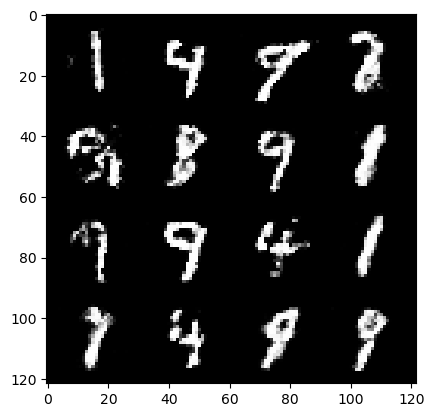

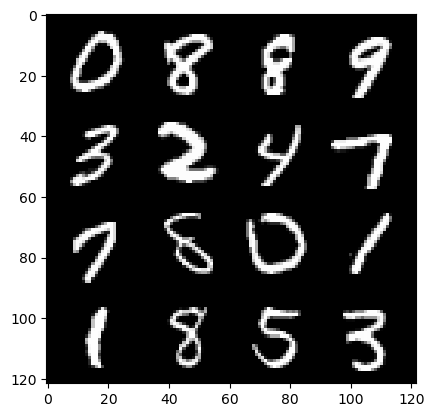

409: step 192000 / Gen loss: 1.4516654968261702 / disc_loss: 0.4386966985464097


  0%|          | 0/469 [00:00<?, ?it/s]

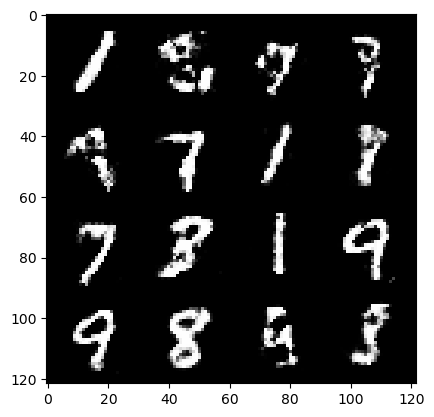

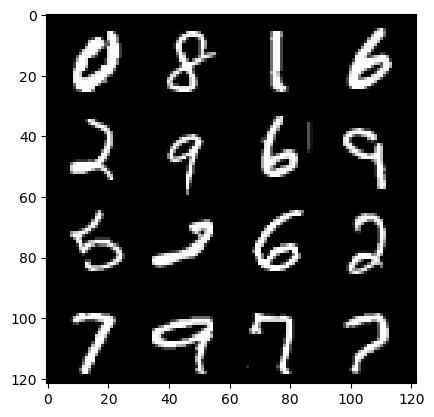

410: step 192300 / Gen loss: 1.4474914725621553 / disc_loss: 0.43798197597265265


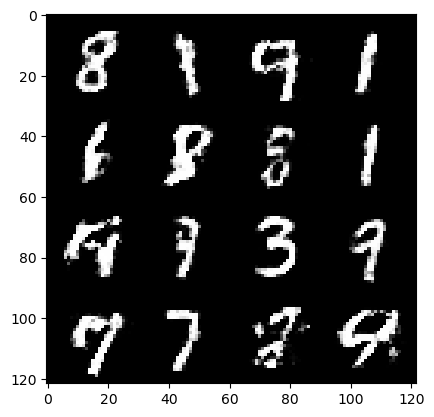

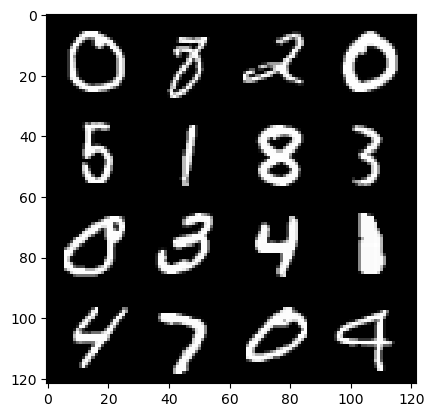

410: step 192600 / Gen loss: 1.4800392826398223 / disc_loss: 0.42014129489660257


  0%|          | 0/469 [00:00<?, ?it/s]

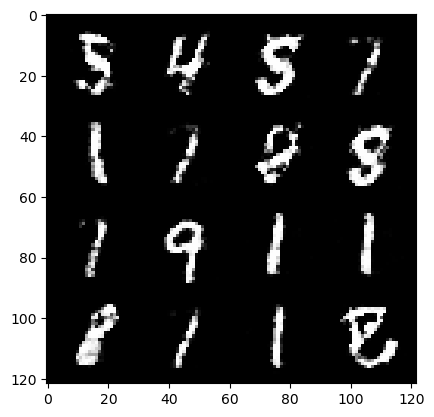

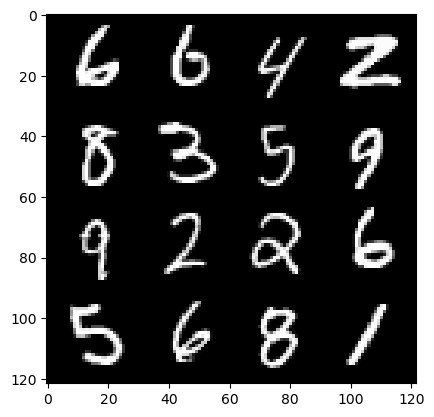

411: step 192900 / Gen loss: 1.4632747455437978 / disc_loss: 0.4327022550503411


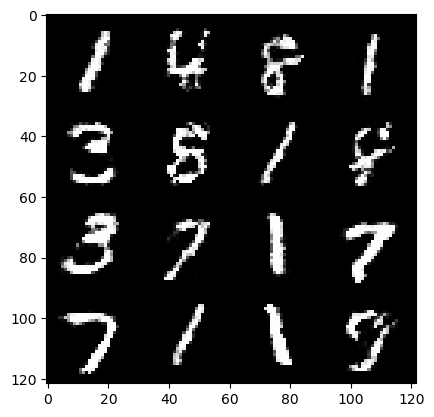

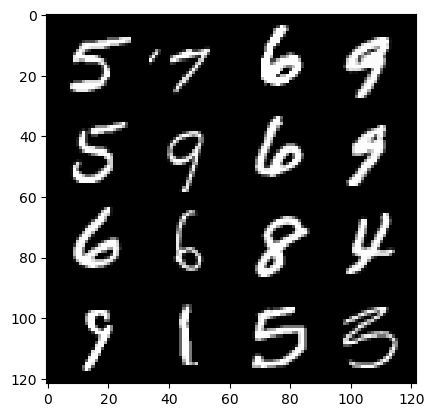

411: step 193200 / Gen loss: 1.3985220591227219 / disc_loss: 0.443520076175531


  0%|          | 0/469 [00:00<?, ?it/s]

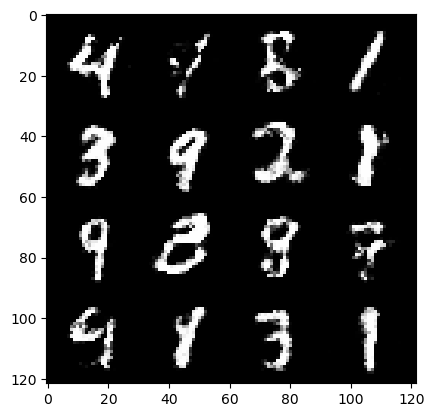

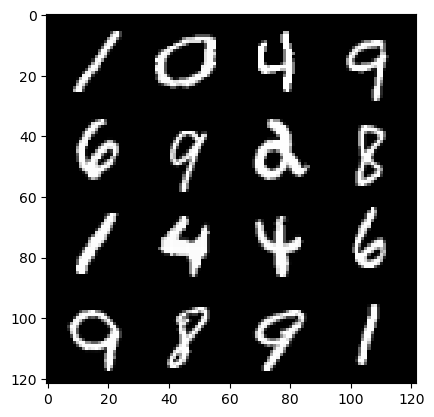

412: step 193500 / Gen loss: 1.445730262994765 / disc_loss: 0.4273272614677746


  0%|          | 0/469 [00:00<?, ?it/s]

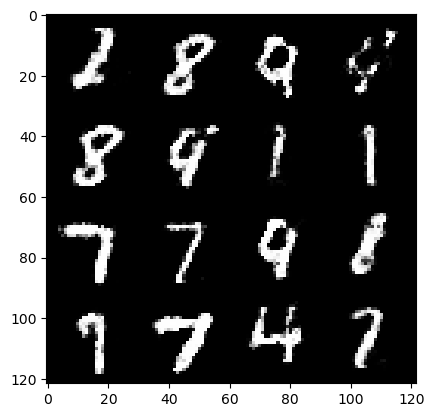

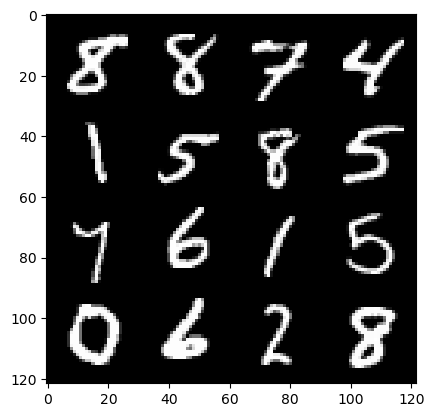

413: step 193800 / Gen loss: 1.459086511135102 / disc_loss: 0.4298311765988668


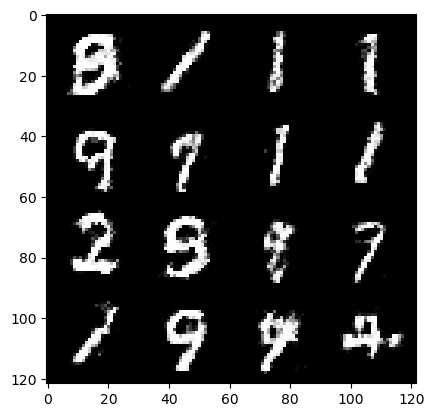

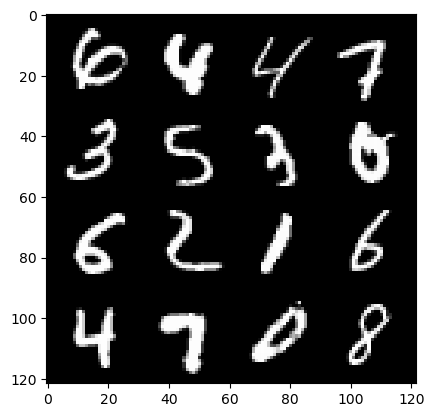

413: step 194100 / Gen loss: 1.3994161915779122 / disc_loss: 0.4415578286846477


  0%|          | 0/469 [00:00<?, ?it/s]

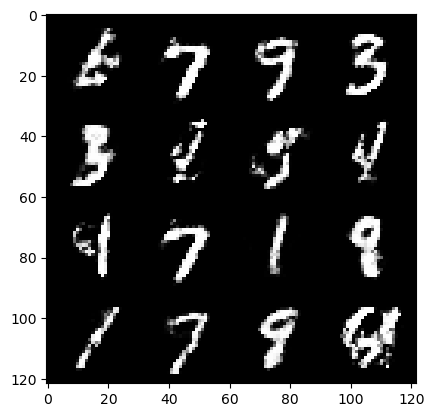

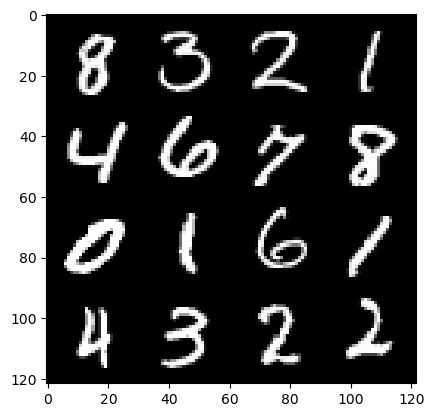

414: step 194400 / Gen loss: 1.429169104894002 / disc_loss: 0.4348957982659339


  0%|          | 0/469 [00:00<?, ?it/s]

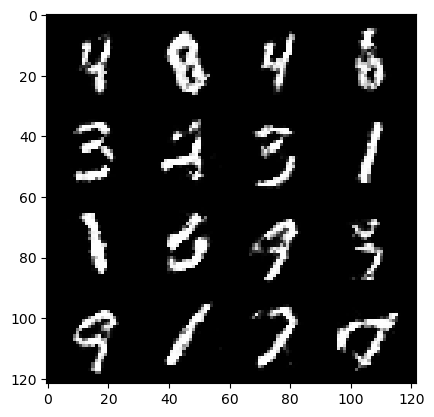

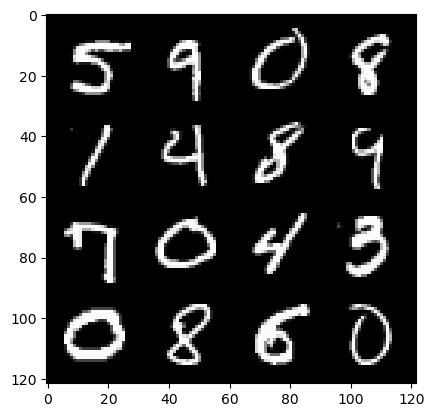

415: step 194700 / Gen loss: 1.4563785409927372 / disc_loss: 0.434358869791031


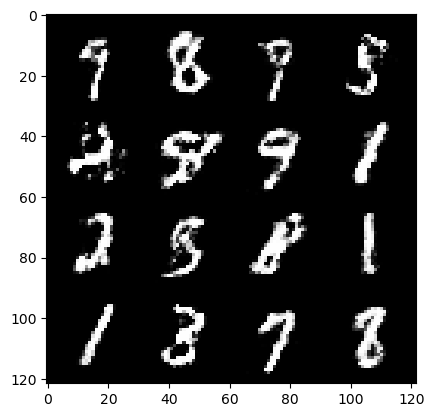

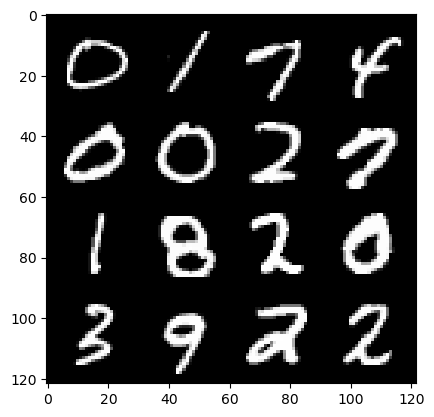

415: step 195000 / Gen loss: 1.471607687473296 / disc_loss: 0.41670989940563813


  0%|          | 0/469 [00:00<?, ?it/s]

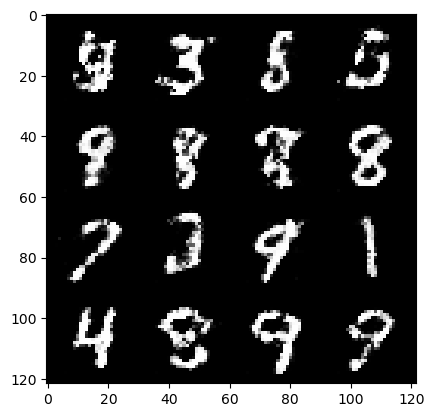

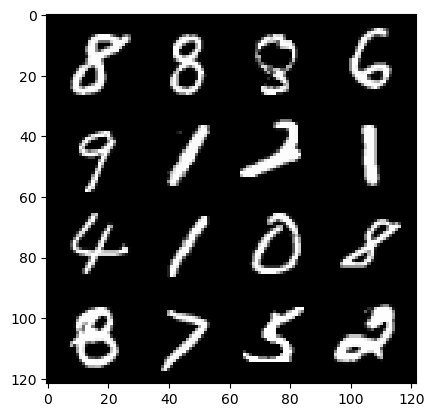

416: step 195300 / Gen loss: 1.4368844950199124 / disc_loss: 0.4294777912894885


  0%|          | 0/469 [00:00<?, ?it/s]

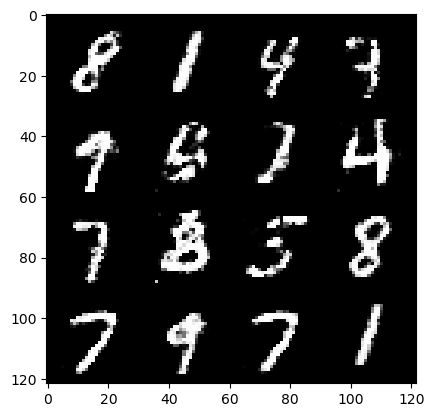

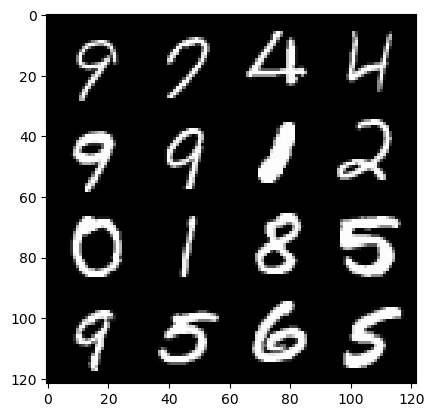

417: step 195600 / Gen loss: 1.4211445621649434 / disc_loss: 0.4397401543458305


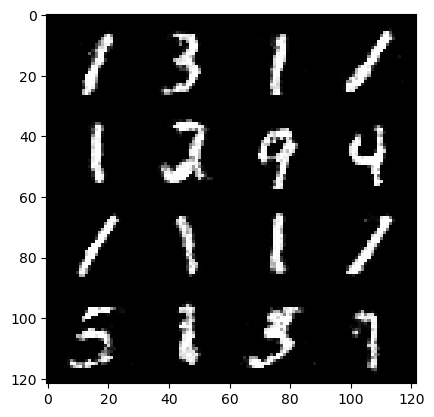

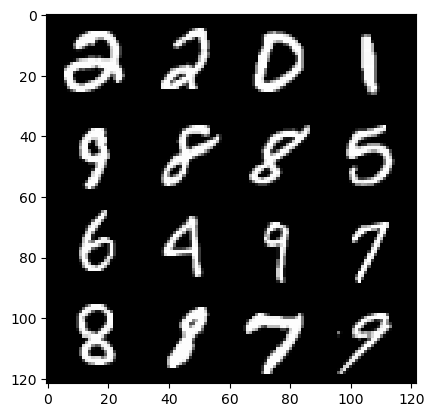

417: step 195900 / Gen loss: 1.4251462674140918 / disc_loss: 0.4369452509284021


  0%|          | 0/469 [00:00<?, ?it/s]

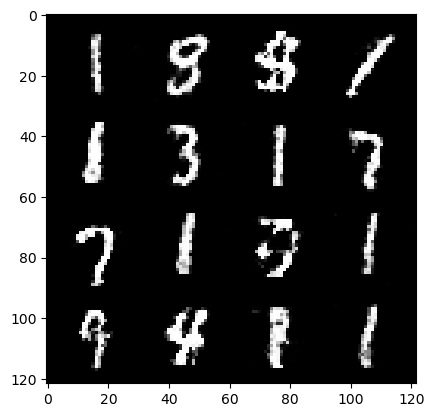

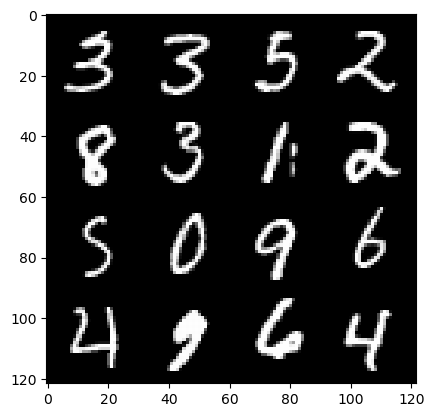

418: step 196200 / Gen loss: 1.4461454013983421 / disc_loss: 0.42558586676915505


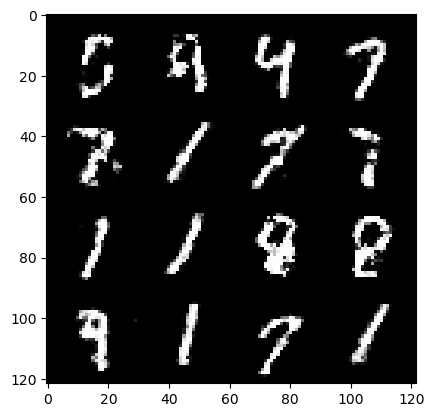

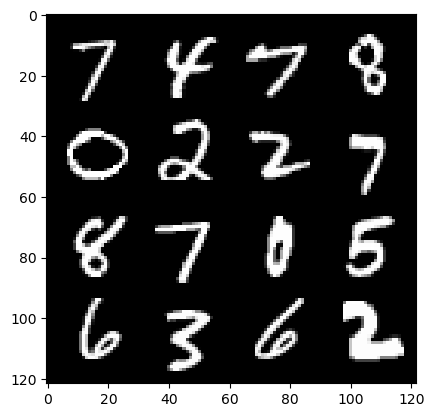

418: step 196500 / Gen loss: 1.4765333696206402 / disc_loss: 0.42099193781614297


  0%|          | 0/469 [00:00<?, ?it/s]

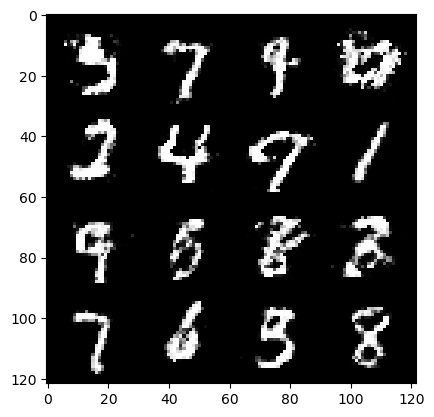

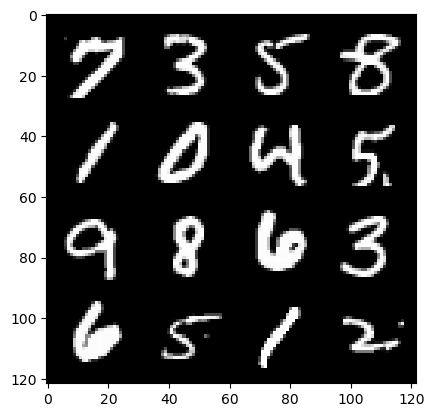

419: step 196800 / Gen loss: 1.4731605140368156 / disc_loss: 0.41649935434261953


  0%|          | 0/469 [00:00<?, ?it/s]

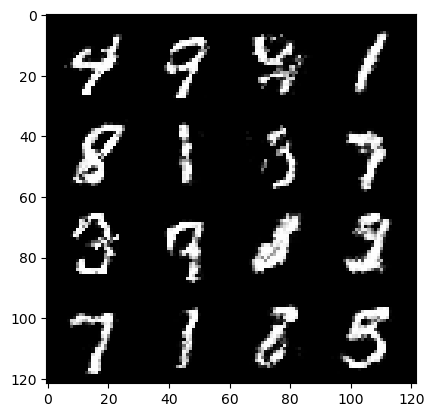

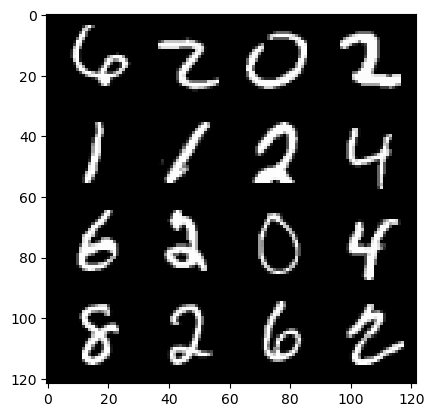

420: step 197100 / Gen loss: 1.4604461610317236 / disc_loss: 0.4366051937143008


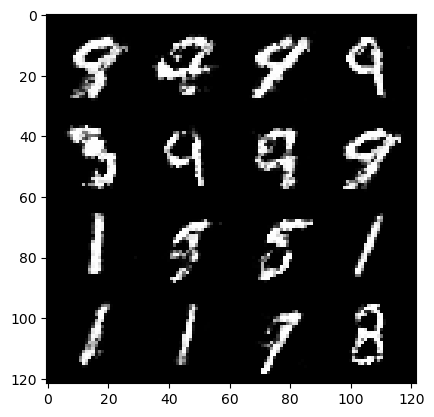

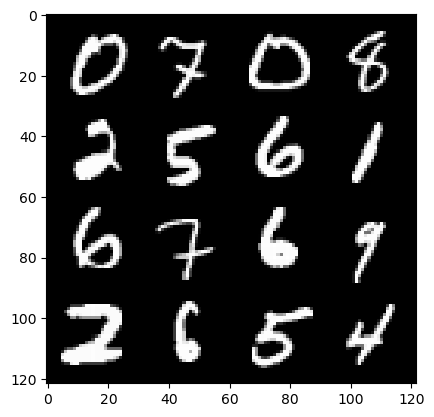

420: step 197400 / Gen loss: 1.5024786945184068 / disc_loss: 0.41320609261592195


  0%|          | 0/469 [00:00<?, ?it/s]

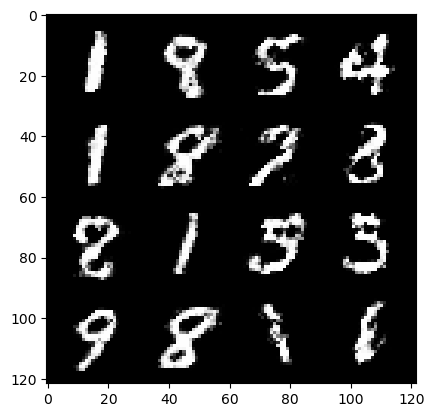

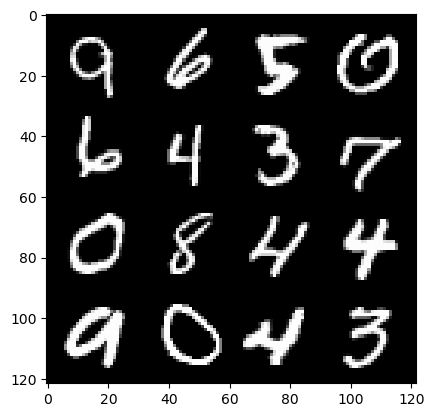

421: step 197700 / Gen loss: 1.4968608939647687 / disc_loss: 0.416192673345407


  0%|          | 0/469 [00:00<?, ?it/s]

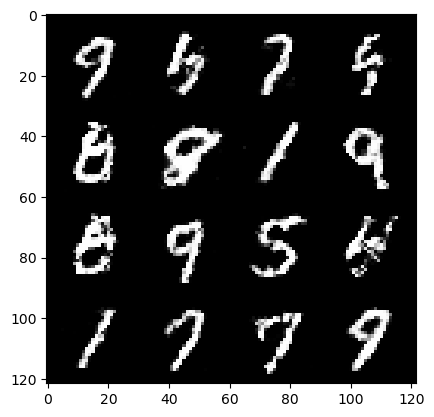

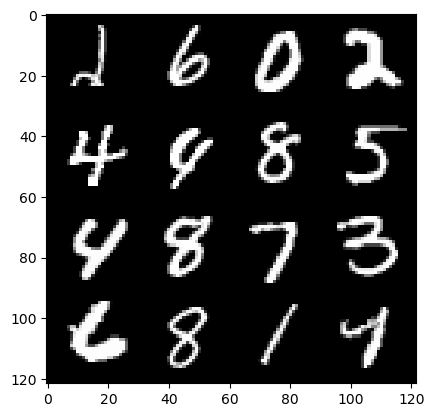

422: step 198000 / Gen loss: 1.4735950779914864 / disc_loss: 0.42102084368467296


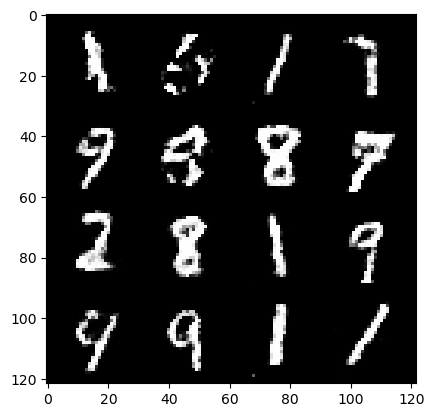

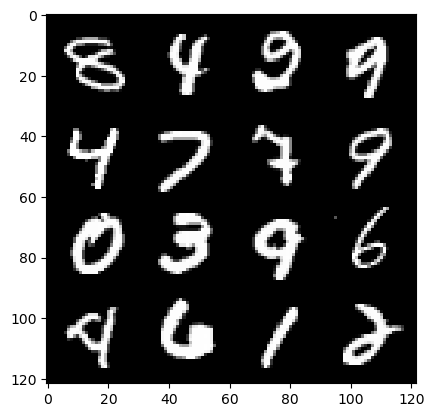

422: step 198300 / Gen loss: 1.4440313080946605 / disc_loss: 0.4247489978869753


  0%|          | 0/469 [00:00<?, ?it/s]

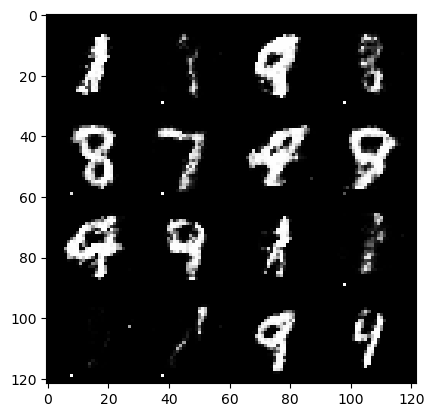

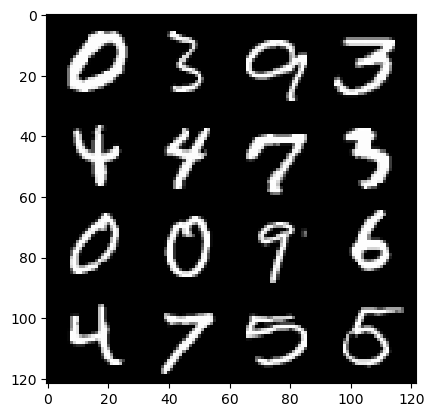

423: step 198600 / Gen loss: 1.2540104782581327 / disc_loss: 0.5764123606681824


  0%|          | 0/469 [00:00<?, ?it/s]

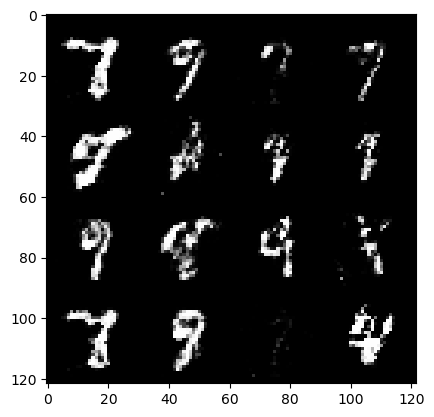

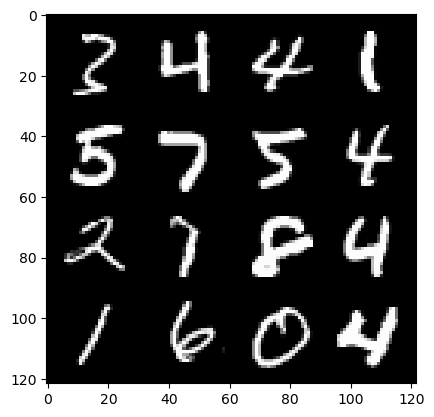

424: step 198900 / Gen loss: 1.3844211415449783 / disc_loss: 0.40031950632731134


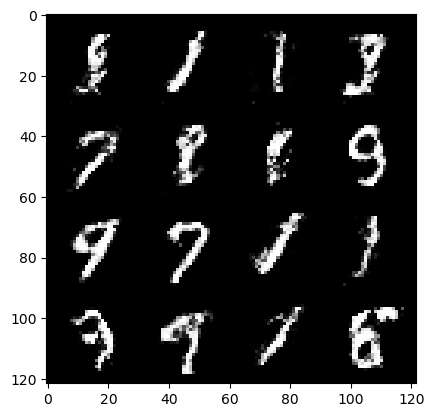

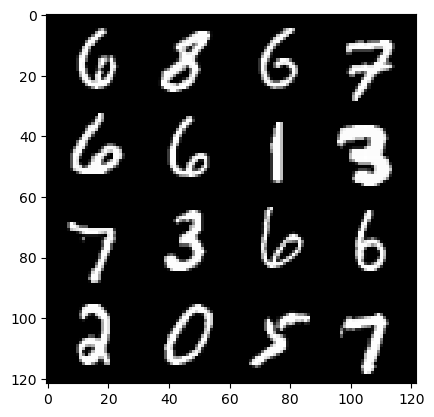

424: step 199200 / Gen loss: 1.320067284901937 / disc_loss: 0.41546126385529836


  0%|          | 0/469 [00:00<?, ?it/s]

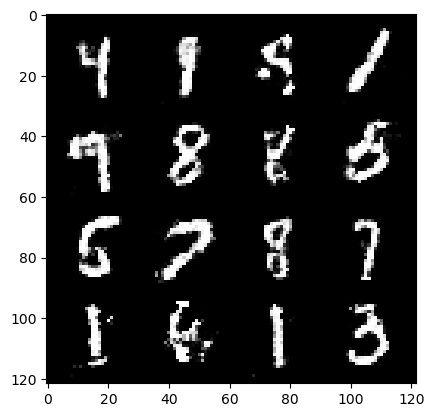

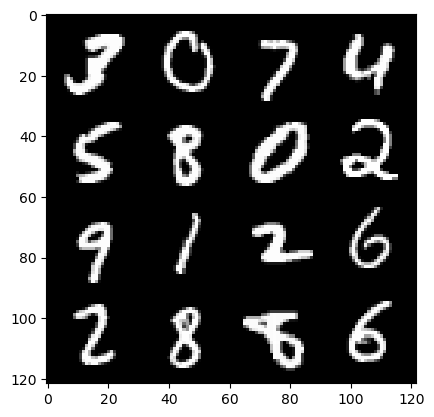

425: step 199500 / Gen loss: 1.453089101711907 / disc_loss: 0.41299122542142874


  0%|          | 0/469 [00:00<?, ?it/s]

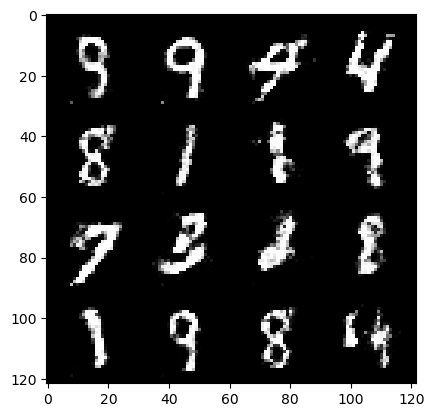

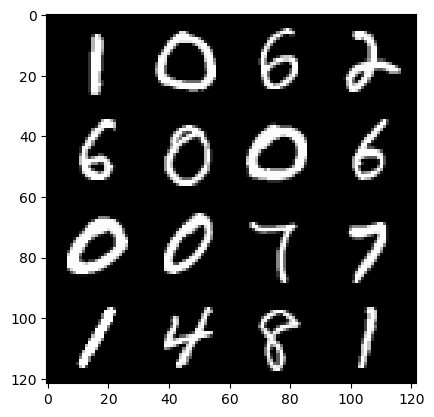

426: step 199800 / Gen loss: 1.3425484955310822 / disc_loss: 0.467925566037496


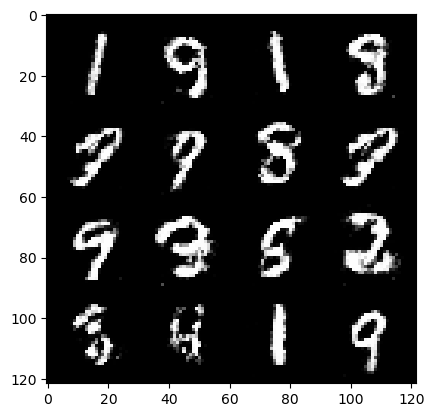

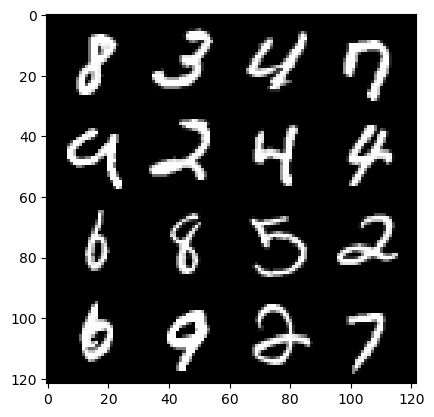

426: step 200100 / Gen loss: 1.3078621109326674 / disc_loss: 0.4491730642318724


  0%|          | 0/469 [00:00<?, ?it/s]

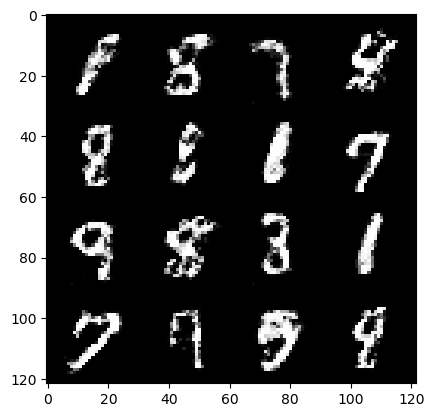

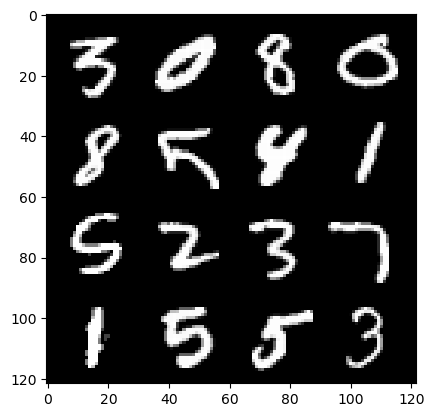

427: step 200400 / Gen loss: 1.348940615653992 / disc_loss: 0.4298950657248494


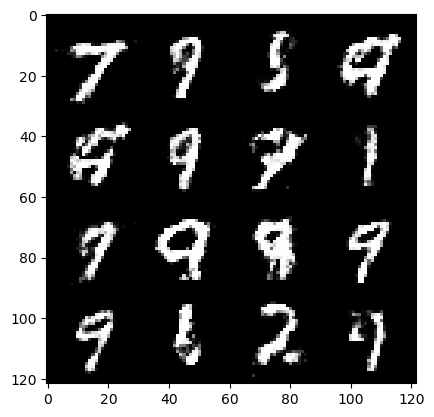

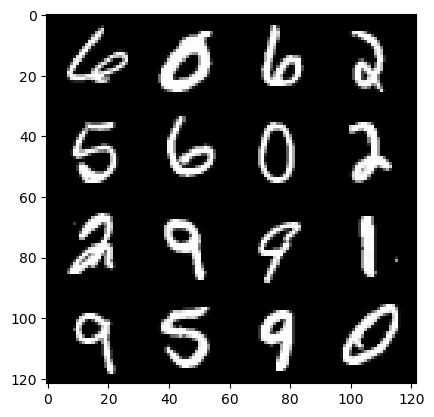

427: step 200700 / Gen loss: 1.358722368081411 / disc_loss: 0.43225041200717296


  0%|          | 0/469 [00:00<?, ?it/s]

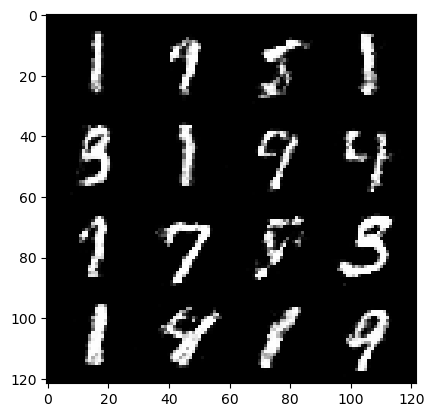

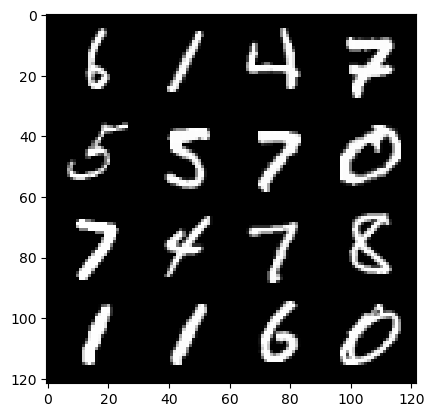

428: step 201000 / Gen loss: 1.3841274432341266 / disc_loss: 0.4326545215646426


  0%|          | 0/469 [00:00<?, ?it/s]

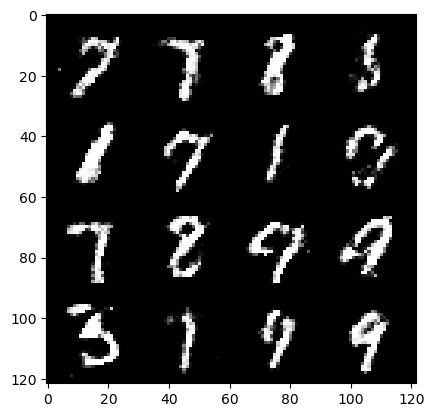

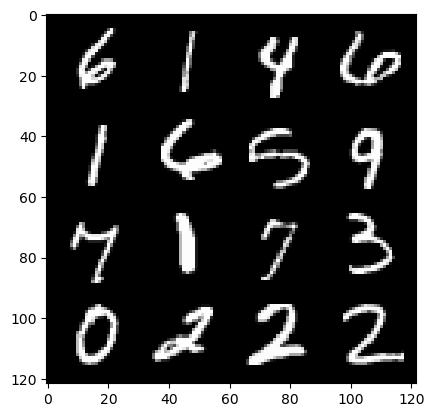

429: step 201300 / Gen loss: 1.3780843536059069 / disc_loss: 0.4403897552688918


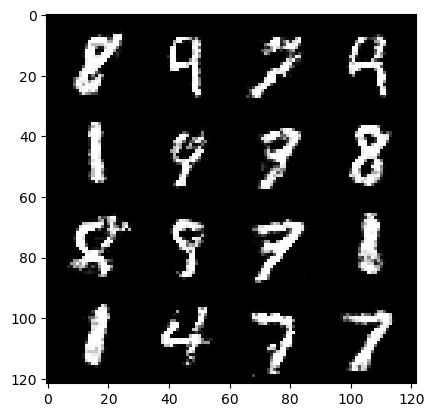

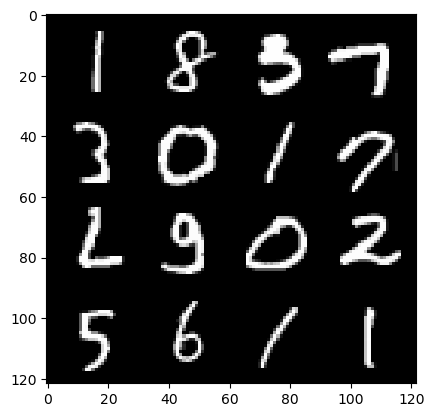

429: step 201600 / Gen loss: 1.369644571145375 / disc_loss: 0.4413233878215155


  0%|          | 0/469 [00:00<?, ?it/s]

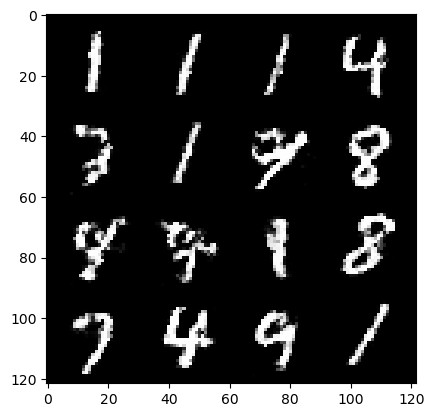

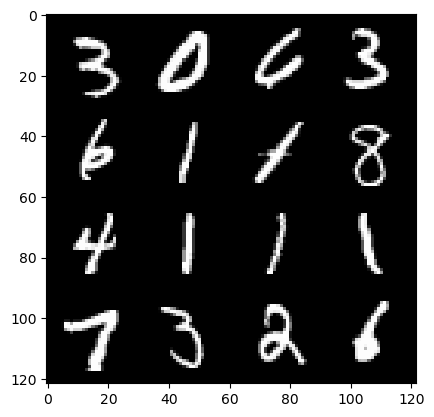

430: step 201900 / Gen loss: 1.3686179427305862 / disc_loss: 0.434758347272873


  0%|          | 0/469 [00:00<?, ?it/s]

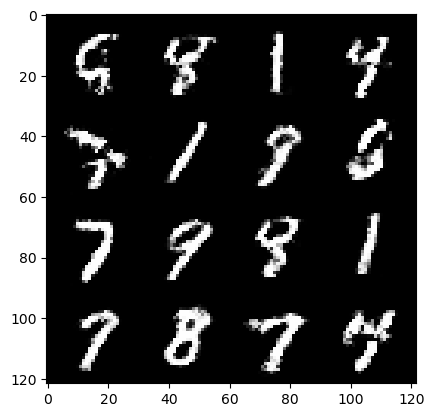

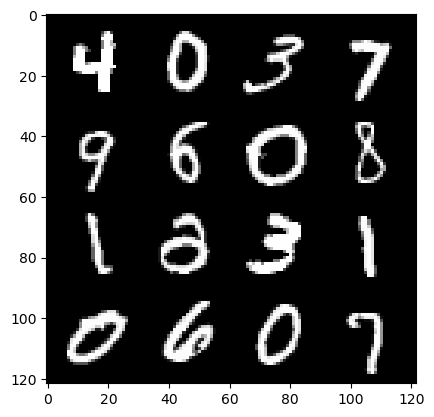

431: step 202200 / Gen loss: 1.3922983105977376 / disc_loss: 0.4439207369089123


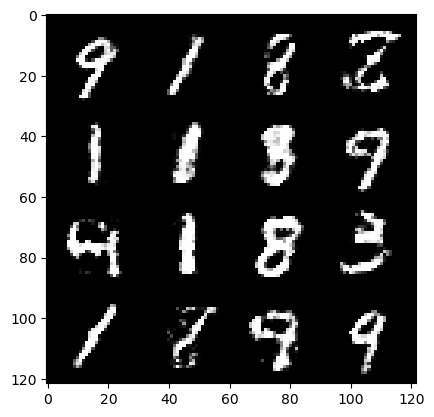

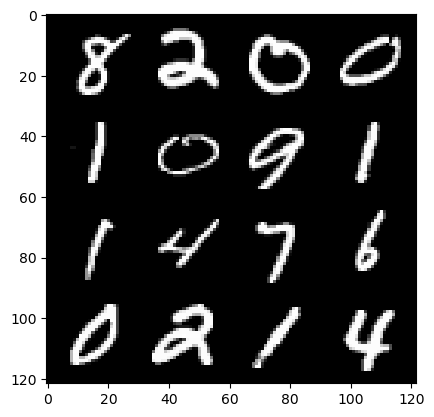

431: step 202500 / Gen loss: 1.3979529460271192 / disc_loss: 0.44536133865515437


  0%|          | 0/469 [00:00<?, ?it/s]

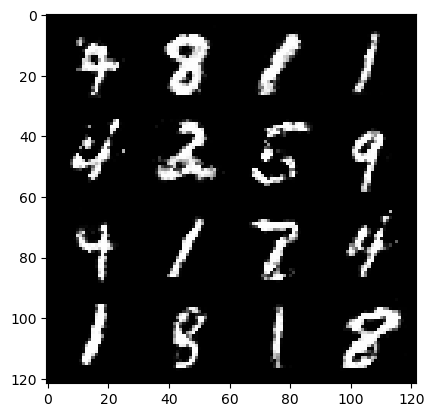

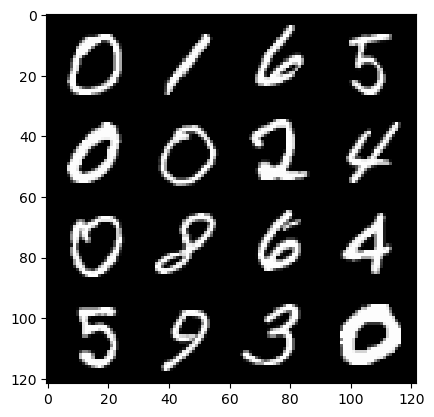

432: step 202800 / Gen loss: 1.3914614351590475 / disc_loss: 0.4467022849122684


  0%|          | 0/469 [00:00<?, ?it/s]

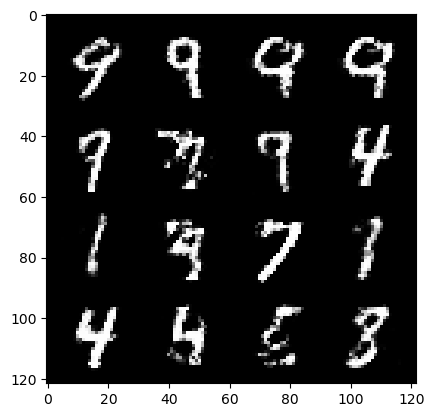

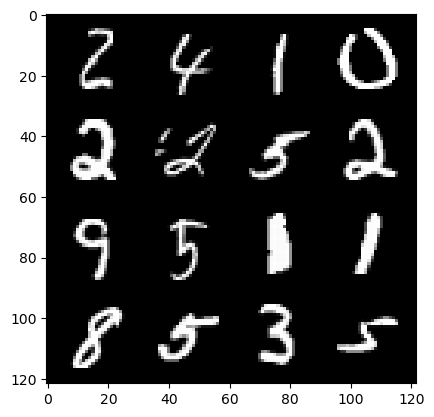

433: step 203100 / Gen loss: 1.37738695780436 / disc_loss: 0.45416606505711893


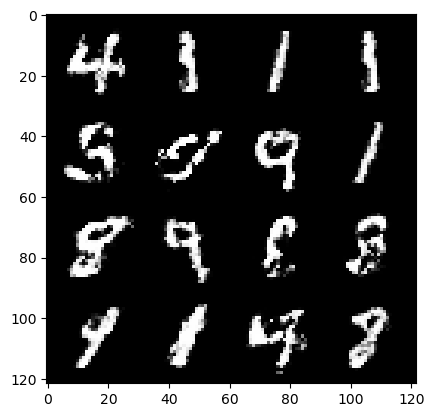

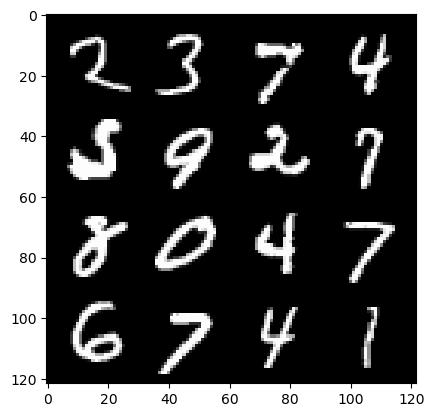

433: step 203400 / Gen loss: 1.4076443898677828 / disc_loss: 0.43968830764293704


  0%|          | 0/469 [00:00<?, ?it/s]

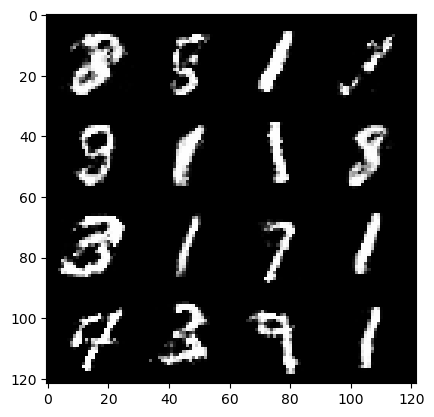

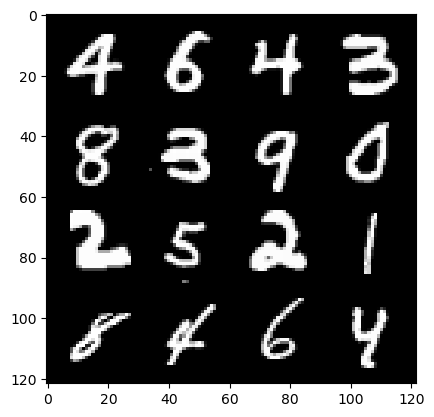

434: step 203700 / Gen loss: 1.4140094514687855 / disc_loss: 0.44893335878849


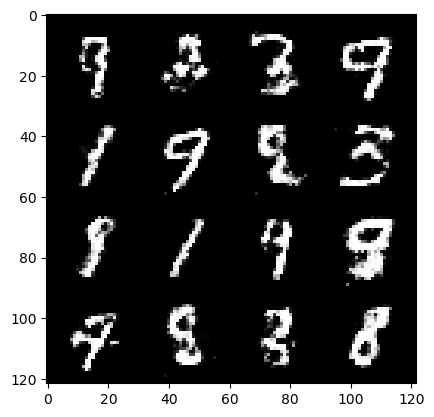

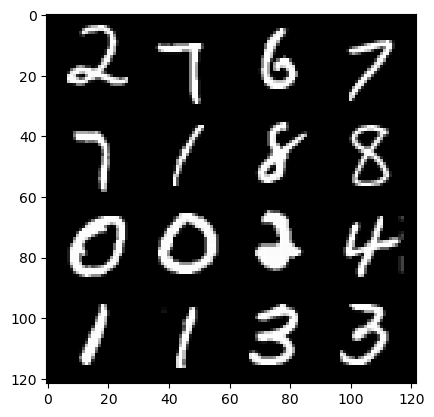

434: step 204000 / Gen loss: 1.4166371719042468 / disc_loss: 0.4506053201357523


  0%|          | 0/469 [00:00<?, ?it/s]

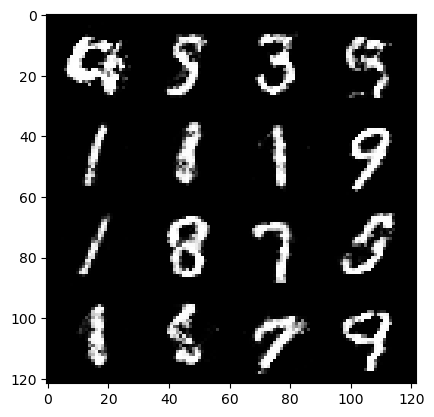

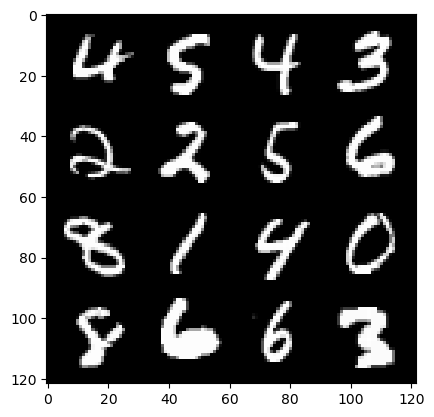

435: step 204300 / Gen loss: 1.4078973571459448 / disc_loss: 0.44358533521493243


  0%|          | 0/469 [00:00<?, ?it/s]

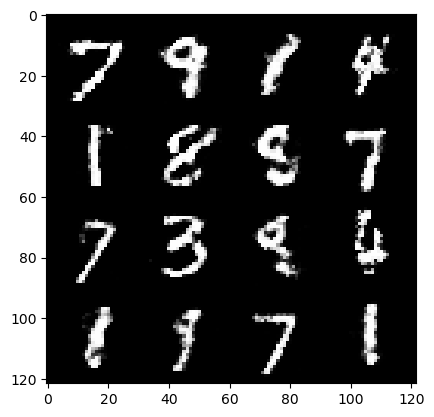

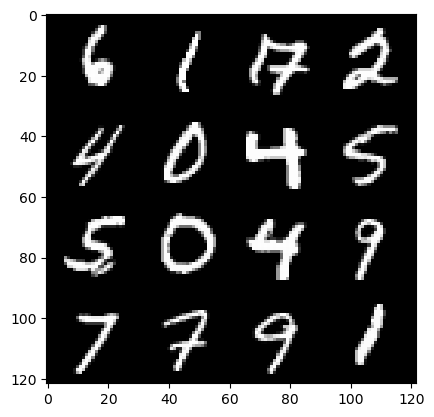

436: step 204600 / Gen loss: 1.4014439264933274 / disc_loss: 0.4503224969903623


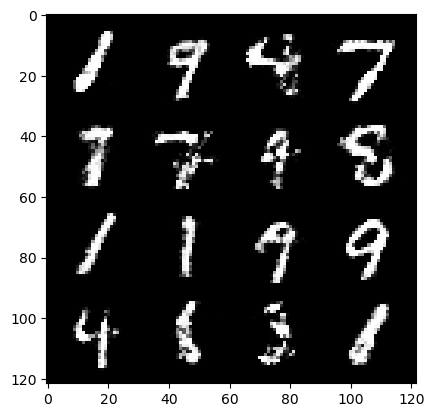

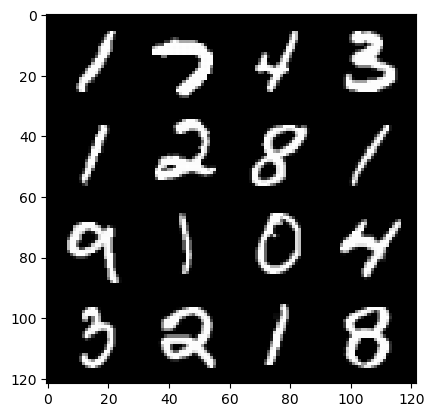

436: step 204900 / Gen loss: 1.3966653009255732 / disc_loss: 0.45528321564197544


  0%|          | 0/469 [00:00<?, ?it/s]

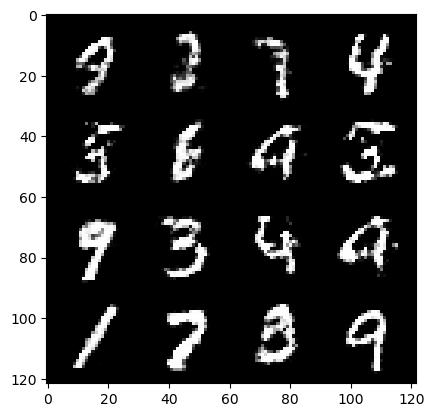

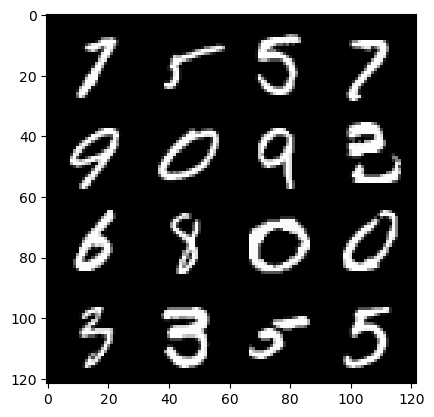

437: step 205200 / Gen loss: 1.4309086096286767 / disc_loss: 0.4377649230758347


  0%|          | 0/469 [00:00<?, ?it/s]

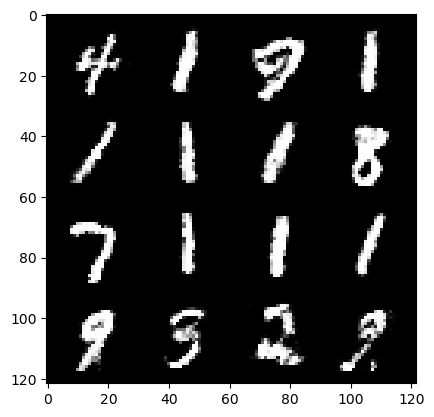

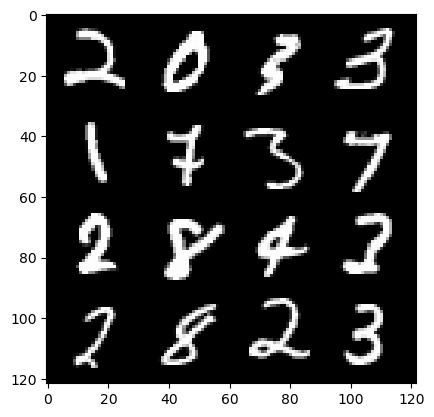

438: step 205500 / Gen loss: 1.4075990084807068 / disc_loss: 0.45835278759400083


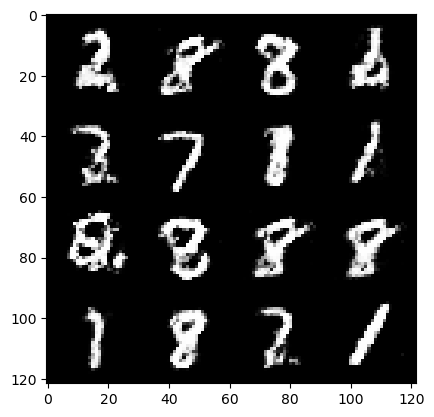

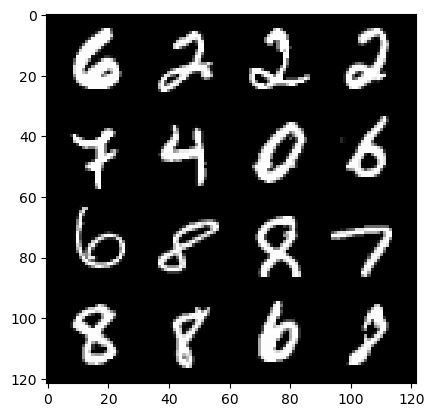

438: step 205800 / Gen loss: 1.3735932429631548 / disc_loss: 0.46893488943576805


  0%|          | 0/469 [00:00<?, ?it/s]

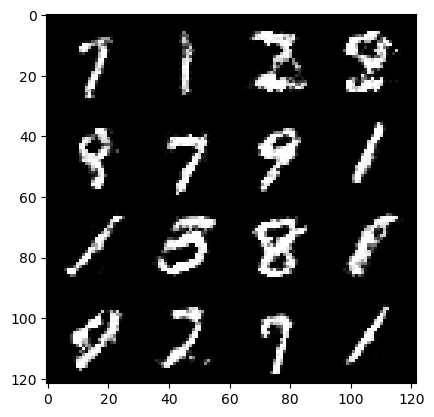

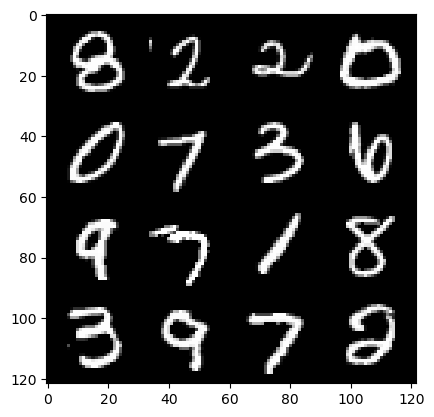

439: step 206100 / Gen loss: 1.410398285786311 / disc_loss: 0.4459905739625293


  0%|          | 0/469 [00:00<?, ?it/s]

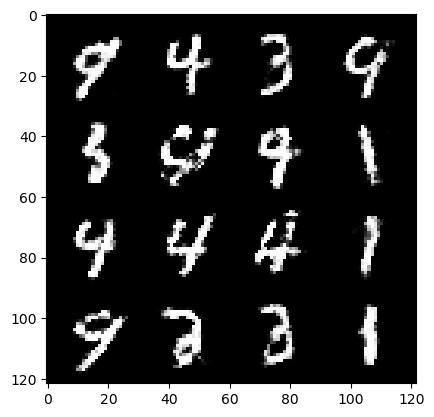

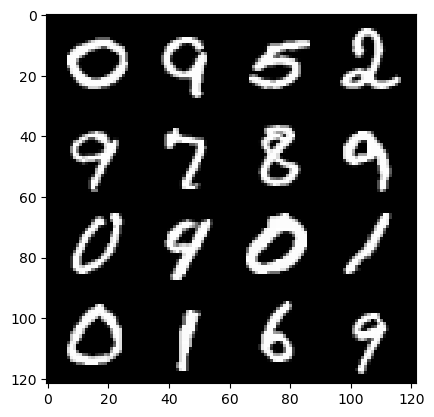

440: step 206400 / Gen loss: 1.3511080078283946 / disc_loss: 0.47074087907870604


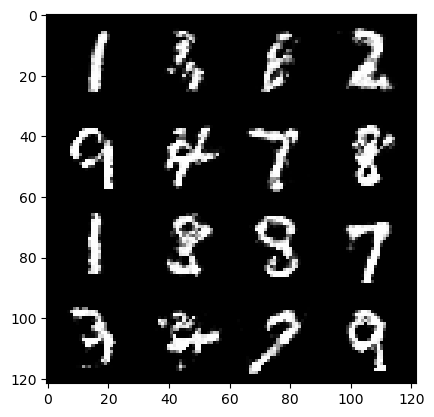

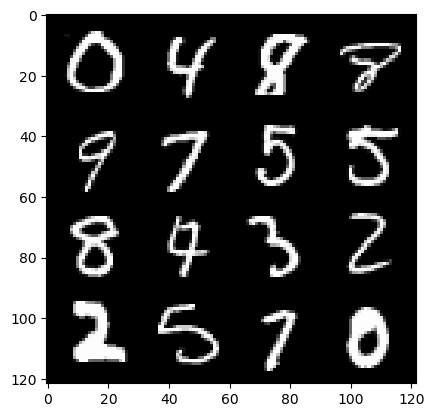

440: step 206700 / Gen loss: 1.3925418539841963 / disc_loss: 0.45416606982548985


  0%|          | 0/469 [00:00<?, ?it/s]

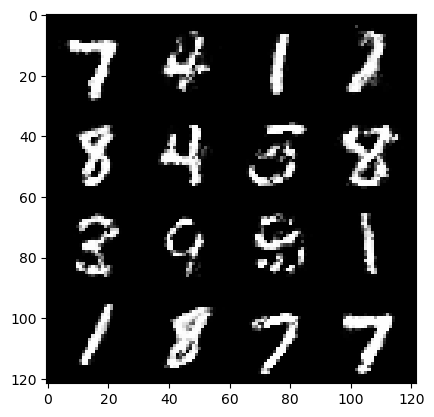

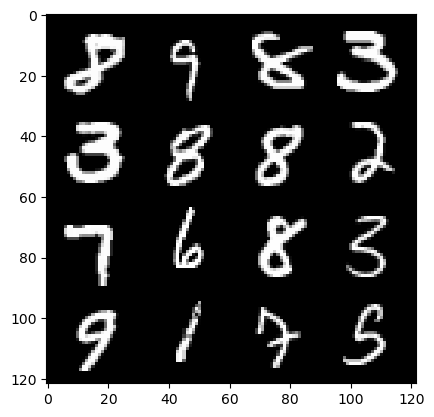

441: step 207000 / Gen loss: 1.4173731648921952 / disc_loss: 0.43970035235087074


  0%|          | 0/469 [00:00<?, ?it/s]

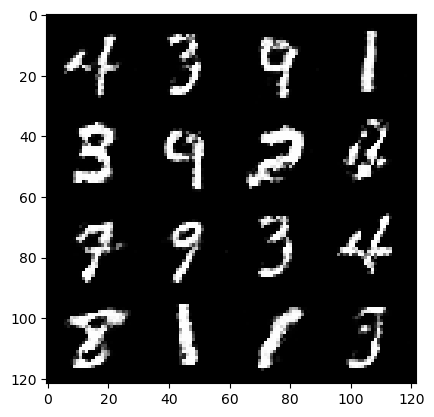

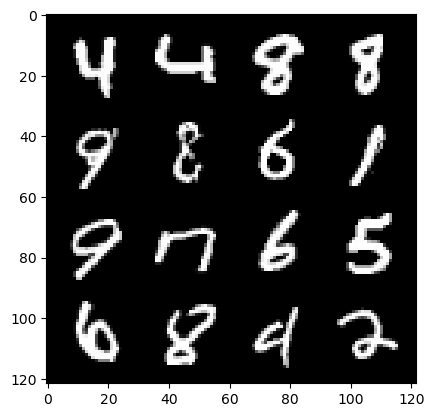

442: step 207300 / Gen loss: 1.421856888135274 / disc_loss: 0.43894581596056564


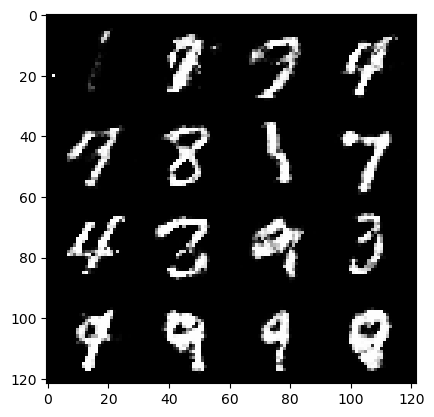

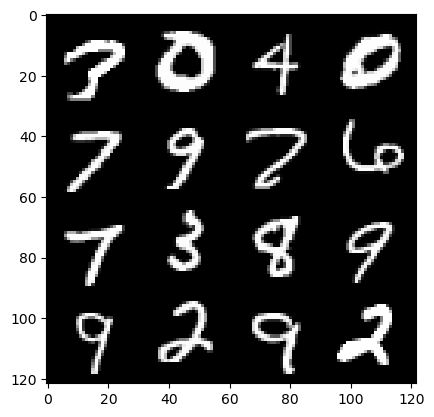

442: step 207600 / Gen loss: 1.3812137305736538 / disc_loss: 0.4634036447604496


  0%|          | 0/469 [00:00<?, ?it/s]

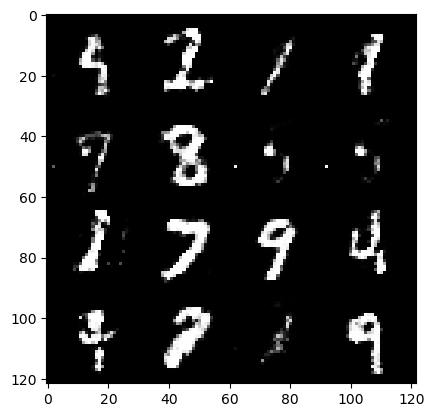

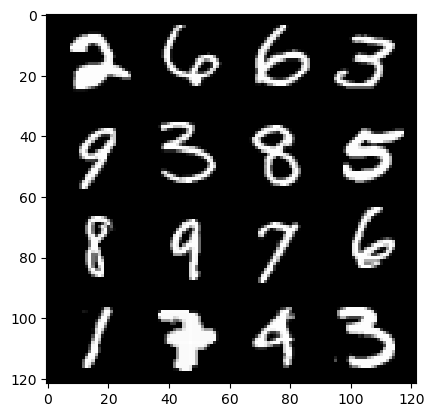

443: step 207900 / Gen loss: 1.355320494969686 / disc_loss: 0.4451999401052793


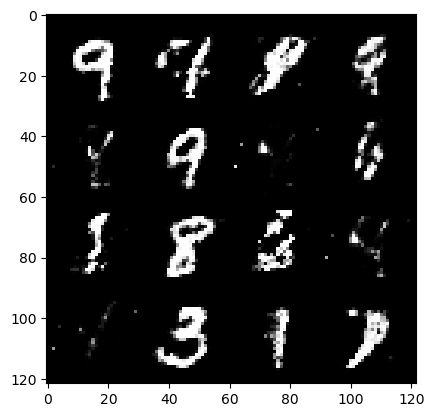

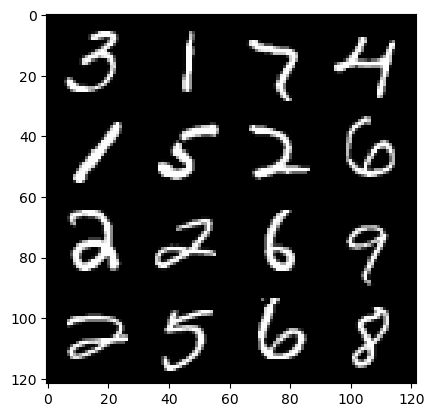

443: step 208200 / Gen loss: 1.470254153807958 / disc_loss: 0.4012831332286197


  0%|          | 0/469 [00:00<?, ?it/s]

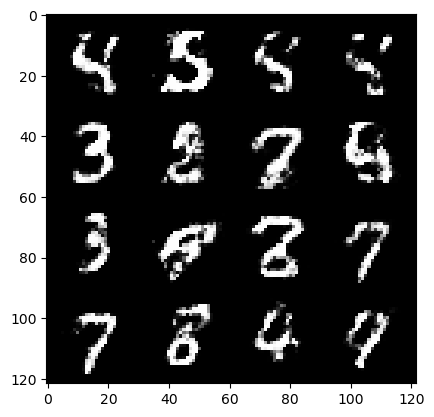

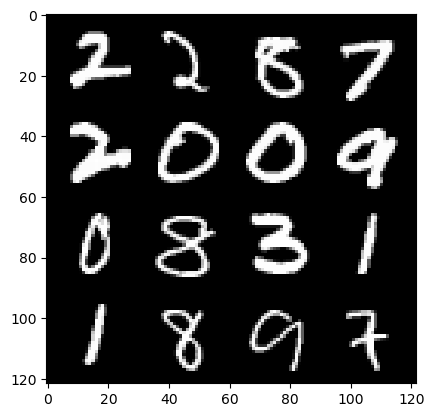

444: step 208500 / Gen loss: 1.541912174224853 / disc_loss: 0.3940860272447266


  0%|          | 0/469 [00:00<?, ?it/s]

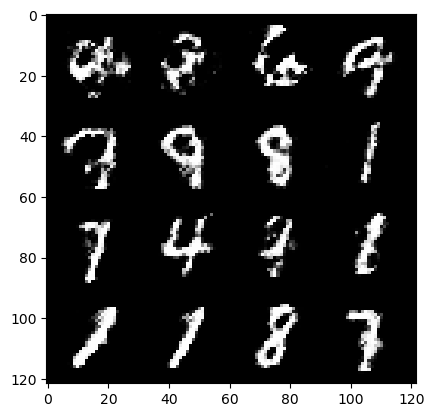

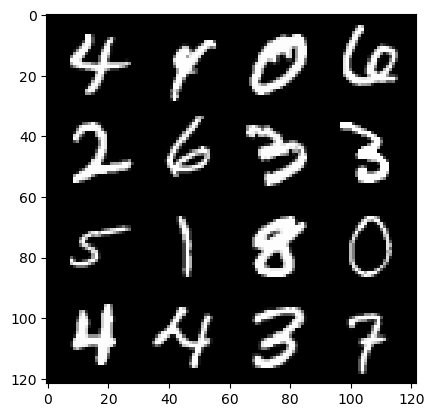

445: step 208800 / Gen loss: 1.4830428489049272 / disc_loss: 0.40141696145137196


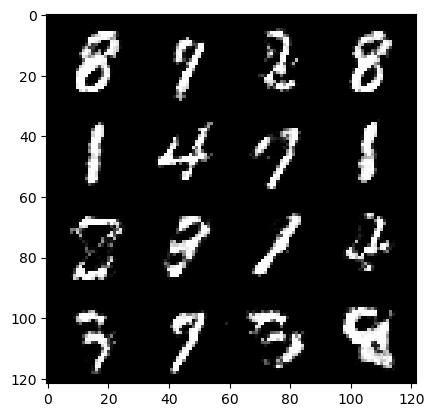

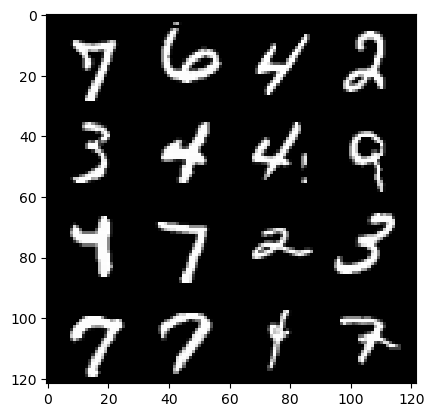

445: step 209100 / Gen loss: 1.490114729404449 / disc_loss: 0.42124378273884433


  0%|          | 0/469 [00:00<?, ?it/s]

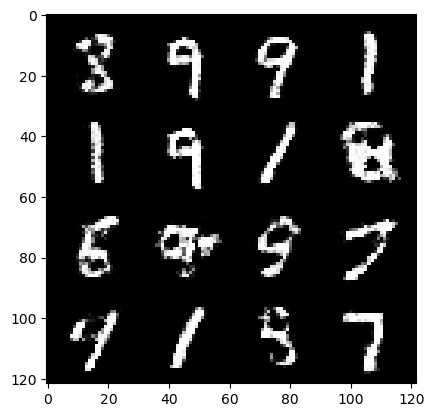

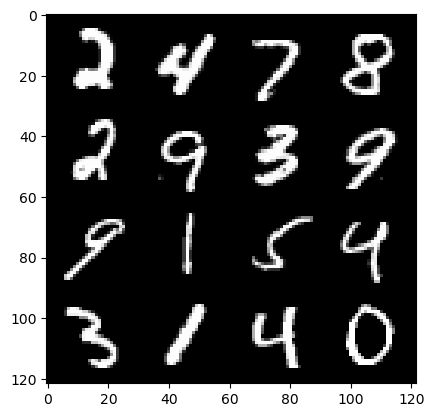

446: step 209400 / Gen loss: 1.4641616904735566 / disc_loss: 0.434977733294169


  0%|          | 0/469 [00:00<?, ?it/s]

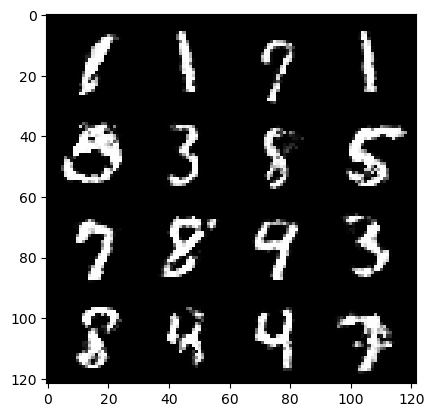

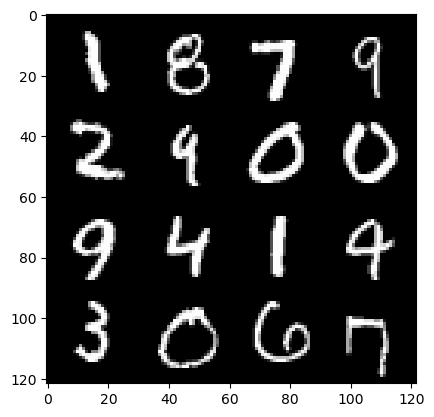

447: step 209700 / Gen loss: 1.4517925373713176 / disc_loss: 0.4330775472521781


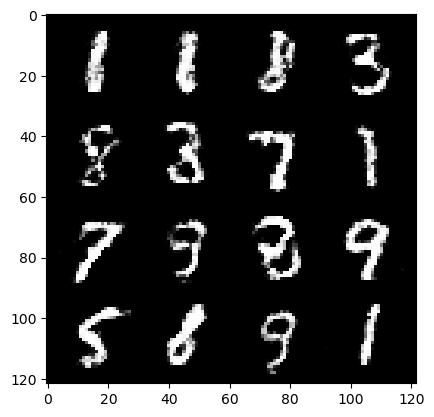

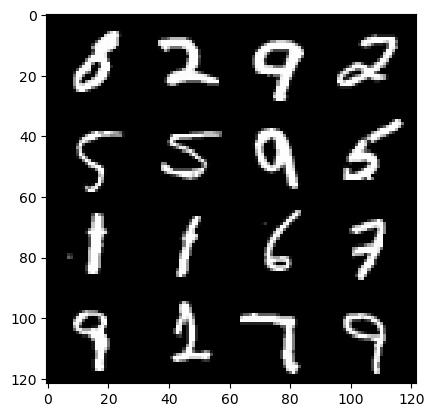

447: step 210000 / Gen loss: 1.4421203215916962 / disc_loss: 0.4301834760109584


  0%|          | 0/469 [00:00<?, ?it/s]

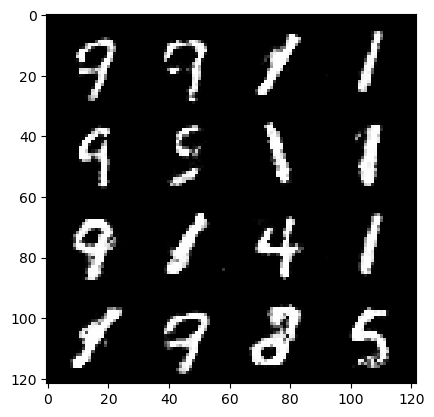

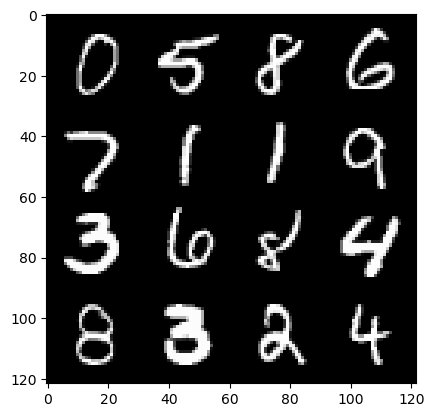

448: step 210300 / Gen loss: 1.4618543672561635 / disc_loss: 0.4279566265145937


  0%|          | 0/469 [00:00<?, ?it/s]

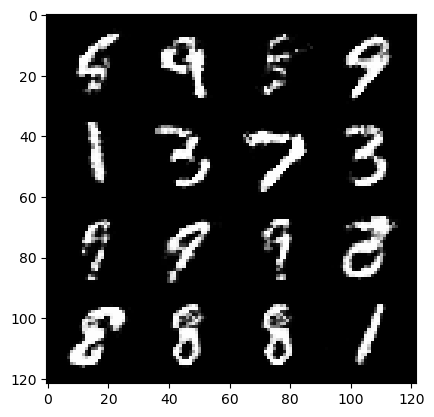

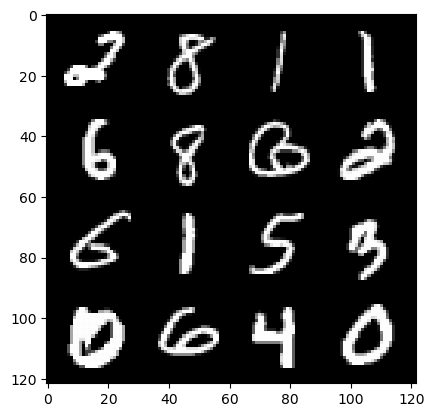

449: step 210600 / Gen loss: 1.4560509145259857 / disc_loss: 0.42626403818527847


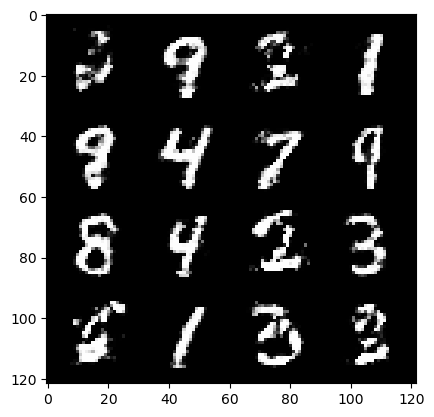

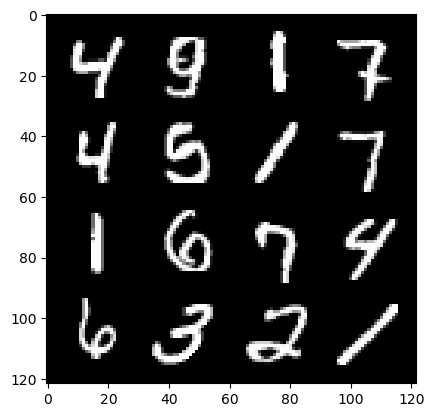

449: step 210900 / Gen loss: 1.4048758538564048 / disc_loss: 0.4359804727633794


  0%|          | 0/469 [00:00<?, ?it/s]

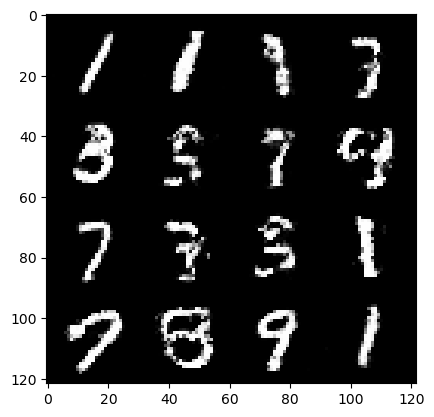

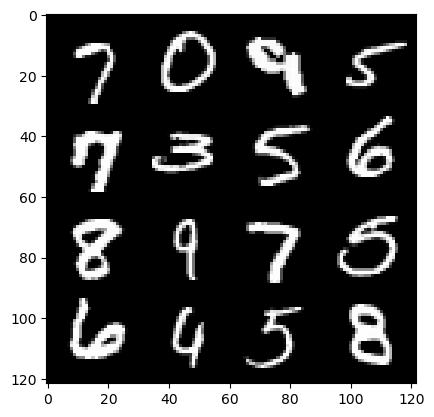

450: step 211200 / Gen loss: 1.4418275876839945 / disc_loss: 0.4340484941999117


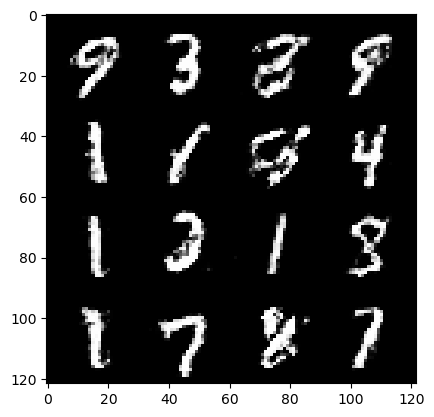

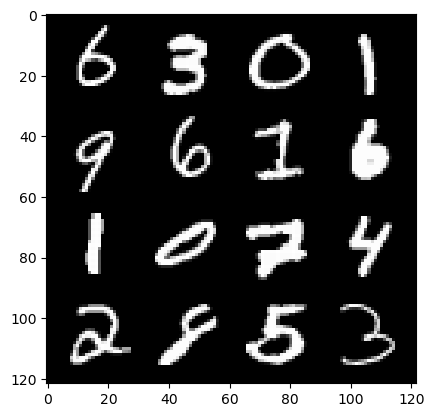

450: step 211500 / Gen loss: 1.4770346093177789 / disc_loss: 0.4225112515687944


  0%|          | 0/469 [00:00<?, ?it/s]

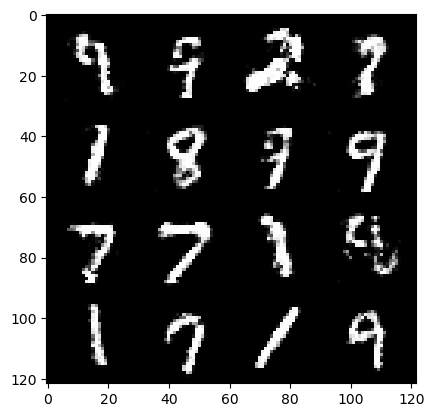

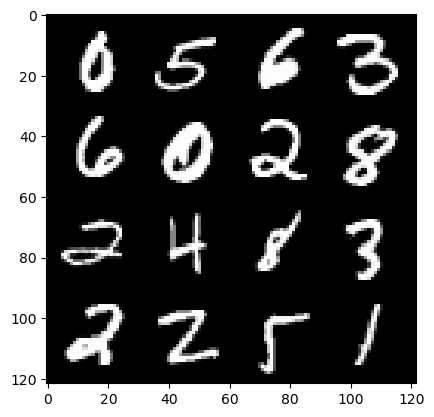

451: step 211800 / Gen loss: 1.4202661514282235 / disc_loss: 0.46356542259454714


  0%|          | 0/469 [00:00<?, ?it/s]

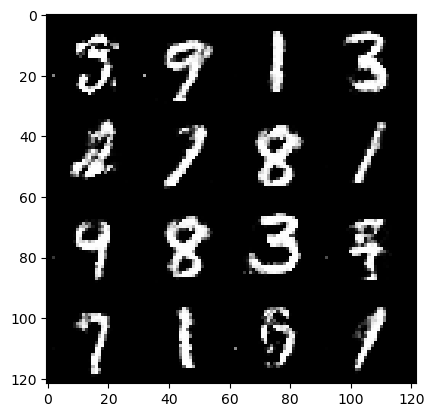

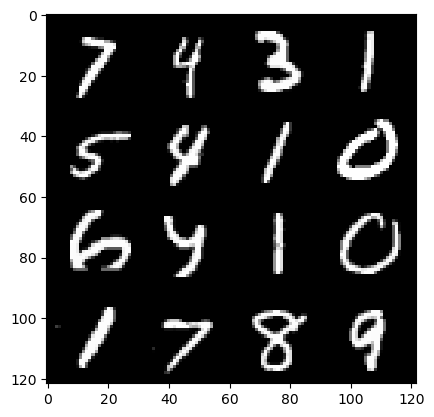

452: step 212100 / Gen loss: 1.4166699862480163 / disc_loss: 0.45751002977291716


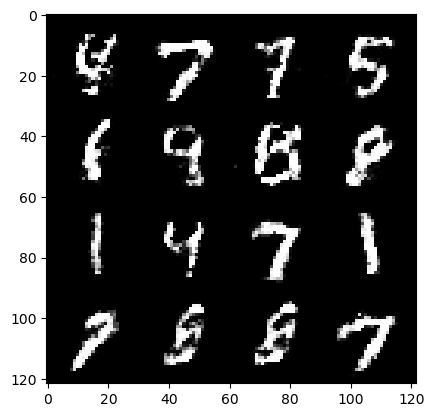

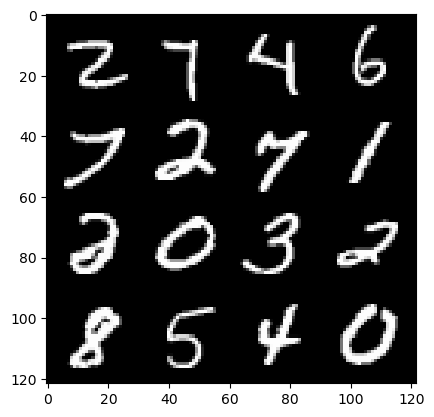

452: step 212400 / Gen loss: 1.4011599616209662 / disc_loss: 0.44211446205774957


  0%|          | 0/469 [00:00<?, ?it/s]

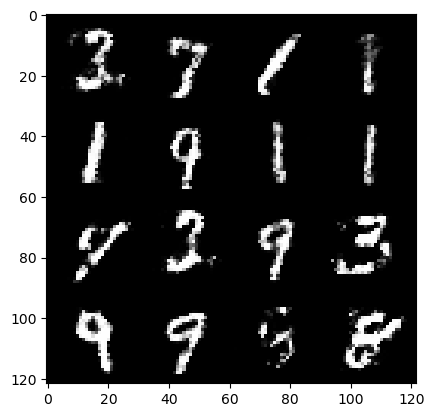

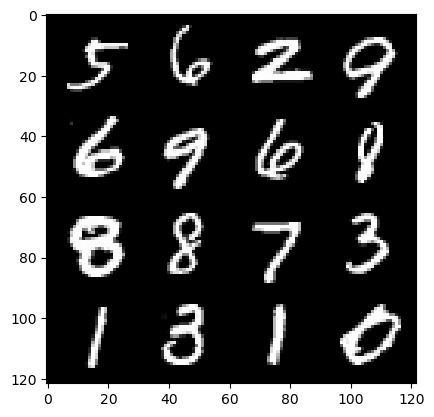

453: step 212700 / Gen loss: 1.4248574237028748 / disc_loss: 0.42312825789054226


  0%|          | 0/469 [00:00<?, ?it/s]

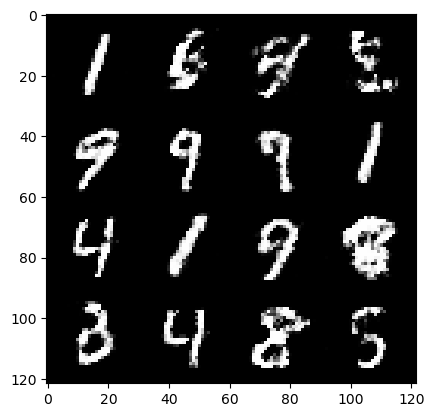

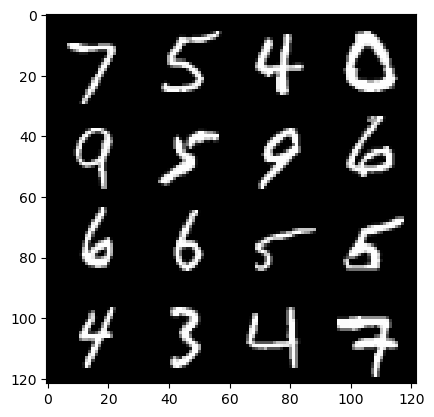

454: step 213000 / Gen loss: 1.4208661822477968 / disc_loss: 0.43523358166217807


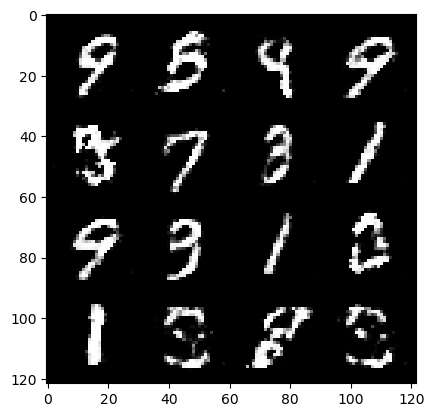

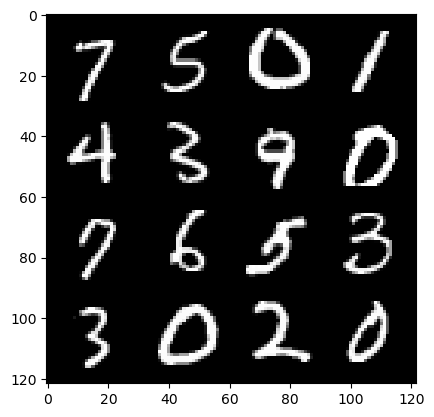

454: step 213300 / Gen loss: 1.4362294511000318 / disc_loss: 0.4401061361034711


  0%|          | 0/469 [00:00<?, ?it/s]

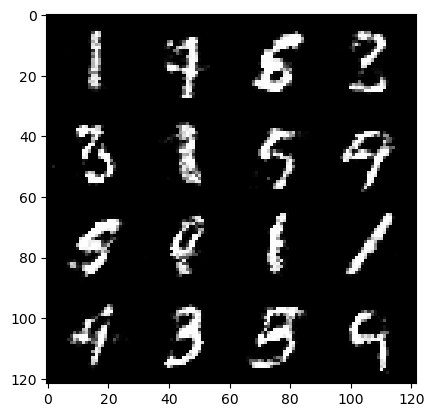

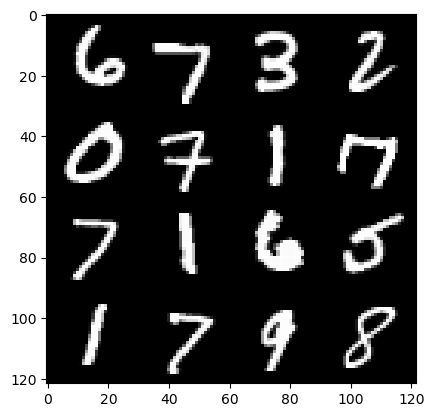

455: step 213600 / Gen loss: 1.4562460589408877 / disc_loss: 0.4143530289332074


  0%|          | 0/469 [00:00<?, ?it/s]

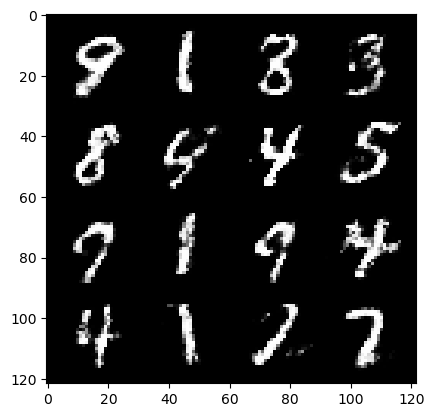

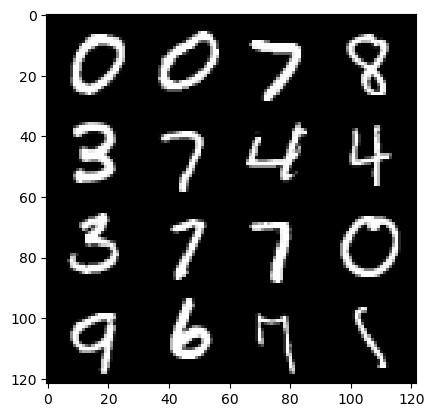

456: step 213900 / Gen loss: 1.424294138352075 / disc_loss: 0.43628793607155497


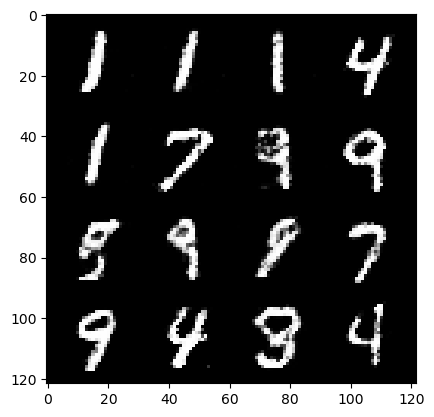

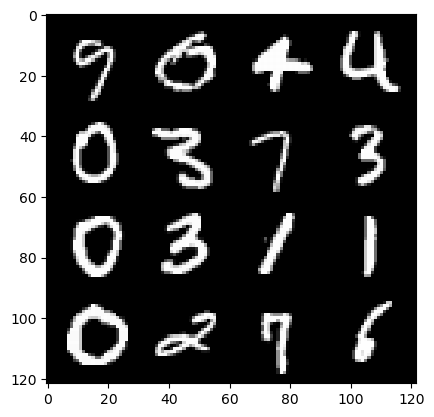

456: step 214200 / Gen loss: 1.4458193778991713 / disc_loss: 0.4281980240344999


  0%|          | 0/469 [00:00<?, ?it/s]

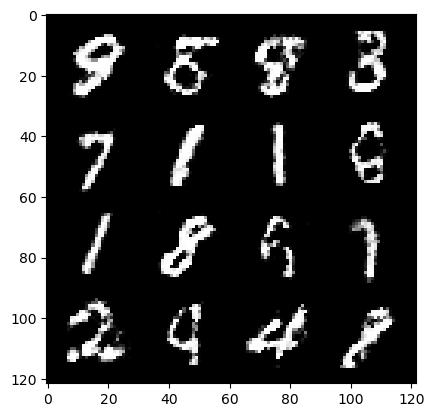

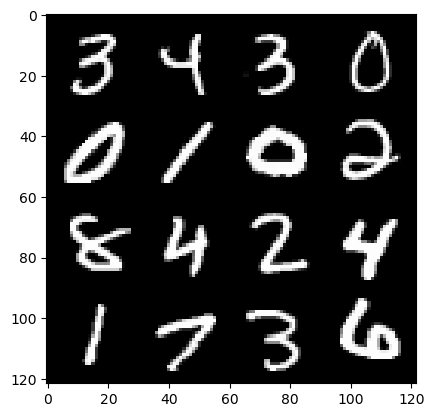

457: step 214500 / Gen loss: 1.429254738489787 / disc_loss: 0.43614930530389134


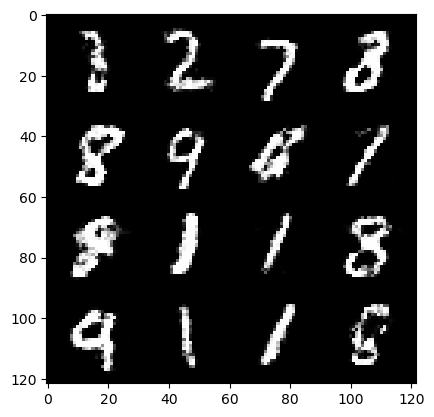

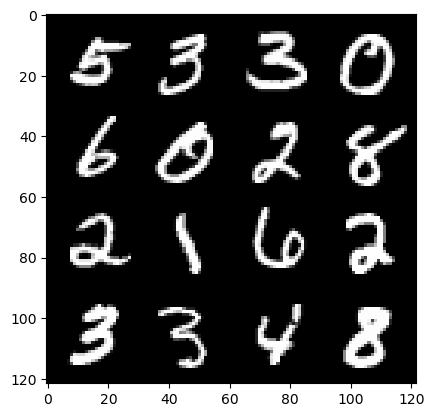

457: step 214800 / Gen loss: 1.4233794629573815 / disc_loss: 0.42670216292142854


  0%|          | 0/469 [00:00<?, ?it/s]

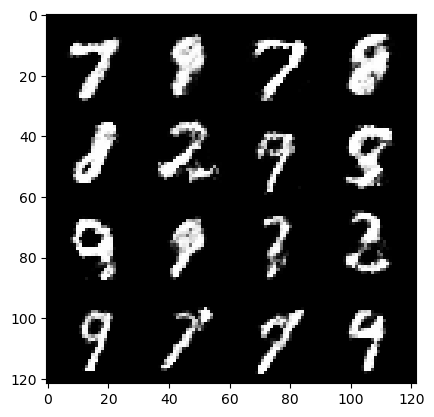

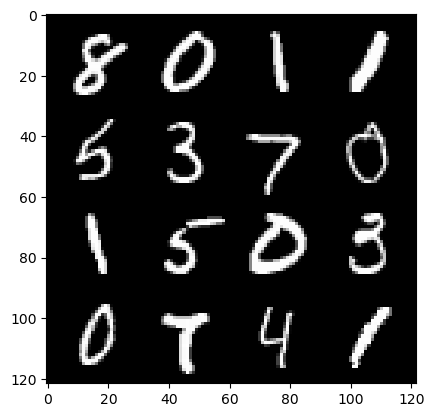

458: step 215100 / Gen loss: 1.4356631577014913 / disc_loss: 0.4360383834441508


  0%|          | 0/469 [00:00<?, ?it/s]

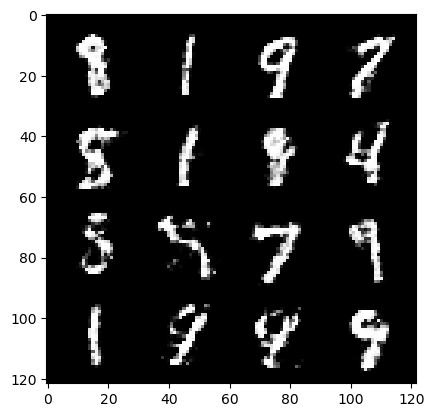

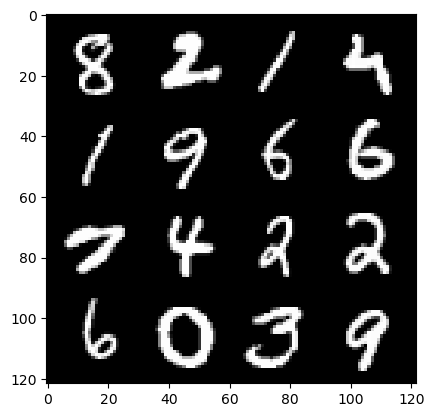

459: step 215400 / Gen loss: 1.4158775182565055 / disc_loss: 0.43705185006062175


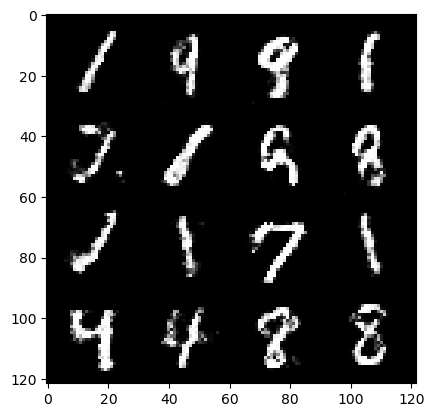

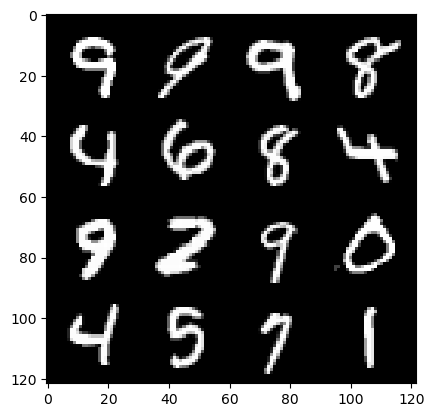

459: step 215700 / Gen loss: 1.4196227423350014 / disc_loss: 0.4394578873117763


  0%|          | 0/469 [00:00<?, ?it/s]

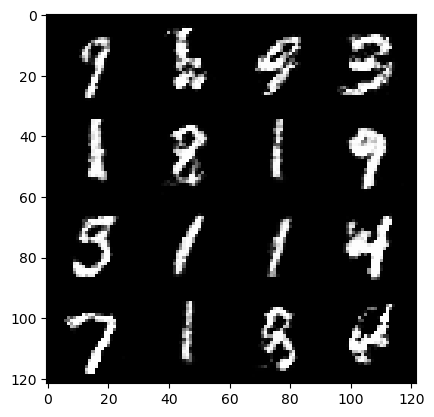

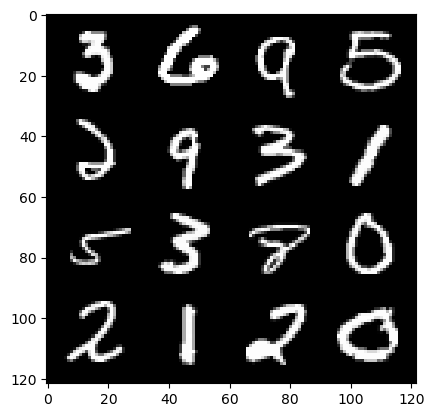

460: step 216000 / Gen loss: 1.4323853305975596 / disc_loss: 0.43752084533373525


  0%|          | 0/469 [00:00<?, ?it/s]

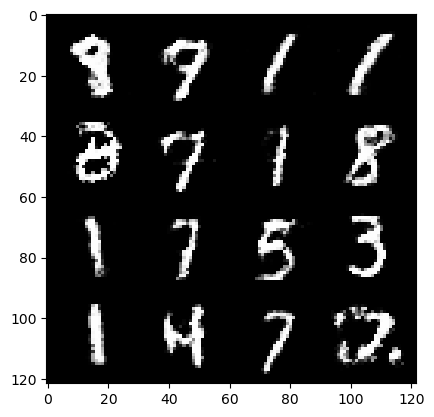

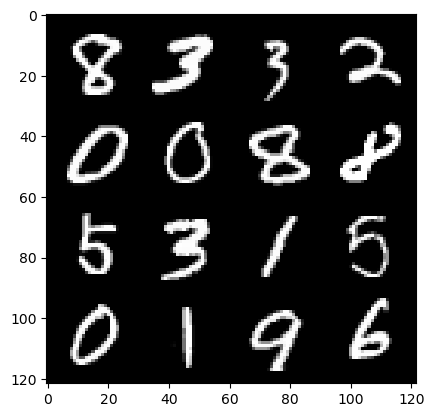

461: step 216300 / Gen loss: 1.4162342242399864 / disc_loss: 0.4442636854449907


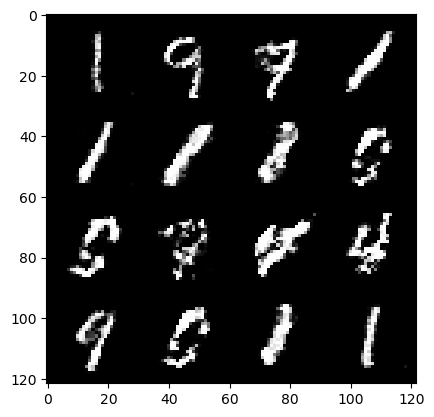

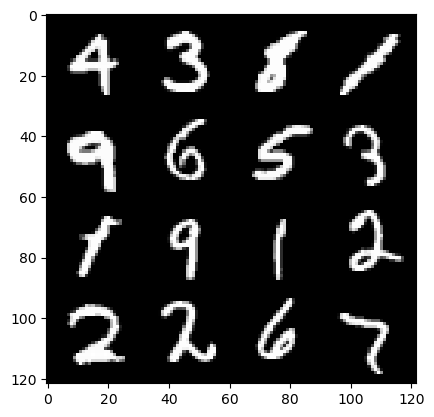

461: step 216600 / Gen loss: 1.4101194874445606 / disc_loss: 0.46134125371773993


  0%|          | 0/469 [00:00<?, ?it/s]

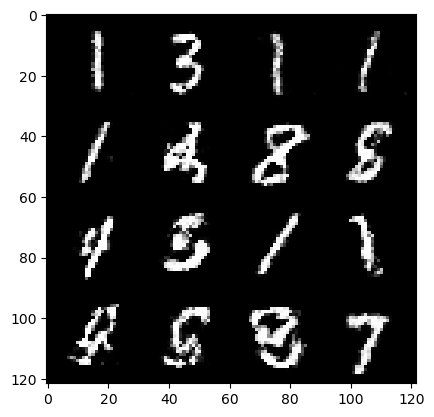

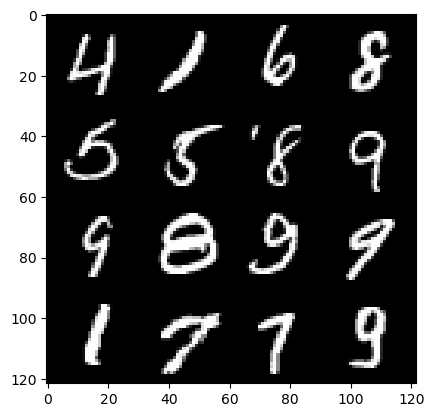

462: step 216900 / Gen loss: 1.4139320000012714 / disc_loss: 0.4362411693731945


  0%|          | 0/469 [00:00<?, ?it/s]

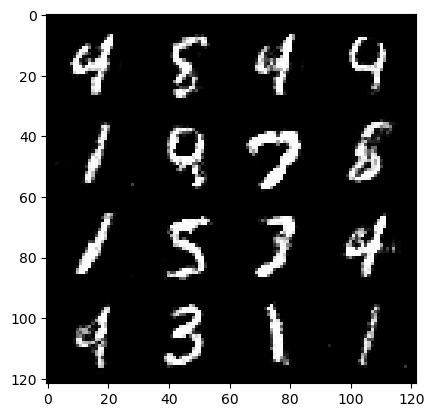

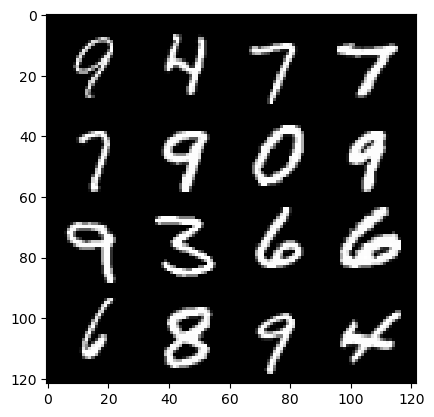

463: step 217200 / Gen loss: 1.4472697536150618 / disc_loss: 0.43119115879138276


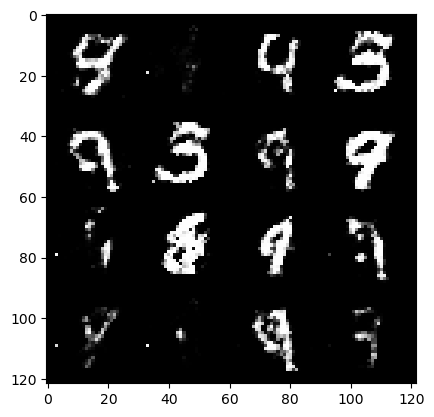

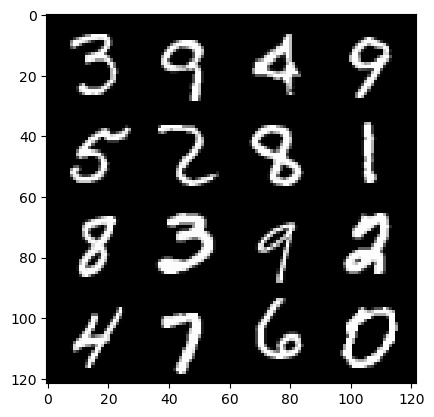

463: step 217500 / Gen loss: 1.383922307888666 / disc_loss: 0.4576976541678111


  0%|          | 0/469 [00:00<?, ?it/s]

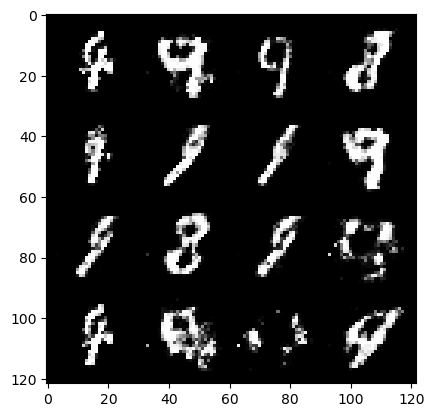

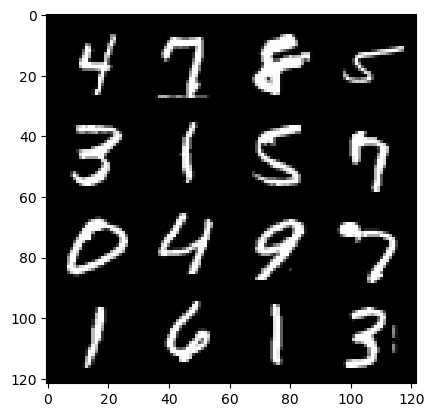

464: step 217800 / Gen loss: 1.5038511780897779 / disc_loss: 0.4027452842394513


  0%|          | 0/469 [00:00<?, ?it/s]

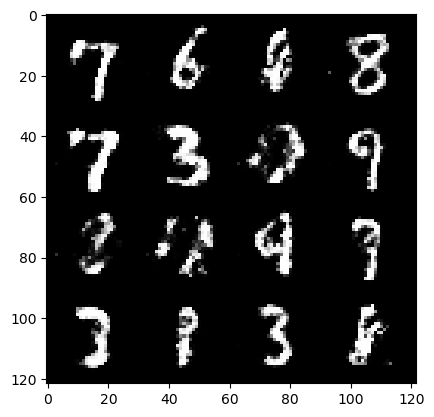

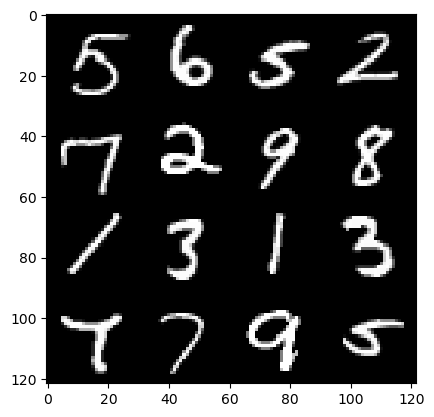

465: step 218100 / Gen loss: 1.487259117762247 / disc_loss: 0.3836265101035436


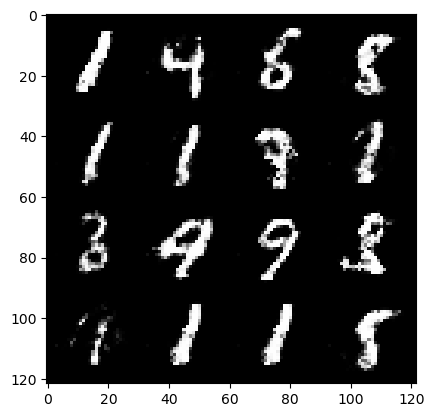

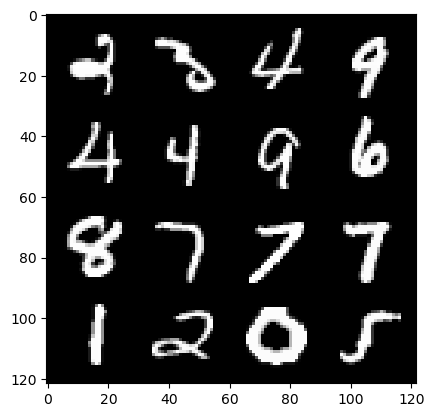

465: step 218400 / Gen loss: 1.5081780870755521 / disc_loss: 0.3901515409350394


  0%|          | 0/469 [00:00<?, ?it/s]

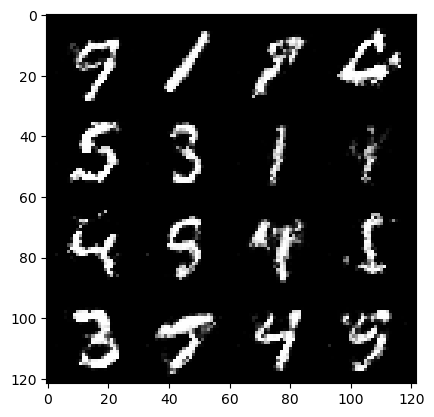

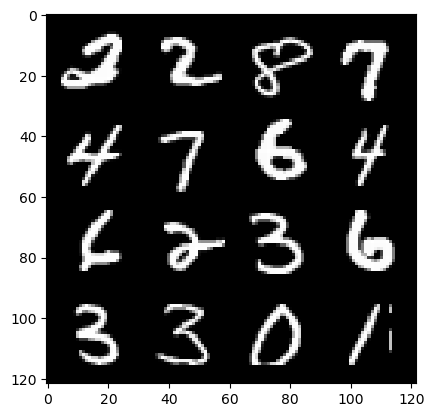

466: step 218700 / Gen loss: 1.5447508351008112 / disc_loss: 0.388445279697577


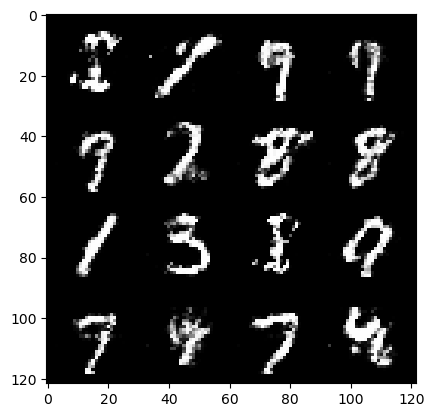

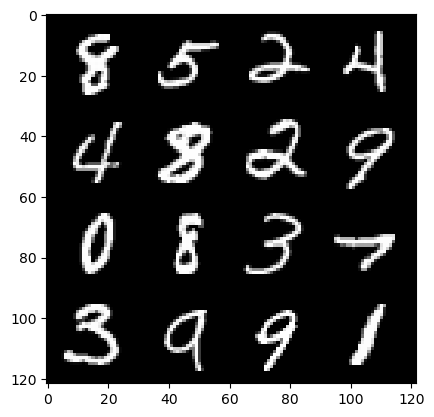

466: step 219000 / Gen loss: 1.4925049873193097 / disc_loss: 0.4052951179941495


  0%|          | 0/469 [00:00<?, ?it/s]

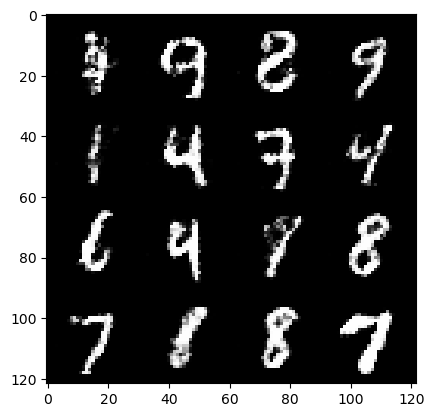

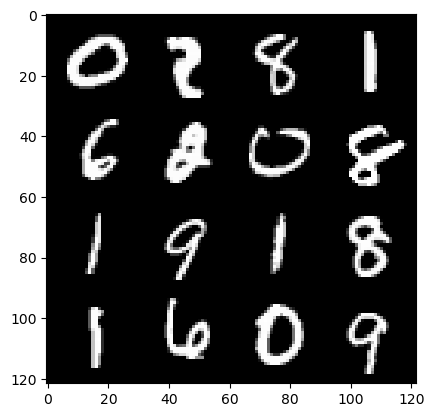

467: step 219300 / Gen loss: 1.5109079051017758 / disc_loss: 0.40971804648637766


  0%|          | 0/469 [00:00<?, ?it/s]

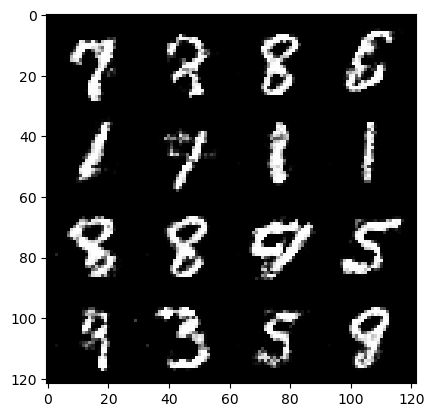

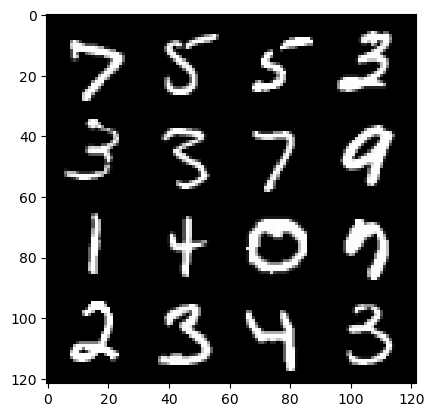

468: step 219600 / Gen loss: 1.4915223693847652 / disc_loss: 0.4152336234847703


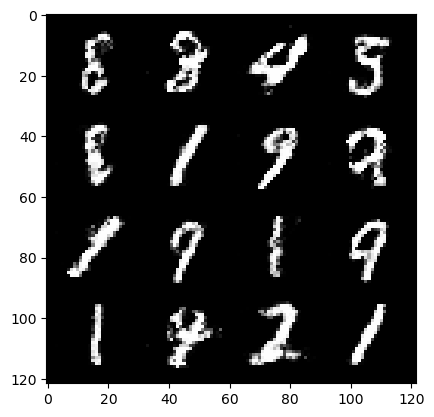

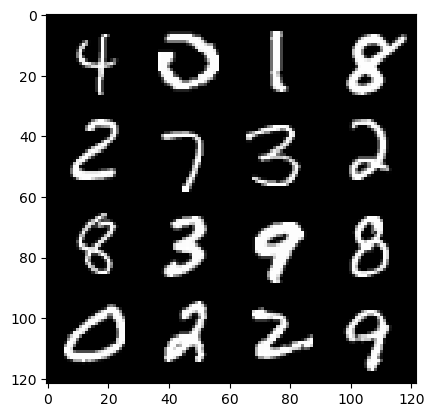

468: step 219900 / Gen loss: 1.514690954685211 / disc_loss: 0.39955419907967243


  0%|          | 0/469 [00:00<?, ?it/s]

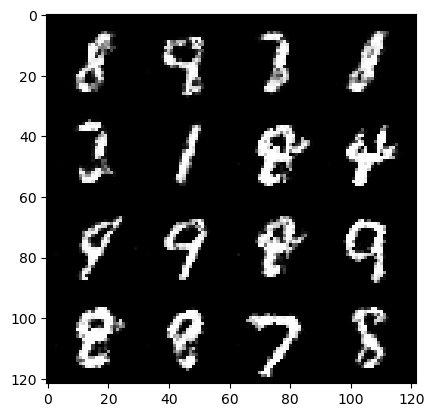

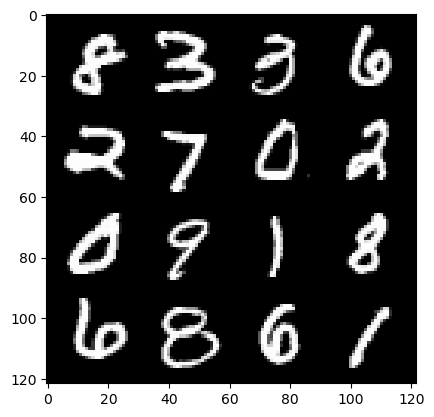

469: step 220200 / Gen loss: 1.49798121492068 / disc_loss: 0.4091667443513874


  0%|          | 0/469 [00:00<?, ?it/s]

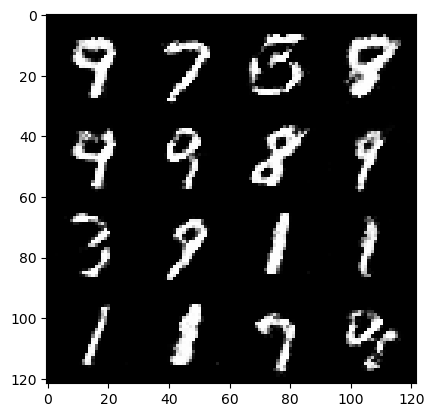

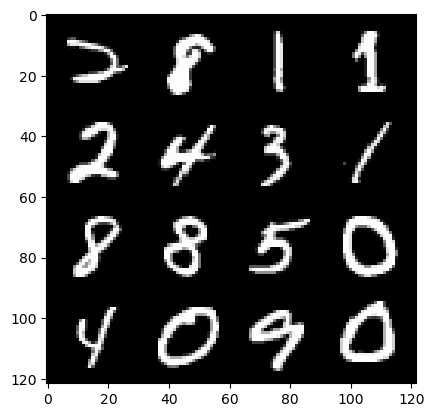

470: step 220500 / Gen loss: 1.464360592365264 / disc_loss: 0.4337175272901854


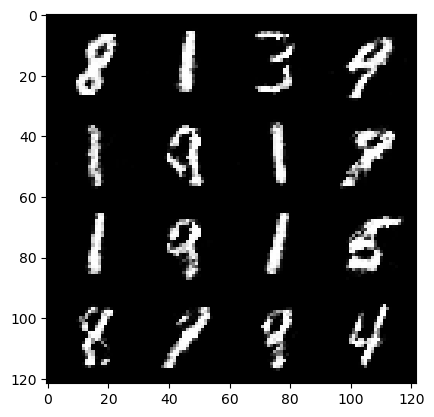

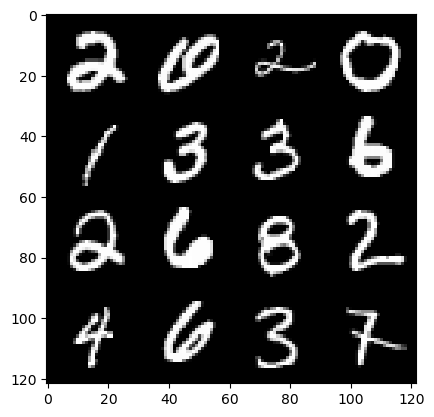

470: step 220800 / Gen loss: 1.4580503197511034 / disc_loss: 0.4348822224140168


  0%|          | 0/469 [00:00<?, ?it/s]

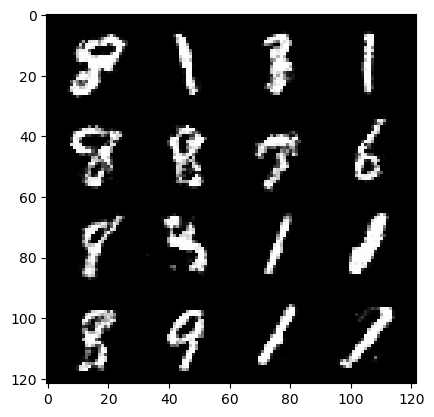

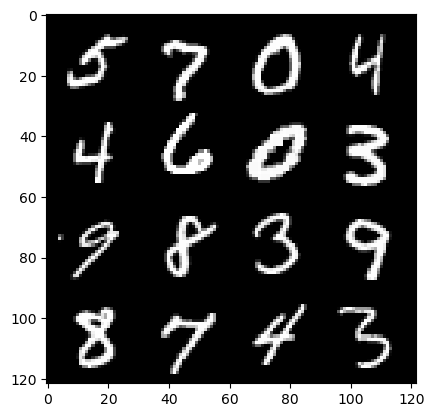

471: step 221100 / Gen loss: 1.4845927707354223 / disc_loss: 0.42274308631817503


  0%|          | 0/469 [00:00<?, ?it/s]

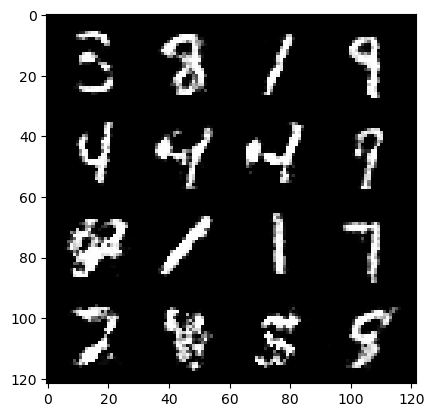

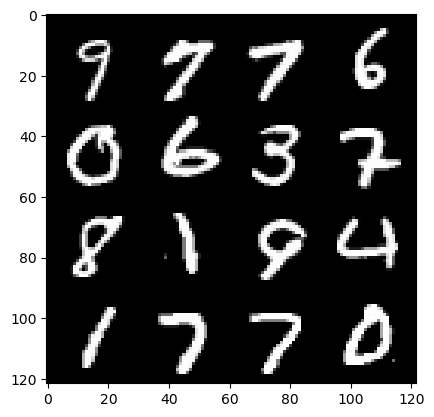

472: step 221400 / Gen loss: 1.5085262123743683 / disc_loss: 0.4134917675455411


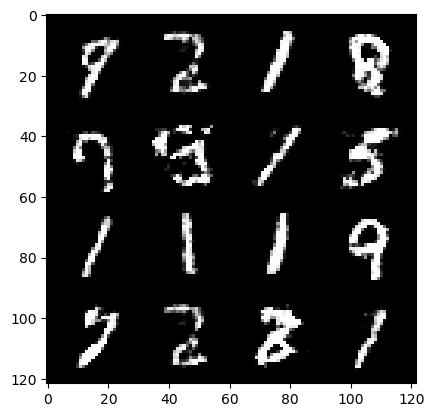

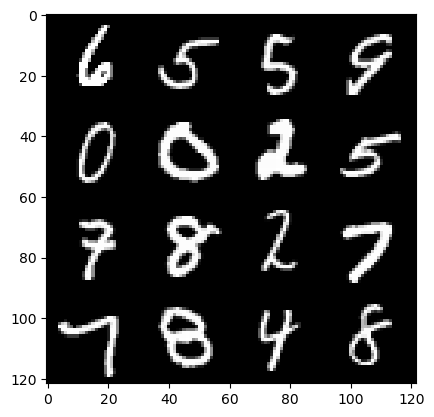

472: step 221700 / Gen loss: 1.48121527671814 / disc_loss: 0.4280866406361265


  0%|          | 0/469 [00:00<?, ?it/s]

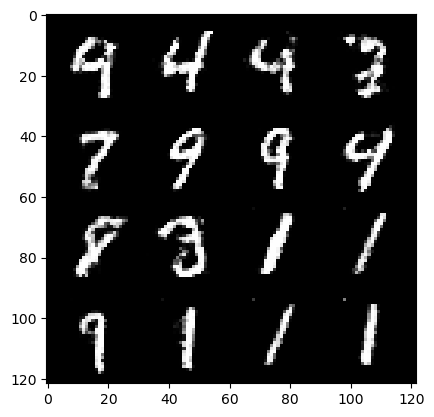

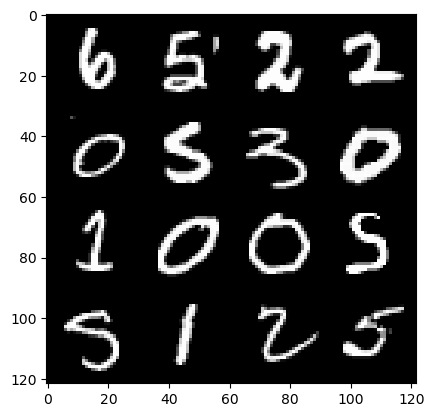

473: step 222000 / Gen loss: 1.4802492912610379 / disc_loss: 0.42702751785516746


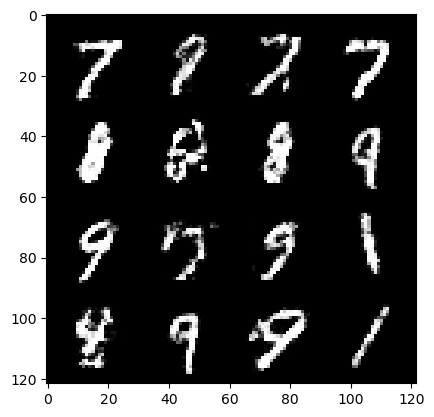

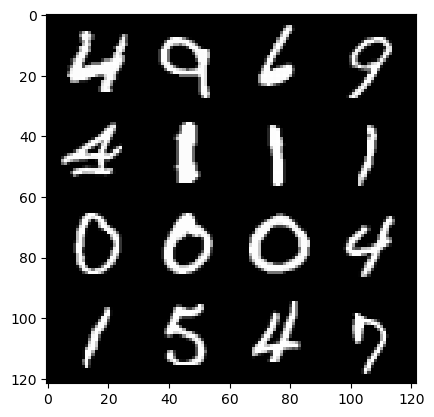

473: step 222300 / Gen loss: 1.4469458484649662 / disc_loss: 0.43121355603138617


  0%|          | 0/469 [00:00<?, ?it/s]

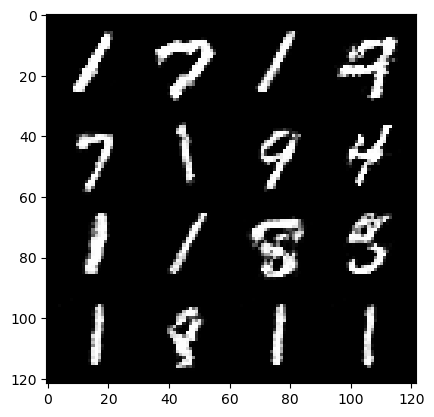

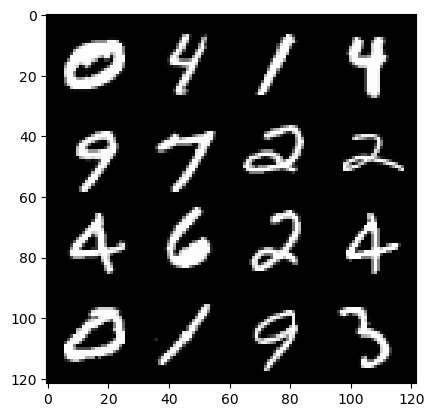

474: step 222600 / Gen loss: 1.474520902633666 / disc_loss: 0.42810599893331525


  0%|          | 0/469 [00:00<?, ?it/s]

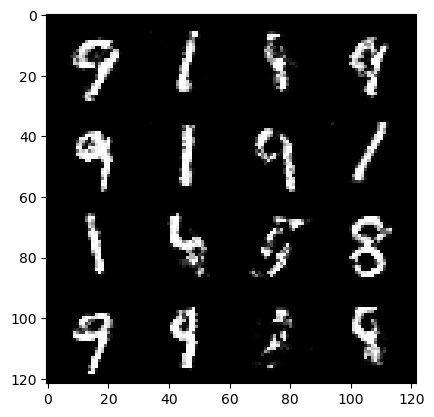

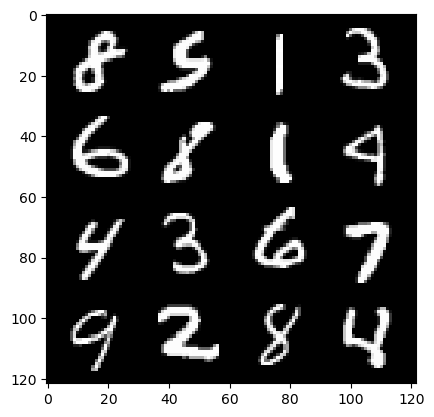

475: step 222900 / Gen loss: 1.4639312235514328 / disc_loss: 0.4312947550415992


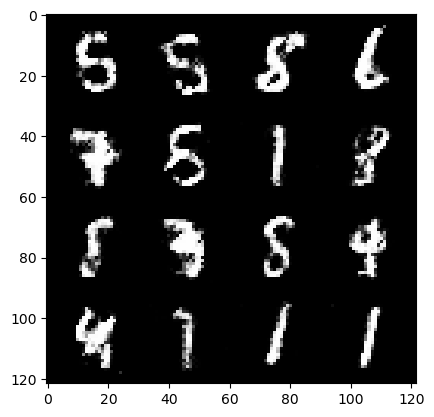

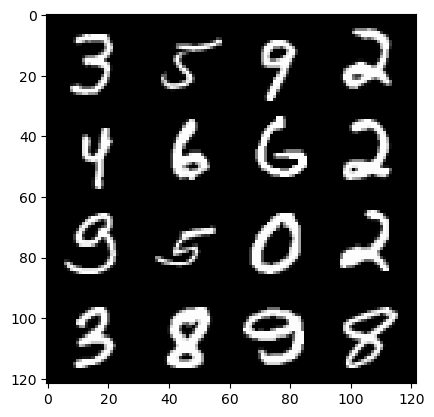

475: step 223200 / Gen loss: 1.418743059237798 / disc_loss: 0.4431576829155281


  0%|          | 0/469 [00:00<?, ?it/s]

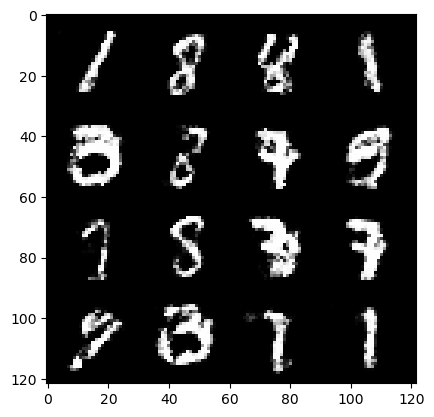

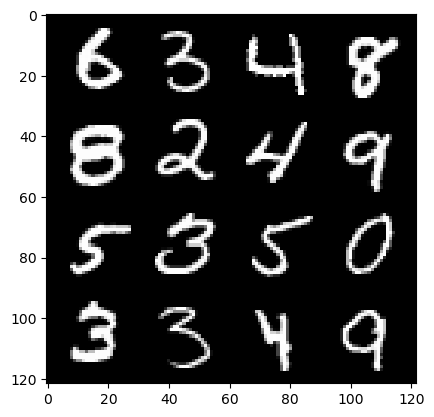

476: step 223500 / Gen loss: 1.4448797682921093 / disc_loss: 0.4369777557253834


  0%|          | 0/469 [00:00<?, ?it/s]

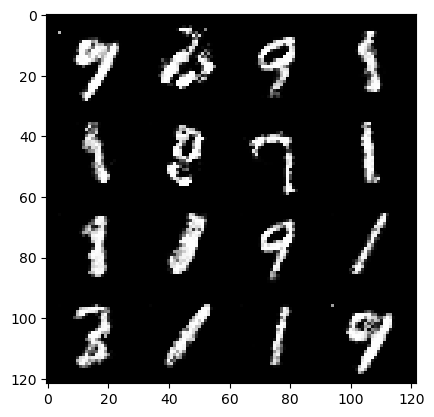

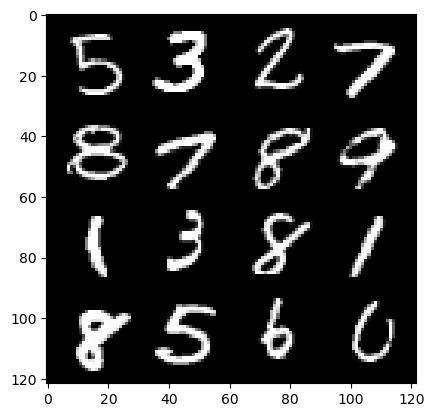

477: step 223800 / Gen loss: 1.4078260970115664 / disc_loss: 0.4488455665111544


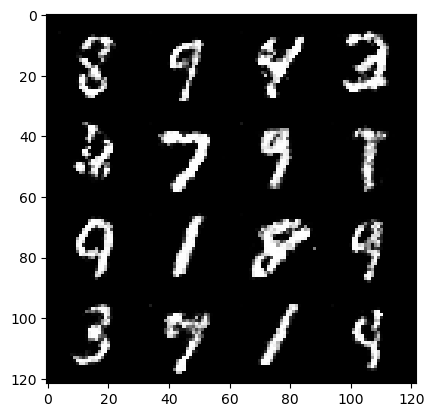

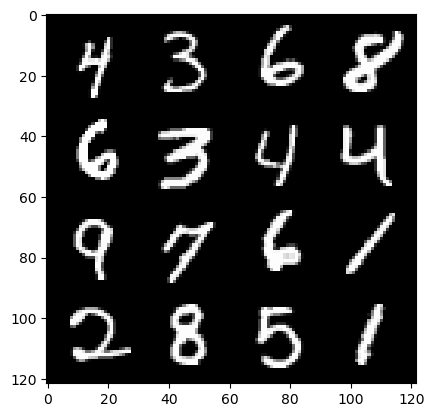

477: step 224100 / Gen loss: 1.4112848389148707 / disc_loss: 0.43191277831792874


  0%|          | 0/469 [00:00<?, ?it/s]

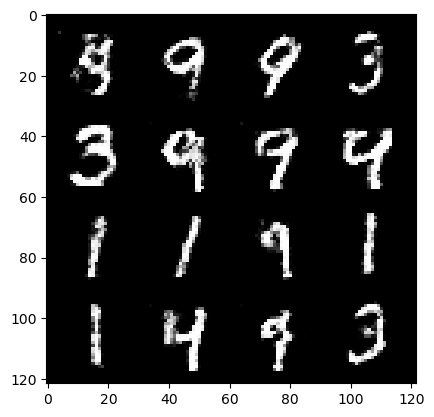

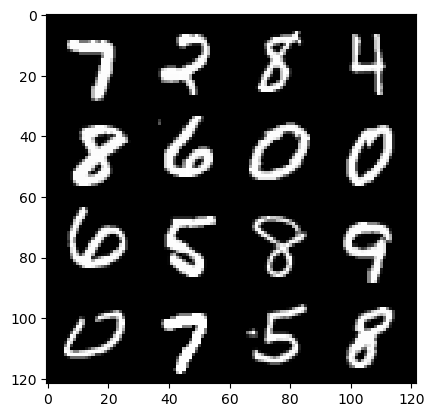

478: step 224400 / Gen loss: 1.4335508827368428 / disc_loss: 0.43283971329530063


  0%|          | 0/469 [00:00<?, ?it/s]

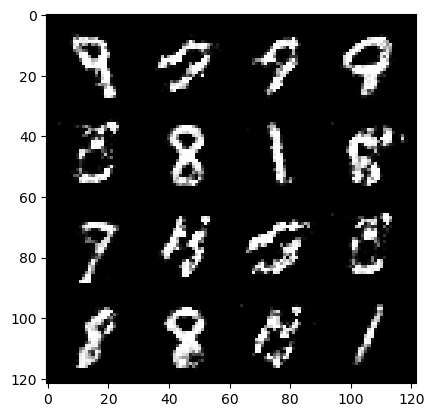

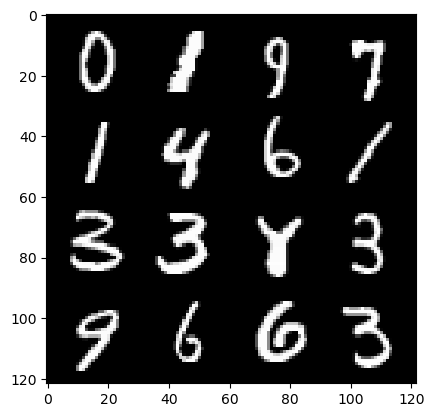

479: step 224700 / Gen loss: 1.4426606682936354 / disc_loss: 0.4253828633824988


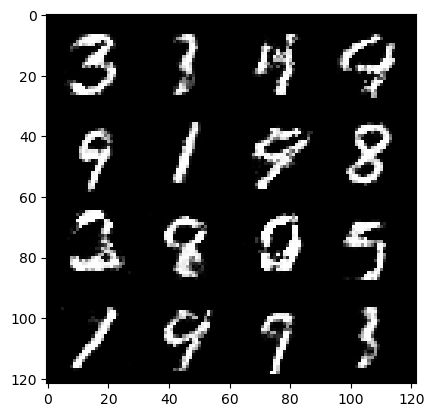

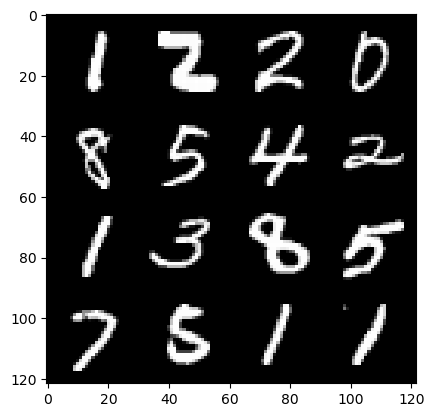

479: step 225000 / Gen loss: 1.4584945805867509 / disc_loss: 0.4246808615326885


  0%|          | 0/469 [00:00<?, ?it/s]

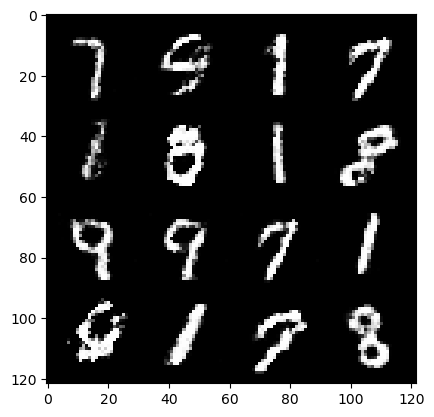

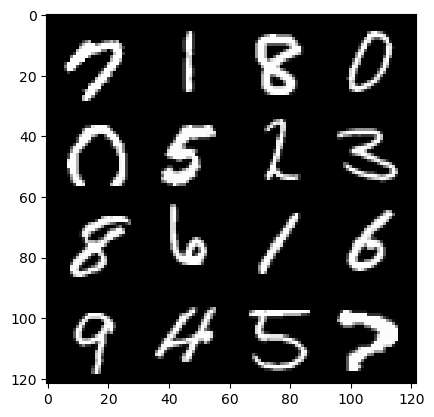

480: step 225300 / Gen loss: 1.431772252718607 / disc_loss: 0.4361193674802778


  0%|          | 0/469 [00:00<?, ?it/s]

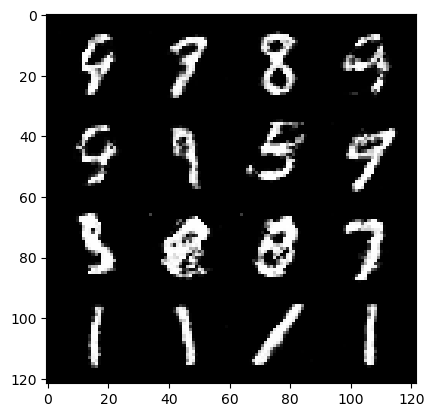

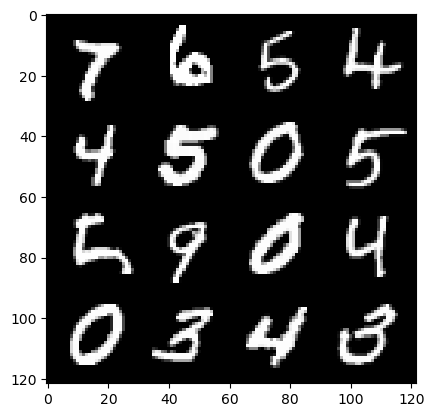

481: step 225600 / Gen loss: 1.5006943591435755 / disc_loss: 0.4220186733206116


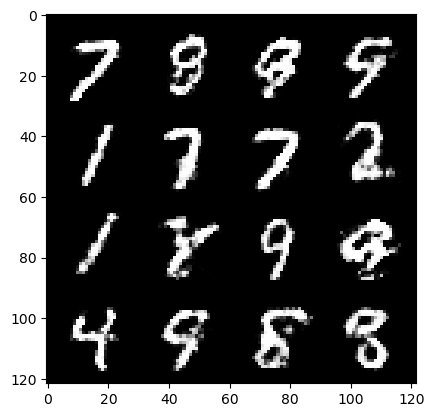

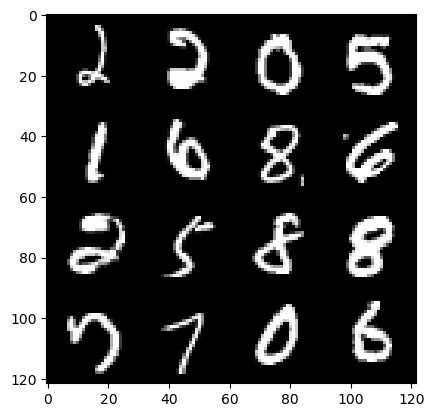

481: step 225900 / Gen loss: 1.4628665482997893 / disc_loss: 0.42476939717928547


  0%|          | 0/469 [00:00<?, ?it/s]

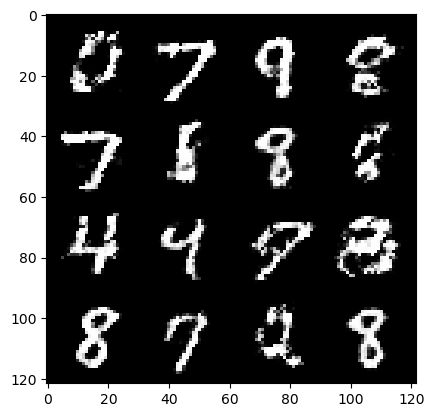

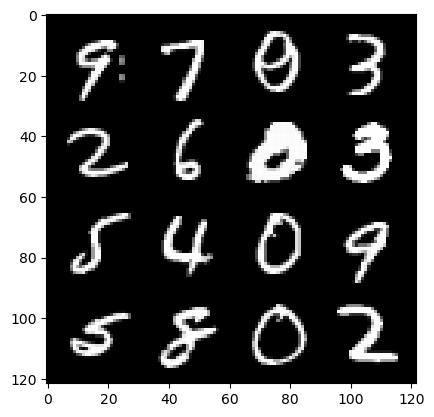

482: step 226200 / Gen loss: 1.465991027355194 / disc_loss: 0.4302991976340616


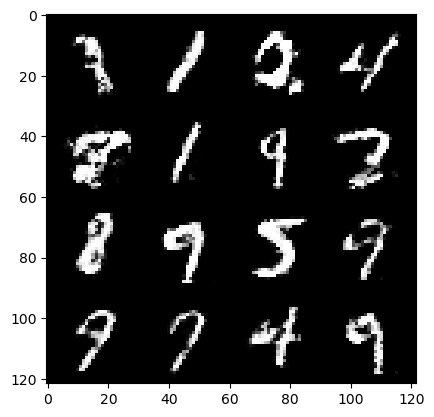

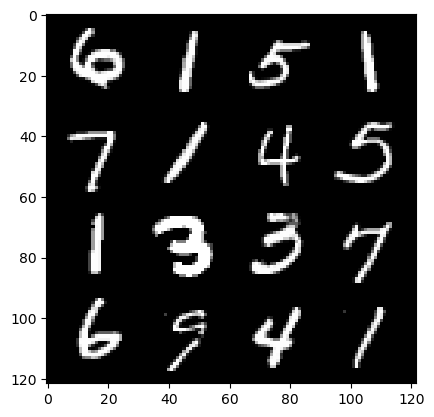

482: step 226500 / Gen loss: 1.4623302964369458 / disc_loss: 0.44122172435124685


  0%|          | 0/469 [00:00<?, ?it/s]

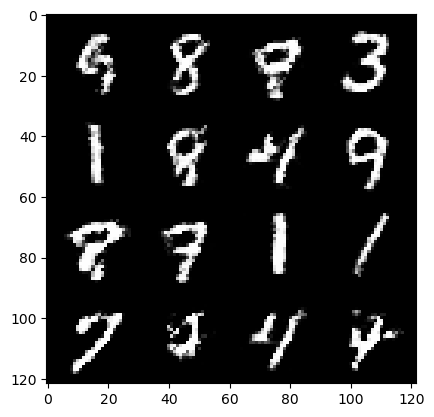

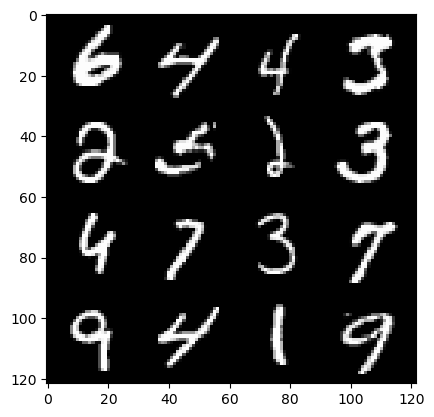

483: step 226800 / Gen loss: 1.446770134766896 / disc_loss: 0.4334471199909845


  0%|          | 0/469 [00:00<?, ?it/s]

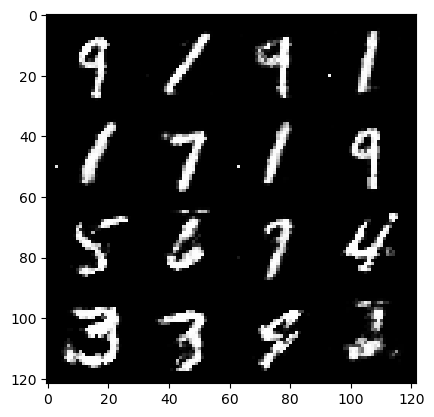

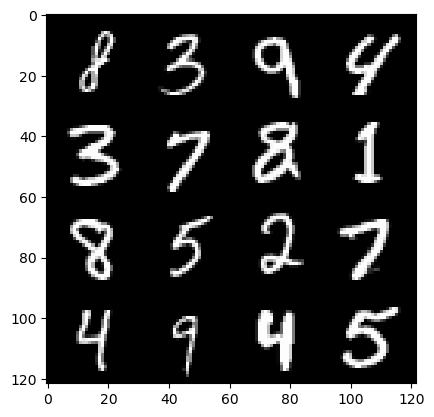

484: step 227100 / Gen loss: 1.4617336853345229 / disc_loss: 0.46771458377440756


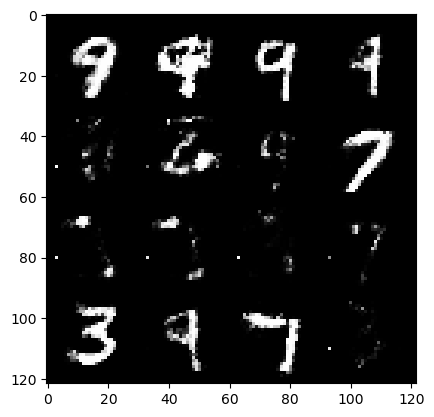

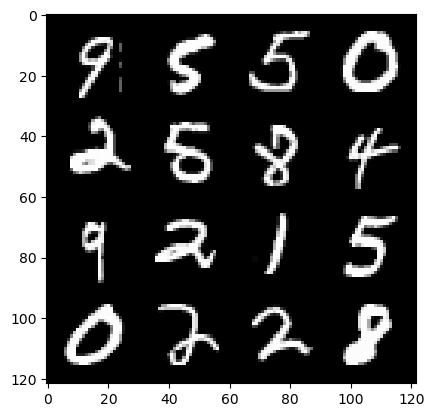

484: step 227400 / Gen loss: 1.321729389429092 / disc_loss: 0.5230759587883952


  0%|          | 0/469 [00:00<?, ?it/s]

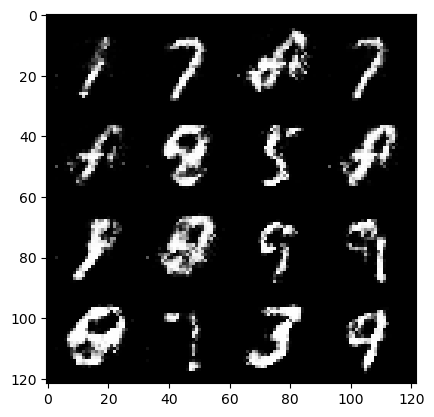

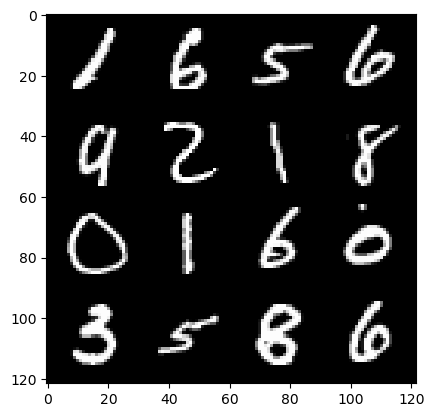

485: step 227700 / Gen loss: 1.5864892570177724 / disc_loss: 0.45208668222029996


  0%|          | 0/469 [00:00<?, ?it/s]

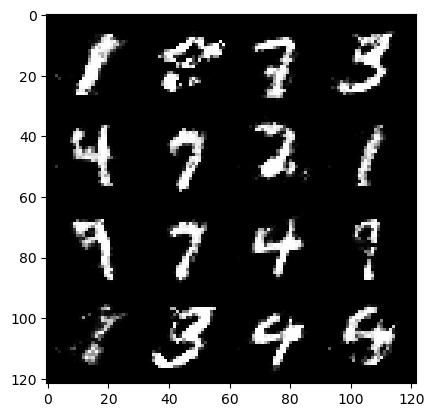

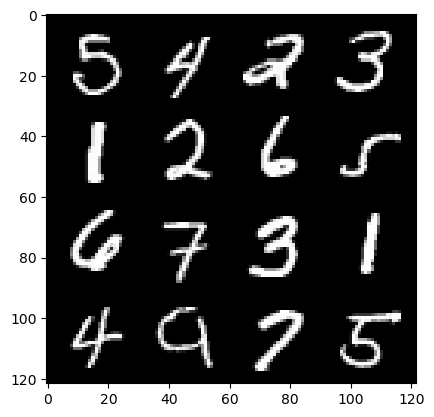

486: step 228000 / Gen loss: 1.6367888561884556 / disc_loss: 0.37767688324054105


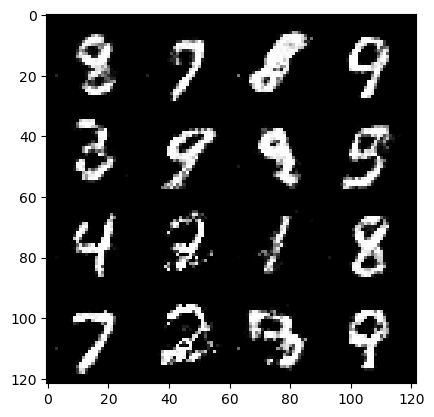

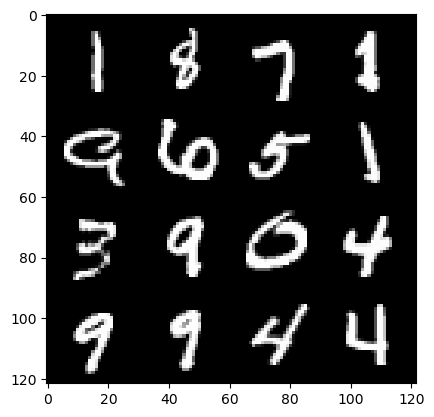

486: step 228300 / Gen loss: 1.416564668019613 / disc_loss: 0.41705222100019446


  0%|          | 0/469 [00:00<?, ?it/s]

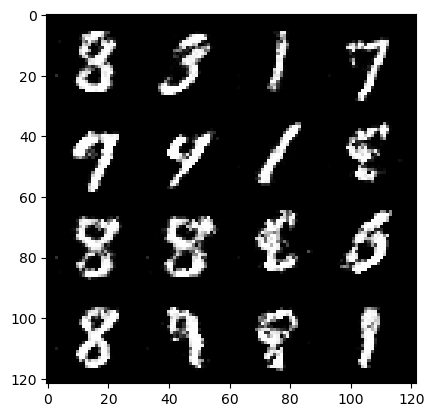

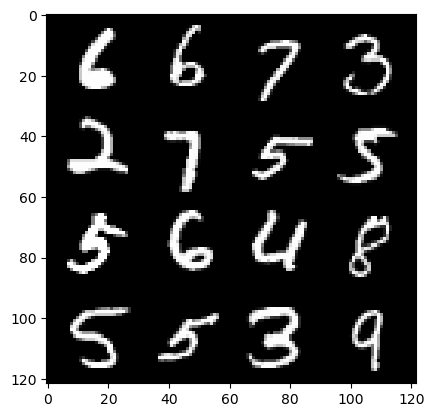

487: step 228600 / Gen loss: 1.4048777973651885 / disc_loss: 0.4297454666097961


  0%|          | 0/469 [00:00<?, ?it/s]

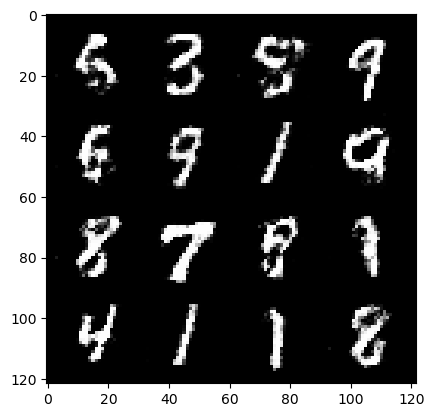

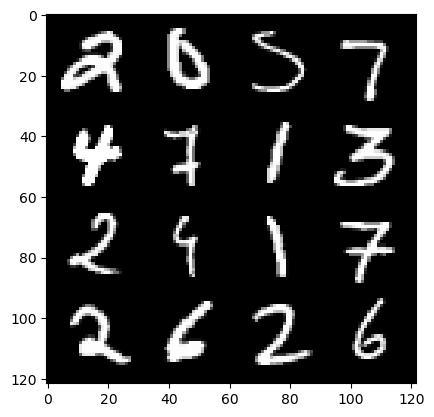

488: step 228900 / Gen loss: 1.4197202352682752 / disc_loss: 0.4232917808492978


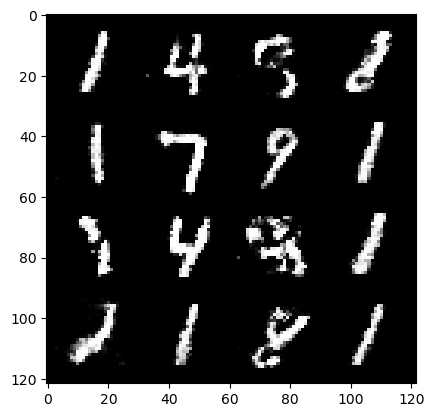

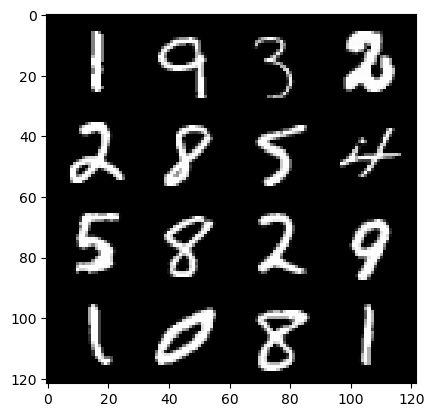

488: step 229200 / Gen loss: 1.3568985454241427 / disc_loss: 0.4429900423685708


  0%|          | 0/469 [00:00<?, ?it/s]

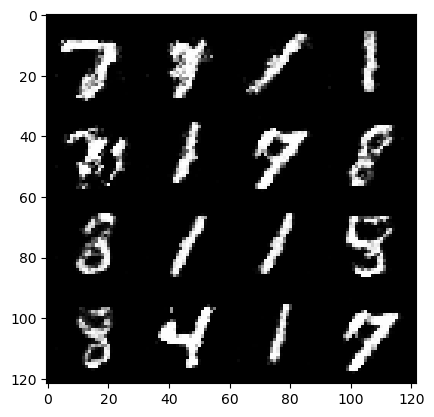

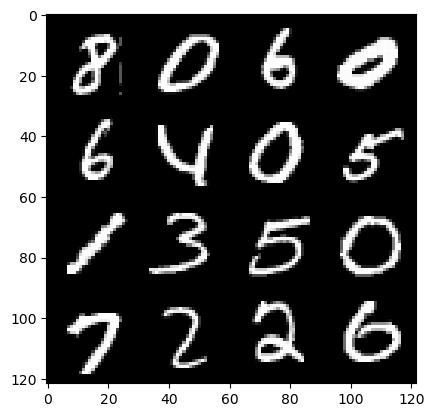

489: step 229500 / Gen loss: 1.3511709598700206 / disc_loss: 0.44215296467145276


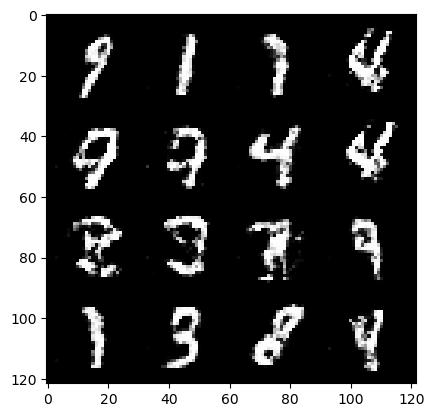

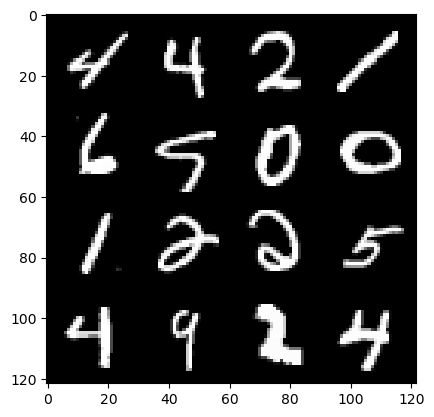

489: step 229800 / Gen loss: 1.3453395028909048 / disc_loss: 0.4563435136278473


  0%|          | 0/469 [00:00<?, ?it/s]

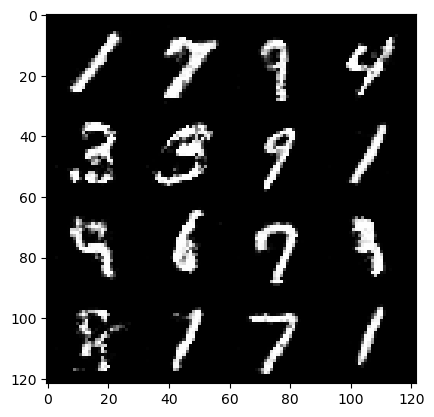

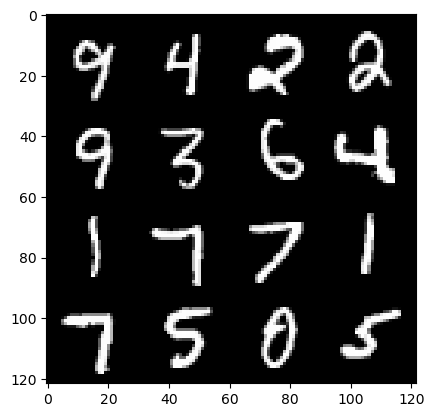

490: step 230100 / Gen loss: 1.3953133106231692 / disc_loss: 0.4309024419387179


  0%|          | 0/469 [00:00<?, ?it/s]

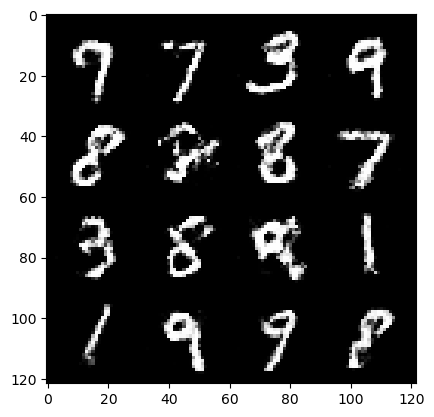

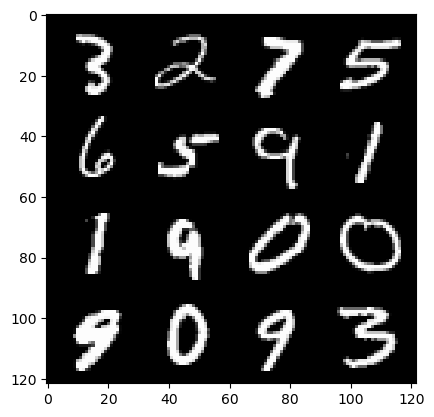

491: step 230400 / Gen loss: 1.3662578646341943 / disc_loss: 0.4334180221954981


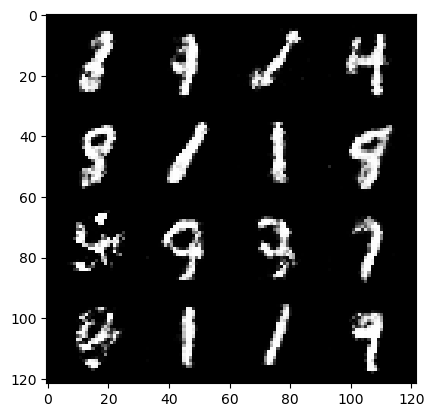

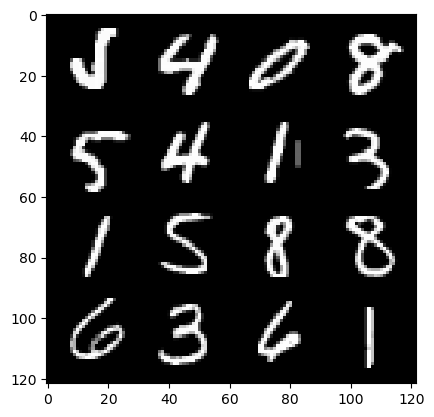

491: step 230700 / Gen loss: 1.4064808320999134 / disc_loss: 0.4307912345727288


  0%|          | 0/469 [00:00<?, ?it/s]

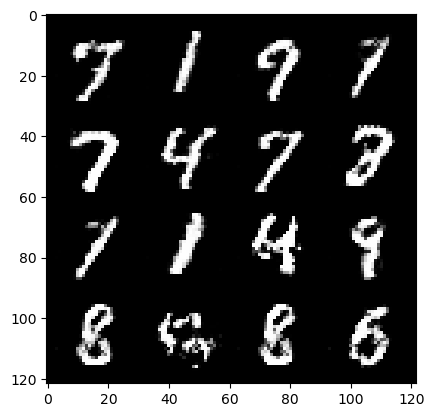

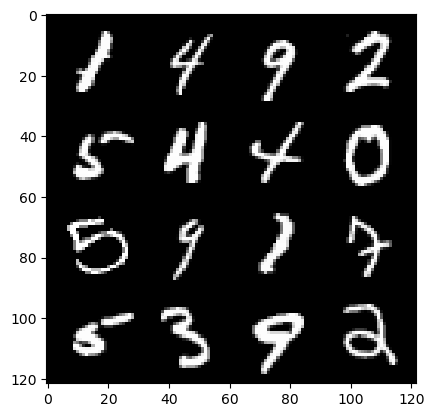

492: step 231000 / Gen loss: 1.3880138659477224 / disc_loss: 0.44531787087519964


  0%|          | 0/469 [00:00<?, ?it/s]

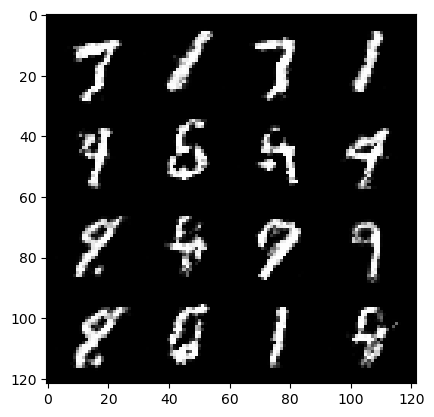

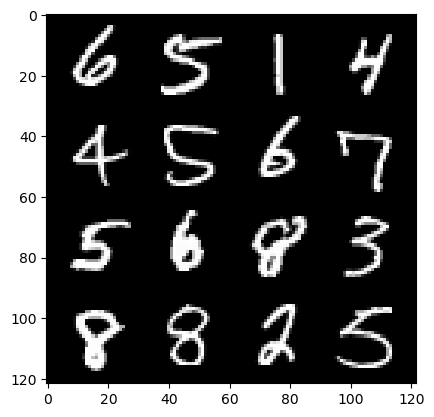

493: step 231300 / Gen loss: 1.406257714827855 / disc_loss: 0.43960004190603885


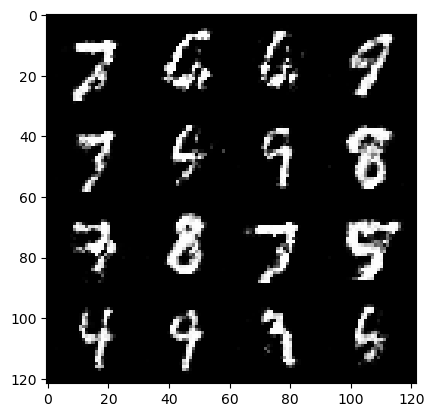

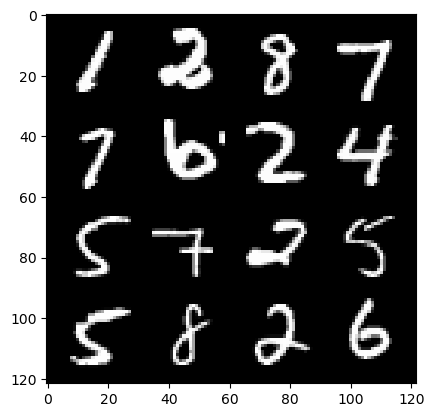

493: step 231600 / Gen loss: 1.3983373415470128 / disc_loss: 0.437105144659678


  0%|          | 0/469 [00:00<?, ?it/s]

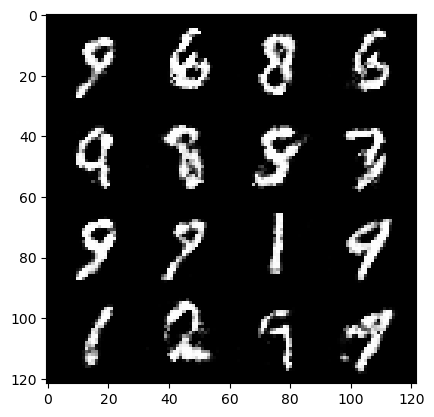

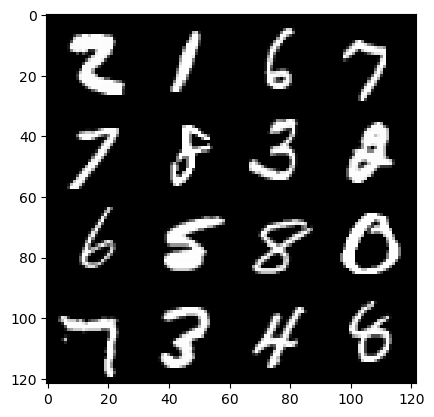

494: step 231900 / Gen loss: 1.4354232927163448 / disc_loss: 0.41231335272391684


  0%|          | 0/469 [00:00<?, ?it/s]

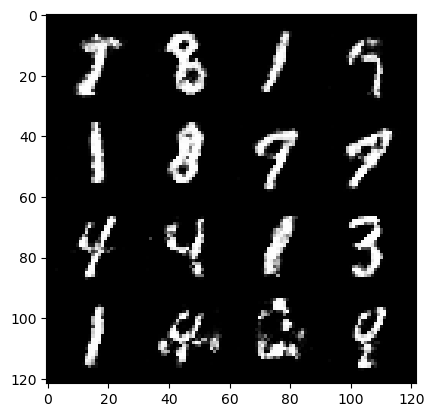

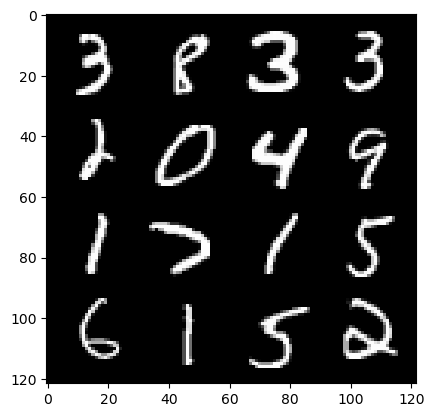

495: step 232200 / Gen loss: 1.4042228114604953 / disc_loss: 0.4322340991099674


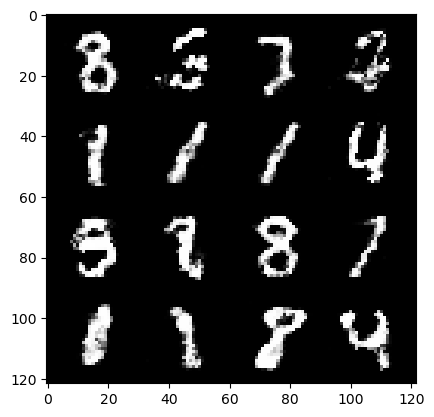

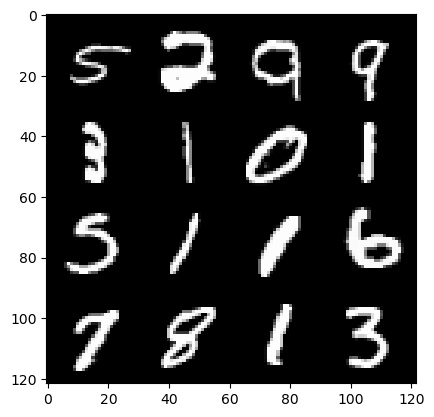

495: step 232500 / Gen loss: 1.4360860923926047 / disc_loss: 0.42534463375806814


  0%|          | 0/469 [00:00<?, ?it/s]

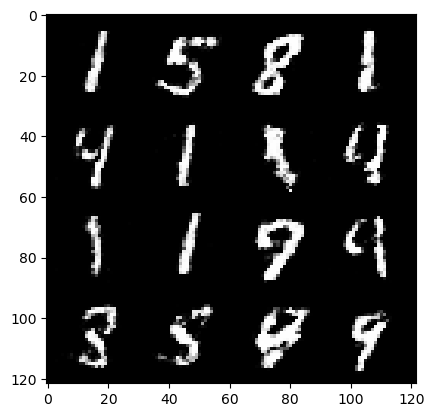

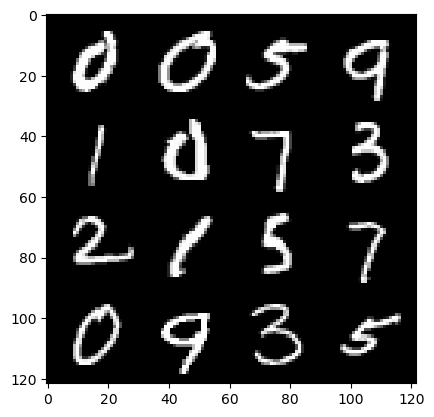

496: step 232800 / Gen loss: 1.426654951572418 / disc_loss: 0.4332617448767027


  0%|          | 0/469 [00:00<?, ?it/s]

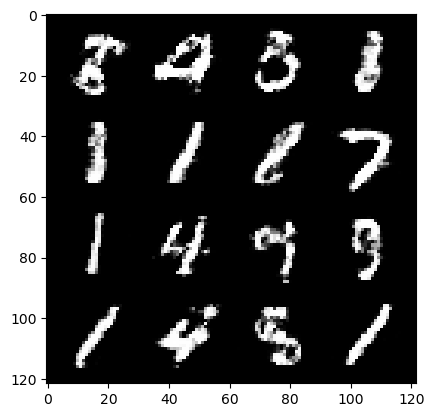

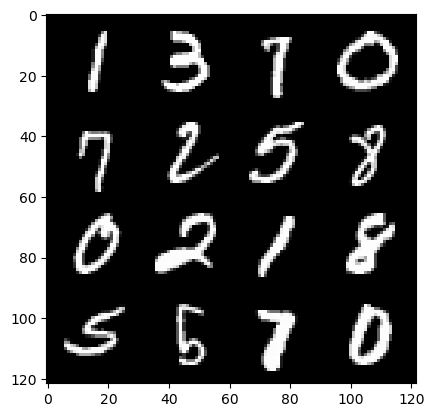

497: step 233100 / Gen loss: 1.4143108467261 / disc_loss: 0.44842093984285986


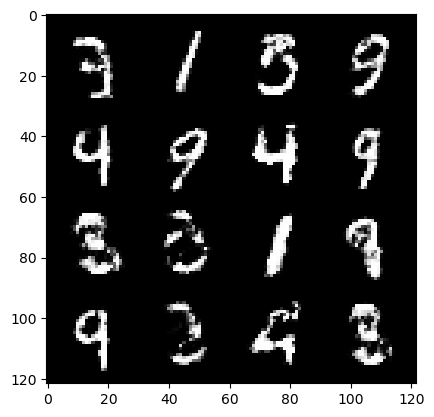

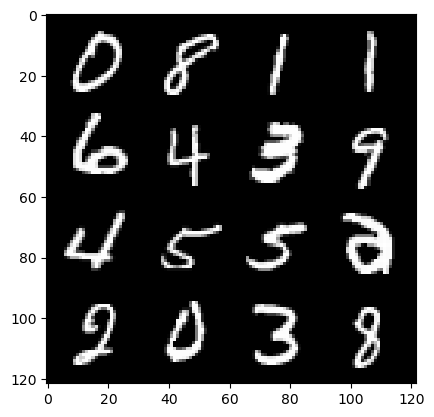

497: step 233400 / Gen loss: 1.428846822579703 / disc_loss: 0.44655743847290735


  0%|          | 0/469 [00:00<?, ?it/s]

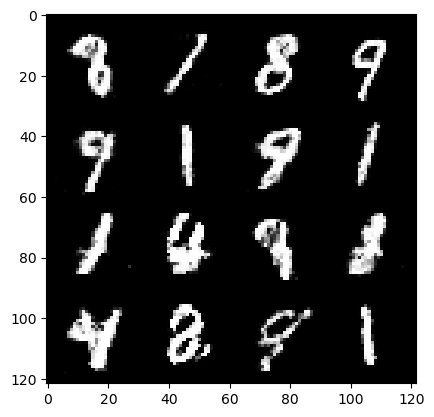

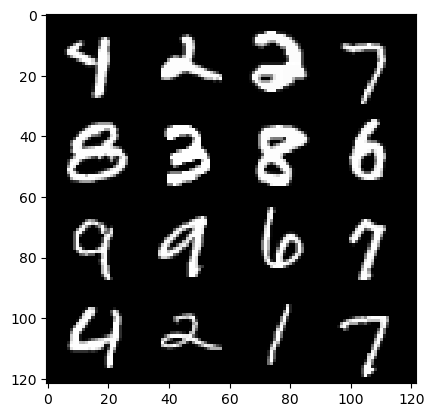

498: step 233700 / Gen loss: 1.4133929653962445 / disc_loss: 0.4453071369727453


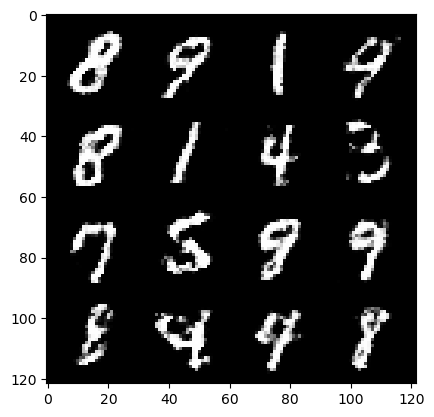

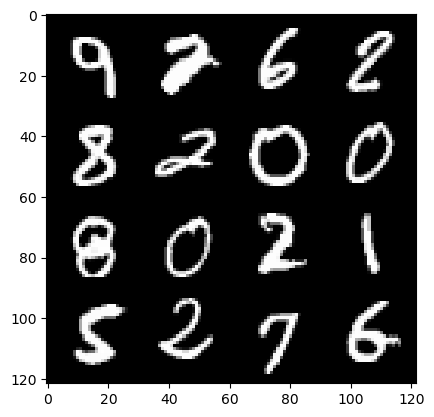

498: step 234000 / Gen loss: 1.40992316822211 / disc_loss: 0.44850200911363003


  0%|          | 0/469 [00:00<?, ?it/s]

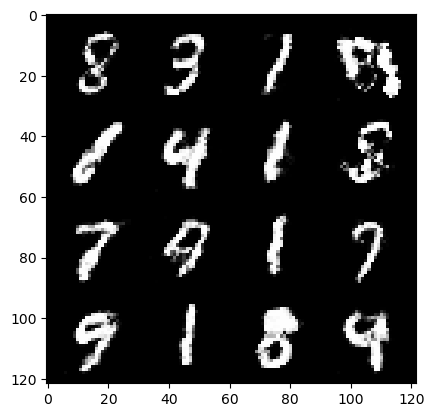

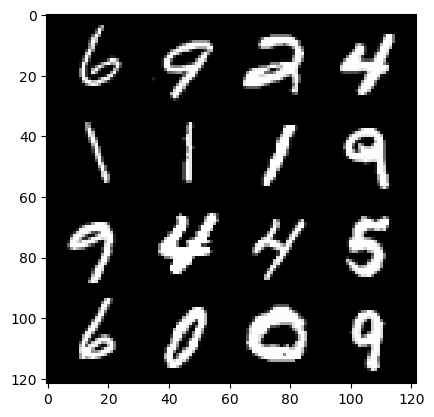

499: step 234300 / Gen loss: 1.3906058883666992 / disc_loss: 0.4590356926123303


In [18]:
for epoch in range(epochs):
  for real, _ in tqdm(dataloader):
    ### discriminator
    disc_opt.zero_grad()

    cur_bs=len(real) # real: 128 x 1 x 28 x 28
    real = real.view(cur_bs, -1) # 128 x 784
#    real = real.to(device)

    disc_loss = calc_disc_loss(loss_func,gen,disc,cur_bs,real,z_dim)
    disc_loss.backward(retain_graph=True)
    disc_opt.step()

    ### generator
    gen_opt.zero_grad()
    gen_loss = calc_gen_loss(loss_func,gen,disc,cur_bs,z_dim)
    gen_loss.backward(retain_graph=True)
    gen_opt.step()

    ### visualization & stats
    mean_disc_loss+=disc_loss.item()/info_step
    mean_gen_loss+=gen_loss.item()/info_step

    if cur_step % info_step == 0 and cur_step>0:
      fake_noise = gen_noise(cur_bs, z_dim)
      fake = gen(fake_noise)
      show(fake)
      show(real)
      print(f"{epoch}: step {cur_step} / Gen loss: {mean_gen_loss} / disc_loss: {mean_disc_loss}")
      mean_gen_loss, mean_disc_loss=0,0
    cur_step+=1

In [20]:
import pickle

In [23]:
with open("./models/trained_gan_generator_MNIST.pt", "wb") as file:
    pickle.dump(gen, file)

In [41]:
generated_tensor = gen(noise)

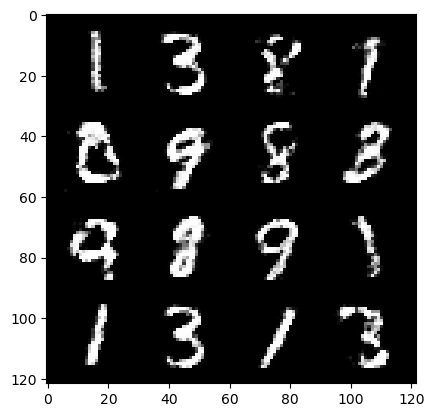

In [42]:
show(generated_tensor)

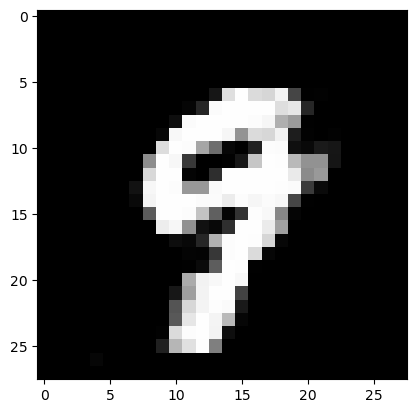

In [49]:
show(generated_tensor, ch=1, size=(28,28), num=6, index=5)